In [1]:
import numpy as np
import os
import scipy.io.wavfile as wav
import math
import matplotlib.pyplot as plt


In [2]:
#sound_dir = 'O:\_DesafioDS\common-voice\common_voice_corpus\cv-valid-train'
sound_dir = 'E:\cv-valid-train'

In [3]:


def get_BBPower(powFileFullPath):

    print('BBPower|| powFileFullPath: ',powFileFullPath)

    filename_w_ext = os.path.basename(powFileFullPath)
    filename, file_extension = os.path.splitext(filename_w_ext)
    
    folder = os.path.dirname(powFileFullPath) 
    
    intFileFullPath = os.path.join(folder, filename + '.int')
    wavFileFullPath = os.path.join(folder, filename + '.wav')

    if os.path.exists(intFileFullPath)==True :
        return

    print('BBPower|| intFileFullPath: ',intFileFullPath)


    sampFreq,snd = wav.read(wavFileFullPath)

    
    my_pow = np.loadtxt(powFileFullPath,dtype=np.complex128)
    N = len(my_pow)
    print ('N:',N)
    freqArray = np.arange(0, N, 1.0) * (sampFreq /(2.*N))

    #print('freqArray:',freqArray)
    #print('len(freqArray):',len(freqArray))
    
    inteBB = BarkBands_integrate(my_pow,freqArray)
    
    np.savetxt(intFileFullPath, inteBB)
    
    Bark_limits=[20.,100.,200.,300.,400.,510.,630.,770.,920.,1080.,1270.,1480.,1720.,2000.,2320.,2700.,3150.,3700.,4400.,5300.,6400.,7700.,9500.,12000.,15500.]
    
    Bark_limits = np.array(Bark_limits)
    
    BB_width = Bark_limits[1:] - Bark_limits[0:-1]

    
    Bark_limits= Bark_limits[:-1]
    
    #print('Bark_limits:',Bark_limits) 
    #print('BB_width:',BB_width) 
    
    
    #plt.bar(Bark_limits,inte,BB_width,color='g',edgecolor='k')
    #plt.xscale('symlog')
    #plt.xlim(20, 15500)  
    #plt.xlabel('Bark band')
    #plt.ylabel('Power P^2 ')
#    plt.savefig('Potencia_vs_frecuencia.png', dpi=100)    
    #plt.grid()
    #plt.show()

    #plt.plot(freqArray/1000, my_pow, color='r')
    #plt.xlabel('Frequency (kHz)')
    #plt.ylabel('Integrated Power P^2 ')
#    plt.savefig('Potencia_vs_frecuencia.png', dpi=100)    
    #plt.grid()
    #plt.show()
    
    

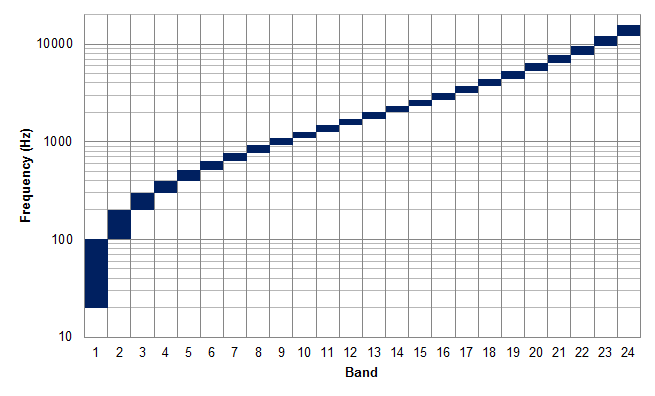

In [4]:

def BarkBands_integrate(pow,freqArray):
    
    Bark_limits=[20.,100.,200.,300.,400.,510.,630.,770.,920.,1080.,1270.,1480.,1720.,2000.,2320.,2700.,3150.,3700.,4400.,5300.,6400.,7700.,9500.,12000.,15500.]
    int_value = [0]*(len(Bark_limits)-1)
        
    low_edge,high_edge = Bark_limits[0], Bark_limits[len(Bark_limits)-1]
    
    print('integ_total.low_edge: ',low_edge)
    print('integ_total.high_edge: ',high_edge)
    
    integ_total = integ_in(pow,freqArray,low_edge,high_edge)
    
    
    print('integ_total:',integ_total)
    
    high_edge = 0
    
    for i,edge_freq in enumerate(Bark_limits):
            
        low_edge = high_edge
        high_edge = edge_freq

        if i==0 :
            continue
   
        #print('i:',i)
        #print('le: ',low_edge,'he:',  high_edge)
    
        int_value[i-1] = integ_in(pow,freqArray,low_edge,high_edge)
        
        #print (i-1,': ',int_value[i-1])
        
        int_value = np.array(int_value)
        
    print('int_value.sum()',int_value.sum())

    norm_integ = int_value/ integ_total
    
    print('norm_integ.sum()',norm_integ.sum())
    
    return norm_integ       


In [5]:
from scipy.interpolate import InterpolatedUnivariateSpline

def integ_in(pow,freqArray,low_edge,high_edge):
    
    f = InterpolatedUnivariateSpline(freqArray, pow, k=1)  # k=1 gives linear interpolation

    return f.integral(low_edge, high_edge) 

In [6]:
for k,file in enumerate(os.listdir(sound_dir)):
    filename = os.fsdecode(file)
    full_path = os.path.join(sound_dir, file)

    filename_w_ext = os.path.basename(full_path)
    filename, file_extension = os.path.splitext(filename_w_ext)
    
    if file_extension == '.pow':    
        get_BBPower(full_path)
    #if k==2 :
    #    break
        

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000000.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000000.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001650144582787984
int_value.sum() 0.0016501445827880041
norm_integ.sum() 1.000000000000012


C:\ProgramData\Anaconda3\lib\site-packages\scipy\interpolate\fitpack2.py:603: ComplexWarning: Casting complex values to real discards the imaginary part
  xb=bbox[0],xe=bbox[1],s=0)


BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000001.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000001.int
N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.916365325804515e-07
int_value.sum() 7.916365325804548e-07
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000002.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000002.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006124249841297807
int_value.sum() 0.0006124249841297791
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000003.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000003.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9827780055763373e-05
int_value.sum() 1.9827780055763207e-05
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000004.pow
BBPower|| int

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027805051092212093
int_value.sum() 0.002780505109221192
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000029.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000029.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001666130812668987
int_value.sum() 0.0016661308126689595
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000030.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000030.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.186914797627941e-05
int_value.sum() 4.1869147976279954e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000031.int
N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 197304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8583249165587638e-05
int_value.sum() 2.858324916558799e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000056.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000056.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028935963099213153
int_value.sum() 0.00028935963099212866
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000057.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000057.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001717771941384415
int_value.sum() 0.0017177719413844041
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000058.int
N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004955379511108472
int_value.sum() 0.0004955379511108435
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000083.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000083.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017108466663877956
int_value.sum() 0.00017108466663878213
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000084.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000084.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005176781767150092
int_value.sum() 0.0005176781767150002
norm_integ.sum() 0.9999999999999828
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000085.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021843919527847515
int_value.sum() 0.00021843919527847082
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000110.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000110.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001874423495279683
int_value.sum() 0.00018744234952796894
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000111.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000111.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015531856957143406
int_value.sum() 0.0015531856957143346
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000112.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000112.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002093993544664546
int_value.sum() 0.00020939935446645465
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000137.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000137.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016840239707816486
int_value.sum() 0.0016840239707816515
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000138.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000138.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001805296057120493
int_value.sum() 0.00018052960571204976
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000139.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011432928742725292
int_value.sum() 0.0001143292874272516
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000164.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000164.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034236921063189016
int_value.sum() 0.00034236921063189065
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000165.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000165.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007655844466079612
int_value.sum() 0.0007655844466079721
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000166.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000166.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002217885653652461
int_value.sum() 0.0022178856536525095
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000191.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000191.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003365379907593035
int_value.sum() 0.003365379907593045
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000192.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000192.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007397641129309921
int_value.sum() 0.007397641129309878
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000193.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003287080462558783
int_value.sum() 0.0032870804625588076
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000219.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000219.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034236492804607315
int_value.sum() 0.0003423649280460705
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000220.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000220.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.527893255117398e-05
int_value.sum() 7.527893255117348e-05
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000221.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 197304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.430584277720037e-05
int_value.sum() 4.430584277720107e-05
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000254.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009389361905695453
int_value.sum() 0.0009389361905695311
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000255.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004159921892530215
int_value.sum() 0.0041599218925302515
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000256.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019461203479858468
int_value.sum() 0.00019461203479858858
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000288.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000288.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9122478521300274e-06
int_value.sum() 2.9122478521299706e-06
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000290.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007101769514941194
int_value.sum() 0.0007101769514941267
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000291.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017604293357890868
int_value.sum() 0.0017604293357891025
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000322.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000322.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042519347339020494
int_value.sum() 0.00042519347339020364
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000323.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000323.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016839431096845236
int_value.sum() 0.00016839431096845123
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000324.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000324.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005886240040910441
int_value.sum() 0.000588624004091038
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000354.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000354.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007787183809574319
int_value.sum() 0.0007787183809574356
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000356.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0045543751580422835
int_value.sum() 0.004554375158042339
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000357.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000389.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023076828103478644
int_value.sum() 0.00023076828103478562
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000390.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00190353808417056
int_value.sum() 0.0019035380841705568
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000392.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004172010942241973
int_value.sum() 0.00041720109422420203
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000393.pow
BBPower|| intFi

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000423.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000423.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.669523693266819e-06
int_value.sum() 7.669523693266933e-06
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000425.int
N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028257510204226814
int_value.sum() 0.002825751020422731
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000426.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011411647506019265
int_value.sum() 0.011411647506019553
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000427.pow
BBPower|| intFileFull

N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003234435993239381
int_value.sum() 0.0032344359932393024
norm_integ.sum() 0.9999999999999758
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000460.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000460.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004976362962848123
int_value.sum() 0.0004976362962847972
norm_integ.sum() 0.9999999999999697
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000462.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000462.int
N: 264696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.6844035942056955e-06
int_value.sum() 5.684403594205589e-06
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000464.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007982396371109818
int_value.sum() 0.0007982396371109984
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000494.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.235711018777626e-05
int_value.sum() 4.235711018777556e-05
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000495.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.144157471876785e-06
int_value.sum() 3.1441574718768264e-06
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000496.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037958008303755407
int_value.sum() 0.0003795800830375542
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000526.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006776812764944409
int_value.sum() 0.0006776812764944485
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000527.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004514074701074007
int_value.sum() 0.004514074701073944
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000529.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000529.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022588630681789204
int_value.sum() 0.00022588630681789066
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000561.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2741285416081626e-05
int_value.sum() 2.27412854160815e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000563.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001229460252565061
int_value.sum() 0.0012294602525650825
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000564.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004452673452731944
int_value.sum() 0.004452673452732028
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000595.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000595.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003983469639789126
int_value.sum() 0.0003983469639789124
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000596.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000596.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005114593893180444
int_value.sum() 0.00051145938931804
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000597.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000597.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.449719177441323e-05
int_value.sum() 7.449719177441411e-05
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000628.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010772945165430144
int_value.sum() 0.00010772945165430202
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000629.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014061233047649026
int_value.sum() 0.0014061233047649112
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000630.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002414238006947401
int_value.sum() 0.002414238006947403
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000659.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033976462247828137
int_value.sum() 0.0033976462247828267
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000660.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025107880109236287
int_value.sum() 0.0025107880109236074
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000661.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022900228618695766
int_value.sum() 0.0002290022861869582
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000687.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.80559469338908e-05
int_value.sum() 6.805594693389149e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000688.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025626472000107236
int_value.sum() 0.0025626472000107765
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000689.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000713.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036987152651000803
int_value.sum() 0.0036987152651000825
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000714.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003989989664297915
int_value.sum() 0.00039899896642978913
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000715.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011835676364764659
int_value.sum() 0.0011835676364764848
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000716.int
N: 134520
integ_t

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006779344394575056
int_value.sum() 0.0006779344394575138
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000741.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010432536414706267
int_value.sum() 0.00010432536414706417
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000742.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035962462046500816
int_value.sum() 0.00359624620465006
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000743.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002525988676046312
int_value.sum() 0.002525988676046309
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000769.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007939596044478927
int_value.sum() 0.0007939596044478864
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000770.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000770.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036081669929734667
int_value.sum() 0.00036081669929734087
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000771.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000771.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021686977016849028
int_value.sum() 0.00021686977016849122
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000796.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002783369492724393
int_value.sum() 0.0027833694927244237
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000797.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000797.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037432275151867033
int_value.sum() 0.0003743227515186708
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000798.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000798.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024127842862802304
int_value.sum() 0.0002412784286280229
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000823.int
N: 208824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002145566704017567
int_value.sum() 0.0021455667040175524
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000824.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017434730350638971
int_value.sum() 0.00017434730350638966
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000825.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000825.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0592289594283545e-06
int_value.sum() 4.05922895942838e-06
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000850.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005184702169567364
int_value.sum() 0.0005184702169567447
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000851.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8238100740770715e-06
int_value.sum() 5.823810074077028e-06
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000852.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000852.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005956073571836844
int_value.sum() 0.0059560735718368965
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000877.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006681259650110022
int_value.sum() 0.0006681259650110028
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000878.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002885437199551206
int_value.sum() 0.00028854371995512367
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000879.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000879.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004937644346952611
int_value.sum() 0.004937644346952673
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000904.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002516705720608977
int_value.sum() 0.00025167057206090126
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000905.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002475190843116375
int_value.sum() 0.00024751908431163105
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000906.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000906.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034603813948989653
int_value.sum() 0.0034603813948990217
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000931.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009227227521389121
int_value.sum() 0.000922722752138916
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000932.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008060996476069018
int_value.sum() 0.0008060996476068973
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000933.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000933.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018936880988618837
int_value.sum() 0.0018936880988619017
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000958.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005970007379609059
int_value.sum() 0.005970007379609015
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000959.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014324555453847855
int_value.sum() 0.0014324555453847907
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000960.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000960.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007066567186732823
int_value.sum() 0.0007066567186732938
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000985.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048397544945000097
int_value.sum() 0.0004839754494499999
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000986.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021132733688659217
int_value.sum() 0.00021132733688658805
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-000987.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-000987.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014911148498740411
int_value.sum() 0.001491114849874052
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001019.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.04030555538295617
int_value.sum() 0.04030555538295545
norm_integ.sum() 0.9999999999999821
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001021.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.05921415326449e-05
int_value.sum() 4.059214153264484e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001022.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011707915631510029
int_value.sum() 0.00011707915631509864
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001051.int
N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.134579664624189e-05
int_value.sum() 4.134579664624108e-05
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001053.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001053.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.883595845001184e-05
int_value.sum() 2.883595845001157e-05
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001054.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001054.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032687757699616807
int_value.sum() 0.00032687757699616823
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001087.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004212459455891432
int_value.sum() 0.004212459455891352
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001089.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023085870330803095
int_value.sum() 0.00023085870330803097
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001090.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013075345175806944
int_value.sum() 0.013075345175806809
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001122.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001122.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021880519297645348
int_value.sum() 0.002188051929764484
norm_integ.sum() 0.9999999999999768
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001123.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001123.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028020909393180237
int_value.sum() 0.002802090939317982
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001124.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001124.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016268829966898043
int_value.sum() 0.001626882996689814
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001157.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014467641991925415
int_value.sum() 0.0014467641991925395
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001158.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.666988300586578e-05
int_value.sum() 7.666988300586693e-05
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001160.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011723639514767459
int_value.sum() 0.000117236395147673
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001192.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001192.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001501709428731056
int_value.sum() 0.0015017094287310532
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001193.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024166815552240312
int_value.sum() 0.0002416681555224025
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001196.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018193749481256534
int_value.sum() 0.00018193749481256664
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001229.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004395971566492202
int_value.sum() 0.00043959715664922117
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001231.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001231.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00427762470716244
int_value.sum() 0.004277624707162487
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001233.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001233.int
N: 225528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024978139882529957
int_value.sum() 0.002497813988253017
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001262.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016748163994078358
int_value.sum() 0.0016748163994078362
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001263.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001899394478319124
int_value.sum() 0.00018993944783191275
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001265.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029473253581533413
int_value.sum() 0.00029473253581533223
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001300.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001300.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004061482348429791
int_value.sum() 0.004061482348429824
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001302.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031184836272566074
int_value.sum() 0.0031184836272565167
norm_integ.sum() 0.9999999999999709
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001303.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.796139862437904e-05
int_value.sum() 7.796139862437958e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001335.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.095806329480258e-05
int_value.sum() 5.095806329480194e-05
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001336.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000932811305863013
int_value.sum() 0.0009328113058630171
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001337.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004990633341672634
int_value.sum() 0.0004990633341672668
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001370.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018537593698686194
int_value.sum() 0.0018537593698686374
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001371.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2360328219371971e-05
int_value.sum() 1.2360328219371944e-05
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001372.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007725881499718156
int_value.sum() 0.007725881499718102
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001402.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017845740372238056
int_value.sum() 0.0017845740372238207
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001403.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001403.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022584355989620848
int_value.sum() 0.00022584355989620903
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001404.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001404.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007964850700635914
int_value.sum() 0.0007964850700635823
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001429.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016880945512862892
int_value.sum() 0.0016880945512862998
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001430.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017656305805877845
int_value.sum() 0.0017656305805877823
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001431.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005340481096093248
int_value.sum() 0.0005340481096093143
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001456.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017502086641211552
int_value.sum() 0.00017502086641211652
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001457.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038978242253347607
int_value.sum() 0.0038978242253348092
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001458.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031339525717202364
int_value.sum() 0.003133952571720223
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001484.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002962911704895304
int_value.sum() 0.002962911704895309
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001485.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.068285566306159e-05
int_value.sum() 8.068285566306235e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001486.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003618180827883234
int_value.sum() 0.00036181808278832277
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001511.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022520898567151724
int_value.sum() 0.0002252089856715205
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001512.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.54454763811738e-07
int_value.sum() 6.544547638117464e-07
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001513.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001513.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.319506222292067e-05
int_value.sum() 5.319506222292082e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001538.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007396320179181047
int_value.sum() 0.0007396320179181119
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001539.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018460247307087929
int_value.sum() 0.0018460247307087935
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001540.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001540.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003417750998554822
int_value.sum() 0.000341775099855482
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001565.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012582124570004658
int_value.sum() 0.0012582124570004337
norm_integ.sum() 0.9999999999999745
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001566.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004345530666026903
int_value.sum() 0.0004345530666026856
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001567.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001567.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.341546835432117e-05
int_value.sum() 8.341546835431918e-05
norm_integ.sum() 0.999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001592.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038887017028234683
int_value.sum() 0.0038887017028234995
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001593.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.5373339615174606e-05
int_value.sum() 5.5373339615174335e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001594.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001594.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046896090436321635
int_value.sum() 0.00046896090436321575
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001619.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002478821122192069
int_value.sum() 0.00024788211221921173
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001620.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007552295359054132
int_value.sum() 0.0007552295359054112
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001621.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001621.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005227302884248371
int_value.sum() 0.005227302884248456
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001646.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013414765896481167
int_value.sum() 0.0013414765896481125
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001647.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.363723501055344e-05
int_value.sum() 6.363723501055327e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001648.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001648.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019151015592243973
int_value.sum() 0.0019151015592243957
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001673.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007006619575147683
int_value.sum() 0.0007006619575147633
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001674.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015947592375860055
int_value.sum() 0.00015947592375859887
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001675.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001675.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002399363946337333
int_value.sum() 0.0023993639463372983
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001700.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019236183720302042
int_value.sum() 0.0019236183720301946
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001701.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001701.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003200920607175312
int_value.sum() 0.0003200920607175306
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001702.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001702.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013202749445357168
int_value.sum() 0.00013202749445357154
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001727.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8924866995187395e-05
int_value.sum() 1.8924866995187398e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001728.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019445630472296523
int_value.sum() 0.0001944563047229616
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001729.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001729.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005310

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006116677041281318
int_value.sum() 0.0006116677041281266
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001754.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014504705419623027
int_value.sum() 0.0014504705419622918
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001755.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001755.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001141319521964817
int_value.sum() 0.001141319521964777
norm_integ.sum() 0.9999999999999647
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001756.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001756.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.633394833785616e-05
int_value.sum() 7.633394833785615e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001783.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001783.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.252168653467012e-05
int_value.sum() 3.2521686534669815e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001784.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001784.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031368860988845084
int_value.sum() 0.00031368860988845377
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001786.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001786.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00055556

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006829987452705959
int_value.sum() 0.0006829987452705928
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001816.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018391431897087113
int_value.sum() 0.001839143189708705
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001817.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034704992077257456
int_value.sum() 0.003470499207725721
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001819.int
N: 211128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001822590962459654
int_value.sum() 0.00018225909624596315
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001847.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011739984148084745
int_value.sum() 0.00011739984148084725
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001848.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015350102122723558
int_value.sum() 0.0015350102122723684
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001849.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006870479963777205
int_value.sum() 0.0006870479963777278
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001874.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020036371878601593
int_value.sum() 0.0002003637187860149
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001875.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005698339646066272
int_value.sum() 0.000569833964606634
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001876.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011334876409570243
int_value.sum() 0.001133487640957036
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001901.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025278466632051107
int_value.sum() 0.0002527846663205048
norm_integ.sum() 0.9999999999999751
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001902.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4145540666370883e-05
int_value.sum() 2.4145540666371022e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001903.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019122537752881569
int_value.sum() 0.0019122537752881454
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001929.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.380314965870164e-06
int_value.sum() 8.380314965870321e-06
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001930.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005928039195622808
int_value.sum() 0.0005928039195622872
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001931.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003399578385889811
int_value.sum() 0.003399578385889811
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001956.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029393002003555006
int_value.sum() 0.0029393002003555227
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001957.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.479304883723743e-05
int_value.sum() 4.479304883723737e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001958.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000178049522

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010778858736550235
int_value.sum() 0.0010778858736550342
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001983.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013006215797107307
int_value.sum() 0.0013006215797107562
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001984.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00501048741079375
int_value.sum() 0.005010487410793766
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-001985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-001985.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032671039901984848
int_value.sum() 0.0032671039901985017
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002010.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032507174809563987
int_value.sum() 0.00032507174809564556
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002011.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.818143016812839e-05
int_value.sum() 5.818143016812815e-05
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002012.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002622294016052933
int_value.sum() 0.0002622294016052919
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002037.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011580005799166275
int_value.sum() 0.001158000579916621
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002038.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003836510441140253
int_value.sum() 0.00383651044114032
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002039.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024576479308509536
int_value.sum() 0.00024576479308509156
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002064.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020133575051606092
int_value.sum() 0.0002013357505160588
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002065.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012848609195847748
int_value.sum() 0.000128486091958478
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002066.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006304071979461677
int_value.sum() 0.0006304071979461692
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002091.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044290992214943506
int_value.sum() 0.0004429099221494288
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002092.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001673772608002215
int_value.sum() 0.0016737726080022198
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002093.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002117.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045675617079384933
int_value.sum() 0.00045675617079385183
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002118.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031710733900019495
int_value.sum() 0.0003171073390001914
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002119.int
N: 196728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004769054831057235
int_value.sum() 0.0004769054831057197
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002120.int
N: 199032
int

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036685455724159755
int_value.sum() 0.00036685455724160156
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002145.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007894748087049602
int_value.sum() 0.007894748087049595
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002146.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033773164768380335
int_value.sum() 0.0033773164768380447
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002147.int
N: 314232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020976056843922918
int_value.sum() 0.0020976056843923386
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002172.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012869962112492083
int_value.sum() 0.0012869962112491593
norm_integ.sum() 0.9999999999999619
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002173.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011120743226303539
int_value.sum() 0.0011120743226303593
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002174.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012411876044773588
int_value.sum() 0.012411876044773527
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002199.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018189098503413096
int_value.sum() 0.000181890985034129
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002200.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4728749058903238e-05
int_value.sum() 1.4728749058903258e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002201.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012773295175664192
int_value.sum() 0.0012773295175663886
norm_integ.sum() 0.9999999999999761
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002226.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001731265205892597
int_value.sum() 0.0017312652058925815
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002227.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005753456055062374
int_value.sum() 0.0005753456055062308
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002228.int
N: 27960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006966819002105001
int_value.sum() 0.0006966819002105143
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002253.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009978325809266895
int_value.sum() 0.000997832580926708
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002254.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011514031034128983
int_value.sum() 0.0011514031034128777
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002255.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014308784670556162
int_value.sum() 0.0014308784670556416
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002280.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013223485394776376
int_value.sum() 0.0013223485394776317
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002281.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000738859931149804
int_value.sum() 0.0007388599311497898
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002282.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033734013699181
int_value.sum() 0.003373401369918076
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002307.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020521423411771294
int_value.sum() 0.0020521423411771203
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002308.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043996573620036587
int_value.sum() 0.00043996573620036386
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002309.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.85558922253715e-05
int_value.sum() 1.8555892225371616e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002334.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.484566786990797e-05
int_value.sum() 3.484566786990808e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002335.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000615058211232071
int_value.sum() 0.0006150582112320687
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002336.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041981423456295365
int_value.sum() 0.004198142345629485
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002361.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000908987238927225
int_value.sum() 0.0009089872389272057
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002362.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004870957582037253
int_value.sum() 0.00048709575820372436
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002363.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2934152405712764e-05
int_value.sum() 4.293415240571285e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002388.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030551987597370126
int_value.sum() 0.0003055198759737015
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002389.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003702746443196152
int_value.sum() 0.0037027464431960977
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002390.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9744995312575436e-05
int_value.sum() 2.9744995312575524e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002415.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017623275653436154
int_value.sum() 0.0017623275653436228
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002416.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.506985261666754e-05
int_value.sum() 2.5069852616667854e-05
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002417.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002441.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.95607660109359e-05
int_value.sum() 1.9560766010936166e-05
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002442.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002587673326621287
int_value.sum() 0.00025876733266212893
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002443.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.389801368458691e-05
int_value.sum() 6.389801368458632e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002444.int
N: 131640
integ

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.783814756118718e-06
int_value.sum() 6.783814756118767e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002469.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005803792243914229
int_value.sum() 0.005803792243914139
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002470.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000184342414383661
int_value.sum() 0.00018434241438366341
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002471.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002733493604413337
int_value.sum() 0.0027334936044134013
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002496.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0149663733811225e-05
int_value.sum() 3.0149663733810757e-05
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002497.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023147630851662864
int_value.sum() 0.0023147630851662873
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002498.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030971354695118116
int_value.sum() 0.00030971354695117894
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002523.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015936062257887863
int_value.sum() 0.0015936062257888152
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002524.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013696444063103462
int_value.sum() 0.0013696444063103575
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002525.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00531045173692438
int_value.sum() 0.005310451736924384
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002550.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005915812237930532
int_value.sum() 0.0005915812237930521
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002551.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016686518675604522
int_value.sum() 0.0016686518675604319
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002552.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006816505353461656
int_value.sum() 0.0006816505353461783
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002577.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001014803142123145
int_value.sum() 0.00010148031421231586
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002578.int
N: 321720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006011514329778383
int_value.sum() 0.0006011514329778221
norm_integ.sum() 0.9999999999999729
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002579.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005005111773300073
int_value.sum() 0.0005005111773300141
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002604.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.083169873318686e-05
int_value.sum() 5.083169873318793e-05
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002605.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001724516193412309
int_value.sum() 0.0017245161934123033
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002606.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029118246499297445
int_value.sum() 0.0029118246499297276
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002631.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024330024035792465
int_value.sum() 0.00024330024035792565
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002632.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4699017819225524e-06
int_value.sum() 1.4699017819225452e-06
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002633.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014356494361337088
int_value.sum() 0.0014356494361337014
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002658.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005791769098599533
int_value.sum() 0.0005791769098599649
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002659.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002502648544951069
int_value.sum() 0.00025026485449510254
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002660.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 212280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.070647254267887e-05
int_value.sum() 1.07064725426786e-05
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002685.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015553960091771613
int_value.sum() 0.0015553960091771548
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002686.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012679950329405722
int_value.sum() 0.001267995032940567
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002687.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033261662285738666
int_value.sum() 0.0033261662285738597
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002712.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0121710049551915e-05
int_value.sum() 4.012171004955228e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002713.int
N: 196728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4353574439792146e-05
int_value.sum() 2.4353574439792245e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002714.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009773388257164665
int_value.sum() 0.0009773388257164767
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002739.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005177745586161886
int_value.sum() 0.005177745586161927
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002740.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002603803659937907
int_value.sum() 0.00026038036599378654
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002741.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.087502566303395e-05
int_value.sum() 8.08750256630354e-05
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002766.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012531123632140414
int_value.sum() 0.00012531123632140097
norm_integ.sum() 0.9999999999999746
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002767.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.630384652409903e-06
int_value.sum() 8.630384652409986e-06
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002768.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018617979691382816
int_value.sum() 0.0001861797969138272
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002794.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005632499738072334
int_value.sum() 0.0005632499738072332
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002795.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032500356494484187
int_value.sum() 0.00325003564944847
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002796.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008540573467436358
int_value.sum() 0.008540573467436323
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002821.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038245648179613384
int_value.sum() 0.00038245648179613894
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002822.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002854660988200229
int_value.sum() 0.0028546609882002033
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002823.int
N: 173688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0065016563932741404
int_value.sum() 0.0065016563932741404
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002849.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01156560857622292
int_value.sum() 0.011565608576222824
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002850.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001218860705806694
int_value.sum() 0.0012188607058067039
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002851.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.3125089142445365

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00785376554252763
int_value.sum() 0.00785376554252751
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002876.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010014754575559828
int_value.sum() 0.0010014754575559622
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002877.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017935967011735849
int_value.sum() 0.001793596701173588
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002878.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9414598837234234e-05
int_value.sum() 4.941459883723355e-05
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002903.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.28458444799351e-05
int_value.sum() 9.284584447993582e-05
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002904.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005353046173950873
int_value.sum() 0.0005353046173950785
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002905.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008637276300402365
int_value.sum() 0.008637276300402383
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002931.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.69317771931962e-06
int_value.sum() 5.693177719319674e-06
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002932.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001610734180194932
int_value.sum() 0.001610734180194936
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002933.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002933.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003003679565627304
int_value.sum() 0.0030036795656272993
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002958.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000294822193525328
int_value.sum() 0.0002948221935253266
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002959.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.985334165000096e-05
int_value.sum() 6.985334165000138e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002960.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002960.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015625684269486681
int_value.sum() 0.001562568426948653
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002985.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019845819268467406
int_value.sum() 0.00019845819268467517
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002986.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011403116582185903
int_value.sum() 0.0011403116582186087
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-002987.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-002987.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003502859416556275
int_value.sum() 0.00035028594165562466
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003012.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000982970493913185
int_value.sum() 0.0009829704939131741
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003013.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009291369976794063
int_value.sum() 0.0009291369976794064
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003014.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003014.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001503120177

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0723074928280256e-05
int_value.sum() 2.0723074928280192e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003039.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005111978435779815
int_value.sum() 0.0005111978435779795
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003040.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002656995963205914
int_value.sum() 0.0002656995963205934
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003041.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003041.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001830731548592261
int_value.sum() 0.00018307315485922756
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003066.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016977786520255153
int_value.sum() 0.00016977786520255096
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003067.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.459756127664513e-05
int_value.sum() 3.459756127664494e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003068.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003068.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000425884002510965
int_value.sum() 0.0004258840025109673
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003093.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004380745678939529
int_value.sum() 0.00043807456789395175
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003094.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010410010571063294
int_value.sum() 0.0010410010571063524
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003095.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003095.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012054270481817392
int_value.sum() 0.0012054270481817396
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003120.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002334345562808844
int_value.sum() 0.0023343455628088354
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003121.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007069977643078428
int_value.sum() 0.0007069977643078332
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003122.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003122.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.716896702301921e-05
int_value.sum() 3.716896702301932e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003147.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002149863905651035
int_value.sum() 0.0021498639056510417
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003148.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013646603280956275
int_value.sum() 0.0013646603280956216
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003149.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003149.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.655060940724517e-05
int_value.sum() 4.655060940724568e-05
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003174.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025636920404160262
int_value.sum() 0.0025636920404160262
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003175.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.024861030768771872
int_value.sum() 0.02486103076877194
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003176.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003176.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002745721638

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2730688949790828e-05
int_value.sum() 1.2730688949790873e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003201.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000304220625925402
int_value.sum() 0.00030422062592539985
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003202.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003202.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016091286528136352
int_value.sum() 0.001609128652813623
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003203.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003203.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001986354663133916
int_value.sum() 0.001986354663133934
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003228.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032655234064673786
int_value.sum() 0.0032655234064674046
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003229.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.679740219553084e-05
int_value.sum() 6.67974021955313e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003230.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003230.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3542619990383775e-06
int_value.sum() 3.3542619990383656e-06
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003255.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013662172583667443
int_value.sum() 0.0013662172583667556
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003256.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8820812313853156e-05
int_value.sum() 3.882081231385355e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003257.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003257.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012457823051758605
int_value.sum() 0.0012457823051758533
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003282.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006864038680454551
int_value.sum() 0.0006864038680454525
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003283.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.823600816478189e-07
int_value.sum() 3.823600816478188e-07
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003284.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003284.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008760766797987915
int_value.sum() 0.0008760766797987856
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003309.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.59356142409667e-05
int_value.sum() 4.593561424096717e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003311.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003311.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037932166687742897
int_value.sum() 0.0037932166687743183
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003312.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003312.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.636817880664763e-05
int_value.sum() 6.636817880664658e-05
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003340.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003340.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010530860681694648
int_value.sum() 0.0010530860681694574
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003341.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003341.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032456656522861643
int_value.sum() 0.0032456656522861444
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003342.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003342.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.736298347205131e-06
int_value.sum() 4.736298347205e-06
norm_integ.sum() 0.9999999999999722
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003367.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003367.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.373480795811721e-05
int_value.sum() 5.373480795811685e-05
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003368.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003368.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.96102310571546e-05
int_value.sum() 6.961023105715372e-05
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003369.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003369.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033973922422967783
int_value.sum() 0.00033973922422968265
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003398.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010824094596199809
int_value.sum() 0.0010824094596199926
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003399.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002366111750120313
int_value.sum() 0.0023661117501203527
norm_integ.sum() 1.000000000000017
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003400.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007963555833387485
int_value.sum() 0.0007963555833387424
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003427.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003257848910370172
int_value.sum() 0.0003257848910370204
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003428.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.920387188288789e-06
int_value.sum() 3.920387188288889e-06
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003429.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003455.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023198385626254747
int_value.sum() 0.002319838562625443
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003456.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002874095541259123
int_value.sum() 0.002874095541259126
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003457.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029514155083907373
int_value.sum() 0.0029514155083907945
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003458.int
N: 170232
integ_tota

N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004643300544944906
int_value.sum() 0.004643300544944946
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003485.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008720574998371836
int_value.sum() 0.0008720574998371793
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003486.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005412616875891614
int_value.sum() 0.0005412616875891576
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003487.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003487.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010216702515336672
int_value.sum() 0.00010216702515336709
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003514.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003514.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027555190022597663
int_value.sum() 0.002755519002259792
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003516.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003516.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023689720821910773
int_value.sum() 0.002368972082191096
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003517.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003517.int
N: 252600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038062236248574856
int_value.sum() 0.00038062236248574753
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003546.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012730404051411188
int_value.sum() 0.00012730404051411253
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003547.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2955542121721222e-06
int_value.sum() 1.2955542121721246e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003548.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 257208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.079850819450569e-05
int_value.sum() 2.0798508194505446e-05
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003578.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014963318575106418
int_value.sum() 0.0014963318575106474
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003579.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007302384597532468
int_value.sum() 0.007302384597532486
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003580.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005584021259016424
int_value.sum() 0.005584021259016435
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003610.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003610.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002656052676766221
int_value.sum() 0.00026560526767662444
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003611.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003611.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004786938513724154
int_value.sum() 0.0004786938513724107
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003612.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003612.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016420683454916731
int_value.sum() 0.00016420683454916783
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003640.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.365696032511858e-05
int_value.sum() 8.365696032511763e-05
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003642.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001053797603942193
int_value.sum() 0.0010537976039422061
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003643.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025649373737045315
int_value.sum() 0.0025649373737045332
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003674.int
N: 281400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.791216207877018e-06
int_value.sum() 6.791216207877004e-06
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003675.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003675.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006308007999378888
int_value.sum() 0.0006308007999378939
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003676.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003676.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000593650448295467
int_value.sum() 0.0005936504482954673
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003706.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003706.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017945913759715405
int_value.sum() 0.0017945913759715394
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003707.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038354887703423565
int_value.sum() 0.0038354887703423374
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003708.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000660883591445555
int_value.sum() 0.0006608835914455553
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003733.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003733.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002411326247058558
int_value.sum() 0.00024113262470585434
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003734.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035073981026273254
int_value.sum() 0.00035073981026272744
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003735.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011319325153285348
int_value.sum() 0.0011319325153285333
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003760.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003760.int
N: 200184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015112166722178758
int_value.sum() 0.00015112166722178893
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003761.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005271165147556821
int_value.sum() 0.005271165147556813
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003762.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002425359499784218
int_value.sum() 0.002425359499784226
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003788.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002923135790912925
int_value.sum() 0.0029231357909129227
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003789.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016565769951577501
int_value.sum() 0.0016565769951577681
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003790.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015614734451893536
int_value.sum() 0.001561473445189371
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003815.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004747528947090338
int_value.sum() 0.004747528947090361
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003816.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.772136831422688e-05
int_value.sum() 7.772136831422623e-05
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003817.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007066770680097196
int_value.sum() 0.007066770680097341
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003842.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015270727442531095
int_value.sum() 0.00015270727442530981
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003843.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005561002703884452
int_value.sum() 0.005561002703884365
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003844.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003282005791978015
int_value.sum() 0.003282005791978032
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003869.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1345404007883906e-07
int_value.sum() 2.134540400788373e-07
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003870.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7822408623037666e-06
int_value.sum() 1.7822408623037514e-06
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003871.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015845649725854322
int_value.sum() 0.001584564972585448
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003896.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0974410155036376e-05
int_value.sum() 1.097441015503644e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003897.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011243264796070582
int_value.sum() 0.0011243264796070604
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003898.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004690057228537905
int_value.sum() 0.004690057228537943
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003923.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003523857551418649
int_value.sum() 0.00035238575514186926
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003924.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023950874286055852
int_value.sum() 0.002395087428605596
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003925.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010098062311059173
int_value.sum() 0.00010098062311059071
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003950.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001457365122527115
int_value.sum() 0.0014573651225271223
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003951.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021706097295691142
int_value.sum() 0.00021706097295691115
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003952.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010225639964979127
int_value.sum() 0.00010225639964979174
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003977.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006053147631081727
int_value.sum() 0.006053147631081765
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003978.int
N: 247992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013996544742006774
int_value.sum() 0.001399654474200723
norm_integ.sum() 1.0000000000000324
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-003979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-003979.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034212784126896093
int_value.sum() 0.003421278412689648
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004004.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004667418100821134
int_value.sum() 0.00046674181008211224
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004005.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005895073808183889
int_value.sum() 0.0005895073808183909
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004006.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012366780054059937
int_value.sum() 0.0012366780054059961
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004031.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.796795345216164e-05
int_value.sum() 5.796795345216135e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004032.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7095883981666253e-05
int_value.sum() 1.7095883981666063e-05
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004033.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.657116326553779e-05
int_value.sum() 8.657116326553629e-05
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004058.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001701772526837222
int_value.sum() 0.0001701772526837213
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004059.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018231310528446268
int_value.sum() 0.00018231310528446225
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004060.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023878037385537463
int_value.sum() 0.002387803738553762
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004090.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1531508819848084e-05
int_value.sum() 4.153150881984856e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004092.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006119463841177723
int_value.sum() 0.006119463841177792
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004093.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004122.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.554307580676417e-06
int_value.sum() 2.5543075806763624e-06
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004123.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004123.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008036989365350218
int_value.sum() 0.0008036989365350358
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004124.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004124.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044293592868645135
int_value.sum() 0.0004429359286864496
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004125.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004125.int
N: 56760
integ_t

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036834117915204427
int_value.sum() 0.003683411791520425
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004152.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004152.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5958159504741947e-06
int_value.sum() 2.5958159504741553e-06
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004153.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004153.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.733419127180527e-05
int_value.sum() 8.733419127180548e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004154.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007774178380051266
int_value.sum() 0.007774178380051256
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004182.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043745630686820226
int_value.sum() 0.0004374563068682021
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004183.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024814452402676496
int_value.sum() 0.00024814452402676675
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004184.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013904802050420853
int_value.sum() 0.00013904802050420455
norm_integ.sum() 0.9999999999999714
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004212.int
N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8852186911240255e-06
int_value.sum() 4.8852186911239425e-06
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004213.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000144191867234
int_value.sum() 0.00014419186723399984
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004214.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004214.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032370493956860566
int_value.sum() 0.0003237049395685955
norm_integ.sum() 0.9999999999999687
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004243.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004243.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003159994696404539
int_value.sum() 0.00031599946964045616
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004244.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004244.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009642125768333971
int_value.sum() 0.0009642125768333767
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004246.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004246.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004273.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025674198110675708
int_value.sum() 0.0025674198110675435
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004274.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004274.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034547730764272283
int_value.sum() 0.0003454773076427234
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004275.int
N: 188088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002153379399085062
int_value.sum() 0.0021533793990850666
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004277.int
N: 53880
integ_t

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032627048161485168
int_value.sum() 0.0032627048161484764
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004304.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.773853337380018e-05
int_value.sum() 8.773853337380123e-05
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004305.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004300574608128217
int_value.sum() 0.00430057460812819
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004306.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012039683581644856
int_value.sum() 0.0012039683581644923
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004333.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.494788105257896e-06
int_value.sum() 6.4947881052579855e-06
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004334.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004072827915672207
int_value.sum() 0.0004072827915672214
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004335.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001966378576418448
int_value.sum() 0.0019663785764184364
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004362.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00053276613067467
int_value.sum() 0.0005327661306746639
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004363.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.191834238446474e-05
int_value.sum() 4.1918342384464504e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004364.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002616853527434491
int_value.sum() 0.0026168535274345506
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004394.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004394.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012320053393028128
int_value.sum() 0.0012320053393028404
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004396.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004396.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031106267609911894
int_value.sum() 0.0003110626760991196
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004397.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 223224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.438656253054642e-07
int_value.sum() 5.438656253054613e-07
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004431.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2900665410347704e-06
int_value.sum() 3.2900665410348115e-06
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004432.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004432.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8647083258570487e-05
int_value.sum() 2.8647083258570413e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004433.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004433.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014469058058253116
int_value.sum() 0.00014469058058253292
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004462.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004462.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016930160989778655
int_value.sum() 0.00016930160989778482
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004463.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004463.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.717534391279875e-07
int_value.sum() 6.717534391279812e-07
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004464.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002455178456106775
int_value.sum() 0.0002455178456106786
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004490.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004490.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001244223874788649
int_value.sum() 0.0012442238747886573
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004491.int
N: 888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0776333551751676e-06
int_value.sum() 3.0776333551751676e-06
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004492.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000265076889

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.669804045060524e-05
int_value.sum() 5.669804045060537e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004517.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004517.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009384108719035924
int_value.sum() 0.0009384108719035869
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004518.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005728469806565978
int_value.sum() 0.005728469806566079
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004519.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017030208431015104
int_value.sum() 0.0017030208431015297
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004545.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000906976257809493
int_value.sum() 0.0009069762578094909
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004546.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014773431728694814
int_value.sum() 0.0014773431728694795
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004547.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003477506552189053
int_value.sum() 0.0034775065521891594
norm_integ.sum() 1.0000000000000306
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004572.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003694493840020771
int_value.sum() 0.0036944938400207306
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004573.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001029745233421932
int_value.sum() 0.001029745233421929
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004574.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001

N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00579562317468275
int_value.sum() 0.0057956231746827454
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004599.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004599.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.19956328338184e-05
int_value.sum() 2.1995632833818248e-05
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004600.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004081168140672737
int_value.sum() 0.00040811681406727283
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004601.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026578139482337374
int_value.sum() 0.002657813948233723
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004626.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01048299572857619
int_value.sum() 0.010482995728576142
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004627.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007663689953739411
int_value.sum() 0.000766368995373934
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004628.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020735796045818953
int_value.sum() 0.0020735796045818593
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004653.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006884919231136461
int_value.sum() 0.0006884919231136487
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004654.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005738591740401331
int_value.sum() 0.0005738591740401303
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004655.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039135491464319913
int_value.sum() 0.0003913549146431979
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004680.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011552793963821284
int_value.sum() 0.00011552793963821392
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004681.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000676033856804972
int_value.sum() 0.0006760338568049846
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004682.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022834685679999273
int_value.sum() 0.002283468567999881
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004707.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008046745945161438
int_value.sum() 0.008046745945161391
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004708.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010447783901574397
int_value.sum() 0.0010447783901574358
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004709.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.748495309584985e-05
int_value.sum() 8.748495309584837e-05
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004734.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033583115993536202
int_value.sum() 0.0033583115993536085
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004735.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026141448014418067
int_value.sum() 0.00026141448014418105
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004736.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038068219124585126
int_value.sum() 0.0038068219124585277
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004761.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004898528486709216
int_value.sum() 0.000489852848670914
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004762.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043104755047479053
int_value.sum() 0.00043104755047479183
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004763.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 242808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011493292750079451
int_value.sum() 0.00011493292750079708
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004788.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000889472828061127
int_value.sum() 0.0008894728280611163
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004789.int
N: 193848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.950305248645175e-05
int_value.sum() 1.950305248645194e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004790.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004833000983058262
int_value.sum() 0.0004833000983058254
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004815.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011225663977212977
int_value.sum() 0.0011225663977213046
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004816.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004748739952214447
int_value.sum() 0.0004748739952214414
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004817.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007188736948190582
int_value.sum() 0.0007188736948190732
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004842.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018042804134349837
int_value.sum() 0.00018042804134350214
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004843.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016141915356068315
int_value.sum() 0.001614191535606799
norm_integ.sum() 0.9999999999999799
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004844.int
N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005657047018342843
int_value.sum() 0.0005657047018342874
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004873.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.992264916543142e-06
int_value.sum() 1.9922649165431236e-06
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004874.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.722202574119193e-07
int_value.sum() 2.7222025741192125e-07
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004875.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007834906685255865
int_value.sum() 0.0007834906685255819
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004903.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.678005438071912e-05
int_value.sum() 2.6780054380719706e-05
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004904.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5189663696329962e-05
int_value.sum() 1.5189663696329875e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004905.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001168582060807438
int_value.sum() 0.001168582060807435
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004932.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018304628935714464
int_value.sum() 0.0018304628935714431
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004933.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004933.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006107786167561073
int_value.sum() 0.0006107786167561107
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004934.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004934.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.284464383096144e-05
int_value.sum() 5.2844643830960954e-05
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004961.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004961.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006441341438221662
int_value.sum() 0.006441341438221691
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004962.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004962.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.104748340301255e-05
int_value.sum() 9.104748340301302e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004963.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004963.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019462216341784247
int_value.sum() 0.00019462216341784196
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004992.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011454527001935751
int_value.sum() 0.011454527001935846
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004993.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.025764768098347317
int_value.sum() 0.025764768098347525
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-004995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-004995.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013321609898711752
int_value.sum() 0.0013321609898711687
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005022.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022348418305601922
int_value.sum() 0.002234841830560192
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005023.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3208268639646154e-06
int_value.sum() 4.320826863964668e-06
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005025.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005025.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005176460404071465
int_value.sum() 0.0005176460404071367
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005051.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048662857827319844
int_value.sum() 0.0004866285782732014
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005052.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005052.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009050395959293826
int_value.sum() 0.0009050395959293693
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005054.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005054.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024958426874442164
int_value.sum() 0.0002495842687444252
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005080.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005080.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.21269006660206e-05
int_value.sum() 9.212690066601894e-05
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005081.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005081.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008892654547038453
int_value.sum() 0.008892654547038543
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005083.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005083.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006766303683084376
int_value.sum() 0.0067663036830844046
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005110.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005110.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.938195665470258e-06
int_value.sum() 3.938195665470199e-06
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005111.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005111.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020721028688794115
int_value.sum() 0.00020721028688794197
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005113.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010201505378651272
int_value.sum() 0.00010201505378651188
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005142.int
N: 218040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026977550267828485
int_value.sum() 0.00269775502678286
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005143.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003517785228101186
int_value.sum() 0.0035177852281011775
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005144.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001585077160375663
int_value.sum() 0.0001585077160375616
norm_integ.sum() 0.9999999999999705
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005169.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012786058282169088
int_value.sum() 0.0012786058282169166
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005170.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01679560271913411
int_value.sum() 0.01679560271913401
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005171.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.51878723748803e-05
int_value.sum() 6.518787237487982e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005198.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1427606686419165e-05
int_value.sum() 1.1427606686419205e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005199.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031488992218062506
int_value.sum() 0.0031488992218062324
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005200.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001961843946259531
int_value.sum() 0.00019618439462595224
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005225.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006836961474705618
int_value.sum() 0.0006836961474705588
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005226.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007796389156982391
int_value.sum() 0.0007796389156982317
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005227.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011799489964174803
int_value.sum() 0.001179948996417483
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005253.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013699534379378838
int_value.sum() 0.0013699534379379304
norm_integ.sum() 1.000000000000034
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005254.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022405912209494945
int_value.sum() 0.002240591220949497
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005255.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018963124461005996
int_value.sum() 0.0018963124461005936
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005280.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.270937704098838e-05
int_value.sum() 9.270937704098781e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005281.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008732650225829178
int_value.sum() 0.0008732650225829144
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005282.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010594527415990586
int_value.sum() 0.0010594527415990363
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005307.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006081826230881033
int_value.sum() 0.006081826230881018
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005308.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002933671266645506
int_value.sum() 0.00029336712666455005
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005309.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004341223118343168
int_value.sum() 0.004341223118343191
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005334.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004765641715660722
int_value.sum() 0.004765641715660646
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005335.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008061327154566208
int_value.sum() 0.0008061327154566327
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005336.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005522823323982939
int_value.sum() 0.00552282332398296
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005361.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012468197349488772
int_value.sum() 0.0001246819734948915
norm_integ.sum() 1.0000000000000302
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005362.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010679317999460482
int_value.sum() 0.0010679317999460454
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005363.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000932867451011713
int_value.sum() 0.0009328674510117193
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005388.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001057910415555995
int_value.sum() 0.0010579104155560037
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005389.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.05339472007967857
int_value.sum() 0.05339472007967895
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005390.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.094539059803733e-06
int_value.sum() 6.094539059803744e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005415.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012525898306471898
int_value.sum() 0.0012525898306472174
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005416.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018124772532826672
int_value.sum() 0.001812477253282674
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005417.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005275843433883317
int_value.sum() 0.0005275843433883343
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005442.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011932611857399943
int_value.sum() 0.00011932611857400115
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005443.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.127571963602977e-05
int_value.sum() 5.127571963602873e-05
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005444.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022327007412023736
int_value.sum() 0.002232700741202403
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005469.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0773642583085136e-05
int_value.sum() 3.077364258308492e-05
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005470.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003047217265114962
int_value.sum() 0.0003047217265114998
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005471.int
N: 32568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006397762580108515
int_value.sum() 0.006397762580108488
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005496.int
N: 246840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6074673550698067e-05
int_value.sum() 1.607467355069849e-05
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005497.int
N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022624976717670542
int_value.sum() 0.00022624976717670607
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005498.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014106692584617015
int_value.sum() 0.0001410669258461729
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005523.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005655938598827405
int_value.sum() 0.005655938598827397
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005524.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008044733091519733
int_value.sum() 0.0008044733091519773
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005525.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009503140534946211
int_value.sum() 0.0009503140534946194
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005550.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015423696098586695
int_value.sum() 0.0015423696098586766
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005551.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015612188141735217
int_value.sum() 0.00015612188141735165
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005552.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007865357015246232
int_value.sum() 0.0007865357015246167
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005577.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006637594996622768
int_value.sum() 0.0006637594996622751
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005578.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005277848150597347
int_value.sum() 0.0005277848150597362
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005579.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029968776426194944
int_value.sum() 0.0002996877642619557
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005604.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026579100059838097
int_value.sum() 0.0002657910005983817
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005605.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036287332662166224
int_value.sum() 0.0036287332662166597
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005606.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031416492005543155
int_value.sum() 0.00031416492005543513
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005631.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016809491405223663
int_value.sum() 0.0016809491405223452
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005632.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001592383872268229
int_value.sum() 0.00015923838722682094
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005633.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035893451098315405
int_value.sum() 0.0003589345109831568
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005658.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021193673038411185
int_value.sum() 0.00211936730384113
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005659.int
N: 42936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008680016649988675
int_value.sum() 0.0008680016649988576
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005660.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014138213175315245
int_value.sum() 0.0014138213175314942
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005687.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013589886436494254
int_value.sum() 0.0013589886436494313
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005688.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002544905310591898
int_value.sum() 0.002544905310591916
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005689.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010044061259759651
int_value.sum() 0.0010044061259759612
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005715.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.087699555639447e-05
int_value.sum() 7.087699555639545e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005716.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002037587086810266
int_value.sum() 0.0020375870868103306
norm_integ.sum() 1.0000000000000318
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005717.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005717.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.120940750245267e-05
int_value.sum() 3.120940750245346e-05
norm_integ.sum() 1.000000000000025
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005743.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011554254474160034
int_value.sum() 0.0011554254474160242
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005744.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005744.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.702801821985884e-05
int_value.sum() 9.702801821985777e-05
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005745.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005745.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025355203191355507
int_value.sum() 0.00025355203191355176
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005771.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005771.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2767717293122293e-05
int_value.sum() 2.2767717293122343e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005772.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005772.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024750521870727123
int_value.sum() 0.000247505218707268
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005773.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005773.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023333513824373457
int_value.sum() 0.0023333513824373687
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005799.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005799.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011613512867997677
int_value.sum() 0.00011613512867997652
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005800.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005800.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047109972452377994
int_value.sum() 0.0004710997245237877
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005801.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005801.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002115620856756488
int_value.sum() 0.0021156208567564977
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005826.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005826.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.98666601215171e-07
int_value.sum() 6.986666012151668e-07
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005827.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005827.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006954087874196857
int_value.sum() 0.0006954087874196831
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005828.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005828.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016402374294958986
int_value.sum() 0.0016402374294958908
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005854.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005854.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.547802870885984e-05
int_value.sum() 9.547802870885995e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005855.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005855.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014132230130487852
int_value.sum() 0.00014132230130487858
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005856.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.109191378425036e-05
int_value.sum() 5.109191378425019e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005882.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005882.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008431997141840316
int_value.sum() 0.008431997141840319
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005883.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028244523806317506
int_value.sum() 0.0002824452380631734
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005884.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016851230203635385
int_value.sum() 0.001685123020363527
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005910.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.815335140892661e-05
int_value.sum() 4.815335140892561e-05
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005911.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016216380453400526
int_value.sum() 0.0016216380453400341
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005912.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.793439189911386e-06
int_value.sum() 2.7934391899114057e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005938.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010481084778327466
int_value.sum() 0.00010481084778327295
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005939.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009309126011191829
int_value.sum() 0.0009309126011191624
norm_integ.sum() 0.9999999999999779
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005940.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001068285946962302
int_value.sum() 0.0010682859469623054
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005966.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002932471207432753
int_value.sum() 0.00293247120743274
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005967.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015098175049032257
int_value.sum() 0.0015098175049032259
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005968.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.579835572073745e

N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011376721261153273
int_value.sum() 0.00011376721261153195
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005993.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0560787357413987e-05
int_value.sum() 1.0560787357413928e-05
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005994.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.106917240126146e-05
int_value.sum() 9.106917240126093e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-005995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-005995.int
N: 255480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006020.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0062997434293400175
int_value.sum() 0.006299743429340043
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006021.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003776037274102857
int_value.sum() 0.0037760372741028553
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006022.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016986762281228042
int_value.sum() 0.001698676228122807
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006023.int
N: 186360
integ_tota

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022061455866963647
int_value.sum() 0.002206145586696337
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006048.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029546993523565305
int_value.sum() 0.000295469935235651
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006049.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032816663131298297
int_value.sum() 0.00032816663131298476
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006050.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006435872721500618
int_value.sum() 0.0006435872721500708
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006075.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.338587677172705e-05
int_value.sum() 8.3385876771728e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006076.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006519754291220265
int_value.sum() 0.00065197542912203
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006077.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.36

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036595661055563045
int_value.sum() 0.003659566105556328
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006102.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004796790645378743
int_value.sum() 0.00047967906453787407
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006103.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006305836245788709
int_value.sum() 0.0006305836245788594
norm_integ.sum() 0.9999999999999817
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006104.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004975224956027108
int_value.sum() 0.0004975224956027214
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006129.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002866855880100236
int_value.sum() 0.00028668558801002653
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006130.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003563290255375761
int_value.sum() 0.0003563290255375707
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006131.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016145415595764396
int_value.sum() 0.001614541559576442
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006156.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004467645713910979
int_value.sum() 0.004467645713910931
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006157.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038165730874912694
int_value.sum() 0.0003816573087491219
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006158.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004480702176120652
int_value.sum() 0.004480702176120646
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006183.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007515731659142974
int_value.sum() 0.0007515731659143016
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006184.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008466038559238993
int_value.sum() 0.000846603855923908
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006185.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005429522645470544
int_value.sum() 0.0005429522645470448
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006210.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003800883566384334
int_value.sum() 0.0038008835663842985
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006211.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.490665846015048e-05
int_value.sum() 7.490665846015048e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006212.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000339677783

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001223765722745777
int_value.sum() 0.0012237657227457833
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006237.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.064320408409958e-05
int_value.sum() 6.064320408409924e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006238.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.124112568436003e-05
int_value.sum() 3.1241125684359534e-05
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006239.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013344574245816702
int_value.sum() 0.00013344574245816702
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006264.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.317748516810587e-05
int_value.sum() 6.317748516810611e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006265.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010651007403558585
int_value.sum() 0.0010651007403558463
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006266.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022642932162442717
int_value.sum() 0.0022642932162442835
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006291.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008285653611257176
int_value.sum() 0.0008285653611257217
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006292.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002597764150345862
int_value.sum() 0.0025977641503458788
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006293.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020188298693757373
int_value.sum() 0.00020188298693757503
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006318.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01956786906286892
int_value.sum() 0.019567869062869017
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006319.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.121512263899613e-05
int_value.sum() 6.121512263899687e-05
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006320.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047630000699020935
int_value.sum() 0.0047630000699020805
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006345.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002915827616044037
int_value.sum() 0.0002915827616044086
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006346.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025336559194991176
int_value.sum() 0.002533655919499167
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006347.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033405585598620426
int_value.sum() 0.003340558559862052
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006372.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011013149851804296
int_value.sum() 0.0011013149851804424
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006373.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006491071524158394
int_value.sum() 0.0006491071524158358
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006374.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9

N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.208683090242715e-05
int_value.sum() 5.2086830902427594e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006399.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.748131475835646e-05
int_value.sum() 7.748131475835756e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006400.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8702136814599653e-05
int_value.sum() 1.87021368145999e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006401.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016755837119275384
int_value.sum() 0.0016755837119275412
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006426.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.948879880506351e-05
int_value.sum() 8.948879880506166e-05
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006428.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005815637776414861
int_value.sum() 0.0005815637776414903
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006429.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003968903422435062
int_value.sum() 0.003968903422435173
norm_integ.sum() 1.000000000000028
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006457.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.563744634232873e-05
int_value.sum() 2.5637446342328717e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006458.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000445737975498161
int_value.sum() 0.0004457379754981568
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006459.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006459.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006485.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.23746776227314e-05
int_value.sum() 4.2374677622731463e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006486.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013997980322792741
int_value.sum() 0.0013997980322793008
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006487.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006487.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.568178334655853e-05
int_value.sum() 5.568178334655884e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006488.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006488.int
N: 61944
integ_to

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024985511775005138
int_value.sum() 0.0024985511775004895
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006513.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006513.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019150499856886492
int_value.sum() 0.0019150499856886362
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006514.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006514.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00133882704215548
int_value.sum() 0.001338827042155489
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006515.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006515.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.477969518455819e-05
int_value.sum() 2.4779695184558368e-05
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006540.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006540.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.84267871752494e-05
int_value.sum() 6.842678717524914e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006542.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006542.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006330642058649739
int_value.sum() 0.0006330642058649844
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006543.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006543.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.364426973154302e-06
int_value.sum() 6.364426973154384e-06
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006569.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006569.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003732038114237492
int_value.sum() 0.003732038114237536
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006570.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006570.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002432900877131574
int_value.sum() 0.0024329008771315484
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006571.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006571.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009343191164202738
int_value.sum() 0.0009343191164202764
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006596.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006596.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1077995371965141e-05
int_value.sum() 1.1077995371965138e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006597.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006597.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.98807490600595e-05
int_value.sum() 7.98807490600601e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006598.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006598.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004968464026550297
int_value.sum() 0.0004968464026550168
norm_integ.sum() 0.999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006623.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006623.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023470535541315666
int_value.sum() 0.0023470535541315813
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006624.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006624.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030782678002677107
int_value.sum() 0.00030782678002676565
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006625.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006625.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007463544683457221
int_value.sum() 0.007463544683457218
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006651.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006651.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046425877056534894
int_value.sum() 0.0004642587705653489
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006652.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006652.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004997082227990704
int_value.sum() 0.0004997082227990667
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006653.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.019875013707

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6907431855623367e-05
int_value.sum() 1.690743185562316e-05
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006679.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006679.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025273991943484467
int_value.sum() 0.0025273991943484553
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006680.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008539514624453423
int_value.sum() 0.008539514624453556
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006681.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002220239492316528
int_value.sum() 0.00222023949231654
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006708.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4040349567447816e-05
int_value.sum() 3.404034956744749e-05
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006709.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001052207255972474
int_value.sum() 0.0010522072559724768
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006710.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028224972726084794
int_value.sum() 0.0028224972726085167
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006736.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0071701039596558155
int_value.sum() 0.007170103959655748
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006737.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008069062741596932
int_value.sum() 0.000806906274159697
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006738.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014273000525535744
int_value.sum() 0.0014273000525535774
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006763.int
N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005228521555893802
int_value.sum() 0.005228521555893808
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006764.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002027130150771558
int_value.sum() 0.00020271301507715543
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006765.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012955945771490408
int_value.sum() 0.00012955945771490513
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006790.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021601936289366737
int_value.sum() 0.00021601936289366715
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006791.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010283743112021466
int_value.sum() 0.0010283743112021715
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006792.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.805085758829224e-05
int_value.sum() 7.805085758829302e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006817.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.970411238824996e-05
int_value.sum() 1.9704112388249985e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006818.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018176743386164038
int_value.sum() 0.0018176743386163943
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006819.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015713216363702751
int_value.sum() 0.0015713216363702673
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006844.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017991179992427504
int_value.sum() 0.0017991179992427615
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006845.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002321855070295952
int_value.sum() 0.002321855070295919
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006846.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024009169900292474
int_value.sum() 0.00024009169900292488
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006871.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006331970018555472
int_value.sum() 0.0063319700185554256
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006872.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003669757359103107
int_value.sum() 0.00036697573591031973
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006873.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013520471919002438
int_value.sum() 0.0013520471919002358
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006898.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001002439015068748
int_value.sum() 0.0010024390150687379
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006899.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004226307889134351
int_value.sum() 0.004226307889134416
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006900.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004084327367917265
int_value.sum() 0.004084327367917239
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006925.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027511027277067864
int_value.sum() 0.0027511027277068137
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006926.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004618847907571105
int_value.sum() 0.004618847907571094
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006927.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006951.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000232392309399932
int_value.sum() 0.0002323923093999331
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006952.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021760137617942202
int_value.sum() 0.002176013761794213
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006953.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031946517014839223
int_value.sum() 0.00031946517014839397
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006954.int
N: 65400
integ_to

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027231970001099777
int_value.sum() 0.0027231970001099877
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006979.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035908321054484806
int_value.sum() 0.0035908321054484815
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006980.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004703968079585859
int_value.sum() 0.000470396807958582
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-006981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-006981.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038535961069937597
int_value.sum() 0.0038535961069937697
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007006.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010332617474941582
int_value.sum() 0.0001033261747494158
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007007.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002483697835829409
int_value.sum() 0.0024836978358294647
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007008.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004086375591321638
int_value.sum() 0.0004086375591321597
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007033.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009338740467114012
int_value.sum() 0.009338740467113818
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007034.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.174345408015021e-05
int_value.sum() 9.174345408015093e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007035.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011470845114384925
int_value.sum() 0.011470845114385054
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007060.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017204357568076597
int_value.sum() 0.001720435756807672
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007061.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004228470865290593
int_value.sum() 0.0042284708652906376
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007062.int
N: 238200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.760

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015230491685910277
int_value.sum() 0.0015230491685910067
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007087.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009808114445124722
int_value.sum() 0.0009808114445124777
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007088.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.952890465271689e-05
int_value.sum() 2.95289046527171e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007089.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016206936000040717
int_value.sum() 0.0016206936000040784
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007114.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00058495076804674
int_value.sum() 0.0005849507680467418
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007115.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009276552219315841
int_value.sum() 0.0009276552219315874
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007116.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3690550612392628e-05
int_value.sum() 1.3690550612392519e-05
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007141.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010632783820315666
int_value.sum() 0.00010632783820315654
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007142.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007991134723797149
int_value.sum() 0.0007991134723797052
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007143.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028235483918329676
int_value.sum() 0.0002823548391832948
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007168.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.543659879253814e-06
int_value.sum() 5.543659879253684e-06
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007169.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012217353038301151
int_value.sum() 0.0001221735303830099
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007170.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003836287726550057
int_value.sum() 0.0038362877265501055
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007195.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9127562316677187e-05
int_value.sum() 2.9127562316677035e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007196.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016315187245050044
int_value.sum() 0.0016315187245049823
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007197.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010579806147292828
int_value.sum() 0.00010579806147292912
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007222.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002501698506505551
int_value.sum() 0.0025016985065055408
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007223.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001279388937406266
int_value.sum() 0.0012793889374062592
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007224.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000339051018607336
int_value.sum() 0.00033905101860734043
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007250.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005892237386085734
int_value.sum() 0.0005892237386085784
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007251.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036113437172959513
int_value.sum() 0.003611343717295912
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007252.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019827903053029603
int_value.sum() 0.0019827903053029417
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007280.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000598286928108778
int_value.sum() 0.0005982869281087753
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007281.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.753525641206393e-05
int_value.sum() 1.753525641206367e-05
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007282.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.000151455030514e-05
int_value.sum() 8.000151455030633e-05
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007307.int
N: 203064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010015885888684818
int_value.sum() 0.0010015885888684645
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007308.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022128244283235515
int_value.sum() 0.002212824428323539
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007309.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.599338377308986e-05
int_value.sum() 5.599338377308973e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007334.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017618697116582432
int_value.sum() 0.00017618697116582495
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007335.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001925389597859786
int_value.sum() 0.00019253895978597898
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007336.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 216312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001244180786464792
int_value.sum() 0.00012441807864647773
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007363.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017639491960600074
int_value.sum() 0.00017639491960599814
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007364.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021328102402683427
int_value.sum() 0.002132810240268328
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007365.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001586452099738417
int_value.sum() 0.00015864520997384296
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007391.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030294119538285375
int_value.sum() 0.0030294119538285067
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007392.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008020430074299505
int_value.sum() 0.0008020430074299608
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007393.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007393.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007420.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008017457122821289
int_value.sum() 0.0008017457122821264
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007421.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007421.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002184735522219921
int_value.sum() 0.0021847355222199233
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007422.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007422.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002859878529534886
int_value.sum() 0.0002859878529534907
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007423.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007423.int
N: 181752
integ_tot

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010941754089184447
int_value.sum() 0.0001094175408918446
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007452.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.907906196040073e-05
int_value.sum() 5.9079061960402244e-05
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007453.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006782520348574177
int_value.sum() 0.0006782520348574271
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007454.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01208963838660446
int_value.sum() 0.012089638386604346
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007484.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00402944334491053
int_value.sum() 0.0040294433449104515
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007485.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001655395783297325
int_value.sum() 0.0016553957832973376
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007487.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007487.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003388226704940996
int_value.sum() 0.00033882267049409575
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007519.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008374524687258075
int_value.sum() 0.008374524687258154
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007520.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042318641325165147
int_value.sum() 0.0004231864132516511
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007521.int
N: 221496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031867871157973426
int_value.sum() 0.003186787115797357
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007547.int
N: 245112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030366074160987505
int_value.sum() 0.000303660741609879
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007548.int
N: 238776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012108008109441471
int_value.sum() 0.00012108008109441604
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007549.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001722063104652675
int_value.sum() 0.0001722063104652678
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007577.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.59390263560548e-06
int_value.sum() 6.5939026356053965e-06
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007578.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.802973259285552e-05
int_value.sum() 3.80297325928553e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007579.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014472477371744834
int_value.sum() 0.00014472477371744392
norm_integ.sum() 0.9999999999999696
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007604.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010378897783080278
int_value.sum() 0.0010378897783080271
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007605.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006167902334424005
int_value.sum() 0.0006167902334423921
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007606.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010690200961026023
int_value.sum() 0.01069020096102612
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007631.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005386692254024659
int_value.sum() 0.0005386692254024718
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007632.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001588384091795144
int_value.sum() 0.00015883840917951285
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007633.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014508239529925125
int_value.sum() 0.00014508239529924545
norm_integ.sum() 0.99999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007658.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013478587058376556
int_value.sum() 0.0013478587058376272
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007659.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.686036471026776e-05
int_value.sum() 2.686036471026769e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007660.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004884212670025317
int_value.sum() 0.0004884212670025281
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007685.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005270704412659701
int_value.sum() 0.005270704412659669
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007686.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.976198536911729e-05
int_value.sum() 7.976198536911714e-05
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007687.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001539053368136849
int_value.sum() 0.0015390533681368377
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007712.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6049177901723335e-05
int_value.sum() 2.6049177901723484e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007713.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004565843384239828
int_value.sum() 0.004565843384239834
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007714.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 31992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.04061973587255364
int_value.sum() 0.04061973587255352
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007739.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001536533717018554
int_value.sum() 0.00015365337170185743
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007740.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4379260873586179e-05
int_value.sum() 1.4379260873586146e-05
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007741.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.434371185229447e-05
int_value.sum() 7.434371185229505e-05
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007766.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002712533886273158
int_value.sum() 0.002712533886273182
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007767.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.037996145379948e-05
int_value.sum() 8.037996145379909e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007768.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.667789142569399e-05
int_value.sum() 2.6677891425693876e-05
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007793.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002691716211003097
int_value.sum() 0.0026917162110030833
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007794.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001502516617686641
int_value.sum() 0.0015025166176866546
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007795.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.763789464309858e-05
int_value.sum() 4.76378946430993e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007820.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.9484179928239066e-05
int_value.sum() 3.948417992823873e-05
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007821.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019843224652158257
int_value.sum() 0.00019843224652158113
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007822.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029802084472597946
int_value.sum() 0.00029802084472598027
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007847.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030888309502277023
int_value.sum() 0.0003088830950227729
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007848.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.140992558406666e-06
int_value.sum() 7.140992558406676e-06
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007849.int
N: 260088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015663186942329514
int_value.sum() 0.00015663186942329688
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007874.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021982847533399806
int_value.sum() 0.0002198284753339992
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007875.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006388922821332558
int_value.sum() 0.0006388922821332565
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007876.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020319584821305255
int_value.sum() 0.0020319584821304987
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007901.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039241758256284377
int_value.sum() 0.00039241758256284057
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007902.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003513575632817429
int_value.sum() 0.0035135756328174483
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007903.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4558688166672326e-05
int_value.sum() 2.455868816667209e-05
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007928.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036119507911781806
int_value.sum() 0.00036119507911782213
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007929.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022408881440989987
int_value.sum() 0.002240888144098973
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007930.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030950850574031763
int_value.sum() 0.0003095085057403189
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007955.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004715291186728071
int_value.sum() 0.00047152911867281115
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007956.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005330997041719395
int_value.sum() 0.0005330997041719388
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007957.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017165031261598044
int_value.sum() 0.00017165031261597935
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007985.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003480421316361304
int_value.sum() 0.00034804213163612974
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007986.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.082924338783312e-05
int_value.sum() 8.082924338783213e-05
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-007987.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-007987.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011919209647316708
int_value.sum() 0.0001191920964731674
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008014.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008014.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006597846913452021
int_value.sum() 0.000659784691345211
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008015.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008015.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001038981606814964
int_value.sum() 0.00010389816068149743
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008016.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008016.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00372779291453844
int_value.sum() 0.003727792914538447
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008042.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008042.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7590074497449326e-05
int_value.sum() 1.7590074497449516e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008044.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008044.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008789430635183018
int_value.sum() 0.0008789430635182934
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008045.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011780522697992688
int_value.sum() 0.0011780522697992083
norm_integ.sum() 0.9999999999999485
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008072.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002093060495568363
int_value.sum() 0.0020930604955683605
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008073.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00226570359149814
int_value.sum() 0.002265703591498164
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008074.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023743663576206507
int_value.sum() 0.0023743663576206407
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008101.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019649664745137936
int_value.sum() 0.001964966474513748
norm_integ.sum() 0.9999999999999768
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008102.int
N: 209976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047319111930841425
int_value.sum() 0.00047319111930842065
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008103.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000979693416118554
int_value.sum() 0.0009796934161185587
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008131.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020054203005891332
int_value.sum() 0.00020054203005891372
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008132.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015183566115725724
int_value.sum() 0.00015183566115726103
norm_integ.sum() 1.000000000000025
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008133.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008133.int
N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017333677121640057
int_value.sum() 0.001733367712164016
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008160.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001844141760213163
int_value.sum() 0.0018441417602131638
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008161.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008161.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013825588543712592
int_value.sum() 0.0013825588543712932
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008162.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008162.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.46875960872831e-05
int_value.sum() 2.4687596087283052e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008194.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024638474205561263
int_value.sum() 0.002463847420556122
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008195.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002006907047539526
int_value.sum() 0.0020069070475395466
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008196.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005005706401273134
int_value.sum() 0.0005005706401273126
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008225.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00229131955200768
int_value.sum() 0.0022913195520077242
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008226.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005317854656822395
int_value.sum() 0.0005317854656822485
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008228.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033072020988924894
int_value.sum() 0.00033072020988924423
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008260.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008260.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.03592149346221e-05
int_value.sum() 9.035921493462313e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008262.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004481897581123115
int_value.sum() 0.004481897581123104
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008263.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025756850246550548
int_value.sum() 0.002575685024655101
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008299.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008299.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003482631057458182
int_value.sum() 0.003482631057458165
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008300.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008300.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007531149966343853
int_value.sum() 0.0007531149966343812
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008302.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000162863919631255
int_value.sum() 0.00016286391963125257
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008331.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.796367697166357e-06
int_value.sum() 8.796367697166338e-06
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008332.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001137033982412388
int_value.sum() 0.00011370339824123845
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008333.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027391913629008194
int_value.sum() 0.0027391913629008025
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008364.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008028463346596299
int_value.sum() 0.0008028463346596292
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008365.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017101367737330984
int_value.sum() 0.0001710136773733108
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008366.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008366.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012543421272475737
int_value.sum() 0.001254342127247562
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008393.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008393.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006460995245712052
int_value.sum() 0.0006460995245712174
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008394.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008394.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047939406895793684
int_value.sum() 0.004793940689579487
norm_integ.sum() 1.0000000000000249
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008395.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008395.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003001066266487369
int_value.sum() 0.0003001066266487333
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008420.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008420.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008232007823502865
int_value.sum() 0.0008232007823502953
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008421.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008421.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021044494388392944
int_value.sum() 0.00021044494388393098
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008422.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008422.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001890693522495831
int_value.sum() 0.0018906935224958692
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008447.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008447.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023428872194425826
int_value.sum() 0.00023428872194425853
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008448.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008448.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016892590448430906
int_value.sum() 0.0001689259044843114
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008449.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008449.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036713045480500075
int_value.sum() 0.0003671304548049895
norm_integ.sum() 0.9999999999999694
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008474.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008474.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027569067176561974
int_value.sum() 0.0027569067176561736
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008475.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008475.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004261084541744141
int_value.sum() 0.004261084541744191
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008476.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008476.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002914925719783064
int_value.sum() 0.00029149257197830285
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008501.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008501.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.458990101139817e-06
int_value.sum() 8.458990101139768e-06
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008502.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008502.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012221838771712132
int_value.sum() 0.001222183877171186
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008503.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008503.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035292835812628163
int_value.sum() 0.003529283581262777
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008528.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008528.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5899721936340503e-07
int_value.sum() 2.5899721936340387e-07
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008529.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008529.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015913980017778031
int_value.sum() 0.0015913980017777947
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008530.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008530.int
N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004643562991621611
int_value.sum() 0.004643562991621592
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008557.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008557.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000492419857958793
int_value.sum() 0.0004924198579587991
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008558.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008558.int
N: 242232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022773812682204834
int_value.sum() 0.00022773812682204913
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008559.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017490611937998374
int_value.sum() 0.00017490611937998177
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008584.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008584.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.339364520187776e-05
int_value.sum() 6.339364520187733e-05
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008585.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008585.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003379510394069161
int_value.sum() 0.0003379510394069183
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008586.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015383303363194264
int_value.sum() 0.00015383303363193857
norm_integ.sum() 0.9999999999999734
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008611.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008611.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.347053361460376e-05
int_value.sum() 4.347053361460314e-05
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008612.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008612.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005137215336953768
int_value.sum() 0.0005137215336953723
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008613.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024244716300879077
int_value.sum() 0.0024244716300879697
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008638.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008638.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029514587618373686
int_value.sum() 0.0002951458761837404
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008639.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008639.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001246383773006194
int_value.sum() 0.0012463837730061853
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008640.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.648300188792961e-05
int_value.sum() 2.6483001887929615e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008665.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008665.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014312400032502302
int_value.sum() 0.001431240003250202
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008666.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008666.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016370144192571974
int_value.sum() 0.00016370144192572072
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008667.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026802

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001585295769286151
int_value.sum() 0.0015852957692861541
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008692.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008692.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005040422335687988
int_value.sum() 0.00504042233568797
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008693.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008693.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.963737080652536e-05
int_value.sum() 6.963737080652632e-05
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008694.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000625771961

N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.262246464927474e-06
int_value.sum() 4.262246464927336e-06
norm_integ.sum() 0.9999999999999676
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008719.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008719.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0072646842837509225
int_value.sum() 0.007264684283750855
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008720.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008720.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005028806763804131
int_value.sum() 0.0005028806763804114
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008721.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011658209661454028
int_value.sum() 0.00011658209661453796
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008746.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008746.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003124668626243113
int_value.sum() 0.0003124668626243124
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008747.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008747.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.064414149797112e-06
int_value.sum() 5.0644141497971145e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008748.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7823106400288704e-05
int_value.sum() 1.7823106400288406e-05
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008779.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028737777844962233
int_value.sum() 0.002873777784496219
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008780.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017494696296167377
int_value.sum() 0.0017494696296167507
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008781.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006906990705849322
int_value.sum() 0.000690699070584923
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008810.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008810.int
N: 29112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.029062593253992495
int_value.sum() 0.02906259325399228
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008811.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008811.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005688448091738057
int_value.sum() 0.00568844809173817
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008812.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008812.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015569708106517798
int_value.sum() 0.00015569708106517912
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008842.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00148634060066995
int_value.sum() 0.0014863406006699427
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008844.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008216010738458099
int_value.sum() 0.0008216010738458139
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008845.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012598774405479555
int_value.sum() 0.0012598774405479696
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008875.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.840486595144432e-06
int_value.sum() 9.84048659514439e-06
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008877.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027602842345828357
int_value.sum() 0.0002760284234582781
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008878.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019186781722233892
int_value.sum() 0.0019186781722233836
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008911.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017811901274019477
int_value.sum() 0.00017811901274019653
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008912.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006605081691824289
int_value.sum() 0.0006605081691824328
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008913.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008540538712483698
int_value.sum() 0.0008540538712483797
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008944.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008944.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019095769027420537
int_value.sum() 0.00019095769027420507
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008945.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008945.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001752211233497249
int_value.sum() 0.001752211233497242
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008946.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008946.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002290242997809593
int_value.sum() 0.0022902429978096306
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008974.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008974.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011687698195057497
int_value.sum() 0.00011687698195057545
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008975.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008975.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001163117111243315
int_value.sum() 0.0011631171112433236
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-008977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-008977.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.888246020621292e-05
int_value.sum() 5.8882460206212924e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009007.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007028988776310966
int_value.sum() 0.0007028988776310897
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009009.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005265147015326391
int_value.sum() 0.005265147015326425
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009010.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029679866895847745
int_value.sum() 0.0002967986689584766
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009038.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026035105929111788
int_value.sum() 0.002603510592911186
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009039.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003381209317452054
int_value.sum() 0.0003381209317452093
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009040.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021388095195704786
int_value.sum() 0.00021388095195704762
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009072.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017861227387648817
int_value.sum() 0.0001786122738764854
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009073.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004503168181225991
int_value.sum() 0.00450316818122603
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009074.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.791512356054082e-05
int_value.sum() 7.791512356054145e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009107.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009107.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002312026339539657
int_value.sum() 0.0023120263395396603
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009108.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009108.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037569320252445605
int_value.sum() 0.0037569320252445796
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009109.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009109.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.998944905427511e-05
int_value.sum() 3.9989449054274945e-05
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009138.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009138.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016895560269754078
int_value.sum() 0.001689556026975372
norm_integ.sum() 0.9999999999999788
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009139.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008294134285332125
int_value.sum() 0.0008294134285332202
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009140.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.167957328745239e-05
int_value.sum() 5.167957328745198e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009170.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010299896124493638
int_value.sum() 0.0010299896124493463
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009171.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5099765620605258e-05
int_value.sum() 1.5099765620605064e-05
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009173.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.622114549074775e-06
int_value.sum() 9.622114549074721e-06
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009199.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001607127533673669
int_value.sum() 0.001607127533673633
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009200.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002116020675568856
int_value.sum() 0.0021160206755688237
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009201.int
N: 220344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009225.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040136647989285403
int_value.sum() 0.00040136647989285235
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009226.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006505590907254345
int_value.sum() 0.006505590907254231
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009227.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006165594041883128
int_value.sum() 0.0006165594041883064
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009228.int
N: 66552
integ_t

N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012593394440821005
int_value.sum() 0.0012593394440821308
norm_integ.sum() 1.0000000000000242
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009253.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003700723295315265
int_value.sum() 0.003700723295315223
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009254.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.398184605179881e-05
int_value.sum() 5.39818460517984e-05
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009255.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6878129206712503e-05
int_value.sum() 3.6878129206712564e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009280.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.352041349694912e-05
int_value.sum() 3.352041349694941e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009281.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004363595182993277
int_value.sum() 0.0043635951829934065
norm_integ.sum() 1.0000000000000295
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009282.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007834031284115016
int_value.sum() 0.0007834031284114996
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009309.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1969123267855283e-05
int_value.sum() 2.1969123267855354e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009310.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004442311026981702
int_value.sum() 0.004442311026981691
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009311.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009311.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010133557265759665
int_value.sum() 0.00010133557265759741
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009336.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018685889861826637
int_value.sum() 0.00018685889861826515
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009337.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018514369406007502
int_value.sum() 0.0018514369406007368
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009338.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009338.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028282164864406032
int_value.sum() 0.0028282164864406496
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009363.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000925275531297961
int_value.sum() 0.0009252755312979615
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009364.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.881093268473853e-06
int_value.sum() 8.881093268473862e-06
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009365.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001187087045671796
int_value.sum() 0.0011870870456717965
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009390.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035002322608056026
int_value.sum() 0.003500232260805572
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009391.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00741007433951181
int_value.sum() 0.007410074339511843
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009392.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8989368979376354e-05
int_value.sum() 1.898936897937593e-05
norm_integ.sum() 0.9999999999999778
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009417.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001465935919108344
int_value.sum() 0.0014659359191083728
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009418.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.938711496741829e-05
int_value.sum() 9.938711496741981e-05
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009419.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009419.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003387936819657312
int_value.sum() 0.0003387936819657305
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009444.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005725174851581534
int_value.sum() 0.000572517485158165
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009445.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031256729710234165
int_value.sum() 0.003125672971023445
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009446.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009446.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012053845396823103
int_value.sum() 0.00012053845396823096
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009471.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000383885585639474
int_value.sum() 0.0003838855856394665
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009472.int
N: 250872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009174959639982
int_value.sum() 0.0009174959639981954
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009473.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009473.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.811010259829718e-06
int_value.sum() 5.811010259829708e-06
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009498.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007944653224033826
int_value.sum() 0.0007944653224033878
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009499.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017131389978978751
int_value.sum() 0.001713138997897883
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009500.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009500.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.009337657520429e-05
int_value.sum() 4.009337657520483e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009525.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022398816454360283
int_value.sum() 0.00022398816454360405
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009526.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025380841137537685
int_value.sum() 0.0025380841137537646
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009527.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002112096929744052
int_value.sum() 0.00021120969297440476
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009554.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015197906442668359
int_value.sum() 0.0015197906442668554
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009555.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009555.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006133752828066209
int_value.sum() 0.0006133752828066203
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009556.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009556.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006131761996419724
int_value.sum() 0.000613176199641977
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009589.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004681373463055696
int_value.sum() 0.004681373463055626
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009590.int
N: 196728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030472403255644276
int_value.sum() 0.0003047240325564442
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009592.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010198640950725287
int_value.sum() 0.001019864095072511
norm_integ.sum() 0.9999999999999823
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009621.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009621.int
N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011005070535466221
int_value.sum() 0.0011005070535466102
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009623.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009623.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3826544719762336e-05
int_value.sum() 3.38265447197625e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009624.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009624.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005808944398054552
int_value.sum() 0.0005808944398054566
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009657.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015921239927242387
int_value.sum() 0.01592123992724279
norm_integ.sum() 1.000000000000025
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009658.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.026225305969358577
int_value.sum() 0.026225305969358705
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009659.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3891251826907332e-05
int_value.sum() 1.389125182690741e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009691.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009691.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014320598215432617
int_value.sum() 0.0014320598215432755
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009692.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009692.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009875409313314166
int_value.sum() 0.000987540931331416
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009693.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009693.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003686433460359257
int_value.sum() 0.0036864334603592753
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009727.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005560588922701762
int_value.sum() 0.0005560588922701702
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009728.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000286910166555844
int_value.sum() 0.0002869101665558468
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009730.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009730.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010893776245140105
int_value.sum() 0.001089377624514064
norm_integ.sum() 1.0000000000000493
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009766.int
N: 221496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.84040048837932e-05
int_value.sum() 7.840400488379166e-05
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009768.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000604934100933217
int_value.sum() 0.0006049341009332123
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009769.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000615579771525756
int_value.sum() 0.0006155797715257565
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009800.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009800.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020458346298163468
int_value.sum() 0.00020458346298163823
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009802.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001486837264647508
int_value.sum() 0.0014868372646475029
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009803.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030077991263519755
int_value.sum() 0.0003007799126352003
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009833.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001359103119440472
int_value.sum() 0.0013591031194404547
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009834.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015668414268056529
int_value.sum() 0.00015668414268056894
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009835.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.149197181078696e-05
int_value.sum() 8.149197181078723e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009864.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009864.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027740796166399195
int_value.sum() 0.00027740796166398534
norm_integ.sum() 0.9999999999999761
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009865.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009865.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009123083281217094
int_value.sum() 0.0009123083281217095
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009866.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009866.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037300559584703093
int_value.sum() 0.00037300559584702524
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009899.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021397079064798975
int_value.sum() 0.0021397079064799642
norm_integ.sum() 1.000000000000031
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009900.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010285001755079926
int_value.sum() 0.0010285001755079997
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009902.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2135951745464974e-05
int_value.sum() 3.213595174546505e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009934.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009934.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005004112898302881
int_value.sum() 0.0005004112898302907
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009936.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009936.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034757165680665883
int_value.sum() 0.003475716568066573
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009937.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003947736071232355
int_value.sum() 0.0039477360712322895
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009963.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009963.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007422141503321426
int_value.sum() 0.00074221415033214
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009964.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045815503134605273
int_value.sum() 0.00045815503134605625
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009965.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002472681314194259
int_value.sum() 0.00024726813141942583
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009990.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009990.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033935482118954295
int_value.sum() 0.0003393548211895385
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009991.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011344719988013586
int_value.sum() 0.0011344719988013701
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-009992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-009992.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003072971201427515
int_value.sum() 0.0030729712014274874
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010017.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010017.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01677990823620734
int_value.sum() 0.01677990823620761
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010018.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015337639135436284
int_value.sum() 0.0015337639135436232
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010019.int
N: 229560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006338544368234277
int_value.sum() 0.0006338544368234398
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010044.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010044.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000736489129115061
int_value.sum() 0.0007364891291150606
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010045.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005071556331345526
int_value.sum() 0.0005071556331345444
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010046.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021272994585651864
int_value.sum() 0.0002127299458565163
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010073.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010165440369840249
int_value.sum() 0.00010165440369840213
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010074.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002141965850062352
int_value.sum() 0.0021419658500623526
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010075.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017121675338997835
int_value.sum() 0.00017121675338997787
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010100.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003335974578634022
int_value.sum() 0.0033359745786340315
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010101.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013271039086573734
int_value.sum() 0.0001327103908657385
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010102.int
N: 201336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007752187240671412
int_value.sum() 0.0007752187240671362
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010127.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.485569301884493e-06
int_value.sum() 6.485569301884461e-06
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010128.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013765860504931194
int_value.sum() 0.0013765860504931263
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010129.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019228364210420728
int_value.sum() 0.0019228364210420626
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010154.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034626407441059985
int_value.sum() 0.00034626407441060077
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010155.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025505568197959107
int_value.sum() 0.0025505568197959246
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010156.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007058779042899081
int_value.sum() 0.0007058779042899144
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010181.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016748088508121
int_value.sum() 0.00016748088508120902
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010182.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.442330913935837e-05
int_value.sum() 4.4423309139358675e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010183.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006508744583849443
int_value.sum() 0.0006508744583849443
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010208.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010779879248470974
int_value.sum() 0.0010779879248470998
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010209.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031489017704180865
int_value.sum() 0.003148901770418055
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010210.int
N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014890282744990993
int_value.sum() 0.0014890282744991054
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010235.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.411001057667563e-05
int_value.sum() 3.411001057667444e-05
norm_integ.sum() 0.9999999999999653
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010236.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002872244186226505
int_value.sum() 0.0028722441862265627
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010237.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006301790682614989
int_value.sum() 0.0006301790682615048
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010262.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021286522370100305
int_value.sum() 0.0002128652237010035
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010263.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013079349440536197
int_value.sum() 0.0013079349440536239
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010264.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2174422156640275e-05
int_value.sum() 1.2174422156640392e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010289.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3204362845609483e-06
int_value.sum() 3.320436284560949e-06
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010290.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008319847224862228
int_value.sum() 0.00831984722486218
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010291.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011263849231263918
int_value.sum() 0.0011263849231263987
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010316.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027606718570776694
int_value.sum() 0.0002760671857077744
norm_integ.sum() 1.0000000000000273
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010317.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005515495249283791
int_value.sum() 0.0005515495249283891
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010318.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036120618045285295
int_value.sum() 0.00036120618045285555
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010344.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013128400339024837
int_value.sum() 0.0013128400339025082
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010346.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034464056977187026
int_value.sum() 0.00034464056977187455
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010348.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.025044699425779e-06
int_value.sum() 3.025044699425807e-06
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010377.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010377.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.227415160786895e-05
int_value.sum() 7.227415160786874e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010379.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010379.int
N: 254904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010554209598786684
int_value.sum() 0.0001055420959878646
norm_integ.sum() 0.9999999999999788
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010380.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010380.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4896974022764818e-05
int_value.sum() 2.4896974022764666e-05
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010409.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010409.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008647564006982964
int_value.sum() 0.000864756400698292
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010410.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007883410826048545
int_value.sum() 0.0007883410826048603
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010412.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008320636148808363
int_value.sum() 0.0008320636148808302
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010443.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013655207420503294
int_value.sum() 0.0013655207420503446
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010444.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044468138434135816
int_value.sum() 0.0004446813843413579
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010446.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010446.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011969566477493417
int_value.sum() 0.0011969566477493601
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010481.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004932104913250364
int_value.sum() 0.0004932104913250265
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010482.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.07039453935092e-05
int_value.sum() 2.0703945393509142e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010483.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034552680837063727
int_value.sum() 0.00034552680837063315
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010521.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005122736609617152
int_value.sum() 0.0005122736609617224
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010522.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020728284084266143
int_value.sum() 0.0002072828408426595
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010523.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002391545198298558
int_value.sum() 0.0023915451982985266
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010554.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021001498750422586
int_value.sum() 0.002100149875042216
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010556.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010556.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.807904445680184e-05
int_value.sum() 4.807904445680141e-05
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010557.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010557.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.292457749251916e-05
int_value.sum() 6.292457749251925e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010589.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014216654894329904
int_value.sum() 0.001421665489433001
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010590.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010510384930104745
int_value.sum() 0.0010510384930104652
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010592.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.860152193725381e-05
int_value.sum() 8.860152193725272e-05
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010624.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010624.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002918348334271823
int_value.sum() 0.002918348334271839
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010626.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007459972835626443
int_value.sum() 0.0007459972835626406
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010627.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010659.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.964330793883804e-05
int_value.sum() 3.9643307938838084e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010660.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002449321121717041
int_value.sum() 0.0002449321121717041
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010662.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010662.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006228684897906002
int_value.sum() 0.0006228684897906002
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010663.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010663.int
N: 109752
integ

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006716405881090164
int_value.sum() 0.0006716405881090049
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010698.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000707544987805313
int_value.sum() 0.0007075449878053116
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010699.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.994931891014183e-07
int_value.sum() 9.994931891014274e-07
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010700.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.725261224388005e-05
int_value.sum() 7.725261224388043e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010729.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010729.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1763316639035903e-05
int_value.sum() 1.1763316639036113e-05
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010732.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010732.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0412126975198404e-07
int_value.sum() 3.0412126975199336e-07
norm_integ.sum() 1.0000000000000309
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010733.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010733.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.722024047140067e-05
int_value.sum() 5.7220240471400345e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010758.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010758.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.288283145723074e-05
int_value.sum() 1.2882831457230905e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010759.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010759.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002979949498940716
int_value.sum() 0.0029799494989407116
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010760.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010760.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

int_value.sum() 0.008935131832234938
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010785.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010785.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1925526548170864e-05
int_value.sum() 1.192552654817093e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010786.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010786.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002330411316369315
int_value.sum() 0.0023304113163693236
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010787.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010787.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004086209355749788
int_value.sum() 0.004086209355749803
norm_integ.sum() 1.0000000000000038
BBPower||

int_value.sum() 0.0003967408858817896
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010812.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010812.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002186726516620803
int_value.sum() 0.00021867265166208052
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010813.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010813.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005692496213389384
int_value.sum() 0.0005692496213389403
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010814.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010814.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012972786852707753
int_value.sum() 0.0012972786852707674
norm_integ.sum() 0.9999999999999942
BBPowe

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020594158844150865
int_value.sum() 0.002059415884415065
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010840.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010840.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010340476369245094
int_value.sum() 0.0010340476369245205
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010841.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010841.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003879575866485494
int_value.sum() 0.003879575866485432
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010842.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010977165082293918
int_value.sum() 0.00010977165082293698
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010867.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010867.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.425261527729685e-06
int_value.sum() 2.4252615277297076e-06
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010868.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010868.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006506633046919386
int_value.sum() 0.006506633046919386
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010869.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002687482

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010312311947516012
int_value.sum() 0.0001031231194751611
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010894.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010894.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008846521855337188
int_value.sum() 0.0008846521855337108
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010895.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010895.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.041864453369987e-05
int_value.sum() 7.04186445336999e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010896.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005494788756055967
int_value.sum() 0.0005494788756055767
norm_integ.sum() 0.9999999999999638
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010921.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010921.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011647898960321844
int_value.sum() 0.00011647898960321935
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010922.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010922.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012446950583182619
int_value.sum() 0.012446950583182606
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010923.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007979114895363245
int_value.sum() 0.000797911489536329
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010948.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010948.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001029738387118206
int_value.sum() 0.00010297383871182069
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010949.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010949.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037429351140170473
int_value.sum() 0.0037429351140170057
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010950.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014240981568977207
int_value.sum() 0.0014240981568977445
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010975.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010975.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8661050681166987e-05
int_value.sum() 4.866105068116636e-05
norm_integ.sum() 0.999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010976.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010976.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00089766587235177
int_value.sum() 0.0008976658723517787
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-010977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-010977.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018576609567876154
int_value.sum() 0.00018576609567876444
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011002.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011002.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003390409897602265
int_value.sum() 0.0003390409897602284
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011003.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011003.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022716882881738142
int_value.sum() 0.0022716882881738108
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011004.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001657693882309547
int_value.sum() 0.0016576938823095384
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011029.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011029.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.079129542024208e-06
int_value.sum() 7.079129542024197e-06
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011030.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011030.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014651501946414407
int_value.sum() 0.0014651501946414411
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011031.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016518574292551935
int_value.sum() 0.001651857429255179
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011056.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011056.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008919327410767773
int_value.sum() 0.0008919327410767621
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011057.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011057.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005440955766378606
int_value.sum() 0.0005440955766378651
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011058.int
N: 179448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019626089805626543
int_value.sum() 0.001962608980562683
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011083.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011083.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.507623014670715e-05
int_value.sum() 6.507623014670856e-05
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011084.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011084.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008599706964446672
int_value.sum() 0.008599706964446667
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011085.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013373731510498142
int_value.sum() 0.00013373731510498023
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011116.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9915907295584046e-05
int_value.sum() 4.99159072955844e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011117.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006928071776548615
int_value.sum() 0.0006928071776548608
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011118.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.892690449313657e-05
int_value.sum() 8.892690449313697e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011147.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028460219124321263
int_value.sum() 0.0002846021912432165
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011149.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011149.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010541081642225008
int_value.sum() 0.0010541081642225104
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011150.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011150.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.86832504430863e-05
int_value.sum() 6.86832504430863e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011180.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011180.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00324460029386467
int_value.sum() 0.003244600293864641
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011181.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008063315799604449
int_value.sum() 0.0008063315799604438
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011182.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000535409768326391

N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.400487916496621e-05
int_value.sum() 9.40048791649644e-05
norm_integ.sum() 0.9999999999999806
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011207.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011207.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.415104803776904e-05
int_value.sum() 7.415104803777076e-05
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011208.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6952907149494033e-06
int_value.sum() 1.6952907149493885e-06
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011209.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013166140543713534
int_value.sum() 0.0013166140543713434
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011234.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011234.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018578023024161557
int_value.sum() 0.0018578023024161754
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011235.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001757117533806447
int_value.sum() 0.0001757117533806439
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011236.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001744764540157881
int_value.sum() 0.0001744764540157896
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011261.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011261.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01610173266045013
int_value.sum() 0.016101732660450056
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011262.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001120073663474277
int_value.sum() 0.00011200736634742896
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011263.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016564659483687485
int_value.sum() 0.001656465948368748
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011289.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024153144393444608
int_value.sum() 0.00024153144393444646
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011290.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001987065584154295
int_value.sum() 0.001987065584154275
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011291.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002487068611732641
int_value.sum() 0.000248706861173265
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011316.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002980961658575952
int_value.sum() 0.0002980961658575945
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011317.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006316478726020172
int_value.sum() 0.0006316478726020167
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011318.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00750976154761448
int_value.sum() 0.00750976154761449
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011343.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001740245639822941
int_value.sum() 0.0017402456398229358
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011344.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008948439988289706
int_value.sum() 0.0008948439988289819
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011345.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000656341725006248
int_value.sum() 0.000656341725006244
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011371.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.050657036347886e-05
int_value.sum() 3.0506570363478058e-05
norm_integ.sum() 0.9999999999999736
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011372.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011889644525671858
int_value.sum() 0.0011889644525671737
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011373.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008397846273887058
int_value.sum() 0.008397846273887045
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011398.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000943329250756515
int_value.sum() 0.0009433292507565198
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011399.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018645427474639057
int_value.sum() 0.00186454274746393
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011400.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002765756214673048
int_value.sum() 0.002765756214673023
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011425.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005627086929772991
int_value.sum() 0.005627086929772869
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011426.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.889893293021644e-05
int_value.sum() 6.889893293021626e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011427.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013809093557161345
int_value.sum() 0.0013809093557161677
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011452.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006000980193178545
int_value.sum() 0.000600098019317846
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011453.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.746850893472859e-06
int_value.sum() 4.746850893472889e-06
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011454.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008340682609139003
int_value.sum() 0.000834068260913898
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011479.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002545162256135215
int_value.sum() 0.0025451622561352234
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011480.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1547246049737064e-05
int_value.sum() 3.1547246049736874e-05
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011481.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002415055812453465
int_value.sum() 0.0002415055812453468
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011506.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000787263344269549
int_value.sum() 0.0007872633442695414
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011507.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.148212886675776e-05
int_value.sum() 6.148212886675679e-05
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011508.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.565588079903929e-05
int_value.sum() 5.565588079903894e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011533.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009297337775260862
int_value.sum() 0.00929733777526081
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011534.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.12971083154083e-06
int_value.sum() 4.129710831540797e-06
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011535.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005910099724357109
int_value.sum() 0.0005910099724357153
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011560.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.531965165344742e-05
int_value.sum() 9.53196516534472e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011561.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002799237946631631
int_value.sum() 0.00027992379466315967
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011562.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007886049920451553
int_value.sum() 0.000788604992045157
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011587.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025102949303620106
int_value.sum() 0.00025102949303619596
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011588.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014821175119199433
int_value.sum() 0.0014821175119199169
norm_integ.sum() 0.9999999999999823
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011589.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.511640591799464e-05
int_value.sum() 1.511640591799466e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011614.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000477541901834169
int_value.sum() 0.0004775419018341673
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011615.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.021078669729718e-05
int_value.sum() 7.021078669729687e-05
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011616.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001520899458907109
int_value.sum() 0.0001520899458907081
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011641.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.629893388788821e-05
int_value.sum() 7.629893388788795e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011642.int
N: 242232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020413304488667712
int_value.sum() 0.00020413304488667864
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011643.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021503102442827684
int_value.sum() 0.002150310244282754
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011668.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025470062386163694
int_value.sum() 0.0025470062386163403
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011669.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010625924051089104
int_value.sum() 0.01062592405108918
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011670.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046067856276641806
int_value.sum() 0.0004606785627664211
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011695.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010938490477894643
int_value.sum() 0.0010938490477894543
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011696.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.624530285015884e-06
int_value.sum() 7.624530285015903e-06
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011697.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026985932444451504
int_value.sum() 0.0002698593244445106
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011722.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004873930251117657
int_value.sum() 0.004873930251117622
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011723.int
N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8799919971057826e-07
int_value.sum() 3.8799919971057434e-07
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011724.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014835597163202372
int_value.sum() 0.0014835597163202667
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011749.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002867142819481661
int_value.sum() 0.002867142819481698
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011750.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00179382807449739
int_value.sum() 0.0017938280744973683
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011751.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002276554711666401
int_value.sum() 0.0022765547116664125
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011776.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4356514788714399e-07
int_value.sum() 1.43565147887143e-07
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011777.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007657885091848337
int_value.sum() 0.0007657885091848263
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011778.int
N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010129915439930094
int_value.sum() 0.010129915439930113
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011803.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004027746735089189
int_value.sum() 0.0004027746735089212
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011804.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00100856277486739
int_value.sum() 0.0010085627748673926
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011805.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031386820139606515
int_value.sum() 0.003138682013960617
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011830.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.248531322561107e-05
int_value.sum() 3.24853132256102e-05
norm_integ.sum() 0.9999999999999734
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011831.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009114514884209426
int_value.sum() 0.000911451488420956
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011832.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015394250603234208
int_value.sum() 0.0015394250603234239
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011857.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037010837179684017
int_value.sum() 0.0037010837179683735
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011858.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003691709691712848
int_value.sum() 0.00036917096917128754
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011859.int
N: 231864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018344832784602516
int_value.sum() 0.00018344832784602513
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011884.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.205855323082986e-05
int_value.sum() 3.205855323082984e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011885.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010014126584249666
int_value.sum() 0.0010014126584249774
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011886.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018928813936149019
int_value.sum() 0.0018928813936148951
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011911.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013072802954433734
int_value.sum() 0.0013072802954433678
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011912.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014250096944605163
int_value.sum() 0.0014250096944605057
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011913.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3664815233693932e-05
int_value.sum() 2.3664815233694132e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011938.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.812040536461943e-05
int_value.sum() 6.8120405364618e-05
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011939.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003981827673129493
int_value.sum() 0.0039818276731295454
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011940.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011964.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035239556731499
int_value.sum() 0.0003523955673149947
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011965.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033661022790267936
int_value.sum() 0.0003366102279026842
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011966.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008902579399578933
int_value.sum() 0.0008902579399578842
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011967.int
N: 80952
integ_to

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004549211349702636
int_value.sum() 0.000454921134970263
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011992.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.102464469359689e-06
int_value.sum() 6.102464469359716e-06
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011993.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009070434762291004
int_value.sum() 0.0009070434762291062
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-011994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-011994.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028491573851715
int_value.sum() 0.0028491573851715016
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012019.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8649784976129725e-05
int_value.sum() 1.8649784976129654e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012020.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023780066242767356
int_value.sum() 0.00237800662427677
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012021.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004680684914212705
int_value.sum() 0.0046806849142127585
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012046.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043840000514426607
int_value.sum() 0.0004384000051442667
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012047.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006288940020644966
int_value.sum() 0.006288940020644949
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012048.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011814912356483763
int_value.sum() 0.0011814912356484016
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012073.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004847789033544554
int_value.sum() 0.00048477890335446117
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012074.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020845234625981885
int_value.sum() 0.002084523462598231
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012075.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008152937801690041
int_value.sum() 0.0008152937801690064
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012100.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011866555052242242
int_value.sum() 0.0001186655505224229
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012101.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024972015593705847
int_value.sum() 0.0024972015593705864
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012102.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007586186203577398
int_value.sum() 0.0007586186203577415
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012127.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015972120291336326
int_value.sum() 0.001597212029133613
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012128.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036446111173547
int_value.sum() 0.00036446111173547065
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012129.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033935479793607143
int_value.sum() 0.0033935479793606948
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012154.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002802483399294156
int_value.sum() 0.0002802483399294143
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012155.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011069192995749825
int_value.sum() 0.00110691929957496
norm_integ.sum() 0.9999999999999795
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012156.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002401070561566703
int_value.sum() 0.002401070561566697
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012181.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008049602453086743
int_value.sum() 0.008049602453086696
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012182.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013344683803916072
int_value.sum() 0.0013344683803915968
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012183.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022337842875544918
int_value.sum() 0.00022337842875544972
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012208.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5922718609452557e-05
int_value.sum() 1.5922718609452598e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012209.int
N: 262392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011564455403414197
int_value.sum() 0.0011564455403414073
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012210.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019739167595634846
int_value.sum() 0.0019739167595634994
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012235.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005506956692423001
int_value.sum() 0.005506956692422961
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012236.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003736753020530209
int_value.sum() 0.0003736753020530256
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012237.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009178263982610134
int_value.sum() 0.0009178263982610338
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012262.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001974301705515693
int_value.sum() 0.0019743017055156324
norm_integ.sum() 0.9999999999999691
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012263.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0042255863367105006
int_value.sum() 0.00422558633671055
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012264.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028747288620858735
int_value.sum() 0.0002874728862085836
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012289.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1672064525816442e-05
int_value.sum() 1.1672064525816125e-05
norm_integ.sum() 0.9999999999999729
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012290.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003055308168290848
int_value.sum() 0.00030553081682908943
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012291.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035868063173281413
int_value.sum() 0.0035868063173281465
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012316.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006902541000640555
int_value.sum() 0.006902541000640646
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012317.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004398492655177896
int_value.sum() 0.00439849265517786
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012318.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.784

N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039846022257020164
int_value.sum() 0.0003984602225702062
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012343.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006680121949806106
int_value.sum() 0.0006680121949806128
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012344.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8150736415733282e-05
int_value.sum() 1.8150736415733055e-05
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012345.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023534934084410211
int_value.sum() 0.00023534934084410095
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012370.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.251685971376629e-05
int_value.sum() 5.251685971376722e-05
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012371.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007163121948669301
int_value.sum() 0.007163121948669245
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012372.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001072027412690116
int_value.sum() 0.00010720274126901214
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012397.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001862440095906151
int_value.sum() 0.001862440095906151
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012398.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018620449363763224
int_value.sum() 0.0018620449363763447
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012399.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6528700336708

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011895633532900437
int_value.sum() 0.0001189563353290069
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012424.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023406120360250197
int_value.sum() 0.00023406120360249763
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012425.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006124813349891648
int_value.sum() 0.0006124813349891612
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012426.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001974625974229477
int_value.sum() 0.0019746259742294903
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012451.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003501334744562959
int_value.sum() 0.0035013347445628836
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012452.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007472346692523748
int_value.sum() 0.007472346692523755
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012453.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002489168046021488
int_value.sum() 0.0024891680460215216
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012478.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005199005890972325
int_value.sum() 0.005199005890972256
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012479.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001317955865313418
int_value.sum() 0.0001317955865313454
norm_integ.sum() 1.000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012480.int
N: 227832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033140919153227693
int_value.sum() 0.003314091915322759
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012505.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4145100504485407e-05
int_value.sum() 2.4145100504485444e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012506.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017465467230337365
int_value.sum() 0.0017465467230337321
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012507.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002692008058584661
int_value.sum() 0.0026920080585846533
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012532.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030707220325594487
int_value.sum() 0.0030707220325594375
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012533.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037213474544037494
int_value.sum() 0.0003721347454403699
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012534.int
N: 334392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006492997101610043
int_value.sum() 0.0006492997101609972
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012559.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012858918779726561
int_value.sum() 0.0012858918779726594
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012560.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001762537883251356
int_value.sum() 0.0001762537883251382
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012561.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003535702074027594
int_value.sum() 0.003535702074027598
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012586.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008385076126689134
int_value.sum() 0.000838507612668915
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012587.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.356736138142009e-05
int_value.sum() 2.3567361381419872e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012588.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018365663710413745
int_value.sum() 0.0018365663710413738
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012613.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002802144590189823
int_value.sum() 0.0002802144590189794
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012614.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.922843408601593e-05
int_value.sum() 8.922843408601546e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012615.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002291814217838455
int_value.sum() 0.00022918142178384417
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012640.int
N: 38328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015796811409635944
int_value.sum() 0.015796811409635857
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012641.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004540156507467074
int_value.sum() 0.004540156507467018
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012642.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024822295787610275
int_value.sum() 0.0002482229578761066
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012667.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006274915959890181
int_value.sum() 0.006274915959890199
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012668.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.534778626638577e-05
int_value.sum() 9.534778626638676e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012669.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005021142997298839
int_value.sum() 0.0005021142997298762
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012694.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006000944115629604
int_value.sum() 0.00600094411562958
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012695.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002195224544015055
int_value.sum() 0.0021952245440150517
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012696.int
N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011288100643696052
int_value.sum() 0.0001128810064369625
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012721.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033162632766802064
int_value.sum() 0.003316263276680274
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012722.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013660500618055736
int_value.sum() 0.0013660500618055923
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012723.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036768348311355605
int_value.sum() 0.0003676834831135592
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012748.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014132284879747424
int_value.sum() 0.00014132284879747652
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012749.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003989503245819856
int_value.sum() 0.003989503245819823
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012750.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006427025252610971
int_value.sum() 0.0006427025252611004
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012775.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000367107661609964
int_value.sum() 0.00036710766160996325
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012776.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006059495448408404
int_value.sum() 0.0006059495448408485
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012777.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022426182468747394
int_value.sum() 0.0022426182468746796
norm_integ.sum() 0.9999999999999736
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012802.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011822425175417922
int_value.sum() 0.00118224251754179
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012803.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005636355091198733
int_value.sum() 0.005636355091198851
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012804.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3784734108724238e-05
int_value.sum() 1.3784734108724285e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012829.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026064593338441674
int_value.sum() 0.00026064593338442075
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012830.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015744783077827622
int_value.sum() 0.0015744783077827709
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012831.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004562840355299673
int_value.sum() 0.00045628403552997474
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012856.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018255375707887814
int_value.sum() 0.00018255375707887768
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012857.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010919806407215896
int_value.sum() 0.00010919806407216036
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012858.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011652011527551445
int_value.sum() 0.0011652011527551471
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012883.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010708510930612658
int_value.sum() 0.0010708510930612747
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012884.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009568923548149855
int_value.sum() 0.009568923548149966
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012885.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019404655534730954
int_value.sum() 0.0019404655534730792
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012910.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.083811537307612e-06
int_value.sum() 4.0838115373075335e-06
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012911.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010492300143458567
int_value.sum() 0.0010492300143458344
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012912.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018033413518333275
int_value.sum() 0.00018033413518333215
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012937.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010017595920282766
int_value.sum() 0.00010017595920282823
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012938.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8376184669435896e-05
int_value.sum() 1.8376184669435805e-05
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012939.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 234168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015705817879136772
int_value.sum() 0.0015705817879137036
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012964.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005502060769777151
int_value.sum() 0.0005502060769777175
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012965.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030102903111793775
int_value.sum() 0.003010290311179344
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012966.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023680024225153
int_value.sum() 0.0023680024225153228
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012991.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013090902248447623
int_value.sum() 0.0013090902248447745
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012992.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006072410835732096
int_value.sum() 0.0006072410835732216
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-012993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-012993.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.184986234353136e-05
int_value.sum() 8.184986234353073e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013018.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011989867392858838
int_value.sum() 0.0011989867392858669
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013019.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010061233919249937
int_value.sum() 0.00010061233919249777
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013020.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013044.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01612906309293089
int_value.sum() 0.016129063092931047
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013045.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011024963158680868
int_value.sum() 0.001102496315868071
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013046.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.604463271651063e-06
int_value.sum() 8.604463271650941e-06
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013047.int
N: 114360
integ_total

N: 215736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.538440755706395e-05
int_value.sum() 2.538440755706438e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013072.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011910227658214765
int_value.sum() 0.0011910227658214736
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013073.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014242871844716632
int_value.sum() 0.014242871844716691
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013074.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027929218691708593
int_value.sum() 0.0027929218691709035
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013099.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013099.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00195818868838685
int_value.sum() 0.001958188688386835
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013100.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.658808529745311e-05
int_value.sum() 1.6588085297453343e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013101.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001457083412171219
int_value.sum() 0.0014570834121712352
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013126.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013126.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.020787455171962243
int_value.sum() 0.020787455171962073
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013127.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006290423963961984
int_value.sum() 0.00629042396396213
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013128.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4746

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007021915634597154
int_value.sum() 0.007021915634597188
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013153.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013153.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011748281251189412
int_value.sum() 0.0011748281251189427
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013154.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021578766698811385
int_value.sum() 0.00021578766698811643
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013155.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002627853567711934
int_value.sum() 0.0026278535677119316
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013180.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013180.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010057224748318174
int_value.sum() 0.0010057224748318406
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013181.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009363883447335521
int_value.sum() 0.009363883447335523
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013182.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013822239203359961
int_value.sum() 0.001382223920336009
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013207.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013207.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001015580207390385
int_value.sum() 0.001015580207390379
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013208.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003781256246380007
int_value.sum() 0.0037812562463800333
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013209.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003680465309396137
int_value.sum() 0.00036804653093962063
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013234.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013234.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.435281336529789e-06
int_value.sum() 6.435281336529855e-06
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013235.int
N: 38328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.74119685155093e-05
int_value.sum() 7.74119685155099e-05
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013236.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 543480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001879373216946822
int_value.sum() 0.00018793732169468294
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013261.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013261.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004876323538464451
int_value.sum() 0.0004876323538464467
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013262.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012895870297762574
int_value.sum() 0.0012895870297762698
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013263.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.178209885084169e-05
int_value.sum() 1.1782098850841766e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013288.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013288.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00727775565163194
int_value.sum() 0.007277755651631946
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013289.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018304683147282657
int_value.sum() 0.00018304683147282578
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013290.int
N: 271032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000441885611867138
int_value.sum() 0.00044188561186714044
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013315.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013315.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009859442743472481
int_value.sum() 0.0009859442743472757
norm_integ.sum() 1.000000000000028
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013316.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008963210787653304
int_value.sum() 0.0008963210787653296
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013317.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.583212603239753e-05
int_value.sum() 8.583212603239866e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013342.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013342.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014372346554762459
int_value.sum() 0.0014372346554762648
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013343.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010734729463310529
int_value.sum() 0.010734729463310487
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013344.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017882256766216394
int_value.sum() 0.00017882256766215993
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013369.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013369.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015325740618504263
int_value.sum() 0.0015325740618504454
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013370.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015121292673530165
int_value.sum() 0.015121292673530112
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013371.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015591800077292492
int_value.sum() 0.0015591800077292498
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013396.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013396.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003287797633563505
int_value.sum() 0.0032877976335634797
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013397.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003018414492634934
int_value.sum() 0.0003018414492634975
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013398.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031890726009047993
int_value.sum() 0.0031890726009048066
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013423.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013423.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016802377998264232
int_value.sum() 0.001680237799826447
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013424.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010173021463537305
int_value.sum() 0.010173021463537336
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013425.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.387379674824942e-06
int_value.sum() 8.387379674825e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013450.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013450.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.460792393571313e-05
int_value.sum() 4.460792393571349e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013451.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040314400711477787
int_value.sum() 0.00040314400711478264
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013452.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000131123775256685
int_value.sum() 0.00013112377525668662
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013477.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013477.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007444335495760814
int_value.sum() 0.0007444335495760787
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013478.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012317748956584996
int_value.sum() 0.0012317748956584863
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013479.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002614647842443361
int_value.sum() 0.0026146478424433264
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013504.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013504.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011166206424164007
int_value.sum() 0.00011166206424164093
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013505.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001165700321798858
int_value.sum() 0.0011657003217988308
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013506.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5512690222126254e-06
int_value.sum() 3.5512690222125797e-06
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013531.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013531.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002377463082109199
int_value.sum() 0.0023774630821092155
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013532.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011687920459604279
int_value.sum() 0.00011687920459604425
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013533.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008808914165557123
int_value.sum() 0.0008808914165557142
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013558.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013558.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0701246854424017e-05
int_value.sum() 1.0701246854424319e-05
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013559.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021448983233247508
int_value.sum() 0.00021448983233247424
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013560.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006333327628024577
int_value.sum() 0.0006333327628024606
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013585.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013585.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006131359309738461
int_value.sum() 0.0061313593097385025
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013586.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002065668496382526
int_value.sum() 0.002065668496382508
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013587.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003980383772877742
int_value.sum() 0.003980383772877742
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013612.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013612.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012270487249084353
int_value.sum() 0.001227048724908424
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013613.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035638829834692075
int_value.sum() 0.000356388298346916
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013614.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.06891463952529117
int_value.sum() 0.06891463952529132
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013639.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013639.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.389830203751497e-05
int_value.sum() 7.389830203751584e-05
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013640.int
N: 203640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011445945417855553
int_value.sum() 0.0011445945417855527
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013641.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.911688519150416e-06
int_value.sum() 7.911688519150481e-06
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013666.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013666.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011557319087060244
int_value.sum() 0.00011557319087060268
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013667.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.736264799683623e-05
int_value.sum() 6.736264799683701e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013668.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001642259881978319
int_value.sum() 0.0001642259881978306
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013693.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013693.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010407824872019768
int_value.sum() 0.0001040782487201972
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013694.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005433420872582861
int_value.sum() 0.0005433420872582841
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013695.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010994553324933263
int_value.sum() 0.0010994553324933326
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013720.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013720.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011071354451349658
int_value.sum() 0.0011071354451349673
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013721.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032222816535752154
int_value.sum() 0.0003222281653575246
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013722.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006802217161218637
int_value.sum() 0.000680221716121853
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013747.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013747.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9430033063065646e-05
int_value.sum() 2.9430033063065284e-05
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013748.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009205122356253834
int_value.sum() 0.0009205122356253816
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013749.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013773.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035434162021042515
int_value.sum() 0.003543416202104248
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013774.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013774.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005360147771709278
int_value.sum() 0.005360147771709364
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013775.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.976356956302899e-06
int_value.sum() 5.976356956302821e-06
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013776.int
N: 79800
integ_total

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024312564562577713
int_value.sum() 0.002431256456257802
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013801.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013801.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.871683925549661e-05
int_value.sum() 9.871683925549704e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013802.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004471724956703415
int_value.sum() 0.004471724956703383
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013803.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.282836664947891e-05
int_value.sum() 8.282836664948004e-05
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013828.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013828.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.104137390824549e-06
int_value.sum() 6.104137390824608e-06
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013829.int
N: 193848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031392872307268294
int_value.sum() 0.0003139287230726828
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013830.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005460196771079399
int_value.sum() 0.0005460196771079459
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013855.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013855.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004137988178979306
int_value.sum() 0.00041379881789793
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013856.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036507862558481205
int_value.sum() 0.0003650786255848074
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013857.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.863598167254036e-05
int_value.sum() 5.863598167253956e-05
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013882.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013882.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008266707904135863
int_value.sum() 0.0008266707904135899
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013883.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029098902419644315
int_value.sum() 0.00029098902419644315
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013884.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035486

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002653667486085691
int_value.sum() 0.00026536674860856967
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013909.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013909.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015054097800213293
int_value.sum() 0.0015054097800213189
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013910.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001044950447739859
int_value.sum() 0.0010449504477398632
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013911.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010594575897204725
int_value.sum() 0.0010594575897204677
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013936.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013936.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045749682203055246
int_value.sum() 0.0004574968220305538
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013937.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013883238272966068
int_value.sum() 0.00013883238272966236
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013938.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 212280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011265052466636178
int_value.sum() 0.00011265052466636133
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013963.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013963.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00260433364339933
int_value.sum() 0.0026043336433993185
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013964.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009772943850397552
int_value.sum() 0.0009772943850397627
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013965.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011577510431141735
int_value.sum() 0.001157751043114147
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013990.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013990.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003790393531646263
int_value.sum() 0.0037903935316462543
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013991.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002120122027746928
int_value.sum() 0.0021201220277469288
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-013992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-013992.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004898961090843518
int_value.sum() 0.0004898961090843575
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014017.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014017.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013220499257510549
int_value.sum() 0.0013220499257510497
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014018.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023958809589496952
int_value.sum() 0.002395880958949678
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014019.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002642682253008992
int_value.sum() 0.0002642682253008954
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014044.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014044.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023004672536890143
int_value.sum() 0.002300467253689
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014045.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0125853828301694e-05
int_value.sum() 4.012585382830131e-05
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014046.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 328632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.008853977157769e-05
int_value.sum() 6.008853977157772e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014071.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014071.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009854511519656734
int_value.sum() 0.0009854511519656723
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014072.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007286293826223326
int_value.sum() 0.0007286293826223295
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014073.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023377833446377712
int_value.sum() 0.0002337783344637776
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014098.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014098.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042710815193681815
int_value.sum() 0.0004271081519368161
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014099.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014099.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011420789293318785
int_value.sum() 0.00011420789293318841
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014100.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020705562974004522
int_value.sum() 0.0020705562974004544
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014125.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014125.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022019986253728736
int_value.sum() 0.00022019986253728633
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014126.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014126.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003681904740354025
int_value.sum() 0.003681904740354008
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014127.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004251369833621458
int_value.sum() 0.004251369833621413
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014152.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014152.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040114685837746325
int_value.sum() 0.0004011468583774677
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014153.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014153.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011546716626692746
int_value.sum() 0.0011546716626692943
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014154.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023408040144599527
int_value.sum() 0.00023408040144599234
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014179.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014179.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002289079816974488
int_value.sum() 0.002289079816974538
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014180.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014180.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005507255685750635
int_value.sum() 0.005507255685750734
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014181.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001019724449762201
int_value.sum() 0.001019724449762215
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014206.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014206.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.805714744640582e-05
int_value.sum() 5.805714744640648e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014207.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014207.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004401039235876858
int_value.sum() 0.0004401039235876943
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014208.int
N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002460923288722237
int_value.sum() 0.0002460923288722248
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014233.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014233.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010312509087560774
int_value.sum() 0.0010312509087560596
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014234.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014234.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.331424910782987e-06
int_value.sum() 8.331424910782915e-06
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014235.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016279871182046496
int_value.sum() 0.0016279871182046486
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014260.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014260.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.40214888918002e-05
int_value.sum() 9.402148889180235e-05
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014261.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014261.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.86048738214194e-05
int_value.sum() 5.8604873821418825e-05
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014262.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4800212451246926e-06
int_value.sum() 3.4800212451247277e-06
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014287.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014287.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002219784753852425
int_value.sum() 0.0002219784753852411
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014288.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014288.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004431025300750654
int_value.sum() 0.0004431025300750645
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014289.int
N: 251448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005424699977014285
int_value.sum() 0.00542469997701428
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014314.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014314.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003153134035944445
int_value.sum() 0.00031531340359444173
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014315.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014315.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018418903581238148
int_value.sum() 0.0001841890358123821
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014316.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010611682215468041
int_value.sum() 0.00010611682215467986
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014341.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014341.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013610572299709526
int_value.sum() 0.013610572299709352
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014342.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014342.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006516956986997472
int_value.sum() 0.0006516956986997498
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014343.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009805674745489055
int_value.sum() 0.009805674745489087
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014368.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014368.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025426830918424386
int_value.sum() 0.002542683091842423
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014369.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014369.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011313010485960722
int_value.sum() 0.0011313010485960585
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014370.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002014369185830119
int_value.sum() 0.002014369185830116
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014395.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014395.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9807114042755384e-05
int_value.sum() 1.980711404275506e-05
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014396.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014396.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003899241733792382
int_value.sum() 0.0003899241733792358
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014397.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045884389305920884
int_value.sum() 0.0004588438930592067
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014422.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014422.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015619347037081652
int_value.sum() 0.0015619347037081669
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014423.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014423.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010908700363555267
int_value.sum() 0.0010908700363555178
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014424.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001846766004576589
int_value.sum() 0.0001846766004576567
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014449.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014449.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004376172435201549
int_value.sum() 0.0043761724352015235
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014450.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014450.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.244826309001546e-05
int_value.sum() 3.2448263090016066e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014451.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 369528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.809089868365399e-07
int_value.sum() 1.809089868365457e-07
norm_integ.sum() 1.0000000000000322
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014476.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014476.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002636776458841522
int_value.sum() 0.00026367764588415955
norm_integ.sum() 1.000000000000028
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014477.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014477.int
N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.786083916173284e-05
int_value.sum() 5.78608391617338e-05
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014478.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002217019229451052
int_value.sum() 0.0022170192294510803
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014503.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014503.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6551227868632032e-05
int_value.sum() 1.6551227868632296e-05
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014504.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014504.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.203506985048248e-05
int_value.sum() 6.2035069850483e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014505.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009724953230808974
int_value.sum() 0.0009724953230808894
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014530.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014530.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019727624922846518
int_value.sum() 0.00019727624922846412
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014531.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014531.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028452230039188314
int_value.sum() 0.0028452230039188097
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014532.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014556.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.593649554170988e-06
int_value.sum() 7.593649554171049e-06
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014557.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014557.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035619030203089407
int_value.sum() 0.003561903020308971
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014558.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014558.int
N: 234744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5379809252723235e-05
int_value.sum() 2.537980925272322e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014559.int
N: 82104
integ_to

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0046050746507074695
int_value.sum() 0.0046050746507074495
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014584.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014584.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007155028512952368
int_value.sum() 0.0007155028512952241
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014585.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014585.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002173143022532184
int_value.sum() 0.0021731430225321725
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014586.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008699839116562266
int_value.sum() 0.0008699839116562266
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014611.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014611.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013383737304319812
int_value.sum() 0.00013383737304319634
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014612.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014612.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.254076365796498e-05
int_value.sum() 7.254076365796531e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014613.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006505037058372483
int_value.sum() 0.006505037058372507
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014638.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014638.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005465334463349747
int_value.sum() 0.0005465334463349767
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014639.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014639.int
N: 1348152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7332940641956852e-05
int_value.sum() 1.7332940641956934e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014640.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011371709618455206
int_value.sum() 0.00011371709618455259
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014665.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014665.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030630646604028066
int_value.sum() 0.003063064660402814
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014666.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014666.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002358707777038946
int_value.sum() 0.00023587077770389375
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014667.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006414526019828979
int_value.sum() 0.0006414526019828939
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014692.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014692.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005480768817415094
int_value.sum() 0.005480768817415073
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014693.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014693.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.342476525759822e-05
int_value.sum() 4.3424765257598605e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014694.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033654536613882567
int_value.sum() 0.0033654536613882974
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014719.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014719.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021558804486328997
int_value.sum() 0.0021558804486329275
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014720.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014720.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003470295573911058
int_value.sum() 0.0034702955739110107
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014721.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048033631002477
int_value.sum() 0.0004803363100247591
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014746.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014746.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001336806783522307
int_value.sum() 0.0013368067835223035
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014747.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014747.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012748802349722317
int_value.sum() 0.0001274880234972256
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014748.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015865414948039456
int_value.sum() 0.0015865414948039586
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014773.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014773.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.412025402394079e-06
int_value.sum() 2.412025402394123e-06
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014774.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014774.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.744002804605264e-06
int_value.sum() 6.744002804605318e-06
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014775.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.650441400199798e-05
int_value.sum() 2.6504414001998173e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014800.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014800.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001338923496345563
int_value.sum() 0.0013389234963455431
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014801.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014801.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010516476860722924
int_value.sum() 0.010516476860722901
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014802.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017033348475690624
int_value.sum() 0.0017033348475690557
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014827.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014827.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.07914228154205e-05
int_value.sum() 7.079142281542076e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014828.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014828.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008966999830459338
int_value.sum() 0.0008966999830459316
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014829.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008991447664785276
int_value.sum() 0.0008991447664785323
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014854.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014854.int
N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.76308419404736e-05
int_value.sum() 7.763084194047623e-05
norm_integ.sum() 1.0000000000000338
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014855.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014855.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.627019051599301e-05
int_value.sum() 3.627019051599374e-05
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014856.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007078117972796107
int_value.sum() 0.0070781179727960695
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014881.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014881.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003988473808074978
int_value.sum() 0.0003988473808074968
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014882.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014882.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015424075799049313
int_value.sum() 0.0015424075799049385
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014883.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022170867463983855
int_value.sum() 0.00022170867463983942
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014908.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014908.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024523470708669035
int_value.sum() 0.00024523470708669187
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014909.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014909.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5652595971517143e-05
int_value.sum() 2.5652595971517316e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014910.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013338932472712632
int_value.sum() 0.001333893247271269
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014935.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014935.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019928792503781529
int_value.sum() 0.0001992879250378139
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014936.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014936.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011039200391591473
int_value.sum() 0.0011039200391591223
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014937.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.229191001283734e-05
int_value.sum() 4.2291910012836976e-05
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014962.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014962.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004646414488140074
int_value.sum() 0.004646414488140064
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014963.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014963.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004750604104656039
int_value.sum() 0.00047506041046560434
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014964.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011125013323518843
int_value.sum() 0.00011125013323518929
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014989.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014989.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03410915279828323
int_value.sum() 0.03410915279828437
norm_integ.sum() 1.0000000000000335
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014990.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014990.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009682770258067108
int_value.sum() 0.009682770258066992
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-014991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-014991.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023683452846628562
int_value.sum() 0.0023683452846628367
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015016.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015016.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.142004095215163e-06
int_value.sum() 4.142004095215287e-06
norm_integ.sum() 1.0000000000000298
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015017.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015017.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001087606174073372
int_value.sum() 0.0010876061740733485
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015018.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002583751004331111
int_value.sum() 0.0025837510043310915
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015043.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015043.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035360571638838096
int_value.sum() 0.0003536057163883811
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015044.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015044.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007329479071085568
int_value.sum() 0.000732947907108552
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015045.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012790479183549263
int_value.sum() 0.0012790479183549296
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015070.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015070.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.6474293864209106e-05
int_value.sum() 4.647429386420877e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015071.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015071.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005151070962245669
int_value.sum() 0.0005151070962245782
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015072.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003810471812983264
int_value.sum() 0.0003810471812983298
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015097.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015097.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001898765815099647
int_value.sum() 0.0018987658150996325
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015098.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015098.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039136124227156155
int_value.sum() 0.00039136124227156664
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015099.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015099.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004361520048087666
int_value.sum() 0.0004361520048087596
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015124.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015124.int
N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023084141845267086
int_value.sum() 0.0002308414184526699
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015125.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015125.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008765860732726142
int_value.sum() 0.008765860732726142
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015126.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015126.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00234192693

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003093395826827595
int_value.sum() 0.0030933958268276112
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015151.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015151.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029784734525356837
int_value.sum() 0.0002978473452535689
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015152.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015152.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019508623344208324
int_value.sum() 0.0019508623344208168
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015153.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015153.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.122508601098067e-05
int_value.sum() 4.1225086010980604e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015178.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015178.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011375875364891548
int_value.sum() 0.0011375875364891582
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015179.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015179.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003917510066936486
int_value.sum() 0.003917510066936547
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015180.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015180.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.923058239320733e-07
int_value.sum() 5.923058239320694e-07
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015205.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015205.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004435213522002815
int_value.sum() 0.004435213522002823
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015206.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015206.int
N: 271032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005907849400610123
int_value.sum() 0.005907849400610085
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015207.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015207.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011462909392619217
int_value.sum() 0.0001146290939261918
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015232.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015232.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002326527198944399
int_value.sum() 0.00023265271989443906
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015233.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015233.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009305566539236297
int_value.sum() 0.0009305566539236321
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015234.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015234.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02805230980080076
int_value.sum() 0.028052309800800784
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015259.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015259.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001284854906830894
int_value.sum() 0.0012848549068308881
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015260.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015260.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037266626447076522
int_value.sum() 0.003726662644707625
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015261.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015261.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 215736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000311522229838843
int_value.sum() 0.00031152222983884127
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015286.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015286.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013369528200149856
int_value.sum() 0.001336952820014987
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015287.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015287.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007796432123762713
int_value.sum() 0.000779643212376264
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015288.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015288.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004652834441963662
int_value.sum() 0.004652834441963727
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015313.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015313.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022370726422657984
int_value.sum() 0.0022370726422658036
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015314.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015314.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000645380044275924
int_value.sum() 0.0006453800442759223
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015315.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015315.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009007868264887754
int_value.sum() 0.0009007868264887815
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015340.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015340.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0048115168967181625
int_value.sum() 0.004811516896718291
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015341.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015341.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004286679748988356
int_value.sum() 0.0042866797489883365
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015342.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015342.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0060187129875001145
int_value.sum() 0.006018712987500173
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015367.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015367.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015823157404519987
int_value.sum() 0.0015823157404519803
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015368.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015368.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025012766600855196
int_value.sum() 0.00025012766600855305
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015369.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015369.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00752024806122707
int_value.sum() 0.0075202480612270774
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015394.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015394.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046923990828900335
int_value.sum() 0.0004692399082890059
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015395.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015395.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00293537594741871
int_value.sum() 0.0029353759474186917
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015396.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015396.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011428626039115933
int_value.sum() 0.00011428626039115933
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015421.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015421.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005141867669601054
int_value.sum() 0.0005141867669601111
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015422.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015422.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038259509074425017
int_value.sum() 0.0003825950907442538
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015423.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015423.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002245302692792577
int_value.sum() 0.00022453026927925918
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015448.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015448.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9746125798934516e-05
int_value.sum() 4.974612579893584e-05
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015449.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015449.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006119970058446273
int_value.sum() 0.0006119970058446195
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015450.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015450.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019639018299217134
int_value.sum() 0.00019639018299217326
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015475.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015475.int
N: 224952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017131411375887328
int_value.sum() 0.0017131411375887248
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015476.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015476.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016200906415676813
int_value.sum() 0.00016200906415676553
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015477.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015477.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012044166552875977
int_value.sum() 0.0012044166552875853
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015502.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015502.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007573661974977975
int_value.sum() 0.0007573661974977996
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015503.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015503.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026050335530299097
int_value.sum() 0.0026050335530299466
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015504.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015504.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005327507339300513
int_value.sum() 0.005327507339300555
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015529.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015529.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018951918639632725
int_value.sum() 0.00018951918639632519
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015530.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015530.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001587404650880811
int_value.sum() 0.0015874046508808056
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015531.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015531.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5188757038042408e-05
int_value.sum() 1.5188757038042511e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015556.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015556.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00214199300350093
int_value.sum() 0.0021419930035009383
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015557.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015557.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015442709539647671
int_value.sum() 0.0015442709539647383
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015558.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015558.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003988092162208864
int_value.sum() 0.0039880921622089055
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015583.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015583.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002534032642021735
int_value.sum() 0.00025340326420217286
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015584.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015584.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008391047786739927
int_value.sum() 0.0008391047786739682
norm_integ.sum() 0.9999999999999707
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015585.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015585.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.394845329101054e-05
int_value.sum() 5.394845329100969e-05
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015610.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015610.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001680923790282445
int_value.sum() 0.00016809237902824518
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015611.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015611.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029807999069345727
int_value.sum() 0.0029807999069345467
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015612.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015612.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020390290349794988
int_value.sum() 0.0002039029034979465
norm_integ.sum() 0.9999999999999835
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015637.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015637.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014110561774435168
int_value.sum() 0.014110561774435103
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015638.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015638.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015434462889940936
int_value.sum() 0.0015434462889940678
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015639.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015639.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009260193937619693
int_value.sum() 0.0009260193937619555
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015664.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015664.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000632023686638875
int_value.sum() 0.0006320236866388807
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015665.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015665.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008562165629551577
int_value.sum() 0.00085621656295516
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015666.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015666.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.5

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002815507538010329
int_value.sum() 0.000281550753801033
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015691.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015691.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003789944936236764
int_value.sum() 0.00037899449362367623
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015692.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015692.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002687914418782152
int_value.sum() 0.00026879144187822097
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015693.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015693.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001129031529910318
int_value.sum() 0.00011290315299103274
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015718.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015718.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014401346674426895
int_value.sum() 0.001440134667442663
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015719.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015719.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018039535252858867
int_value.sum() 0.00180395352528589
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015720.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015720.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00638046608273119
int_value.sum() 0.006380466082731238
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015745.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015745.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.601993895967113e-05
int_value.sum() 7.601993895967152e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015746.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015746.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004967695541900086
int_value.sum() 0.0004967695541900021
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015751.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005198698243776655
int_value.sum() 0.0005198698243776622
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015776.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008590102412715027
int_value.sum() 0.0008590102412715025
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015777.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042854033795475954
int_value.sum() 0.000428540337954765
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015778.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.198175240378979e-05
int_value.sum() 7.19817524037894e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015803.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038068173235226147
int_value.sum() 0.0003806817323522631
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015804.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005854246886039073
int_value.sum() 0.0005854246886039111
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015805.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026032976881704946
int_value.sum() 0.002603297688170505
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015830.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034657488752831167
int_value.sum() 0.0034657488752830538
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015831.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.277951569613559e-05
int_value.sum() 2.2779515696135358e-05
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015832.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009432745681948512
int_value.sum() 0.0009432745681948365
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015857.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001699425068855156
int_value.sum() 0.00016994250688551806
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015858.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001617642296023776
int_value.sum() 0.0016176422960237598
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015859.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011186853673102785
int_value.sum() 0.0011186853673103142
norm_integ.sum() 1.000000000000032
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015884.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003628031045889801
int_value.sum() 0.0003628031045889837
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015885.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017376179492244745
int_value.sum() 0.0017376179492244667
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015886.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008467080673481233
int_value.sum() 0.0008467080673481228
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015911.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018836711358720138
int_value.sum() 0.00018836711358720257
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015912.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.942657703914274e-05
int_value.sum() 9.942657703914301e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015913.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0057146577472743055
int_value.sum() 0.005714657747274315
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015938.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0377353307329232
int_value.sum() 0.03773533073292286
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015939.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4393295011807435e-05
int_value.sum() 5.439329501180706e-05
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015940.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013291996897528394
int_value.sum() 0.001329199689752853
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015965.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002709662622256464
int_value.sum() 0.0002709662622256472
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015966.int
N: 30840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.96567042726329e-05
int_value.sum() 8.9656704272632e-05
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015967.int
N: 203640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.5160481068974676e-05
int_value.sum() 4.516048106897523e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015992.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004960917755026073
int_value.sum() 0.000496091775502611
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015993.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6313862683915847e-05
int_value.sum() 2.6313862683915755e-05
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-015994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-015994.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042752244378650397
int_value.sum() 0.0004275224437865029
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016019.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015426460066284738
int_value.sum() 0.00015426460066284665
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016020.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039817230018420754
int_value.sum() 0.0003981723001842092
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016021.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.623710842161474e-06
int_value.sum() 8.623710842161643e-06
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016046.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.446125523798397e-05
int_value.sum() 1.4461255237984088e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016047.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022419245137641087
int_value.sum() 0.002241924513764132
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016048.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004182494862741515
int_value.sum() 0.00041824948627415174
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016073.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4422638792873375e-05
int_value.sum() 1.4422638792873426e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016074.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006201866371631425
int_value.sum() 0.0006201866371631486
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016075.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016866164385550026
int_value.sum() 0.0016866164385549776
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016100.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029901252718460676
int_value.sum() 0.00029901252718460584
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016101.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019338052939730688
int_value.sum() 0.001933805293973083
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016102.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 299832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005791610070516777
int_value.sum() 0.0005791610070516881
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016127.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006895334353102547
int_value.sum() 0.0006895334353102708
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016128.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011162819037207163
int_value.sum() 0.0011162819037207256
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016129.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044481073279752055
int_value.sum() 0.0004448107327975271
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016154.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006157250143091828
int_value.sum() 0.006157250143091833
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016155.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030559512130107764
int_value.sum() 0.003055951213010803
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016156.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004551876600953984
int_value.sum() 0.0045518766009539765
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016181.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023164976822900757
int_value.sum() 0.00023164976822900732
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016182.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002768507998965351
int_value.sum() 0.000276850799896541
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016183.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026434448656361413
int_value.sum() 0.00264344486563617
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016208.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002723078509965622
int_value.sum() 0.0027230785099656564
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016209.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0046413932585026765
int_value.sum() 0.0046413932585026695
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016210.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016014891045282237
int_value.sum() 0.0016014891045282144
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016235.int
N: 365496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0228626682031968e-05
int_value.sum() 3.022862668203205e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016236.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002907922203278587
int_value.sum() 0.00029079222032785503
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016237.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000713949616500298
int_value.sum() 0.0007139496165003024
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016262.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029187984670277704
int_value.sum() 0.002918798467027817
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016263.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004987065340810376
int_value.sum() 0.0004987065340810402
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016264.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030104562897259727
int_value.sum() 0.003010456289725988
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016289.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014912856499382427
int_value.sum() 0.00014912856499382207
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016290.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001945366378599369
int_value.sum() 0.0019453663785993654
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016291.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011324768309158956
int_value.sum() 0.0011324768309159067
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016316.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009305778483310599
int_value.sum() 0.0009305778483310502
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016317.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009519625869360876
int_value.sum() 0.0009519625869360809
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016318.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004423849663032307
int_value.sum() 0.0044238496630323206
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016343.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.258242080099038e-05
int_value.sum() 2.2582420800990537e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016344.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003699967722784509
int_value.sum() 0.00036999677227845303
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016345.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011936900228874932
int_value.sum() 0.0011936900228875042
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016370.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002052747264390721
int_value.sum() 0.0020527472643907217
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016371.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010376833070426049
int_value.sum() 0.010376833070426096
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016372.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034502708781264115
int_value.sum() 0.003450270878126386
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016397.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002030668049284439
int_value.sum() 0.00020306680492844728
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016398.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011767660051280747
int_value.sum() 0.0011767660051280925
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016399.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007208389837763397
int_value.sum() 0.0007208389837763298
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016424.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005312676544744642
int_value.sum() 0.0005312676544744662
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016425.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003921397281411024
int_value.sum() 0.00039213972814110373
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016426.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004365046235886152
int_value.sum() 0.0004365046235886247
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016451.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025609185147119377
int_value.sum() 0.002560918514711908
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016452.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016930019596184797
int_value.sum() 0.016930019596184426
norm_integ.sum() 0.9999999999999781
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016453.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037208671813342164
int_value.sum() 0.00037208671813341785
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016478.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.19414606431969e-05
int_value.sum() 9.194146064319495e-05
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016479.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006357516623365202
int_value.sum() 0.006357516623365133
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016480.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.391329217877035e-05
int_value.sum() 8.391329217877013e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016505.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5497148836553743e-05
int_value.sum() 1.549714883655364e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016506.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030086390378925357
int_value.sum() 0.00030086390378925324
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016507.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006601015214231507
int_value.sum() 0.0006601015214231566
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016532.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001103277189479707
int_value.sum() 0.00011032771894797016
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016533.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008523765682274698
int_value.sum() 0.00852376568227484
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016534.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000783531518700677
int_value.sum() 0.0007835315187006834
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016559.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6593570417845176e-05
int_value.sum() 1.659357041784577e-05
norm_integ.sum() 1.0000000000000357
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016560.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052479648998559015
int_value.sum() 0.005247964899855927
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016561.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002567065288587413
int_value.sum() 0.002567065288587383
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016586.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.169839866193757e-05
int_value.sum() 6.16983986619365e-05
norm_integ.sum() 0.9999999999999828
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016587.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005869051978171641
int_value.sum() 0.0005869051978171688
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016588.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013041715914498713
int_value.sum() 0.0013041715914498715
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016613.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.751122150729813e-06
int_value.sum() 6.751122150729837e-06
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016614.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006394539112467931
int_value.sum() 0.0006394539112467866
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016615.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005582105

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003680549931495232
int_value.sum() 0.00036805499314952967
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016640.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039763134646333845
int_value.sum() 0.0003976313464633378
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016641.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009593439018221357
int_value.sum() 0.0009593439018221319
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016642.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007126887295377782
int_value.sum() 0.0007126887295377732
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016667.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010450252693811268
int_value.sum() 0.001045025269381143
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016668.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016318966175540546
int_value.sum() 0.0016318966175540878
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016669.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031168222320032164
int_value.sum() 0.00031168222320032387
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016694.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046858456800594477
int_value.sum() 0.00046858456800594607
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016695.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.895966356443445e-06
int_value.sum() 9.895966356443399e-06
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016696.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025919103427983177
int_value.sum() 0.0025919103427983663
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016721.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001104103791229076
int_value.sum() 0.001104103791229068
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016722.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024117701887468165
int_value.sum() 0.00241177018874686
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016723.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.

N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0227458306288293
int_value.sum() 0.02274583062882938
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016748.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006740711816145555
int_value.sum() 0.0006740711816145564
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016749.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000328276105453525
int_value.sum() 0.00032827610545352136
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016750.int
N: 203064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7843522593205884e-05
int_value.sum() 1.7843522593205538e-05
norm_integ.sum() 0.9999999999999806
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016775.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016309414216022074
int_value.sum() 0.0001630941421602222
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016776.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005543331331497229
int_value.sum() 0.000554333133149719
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016777.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016801.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019018766370222136
int_value.sum() 0.0001901876637022214
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016802.int
N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001100208991473501
int_value.sum() 0.0011002089914734887
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016803.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013383370562459327
int_value.sum() 0.00013383370562459416
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016804.int
N: 171960
int

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008331130315711559
int_value.sum() 0.000833113031571165
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016829.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044020838611025524
int_value.sum() 0.00044020838611026245
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016830.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011263170953891022
int_value.sum() 0.0011263170953890946
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016831.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 35448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002576083534965446
int_value.sum() 0.0025760835349654563
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016856.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012584385524981341
int_value.sum() 0.012584385524981319
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016857.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016080297124474396
int_value.sum() 0.0016080297124474274
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016858.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007636885788784695
int_value.sum() 0.00076368857887847
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016883.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.3122317303992665e-06
int_value.sum() 7.31223173039933e-06
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016884.int
N: 218040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003304158536117474
int_value.sum() 0.0003304158536117462
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016885.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018924180888300795
int_value.sum() 0.0001892418088830082
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016910.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003149239070331772
int_value.sum() 0.000314923907033174
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016911.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013479179510850364
int_value.sum() 0.0013479179510850442
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016912.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013366610959464709
int_value.sum() 0.0013366610959464893
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016937.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007896641954190442
int_value.sum() 0.0007896641954190395
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016938.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005094509651579426
int_value.sum() 0.0005094509651579443
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016939.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015087809436774278
int_value.sum() 0.0015087809436774022
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016964.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006955166306488116
int_value.sum() 0.0006955166306487986
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016965.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.071908008489287e-05
int_value.sum() 7.071908008489329e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016966.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000224466084560192
int_value.sum() 0.0002244660845601898
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016991.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001258737107996705
int_value.sum() 0.0012587371079966644
norm_integ.sum() 0.9999999999999678
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016992.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015761942623042785
int_value.sum() 0.001576194262304292
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-016993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-016993.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005383454162607009
int_value.sum() 0.0005383454162606995
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017018.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010098156822365905
int_value.sum() 0.010098156822365785
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017019.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018482449765060002
int_value.sum() 0.0018482449765060004
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017020.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9674483630735095e-05
int_value.sum() 4.9674483630735393e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017045.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006965258357217142
int_value.sum() 0.0006965258357217122
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017046.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045795241428759373
int_value.sum() 0.0004579524142875927
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017047.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002980699935131282
int_value.sum() 0.0002980699935131296
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017072.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009940821121582726
int_value.sum() 0.0009940821121582595
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017073.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038758678601659323
int_value.sum() 0.003875867860165883
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017074.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.229457411461524e-06
int_value.sum() 5.229457411461451e-06
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017099.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017099.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003185339398877737
int_value.sum() 0.003185339398877811
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017100.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029024287537099546
int_value.sum() 0.002902428753710013
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017101.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003256712925578252
int_value.sum() 0.003256712925578242
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017126.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017126.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010829964194978726
int_value.sum() 0.00010829964194978787
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017127.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011349069167564266
int_value.sum() 0.0011349069167564307
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017128.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00609961392509448
int_value.sum() 0.006099613925094547
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017153.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017153.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027968546687667605
int_value.sum() 0.0002796854668766771
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017154.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.658281807116337e-05
int_value.sum() 1.658281807116295e-05
norm_integ.sum() 0.9999999999999748
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017155.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00053492

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003093797614413919
int_value.sum() 0.003093797614413915
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017180.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017180.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001125008802751392
int_value.sum() 0.0011250088027513578
norm_integ.sum() 0.9999999999999696
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017181.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003543540081355581
int_value.sum() 0.0003543540081355595
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017182.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002426408250103904
int_value.sum() 0.0024264082501038622
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017207.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017207.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00126947492949422
int_value.sum() 0.001269474929494216
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017208.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005129152349730812
int_value.sum() 0.0005129152349730901
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017209.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014754774073632787
int_value.sum() 0.00014754774073632765
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017234.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017234.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002798937253688777
int_value.sum() 0.0002798937253688737
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017235.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027484005041667607
int_value.sum() 0.002748400504166784
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017236.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028589894934304117
int_value.sum() 0.00028589894934304014
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017261.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017261.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.381024326221067e-06
int_value.sum() 4.381024326221123e-06
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017262.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002595487314200006
int_value.sum() 0.000259548731420006
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017263.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041157628884560236
int_value.sum() 0.0004115762888455991
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017288.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017288.int
N: 205944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001297507974251419
int_value.sum() 0.00012975079742514809
norm_integ.sum() 1.000000000000048
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017289.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.485345268153232e-05
int_value.sum() 8.485345268153257e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017290.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

int_value.sum() 0.002857752768383145
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017315.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017315.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009493099053469717
int_value.sum() 0.000949309905346964
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017316.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027430453515371226
int_value.sum() 0.00027430453515371107
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017317.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002650930218929029
int_value.sum() 0.002650930218928997
norm_integ.sum() 0.9999999999999878
BBPower||

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043658509599335685
int_value.sum() 0.0043658509599336474
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017343.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016444611640531771
int_value.sum() 0.0016444611640531626
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017344.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007951310761770938
int_value.sum() 0.00795131076177098
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017345.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009605332281992403
int_value.sum() 0.0009605332281992421
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017370.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003766777125473506
int_value.sum() 0.0003766777125473517
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017371.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00751993052302458
int_value.sum() 0.007519930523024559
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017372.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010144169255690936
int_value.sum() 0.0010144169255690916
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017397.int
N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00168576350521617
int_value.sum() 0.0016857635052161938
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017398.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001950733286294205
int_value.sum() 0.00019507332862942305
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017399.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.949747619058702e-05
int_value.sum() 1.949747619058715e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017424.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.551242942475681e-05
int_value.sum() 7.551242942475581e-05
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017425.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7341818547160058e-05
int_value.sum() 1.7341818547159872e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017426.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013851796714639468
int_value.sum() 0.001385179671463945
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017451.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7262794987857317e-05
int_value.sum() 2.72627949878573e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017452.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017578485560512667
int_value.sum() 0.0017578485560512712
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017453.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018788279543826543
int_value.sum() 0.0018788279543826669
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017478.int
N: 219768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9693296380924392e-05
int_value.sum() 2.9693296380923745e-05
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017479.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017565130087059573
int_value.sum() 0.0017565130087059508
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017480.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003793337990578431
int_value.sum() 0.0037933379905784217
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017505.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001994821834570073
int_value.sum() 0.00019948218345700562
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017506.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005592405153933286
int_value.sum() 0.005592405153933429
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017507.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003165768740821049
int_value.sum() 0.003165768740821056
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017532.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002132420118447855
int_value.sum() 0.0021324201184478846
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017533.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004359091199427158
int_value.sum() 0.00043590911994271483
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017534.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002680566470889209
int_value.sum() 0.00026805664708892343
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017559.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028000706109359
int_value.sum() 0.0002800070610935938
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017560.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038790339981752906
int_value.sum() 0.000387903399817524
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017561.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009402111125032491
int_value.sum() 0.0009402111125032514
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017586.int
N: 27960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015532145004519805
int_value.sum() 0.015532145004519726
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017587.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003723303081886693
int_value.sum() 0.0003723303081886693
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017588.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000116331148806

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001215137804309506
int_value.sum() 0.0012151378043095144
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017613.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011066709942065758
int_value.sum() 0.00011066709942065751
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017614.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004672086091417391
int_value.sum() 0.00467208609141737
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017615.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039084007058010577
int_value.sum() 0.0003908400705801033
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017640.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002757532665814379
int_value.sum() 0.0027575326658144305
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017641.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004780209689453592
int_value.sum() 0.00047802096894534866
norm_integ.sum() 0.9999999999999779
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017642.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017666.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033809592728036722
int_value.sum() 0.0033809592728037017
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017667.int
N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007594747984274231
int_value.sum() 0.0007594747984274157
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017668.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031555050640240797
int_value.sum() 0.0031555050640240884
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017669.int
N: 44088
integ_t

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024287140794348426
int_value.sum() 0.0024287140794348227
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017694.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042805803489873835
int_value.sum() 0.00042805803489873683
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017695.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.87967169468322e-05
int_value.sum() 8.879671694683229e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017696.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.965061957497239e-06
int_value.sum() 6.965061957497315e-06
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017721.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010989570039142836
int_value.sum() 0.0010989570039142984
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017722.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003067014270759437
int_value.sum() 0.003067014270759454
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017723.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.178092863265736e-05
int_value.sum() 1.17809286326574e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017748.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012414283377784025
int_value.sum() 0.00012414283377783962
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017749.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002562604755809148
int_value.sum() 0.0002562604755809143
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017750.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017043068813207517
int_value.sum() 0.00017043068813207628
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017775.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00999981806523561
int_value.sum() 0.009999818065235611
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017776.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028571679902383954
int_value.sum() 0.0002857167990238376
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017777.int
N: 245688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00674781074

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000575897679504647
int_value.sum() 0.0005758976795046352
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017802.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.22040894147102e-05
int_value.sum() 5.220408941471018e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017803.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015643138460232333
int_value.sum() 0.00015643138460232422
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017804.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019061587123025564
int_value.sum() 0.0019061587123025473
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017829.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011909895567237807
int_value.sum() 0.011909895567237736
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017830.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006941678782285205
int_value.sum() 0.0006941678782285255
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017831.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013605411409640337
int_value.sum() 0.0013605411409640278
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017856.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044388289009977664
int_value.sum() 0.0004438828900997783
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017857.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017714778908381167
int_value.sum() 0.0001771477890838118
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017858.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007973586209634434
int_value.sum() 0.0007973586209634372
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017883.int
N: 216312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005276659762138816
int_value.sum() 0.0005276659762138969
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017884.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011307419576338445
int_value.sum() 0.0113074195763385
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017885.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020022095595096973
int_value.sum() 0.0020022095595096617
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017910.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.664899268306873e-05
int_value.sum() 5.664899268306867e-05
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017911.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.944280620395359e-06
int_value.sum() 8.944280620395398e-06
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017912.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.262775311012065e-05
int_value.sum() 8.262775311012303e-05
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017937.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017223993109035353
int_value.sum() 0.0001722399310903548
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017938.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005481473312920705
int_value.sum() 0.0005481473312920755
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017939.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017840222867009472
int_value.sum() 0.00017840222867009174
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017964.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00225482515700179
int_value.sum() 0.0022548251570017894
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017965.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006208029877179212
int_value.sum() 0.0006208029877179195
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017966.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011254353574241706
int_value.sum() 0.00011254353574241667
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017991.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041724728075440284
int_value.sum() 0.00041724728075440446
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017992.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008719138936628537
int_value.sum() 0.0008719138936628577
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-017993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-017993.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.819166547933579e-06
int_value.sum() 7.819166547933569e-06
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018018.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027498179829782156
int_value.sum() 0.0027498179829782503
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018019.int
N: 42936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004951268919361963
int_value.sum() 0.0004951268919361929
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018020.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002774897551746363
int_value.sum() 0.0027748975517463805
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018046.int
N: 229560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010428196657053186
int_value.sum() 0.00010428196657053161
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018047.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019869772002774648
int_value.sum() 0.00019869772002774631
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018048.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 291192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026914011575848037
int_value.sum() 0.0026914011575848345
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018073.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.985466030337839e-05
int_value.sum() 5.9854660303377405e-05
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018074.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005696738778316686
int_value.sum() 0.0005696738778316688
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018075.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009052766086815893
int_value.sum() 0.0009052766086815834
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018100.int
N: 188088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003728987460637546
int_value.sum() 0.00037289874606375004
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018101.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023823209468349653
int_value.sum() 0.0023823209468349822
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018102.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025933822305509676
int_value.sum() 0.002593382230550936
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018127.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008510529658245582
int_value.sum() 0.00851052965824579
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018128.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012976631551143145
int_value.sum() 0.0012976631551143225
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018129.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015985578114390223
int_value.sum() 0.0001598557811439002
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018154.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010773287976543665
int_value.sum() 0.00010773287976543672
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018155.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006491550611994765
int_value.sum() 0.006491550611994749
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018156.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037868133776011015
int_value.sum() 0.0003786813377601088
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018181.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009825850425083946
int_value.sum() 0.000982585042508383
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018182.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.146598109552543e-06
int_value.sum() 4.146598109552568e-06
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018183.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005916345231051273
int_value.sum() 0.005916345231051286
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018208.int
N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.922527897555318e-06
int_value.sum() 6.922527897555344e-06
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018209.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007721098762371492
int_value.sum() 0.0007721098762371449
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018210.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.230379792758943e-05
int_value.sum() 5.2303797927588604e-05
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018235.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006013876034897666
int_value.sum() 0.0060138760348976686
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018236.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012362964352432795
int_value.sum() 0.00012362964352432675
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018237.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009354368843944997
int_value.sum() 0.0009354368843944953
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018262.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000868124143347036
int_value.sum() 0.0008681241433470285
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018263.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011817398971160463
int_value.sum() 0.011817398971160416
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018264.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4111611020783975e-05
int_value.sum() 5.411161102078392e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018289.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026429140822482525
int_value.sum() 0.0002642914082248278
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018290.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016357348981794716
int_value.sum() 0.00016357348981794608
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018291.int
N: 42936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017118213687134166
int_value.sum() 0.00017118213687133997
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018316.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.311083954846766e-05
int_value.sum() 9.311083954846916e-05
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018317.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004009269100976665
int_value.sum() 0.004009269100976678
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018318.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038408302964757803
int_value.sum() 0.0003840830296475777
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018343.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002359270303090277
int_value.sum() 0.0023592703030903394
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018344.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003643706238284143
int_value.sum() 0.00036437062382841946
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018345.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3653146138854601e-05
int_value.sum() 1.3653146138854474e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018370.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032813550450340808
int_value.sum() 0.003281355045034064
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018371.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1168098108008495e-05
int_value.sum() 5.11680981080086e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018372.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031001064659277964
int_value.sum() 0.003100106465927809
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018397.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030269294852851866
int_value.sum() 0.0003026929485285189
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018398.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003546803744021546
int_value.sum() 0.003546803744021551
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018399.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018056397069262794
int_value.sum() 0.001805639706926269
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018424.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002964304719608806
int_value.sum() 0.00029643047196087834
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018425.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010330774676211931
int_value.sum() 0.00010330774676211793
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018426.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002672999828758459
int_value.sum() 0.0002672999828758528
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018451.int
N: 191544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004295998098638993
int_value.sum() 0.0004295998098638936
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018452.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015003707753068597
int_value.sum() 0.0015003707753068795
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018453.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009742795711344415
int_value.sum() 0.0009742795711344318
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018478.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013669462161763144
int_value.sum() 0.0013669462161763285
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018479.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036242965387846813
int_value.sum() 0.0036242965387846752
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018480.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2234772644420029e-05
int_value.sum() 1.2234772644420012e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018505.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.75235080483739e-05
int_value.sum() 6.752350804837503e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018506.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010476243803085516
int_value.sum() 0.0010476243803085677
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018507.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0078684929741856e-05
int_value.sum() 1.007868492974192e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018532.int
N: 222648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005119960723709389
int_value.sum() 0.0005119960723709211
norm_integ.sum() 0.9999999999999653
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018533.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007417141410751905
int_value.sum() 0.0007417141410751974
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018534.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023095880657466017
int_value.sum() 0.0023095880657465684
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018559.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029419409346176937
int_value.sum() 0.0029419409346176694
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018560.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014741779177744813
int_value.sum() 0.0014741779177744954
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018561.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021495537849638624
int_value.sum() 0.0021495537849638502
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018586.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006646190314338657
int_value.sum() 0.0006646190314338689
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018587.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012381743080061719
int_value.sum() 0.0012381743080061675
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018588.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018612.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003311441941785943
int_value.sum() 0.00033114419417859124
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018613.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.0810729320778604e-05
int_value.sum() 6.0810729320778055e-05
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018614.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020000154943974214
int_value.sum() 0.0020000154943974084
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018615.int
N: 86712
integ_

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028945664278872416
int_value.sum() 0.0028945664278872685
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018640.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00375617474321809
int_value.sum() 0.0037561747432180922
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018641.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.811582376198296e-05
int_value.sum() 2.8115823761982578e-05
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018642.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01147692522674129
int_value.sum() 0.011476925226741368
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018667.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033426115387767017
int_value.sum() 0.003342611538776648
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018668.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.311780438148771e-06
int_value.sum() 7.3117804381488605e-06
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018669.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003793982055583281
int_value.sum() 0.0003793982055583294
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018694.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004293763367705748
int_value.sum() 0.004293763367705729
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018695.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001635492871299766
int_value.sum() 0.0016354928712997594
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018696.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031149864801893474
int_value.sum() 0.0003114986480189358
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018721.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.46924716079326e-05
int_value.sum() 7.469247160793324e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018722.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017053761945722615
int_value.sum() 0.0017053761945722422
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018723.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002325014667511836
int_value.sum() 0.0023250146675118785
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018748.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005746168690014041
int_value.sum() 0.0005746168690013901
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018749.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010876523344292624
int_value.sum() 0.0010876523344292776
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018750.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003063235044117986
int_value.sum() 0.000306323504411799
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018775.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.025381081669244795
int_value.sum() 0.02538108166924481
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018776.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010359043627754488
int_value.sum() 0.001035904362775485
norm_integ.sum() 1.000000000000035
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018777.int
N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004215635245011637
int_value.sum() 0.004215635245011481
norm_integ.sum() 0.9999999999999629
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018802.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007999469838436477
int_value.sum() 0.007999469838436484
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018803.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.428751610554483e-05
int_value.sum() 8.428751610554486e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018804.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.025408082445146876
int_value.sum() 0.025408082445146855
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018829.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005447933774264994
int_value.sum() 0.005447933774265065
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018830.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00274839525277007
int_value.sum() 0.0027483952527700755
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018831.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.74

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032272006960959716
int_value.sum() 0.0032272006960959647
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018856.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021632894391338158
int_value.sum() 0.0021632894391338765
norm_integ.sum() 1.000000000000028
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018857.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.226355182925807e-06
int_value.sum() 9.226355182925715e-06
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018858.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9191414

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029764457101116855
int_value.sum() 0.0029764457101117314
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018883.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011129188109738413
int_value.sum() 0.011129188109738328
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018884.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025218353778069494
int_value.sum() 0.002521835377806981
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018885.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011812444411397282
int_value.sum() 0.00011812444411397275
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018910.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009725350721108708
int_value.sum() 0.00097253507211087
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018911.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00298910082331013
int_value.sum() 0.0029891008233100974
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018912.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002141164581612049
int_value.sum() 0.0021411645816120277
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018937.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003002856667597444
int_value.sum() 0.0003002856667597493
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018938.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034912690424170386
int_value.sum() 0.00349126904241708
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018939.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002698737426137095
int_value.sum() 0.0002698737426137166
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018964.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007728894860943885
int_value.sum() 0.007728894860943885
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018965.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010721076569943223
int_value.sum() 0.00010721076569943197
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018966.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009772891285353203
int_value.sum() 0.0009772891285353294
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018991.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018991.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006639392451746823
int_value.sum() 0.0006639392451746747
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018992.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005888691588227152
int_value.sum() 0.005888691588227129
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-018993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-018993.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.181362010470716e-05
int_value.sum() 7.181362010470548e-05
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019018.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019018.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004562363748657009
int_value.sum() 0.004562363748657028
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019019.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031305992642665395
int_value.sum() 0.0003130599264266578
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019020.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.027561718630616325
int_value.sum() 0.027561718630616346
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019045.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019045.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018904586238351923
int_value.sum() 0.001890458623835193
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019046.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008671882285735319
int_value.sum() 0.0008671882285735331
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019047.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003175955049378114
int_value.sum() 0.000317595504937815
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019072.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019072.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021444745410926034
int_value.sum() 0.0021444745410925696
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019073.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019073.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000724062502866205
int_value.sum() 0.0007240625028662003
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019074.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003318480492569006
int_value.sum() 0.00033184804925689824
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019099.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019099.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003470468369334459
int_value.sum() 0.0034704683693344927
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019100.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019100.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045781659828003196
int_value.sum() 0.0004578165982800285
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019101.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033863990267344033
int_value.sum() 0.0033863990267344185
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019126.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019126.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007147705986771456
int_value.sum() 0.0007147705986771614
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019127.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019127.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010432175134293016
int_value.sum() 0.010432175134293018
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019128.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006299333769761435
int_value.sum() 0.0006299333769761536
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019153.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019153.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008204796701999508
int_value.sum() 0.0008204796701999466
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019154.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019154.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019022602377853702
int_value.sum() 0.00019022602377853556
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019155.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008760952883298455
int_value.sum() 0.0008760952883298562
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019180.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019180.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03914671148642025
int_value.sum() 0.039146711486419614
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019181.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019181.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012912368278533979
int_value.sum() 0.0012912368278533968
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019182.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002643152860997438
int_value.sum() 0.002643152860997428
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019207.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019207.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011458391237788332
int_value.sum() 0.0011458391237788353
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019208.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019208.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019663219735134418
int_value.sum() 0.0019663219735134465
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019209.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.61

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014645919620766916
int_value.sum() 0.0014645919620767012
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019234.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019234.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022292146662905918
int_value.sum() 0.00022292146662905563
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019235.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019235.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005285616526647591
int_value.sum() 0.0005285616526647512
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019236.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.708806498095546e-05
int_value.sum() 9.708806498095595e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019261.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019261.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028233080476774687
int_value.sum() 0.0002823308047677476
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019262.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019262.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004612203205862863
int_value.sum() 0.0004612203205862875
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019263.int
N: 238200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025830069443594224
int_value.sum() 0.002583006944359394
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019288.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019288.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3026530085297692e-05
int_value.sum() 1.3026530085297675e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019289.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019289.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010569102578461742
int_value.sum() 0.00010569102578461635
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019290.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 223800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010640176787995663
int_value.sum() 0.00010640176787995764
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019315.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019315.int
N: 195576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.123705344782224e-05
int_value.sum() 7.12370534478239e-05
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019316.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019316.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010252149490982154
int_value.sum() 0.0010252149490982143
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019317.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004862133571117303
int_value.sum() 0.004862133571117285
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019342.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019342.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013421198767499799
int_value.sum() 0.013421198767499759
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019343.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019343.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008012524268243713
int_value.sum() 0.0008012524268243818
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019344.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0066

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005196496703756739
int_value.sum() 0.005196496703756781
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019369.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019369.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019283397721203777
int_value.sum() 0.00019283397721203666
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019370.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019370.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002924440137468438
int_value.sum() 0.002924440137468456
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019371.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001073887455238708
int_value.sum() 0.0010738874552386798
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019396.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019396.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.344160058361773e-05
int_value.sum() 7.344160058361663e-05
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019397.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019397.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.722479069400378e-06
int_value.sum() 8.722479069400265e-06
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019398.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014568326846858344
int_value.sum() 0.0014568326846858574
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019423.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019423.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002597503252218968
int_value.sum() 0.0002597503252219002
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019424.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019424.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013067530845452837
int_value.sum() 0.0013067530845452947
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019425.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041551716818478295
int_value.sum() 0.0004155171681847827
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019450.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019450.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034458435479527956
int_value.sum() 0.0034458435479527653
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019451.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019451.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022488019010811437
int_value.sum() 0.002248801901081153
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019452.int
N: 223800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005420250056824345
int_value.sum() 0.0005420250056824417
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019477.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019477.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030966599484754313
int_value.sum() 0.003096659948475462
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019478.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019478.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002668473189537352
int_value.sum() 0.0026684731895373318
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019479.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005141993930840726
int_value.sum() 0.0051419939308407145
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019504.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019504.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032595250719073105
int_value.sum() 0.00032595250719073463
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019505.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019505.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009146108770554436
int_value.sum() 0.00914610877055444
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019506.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020108887776818596
int_value.sum() 0.0020108887776817963
norm_integ.sum() 0.9999999999999685
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019531.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019531.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.793089890418928e-05
int_value.sum() 6.793089890419004e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019532.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019532.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008981646501598553
int_value.sum() 0.0008981646501598534
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019533.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5843868585137533e-05
int_value.sum() 2.5843868585137933e-05
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019558.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019558.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00362412414283577
int_value.sum() 0.003624124142835701
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019559.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019559.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022232044662822774
int_value.sum() 0.0022232044662822492
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019560.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012264585261979478
int_value.sum() 0.0012264585261979703
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019585.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019585.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001354911696915433
int_value.sum() 0.0013549116969154306
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019586.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019586.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028320401243599484
int_value.sum() 0.0002832040124359945
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019587.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00354618297586761
int_value.sum() 0.0035461829758675705
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019612.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019612.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047191935593693656
int_value.sum() 0.0004719193559369364
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019613.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019613.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007129187034400977
int_value.sum() 0.0071291870344009495
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019614.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003085204431984581
int_value.sum() 0.003085204431984612
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019639.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019639.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010141157140872192
int_value.sum() 0.0010141157140872172
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019640.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019640.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001045280495917172
int_value.sum() 0.0010452804959171862
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019641.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007958914537599497
int_value.sum() 0.000795891453759943
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019666.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019666.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014787662228613028
int_value.sum() 0.0014787662228613076
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019667.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019667.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.779816071452102e-05
int_value.sum() 9.779816071451962e-05
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019668.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.065065071067919e-06
int_value.sum() 3.065065071067942e-06
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019693.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019693.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.748323611811757e-05
int_value.sum() 7.748323611811752e-05
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019694.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019694.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009784897352471474
int_value.sum() 0.0009784897352471485
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019695.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007829915696326015
int_value.sum() 0.0007829915696325911
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019720.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019720.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032059943421121565
int_value.sum() 0.003205994342112181
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019721.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019721.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0058752020970499275
int_value.sum() 0.005875202097049991
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019722.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009450159875918077
int_value.sum() 0.009450159875918018
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019747.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019747.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.498536024643689e-05
int_value.sum() 2.4985360246436986e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019748.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019748.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1013793609737686e-06
int_value.sum() 2.101379360973812e-06
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019749.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000714548446088401
int_value.sum() 0.0007145484460884047
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019774.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019774.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002724383340976338
int_value.sum() 0.00027243833409763834
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019775.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019775.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8744183680864024e-05
int_value.sum() 3.8744183680862696e-05
norm_integ.sum() 0.9999999999999656
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019776.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016229554352907728
int_value.sum() 0.001622955435290762
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019801.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019801.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012698283962970488
int_value.sum() 0.001269828396297057
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019802.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019802.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007486645873619863
int_value.sum() 0.0007486645873619933
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019803.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.430419427759602e-05
int_value.sum() 7.43041942775966e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019829.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019829.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001438683382766172
int_value.sum() 0.0014386833827661684
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019830.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018046058012005733
int_value.sum() 0.001804605801200572
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019831.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00249423225657291
int_value.sum() 0.0024942322565729247
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019856.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019856.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001060221335847404
int_value.sum() 0.0010602213358474068
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019857.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.741403301863808e-05
int_value.sum() 1.7414033018637994e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019858.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019882.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.635903078707821e-06
int_value.sum() 3.6359030787078237e-06
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019883.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019883.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019387354654100493
int_value.sum() 0.0019387354654100547
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019884.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003352226180721045
int_value.sum() 0.0033522261807210265
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019885.int
N: 86712
integ_to

N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006541572418004348
int_value.sum() 0.006541572418004275
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019910.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019910.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003937104917373618
int_value.sum() 0.0039371049173735585
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019911.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008595759813626124
int_value.sum() 0.008595759813626013
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019912.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018232347656467977
int_value.sum() 0.0018232347656467877
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019937.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019937.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2925984647238276e-05
int_value.sum() 5.292598464723843e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019938.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002349292850528029
int_value.sum() 0.00023492928505280508
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019939.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015849236521423552
int_value.sum() 0.00015849236521423438
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019964.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019964.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011482404471054644
int_value.sum() 0.0011482404471054668
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019965.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033305588989434876
int_value.sum() 0.0003330558898943576
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019966.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004103707515010217
int_value.sum() 0.004103707515010298
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019995.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009245790195506934
int_value.sum() 0.0009245790195506979
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019996.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004083543386264362
int_value.sum() 0.004083543386264283
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-019997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-019997.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.771

N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024801893830671937
int_value.sum() 0.0024801893830671854
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020022.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.103838317702675e-05
int_value.sum() 5.103838317702717e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020023.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01758705963853889
int_value.sum() 0.017587059638538884
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020024.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000395573106270709
int_value.sum() 0.0003955731062707027
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020049.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010703877995310081
int_value.sum() 0.010703877995310073
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020050.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018875293879266296
int_value.sum() 0.0018875293879266246
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020051.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001773174180467919
int_value.sum() 0.00017731741804679368
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020076.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003298919097532924
int_value.sum() 0.0032989190975328403
norm_integ.sum() 0.9999999999999747
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020077.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011871591536151073
int_value.sum() 0.0011871591536151132
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020078.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013863347920987483
int_value.sum() 0.0013863347920987494
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020103.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037044387735231334
int_value.sum() 0.00037044387735231783
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020104.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002659362543514284
int_value.sum() 0.0026593625435142937
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020105.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041042876706413834
int_value.sum() 0.00041042876706414214
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020130.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007661725350212828
int_value.sum() 0.000766172535021281
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020131.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001429770297838623
int_value.sum() 0.0014297702978386254
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020132.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003629644506283556
int_value.sum() 0.0036296445062836136
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020157.int
N: 349944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.371511986291327e-06
int_value.sum() 4.371511986291051e-06
norm_integ.sum() 0.9999999999999369
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020158.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009125209422404057
int_value.sum() 0.0009125209422404072
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020159.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011068524825684802
int_value.sum() 0.0011068524825684825
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020184.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041226140922675
int_value.sum() 0.0041226140922675176
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020185.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.473172293247089e-05
int_value.sum() 2.473172293247086e-05
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020186.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013352520527897712
int_value.sum() 0.00013352520527897668
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020211.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.262106013313882e-05
int_value.sum() 8.262106013313761e-05
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020212.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017645231089369747
int_value.sum() 0.0017645231089369667
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020213.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004837194387749306
int_value.sum() 0.0004837194387749322
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020238.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008150323349638574
int_value.sum() 0.008150323349638697
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020239.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009639263756450408
int_value.sum() 0.0009639263756450272
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020240.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022713555475232117
int_value.sum() 0.0022713555475231697
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020265.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013295096322221944
int_value.sum() 0.00013295096322221497
norm_integ.sum() 0.9999999999999662
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020266.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036624921293687274
int_value.sum() 0.003662492129368674
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020267.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023859012939315662
int_value.sum() 0.0002385901293931567
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020292.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018743518359976398
int_value.sum() 0.0018743518359976312
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020293.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027645389435086606
int_value.sum() 0.0002764538943508623
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020294.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004813551599935013
int_value.sum() 0.00048135515999349126
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020319.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025444843796617886
int_value.sum() 0.002544484379661799
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020320.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002284452225442494
int_value.sum() 0.002284452225442492
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020321.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026142905447917625
int_value.sum() 0.00026142905447917246
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020346.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032468658680713486
int_value.sum() 0.003246865868071396
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020347.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018273464277750624
int_value.sum() 0.0018273464277750603
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020348.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006850645534205193
int_value.sum() 0.006850645534205255
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020373.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006736494464412989
int_value.sum() 0.0006736494464413031
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020374.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017879018473983656
int_value.sum() 0.00017879018473983735
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020375.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002812057925779415
int_value.sum() 0.0002812057925779437
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020400.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029125342196213225
int_value.sum() 0.00291253421962132
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020401.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012840476853776866
int_value.sum() 0.0012840476853776752
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020402.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022446279840638355
int_value.sum() 0.0022446279840638095
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020427.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008781765090629253
int_value.sum() 0.0008781765090629223
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020428.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.174648365090446e-05
int_value.sum() 7.174648365090555e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020429.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004258968445349306
int_value.sum() 0.004258968445349266
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020454.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006180625347620687
int_value.sum() 0.006180625347620672
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020455.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019168057450123994
int_value.sum() 0.00019168057450124118
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020456.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020480.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.083244770516693e-05
int_value.sum() 9.083244770516637e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020481.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006249689250955206
int_value.sum() 0.0006249689250955133
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020482.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022411658623179274
int_value.sum() 0.0002241165862317901
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020483.int
N: 69432
integ_t

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002695095082534626
int_value.sum() 0.00026950950825346874
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020508.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002841358101875428
int_value.sum() 0.0002841358101875392
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020509.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002224080889064777
int_value.sum() 0.0022240808890647574
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020510.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015694723175016878
int_value.sum() 0.0015694723175016883
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020535.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014843376431902253
int_value.sum() 0.0014843376431902314
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020536.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.755636815011971e-05
int_value.sum() 4.755636815011967e-05
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020537.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008002713349260783
int_value.sum() 0.008002713349260678
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020562.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017919740631596975
int_value.sum() 0.001791974063159672
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020563.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025434948682940516
int_value.sum() 0.0025434948682940177
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020564.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009688891906113799
int_value.sum() 0.0009688891906113671
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020589.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3389797412964924e-05
int_value.sum() 4.338979741296536e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020590.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022148643072555435
int_value.sum() 0.002214864307255544
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020591.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004119368033239406
int_value.sum() 0.0041193680332394225
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020616.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021130430204961497
int_value.sum() 0.0021130430204961284
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020617.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007679958725597154
int_value.sum() 0.000767995872559719
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020618.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021987655386951186
int_value.sum() 0.0021987655386951424
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020643.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011716673970079559
int_value.sum() 0.00011716673970079448
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020644.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.488043243078619e-06
int_value.sum() 2.4880432430786157e-06
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020645.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038316689401477763
int_value.sum() 0.003831668940147773
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020670.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003098782643250158
int_value.sum() 0.0003098782643250155
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020671.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012935337491468421
int_value.sum() 0.0012935337491468547
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020672.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00225815833463904
int_value.sum() 0.0022581583346390293
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020697.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009751339905034401
int_value.sum() 0.0009751339905034347
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020698.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012680440357293456
int_value.sum() 0.0012680440357293286
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020699.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002182341197647695
int_value.sum() 0.00021823411976477005
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020724.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002187148482535265
int_value.sum() 0.00021871484825352635
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020725.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009222817194838173
int_value.sum() 0.0009222817194838181
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020726.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 253752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011041516132144593
int_value.sum() 0.0011041516132144578
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020751.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004976422583008096
int_value.sum() 0.0049764225830080284
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020752.int
N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011878029393324252
int_value.sum() 0.00011878029393324326
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020753.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004261458236845885
int_value.sum() 0.004261458236845834
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020778.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012214533141069563
int_value.sum() 0.0012214533141069667
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020779.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005311483587955226
int_value.sum() 0.0005311483587955133
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020780.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00201163826447387
int_value.sum() 0.0020116382644738643
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020805.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000582326068111895
int_value.sum() 0.0005823260681118996
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020806.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008168815851085159
int_value.sum() 0.0008168815851085334
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020807.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 242232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001353962048713532
int_value.sum() 0.00013539620487135483
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020832.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9354024611636122e-05
int_value.sum() 1.9354024611635475e-05
norm_integ.sum() 0.9999999999999667
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020833.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003925606571625663
int_value.sum() 0.00039256065716256636
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020834.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000157

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002664510886665382
int_value.sum() 0.0002664510886665327
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020859.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.726840250345234e-05
int_value.sum() 3.7268402503451314e-05
norm_integ.sum() 0.9999999999999727
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020860.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.60889021468166e-05
int_value.sum() 1.6088902146816732e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020861.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013641169949085185
int_value.sum() 0.001364116994908527
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020886.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014760361410871916
int_value.sum() 0.0014760361410871823
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020887.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007125730270906447
int_value.sum() 0.007125730270906457
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020888.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.624101797675408e-05
int_value.sum() 1.6241017976754416e-05
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020913.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003175429007282038
int_value.sum() 0.0003175429007282003
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020914.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034961550798636664
int_value.sum() 0.00349615507986364
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020915.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.350964144590974e-05
int_value.sum() 8.350964144591082e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020940.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5995142338023558e-05
int_value.sum() 1.5995142338023758e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020941.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005271615635920616
int_value.sum() 0.0005271615635920702
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020942.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002859505442535855
int_value.sum() 0.00028595054425358766
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020967.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.631121476838932e-05
int_value.sum() 8.631121476839053e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020968.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017016123509855838
int_value.sum() 0.00017016123509856068
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020969.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013498355196168944
int_value.sum() 0.00013498355196169112
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020994.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031165566177976216
int_value.sum() 0.003116556617797658
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020995.int
N: 252024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.745079678674815e-05
int_value.sum() 1.7450796786748838e-05
norm_integ.sum() 1.0000000000000393
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-020996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-020996.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021077455492619573
int_value.sum() 0.00021077455492619614
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021021.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030560056758520665
int_value.sum() 0.00030560056758520746
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021022.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006948020789503818
int_value.sum() 0.0006948020789503765
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021023.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014851203432893485
int_value.sum() 0.0014851203432893509
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021048.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007894244599144352
int_value.sum() 0.007894244599144184
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021049.int
N: 35448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006658199817267999
int_value.sum() 0.0066581998172680484
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021050.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044368545938736016
int_value.sum() 0.00044368545938735897
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021075.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002282020723328959
int_value.sum() 0.0022820207233289567
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021076.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.012401522780477e-06
int_value.sum() 4.012401522780473e-06
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021077.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014275681067776755
int_value.sum() 0.014275681067776852
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021102.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025773427305965596
int_value.sum() 0.0025773427305965696
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021103.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003329403901238982
int_value.sum() 0.0003329403901238992
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021104.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019763223944939412
int_value.sum() 0.00019763223944939298
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021129.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.659306822506461e-05
int_value.sum() 8.659306822506595e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021130.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033650798027684307
int_value.sum() 0.0033650798027684502
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021131.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.04955096656972e-05
int_value.sum() 4.0495509665697705e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021156.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035071872970594536
int_value.sum() 0.003507187297059474
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021157.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015100604729098572
int_value.sum() 0.0015100604729098189
norm_integ.sum() 0.9999999999999744
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021158.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011167495795490015
int_value.sum() 0.001116749579548994
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021183.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008214894685454348
int_value.sum() 0.0008214894685454233
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021184.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002718239817352615
int_value.sum() 0.002718239817352611
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021185.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001894829328334652
int_value.sum() 0.0018948293283346665
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021210.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017588112009520583
int_value.sum() 0.00017588112009520764
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021211.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008135877949306417
int_value.sum() 0.0008135877949306525
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021212.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013369732269137467
int_value.sum() 0.0013369732269137534
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021237.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.452718187881417e-06
int_value.sum() 4.4527181878814536e-06
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021238.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010404412398215504
int_value.sum() 0.00010404412398215597
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021239.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006462612026907021
int_value.sum() 0.0006462612026907064
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021264.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.120836815318685e-05
int_value.sum() 6.120836815318651e-05
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021265.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025461030183278146
int_value.sum() 0.0025461030183278046
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021266.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3477990560969754e-05
int_value.sum() 4.34779905609695e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021291.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039937307683859
int_value.sum() 0.0003993730768385841
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021292.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006221162875117429
int_value.sum() 0.006221162875117464
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021293.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00173955984669425
int_value.sum() 0.0017395598466942422
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021318.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017983852544808997
int_value.sum() 0.0001798385254480857
norm_integ.sum() 0.9999999999999764
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021319.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8982053569615045e-05
int_value.sum() 1.8982053569615007e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021320.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049379416710312015
int_value.sum() 0.004937941671031112
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021345.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.068646463639272e-05
int_value.sum() 9.068646463639199e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021346.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010586329811847122
int_value.sum() 0.00010586329811847149
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021347.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001640789097351185
int_value.sum() 0.0016407890973511897
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021372.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002374266117781222
int_value.sum() 0.00023742661177812184
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021373.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013263256114366445
int_value.sum() 0.00013263256114366727
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021374.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004461665447216721
int_value.sum() 0.004461665447216606
norm_integ.sum() 0.9999999999999742
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021399.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013901204507212365
int_value.sum() 0.00013901204507212582
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021400.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001972864678814866
int_value.sum() 0.0019728646788148563
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021401.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007460781135389628
int_value.sum() 0.0074607811353896505
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021426.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013330131669263567
int_value.sum() 0.0013330131669263736
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021427.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022105295557991902
int_value.sum() 0.002210529555799181
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021428.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001543339131364607
int_value.sum() 0.0001543339131364582
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021453.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007366653557955277
int_value.sum() 0.0007366653557955241
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021454.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029233254050310417
int_value.sum() 0.0029233254050310582
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021455.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007889201445385325
int_value.sum() 0.0007889201445385341
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021480.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007314975704531222
int_value.sum() 0.0007314975704531181
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021481.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002141658063698008
int_value.sum() 0.0021416580636979517
norm_integ.sum() 0.9999999999999735
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021482.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0611208994460111e-06
int_value.sum() 1.0611208994460073e-06
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021507.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.971780034041892e-05
int_value.sum() 6.971780034041927e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021508.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015002908314085969
int_value.sum() 0.0001500290831408574
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021509.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010152621117258784
int_value.sum() 0.00010152621117259084
norm_integ.sum() 1.0000000000000298
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021534.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006052734713706444
int_value.sum() 0.006052734713706362
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021535.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0057441016221915315
int_value.sum() 0.005744101622191599
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021536.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5284939891088096e-05
int_value.sum() 1.528493989108793e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021561.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012906678617796159
int_value.sum() 0.001290667861779634
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021562.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037924821600355326
int_value.sum() 0.0003792482160035489
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021563.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030273248382830126
int_value.sum() 0.00030273248382829254
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021588.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033815694483645955
int_value.sum() 0.0033815694483645773
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021589.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016846456775226816
int_value.sum() 0.0016846456775226862
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021590.int
N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016377695071799223
int_value.sum() 0.0016377695071799286
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021615.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002373853547902562
int_value.sum() 0.002373853547902578
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021616.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010947290854747748
int_value.sum() 0.01094729085474774
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021617.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020567639593890868
int_value.sum() 0.00020567639593890985
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021642.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016563689215122667
int_value.sum() 0.0016563689215122724
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021643.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005122680897200673
int_value.sum() 0.005122680897200643
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021644.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 284856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1704470677843257e-05
int_value.sum() 1.1704470677843089e-05
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021669.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002899496837456
int_value.sum() 0.0002899496837456035
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021670.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020548906884838413
int_value.sum() 0.0020548906884838517
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021671.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.19321289904567e-05
int_value.sum() 8.193212899045643e-05
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021696.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004179123679981024
int_value.sum() 0.004179123679981025
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021697.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014587785812623468
int_value.sum() 0.0014587785812623308
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021698.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019596787962183173
int_value.sum() 0.0019596787962183424
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021723.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012635115225629826
int_value.sum() 0.0012635115225629785
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021724.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008946254720384829
int_value.sum() 0.0008946254720384718
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021725.int
N: 220344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017052244724664336
int_value.sum() 0.001705224472466445
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021750.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004374246529820943
int_value.sum() 0.0004374246529820862
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021751.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017479622782872112
int_value.sum() 0.00017479622782872123
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021752.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020830500002423207
int_value.sum() 0.000208305000024232
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021777.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020796414691632797
int_value.sum() 0.0002079641469163301
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021778.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009370213059343528
int_value.sum() 0.0009370213059343453
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021779.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.319036283070119e-05
int_value.sum() 4.31903628307009e-05
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021804.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.762191741032793e-05
int_value.sum() 9.762191741032858e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021805.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005766671627400475
int_value.sum() 0.0005766671627400562
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021806.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9410977952978017e-05
int_value.sum() 1.9410977952978325e-05
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021831.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0048972356248851495
int_value.sum() 0.004897235624885164
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021832.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021004190780532888
int_value.sum() 0.00021004190780532866
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021833.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021378750660863725
int_value.sum() 0.0021378750660864124
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021858.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.099193615053019e-06
int_value.sum() 5.099193615052933e-06
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021859.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005317405631342745
int_value.sum() 0.005317405631342668
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021860.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004871641858894832
int_value.sum() 0.00048716418588948306
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021885.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032681038484923416
int_value.sum() 0.0003268103848492403
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021886.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008140809147811259
int_value.sum() 0.000814080914781122
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021887.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022996463945630934
int_value.sum() 0.002299646394563056
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021912.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003040652578027616
int_value.sum() 0.00030406525780276103
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021913.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011553340502405557
int_value.sum() 0.0011553340502405479
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021914.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012620

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011504676492748275
int_value.sum() 0.0011504676492748436
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021939.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000710561168731605
int_value.sum() 0.0007105611687316007
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021940.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.63386907496347e-07
int_value.sum() 7.63386907496348e-07
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021941.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029756077764392873
int_value.sum() 0.002975607776439287
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021966.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.106640923835346e-06
int_value.sum() 3.106640923835393e-06
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021967.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009141456764032637
int_value.sum() 0.009141456764032784
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021968.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4425216454472775e-05
int_value.sum() 2.4425216454472968e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021993.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0498304163593356e-05
int_value.sum() 2.0498304163593664e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021994.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035632662282600322
int_value.sum() 0.0035632662282599997
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-021995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-021995.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019137465937488953
int_value.sum() 0.00019137465937488977
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022020.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016975220441253202
int_value.sum() 0.00016975220441253267
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022021.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018952582731381745
int_value.sum() 0.0018952582731382082
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022022.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010097812204515124
int_value.sum() 0.00010097812204515128
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022047.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.885091204609938e-05
int_value.sum() 5.8850912046099364e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022048.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007060276655058876
int_value.sum() 0.0007060276655058921
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022049.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002844104400462487
int_value.sum() 0.00028441044004624653
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022074.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023470883412504257
int_value.sum() 0.002347088341250473
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022075.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008962455301049614
int_value.sum() 0.0008962455301049637
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022076.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.383842173336519e-05
int_value.sum() 3.383842173336479e-05
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022101.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013620232515778878
int_value.sum() 0.0013620232515778941
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022102.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011282161290169371
int_value.sum() 0.001128216129016926
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022103.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002711439623023501
int_value.sum() 0.0002711439623023509
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022128.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007577959037865973
int_value.sum() 0.0007577959037865955
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022129.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018444972976357857
int_value.sum() 0.0018444972976357844
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022130.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012311320129670983
int_value.sum() 0.001231132012967115
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022155.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6177772687906437e-05
int_value.sum() 1.6177772687906237e-05
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022156.int
N: 31992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012352752359532895
int_value.sum() 0.0012352752359533004
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022157.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.98880351451027e-06
int_value.sum() 5.988803514510274e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022182.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023776506910063162
int_value.sum() 0.0023776506910062967
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022183.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020452803742489626
int_value.sum() 0.0020452803742489665
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022184.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022836347569435947
int_value.sum() 0.002283634756943616
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022209.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.998719574894532e-07
int_value.sum() 5.998719574894669e-07
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022210.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.984476959432241e-05
int_value.sum() 5.9844769594322716e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022211.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 36024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8672410280214105e-05
int_value.sum() 3.8672410280214355e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022236.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042202141877736995
int_value.sum() 0.0004220214187773626
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022237.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024337611966873188
int_value.sum() 0.0024337611966873634
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022238.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011304016541251198
int_value.sum() 0.0011304016541251335
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022263.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020327337222711547
int_value.sum() 0.000203273372227114
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022264.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0054654512768316475
int_value.sum() 0.00546545127683173
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022265.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00275522377326495
int_value.sum() 0.0027552237732649523
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022290.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8272799178851124e-05
int_value.sum() 2.8272799178851266e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022291.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018596475684423658
int_value.sum() 0.00018596475684423718
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022292.int
N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

int_value.sum() 0.00964210809290053
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022317.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010928279989262393
int_value.sum() 0.00010928279989262294
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022318.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001982280230667835
int_value.sum() 0.00198228023066784
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022319.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004063523229870758
int_value.sum() 0.004063523229870668
norm_integ.sum() 0.9999999999999776
BBPower|| po

int_value.sum() 9.927693450110473e-06
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022344.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002008070586643184
int_value.sum() 0.002008070586643206
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022345.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002841346802909289
int_value.sum() 0.0028413468029092567
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022346.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009112081202695036
int_value.sum() 0.0009112081202695031
norm_integ.sum() 0.9999999999999993
BBPower|| p

N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004277105707429185
int_value.sum() 0.0004277105707429219
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022372.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016793104164385797
int_value.sum() 0.00016793104164385922
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022373.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004667443767576482
int_value.sum() 0.00466744376757659
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022374.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001410742327754554
int_value.sum() 0.00014107423277545363
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022399.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.120088728365079e-05
int_value.sum() 8.120088728365147e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022400.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003480935978081591
int_value.sum() 0.00034809359780816387
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022401.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021680840017293632
int_value.sum() 0.0002168084001729349
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022426.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001471654183506966
int_value.sum() 0.0014716541835069607
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022427.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0118620586895852e-06
int_value.sum() 1.0118620586895952e-06
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022428.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005766318331154563
int_value.sum() 0.00576631833115454
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022453.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002936662724064653
int_value.sum() 0.002936662724064635
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022454.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021596060380212016
int_value.sum() 0.0002159606038021212
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022455.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028039887958131263
int_value.sum() 0.00028039887958130857
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022480.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2812838984764872e-05
int_value.sum() 2.2812838984764486e-05
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022481.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027242406863196857
int_value.sum() 0.0027242406863196922
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022482.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004878339914672172
int_value.sum() 0.0004878339914672114
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022507.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006566481175006514
int_value.sum() 0.0006566481175006634
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022508.int
N: 258936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1375511212562865e-05
int_value.sum() 1.1375511212562708e-05
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022509.int
N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007682652626050224
int_value.sum() 0.0076826526260502315
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022534.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6540681442177938e-05
int_value.sum() 1.6540681442177823e-05
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022535.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014562180577810785
int_value.sum() 0.0014562180577810564
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022536.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022777191036741417
int_value.sum() 0.00022777191036741598
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022561.int
N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.390558334190498e-05
int_value.sum() 3.3905583341904994e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022562.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005351254015053412
int_value.sum() 0.0005351254015053411
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022563.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003183786032148108
int_value.sum() 0.0031837860321480976
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022588.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.014369983859721e-05
int_value.sum() 8.014369983859541e-05
norm_integ.sum() 0.9999999999999775
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022589.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016036245071010449
int_value.sum() 0.00016036245071010427
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022590.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015928561564274656
int_value.sum() 0.01592856156427465
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022615.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.470429220832999e-05
int_value.sum() 4.470429220833017e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022616.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004806723171939534
int_value.sum() 0.004806723171939519
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022617.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01609336318982554
int_value.sum() 0.016093363189825353
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022642.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3538115613257196e-05
int_value.sum() 1.3538115613257223e-05
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022643.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005252394237880956
int_value.sum() 0.005252394237881035
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022644.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034875821283102066
int_value.sum() 0.0034875821283102413
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022669.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009054088330470533
int_value.sum() 0.0009054088330470328
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022670.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010980126107209306
int_value.sum() 0.0010980126107209137
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022671.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002521723324732285
int_value.sum() 0.002521723324732289
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022696.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011249717316862303
int_value.sum() 0.0011249717316861893
norm_integ.sum() 0.9999999999999635
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022697.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004066480643923766
int_value.sum() 0.0040664806439237085
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022698.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037035620124112037
int_value.sum() 0.00370356201241122
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022723.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010296541725068466
int_value.sum() 0.0001029654172506862
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022724.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048567147168954877
int_value.sum() 0.0004856714716895482
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022725.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007656002842567731
int_value.sum() 0.007656002842567827
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022750.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010906492009998471
int_value.sum() 0.00010906492009998445
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022751.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043238033348772225
int_value.sum() 0.004323803334877219
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022752.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8652481628977666e-05
int_value.sum() 2.8652481628977886e-05
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022777.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003214282137905702
int_value.sum() 0.0032142821379056883
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022778.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.014418503809376e-06
int_value.sum() 5.014418503809466e-06
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022779.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002870328170530642
int_value.sum() 0.0002870328170530663
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022804.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00474337310315447
int_value.sum() 0.004743373103154485
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022805.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005845355698981766
int_value.sum() 0.0005845355698981664
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022806.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033101530877859015
int_value.sum() 0.0033101530877859037
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022831.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028095650845559586
int_value.sum() 0.0028095650845559607
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022832.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002498663836158338
int_value.sum() 0.0024986638361583335
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022833.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.28057368705156e-06
int_value.sum() 6.280573687051582e-06
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022858.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.674863675986567e-05
int_value.sum() 2.674863675986583e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022859.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002444494957909017
int_value.sum() 0.000244449495790899
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022860.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005443791575303976
int_value.sum() 0.005443791575303976
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022885.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010014462799469192
int_value.sum() 0.010014462799469227
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022886.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000478087242463756
int_value.sum() 0.0004780872424637608
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022887.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00755701079872916


N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012578436799716708
int_value.sum() 0.001257843679971642
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022912.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028289491134494136
int_value.sum() 0.0002828949113449373
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022913.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007627429055662284
int_value.sum() 0.0007627429055662178
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022914.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1105584247483375e-05
int_value.sum() 3.1105584247483205e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022939.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009531253874393147
int_value.sum() 0.0009531253874393175
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022940.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008249815767955142
int_value.sum() 0.0008249815767955168
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022941.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002472947106107654
int_value.sum() 0.0024729471061076015
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022966.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001727650749403612
int_value.sum() 0.001727650749403647
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022967.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007270677943903894
int_value.sum() 0.007270677943903875
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022968.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005104985186663826
int_value.sum() 0.005104985186663768
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022993.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006144618476684236
int_value.sum() 0.0006144618476684157
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022994.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.06061351299693864
int_value.sum() 0.060613512996938346
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-022995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-022995.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003760720387998379
int_value.sum() 0.0037607203879983474
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023020.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.507156620992497e-05
int_value.sum() 2.507156620992493e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023021.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006791356440384725
int_value.sum() 0.0006791356440384708
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023022.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000156425607406354
int_value.sum() 0.00015642560740635524
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023047.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018338641892684832
int_value.sum() 0.001833864189268469
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023048.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019730055976014335
int_value.sum() 0.001973005597601424
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023049.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005672175320112941
int_value.sum() 0.0005672175320112997
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023074.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.934074708856975e-05
int_value.sum() 8.934074708856908e-05
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023075.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027066875361334846
int_value.sum() 0.002706687536133563
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023076.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017715341646327618
int_value.sum() 0.0017715341646327542
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023101.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005656073114227551
int_value.sum() 0.0005656073114227543
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023102.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004900720650916094
int_value.sum() 0.0004900720650916131
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023103.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003734411093528727
int_value.sum() 0.0037344110935287333
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023128.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002390029465753264
int_value.sum() 0.00023900294657532494
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023129.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027531503298803108
int_value.sum() 0.002753150329880302
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023130.int
N: 226680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010266929337775829
int_value.sum() 0.001026692933777587
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023155.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007283623980638093
int_value.sum() 0.000728362398063807
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023156.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0591498248078082e-06
int_value.sum() 1.059149824807796e-06
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023157.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008732280947712301
int_value.sum() 0.0008732280947712366
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023182.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006319423867687318
int_value.sum() 0.006319423867687378
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023183.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000249110643830349
int_value.sum() 0.00024911064383034974
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023184.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2728112413850905e-06
int_value.sum() 2.272811241385134e-06
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023209.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023463847177433886
int_value.sum() 0.0023463847177433764
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023210.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003191330228279882
int_value.sum() 0.0031913302282798733
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023211.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.9043007905418874e-06
int_value.sum() 6.904300790541955e-06
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023236.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004662328559340342
int_value.sum() 0.00046623285593403694
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023237.int
N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002553837219481025
int_value.sum() 0.00025538372194810024
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023238.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010099498088455521
int_value.sum() 0.00010099498088455559
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023263.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004079622083133397
int_value.sum() 0.00040796220831334015
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023264.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.939471749879934e-05
int_value.sum() 7.939471749880139e-05
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023265.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006352718800396843
int_value.sum() 0.0006352718800396953
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023290.int
N: 203064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016651587879888924
int_value.sum() 0.00016651587879888913
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023291.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017469285598441995
int_value.sum() 0.0017469285598442014
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023292.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002913255936714206
int_value.sum() 0.00029132559367142354
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023317.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008305525764462285
int_value.sum() 0.0008305525764462321
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023318.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003322158111757601
int_value.sum() 0.00033221581117576134
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023319.int
N: 225528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.785870165886671e-05
int_value.sum() 9.785870165886778e-05
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023344.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002054478142918418
int_value.sum() 0.00020544781429183788
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023345.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013412227547096238
int_value.sum() 0.0013412227547096212
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023346.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008921477025956773
int_value.sum() 0.0008921477025956716
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023371.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019222701958140557
int_value.sum() 0.0019222701958140176
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023372.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014217043433655784
int_value.sum() 0.0014217043433655846
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023373.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0985968680612445e-05
int_value.sum() 2.0985968680612343e-05
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023398.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.572851560173906e-05
int_value.sum() 3.572851560173943e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023399.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.7322148936774166e-05
int_value.sum() 5.732214893677364e-05
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023400.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015195167310083605
int_value.sum() 0.00015195167310083602
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023425.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008555931896502213
int_value.sum() 0.0008555931896502235
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023426.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004953031260875377
int_value.sum() 0.004953031260875279
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023427.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4588998314943792e-05
int_value.sum() 1.4588998314943899e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023452.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002729898377894089
int_value.sum() 0.0027298983778941033
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023453.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007076706681692381
int_value.sum() 0.0007076706681692368
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023454.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

int_value.sum() 0.00015382945103884906
norm_integ.sum() 1.0000000000000295
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023479.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00577050455016239
int_value.sum() 0.00577050455016221
norm_integ.sum() 0.9999999999999689
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023480.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6623657445237008e-06
int_value.sum() 1.6623657445237217e-06
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023481.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.387674571560183e-05
int_value.sum() 7.387674571560139e-05
norm_integ.sum() 0.9999999999999942
BBPower

int_value.sum() 0.0008723035724596441
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023506.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011885612226379349
int_value.sum() 0.00011885612226379372
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023507.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002695286440413742
int_value.sum() 0.0026952864404137843
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023508.int
N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.345291966456797e-06
int_value.sum() 9.345291966456875e-06
norm_integ.sum() 1.0000000000000084
BBPowe

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023533.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008234314651350793
int_value.sum() 0.0008234314651350811
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023534.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008365682063980519
int_value.sum() 0.0008365682063980613
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023536.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002146425931785843
int_value.sum() 0.002146425931785861
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023537.pow
BBPower|| intFileFu

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031077842729087275
int_value.sum() 0.0031077842729087973
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023562.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016397592312560895
int_value.sum() 0.00016397592312561126
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023563.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009055040846281784
int_value.sum() 0.0009055040846281909
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023564.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029093984969568326
int_value.sum() 0.00290939849695688
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023589.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000536537689452609
int_value.sum() 0.0005365376894526057
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023590.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021991889903111976
int_value.sum() 0.002199188990311249
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023591.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015482933410952014
int_value.sum() 0.0015482933410952118
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023616.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014236333290650844
int_value.sum() 0.00014236333290651052
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023617.int
N: 242232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011833923577623486
int_value.sum() 0.0001183392357762331
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023618.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047775168273611797
int_value.sum() 0.00047775168273612165
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023643.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1722428050049747e-06
int_value.sum() 3.1722428050049065e-06
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023644.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00252530754577326
int_value.sum() 0.0025253075457732756
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023645.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.033476826370822e-05
int_value.sum() 6.033476826370938e-05
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023670.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006042231426113232
int_value.sum() 0.0006042231426113137
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023671.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001622387246487194
int_value.sum() 0.0016223872464871884
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023672.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002501852885980956
int_value.sum() 0.002501852885980962
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023697.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008960560473887567
int_value.sum() 0.0008960560473887482
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023698.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.877976264761657e-06
int_value.sum() 8.877976264761626e-06
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023699.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004597973345651433
int_value.sum() 0.000459797334565147
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023724.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001776816890548963
int_value.sum() 0.0017768168905489647
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023725.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003128916210815455
int_value.sum() 0.0031289162108154448
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023726.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001285725491671114
int_value.sum() 0.001285725491671118
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023751.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038588980713365117
int_value.sum() 0.003858898071336499
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023752.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007131227011149676
int_value.sum() 0.0071312270111496346
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023753.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004110581203597013
int_value.sum() 0.0004110581203597014
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023778.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003812694683942633
int_value.sum() 0.0003812694683942604
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023779.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014096538216822375
int_value.sum() 0.00014096538216822654
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023780.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000431583

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027985224469955746
int_value.sum() 0.002798522446995599
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023805.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019348599054398064
int_value.sum() 0.0019348599054397895
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023806.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003980547421875674
int_value.sum() 0.003980547421875526
norm_integ.sum() 0.9999999999999627
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023807.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002832680749004889
int_value.sum() 0.0028326807490049125
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023832.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036957824329284997
int_value.sum() 0.0003695782432928447
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023833.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000412297444613157
int_value.sum() 0.0004122974446131539
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023834.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2189828794056117e-05
int_value.sum() 3.2189828794056415e-05
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023859.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009399883327099216
int_value.sum() 0.0009399883327099317
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023860.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006749857795335492
int_value.sum() 0.0006749857795335414
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023861.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006646252671372062
int_value.sum() 0.0006646252671372063
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023886.int
N: 249720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2267203103581347e-05
int_value.sum() 1.2267203103581176e-05
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023887.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045260403246726846
int_value.sum() 0.0004526040324672725
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023888.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003184458902766078
int_value.sum() 0.003184458902766112
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023913.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003899982224442
int_value.sum() 0.003899982224441971
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023914.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017277725825640873
int_value.sum() 0.001727772582564051
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023915.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00325

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003662010520884725
int_value.sum() 0.0036620105208847557
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023940.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005179122794765468
int_value.sum() 0.005179122794765449
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023941.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.421631361108106e-05
int_value.sum() 4.4216313611081695e-05
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023942.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.311072665353778e-05
int_value.sum() 8.311072665353735e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023967.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010833606253468613
int_value.sum() 0.0010833606253468622
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023968.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.926198445083961e-05
int_value.sum() 6.926198445083938e-05
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023969.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0373309736417553e-06
int_value.sum() 2.037330973641704e-06
norm_integ.sum() 0.999999999999975
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023994.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002737705580926571
int_value.sum() 0.0027377055809265916
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023995.int
N: 205944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006994284546665653
int_value.sum() 0.0006994284546665674
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-023996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-023996.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6162312022125146e-05
int_value.sum() 2.616231202212484e-05
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024021.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006063088493274845
int_value.sum() 0.000606308849327488
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024022.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040846295782789935
int_value.sum() 0.004084629578279002
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024023.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016284266909731494
int_value.sum() 0.0016284266909731306
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024048.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014424271141219897
int_value.sum() 0.00144242711412199
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024049.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.162760727627875e-06
int_value.sum() 5.1627607276278745e-06
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024050.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020487282816612383
int_value.sum() 0.0020487282816612456
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024075.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.649701451730438e-06
int_value.sum() 4.649701451730453e-06
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024076.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002437563287102422
int_value.sum() 0.002437563287102417
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024077.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005766918536137355
int_value.sum() 0.005766918536137409
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024102.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001041238904838991
int_value.sum() 0.0010412389048389732
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024103.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015676130750630482
int_value.sum() 0.00015676130750630704
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024104.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009739877110118326
int_value.sum() 0.0009739877110118428
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024129.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002921307291808739
int_value.sum() 0.0029213072918087522
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024130.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007256238139254189
int_value.sum() 0.000725623813925427
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024131.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007092075262841187
int_value.sum() 0.007092075262841151
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024156.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003229285014568939
int_value.sum() 0.0032292850145689634
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024157.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002337845755087408
int_value.sum() 0.0023378457550874286
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024158.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001549479352306898
int_value.sum() 0.0001549479352306908
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024183.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009424737861184928
int_value.sum() 0.0009424737861185016
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024184.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004633592543719384
int_value.sum() 0.004633592543719433
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024185.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002176926708884511
int_value.sum() 0.002176926708884492
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024210.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028368984243147994
int_value.sum() 0.00028368984243147836
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024211.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003650632982224297
int_value.sum() 0.0003650632982224315
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024212.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001974210067101115
int_value.sum() 0.0019742100671010874
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024237.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012000503319468164
int_value.sum() 0.0012000503319468257
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024238.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002487260255851876
int_value.sum() 0.0002487260255851915
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024239.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005081910826091809
int_value.sum() 0.005081910826091841
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024264.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026588260465199503
int_value.sum() 0.00026588260465199487
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024265.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008726415022477916
int_value.sum() 0.0008726415022477908
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024266.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009132248032313754
int_value.sum() 0.0009132248032313743
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024291.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001433434649925434
int_value.sum() 0.00014334346499254445
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024292.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010386534714369711
int_value.sum() 0.0010386534714369685
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024293.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008419360307083888
int_value.sum() 0.0008419360307083918
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024318.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003623067599952182
int_value.sum() 0.0036230675999522136
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024319.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014480080077833624
int_value.sum() 0.014480080077833649
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024320.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012677053445875935
int_value.sum() 0.0012677053445876024
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024345.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010119546062633022
int_value.sum() 0.0010119546062632829
norm_integ.sum() 0.9999999999999808
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024346.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022735416696644076
int_value.sum() 0.0002273541669664425
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024347.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002767242945062564
int_value.sum() 0.00027672429450625294
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024372.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001389509718408661
int_value.sum() 0.0013895097184086673
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024373.int
N: 255480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001230354954798878
int_value.sum() 0.001230354954798919
norm_integ.sum() 1.0000000000000333
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024374.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.570246610608358e-05
int_value.sum() 9.570246610608328e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024399.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.686102248840438e-05
int_value.sum() 6.686102248840514e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024400.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047048991094731816
int_value.sum() 0.0004704899109473192
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024401.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001631076455210256
int_value.sum() 0.0016310764552102401
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024426.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037576515804136924
int_value.sum() 0.00037576515804136506
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024427.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025905468759397053
int_value.sum() 0.002590546875939755
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024428.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.397515698405363e-07
int_value.sum() 6.397515698405315e-07
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024453.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009639123357170614
int_value.sum() 0.0009639123357170755
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024454.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004189221212005348
int_value.sum() 0.004189221212005382
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024455.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007767747410826465
int_value.sum() 0.007767747410826484
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024480.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.536886353121814e-05
int_value.sum() 8.536886353121897e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024481.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006919303161845599
int_value.sum() 0.0069193031618456115
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024482.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029590635245039256
int_value.sum() 0.0029590635245038905
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024507.int
N: 27960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031299673145569465
int_value.sum() 0.0031299673145569144
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024508.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013313820292620779
int_value.sum() 0.0013313820292620584
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024509.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039586622938393165
int_value.sum() 0.003958662293839355
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024534.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024852907572804985
int_value.sum() 0.0002485290757280489
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024535.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004665444390973377
int_value.sum() 0.00466544439097341
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024536.int
N: 267576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.44

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.979051638919736e-05
int_value.sum() 3.979051638919746e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024562.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.364858157019966e-05
int_value.sum() 5.3648581570199806e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024563.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013073407389475715
int_value.sum() 0.00013073407389475883
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024564.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021078417409311394
int_value.sum() 0.0021078417409310934
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024589.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000493436382382336
int_value.sum() 0.000493436382382328
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024590.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00130652553911408
int_value.sum() 0.001306525539114081
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024591.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015747071899333857
int_value.sum() 0.0015747071899333805
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024616.int
N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010392388115266235
int_value.sum() 0.0010392388115266719
norm_integ.sum() 1.0000000000000466
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024617.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014261632941982344
int_value.sum() 0.001426163294198226
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024618.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015063147600092832
int_value.sum() 0.0001506314760009273
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024643.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.502892894378397e-05
int_value.sum() 8.502892894378646e-05
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024644.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019660035482263065
int_value.sum() 0.00019660035482263363
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024645.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000611587637335649
int_value.sum() 0.0006115876373356692
norm_integ.sum() 1.0000000000000329
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024670.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038983679898575084
int_value.sum() 0.00038983679898575127
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024671.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008988342214678775
int_value.sum() 0.0008988342214678687
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024672.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005221198391210114
int_value.sum() 0.0005221198391210036
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024697.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004016115473864645
int_value.sum() 0.00401611547386466
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024698.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021228577688217287
int_value.sum() 0.0002122857768821728
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024699.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018599903136188552
int_value.sum() 0.0018599903136188364
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024724.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001697156861273073
int_value.sum() 0.0001697156861273047
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024725.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.810536982599605e-05
int_value.sum() 2.8105369825996144e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024726.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001376232642063022
int_value.sum() 0.0013762326420630453
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024751.int
N: 246264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020556867276238556
int_value.sum() 0.00020556867276238448
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024752.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005015436824219029
int_value.sum() 0.0005015436824219152
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024753.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015304465894756124
int_value.sum() 0.0015304465894755916
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024778.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0053448488634445365
int_value.sum() 0.005344848863444518
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024779.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003532133045343308
int_value.sum() 0.0003532133045343278
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024780.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018034392518895038
int_value.sum() 0.0018034392518894897
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024805.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010960711602174833
int_value.sum() 0.0010960711602174685
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024806.int
N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012222841471281815
int_value.sum() 0.001222284147128193
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024807.int
N: 273912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6064553238439056e-05
int_value.sum() 1.6064553238438995e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024832.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000494097455738712
int_value.sum() 0.0004940974557387068
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024833.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008094030621573539
int_value.sum() 0.0008094030621573629
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024834.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006827988190408517
int_value.sum() 0.0006827988190408412
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024859.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4644149346055786e-06
int_value.sum() 3.4644149346055714e-06
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024860.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008819396820407919
int_value.sum() 0.008819396820407992
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024861.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034159808215335993
int_value.sum() 0.0034159808215335897
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024886.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.176112571481791e-05
int_value.sum() 5.176112571481768e-05
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024887.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003692057430113209
int_value.sum() 0.0036920574301132266
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024888.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024488289796213373
int_value.sum() 0.002448828979621286
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024913.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.166027206427758e-05
int_value.sum() 1.1660272064277672e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024914.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.507513301991753e-05
int_value.sum() 3.507513301991765e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024915.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008241845600723104
int_value.sum() 0.000824184560072305
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024940.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011549773402969345
int_value.sum() 0.0011549773402969171
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024941.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016040555134173886
int_value.sum() 0.00016040555134174027
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024942.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.4313660907134346e-05
int_value.sum() 4.4313660907134976e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024967.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002946306651529627
int_value.sum() 0.00029463066515296487
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024968.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002238414449741566
int_value.sum() 0.002238414449741574
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024969.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4257556274319536e-05
int_value.sum() 3.425755627432042e-05
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024994.int
N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011847376245797288
int_value.sum() 0.0011847376245797466
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024995.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006299863287233186
int_value.sum() 0.00629986328723323
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-024996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-024996.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004608163154985308
int_value.sum() 0.004608163154985284
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025021.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017447174096159748
int_value.sum() 0.001744717409615973
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025022.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002064469472895551
int_value.sum() 0.002064469472895499
norm_integ.sum() 0.9999999999999748
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025023.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017725467743171232
int_value.sum() 0.00017725467743171224
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025048.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017145963880823582
int_value.sum() 0.0017145963880823714
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025049.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021303779253382554
int_value.sum() 0.0021303779253381665
norm_integ.sum() 0.9999999999999583
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025050.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.395527198516294e-05
int_value.sum() 4.395527198516331e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025075.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000813919283048674
int_value.sum() 0.0008139192830486734
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025076.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006900272543851327
int_value.sum() 0.0006900272543851466
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025077.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020201684383602185
int_value.sum() 0.0020201684383601955
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025102.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011851838094491841
int_value.sum() 0.00011851838094491772
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025103.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.516542919082383e-06
int_value.sum() 4.516542919082417e-06
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025104.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009542215020239367
int_value.sum() 0.0009542215020239264
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025129.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033914300312435143
int_value.sum() 0.003391430031243537
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025130.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003287246089046048
int_value.sum() 0.0032872460890461326
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025131.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007436525957371
int_value.sum() 0.007436525957371023
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025157.int
N: 195576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011393383946184026
int_value.sum() 0.0011393383946184295
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025158.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014492835562489354
int_value.sum() 0.001449283556248928
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025159.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021625462303381093
int_value.sum() 0.002162546230338103
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025184.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002900465501003933
int_value.sum() 0.0029004655010039194
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025185.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041496018132621383
int_value.sum() 0.0004149601813262153
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025186.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0062134437506901055
int_value.sum() 0.006213443750690125
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025211.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003077945689573792
int_value.sum() 0.003077945689573833
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025212.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002030324832912751
int_value.sum() 0.002030324832912776
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025213.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015190008244883628
int_value.sum() 0.00015190008244883596
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025238.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002532332123926303
int_value.sum() 0.0002532332123926283
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025239.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003706981890730585
int_value.sum() 0.0003706981890730612
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025240.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013985991945028472
int_value.sum() 0.00013985991945028643
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025265.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018803946286814838
int_value.sum() 0.00018803946286814668
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025266.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005215362751223697
int_value.sum() 0.005215362751223664
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025267.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019335754962987893
int_value.sum() 0.0019335754962987674
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025292.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024074524736608966
int_value.sum() 0.000240745247366088
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025293.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007115406026801799
int_value.sum() 0.0007115406026802021
norm_integ.sum() 1.000000000000031
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025294.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.946378116902094e-05
int_value.sum() 1.94637811690211e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025319.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022347223868583363
int_value.sum() 0.00022347223868583282
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025320.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007394074063335333
int_value.sum() 0.0007394074063335345
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025321.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040636367214186555
int_value.sum() 0.004063636721418615
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025346.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014344943498360362
int_value.sum() 0.014344943498360256
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025347.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000985996447847666
int_value.sum() 0.0009859964478476885
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025348.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003842571111873345
int_value.sum() 0.0038425711118733104
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025373.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0056996471551070405
int_value.sum() 0.005699647155107039
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025374.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015486661186382821
int_value.sum() 0.0015486661186382865
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025375.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013916344136833585
int_value.sum() 0.00013916344136833498
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025400.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043473480478096587
int_value.sum() 0.0004347348047809656
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025401.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005591404625344851
int_value.sum() 0.0055914046253448466
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025402.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005318484777047468
int_value.sum() 0.005318484777047524
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025431.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028740068617588797
int_value.sum() 0.0028740068617589005
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025432.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025432.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000635186824190088
int_value.sum() 0.0006351868241900855
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025433.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025433.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.7522080770150356e-06
int_value.sum() 6.752208077015091e-06
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025458.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015766725620072785
int_value.sum() 0.0015766725620072822
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025459.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025459.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.613207255828096e-05
int_value.sum() 4.6132072558281227e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025460.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025460.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.541803616963989e-05
int_value.sum() 6.541803616964008e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025485.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018823908677944971
int_value.sum() 0.001882390867794503
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025486.int
N: 367800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001320091555399356
int_value.sum() 0.00013200915553994547
norm_integ.sum() 1.0000000000000746
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025487.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025487.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007184643793312166
int_value.sum() 0.007184643793312043
norm_integ.sum() 0.9999999999999828
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025512.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.296485706462083e-05
int_value.sum() 9.296485706462116e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025513.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025513.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009943119826555421
int_value.sum() 0.0009943119826555395
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025514.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025514.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005725687768514181
int_value.sum() 0.000572568776851425
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025539.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016821271971235313
int_value.sum() 0.001682127197123546
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025540.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025540.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003153547306776918
int_value.sum() 0.003153547306776916
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025541.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025541.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000777305701606555
int_value.sum() 0.0007773057016065526
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025566.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.925396114019413e-05
int_value.sum() 7.925396114019348e-05
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025567.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025567.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1962481868315994e-05
int_value.sum() 1.1962481868316267e-05
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025568.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025568.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001808194886053436
int_value.sum() 0.0001808194886053444
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025593.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000126182759978191
int_value.sum() 0.00012618275997819107
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025594.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025594.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007615478149018824
int_value.sum() 0.0007615478149018825
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025595.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025595.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007229448383742045
int_value.sum() 0.00722944838374203
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025620.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021332856871057017
int_value.sum() 0.0021332856871057048
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025621.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025621.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008927670784924403
int_value.sum() 0.0008927670784924326
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025622.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025622.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004226326940436831
int_value.sum() 0.00422632694043681
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025647.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015538399088351737
int_value.sum() 0.00015538399088351878
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025648.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025648.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001719093542047893
int_value.sum() 0.00017190935420478568
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025649.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025649.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7553473249612204e-05
int_value.sum() 1.755347324961221e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025674.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015829223505561445
int_value.sum() 0.0015829223505561475
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025675.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025675.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0055994859592715255
int_value.sum() 0.005599485959271538
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025676.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025676.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030430233883317523
int_value.sum() 0.0030430233883317476
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025702.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025702.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007593667814458084
int_value.sum() 0.007593667814458166
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025703.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025703.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008601851797125229
int_value.sum() 0.0008601851797125214
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025704.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025704.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002061201161007671
int_value.sum() 0.0020612011610076234
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025729.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025729.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021110023678677425
int_value.sum() 0.0002111002367867752
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025730.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025730.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00153562523387571
int_value.sum() 0.0015356252338757064
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025731.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025731.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003247800811036038
int_value.sum() 0.0003247800811036043
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025756.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025756.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.441801028220037e-05
int_value.sum() 3.4418010282200447e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025757.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025757.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006282003127613779
int_value.sum() 0.0006282003127613783
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025758.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025758.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003916269476615257
int_value.sum() 0.0003916269476615211
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025783.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025783.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019585189759535175
int_value.sum() 0.0019585189759535335
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025784.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025784.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007440336256955193
int_value.sum() 0.0007440336256955174
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025785.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025785.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025809.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011312136529371337
int_value.sum() 0.0011312136529371439
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025810.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025810.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009226231559761319
int_value.sum() 0.0009226231559761295
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025811.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025811.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.230349164767675e-05
int_value.sum() 5.230349164767538e-05
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025812.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025812.int
N: 102840
integ_t

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.029176885207221e-06
int_value.sum() 5.029176885207207e-06
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025837.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025837.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008252806244489431
int_value.sum() 0.0008252806244489421
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025838.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025838.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006991860802005071
int_value.sum() 0.006991860802004974
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025839.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025839.int
N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0055157133162708856
int_value.sum() 0.005515713316270858
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025864.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025864.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.086534177173809e-05
int_value.sum() 2.086534177173831e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025865.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025865.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004696738697323092
int_value.sum() 0.004696738697322993
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025866.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025866.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.04260925572808447
int_value.sum() 0.042609255728083856
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025891.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025891.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003640292825653418
int_value.sum() 0.0036402928256533754
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025892.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025892.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015908596832626872
int_value.sum() 0.0001590859683262672
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025893.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025893.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3715304658920363e-05
int_value.sum() 3.3715304658920994e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025918.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025918.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018637870709227297
int_value.sum() 0.0018637870709227102
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025919.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025919.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.415229903929184e-05
int_value.sum() 6.41522990392916e-05
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025920.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025920.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004104524861806415
int_value.sum() 0.0041045248618063555
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025945.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025945.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004468896649836528
int_value.sum() 0.004468896649836526
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025946.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025946.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018615821490646067
int_value.sum() 0.0001861582149064594
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025947.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025947.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004073159929536691
int_value.sum() 0.004073159929536747
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025972.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025972.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004704716498591073
int_value.sum() 0.0047047164985910515
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025973.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025973.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013941751326766627
int_value.sum() 0.0013941751326766753
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025974.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025974.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004464812987333267
int_value.sum() 0.00446481298733328
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-025999.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-025999.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040623702113614936
int_value.sum() 0.00040623702113614887
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026000.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026000.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004062695997397567
int_value.sum() 0.0004062695997397525
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026001.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026001.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015449273902784375
int_value.sum() 0.00015449273902784795
norm_integ.sum() 1.0000000000000273
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026026.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026026.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003050156191127776
int_value.sum() 0.0030501561911278055
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026027.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026027.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036786846306328724
int_value.sum() 0.0003678684630632902
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026028.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026028.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008755934001110246
int_value.sum() 0.0008755934001110418
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026053.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026053.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003897272693216598
int_value.sum() 0.0003897272693216614
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026054.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026054.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8360408185264618e-05
int_value.sum() 1.8360408185264754e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026055.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026055.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002818436823805156
int_value.sum() 0.002818436823805124
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026080.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026080.int
N: 223224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000734606957542622
int_value.sum() 0.000734606957542656
norm_integ.sum() 1.0000000000000464
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026081.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026081.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011373592999243173
int_value.sum() 0.0011373592999243177
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026082.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026082.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006326827905996542
int_value.sum() 0.0006326827905996566
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026107.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026107.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004002989212681675
int_value.sum() 0.0040029892126816355
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026108.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026108.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035086535889320408
int_value.sum() 0.0035086535889320065
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026109.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026109.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032036744491144935
int_value.sum() 0.0032036744491145304
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026134.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026134.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019635028536842
int_value.sum() 0.0019635028536841804
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026135.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026135.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004484404190923633
int_value.sum() 0.00448440419092362
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026136.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026136.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0044

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017321609379270775
int_value.sum() 0.0017321609379270634
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026161.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026161.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006849886068622069
int_value.sum() 0.0068498860686220745
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026162.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026162.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016759246595854108
int_value.sum() 0.0001675924659585385
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026163.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026163.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002263055854679583
int_value.sum() 0.002263055854679533
norm_integ.sum() 0.9999999999999778
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026188.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026188.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033788210100441944
int_value.sum() 0.0033788210100442256
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026189.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026189.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001671013213635235
int_value.sum() 0.0016710132136352495
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026190.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026190.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007661386777366411
int_value.sum() 0.0007661386777366485
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026215.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026215.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020724812454903134
int_value.sum() 0.0002072481245490333
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026216.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026216.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004460937147855136
int_value.sum() 0.004460937147855108
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026217.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026217.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002755572063227928
int_value.sum() 0.00027555720632278655
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026242.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026242.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010367183125674828
int_value.sum() 0.0010367183125674904
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026243.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026243.int
N: 232440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004360917304298991
int_value.sum() 0.00043609173042990183
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026244.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026244.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010304693262062817
int_value.sum() 0.00010304693262062735
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026269.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026269.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005391454178807277
int_value.sum() 0.005391454178807289
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026270.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026270.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.762843265835189e-05
int_value.sum() 7.762843265835166e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026271.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026271.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002847937809533498
int_value.sum() 0.0028479378095335284
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026296.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026296.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004294768385072051
int_value.sum() 0.0004294768385072035
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026297.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026297.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006396986661831177
int_value.sum() 0.006396986661831128
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026298.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026298.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009837142313811906
int_value.sum() 0.0009837142313811865
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026323.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026323.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003616917259807258
int_value.sum() 0.0003616917259807298
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026324.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026324.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00395156387253774
int_value.sum() 0.003951563872537771
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026325.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026325.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005852396187185612
int_value.sum() 0.005852396187185619
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026350.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026350.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4394151861277477e-06
int_value.sum() 3.4394151861277324e-06
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026351.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026351.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006256718918603268
int_value.sum() 0.006256718918603219
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026352.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026352.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003423209456860265
int_value.sum() 0.00034232094568602094
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026377.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026377.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0678447473673484e-05
int_value.sum() 4.067844747367275e-05
norm_integ.sum() 0.9999999999999821
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026378.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026378.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000129299905960227
int_value.sum() 0.00012929990596022826
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026379.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026379.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010865027022833129
int_value.sum() 0.00010865027022833272
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026404.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026404.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013558375116244392
int_value.sum() 0.0001355837511624424
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026405.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026405.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013465441157696153
int_value.sum() 0.00013465441157696077
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026406.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026406.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008734869304832674
int_value.sum() 0.008734869304832714
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026431.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013119961566610972
int_value.sum() 0.0013119961566611083
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026432.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026432.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023613666732369299
int_value.sum() 0.0002361366673236929
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026433.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026433.int
N: 203064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004974768041687678
int_value.sum() 0.0004974768041687766
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026458.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015470728722535483
int_value.sum() 0.001547072872253553
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026459.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026459.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019818909112564137
int_value.sum() 0.001981890911256401
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026460.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026460.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018073165687521145
int_value.sum() 0.00018073165687521162
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026485.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003303513489854073
int_value.sum() 0.00033035134898541093
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026486.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013871071238764144
int_value.sum() 0.0013871071238764157
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026487.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026487.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005892239531548888
int_value.sum() 0.000589223953154886
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026512.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001764079973792371
int_value.sum() 0.0017640799737923887
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026513.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026513.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004270468045699446
int_value.sum() 0.00042704680456994814
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026514.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026514.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001520685746517527
int_value.sum() 0.0001520685746517551
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026539.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016785533676429747
int_value.sum() 0.016785533676429657
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026540.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026540.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004926352057251233
int_value.sum() 0.0004926352057251297
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026541.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026541.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004411087069670042
int_value.sum() 0.00441108706967008
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026566.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010887164196954924
int_value.sum() 0.00010887164196954937
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026567.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026567.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.288079559863958e-05
int_value.sum() 4.2880795598639306e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026568.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026568.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002541726160899069
int_value.sum() 0.002541726160899091
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026593.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000988317585988897
int_value.sum() 0.0009883175859888838
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026594.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026594.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002094135457794156
int_value.sum() 0.0020941354577941394
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026595.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026595.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011943862355433838
int_value.sum() 0.00011943862355433835
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026620.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012035682683827068
int_value.sum() 0.0012035682683827066
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026621.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026621.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006204259271156958
int_value.sum() 0.0006204259271156788
norm_integ.sum() 0.9999999999999726
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026622.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026622.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 204216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010999315817179718
int_value.sum() 0.0001099931581717945
norm_integ.sum() 0.9999999999999757
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026647.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004383177100630921
int_value.sum() 0.00043831771006308924
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026648.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026648.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011045651376946518
int_value.sum() 0.00011045651376946481
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026649.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026649.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018946266743503192
int_value.sum() 0.001894626674350325
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026674.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.007276752369057e-05
int_value.sum() 2.007276752369056e-05
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026675.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026675.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003539969471384941
int_value.sum() 0.0003539969471385022
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026676.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026676.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.171112361986678e-05
int_value.sum() 6.171112361986674e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026701.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026701.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004233744242581507
int_value.sum() 0.004233744242581664
norm_integ.sum() 1.0000000000000373
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026702.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026702.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005288915962484676
int_value.sum() 0.0005288915962484656
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026703.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026703.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032694051939393225
int_value.sum() 0.0032694051939394105
norm_integ.sum() 1.0000000000000269
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026728.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002068103062087171
int_value.sum() 0.0020681030620871696
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026729.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026729.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007469908378229841
int_value.sum() 0.007469908378229778
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026730.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026730.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018958378388867789
int_value.sum() 0.0018958378388867867
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026755.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026755.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017311597829098023
int_value.sum() 0.00017311597829098018
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026756.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026756.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015738245315062213
int_value.sum() 0.00015738245315062268
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026757.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026757.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006035103792190437
int_value.sum() 0.000603510379219041
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026782.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026782.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001694394162311131
int_value.sum() 0.0001694394162311128
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026783.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026783.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001452036939433707
int_value.sum() 0.00014520369394336902
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026784.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026784.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008958626694862908
int_value.sum() 0.0008958626694862792
norm_integ.sum() 0.999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026809.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026809.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035273675239001897
int_value.sum() 0.00035273675239001876
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026810.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026810.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7865665086009068e-05
int_value.sum() 2.7865665086009248e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026811.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026811.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009141793923846394
int_value.sum() 0.009141793923846394
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026836.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026836.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015515900313177369
int_value.sum() 0.00015515900313177125
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026837.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026837.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005899161049937367
int_value.sum() 0.005899161049937422
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026838.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026838.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000866718965861

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003355270619904992
int_value.sum() 0.0003355270619904996
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026863.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026863.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002838388535512762
int_value.sum() 0.0028383885355127516
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026864.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026864.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001409041077307028
int_value.sum() 0.0014090410773070113
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026865.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026865.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002087133372908565
int_value.sum() 0.002087133372908558
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026890.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026890.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.791794577046056e-05
int_value.sum() 8.791794577045977e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026891.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026891.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0728793017824028e-06
int_value.sum() 1.072879301782413e-06
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026892.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026892.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001848482638568487
int_value.sum() 0.0018484826385685219
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026917.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026917.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002474387894843334
int_value.sum() 0.002474387894843344
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026918.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026918.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.033316593366455725
int_value.sum() 0.033316593366455594
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026919.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026919.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020045755068522696
int_value.sum() 0.0020045755068522756
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026944.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026944.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005320665460627524
int_value.sum() 0.005320665460627562
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026945.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026945.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012920021113182235
int_value.sum() 0.0012920021113182417
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026946.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026946.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021141094466284522
int_value.sum() 0.00021141094466284682
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026971.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026971.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016471257499644026
int_value.sum() 0.0016471257499643857
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026972.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026972.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.420698457332917e-05
int_value.sum() 6.420698457333004e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026973.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026973.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005424779744771336
int_value.sum() 0.0005424779744771371
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026998.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026998.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024340349892604017
int_value.sum() 0.0024340349892604148
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-026999.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-026999.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027166015992392085
int_value.sum() 0.00027166015992391787
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027000.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027000.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 294072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.565104960141444e-05
int_value.sum() 9.565104960141587e-05
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027025.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027025.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007518825929242009
int_value.sum() 0.0007518825929242096
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027026.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027026.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00308099272620508
int_value.sum() 0.003080992726205107
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027027.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027027.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.738777170177981e-05
int_value.sum() 7.738777170178115e-05
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027052.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027052.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004249391651352866
int_value.sum() 0.0004249391651352948
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027053.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027053.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005933801492838659
int_value.sum() 0.0059338014928387375
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027054.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027054.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002534050584905416
int_value.sum() 0.0025340505849054066
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027079.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027079.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005002176114601763
int_value.sum() 0.005002176114601811
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027080.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027080.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002453713549586635
int_value.sum() 0.0024537135495866884
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027081.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027081.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017492429814400792
int_value.sum() 0.0017492429814400944
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027106.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027106.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005090977855160471
int_value.sum() 0.0005090977855160436
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027107.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027107.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016042771822130804
int_value.sum() 0.0001604277182213081
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027108.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027108.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.82379392506911e-05
int_value.sum() 7.823793925069364e-05
norm_integ.sum() 1.0000000000000324
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027133.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027133.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4385028345104484e-05
int_value.sum() 5.438502834510303e-05
norm_integ.sum() 0.9999999999999732
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027134.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027134.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010335804326644348
int_value.sum() 0.0010335804326644213
norm_integ.sum() 0.999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027135.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027135.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014303996197400943
int_value.sum() 0.001430399619740085
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027160.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1714914886608565e-05
int_value.sum() 1.171491488660849e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027161.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027161.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001243928391852952
int_value.sum() 0.0012439283918529453
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027162.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027162.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031636690199259637
int_value.sum() 0.0031636690199259862
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027187.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027187.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001220169742284843
int_value.sum() 0.0012201697422848674
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027188.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027188.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013244321775595258
int_value.sum() 0.0013244321775594916
norm_integ.sum() 0.9999999999999741
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027189.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027189.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0042990332615989715
int_value.sum() 0.004299033261598842
norm_integ.sum() 0.9999999999999698
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027214.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027214.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004246172636436573
int_value.sum() 0.004246172636436573
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027215.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027215.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005348188403757736
int_value.sum() 0.0005348188403757829
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027216.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027216.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013898567323517045
int_value.sum() 0.001389856732351726
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027241.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027241.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001001604451453277
int_value.sum() 0.0010016044514532785
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027242.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027242.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003072784864031324
int_value.sum() 0.0030727848640312756
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027243.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027243.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013645589875679249
int_value.sum() 0.0013645589875679247
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027268.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027268.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008179250176961044
int_value.sum() 0.0008179250176961067
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027269.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027269.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035806538042487887
int_value.sum() 0.003580653804248794
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027270.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027270.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00245132025677

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009989965083942638
int_value.sum() 0.0009989965083942603
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027295.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027295.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016169042723962212
int_value.sum() 0.0016169042723962186
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027296.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027296.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005752838859652154
int_value.sum() 0.0005752838859652226
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027297.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027297.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004740408396203162
int_value.sum() 0.00474040839620315
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027322.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027322.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038468116907302386
int_value.sum() 0.0003846811690730276
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027323.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027323.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9369975960604055e-05
int_value.sum() 4.936997596060386e-05
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027324.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027324.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9925362

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.25409559081949e-05
int_value.sum() 2.2540955908194862e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027349.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027349.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031685340813071566
int_value.sum() 0.00031685340813071414
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027350.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027350.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.666840710767166e-05
int_value.sum() 8.666840710767146e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027351.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027351.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004058465213918069
int_value.sum() 0.0004058465213918096
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027376.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027376.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4048948239993888e-05
int_value.sum() 2.4048948239994057e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027377.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027377.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010224879818504285
int_value.sum() 0.0010224879818504073
norm_integ.sum() 0.9999999999999792
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027378.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027378.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008380191297086939
int_value.sum() 0.0008380191297087008
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027403.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027403.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009478940442159589
int_value.sum() 0.0009478940442159512
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027404.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027404.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011648894183322695
int_value.sum() 0.0011648894183322485
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027405.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027405.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001323776382861919
int_value.sum() 0.0013237763828619175
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027430.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.66538630942566e-06
int_value.sum() 5.665386309425673e-06
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027431.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041579714343939586
int_value.sum() 0.00041579714343939776
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027432.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027432.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046299276710296265
int_value.sum() 0.00046299276710295534
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027457.int
N: 212856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027116213579010125
int_value.sum() 0.0002711621357901049
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027458.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008582415010703251
int_value.sum() 0.0008582415010703265
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027459.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027459.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008452708803888063
int_value.sum() 0.0008452708803888053
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027484.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002524086682144108
int_value.sum() 0.002524086682144126
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027485.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003961103614069682
int_value.sum() 0.003961103614069629
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027486.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014004699832481991
int_value.sum() 0.001400469983248193
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027511.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.040013103041493e-05
int_value.sum() 4.040013103041513e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027512.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008487325663294556
int_value.sum() 0.0008487325663294594
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027513.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027513.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005388522639613007
int_value.sum() 0.0005388522639613077
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027538.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001754214520414566
int_value.sum() 0.0001754214520414563
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027539.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.652966707457805e-05
int_value.sum() 8.652966707457757e-05
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027540.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027540.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006074584670795959
int_value.sum() 0.006074584670795854
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027565.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004109279392072779
int_value.sum() 0.0004109279392072721
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027566.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001762052236483003
int_value.sum() 0.00017620522364829967
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027567.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027567.int
N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014849881576535656
int_value.sum() 0.0014849881576535612
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027592.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005356474612556492
int_value.sum() 0.0005356474612556526
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027593.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026915410787632676
int_value.sum() 0.0026915410787632676
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027594.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027594.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002578241465342535
int_value.sum() 0.00025782414653425123
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027619.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3635336412500548e-05
int_value.sum() 2.3635336412500694e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027620.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020740694146176476
int_value.sum() 0.00020740694146176568
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027621.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027621.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007318760523678006
int_value.sum() 0.0007318760523678011
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027646.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027875590624748506
int_value.sum() 0.0027875590624748697
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027647.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006792741805463743
int_value.sum() 0.0006792741805463801
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027648.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027648.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.049518664429109266
int_value.sum() 0.04951866442910986
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027673.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037703991929817005
int_value.sum() 0.00037703991929816956
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027674.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004140574280177985
int_value.sum() 0.004140574280177974
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027675.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027675.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008527585072212105
int_value.sum() 0.008527585072212143
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027700.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1631058799472915e-05
int_value.sum() 4.163105879947388e-05
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027701.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027701.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022708372016648805
int_value.sum() 0.0022708372016648475
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027702.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027702.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003124149561573424
int_value.sum() 0.0031241495615733387
norm_integ.sum() 0.9999999999999727
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027727.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000549833624399387
int_value.sum() 0.0005498336243993882
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027728.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025324197198988086
int_value.sum() 0.00025324197198988384
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027729.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027729.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005638505903638394
int_value.sum() 0.0005638505903638314
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027754.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000804650474349707
int_value.sum() 0.0008046504743497012
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027755.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027755.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013668253146033944
int_value.sum() 0.001366825314603395
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027756.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027756.int
N: 230136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017467953874321296
int_value.sum() 0.0017467953874321371
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027781.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00275270265017586
int_value.sum() 0.0027527026501758195
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027782.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027782.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018913169386825554
int_value.sum() 0.0018913169386825632
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027783.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027783.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011955473412371138
int_value.sum() 0.0011955473412371082
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027808.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027808.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025664818171972586
int_value.sum() 0.00025664818171972927
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027809.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027809.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046446137909164176
int_value.sum() 0.00046446137909164143
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027810.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027810.int
N: 35448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005075653795304195
int_value.sum() 0.0005075653795304276
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027835.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021972796668203965
int_value.sum() 0.0021972796668203736
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027836.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027836.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005295978042713008
int_value.sum() 0.0005295978042712998
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027837.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027837.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006702886499950621
int_value.sum() 0.0006702886499950626
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027862.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027862.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000350323677815776
int_value.sum() 0.0003503236778157697
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027863.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027863.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012830434914358794
int_value.sum() 0.001283043491435883
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027864.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027864.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013070578546918853
int_value.sum() 0.001307057854691886
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027889.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027889.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.097533373389389e-05
int_value.sum() 5.097533373389464e-05
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027890.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027890.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004922755811874807
int_value.sum() 0.004922755811874839
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027891.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027891.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027915.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007667599092299602
int_value.sum() 0.00766759909229954
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027916.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027916.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004995013457345273
int_value.sum() 0.000499501345734529
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027917.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027917.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011912255937836808
int_value.sum() 0.0011912255937836717
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027918.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027918.int
N: 119544
integ_total.l

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011579875623996716
int_value.sum() 0.0011579875623996697
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027943.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027943.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001807474391569846
int_value.sum() 0.001807474391569835
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027944.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027944.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013075175593828827
int_value.sum() 0.0013075175593828812
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027945.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027945.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004620495025664639
int_value.sum() 0.0004620495025664727
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027970.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027970.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005329596360914712
int_value.sum() 0.0005329596360914698
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027971.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027971.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010831553372198835
int_value.sum() 0.0010831553372198605
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027972.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027972.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005058844964367863
int_value.sum() 0.0050588449643679
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027997.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012356362091281393
int_value.sum() 0.001235636209128138
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027998.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027998.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001117486811181619
int_value.sum() 0.00111748681118163
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-027999.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-027999.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000333

N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012149750148478257
int_value.sum() 0.0012149750148478216
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028024.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006516559925466932
int_value.sum() 0.006516559925466885
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028025.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028025.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000282250317813236
int_value.sum() 0.0002822503178132375
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028026.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028026.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002577788016301643
int_value.sum() 0.00025777880163016135
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028051.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.051148436165243e-05
int_value.sum() 4.051148436165168e-05
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028052.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028052.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021323515733403104
int_value.sum() 0.0002132351573340341
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028053.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028053.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008724231697278196
int_value.sum() 0.00872423169727814
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028078.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009113873548497577
int_value.sum() 0.0009113873548497593
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028079.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028079.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00791828550631878
int_value.sum() 0.007918285506318717
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028080.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028080.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017269145479501063
int_value.sum() 0.0017269145479501084
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028105.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006195704457885524
int_value.sum() 0.0006195704457885528
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028106.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028106.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004966298123959252
int_value.sum() 0.004966298123959267
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028107.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028107.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007769695128617799
int_value.sum() 0.007769695128617757
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028132.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004590702719659428
int_value.sum() 0.00459070271965939
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028133.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028133.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.084929001757281e-05
int_value.sum() 5.0849290017573325e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028134.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028134.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027573282664190707
int_value.sum() 0.0027573282664191184
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028159.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005595416734099622
int_value.sum() 0.0005595416734099541
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028160.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001877310394176966
int_value.sum() 0.00018773103941769522
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028161.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028161.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002418076812161022
int_value.sum() 0.002418076812161048
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028186.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.79534875898614e-05
int_value.sum() 1.7953487589861074e-05
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028187.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028187.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005371805638202924
int_value.sum() 0.0005371805638202909
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028188.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028188.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018578067973558188
int_value.sum() 0.0018578067973558303
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028213.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000997741215373789
int_value.sum() 0.0009977412153737992
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028214.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028214.int
N: 283704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.123501310778994e-05
int_value.sum() 8.123501310778968e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028215.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028215.int
N: 216312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019669743490716715
int_value.sum() 0.0019669743490717045
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028240.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01283182085689403
int_value.sum() 0.012831820856894174
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028241.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028241.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027718690725548677
int_value.sum() 0.00277186907255485
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028242.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028242.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002252453107916502
int_value.sum() 0.002252453107916526
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028267.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023611631387977696
int_value.sum() 0.0023611631387977453
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028268.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028268.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014286420962221488
int_value.sum() 0.00014286420962221472
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028269.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028269.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006635121679384626
int_value.sum() 0.006635121679384634
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028294.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019079496081385531
int_value.sum() 0.0019079496081385648
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028295.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028295.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008168976292138751
int_value.sum() 0.0008168976292138745
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028296.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028296.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001396505216284061
int_value.sum() 0.00013965052162840587
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028321.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015480925715032152
int_value.sum() 0.00015480925715032312
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028322.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028322.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017549927235121034
int_value.sum() 0.017549927235120888
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028323.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028323.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003176617577614508
int_value.sum() 0.00317661757761452
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028348.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029462435489583435
int_value.sum() 0.0029462435489583123
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028349.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028349.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.595737985222916e-05
int_value.sum() 9.595737985223059e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028350.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028350.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 194424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2973956238751705e-05
int_value.sum() 4.297395623875228e-05
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028375.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.895339562860159e-05
int_value.sum() 3.895339562860166e-05
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028376.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028376.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010900788464882386
int_value.sum() 0.0010900788464882456
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028377.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028377.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003432812710617966
int_value.sum() 0.0034328127106179715
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028402.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.758639929490152e-05
int_value.sum() 5.758639929490126e-05
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028403.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028403.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014709484543545692
int_value.sum() 0.00014709484543545874
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028404.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028404.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012777876967705812
int_value.sum() 0.0012777876967705807
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028429.int
N: 279672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002562149027444776
int_value.sum() 0.00025621490274447634
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028430.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037159750405283174
int_value.sum() 0.00037159750405283635
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028431.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013321915592846636
int_value.sum() 0.00013321915592846796
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028456.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00092354803770114
int_value.sum() 0.0009235480377011438
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028457.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009947900993202848
int_value.sum() 0.0009947900993202898
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028458.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002709564925346616
int_value.sum() 0.0002709564925346621
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028483.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.128115846846071e-05
int_value.sum() 6.128115846846114e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028484.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.999117658698112e-05
int_value.sum() 6.999117658698241e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028485.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 29112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010755500301116523
int_value.sum() 0.0010755500301116688
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028510.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004035178136838703
int_value.sum() 0.004035178136838678
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028511.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015667941348895215
int_value.sum() 0.0015667941348895113
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028512.int
N: 265272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011824129249632842
int_value.sum() 0.0011824129249632716
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028537.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015650293046512373
int_value.sum() 0.0015650293046512308
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028538.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009581313153548117
int_value.sum() 0.000958131315354796
norm_integ.sum() 0.9999999999999835
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028539.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029077928414042935
int_value.sum() 0.00029077928414042285
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028564.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.17844176188256e-11
int_value.sum() 6.178441761882568e-11
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028565.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015341504144494409
int_value.sum() 0.0015341504144494404
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028566.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048619637458281056
int_value.sum() 0.00048619637458280525
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028591.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015632159440252112
int_value.sum() 0.015632159440251987
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028592.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013825675058394226
int_value.sum() 0.00013825675058394253
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028593.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2821295568911275e-05
int_value.sum() 3.2821295568910374e-05
norm_integ.sum() 0.9999999999999725
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028618.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001628103474524566
int_value.sum() 0.0016281034745245732
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028619.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030195461984102645
int_value.sum() 0.003019546198410241
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028620.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010935301419122418
int_value.sum() 0.0010935301419122325
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028645.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014012327512459346
int_value.sum() 0.00014012327512459474
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028646.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002393354156875276
int_value.sum() 0.0023933541568752744
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028647.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002100412956934897
int_value.sum() 0.00021004129569349075
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028672.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015684629630883997
int_value.sum() 0.00015684629630884046
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028673.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005732854846820354
int_value.sum() 0.0005732854846820433
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028674.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003143576135303024
int_value.sum() 0.0003143576135303018
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028699.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004080404075750848
int_value.sum() 0.0040804040757508805
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028700.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001289892734206929
int_value.sum() 0.00012898927342069275
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028701.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028701.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004426971194790312
int_value.sum() 0.0004426971194790283
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028726.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010493052027170935
int_value.sum() 0.0010493052027170898
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028727.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025942286052915023
int_value.sum() 0.0025942286052915353
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028728.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003612077713314906
int_value.sum() 0.0036120777133148625
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028753.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.043560007646611e-05
int_value.sum() 8.043560007646607e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028754.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028263090617687767
int_value.sum() 0.002826309061768762
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028755.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028755.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018325055896651703
int_value.sum() 0.0018325055896651716
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028780.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001828242773519804
int_value.sum() 0.00182824277351979
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028781.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.36608155167014e-05
int_value.sum() 4.3660815516701165e-05
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028782.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028782.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002169916948635274
int_value.sum() 0.00216991694863527
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028807.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.791225610558755e-05
int_value.sum() 5.7912256105587086e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028808.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028808.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5021320920316386e-05
int_value.sum() 2.5021320920315865e-05
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028809.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028809.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021091351829735476
int_value.sum() 0.0021091351829735394
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028834.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.279472158513406e-05
int_value.sum() 9.279472158513444e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028835.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.85726116261601e-07
int_value.sum() 8.857261162615888e-07
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028836.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028836.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 233016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.933295538446737e-07
int_value.sum() 4.933295538446732e-07
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028861.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8036020485152566e-05
int_value.sum() 2.8036020485152644e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028862.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028862.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023696796200441254
int_value.sum() 0.0023696796200441063
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028863.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028863.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001010179220960848
int_value.sum() 0.0010101792209608368
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028888.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.191155005208358e-05
int_value.sum() 4.191155005208369e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028889.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028889.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007087091229066938
int_value.sum() 0.0007087091229066851
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028890.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028890.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.022265955361788e-05
int_value.sum() 6.022265955361781e-05
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028915.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2788415065710171e-07
int_value.sum() 1.2788415065710505e-07
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028916.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028916.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015411128593953328
int_value.sum() 0.0015411128593953102
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028917.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028917.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00132811070760617
int_value.sum() 0.0013281107076061603
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028942.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010721564998689196
int_value.sum() 0.0010721564998689196
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028943.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028943.int
N: 243384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002848059268764173
int_value.sum() 0.0002848059268764248
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028944.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028944.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037931885331

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.082553439593283e-07
int_value.sum() 4.082553439593308e-07
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028969.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001617703456189362
int_value.sum() 0.00016177034561893537
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028970.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028970.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00217204210078313
int_value.sum() 0.0021720421007831287
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028971.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028971.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003575094710014839
int_value.sum() 0.00035750947100148314
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028996.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.643840045844011e-06
int_value.sum() 4.643840045844063e-06
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028997.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018139218845952738
int_value.sum() 0.0018139218845952616
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-028998.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-028998.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003303300056030535
int_value.sum() 0.0003303300056030552
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029023.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017255435305551725
int_value.sum() 0.00017255435305551386
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029024.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.86837692886345e-05
int_value.sum() 5.8683769288634585e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029025.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029025.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014028700782178172
int_value.sum() 0.00014028700782178384
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029050.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004741270462054148
int_value.sum() 0.0047412704620541455
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029051.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.784505096261949e-05
int_value.sum() 6.784505096261977e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029052.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029052.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003176308866855728
int_value.sum() 0.0003176308866855706
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029077.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006215428493650042
int_value.sum() 0.0006215428493650069
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029078.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016392689551692318
int_value.sum() 0.00016392689551692226
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029079.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029079.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002697949412558678
int_value.sum() 0.000269794941255872
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029104.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006994612039454668
int_value.sum() 0.000699461203945472
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029105.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030504158369482424
int_value.sum() 0.0030504158369482723
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029106.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029106.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024701373320634793
int_value.sum() 0.0002470137332063417
norm_integ.sum() 0.9999999999999747
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029131.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.758624951903745e-05
int_value.sum() 4.758624951903726e-05
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029132.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014662752491590694
int_value.sum() 0.001466275249159055
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029133.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029133.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.328245423203812e-05
int_value.sum() 3.328245423203836e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029158.int
N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006591415350917213
int_value.sum() 0.0006591415350917034
norm_integ.sum() 0.999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029159.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003637494887343539
int_value.sum() 0.00363749488734351
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029160.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.69

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022140652355548698
int_value.sum() 0.0022140652355548776
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029185.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.239131543835664e-06
int_value.sum() 4.239131543835757e-06
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029186.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007148525076818274
int_value.sum() 0.0007148525076818285
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029187.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029187.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021926192107163875
int_value.sum() 0.00021926192107164064
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029212.int
N: 198456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014379057616394945
int_value.sum() 0.00014379057616394834
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029213.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011148197368378353
int_value.sum() 0.001114819736837822
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029214.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029214.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009333105332675354
int_value.sum() 0.0009333105332675344
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029239.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046263055011975873
int_value.sum() 0.000462630550119761
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029240.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.7915673659848445e-06
int_value.sum() 4.791567365984853e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029241.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029241.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7643

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006138673022839535
int_value.sum() 0.0006138673022839541
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029267.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019376865162194772
int_value.sum() 0.0019376865162194588
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029268.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029268.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007272593142876207
int_value.sum() 0.0007272593142876296
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029269.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029269.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011879154024987085
int_value.sum() 0.00011879154024987001
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029294.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004930049112198309
int_value.sum() 0.0004930049112198255
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029295.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029295.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00267226435571871
int_value.sum() 0.0026722643557187463
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029296.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029296.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 257784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.923062255314541e-06
int_value.sum() 2.9230622553145266e-06
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029321.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009708023349569918
int_value.sum() 0.009708023349570043
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029322.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029322.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047487973455885205
int_value.sum() 0.00047487973455885574
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029323.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029323.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011056155211496106
int_value.sum() 0.0011056155211496045
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029348.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003536981268602028
int_value.sum() 0.00035369812686020626
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029349.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029349.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002427570893171047
int_value.sum() 0.00024275708931710302
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029350.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029350.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.696599439161348e-05
int_value.sum() 1.6965994391613083e-05
norm_integ.sum() 0.9999999999999766
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029375.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002346334815282798
int_value.sum() 0.002346334815282787
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029376.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029376.int
N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.196913822391167e-07
int_value.sum() 9.196913822391204e-07
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029377.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029377.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023976386531280003
int_value.sum() 0.00023976386531280252
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029402.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018226472129122266
int_value.sum() 0.0018226472129122195
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029404.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029404.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038301015332294244
int_value.sum() 0.003830101533229467
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029405.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029405.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020447216450616605
int_value.sum() 0.0020447216450616406
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029430.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015791925860539821
int_value.sum() 0.0015791925860539954
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029431.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01222890360106013
int_value.sum() 0.012228903601060152
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029432.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029432.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.647501809013572e-05
int_value.sum() 3.647501809013585e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029457.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00797888789198976
int_value.sum() 0.00797888789198983
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029458.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.500028398979237e-06
int_value.sum() 5.500028398979268e-06
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029459.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029459.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.247842503130715e-05
int_value.sum() 8.247842503130635e-05
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029484.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001450729881852397
int_value.sum() 0.0014507298818523858
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029485.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001089513117858987
int_value.sum() 0.00010895131178589872
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029486.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029486.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7613335178

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026505569601364093
int_value.sum() 0.0026505569601363924
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029511.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014729024311788885
int_value.sum() 0.0014729024311788785
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029512.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016221263534450112
int_value.sum() 0.00016221263534450136
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029513.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029513.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.144740995338828e-06
int_value.sum() 5.144740995338906e-06
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029538.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.331770687080055e-05
int_value.sum() 2.3317706870800294e-05
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029539.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006327558268511587
int_value.sum() 0.0006327558268511542
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029540.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029540.int
N: 235896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008170295660303682
int_value.sum() 0.0008170295660303761
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029565.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.279631306652519e-05
int_value.sum() 9.279631306652428e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029566.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005503595180434186
int_value.sum() 0.0055035951804340635
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029567.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029567.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018168221364243627
int_value.sum() 0.00018168221364243863
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029592.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009187752116790601
int_value.sum() 0.0009187752116790498
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029593.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.487937924891955e-05
int_value.sum() 9.487937924892049e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029594.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029594.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002495865234324
int_value.sum() 0.0002495865234324002
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029619.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002490937279292672
int_value.sum() 0.0002490937279292652
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029620.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005448634007187343
int_value.sum() 0.0005448634007187283
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029621.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029621.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033080591363055824
int_value.sum() 0.0003308059136305526
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029646.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001995157783075804
int_value.sum() 0.001995157783075842
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029647.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022546132956516264
int_value.sum() 0.0002254613295651646
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029648.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029648.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.352837123688128e-07
int_value.sum() 8.352837123688237e-07
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029673.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025643640778419555
int_value.sum() 0.002564364077841881
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029674.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004112578302871879
int_value.sum() 0.004112578302871935
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029675.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029675.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001259630165234663
int_value.sum() 0.0012596301652346225
norm_integ.sum() 0.9999999999999678
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029700.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007210792947326513
int_value.sum() 0.0007210792947326493
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029701.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029701.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.857453080348181e-05
int_value.sum() 3.857453080348148e-05
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029702.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029702.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032684969424958505
int_value.sum() 0.003268496942495892
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029727.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9377887591054526e-05
int_value.sum() 5.937788759105423e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029728.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015873034631515197
int_value.sum() 0.001587303463151513
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029729.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029729.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002804309816919335
int_value.sum() 0.0028043098169193434
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029754.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015991490086825541
int_value.sum() 0.0001599149008682527
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029755.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029755.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010010439392096378
int_value.sum() 0.00010010439392096448
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029756.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029756.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008154751802771611
int_value.sum() 0.0008154751802771729
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029781.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.439614769924537e-05
int_value.sum() 8.439614769924583e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029782.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029782.int
N: 212280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030532153517024314
int_value.sum() 0.00030532153517024064
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029783.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029783.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024445564843498483
int_value.sum() 0.00024445564843498185
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029808.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029808.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5465155537763916e-05
int_value.sum() 3.546515553776317e-05
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029809.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029809.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004671086135311501
int_value.sum() 0.004671086135311467
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029810.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029810.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006149344176448306
int_value.sum() 0.0006149344176448335
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029835.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006155187039002515
int_value.sum() 0.0006155187039002523
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029836.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029836.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006708122627876086
int_value.sum() 0.0006708122627876124
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029837.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029837.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007452390664087305
int_value.sum() 0.0007452390664087202
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029862.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029862.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.60951834078196e-06
int_value.sum() 3.6095183407819393e-06
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029863.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029863.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00193754051143703
int_value.sum() 0.0019375405114370027
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029864.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029864.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006071257595117517
int_value.sum() 0.0006071257595117493
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029889.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029889.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020299333265216104
int_value.sum() 0.0020299333265216294
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029890.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029890.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.004402172155424e-05
int_value.sum() 2.0044021721554358e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029891.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029891.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006276896761278999
int_value.sum() 0.00627689676127891
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029916.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029916.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016639555968481115
int_value.sum() 0.0016639555968480945
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029917.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029917.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.678059377244821e-05
int_value.sum() 9.678059377244845e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029918.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029918.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014363312776022048
int_value.sum() 0.000143633127760218
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029943.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029943.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004173260077688867
int_value.sum() 0.004173260077688786
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029944.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029944.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005528760749514339
int_value.sum() 0.0005528760749514375
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029945.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029945.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001006589662541606
int_value.sum() 0.0010065896625416262
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029970.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029970.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020940935215898443
int_value.sum() 0.00020940935215898332
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029971.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029971.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.485341969421365e-05
int_value.sum() 9.485341969421289e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029972.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029972.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019851669790649203
int_value.sum() 0.0019851669790649433
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029997.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007315196032688622
int_value.sum() 0.0007315196032688669
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029998.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029998.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.668992108214761e-05
int_value.sum() 4.668992108214778e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-029999.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-029999.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004454220675532532
int_value.sum() 0.004454220675532527
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030024.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024137321415307501
int_value.sum() 0.00024137321415307545
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030025.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030025.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.762788547205885e-05
int_value.sum() 4.7627885472058696e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030026.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030026.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000254199833775171
int_value.sum() 0.0002541998337751694
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030051.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.73242194184009e-05
int_value.sum() 2.732421941840064e-05
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030052.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030052.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006775453371949024
int_value.sum() 0.006775453371949043
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030053.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030053.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.5

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011625381544878409
int_value.sum() 0.0001162538154487828
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030078.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001398458891417946
int_value.sum() 0.00013984588914179013
norm_integ.sum() 0.999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030079.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030079.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7123886975826843e-06
int_value.sum() 3.712388697582693e-06
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030080.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030080.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011618800274947917
int_value.sum() 0.0011618800274947852
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030105.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005897256321780326
int_value.sum() 0.005897256321780243
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030106.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030106.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028278526518786115
int_value.sum() 0.0028278526518786275
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030107.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030107.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010822802164722944
int_value.sum() 0.001082280216472286
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030132.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031332681549474883
int_value.sum() 0.003133268154947421
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030133.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030133.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000844206713965602
int_value.sum() 0.0008442067139655916
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030134.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030134.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017239346570437598
int_value.sum() 0.0017239346570437565
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030159.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00166218568467325
int_value.sum() 0.001662185684673256
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030160.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009917753912105558
int_value.sum() 0.0009917753912105404
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030161.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030161.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029862526582401347
int_value.sum() 0.0002986252658240188
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030186.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004953879746446658
int_value.sum() 0.0004953879746446687
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030187.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030187.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016636906928311462
int_value.sum() 0.01663690692831145
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030188.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030188.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008751813996196843
int_value.sum() 0.000875181399619689
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030213.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.439846647820736e-05
int_value.sum() 6.439846647820729e-05
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030214.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030214.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.058600470730031e-05
int_value.sum() 7.058600470729879e-05
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030215.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030215.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019191579733012916
int_value.sum() 0.000191915797330128
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030240.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005079025267037404
int_value.sum() 0.0005079025267037303
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030241.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030241.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002526811228054312
int_value.sum() 0.0002526811228054316
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030242.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030242.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015899832380167666
int_value.sum() 0.0015899832380167718
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030267.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030658264813196666
int_value.sum() 0.003065826481319635
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030268.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030268.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.714107441401271e-06
int_value.sum() 4.714107441401294e-06
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030269.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030269.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00689201299893852
int_value.sum() 0.006892012998938578
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030294.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021567271669146703
int_value.sum() 0.00021567271669146418
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030295.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030295.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0068527526720849495
int_value.sum() 0.006852752672084919
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030296.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030296.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00201379841677161
int_value.sum() 0.002013798416771624
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030321.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.522535846083225e-06
int_value.sum() 9.522535846083272e-06
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030322.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030322.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.806495115357511e-05
int_value.sum() 3.806495115357514e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030323.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030323.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001978478829784733
int_value.sum() 0.00019784788297847285
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030348.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009162359136268777
int_value.sum() 0.0009162359136268722
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030349.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030349.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033571408494012235
int_value.sum() 0.00033571408494012067
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030350.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030350.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030374.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.633175276213104e-05
int_value.sum() 5.633175276213154e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030375.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047770206482326185
int_value.sum() 0.004777020648232592
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030376.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030376.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009600313428716704
int_value.sum() 0.00960031342871662
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030377.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030377.int
N: 48120
integ_total

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008317856565348026
int_value.sum() 0.008317856565348065
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030402.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.032946497717625804
int_value.sum() 0.03294649771762616
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030403.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030403.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005369676391630366
int_value.sum() 0.0005369676391630285
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030404.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030404.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014748829760634053
int_value.sum() 0.0014748829760634118
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030429.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000221613746174939
int_value.sum() 0.00022161374617494066
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030430.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001002977646342876
int_value.sum() 0.0010029776463428748
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030431.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030431.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028195095969218943
int_value.sum() 0.0028195095969218886
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030456.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006161433883803058
int_value.sum() 0.000616143388380306
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030457.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012400767312812812
int_value.sum() 0.012400767312812854
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030458.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030458.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.521806318037824e-05
int_value.sum() 6.521806318037746e-05
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030483.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018334315527310672
int_value.sum() 0.0018334315527311013
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030484.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011319299961484602
int_value.sum() 0.0011319299961484622
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030485.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030485.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4424357000060944e-05
int_value.sum() 2.4424357000061012e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030510.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007127873808573081
int_value.sum() 0.0007127873808573264
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030511.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006263609622054919
int_value.sum() 0.0006263609622055048
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030512.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030512.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001306699249809925
int_value.sum() 0.001306699249809938
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030537.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008838876591711977
int_value.sum() 0.0008838876591711908
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030538.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017633825287783486
int_value.sum() 0.0017633825287783475
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030539.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030539.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020973065994678002
int_value.sum() 0.0020973065994678037
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030564.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012492399736926869
int_value.sum() 0.001249239973692719
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030565.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001962991068283472
int_value.sum() 0.0019629910682834595
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030566.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030566.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019308313921845616
int_value.sum() 0.00019308313921845223
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030591.int
N: 216888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023734220689126292
int_value.sum() 0.00023734220689126357
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030592.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002074451128375879
int_value.sum() 0.0020744511283758396
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030593.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030593.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.196475282737638e-06
int_value.sum() 8.196475282737609e-06
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030618.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009189312414482496
int_value.sum() 0.000918931241448252
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030619.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009237999553807786
int_value.sum() 0.00923799955380775
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030620.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030620.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009142336942003322
int_value.sum() 0.0009142336942003359
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030645.int
N: 262968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.946144010785434e-06
int_value.sum() 2.946144010785455e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030646.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001907752396483194
int_value.sum() 0.0019077523964831922
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030647.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030647.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017290495326982842
int_value.sum() 0.0017290495326982916
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030672.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011962504246591476
int_value.sum() 0.00011962504246591466
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030673.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034282655195413906
int_value.sum() 0.0034282655195413767
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030674.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030674.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004279144261290575
int_value.sum() 0.00042791442612905484
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030699.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007954713425803226
int_value.sum() 0.0007954713425803288
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030700.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017972201852461543
int_value.sum() 0.0001797220185246144
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030701.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030701.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 200760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003231574908231847
int_value.sum() 0.0003231574908231815
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030726.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030468486504832773
int_value.sum() 0.0003046848650483286
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030727.int
N: 216888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003205142561188001
int_value.sum() 0.0032051425611879934
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030728.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030728.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026866157034203158
int_value.sum() 0.002686615703420325
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030753.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002028902097023531
int_value.sum() 0.0020289020970235424
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030754.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006219372233136901
int_value.sum() 0.0006219372233136803
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030755.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030755.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001853938956204327
int_value.sum() 0.00018539389562043372
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030780.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3803010582185318e-05
int_value.sum() 2.3803010582185246e-05
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030781.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0741443340254583e-06
int_value.sum() 1.0741443340254797e-06
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030782.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030782.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002698545615409442
int_value.sum() 0.0026985456154094327
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030807.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1027235623068384e-05
int_value.sum() 1.1027235623068184e-05
norm_integ.sum() 0.9999999999999819
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030808.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030808.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038675513022320192
int_value.sum() 0.0038675513022320184
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030809.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030809.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039942336463271756
int_value.sum() 0.00039942336463271566
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030834.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037182345267143297
int_value.sum() 0.0003718234526714336
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030835.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002124831465562599
int_value.sum() 0.002124831465562613
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030836.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030836.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037002537074358956
int_value.sum() 0.0037002537074358874
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030861.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006468628988886456
int_value.sum() 0.006468628988886495
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030862.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030862.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006059862657566325
int_value.sum() 0.0060598626575663695
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030863.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030863.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019278117810677254
int_value.sum() 0.0019278117810677144
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030888.int
N: 314232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.636524991424112e-05
int_value.sum() 4.636524991424249e-05
norm_integ.sum() 1.0000000000000298
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030889.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030889.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002053210263176263
int_value.sum() 0.00020532102631763363
norm_integ.sum() 1.0000000000000357
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030890.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030890.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003417025466871055
int_value.sum() 0.0034170254668710555
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030915.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011221079724269842
int_value.sum() 0.0011221079724269777
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030916.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030916.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018216254570262028
int_value.sum() 0.0001821625457026193
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030917.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030917.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00240979414109412
int_value.sum() 0.002409794141094124
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030942.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014238666572765491
int_value.sum() 0.0014238666572765578
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030943.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030943.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009150074621165769
int_value.sum() 0.0009150074621165654
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030944.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030944.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6585148946908062e-05
int_value.sum() 1.6585148946908082e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030969.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043371760417093504
int_value.sum() 0.0004337176041709379
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030970.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030970.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00158403393554202
int_value.sum() 0.0015840339355420233
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030971.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030971.int
N: 264120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005440545469750019
int_value.sum() 0.000544054546975005
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030996.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.936305053770998e-06
int_value.sum() 8.93630505377129e-06
norm_integ.sum() 1.0000000000000326
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030997.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032807630081386836
int_value.sum() 0.0032807630081386633
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-030998.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-030998.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.452178840527813e-05
int_value.sum() 8.452178840527623e-05
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031023.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006425808302478634
int_value.sum() 0.0006425808302478601
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031024.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007923807377218866
int_value.sum() 0.000792380737721885
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031025.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031025.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007281080105835461
int_value.sum() 0.0007281080105835448
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031050.int
N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.988229650050875e-05
int_value.sum() 1.988229650050878e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031051.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000501174773234417
int_value.sum() 0.0005011747732344136
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031052.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031052.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039053469409788136
int_value.sum() 0.0039053469409788145
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031077.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005944646922846265
int_value.sum() 0.005944646922846282
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031078.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013011526211023597
int_value.sum() 0.0013011526211023571
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031079.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031079.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001473926506935711
int_value.sum() 0.0014739265069357128
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031104.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00485724598982195
int_value.sum() 0.00485724598982192
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031105.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002089642165475667
int_value.sum() 0.00020896421654756302
norm_integ.sum() 0.9999999999999823
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031106.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031106.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015345573869269841
int_value.sum() 0.00015345573869269386
norm_integ.sum() 0.99999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031131.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1574785252823145e-05
int_value.sum() 5.157478525282357e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031132.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8451284084035446e-05
int_value.sum() 2.845128408403539e-05
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031133.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031133.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031157.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018966776866676264
int_value.sum() 0.00018966776866676224
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031158.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4321958790211777e-06
int_value.sum() 2.4321958790211713e-06
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031159.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003908921852512866
int_value.sum() 0.0003908921852512884
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031160.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031160.int
N: 60792
inte

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030912363306344614
int_value.sum() 0.0003091236330634542
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031185.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014483894909643013
int_value.sum() 0.0001448389490964303
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031186.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004612571418866658
int_value.sum() 0.004612571418866789
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031187.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031187.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047125906811879454
int_value.sum() 0.00047125906811879145
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031212.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8850618424341366e-05
int_value.sum() 5.8850618424341515e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031213.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029298073395510596
int_value.sum() 0.002929807339551089
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031214.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031214.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013905360172771655
int_value.sum() 0.00013905360172771457
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031239.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0051701092442347565
int_value.sum() 0.005170109244234779
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031240.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006240130630940072
int_value.sum() 0.000624013063093998
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031241.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031241.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.550064114599831e-06
int_value.sum() 3.5500641145998943e-06
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031266.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.177702897096648e-06
int_value.sum() 3.1777028970966095e-06
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031267.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032724596856403797
int_value.sum() 0.0032724596856403753
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031268.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031268.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004813685294877331
int_value.sum() 0.0004813685294877334
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031293.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001367200681312197
int_value.sum() 0.0013672006813122148
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031294.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018216410132098427
int_value.sum() 0.0018216410132098433
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031295.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031295.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014176958482543465
int_value.sum() 0.014176958482543342
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031320.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004081315432367023
int_value.sum() 0.004081315432367028
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031321.int
N: 188088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011835487475360683
int_value.sum() 0.00011835487475360675
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031322.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031322.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.044297144430106e-05
int_value.sum() 2.044297144430133e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031347.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024074712774436583
int_value.sum() 0.0024074712774437034
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031348.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022803894098395736
int_value.sum() 0.0022803894098395536
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031349.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031349.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.244896428626505e-05
int_value.sum() 8.244896428626543e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031374.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012224239365294504
int_value.sum() 0.012224239365294511
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031375.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002597175866279913
int_value.sum() 0.0025971758662799308
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031376.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031376.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031705125069730355
int_value.sum() 0.003170512506973056
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031401.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037037600227243666
int_value.sum() 0.003703760022724375
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031402.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.389094537617982e-05
int_value.sum() 7.389094537618024e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031403.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031403.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047526683354918536
int_value.sum() 0.00047526683354919355
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031428.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043102133815298
int_value.sum() 0.004310213381529931
norm_integ.sum() 1.0000000000000304
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031429.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002724932981601441
int_value.sum() 0.0027249329816014705
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031430.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027651670048874895
int_value.sum() 0.0027651670048874544
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031455.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011180718578416191
int_value.sum() 0.0011180718578416066
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031456.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002016960580323022
int_value.sum() 0.0020169605803230357
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031457.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002794221032085001
int_value.sum() 0.0027942210320849687
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031482.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.547310114875262e-05
int_value.sum() 7.547310114875281e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031483.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002553112366108082
int_value.sum() 0.00025531123661080347
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031484.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042666089171602696
int_value.sum() 0.00042666089171602495
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031509.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018333203357204422
int_value.sum() 0.0018333203357204693
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031510.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006640399825015021
int_value.sum() 0.000664039982501506
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031511.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002383258491654882
int_value.sum() 0.002383258491654911
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031536.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00935435399807155
int_value.sum() 0.009354353998071649
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031537.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006753696951023774
int_value.sum() 0.0006753696951023798
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031538.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038876022578788593
int_value.sum() 0.0003887602257878857
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031563.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027883749095411405
int_value.sum() 0.0027883749095411452
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031564.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014222823720490137
int_value.sum() 0.001422282372049008
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031565.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005377350468627804
int_value.sum() 0.0005377350468627733
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031590.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010304493710474982
int_value.sum() 0.0010304493710474988
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031591.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016603680495007216
int_value.sum() 0.001660368049500713
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031592.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004649776879090049
int_value.sum() 0.004649776879090076
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031617.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001201902421395865
int_value.sum() 0.00012019024213958491
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031618.int
N: 228984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6039916406067705e-06
int_value.sum() 2.6039916406067434e-06
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031619.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.964399799493514e-05
int_value.sum() 9.964399799493328e-05
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031644.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007788580601779696
int_value.sum() 0.0007788580601779763
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031645.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002683452195341505
int_value.sum() 0.0026834521953415127
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031646.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0046226516154706755
int_value.sum() 0.004622651615470689
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031671.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003820062920862191
int_value.sum() 0.00038200629208621627
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031672.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004763060250892204
int_value.sum() 0.004763060250892251
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031673.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5577961744229125e-06
int_value.sum() 3.5577961744229375e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031698.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0045451821399143544
int_value.sum() 0.004545182139914394
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031699.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017417256183329682
int_value.sum() 0.0001741725618333016
norm_integ.sum() 1.0000000000000275
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031700.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005187909486663162
int_value.sum() 0.0051879094866632315
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031725.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009429660003231825
int_value.sum() 0.0009429660003231891
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031726.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013906868172420834
int_value.sum() 0.00013906868172420975
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031727.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001037077660370572
int_value.sum() 0.0010370776603705746
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031752.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011150617688557586
int_value.sum() 0.011150617688557523
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031753.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017440568011439003
int_value.sum() 0.0017440568011438807
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031754.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.021480059667855635
int_value.sum() 0.02148005966785591
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031779.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004080208231263801
int_value.sum() 0.004080208231263803
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031780.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.050515534259487e-05
int_value.sum() 5.050515534259391e-05
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031781.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001179961960465445
int_value.sum() 0.0001179961960465449
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031806.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006217158390806198
int_value.sum() 0.0006217158390806183
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031807.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002467986860349334
int_value.sum() 0.002467986860349317
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031808.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031808.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005044486105575922
int_value.sum() 0.0005044486105575815
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031833.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00223706640017822
int_value.sum() 0.0022370664001782345
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031834.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007456293161538732
int_value.sum() 0.0007456293161538878
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031835.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002081608795229649
int_value.sum() 0.0020816087952297033
norm_integ.sum() 1.000000000000026
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031860.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001130309211395765
int_value.sum() 0.0011303092113957515
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031861.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.556415848464583e-06
int_value.sum() 6.556415848464541e-06
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031862.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031862.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010434120750313003
int_value.sum() 0.001043412075031287
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031887.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002440058853846074
int_value.sum() 0.002440058853846077
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031888.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027070172228765816
int_value.sum() 0.0002707017222876604
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031889.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031889.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010877435501726732
int_value.sum() 0.0010877435501726828
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031914.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8368309100425872e-05
int_value.sum() 1.836830910042611e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031915.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006818830882126547
int_value.sum() 0.000681883088212653
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031916.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031916.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006465655052580977
int_value.sum() 0.00646565505258101
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031941.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001269405840164299
int_value.sum() 0.0012694058401642987
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031942.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004499010910059849
int_value.sum() 0.00044990109100599
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031943.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031943.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.242

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037163825692887575
int_value.sum() 0.0037163825692888165
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031968.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2123928202612606e-05
int_value.sum() 1.2123928202612711e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031969.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.189888078007743e-07
int_value.sum() 7.189888078007858e-07
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031970.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031970.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033950611055340177
int_value.sum() 0.0033950611055340012
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031995.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.525452567377477e-05
int_value.sum() 8.525452567377436e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031996.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007400176188310373
int_value.sum() 0.000740017618831042
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-031997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-031997.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032021.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03607739490520349
int_value.sum() 0.03607739490520328
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032022.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002335013589031938
int_value.sum() 0.00023350135890319186
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032023.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019000833107200266
int_value.sum() 0.00019000833107200033
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032024.int
N: 173688
integ_to

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000912927932179722
int_value.sum() 0.0009129279321797282
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032049.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023671378155263145
int_value.sum() 0.0023671378155262334
norm_integ.sum() 0.9999999999999658
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032050.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036088303722540873
int_value.sum() 0.0036088303722541077
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032051.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034679369577044356
int_value.sum() 0.00034679369577044026
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032076.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035533266542287054
int_value.sum() 0.003553326654228661
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032077.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026966066065210693
int_value.sum() 0.002696606606521082
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032078.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 444408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.382284949836396e-05
int_value.sum() 6.382284949836442e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032103.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9040004982656795e-05
int_value.sum() 1.9040004982656646e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032104.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006775212543925158
int_value.sum() 0.0006775212543925196
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032105.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032129.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.832559563444395e-06
int_value.sum() 5.8325595634443855e-06
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032130.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5897204062578132e-05
int_value.sum() 1.589720406257813e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032131.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0666879049585545e-05
int_value.sum() 3.066687904958571e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032132.int
N: 90744
integ

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008423609137992551
int_value.sum() 0.0008423609137992476
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032157.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00550563960309293
int_value.sum() 0.0055056396030928765
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032158.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.465021262798311e-05
int_value.sum() 1.4650212627983004e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032159.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000536402656548589
int_value.sum() 0.0005364026565485773
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032184.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008231396106992161
int_value.sum() 0.0008231396106992235
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032185.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010462739426115152
int_value.sum() 0.00010462739426114954
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032186.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.586240894310396e-05
int_value.sum() 8.586240894310266e-05
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032211.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001110202227135536
int_value.sum() 0.0011102022271355263
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032212.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032994277466260236
int_value.sum() 0.00032994277466260474
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032213.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013706346288559063
int_value.sum() 0.00013706346288558776
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032238.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032496800628681326
int_value.sum() 0.0032496800628681226
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032239.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1497189713844655e-05
int_value.sum() 5.149718971384496e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032240.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003140577358851288
int_value.sum() 0.003140577358851234
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032265.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7757574003725562e-05
int_value.sum() 1.7757574003725654e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032266.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001339522508041613
int_value.sum() 0.0001339522508041613
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032267.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004086170969

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007810864029759321
int_value.sum() 0.0007810864029759363
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032292.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009631285149501142
int_value.sum() 0.0009631285149501084
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032293.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009553221315948193
int_value.sum() 0.0009553221315948121
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032294.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005057957787434613
int_value.sum() 0.0005057957787434585
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032319.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004900654041893089
int_value.sum() 0.004900654041893087
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032320.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014129272480898803
int_value.sum() 0.00014129272480898822
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032321.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010060443856957251
int_value.sum() 0.0010060443856957219
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032346.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006072056815030794
int_value.sum() 0.0006072056815030823
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032347.int
N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0067125675633398045
int_value.sum() 0.006712567563339829
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032348.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012305873698505402
int_value.sum() 0.0012305873698505371
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032374.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.627303674668559e-05
int_value.sum() 5.627303674668574e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032375.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010388711552532192
int_value.sum() 0.010388711552532126
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032376.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032376.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010792941582401733
int_value.sum() 0.0010792941582401638
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032401.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016270912541474934
int_value.sum() 0.00016270912541474896
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032402.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030590258563415617
int_value.sum() 0.00030590258563415243
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032403.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032403.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.257323090189232e-05
int_value.sum() 5.257323090189265e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032428.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004979108258937749
int_value.sum() 0.0004979108258937753
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032429.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027711954954303124
int_value.sum() 0.0027711954954302044
norm_integ.sum() 0.9999999999999611
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032430.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032430.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008657814222223103
int_value.sum() 0.008657814222223042
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032455.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002468224477718261
int_value.sum() 0.0024682244777182666
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032456.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023822433351698034
int_value.sum() 0.0023822433351697258
norm_integ.sum() 0.9999999999999676
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032457.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032457.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00511375695032956
int_value.sum() 0.005113756950329626
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032482.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026844375603031173
int_value.sum() 0.0026844375603031208
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032483.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040912985202483295
int_value.sum() 0.00040912985202482975
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032484.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032484.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008237099099492384
int_value.sum() 0.0008237099099492266
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032509.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.830677195669248e-05
int_value.sum() 4.830677195669138e-05
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032510.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003817652717463127
int_value.sum() 0.0003817652717463162
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032511.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032511.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025345344687563815
int_value.sum() 0.0025345344687564063
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032536.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005172626931667078
int_value.sum() 0.0005172626931667119
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032537.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029621674602210273
int_value.sum() 0.00029621674602210387
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032538.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032538.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012900175326695628
int_value.sum() 0.0012900175326695704
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032563.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023348718961351145
int_value.sum() 0.002334871896135145
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032564.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018411352671892786
int_value.sum() 0.001841135267189271
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032565.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032565.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 377592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010190885102705394
int_value.sum() 0.0010190885102705246
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032590.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017882567373199995
int_value.sum() 0.00017882567373200264
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032591.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6600746360530863e-05
int_value.sum() 2.6600746360530667e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032592.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032592.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6679622888461715e-05
int_value.sum() 3.66796228884619e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032617.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9199187419543883e-07
int_value.sum() 1.9199187419543534e-07
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032618.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00979811725441276
int_value.sum() 0.009798117254412557
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032619.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032619.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004102669948246498
int_value.sum() 0.0041026699482465435
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032644.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2637327769676429e-05
int_value.sum() 1.263732776967674e-05
norm_integ.sum() 1.0000000000000249
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032645.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.749687183878144e-05
int_value.sum() 8.749687183878148e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032646.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032646.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3579708560830674e-05
int_value.sum() 1.3579708560830411e-05
norm_integ.sum() 0.9999999999999806
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032671.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.086121842374052e-05
int_value.sum() 5.086121842374041e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032672.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002217279511709314
int_value.sum() 0.0022172795117092747
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032673.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032673.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 479544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2706920494199055e-05
int_value.sum() 2.2706920494198228e-05
norm_integ.sum() 0.9999999999999636
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032698.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022895573063627032
int_value.sum() 0.0022895573063627054
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032699.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.648050561349089e-05
int_value.sum() 3.648050561349045e-05
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032700.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032700.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001413448499259587
int_value.sum() 0.0014134484992595897
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032725.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005722873144445766
int_value.sum() 0.005722873144445816
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032726.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00168810251916721
int_value.sum() 0.0016881025191672204
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032727.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032727.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.144

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002139446686957346
int_value.sum() 0.00021394466869573288
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032752.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.003455773962895e-05
int_value.sum() 6.003455773962968e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032753.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033742854751274342
int_value.sum() 0.003374285475127439
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032754.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032754.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.850715659563094e-05
int_value.sum() 4.850715659563093e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032779.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024500328239762626
int_value.sum() 0.00024500328239762345
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032780.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.255527797793921e-05
int_value.sum() 2.2555277977939176e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032781.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032781.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033885747721137304
int_value.sum() 0.0003388574772113757
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032806.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002166907853609304
int_value.sum() 0.002166907853609307
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032807.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028772015097956277
int_value.sum() 0.0002877201509795676
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032808.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032808.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004008658449177146
int_value.sum() 0.00040086584491771005
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032833.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015038698254354302
int_value.sum() 0.0015038698254354298
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032834.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038310026653862583
int_value.sum() 0.003831002665386273
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032835.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032835.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034094294449545635
int_value.sum() 0.0034094294449545886
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032860.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042139856765429745
int_value.sum() 0.0004213985676542999
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032861.int
N: 817080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.660973862601693e-05
int_value.sum() 5.660973862601809e-05
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032862.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032862.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.07855414329057e-05
int_value.sum() 9.078554143290527e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032887.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000693076490305233
int_value.sum() 0.0006930764903052382
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032888.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025278707667320682
int_value.sum() 0.002527870766732121
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032889.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032889.int
N: 234168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010445698622257474
int_value.sum() 0.0010445698622257497
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032914.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007323183916872859
int_value.sum() 0.0007323183916872867
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032915.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031422766151075663
int_value.sum() 0.003142276615107642
norm_integ.sum() 1.0000000000000242
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032916.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032916.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.831472438815122e-05
int_value.sum() 9.831472438815225e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032941.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001068914242181396
int_value.sum() 0.00010689142421813983
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032942.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009395020125690407
int_value.sum() 0.0009395020125690298
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032943.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032943.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000869687377412725
int_value.sum() 0.0008696873774127327
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032968.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001799506603033901
int_value.sum() 0.0017995066030338934
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032969.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007506872264296982
int_value.sum() 0.000750687226429698
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032970.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032970.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022855697090800086
int_value.sum() 0.0022855697090800008
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032995.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001787093659276818
int_value.sum() 0.0017870936592768094
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032996.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1417469724934255e-05
int_value.sum() 5.141746972493483e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-032997.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-032997.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005713066015551645
int_value.sum() 0.0005713066015551594
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033022.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001717764747808645
int_value.sum() 0.001717764747808635
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033023.int
N: 391992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.264610223587944e-05
int_value.sum() 5.2646102235881785e-05
norm_integ.sum() 1.0000000000000444
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033024.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033024.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012887996408071891
int_value.sum() 0.00012887996408072095
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033049.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.393356169527657e-05
int_value.sum() 3.39335616952763e-05
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033050.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00799661823306192
int_value.sum() 0.007996618233061959
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033051.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033051.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005943833755184112
int_value.sum() 0.005943833755184265
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033076.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.654222329406698e-05
int_value.sum() 1.654222329406638e-05
norm_integ.sum() 0.9999999999999636
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033077.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.212727357855043e-05
int_value.sum() 3.212727357854986e-05
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033078.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033078.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002900153274116491
int_value.sum() 0.00029001532741164485
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033103.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003470510298124035
int_value.sum() 0.003470510298124049
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033104.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.255278618924753e-05
int_value.sum() 7.255278618924574e-05
norm_integ.sum() 0.9999999999999755
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033105.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033105.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033129.int
N: 375288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.793091021748535e-05
int_value.sum() 8.793091021748383e-05
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033130.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013412025292481949
int_value.sum() 0.00013412025292482287
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033131.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005593553157063033
int_value.sum() 0.0005593553157062871
norm_integ.sum() 0.9999999999999709
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033132.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033132.int
N: 103992
int

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039610883061294575
int_value.sum() 0.003961088306129472
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033157.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0074324152312737184
int_value.sum() 0.007432415231273755
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033158.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.410628117173777e-05
int_value.sum() 8.410628117173864e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033159.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033159.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002868862005300661
int_value.sum() 0.00028688620053006145
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033184.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024465449424553937
int_value.sum() 0.00024465449424554306
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033185.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006981441463178892
int_value.sum() 0.0006981441463178915
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033186.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033186.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004223211292183629
int_value.sum() 0.004223211292183683
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033211.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01203279841790938
int_value.sum() 0.012032798417909326
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033212.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000770010561579191
int_value.sum() 0.000770010561579195
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033213.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033213.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000121

N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7824071240358332e-05
int_value.sum() 2.7824071240358115e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033238.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047813545572238884
int_value.sum() 0.0004781354557223944
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033239.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3931058247282986e-05
int_value.sum() 1.39310582472829e-05
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033240.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033240.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010213624995154826
int_value.sum() 0.0010213624995154811
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033265.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004026193543529202
int_value.sum() 0.004026193543529115
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033266.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017478985020945775
int_value.sum() 0.00017478985020945645
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033267.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033267.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009405877889220073
int_value.sum() 0.009405877889220137
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033292.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005345976039715958
int_value.sum() 0.005345976039716014
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033293.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006881158126857467
int_value.sum() 0.0006881158126857465
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033294.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 303288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033293937062544286
int_value.sum() 0.0033293937062544325
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033319.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002505575984281866
int_value.sum() 0.002505575984281863
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033320.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034706709907889534
int_value.sum() 0.0034706709907889044
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033321.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002595838596974988
int_value.sum() 0.0002595838596975008
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033346.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0053427245382462055
int_value.sum() 0.005342724538246127
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033347.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.21793916478031e-05
int_value.sum() 6.217939164780245e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033348.int
N: 232440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010816249865578497
int_value.sum() 0.00010816249865578397
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033373.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004905309281025601
int_value.sum() 0.004905309281025603
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033374.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021159345891183956
int_value.sum() 0.0002115934589118375
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033375.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009422250659763871
int_value.sum() 0.0009422250659763918
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033400.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002204809122010534
int_value.sum() 0.0022048091220104645
norm_integ.sum() 0.9999999999999682
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033401.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016237426471247472
int_value.sum() 0.00016237426471247401
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033402.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.489788883646931e-05
int_value.sum() 4.48978888364692e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033427.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.7663019807851296e-05
int_value.sum() 5.766301980785255e-05
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033428.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015426800448169985
int_value.sum() 0.0015426800448170026
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033429.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002777433460438316
int_value.sum() 0.002777433460438316
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033454.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031606504256582436
int_value.sum() 0.0031606504256582236
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033455.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.650978829204227e-05
int_value.sum() 8.650978829204134e-05
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033456.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046552448723540814
int_value.sum() 0.00046552448723541454
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033481.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004302615253926489
int_value.sum() 0.004302615253926494
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033482.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012833229259126896
int_value.sum() 0.0012833229259126852
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033483.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 268152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015541643924509253
int_value.sum() 0.0015541643924508943
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033508.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010081114914421447
int_value.sum() 0.0010081114914421356
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033509.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043002210077396893
int_value.sum() 0.0004300221007739735
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033510.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040401102287334706
int_value.sum() 0.0004040110228733369
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033535.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014832352154057847
int_value.sum() 0.0001483235215405783
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033536.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018110185813352087
int_value.sum() 0.00018110185813351938
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033537.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002769513656776536
int_value.sum() 0.00027695136567765265
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033562.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022459129540386124
int_value.sum() 0.00022459129540386018
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033563.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4869653312916554e-05
int_value.sum() 2.486965331291657e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033564.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034521921559031187
int_value.sum() 0.0034521921559031174
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033589.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006442858396795271
int_value.sum() 0.006442858396795209
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033590.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8718870958907173e-05
int_value.sum() 2.8718870958906936e-05
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033591.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020952046919818982
int_value.sum() 0.0020952046919819325
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033616.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.036418122578162e-05
int_value.sum() 7.036418122578333e-05
norm_integ.sum() 1.0000000000000242
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033617.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008734173640523059
int_value.sum() 0.0008734173640523092
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033618.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 374712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.263554519059042e-06
int_value.sum() 5.263554519058838e-06
norm_integ.sum() 0.9999999999999611
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033643.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9475939544793205e-05
int_value.sum() 1.947593954479327e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033644.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008716382881430578
int_value.sum() 0.008716382881430854
norm_integ.sum() 1.0000000000000315
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033645.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.39958118771031e-05
int_value.sum() 8.399581187710265e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033670.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042427229386477687
int_value.sum() 0.00042427229386477524
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033671.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003079356811178053
int_value.sum() 0.00307935681117807
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033672.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005679265450989665
int_value.sum() 0.0005679265450989657
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033697.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.287014272564701e-05
int_value.sum() 8.287014272564826e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033698.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.53451794033729e-05
int_value.sum() 3.5345179403373526e-05
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033699.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011873933650557752
int_value.sum() 0.0011873933650557646
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033724.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004142913656494759
int_value.sum() 0.004142913656494751
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033725.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001694837228439212
int_value.sum() 0.0016948372284392211
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033726.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005514021428805113
int_value.sum() 0.0005514021428805103
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033751.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044156687567034126
int_value.sum() 0.00044156687567034776
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033752.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009438085834163291
int_value.sum() 0.009438085834163222
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033753.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027150904803790155
int_value.sum() 0.0027150904803790567
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033778.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0797415297606375e-06
int_value.sum() 1.0797415297606477e-06
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033779.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005438409275716922
int_value.sum() 0.005438409275716951
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033780.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.042412550187825e-05
int_value.sum() 2.0424125501878475e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033805.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01956487848567268
int_value.sum() 0.019564878485672586
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033806.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002820361072932665
int_value.sum() 0.002820361072932616
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033807.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024288699128325876
int_value.sum() 0.00024288699128326198
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033832.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048450755081154813
int_value.sum() 0.00048450755081154884
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033833.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014517047215656539
int_value.sum() 0.00014517047215656503
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033834.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
inte

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005474770088554993
int_value.sum() 0.005474770088555032
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033859.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006611303472292943
int_value.sum() 0.0006611303472292909
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033860.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9624147382111964e-05
int_value.sum() 1.9624147382111703e-05
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033861.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004749444617715413
int_value.sum() 0.0004749444617715416
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033886.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006824136133307779
int_value.sum() 0.0006824136133307821
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033887.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002389724388892214
int_value.sum() 0.00238972438889221
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033888.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019161383142668894
int_value.sum() 0.0019161383142668677
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033913.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010996515912722322
int_value.sum() 0.0010996515912722476
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033914.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014762875553614804
int_value.sum() 0.00014762875553614847
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033915.int
N: 222648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.510460585788788e-05
int_value.sum() 9.510460585788815e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033940.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012727516490026043
int_value.sum() 0.00012727516490026135
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033941.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011867892990633567
int_value.sum() 0.00011867892990633556
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033942.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008449677207473082
int_value.sum() 0.0008449677207473096
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033967.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005049868167568682
int_value.sum() 0.0005049868167568735
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033968.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6482504032485747e-05
int_value.sum() 2.6482504032486153e-05
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033969.int
N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.024885102536414e-05
int_value.sum() 1.0248851025364373e-05
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033994.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026914385175521964
int_value.sum() 0.00026914385175522083
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033995.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.239867731442285e-06
int_value.sum() 9.23986773144209e-06
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-033996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-033996.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007083839179923874
int_value.sum() 0.007083839179923933
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034021.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009212019261100777
int_value.sum() 0.0009212019261100741
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034022.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.181442970862692e-05
int_value.sum() 7.181442970862766e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034023.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004050859856068268
int_value.sum() 0.0004050859856068242
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034048.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004495308148271891
int_value.sum() 0.00449530814827181
norm_integ.sum() 0.9999999999999819
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034049.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010319577984043617
int_value.sum() 0.0010319577984043552
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034050.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003078566753068886
int_value.sum() 0.0030785667530688525
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034075.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021917450190160914
int_value.sum() 0.0021917450190160415
norm_integ.sum() 0.9999999999999775
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034076.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010302193870655976
int_value.sum() 0.0010302193870655684
norm_integ.sum() 0.9999999999999718
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034077.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013842977306408539
int_value.sum() 0.0013842977306408703
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034102.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.642605223319115e-05
int_value.sum() 6.642605223318963e-05
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034103.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014320375097232419
int_value.sum() 0.0014320375097232755
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034104.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034128.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.545089187639331e-05
int_value.sum() 5.545089187639318e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034129.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002087709288096629
int_value.sum() 0.0020877092880966265
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034130.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009948076967652884
int_value.sum() 0.000994807696765291
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034131.int
N: 75192
integ_tot

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001286375683372801
int_value.sum() 0.0012863756833727913
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034156.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032723330102899455
int_value.sum() 0.00032723330102899894
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034157.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020611456314877406
int_value.sum() 0.00020611456314877937
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034158.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006048356589407577
int_value.sum() 0.0006048356589407405
norm_integ.sum() 0.9999999999999714
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034183.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.803574413481097e-06
int_value.sum() 8.803574413481222e-06
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034184.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018480299921355024
int_value.sum() 0.0018480299921355265
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034185.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027332629367243545
int_value.sum() 0.0027332629367243636
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034210.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030541246138972925
int_value.sum() 0.0030541246138972977
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034211.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028670505409553065
int_value.sum() 0.0028670505409552757
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034212.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004479416036284784
int_value.sum() 0.004479416036284773
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034237.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005166538181192756
int_value.sum() 0.005166538181192814
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034238.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003490425534561969
int_value.sum() 0.0034904255345620055
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034239.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043711765288044005
int_value.sum() 0.0043711765288044924
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034264.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.642489620557778e-05
int_value.sum() 1.6424896205577622e-05
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034265.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005218763751803932
int_value.sum() 0.0005218763751803818
norm_integ.sum() 0.9999999999999781
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034266.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017930910061392615
int_value.sum() 0.01793091006139253
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034291.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009019264641847658
int_value.sum() 0.0009019264641847824
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034292.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001540775251135961
int_value.sum() 0.001540775251135991
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034293.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00287254312350255
int_value.sum() 0.002872543123502525
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034318.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00305151053758593
int_value.sum() 0.0030515105375859036
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034319.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006423578132854932
int_value.sum() 0.006423578132854836
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034320.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017026949554961191
int_value.sum() 0.0017026949554961237
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034345.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003492477430774529
int_value.sum() 0.00034924774307745944
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034346.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036519376396072946
int_value.sum() 0.00036519376396073233
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034347.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035270548109566095
int_value.sum() 0.0003527054810956595
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034372.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001704905063303367
int_value.sum() 0.0017049050633033721
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034373.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015357050227411736
int_value.sum() 0.0015357050227411732
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034374.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001455838093463105
int_value.sum() 0.001455838093463105
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034399.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023417040063057075
int_value.sum() 0.00023417040063057116
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034400.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001303792624276855
int_value.sum() 0.0001303792624276848
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034401.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00387600430

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001977522920955278
int_value.sum() 0.001977522920955316
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034426.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018808660217232694
int_value.sum() 0.0018808660217232774
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034427.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005877767294364965
int_value.sum() 0.0005877767294365146
norm_integ.sum() 1.0000000000000309
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034428.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019025103096226867
int_value.sum() 0.00019025103096226783
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034453.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001879185861798712
int_value.sum() 0.0001879185861798699
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034454.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007612048485826334
int_value.sum() 0.0007612048485826479
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034455.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009907085901327805
int_value.sum() 0.00990708590132786
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034480.int
N: 212280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.639472209523651e-06
int_value.sum() 8.639472209523685e-06
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034481.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015756444040751563
int_value.sum() 0.0015756444040751737
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034482.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007888375230843172
int_value.sum() 0.0007888375230843113
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034507.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005977508052070396
int_value.sum() 0.0005977508052070344
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034508.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00563984541545
int_value.sum() 0.00563984541545009
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034509.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.266

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007878397363365848
int_value.sum() 0.0007878397363365829
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034534.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010561590841021757
int_value.sum() 0.010561590841021817
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034535.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.9888550089664915e-05
int_value.sum() 3.988855008966481e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034536.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017519844917397484
int_value.sum() 0.00017519844917397322
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034561.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2041097756534454e-05
int_value.sum() 5.204109775653499e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034562.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023490852675410071
int_value.sum() 0.0002349085267540989
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034563.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025818150475924264
int_value.sum() 0.002581815047592495
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034588.int
N: 245112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005512521753198039
int_value.sum() 0.0005512521753198047
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034589.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.701057354559208e-05
int_value.sum() 6.701057354559312e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034590.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1014863003743266e-05
int_value.sum() 5.101486300374268e-05
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034615.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006002255692317678
int_value.sum() 0.0006002255692317597
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034616.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.024063103467963958
int_value.sum() 0.024063103467964208
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034617.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005613926320807831
int_value.sum() 0.0005613926320807859
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034642.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017003725331538782
int_value.sum() 0.0017003725331538844
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034643.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013920648652157412
int_value.sum() 0.00013920648652157453
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034644.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 234168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.838024676898904e-05
int_value.sum() 8.838024676899036e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034669.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004226525699932116
int_value.sum() 0.00042265256999320783
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034670.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006750758805308324
int_value.sum() 0.006750758805308405
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034671.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026377658972070415
int_value.sum() 0.0026377658972070494
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034696.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006498335893795093
int_value.sum() 0.0006498335893795188
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034697.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012410793229145036
int_value.sum() 0.012410793229145019
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034698.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004897663043453458
int_value.sum() 0.000489766304345339
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034723.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011644234178150713
int_value.sum() 0.00011644234178150733
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034724.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024546497103933064
int_value.sum() 0.002454649710393231
norm_integ.sum() 0.9999999999999691
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034725.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6940007188281204e-06
int_value.sum() 3.6940007188281026e-06
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034750.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032186342949783375
int_value.sum() 0.0032186342949783284
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034751.int
N: 268152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.839610668333727e-05
int_value.sum() 3.8396106683338294e-05
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034752.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.673658553714616e-05
int_value.sum() 6.673658553714741e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034777.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032529700147399833
int_value.sum() 0.0003252970014739981
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034778.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039538167801653093
int_value.sum() 0.0003953816780165282
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034779.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006969231488496242
int_value.sum() 0.006969231488496232
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034804.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016413177900123335
int_value.sum() 0.0016413177900123067
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034805.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.406397558189857e-05
int_value.sum() 9.406397558189951e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034806.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012531651867014494
int_value.sum() 0.00012531651867014353
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034831.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002427979115482328
int_value.sum() 0.0024279791154823297
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034832.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001159724876950782
int_value.sum() 0.00011597248769507835
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034833.int
N: 276792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002703543465620493
int_value.sum() 0.00027035434656204956
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034858.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4209990994436484e-05
int_value.sum() 5.4209990994436274e-05
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034859.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001688615016732593
int_value.sum() 0.0001688615016732608
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034860.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008171535190881428
int_value.sum() 0.000817153519088143
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034885.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.07650984440964e-05
int_value.sum() 5.0765098444096875e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034886.int
N: 190968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013957532683009518
int_value.sum() 0.00013957532683009653
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034887.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00381194689

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.6988521410239e-05
int_value.sum() 8.698852141023836e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034912.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002049558476853528
int_value.sum() 0.0020495584768535167
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034913.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034602463731970424
int_value.sum() 0.0034602463731970646
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034914.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003240467921432162
int_value.sum() 0.0032404679214321536
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034939.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024937077045868944
int_value.sum() 0.002493707704586903
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034940.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017184044613900308
int_value.sum() 0.0017184044613900477
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034941.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003440410927110014
int_value.sum() 0.00344041092710996
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034966.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025350571443446377
int_value.sum() 0.002535057144344659
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034967.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002982142612763903
int_value.sum() 0.00298214261276387
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034968.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004015842555112524
int_value.sum() 0.004015842555112561
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034994.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031510749819612754
int_value.sum() 0.0003151074981961328
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034995.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006436668133834921
int_value.sum() 0.006436668133834989
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-034996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-034996.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039891606063258915
int_value.sum() 0.00039891606063258026
norm_integ.sum() 0.9999999999999779
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035021.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005904316701838887
int_value.sum() 0.0005904316701838849
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035022.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003477922933044554
int_value.sum() 0.00034779229330445373
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035023.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.775787139582978e-05
int_value.sum() 1.775787139583006e-05
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035048.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005845415784105901
int_value.sum() 0.005845415784105888
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035049.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001869341815585425
int_value.sum() 0.001869341815585445
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035050.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021796167094379254
int_value.sum() 0.0002179616709437943
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035075.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003831597562949094
int_value.sum() 0.0038315975629490346
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035076.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012477010308882782
int_value.sum() 0.0001247701030888305
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035077.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035101.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004632403231340369
int_value.sum() 0.00463240323134029
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035102.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004867292734152483
int_value.sum() 0.0004867292734152485
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035103.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9738472943562276e-05
int_value.sum() 1.9738472943562317e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035104.int
N: 72312
integ_tot

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000657706581346054
int_value.sum() 0.0006577065813460657
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035129.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011377088036650584
int_value.sum() 0.0011377088036650536
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035130.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020357800039309647
int_value.sum() 0.00020357800039309744
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035131.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016494586862836452
int_value.sum() 0.00016494586862836504
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035156.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002450812311218194
int_value.sum() 0.0024508123112181087
norm_integ.sum() 0.9999999999999653
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035157.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.940195649112104e-05
int_value.sum() 6.940195649112203e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035158.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004879773433178052
int_value.sum() 0.00048797734331780605
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035183.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007619693180200848
int_value.sum() 0.0007619693180200703
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035184.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021610830823568175
int_value.sum() 0.00021610830823568184
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035185.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.824908097052743e-05
int_value.sum() 7.824908097052872e-05
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035210.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.165965337636454e-05
int_value.sum() 7.165965337636287e-05
norm_integ.sum() 0.9999999999999768
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035211.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008563348816180321
int_value.sum() 0.0008563348816180445
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035212.int
N: 216312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010823785400686706
int_value.sum() 0.00010823785400686646
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035237.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000768564317893143
int_value.sum() 0.0007685643178931484
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035238.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018243779299985423
int_value.sum() 0.00018243779299985448
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035239.int
N: 258360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.576917339627074e-05
int_value.sum() 2.5769173396270998e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035264.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030791620842401447
int_value.sum() 0.003079162084240109
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035265.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.0691340405455545e-05
int_value.sum() 6.0691340405455335e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035266.int
N: 193848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002886033623594281
int_value.sum() 0.002886033623594268
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035291.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018120651100730146
int_value.sum() 0.001812065110073015
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035292.int
N: 251448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.390240457253453e-05
int_value.sum() 3.3902404572534336e-05
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035293.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.464350783019052e-05
int_value.sum() 7.464350783019117e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035318.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026350324661526914
int_value.sum() 0.002635032466152687
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035319.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030149498995693164
int_value.sum() 0.0030149498995693117
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035320.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000994753157397411
int_value.sum() 0.0009947531573974
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035345.int
N: 231864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013746938209970058
int_value.sum() 0.00013746938209970282
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035346.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3775401647566517e-05
int_value.sum() 1.3775401647566508e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035347.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0056876963304598885
int_value.sum() 0.005687696330459928
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035372.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001539958200664569
int_value.sum() 0.0015399582006645702
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035373.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017422170853375427
int_value.sum() 0.0017422170853375202
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035374.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000685490775570792
int_value.sum() 0.0006854907755707916
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035399.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009553763972428781
int_value.sum() 0.00095537639724288
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035400.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022524973080295233
int_value.sum() 0.002252497308029512
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035401.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.104627005188616e-05
int_value.sum() 3.1046270051886297e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035426.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005139679924399024
int_value.sum() 0.0005139679924399014
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035427.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004333870418433567
int_value.sum() 0.004333870418433591
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035428.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007154071690491692
int_value.sum() 0.0007154071690491738
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035453.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005495986602528559
int_value.sum() 0.0005495986602528614
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035454.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015575905426341425
int_value.sum() 0.0015575905426341318
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035455.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001606296394714336
int_value.sum() 0.0016062963947143342
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035480.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.554359533334324e-05
int_value.sum() 8.55435953333438e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035481.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017451295912560894
int_value.sum() 0.00017451295912560921
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035482.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003010244749813489
int_value.sum() 0.0003010244749813482
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035507.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000982805341391927
int_value.sum() 0.0009828053413919373
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035508.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015622283185264084
int_value.sum() 0.01562228318526427
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035509.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.33185256774122e-07
int_value.sum() 5.331852567741167e-07
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035534.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7800538834262408e-05
int_value.sum() 2.780053883426184e-05
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035535.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028838413420281457
int_value.sum() 0.002883841342028165
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035536.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045077500912299575
int_value.sum() 0.000450775009123001
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035561.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.473727215353422e-05
int_value.sum() 3.473727215353432e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035562.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005945296140790777
int_value.sum() 0.0005945296140790841
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035563.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002370332658056553
int_value.sum() 0.00023703326580565425
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035588.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01275569315505359
int_value.sum() 0.012755693155053548
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035589.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015345228092089778
int_value.sum() 0.00015345228092090047
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035590.int
N: 272760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003260684751602345
int_value.sum() 0.003260684751602299
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035615.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024678408055435773
int_value.sum() 0.0002467840805543575
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035616.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008380964216447199
int_value.sum() 0.0008380964216447084
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035617.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040878092086582877
int_value.sum() 0.0004087809208658314
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035642.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042833645354461416
int_value.sum() 0.00042833645354460826
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035643.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01158077763482219
int_value.sum() 0.011580777634822247
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035644.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4659734246425177e-05
int_value.sum() 1.4659734246425321e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035669.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012360637364860689
int_value.sum() 0.0012360637364860667
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035670.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6176746255543452e-05
int_value.sum() 2.617674625554335e-05
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035671.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005805531831730743
int_value.sum() 0.005805531831730696
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035696.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028425186168902554
int_value.sum() 0.0002842518616890261
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035697.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001971479160423338
int_value.sum() 0.00019714791604233617
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035698.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013358029991191581
int_value.sum() 0.001335802999119177
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035723.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005305989703987492
int_value.sum() 0.0005305989703987523
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035724.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.024699390771351908
int_value.sum() 0.024699390771351814
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035725.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004302203558531685
int_value.sum() 0.004302203558531848
norm_integ.sum() 1.0000000000000377
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035750.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001099964768658886
int_value.sum() 0.00010999647686588998
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035751.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018315119319145827
int_value.sum() 0.00018315119319145572
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035752.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.207605747540816e-05
int_value.sum() 5.207605747540902e-05
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035777.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006280491308090808
int_value.sum() 0.006280491308090874
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035778.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014067124059838874
int_value.sum() 0.0014067124059838532
norm_integ.sum() 0.9999999999999758
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035779.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015697723351078822
int_value.sum() 0.00015697723351078936
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035804.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003313848600184878
int_value.sum() 0.0003313848600184873
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035805.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009970525825486333
int_value.sum() 0.0009970525825486265
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035806.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035830.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014859683223149514
int_value.sum() 0.00014859683223149736
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035831.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001407230223200911
int_value.sum() 0.00014072302232008823
norm_integ.sum() 0.9999999999999795
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035832.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022515857934423005
int_value.sum() 0.002251585793442277
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035833.int
N: 139704
integ_

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000533178026992884
int_value.sum() 0.0005331780269928897
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035858.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023484975994565796
int_value.sum() 0.0023484975994565614
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035859.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009785629340056073
int_value.sum() 0.0009785629340056101
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035860.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000622

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023833838509116187
int_value.sum() 0.0023833838509116616
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035885.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005338018403811714
int_value.sum() 0.0005338018403811732
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035886.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040066202272540053
int_value.sum() 0.0004006620227253977
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035887.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015873053796506352
int_value.sum() 0.00015873053796506412
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035912.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002085710154458545
int_value.sum() 0.0020857101544585876
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035913.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.288232985655482e-05
int_value.sum() 2.288232985655503e-05
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035914.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002671646070003708
int_value.sum() 0.0026716460700036836
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035939.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009293094174808521
int_value.sum() 0.0009293094174808391
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035940.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.202846416496847e-05
int_value.sum() 4.2028464164968625e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035941.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.221651070887984e-05
int_value.sum() 8.22165107088802e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035966.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8979157974890995e-05
int_value.sum() 3.897915797489149e-05
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035967.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002230786447431074
int_value.sum() 0.0022307864474310547
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035968.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007612645323622913
int_value.sum() 0.0007612645323622929
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035993.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022999516121833112
int_value.sum() 0.00022999516121833123
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035994.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011275954129180896
int_value.sum() 0.00011275954129180823
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-035995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-035995.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016112164718254057
int_value.sum() 0.0016112164718254146
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036020.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021872072430847507
int_value.sum() 0.0021872072430847525
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036021.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004211622890508445
int_value.sum() 0.00421162289050844
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036022.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002929673256960383
int_value.sum() 0.0002929673256960351
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036047.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011041785481330994
int_value.sum() 0.01104178548133105
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036048.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010611613364299904
int_value.sum() 0.00010611613364299969
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036049.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042943247830987087
int_value.sum() 0.0004294324783098654
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036074.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005611435673532651
int_value.sum() 0.0056114356735324925
norm_integ.sum() 0.9999999999999718
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036075.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004110852074672744
int_value.sum() 0.004110852074672709
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036076.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.664024721447309e-05
int_value.sum() 3.664024721447239e-05
norm_integ.sum() 0.9999999999999808
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036101.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007157566874060006
int_value.sum() 0.0007157566874059871
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036102.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005624507537695887
int_value.sum() 0.0005624507537695929
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036103.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.192585410858677e-05
int_value.sum() 9.19258541085873e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036128.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2174935609276026e-06
int_value.sum() 1.2174935609276022e-06
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036129.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009665383663845798
int_value.sum() 0.0009665383663845697
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036130.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00168667690901448
int_value.sum() 0.0016866769090144733
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036155.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.776782265105252e-05
int_value.sum() 7.77678226510533e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036156.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.712020542133497e-05
int_value.sum() 3.7120205421334406e-05
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036157.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023274837570576843
int_value.sum() 0.002327483757057659
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036182.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002505326705017307
int_value.sum() 0.0025053267050173327
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036183.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019565103595156483
int_value.sum() 0.0001956510359515651
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036184.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013132197832025898
int_value.sum() 0.00013132197832025963
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036209.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002533468505634464
int_value.sum() 0.0002533468505634476
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036210.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011120238228947638
int_value.sum() 0.0011120238228947664
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036211.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007387804741670334
int_value.sum() 0.0007387804741670482
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036236.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.617645659983595e-05
int_value.sum() 9.617645659983782e-05
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036237.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005843904410622081
int_value.sum() 0.005843904410622097
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036238.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007323274129091756
int_value.sum() 0.0007323274129091734
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036263.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0081177517246368
int_value.sum() 0.008117751724636753
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036264.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027821922456345763
int_value.sum() 0.0002782192245634545
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036265.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.2

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004176845376760967
int_value.sum() 0.004176845376760969
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036290.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.824009897012459e-05
int_value.sum() 8.8240098970124e-05
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036291.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004453060463014973
int_value.sum() 0.004453060463014937
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036292.int
N: 36024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.99697416607159e-05
int_value.sum() 9.996974166071595e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036317.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000257140188404781
int_value.sum() 0.0002571401884047754
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036318.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004906948453801006
int_value.sum() 0.004906948453801033
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036319.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.734134246517733e-05
int_value.sum() 2.7341342465177305e-05
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036344.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3599855514577586e-05
int_value.sum() 1.3599855514577359e-05
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036345.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003812434810950497
int_value.sum() 0.0038124348109504873
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036346.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002960635843723489
int_value.sum() 0.00029606358437235
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036371.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005580919290877475
int_value.sum() 0.0005580919290877503
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036372.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008038672598675322
int_value.sum() 0.0008038672598675178
norm_integ.sum() 0.9999999999999821
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036373.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003050627198258092
int_value.sum() 0.003050627198258157
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036398.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005162042674250278
int_value.sum() 0.000516204267425023
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036399.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043720913243163375
int_value.sum() 0.004372091324316334
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036400.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0055720915441116944
int_value.sum() 0.0055720915441116944
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036425.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.546838417159969e-05
int_value.sum() 6.54683841716009e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036426.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038312657340605
int_value.sum() 0.00038312657340605497
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036427.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004069176093382

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0252090163872223e-05
int_value.sum() 2.0252090163872294e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036452.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2210865262327702e-05
int_value.sum() 1.221086526232762e-05
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036453.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031401018837658043
int_value.sum() 0.000314010188376574
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036454.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036478.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036068850215900927
int_value.sum() 0.00036068850215901203
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036479.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010243722030635356
int_value.sum() 0.001024372203063522
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036480.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0065742662091708105
int_value.sum() 0.0065742662091708
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036481.int
N: 88440
integ_total

N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038419538653458444
int_value.sum() 0.00038419538653457794
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036506.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018092539940177327
int_value.sum() 0.00180925399401772
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036507.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012133991672923275
int_value.sum() 0.001213399167292313
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036508.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004820275362859899
int_value.sum() 0.004820275362859944
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036533.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000980459933238606
int_value.sum() 0.0009804599332385966
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036534.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011318971225435949
int_value.sum() 0.00011318971225435974
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036535.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005014111217207227
int_value.sum() 0.0005014111217207172
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036560.int
N: 314232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.752497635926745e-05
int_value.sum() 1.7524976359267598e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036561.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015478578305163507
int_value.sum() 0.00015478578305163433
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036562.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009167711201231774
int_value.sum() 0.0009167711201231875
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036587.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020193082316670075
int_value.sum() 0.00020193082316670105
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036588.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.129525667059191e-05
int_value.sum() 1.1295256670591896e-05
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036589.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.144434874188887e-05
int_value.sum() 7.144434874188872e-05
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036614.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014572009542770498
int_value.sum() 0.0014572009542770672
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036615.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006020891973267309
int_value.sum() 0.0006020891973267349
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036616.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.4417201003046e-05
int_value.sum() 9.441720100304532e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036641.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03073222397126888
int_value.sum() 0.030732223971268516
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036642.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002891207965621527
int_value.sum() 0.0028912079656215426
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036643.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020738085059199225
int_value.sum() 0.00020738085059199122
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036668.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4115043854030089e-05
int_value.sum() 1.4115043854030162e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036669.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004688956890306283
int_value.sum() 0.004688956890306257
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036670.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047678435750578085
int_value.sum() 0.00047678435750578383
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036695.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011831957300355467
int_value.sum() 0.0011831957300355244
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036696.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032621935771566426
int_value.sum() 0.0003262193577156649
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036697.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036721.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000279736624771535
int_value.sum() 0.00027973662477154255
norm_integ.sum() 1.000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036722.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025410639652613266
int_value.sum() 0.00025410639652613027
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036723.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022863565927014663
int_value.sum() 0.002286356592701457
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036724.int
N: 103416
integ

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037112400176791374
int_value.sum() 0.00037112400176791233
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036749.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003428999449204402
int_value.sum() 0.0034289994492043754
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036750.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004624443170632827
int_value.sum() 0.004624443170632797
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036751.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005512978564658074
int_value.sum() 0.005512978564657967
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036776.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001112304584082472
int_value.sum() 0.0011123045840824614
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036777.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044420178110534357
int_value.sum() 0.00044420178110534135
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036778.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000794414304349175
int_value.sum() 0.0007944143043491761
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036803.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031850324663063007
int_value.sum() 0.00031850324663062384
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036804.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.584856804592063e-05
int_value.sum() 8.584856804592075e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036805.int
N: 189816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00258622278054873
int_value.sum() 0.0025862227805487185
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036830.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031778743569733475
int_value.sum() 0.00031778743569733947
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036831.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.442211870679701e-05
int_value.sum() 7.442211870679579e-05
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036832.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004895135881338964
int_value.sum() 0.000489513588133887
norm_integ.sum() 0.9999999999999808
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036857.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.554095505107415e-05
int_value.sum() 3.554095505107402e-05
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036858.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019109104281634284
int_value.sum() 0.001910910428163414
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036859.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008055542465644768
int_value.sum() 0.0008055542465644824
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036884.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013551133856126885
int_value.sum() 0.0013551133856127002
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036885.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033233187862672263
int_value.sum() 0.003323318786267194
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036886.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007193270027468809
int_value.sum() 0.0007193270027468773
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036911.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006782080637254167
int_value.sum() 0.0006782080637254201
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036912.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034243018996506247
int_value.sum() 0.003424301899650634
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036913.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027282864193394065
int_value.sum() 0.00027282864193393897
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036938.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005649528992324184
int_value.sum() 0.0005649528992324343
norm_integ.sum() 1.000000000000028
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036939.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010582563658444536
int_value.sum() 0.010582563658444764
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036940.int
N: 310200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006331657729345824
int_value.sum() 0.0006331657729345834
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036965.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007093064405008542
int_value.sum() 0.000709306440500855
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036966.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001509622518692154
int_value.sum() 0.00015096225186921592
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036967.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022538141107125206
int_value.sum() 0.002253814110712576
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036992.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010408391888294438
int_value.sum() 0.0010408391888294558
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036993.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000871926299858658
int_value.sum() 0.0008719262998586589
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-036994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-036994.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019701496659151093
int_value.sum() 0.00019701496659151166
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037019.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037019.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000744222427182373
int_value.sum() 0.0007442224271823842
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037020.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028739321355292966
int_value.sum() 0.0028739321355292875
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037021.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037045.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003222121033819271
int_value.sum() 0.0032221210338192544
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037046.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037046.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.113884213812544e-05
int_value.sum() 7.113884213812583e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037047.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011924350786695133
int_value.sum() 0.00011924350786695168
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037048.int
N: 256056
integ_

N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001914359252931146
int_value.sum() 0.00019143592529311912
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037074.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011483635694458932
int_value.sum() 0.00011483635694458889
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037075.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008097706070977797
int_value.sum() 0.0008097706070977744
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037076.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001921488005986932
int_value.sum() 0.0019214880059868808
norm_integ.sum() 0.9999999999999736
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037101.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003891687657238131
int_value.sum() 0.003891687657238077
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037102.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007886804829546279
int_value.sum() 0.0007886804829546168
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037103.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005509655976113806
int_value.sum() 0.0005509655976113853
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037128.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008172149448233516
int_value.sum() 0.0008172149448233589
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037129.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026496262888638355
int_value.sum() 0.0002649626288863871
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037130.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.263088475992095e-05
int_value.sum() 8.263088475992091e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037155.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006470760213113141
int_value.sum() 0.0064707602131131555
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037156.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024997284291697424
int_value.sum() 0.002499728429169787
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037157.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.092027866727635e-07
int_value.sum() 7.092027866727619e-07
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037182.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015304853867517615
int_value.sum() 0.015304853867517782
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037183.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007911666476603269
int_value.sum() 0.0007911666476603223
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037184.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001120783573766147
int_value.sum() 0.0011207835737661487
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037209.int
N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.122495455543965e-05
int_value.sum() 3.12249545554397e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037210.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.928795022027632e-05
int_value.sum() 8.92879502202753e-05
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037211.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003950513583628026
int_value.sum() 0.00039505135836280427
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037236.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017744975093575096
int_value.sum() 0.0017744975093574999
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037237.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016157044476569132
int_value.sum() 0.0016157044476569006
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037238.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018721646188319237
int_value.sum() 0.00018721646188319264
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037263.int
N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.979179445495198e-05
int_value.sum() 4.9791794454951544e-05
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037264.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005061261540216469
int_value.sum() 0.0005061261540216491
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037265.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005540616998000941
int_value.sum() 0.005540616998001039
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037290.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.292288132670493e-06
int_value.sum() 8.292288132670544e-06
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037291.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013097746184923334
int_value.sum() 0.0013097746184923301
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037292.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.765113110719202e-05
int_value.sum() 6.765113110719127e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037317.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001884660954906957
int_value.sum() 0.0018846609549069645
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037318.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007193681491050716
int_value.sum() 0.0007193681491050659
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037319.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012924897839831288
int_value.sum() 0.0012924897839831345
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037344.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0463856816271978e-05
int_value.sum() 1.0463856816271956e-05
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037345.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002650942903080216
int_value.sum() 0.0002650942903080207
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037346.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.615938411790249e-06
int_value.sum() 9.615938411790203e-06
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037371.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4881509874544584e-05
int_value.sum() 2.4881509874544672e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037372.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015417853443232312
int_value.sum() 0.00015417853443232325
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037373.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015920994866561186
int_value.sum() 0.00015920994866561132
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037398.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004125425384508438
int_value.sum() 0.004125425384508488
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037399.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014339697776274505
int_value.sum() 0.014339697776274505
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037400.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00316024384276

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00656075905455232
int_value.sum() 0.006560759054552405
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037425.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032225370861024656
int_value.sum() 0.0032225370861024855
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037426.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017775201108874595
int_value.sum() 0.001777520110887478
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037427.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012138570991921695
int_value.sum() 0.0012138570991921266
norm_integ.sum() 0.9999999999999646
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037452.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015199239795945827
int_value.sum() 0.00015199239795945873
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037453.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008430747239699865
int_value.sum() 0.0008430747239699789
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037454.int
N: 179448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006948760032628746
int_value.sum() 0.006948760032628739
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037479.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0056177966512965935
int_value.sum() 0.005617796651296646
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037480.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023693328123761946
int_value.sum() 0.0023693328123762184
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037481.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039005779487085645
int_value.sum() 0.0039005779487085715
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037506.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027026747591225465
int_value.sum() 0.002702674759122569
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037507.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005982530589988051
int_value.sum() 0.0005982530589988193
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037508.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018597590711186618
int_value.sum() 0.0001859759071118683
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037533.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008810811930192381
int_value.sum() 0.0008810811930192346
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037534.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.426381645910794e-06
int_value.sum() 1.4263816459107644e-06
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037535.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003536768463873363
int_value.sum() 0.003536768463873381
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037560.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008567608802573302
int_value.sum() 0.0008567608802573246
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037561.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014278223884905186
int_value.sum() 0.0014278223884905213
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037562.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036446618616477384
int_value.sum() 0.00036446618616476565
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037587.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038315592613721215
int_value.sum() 0.00038315592613721237
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037588.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.3915227799363715e-06
int_value.sum() 6.3915227799364376e-06
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037589.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012110069135890342
int_value.sum() 0.001211006913589025
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037614.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037614.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.019716322297265405
int_value.sum() 0.019716322297265526
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037615.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.189506142947134e-06
int_value.sum() 6.189506142947061e-06
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037616.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008132620184728139
int_value.sum() 0.0008132620184728085
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037641.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037641.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034234756881043665
int_value.sum() 0.0034234756881043648
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037642.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014433373509676469
int_value.sum() 0.01443337350967662
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037643.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003413209263127558
int_value.sum() 0.0003413209263127538
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037668.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037668.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007362089586208369
int_value.sum() 0.0007362089586208285
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037669.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000492697766987003
int_value.sum() 0.0004926977669869984
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037670.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002509716830343011
int_value.sum() 0.002509716830343006
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037695.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037695.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010990115552006376
int_value.sum() 0.0010990115552006329
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037696.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001246971001825362
int_value.sum() 0.00012469710018253583
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037697.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016694362831713868
int_value.sum() 0.0016694362831714028
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037722.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037722.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.216763197943264e-05
int_value.sum() 3.216763197943125e-05
norm_integ.sum() 0.9999999999999566
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037723.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.477913621231057e-06
int_value.sum() 3.4779136212310566e-06
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037724.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009935477

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005575790321199281
int_value.sum() 0.0005575790321199204
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037749.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037749.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.894139894952952e-05
int_value.sum() 3.894139894952936e-05
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037750.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004091664851443637
int_value.sum() 0.00040916648514435994
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037751.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.208681972224506e-06
int_value.sum() 4.208681972224536e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037776.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037776.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006776466977815407
int_value.sum() 0.0006776466977815416
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037777.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.940845919702426e-05
int_value.sum() 7.940845919702456e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037778.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 222648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012079829480325255
int_value.sum() 0.00012079829480325099
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037803.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037803.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004341328915796129
int_value.sum() 0.00043413289157961694
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037804.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2804175446494948e-05
int_value.sum() 1.2804175446495009e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037805.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003995279235438564
int_value.sum() 0.003995279235438565
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037830.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037830.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002025941852902441
int_value.sum() 0.00202594185290243
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037831.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038371866365116405
int_value.sum() 0.0038371866365116236
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037832.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037856.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002886165798292468
int_value.sum() 0.0002886165798292447
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037857.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037857.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019177536533801498
int_value.sum() 0.001917753653380149
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037858.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016572727259740025
int_value.sum() 0.00016572727259739624
norm_integ.sum() 0.9999999999999758
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037859.int
N: 91896
integ_t

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016288111470422802
int_value.sum() 0.0016288111470422544
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037884.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037884.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039343432795538305
int_value.sum() 0.003934343279553932
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037885.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006753181355391921
int_value.sum() 0.0006753181355391854
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037886.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025109345382062873
int_value.sum() 0.00025109345382062797
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037911.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037911.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007139804866007466
int_value.sum() 0.007139804866007416
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037912.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007983569307066373
int_value.sum() 0.007983569307066396
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037913.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008879510450553438
int_value.sum() 0.0008879510450553445
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037938.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037938.int
N: 203064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8088814186119789e-06
int_value.sum() 1.8088814186119998e-06
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037939.int
N: 223800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005806434050723921
int_value.sum() 0.0005806434050723711
norm_integ.sum() 0.9999999999999637
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037940.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

int_value.sum() 0.0009463202596236005
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037965.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037965.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002572799908811898
int_value.sum() 0.00025727999088118495
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037966.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007240518412342207
int_value.sum() 0.007240518412342167
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037967.int
N: 220344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031935339327031614
int_value.sum() 0.00031935339327031527
norm_integ.sum() 0.9999999999999971
BBPowe

int_value.sum() 5.3020732221801425e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037992.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037992.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010544565344211912
int_value.sum() 0.0010544565344211764
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037993.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011045977089836866
int_value.sum() 0.011045977089837001
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-037994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-037994.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012486542522693025
int_value.sum() 0.001248654252269281
norm_integ.sum() 0.9999999999999829
BBPower|| 

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025055659881815243
int_value.sum() 0.0002505565988181501
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038020.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.571745412872805e-05
int_value.sum() 1.57174541287278e-05
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038021.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001677049721464412
int_value.sum() 0.0001677049721464408
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038022.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.379871021277214e-05
int_value.sum() 3.379871021277202e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038047.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002059461596946107
int_value.sum() 0.002059461596946155
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038048.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.5445989514245965e-06
int_value.sum() 6.544598951424557e-06
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038049.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009888941103510015
int_value.sum() 0.0009888941103509772
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038074.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017625520474672419
int_value.sum() 0.0001762552047467284
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038075.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.370925503850987e-05
int_value.sum() 3.370925503851094e-05
norm_integ.sum() 1.0000000000000315
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038076.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00754322759987459
int_value.sum() 0.007543227599874513
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038101.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017904068052373794
int_value.sum() 0.0017904068052373868
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038102.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.248524967741338e-05
int_value.sum() 6.248524967741395e-05
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038103.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004

N: 335544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007842722920880532
int_value.sum() 0.0007842722920880717
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038128.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004430723945119389
int_value.sum() 0.004430723945119307
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038129.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004887239357567139
int_value.sum() 0.0004887239357567134
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038130.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014231028538035865
int_value.sum() 0.0014231028538035661
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038155.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.023875932415460394
int_value.sum() 0.02387593241546057
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038156.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018895641867971982
int_value.sum() 0.0018895641867971756
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038157.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.379230412288628e-05
int_value.sum() 8.379230412288504e-05
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038182.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020240201976500129
int_value.sum() 0.00020240201976500513
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038183.int
N: 245112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005053624981103641
int_value.sum() 0.0005053624981103833
norm_integ.sum() 1.0000000000000377
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038184.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016743448661886505
int_value.sum() 0.00016743448661886334
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038209.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012954184840563113
int_value.sum() 0.001295418484056283
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038210.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.144893105023216e-05
int_value.sum() 6.144893105023153e-05
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038211.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010276343118803982
int_value.sum() 0.001027634311880396
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038236.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0046342244088664435
int_value.sum() 0.004634224408866383
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038237.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01656834459017555
int_value.sum() 0.016568344590175702
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038238.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011028288691120945
int_value.sum() 0.0011028288691120897
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038263.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003357716562794633
int_value.sum() 0.003357716562794608
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038264.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.616385306332818e-05
int_value.sum() 8.616385306332847e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038265.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2925033300733745e-05
int_value.sum() 5.2925033300734565e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038290.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049991184175951124
int_value.sum() 0.0049991184175951255
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038291.int
N: 179448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3993943738965446e-05
int_value.sum() 3.399394373896572e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038292.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013885583304052455
int_value.sum() 0.001388558330405243
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038317.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025524051784715086
int_value.sum() 0.002552405178471476
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038318.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.936827100061312e-05
int_value.sum() 6.93682710006131e-05
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038319.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.512164505173906e-06
int_value.sum() 5.51216450517389e-06
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038344.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038527793327637947
int_value.sum() 0.00038527793327638267
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038345.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001552338629879601
int_value.sum() 0.0015523386298795904
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038346.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4437285679563822e-06
int_value.sum() 1.4437285679563682e-06
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038371.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035724576795164373
int_value.sum() 0.0035724576795164425
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038372.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003760677531255359
int_value.sum() 0.0003760677531255325
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038373.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018023601643370267
int_value.sum() 0.0018023601643370447
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038398.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008706089229857636
int_value.sum() 0.0008706089229857513
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038399.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6665203491663905e-05
int_value.sum() 1.666520349166383e-05
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038400.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029477793336463933
int_value.sum() 0.0029477793336464093
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038425.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012950305328042472
int_value.sum() 0.00012950305328042548
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038426.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00374947295340441
int_value.sum() 0.0037494729534044116
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038427.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004814021444020069
int_value.sum() 0.00048140214440200774
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038452.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012370270415707305
int_value.sum() 0.0012370270415707108
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038453.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002363494572180199
int_value.sum() 0.00023634945721801736
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038454.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002998025939909586
int_value.sum() 0.00029980259399095907
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038479.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020320480570066688
int_value.sum() 0.0020320480570066536
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038480.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2983933562301254e-05
int_value.sum() 4.298393356230113e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038481.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000292251410818316
int_value.sum() 0.00029225141081831827
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038506.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3559312591088065e-06
int_value.sum() 4.355931259108811e-06
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038507.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030658511595169553
int_value.sum() 0.00306585115951697
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038508.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00204008081649423
int_value.sum() 0.002040080816494233
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038533.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038533.int
N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.811346557084489e-05
int_value.sum() 8.811346557084669e-05
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038534.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017539838822782945
int_value.sum() 0.0017539838822782862
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038535.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0071274681238169355
int_value.sum() 0.007127468123816923
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038560.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038560.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009644738368128865
int_value.sum() 0.0009644738368128795
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038561.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002737567298418088
int_value.sum() 0.0027375672984180774
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038562.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019948772727652465
int_value.sum() 0.0019948772727651958
norm_integ.sum() 0.9999999999999747
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038587.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038587.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007127514608047027
int_value.sum() 0.0007127514608047072
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038588.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001935950881065753
int_value.sum() 0.0019359508810657391
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038589.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016426050619335563
int_value.sum() 0.0016426050619335654
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038615.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036471214210255527
int_value.sum() 0.003647121421025585
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038616.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006706788277192498
int_value.sum() 0.0006706788277192445
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038617.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001967268474453233
int_value.sum() 0.00019672684744532533
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038642.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.393639111945295e-05
int_value.sum() 5.393639111945276e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038643.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000711878199683907
int_value.sum() 0.0007118781996839137
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038644.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029079024813586014
int_value.sum() 0.002907902481358628
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038669.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010986549658180941
int_value.sum() 0.0001098654965818094
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038670.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012929662136925075
int_value.sum() 0.001292966213692493
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038671.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026568557

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001782996186553935
int_value.sum() 0.00017829961865539477
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038696.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.847939098655123e-05
int_value.sum() 8.847939098655162e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038697.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004640969594213449
int_value.sum() 0.0046409695942133955
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038698.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002743212581687088
int_value.sum() 0.0027432125816870784
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038723.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025144985307626723
int_value.sum() 0.00025144985307627243
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038724.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023666155361579764
int_value.sum() 0.002366615536158028
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038725.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038749.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023059015088744083
int_value.sum() 0.00023059015088744102
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038750.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001623350278050363
int_value.sum() 0.00016233502780503732
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038751.int
N: 281976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1130917472682417e-05
int_value.sum() 1.113091747268229e-05
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038752.int
N: 112632
int

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7075508176010093e-05
int_value.sum() 2.707550817601021e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038777.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001934482475441778
int_value.sum() 0.00019344824754417622
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038778.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013393099560937778
int_value.sum() 0.00013393099560937688
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038779.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.939306521080428e-05
int_value.sum() 1.9393065210804362e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038804.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01633432360570648
int_value.sum() 0.01633432360570652
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038805.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023076030080958414
int_value.sum() 0.002307603008095826
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038806.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000827485299673306
int_value.sum() 0.0008274852996732951
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038831.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020648636880245463
int_value.sum() 0.002064863688024521
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038832.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002177822380104393
int_value.sum() 0.002177822380104389
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038833.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031986479250199914
int_value.sum() 0.00031986479250200315
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038858.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008169126371180597
int_value.sum() 0.0008169126371180737
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038859.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00416544001798202
int_value.sum() 0.004165440017981923
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038860.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007527289781097253
int_value.sum() 0.000752728978109715
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038886.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011458900548856456
int_value.sum() 0.0011458900548856552
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038887.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005346184125323717
int_value.sum() 0.0005346184125323668
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038888.int
N: 303288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006870231566694498
int_value.sum() 0.0006870231566694647
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038913.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2057069217297206e-05
int_value.sum() 3.205706921729656e-05
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038914.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.718797108548307e-05
int_value.sum() 7.718797108548178e-05
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038915.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006684945924197215
int_value.sum() 0.000668494592419726
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038940.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006011572453817971
int_value.sum() 0.0006011572453818081
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038941.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011019501822905568
int_value.sum() 0.0011019501822905513
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038942.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.872000675733573e-05
int_value.sum() 7.872000675733404e-05
norm_integ.sum() 0.9999999999999784
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038967.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003098628456507365
int_value.sum() 0.003098628456507361
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038968.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.734085127942805e-05
int_value.sum() 6.734085127942822e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038969.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038993.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034248726177454514
int_value.sum() 0.0034248726177454674
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038994.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0895537586155616e-05
int_value.sum() 1.0895537586155433e-05
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038995.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003249264248902701
int_value.sum() 0.00032492642489026936
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-038996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-038996.int
N: 98232
integ

N: 253176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.590070213522448e-05
int_value.sum() 5.590070213522532e-05
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039021.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007139061265922096
int_value.sum() 0.007139061265922087
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039022.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.334529642952275e-05
int_value.sum() 5.3345296429522826e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039023.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.430467280686922e-06
int_value.sum() 2.430467280686879e-06
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039048.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002338382666279831
int_value.sum() 0.0023383826662797696
norm_integ.sum() 0.9999999999999736
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039049.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012517545280487987
int_value.sum() 0.0001251754528048805
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039050.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.664254690955741e-05
int_value.sum() 9.664254690955855e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039075.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017661606513203824
int_value.sum() 0.00017661606513203463
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039076.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.552196950603937e-05
int_value.sum() 8.552196950603743e-05
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039077.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025719070718781815
int_value.sum() 0.0002571907071878179
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039102.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005940715704615222
int_value.sum() 0.00594071570461526
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039103.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013076633572381747
int_value.sum() 0.00013076633572381392
norm_integ.sum() 0.9999999999999728
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039104.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.25617629631781e-05
int_value.sum() 8.256176296317757e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039129.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011557031608699381
int_value.sum() 0.00011557031608699488
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039130.int
N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.018111041999497986
int_value.sum() 0.01811104199949786
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039131.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008422799122566903
int_value.sum() 0.008422799122566856
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039156.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022003721065342886
int_value.sum() 0.00022003721065342864
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039157.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.185614971279557e-05
int_value.sum() 8.185614971279584e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039158.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013396332984841079
int_value.sum() 0.0013396332984841404
norm_integ.sum() 1.0000000000000242
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039183.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.534093416212498e-05
int_value.sum() 8.534093416212486e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039184.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002780442705552144
int_value.sum() 0.0027804427055521524
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039185.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032610727989998645
int_value.sum() 0.0003261072798999899
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039210.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001295993584290444
int_value.sum() 0.0012959935842904694
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039211.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006350739643673856
int_value.sum() 0.0006350739643673738
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039212.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.073673707343978e-05
int_value.sum() 8.073673707344002e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039237.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002396897336448004
int_value.sum() 0.0023968973364480147
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039238.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4076570481664394e-05
int_value.sum() 1.4076570481664355e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039239.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043010490715137874
int_value.sum() 0.004301049071513817
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039264.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000494000591999249
int_value.sum() 0.0004940005919992447
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039265.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016827039069375175
int_value.sum() 0.00016827039069375387
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039266.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012077478512626202
int_value.sum() 0.00012077478512626106
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039291.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005248512230755021
int_value.sum() 0.0005248512230755127
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039292.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2664315897537802e-05
int_value.sum() 2.2664315897537483e-05
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039293.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.8853313856257665e-06
int_value.sum() 6.885331385625842e-06
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039318.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014435028116282782
int_value.sum() 0.0014435028116283033
norm_integ.sum() 1.000000000000017
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039319.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005664149576050067
int_value.sum() 0.0005664149576050115
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039320.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014710583625451675
int_value.sum() 0.00014710583625451387
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039345.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.552488951605642e-05
int_value.sum() 8.552488951605729e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039346.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.286309304133129e-06
int_value.sum() 2.2863093041331357e-06
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039347.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023089261946419374
int_value.sum() 0.00023089261946419255
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039372.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005727130610383999
int_value.sum() 0.005727130610384061
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039373.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010157500069862314
int_value.sum() 0.010157500069862253
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039374.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003927036810184016
int_value.sum() 0.003927036810184074
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039399.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001567886296120897
int_value.sum() 0.0015678862961209144
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039400.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005101881929185919
int_value.sum() 0.005101881929185935
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039401.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.25

N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001269299492584343
int_value.sum() 0.00012692994925843788
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039426.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001296037712163385
int_value.sum() 0.00012960377121634144
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039427.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005959844119270341
int_value.sum() 0.0005959844119270408
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039428.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005426995280172423
int_value.sum() 0.0005426995280172365
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039453.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008203973208981102
int_value.sum() 0.0008203973208981061
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039454.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.606383738663602e-05
int_value.sum() 9.606383738663588e-05
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039455.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.556744538745425e-06
int_value.sum() 1.5567445387454121e-06
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039480.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039734322585780884
int_value.sum() 0.0003973432258578106
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039481.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014628994058176115
int_value.sum() 0.00014628994058176156
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039482.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011363935532373748
int_value.sum() 0.011363935532373805
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039507.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010390782142088351
int_value.sum() 0.00010390782142088432
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039508.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7281455863596413e-05
int_value.sum() 1.7281455863596162e-05
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039509.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033094665621272268
int_value.sum() 0.0033094665621272
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039534.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002444467911157391
int_value.sum() 0.0002444467911157385
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039535.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002187026785811887
int_value.sum() 0.0021870267858119076
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039536.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016985124108322258
int_value.sum() 0.00016985124108322505
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039561.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023245421294664854
int_value.sum() 0.00023245421294665005
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039562.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007225321407920731
int_value.sum() 0.000722532140792056
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039563.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012567188469996587
int_value.sum() 0.00012567188469996587
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039588.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009293234224298546
int_value.sum() 0.009293234224298664
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039589.int
N: 226104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011039425087558713
int_value.sum() 0.0011039425087558973
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039590.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039614.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043816724790182016
int_value.sum() 0.0004381672479018198
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039615.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002914817025534523
int_value.sum() 0.0029148170255345277
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039616.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003538456663804069
int_value.sum() 0.0035384566638041004
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039617.int
N: 157560
integ_tot

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5007290188627502e-05
int_value.sum() 1.5007290188626957e-05
norm_integ.sum() 0.9999999999999636
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039642.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002313163190298801
int_value.sum() 0.00023131631902987993
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039643.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0758711636519176e-05
int_value.sum() 3.075871163651872e-05
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039644.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049480657585307146
int_value.sum() 0.004948065758530659
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039669.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004338772394220691
int_value.sum() 0.0043387723942207145
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039670.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6873260932051123e-05
int_value.sum() 3.6873260932050094e-05
norm_integ.sum() 0.999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039671.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.358336094485275e-05
int_value.sum() 7.358336094485327e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039696.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005025381321068464
int_value.sum() 0.005025381321068372
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039697.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001356429061499765
int_value.sum() 0.0013564290614997716
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039698.int
N: 33144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005121108097630933
int_value.sum() 0.0051211080976310275
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039723.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9600137680559836e-05
int_value.sum() 1.9600137680559853e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039724.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00766759494062587
int_value.sum() 0.007667594940625855
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039725.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016251408814271157
int_value.sum() 0.0016251408814271185
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039750.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008635682935336372
int_value.sum() 0.0008635682935336419
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039751.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005996004882854897
int_value.sum() 0.0059960048828549386
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039752.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.093800242794382e-05
int_value.sum() 5.093800242794376e-05
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039777.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017752194852173244
int_value.sum() 0.0017752194852173379
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039778.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036303193570227953
int_value.sum() 0.0036303193570227698
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039779.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012425856630530194
int_value.sum() 0.00012425856630530335
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039804.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003910496938943155
int_value.sum() 0.003910496938943247
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039805.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023730839596663236
int_value.sum() 0.002373083959666347
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039806.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010941309041830362
int_value.sum() 0.001094130904183042
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039831.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011490309831177195
int_value.sum() 0.0011490309831177293
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039832.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008149556524651117
int_value.sum() 0.0008149556524651082
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039833.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007862167618792886
int_value.sum() 0.0007862167618792998
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039858.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003713494365242749
int_value.sum() 0.0037134943652426876
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039859.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.787163592498286e-06
int_value.sum() 4.787163592498319e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039860.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017711823745559174
int_value.sum() 0.00017711823745558908
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039885.int
N: 242808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7518017685324677e-05
int_value.sum() 2.7518017685325104e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039886.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0064917425339867324
int_value.sum() 0.006491742533986785
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039887.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025464762223605993
int_value.sum() 0.002546476222360587
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039912.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.691382407650502e-05
int_value.sum() 4.691382407650418e-05
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039913.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017676602777661114
int_value.sum() 0.000176766027776612
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039914.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8496473062931483e-05
int_value.sum() 1.849647306293144e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039939.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004338621484673278
int_value.sum() 0.004338621484673338
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039940.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009174905693556143
int_value.sum() 0.0009174905693556127
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039941.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005438128441333381
int_value.sum() 0.0005438128441333313
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039966.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007192870894001511
int_value.sum() 0.0007192870894001523
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039967.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001485496702807664
int_value.sum() 0.00014854967028076518
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039968.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00506157006640488
int_value.sum() 0.005061570066404856
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039993.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003650518117244429
int_value.sum() 0.00036505181172444517
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039994.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001368221398681271
int_value.sum() 0.00013682213986812867
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-039995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-039995.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005031601275993718
int_value.sum() 0.005031601275993752
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040020.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007993694837670787
int_value.sum() 0.0007993694837670851
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040021.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000325744984602879
int_value.sum() 0.0003257449846028796
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040022.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007015242458029324
int_value.sum() 0.0007015242458029218
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040047.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008160060782833335
int_value.sum() 0.0008160060782833442
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040048.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004493849285611107
int_value.sum() 0.004493849285611117
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040049.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.395545796863654e-05
int_value.sum() 5.3955457968636424e-05
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040074.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008049200337028332
int_value.sum() 0.000804920033702837
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040075.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002675791525207092
int_value.sum() 0.000267579152520706
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040076.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022822075486762672
int_value.sum() 0.00022822075486762284
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040101.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004700512536755631
int_value.sum() 0.004700512536755638
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040102.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010136988802766408
int_value.sum() 0.0010136988802766532
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040103.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.507894339361509e-05
int_value.sum() 9.507894339361368e-05
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040128.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008283726893302588
int_value.sum() 0.008283726893302722
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040129.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002833457094598741
int_value.sum() 0.0028334570945987977
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040130.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013233937181374086
int_value.sum() 0.0001323393718137434
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040155.int
N: 199608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001761717474984834
int_value.sum() 0.00017617174749848534
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040156.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8998988750204204e-05
int_value.sum() 3.899898875020383e-05
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040157.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040181.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002491829094051083
int_value.sum() 0.0002491829094051103
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040182.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.07564975750047e-05
int_value.sum() 1.075649757500487e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040183.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011393668030764326
int_value.sum() 0.0011393668030764167
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040184.int
N: 38904
integ_tota

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006184361481636732
int_value.sum() 0.0006184361481636677
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040209.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020119681779563014
int_value.sum() 0.002011968177956339
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040210.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4634434340740422e-05
int_value.sum() 1.46344343407404e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040211.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009356603776700048
int_value.sum() 0.000935660377670004
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040236.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.989104867553218e-05
int_value.sum() 5.9891048675531826e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040237.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006562417208337335
int_value.sum() 0.006562417208337262
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040238.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007059432498826537
int_value.sum() 0.00705943249882655
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040263.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000493627788816099
int_value.sum() 0.0004936277888161036
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040264.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033577525757835505
int_value.sum() 0.0033577525757835427
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040265.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006382782221533027
int_value.sum() 0.0006382782221533081
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040290.int
N: 262968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012053762248307008
int_value.sum() 0.00012053762248306982
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040291.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002504712695786611
int_value.sum() 0.00025047126957865437
norm_integ.sum() 0.9999999999999731
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040292.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023503589730364022
int_value.sum() 0.0002350358973036374
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040317.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004440483161007839
int_value.sum() 0.004440483161007805
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040318.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005619925727147053
int_value.sum() 0.0005619925727147132
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040319.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008046233044843119
int_value.sum() 0.0008046233044843073
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040344.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021707392837652727
int_value.sum() 0.0021707392837652687
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040345.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032009812446164715
int_value.sum() 0.0032009812446164793
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040346.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001626118925346486
int_value.sum() 0.0016261189253465
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040371.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004638014791346648
int_value.sum() 0.0004638014791346649
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040372.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002046398773237854
int_value.sum() 0.00020463987732378594
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040373.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010621240678611737
int_value.sum() 0.0010621240678611423
norm_integ.sum() 0.9999999999999705
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040398.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003194162969390005
int_value.sum() 0.0003194162969390006
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040399.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011674208045087705
int_value.sum() 0.00011674208045087811
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040400.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009522596510479108
int_value.sum() 0.0009522596510479223
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040425.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.584357945867645e-06
int_value.sum() 6.584357945867531e-06
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040426.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018669764728156024
int_value.sum() 0.0001866976472815656
norm_integ.sum() 1.0000000000000286
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040427.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023906112928791107
int_value.sum() 0.0023906112928790907
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040452.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017025482037045196
int_value.sum() 0.00017025482037045375
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040453.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5135298807358456e-05
int_value.sum() 3.513529880735849e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040454.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011085943348680897
int_value.sum() 0.0011085943348680886
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040480.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.124019150408011e-05
int_value.sum() 5.124019150408092e-05
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040481.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005828520137395972
int_value.sum() 0.0005828520137395967
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040482.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001231405800296932
int_value.sum() 0.0012314058002969132
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040507.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012667919497569057
int_value.sum() 0.001266791949756916
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040508.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5772285528933837e-05
int_value.sum() 2.577228552893368e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040509.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038350034944494536
int_value.sum() 0.003835003494449437
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040534.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.453904018337965e-05
int_value.sum() 9.453904018337896e-05
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040535.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004378307840306115
int_value.sum() 0.0004378307840306097
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040536.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003486547677987217
int_value.sum() 0.0003486547677987263
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040561.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.699015542676367e-05
int_value.sum() 9.699015542676567e-05
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040562.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001440246707647194
int_value.sum() 0.0014402467076472067
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040563.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003401161513549997
int_value.sum() 0.0034011615135500052
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040588.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.739512417177572e-05
int_value.sum() 1.7395124171775644e-05
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040589.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4078192411803516e-05
int_value.sum() 2.407819241180337e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040590.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 241656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032307033561634034
int_value.sum() 0.0003230703356163432
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040615.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.719765107301416e-06
int_value.sum() 4.719765107301465e-06
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040616.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002628570652420585
int_value.sum() 0.0026285706524206004
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040617.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021240738692586755
int_value.sum() 0.00021240738692586544
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040642.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025903801690669165
int_value.sum() 0.0025903801690669625
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040643.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6072587751619967e-05
int_value.sum() 2.6072587751620347e-05
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040644.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00375428302092854
int_value.sum() 0.0037542830209285356
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040669.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003134032643928496
int_value.sum() 0.00031340326439285144
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040670.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002738843702476719
int_value.sum() 0.00027388437024767216
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040671.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017145449083718122
int_value.sum() 0.0017145449083718232
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040696.int
N: 295800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.260501387941956e-07
int_value.sum() 9.260501387942096e-07
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040697.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002361206836202996
int_value.sum() 0.00023612068362029737
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040698.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00400126882685827
int_value.sum() 0.00400126882685831
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040723.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.29567812362474e-05
int_value.sum() 9.295678123624718e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040724.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.96293172278573e-05
int_value.sum() 5.962931722785733e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040725.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013302265188638784
int_value.sum() 0.0013302265188638812
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040750.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0614546995742368e-05
int_value.sum() 2.061454699574205e-05
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040751.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005292468645339768
int_value.sum() 0.0052924686453397676
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040752.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003537703168770927
int_value.sum() 0.00035377031687708723
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040777.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.6539075218108836e-05
int_value.sum() 5.653907521810915e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040778.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018881352210322293
int_value.sum() 0.00018881352210322483
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040779.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7798491252800625e-05
int_value.sum() 3.779849125280169e-05
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040804.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002118385510150536
int_value.sum() 0.00021183855101505569
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040805.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003603852924409372
int_value.sum() 0.0036038529244093965
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040806.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009630485692346669
int_value.sum() 0.0009630485692346715
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040831.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009074719190333951
int_value.sum() 0.0009074719190333846
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040832.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007048515686937352
int_value.sum() 0.007048515686937294
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040833.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002841006857996401
int_value.sum() 0.0028410068579963594
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040858.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002868831084204607
int_value.sum() 0.0028688310842046177
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040859.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005790166804207592
int_value.sum() 0.0005790166804207648
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040861.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037373174788661906
int_value.sum() 0.0037373174788661594
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040886.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004372339431744093
int_value.sum() 0.00043723394317441604
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040887.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028684489518876656
int_value.sum() 0.00028684489518877474
norm_integ.sum() 1.0000000000000284
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040888.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2278390627282372e-05
int_value.sum() 1.2278390627282279e-05
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040913.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017826943707920935
int_value.sum() 0.0017826943707921117
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040914.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018083418340008112
int_value.sum() 0.00018083418340007854
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040915.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031617479454890927
int_value.sum() 0.0031617479454891153
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040940.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004938918354141164
int_value.sum() 0.004938918354141183
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040941.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2076329961700204e-05
int_value.sum() 1.2076329961700352e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040942.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008489108645211378
int_value.sum() 0.0008489108645211447
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040967.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006144752813123034
int_value.sum() 0.0006144752813123042
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040968.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000471669816009443
int_value.sum() 0.00047166981600943697
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040969.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003610291707735432
int_value.sum() 0.0003610291707735464
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040994.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014702781739601346
int_value.sum() 0.00014702781739601078
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040995.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008081848025124603
int_value.sum() 0.0008081848025124595
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-040996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-040996.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012464148476084925
int_value.sum() 0.0012464148476085183
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041021.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000269232090646267
int_value.sum() 0.00026923209064626984
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041022.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041681872667137445
int_value.sum() 0.00041681872667137396
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041023.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009574147871709738
int_value.sum() 0.0009574147871709847
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041048.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013115131773468623
int_value.sum() 0.013115131773468618
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041049.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005583206345751474
int_value.sum() 0.0055832063457514625
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041050.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004680088117658766
int_value.sum() 0.00468008811765868
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041075.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009350798042998006
int_value.sum() 0.0009350798042998066
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041076.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0051437962588741035
int_value.sum() 0.005143796258874283
norm_integ.sum() 1.000000000000035
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041077.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023184943320081003
int_value.sum() 0.000231849433200812
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041102.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002626826755718454
int_value.sum() 0.0002626826755718477
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041103.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005331558888713912
int_value.sum() 0.005331558888713922
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041104.int
N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2248403639982386e-05
int_value.sum() 4.224840363998211e-05
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041129.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001416764908198035
int_value.sum() 0.0014167649081980047
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041130.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012679873197771715
int_value.sum() 0.0012679873197771717
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041131.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002736323419122801
int_value.sum() 0.00027363234191228646
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041156.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009098970589074559
int_value.sum() 0.0009098970589074477
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041157.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012130046081824065
int_value.sum() 0.001213004608182399
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041158.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.7864689809522715e-05
int_value.sum() 5.786468980952305e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041183.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024569314513004374
int_value.sum() 0.002456931451300367
norm_integ.sum() 0.9999999999999716
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041184.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.02823177485296e-05
int_value.sum() 2.0282317748529616e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041185.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012912330179790392
int_value.sum() 0.00012912330179790348
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041210.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004739545872214042
int_value.sum() 0.0004739545872214046
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041211.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004089347127488183
int_value.sum() 0.004089347127488138
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041212.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 913272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2983526585543045e-05
int_value.sum() 4.298352658554314e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041237.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002276314968175527
int_value.sum() 0.002276314968175542
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041238.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002848561742575716
int_value.sum() 0.00028485617425757137
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041239.int
N: 36024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011725072205406807
int_value.sum() 0.0011725072205406796
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041264.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006739853725593975
int_value.sum() 0.006739853725593887
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041265.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001218948551588532
int_value.sum() 0.0012189485515885176
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041266.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013094602732751604
int_value.sum() 0.0001309460273275168
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041291.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002124956319934456
int_value.sum() 0.0021249563199344642
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041292.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012348761537744806
int_value.sum() 0.0001234876153774477
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041293.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021988579528827304
int_value.sum() 0.00219885795288276
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041318.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.12096538783579e-05
int_value.sum() 1.1209653878357801e-05
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041319.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027972308059934815
int_value.sum() 0.0027972308059935032
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041320.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006018637095787589
int_value.sum() 0.00601863709578759
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041345.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025539377952603203
int_value.sum() 0.0025539377952603116
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041346.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035251946024079162
int_value.sum() 0.0035251946024078976
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041347.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034116009344874166
int_value.sum() 0.0034116009344874157
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041372.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00235864617050857
int_value.sum() 0.002358646170508556
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041373.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023973316990067356
int_value.sum() 0.000239733169900674
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041374.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009535304542727979
int_value.sum() 0.0009535304542727966
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041400.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.888332477449928e-05
int_value.sum() 5.888332477449941e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041401.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014116064518949524
int_value.sum() 0.00014116064518949713
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041402.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005064979010165402
int_value.sum() 0.0005064979010165412
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041427.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.19778607366088e-05
int_value.sum() 3.197786073660905e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041428.int
N: 260088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008419161461971307
int_value.sum() 0.0008419161461971292
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041429.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7703641856916842e-05
int_value.sum() 1.770364185691682e-05
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041454.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004476451463038014
int_value.sum() 0.00447645146303805
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041455.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.11101296818461e-05
int_value.sum() 7.111012968184793e-05
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041456.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 27960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002085639652311728
int_value.sum() 0.0020856396523117274
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041481.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000726053533686101
int_value.sum() 0.0007260535336861023
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041482.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.344746879034194e-05
int_value.sum() 7.344746879034251e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041483.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005443550614085675
int_value.sum() 0.0005443550614085655
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041508.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014117118572644074
int_value.sum() 0.001411711857264398
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041509.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001478948110062706
int_value.sum() 0.0014789481100627201
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041510.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012898058750157669
int_value.sum() 0.0001289805875015736
norm_integ.sum() 0.999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041535.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003803049107344095
int_value.sum() 0.00038030491073441316
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041536.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.674513754934633e-05
int_value.sum() 2.674513754934711e-05
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041537.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.22597879846761e-06
int_value.sum() 6.225978798467638e-06
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041562.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.018788132079202484
int_value.sum() 0.018788132079202956
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041563.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001358098882743737
int_value.sum() 0.00013580988827437612
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041564.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.416458718902362e-05
int_value.sum() 6.416458718902163e-05
norm_integ.sum() 0.9999999999999689
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041589.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005924878470556231
int_value.sum() 0.0005924878470556179
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041590.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002530375189524908
int_value.sum() 0.0002530375189524887
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041591.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006048370163499468
int_value.sum() 0.0060483701634994995
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041616.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005874368955241888
int_value.sum() 0.0005874368955241834
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041617.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008265985520860412
int_value.sum() 0.008265985520860508
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041618.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017407532653452077
int_value.sum() 0.00017407532653452245
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041643.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007871037971941124
int_value.sum() 0.0007871037971941008
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041644.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040562608956148856
int_value.sum() 0.0004056260895614879
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041645.int
N: 30840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000973429121086265
int_value.sum() 0.0009734291210862639
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041670.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007823177455714954
int_value.sum() 0.000782317745571494
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041671.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006502010131538786
int_value.sum() 0.0006502010131538827
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041672.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005859053970926844
int_value.sum() 0.005859053970926908
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041697.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003625293018211919
int_value.sum() 0.0036252930182119614
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041698.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006321675149380525
int_value.sum() 0.0006321675149380555
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041699.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003804029045191538
int_value.sum() 0.0003804029045191555
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041724.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001936358408077383
int_value.sum() 0.00019363584080773658
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041725.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024699354393470374
int_value.sum() 0.00024699354393470206
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041726.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.896616547221037e-05
int_value.sum() 3.89661654722106e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041751.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020797805576720042
int_value.sum() 0.00020797805576719934
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041752.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019721138258706385
int_value.sum() 0.001972113825870613
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041753.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.741627835075123e-05
int_value.sum() 7.741627835075288e-05
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041778.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010702506637305174
int_value.sum() 0.0010702506637305356
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041779.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016172253723074862
int_value.sum() 0.00016172253723074708
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041780.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022844351741833266
int_value.sum() 0.0022844351741833496
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041805.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031820485258024617
int_value.sum() 0.0031820485258024374
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041806.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002934154632741519
int_value.sum() 0.00029341546327415785
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041807.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016670134907617433
int_value.sum() 0.00016670134907618007
norm_integ.sum() 1.0000000000000344
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041832.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006175079075002622
int_value.sum() 0.0006175079075002746
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041833.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011041680606031781
int_value.sum() 0.00011041680606031613
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041834.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004810694343494949
int_value.sum() 0.0004810694343494921
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041859.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006316361216684828
int_value.sum() 0.0006316361216684828
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041860.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001695233951190029
int_value.sum() 0.001695233951190025
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041861.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3004298184509

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3796691679806684e-05
int_value.sum() 4.379669167980574e-05
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041886.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004285816478006455
int_value.sum() 0.00428581647800641
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041887.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044960962079252737
int_value.sum() 0.0004496096207925321
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041888.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010152858032392578
int_value.sum() 0.0010152858032392565
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041913.int
N: 1159800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4807352703241351e-05
int_value.sum() 1.4807352703240917e-05
norm_integ.sum() 0.9999999999999707
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041914.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004738764842620861
int_value.sum() 0.00047387648426208435
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041915.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0654974170647192e-05
int_value.sum() 1.0654974170647079e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041940.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002565475235716487
int_value.sum() 0.0025654752357165047
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041941.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030694171836633915
int_value.sum() 0.00030694171836633975
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041942.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.083998910855242e-05
int_value.sum() 1.0839989108552281e-05
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041967.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033156957918539704
int_value.sum() 0.0033156957918539206
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041968.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002938800478063907
int_value.sum() 0.0029388004780638724
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041969.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002967901273268211
int_value.sum() 0.0029679012732681934
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041994.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025282399389781884
int_value.sum() 0.002528239938978195
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041995.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005056530571305543
int_value.sum() 0.0005056530571305515
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-041996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-041996.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006510289393127728
int_value.sum() 0.006510289393127783
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042021.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034974941434984686
int_value.sum() 0.00034974941434984377
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042022.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031304129833614447
int_value.sum() 0.003130412983361478
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042023.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016714606225764787
int_value.sum() 0.0016714606225764598
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042048.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001772721936132229
int_value.sum() 0.0017727219361322434
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042049.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014677848958246766
int_value.sum() 0.00014677848958246324
norm_integ.sum() 0.99999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042050.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012799962604568246
int_value.sum() 0.001279996260456825
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042075.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005702751946565906
int_value.sum() 0.005702751946565948
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042076.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044236864323829727
int_value.sum() 0.00044236864323829255
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042077.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005256793114680852
int_value.sum() 0.005256793114680779
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042102.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002826866106453163
int_value.sum() 0.002826866106453163
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042103.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016146125147276154
int_value.sum() 0.0016146125147275957
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042104.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006113101606863

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003326024667024987
int_value.sum() 0.003326024667025031
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042129.int
N: 26232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004905175674310689
int_value.sum() 0.0049051756743106936
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042130.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005622860955002909
int_value.sum() 0.005622860955002935
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042131.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005903724530993792
int_value.sum() 0.0005903724530993765
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042156.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000608027016371004
int_value.sum() 0.0006080270163710255
norm_integ.sum() 1.0000000000000355
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042157.int
N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.951750183488439e-05
int_value.sum() 9.951750183488542e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042158.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013913328444257463
int_value.sum() 0.0001391332844425738
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042183.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.979443663711185e-05
int_value.sum() 6.979443663711015e-05
norm_integ.sum() 0.9999999999999758
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042184.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001815164603880021
int_value.sum() 0.001815164603880026
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042185.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005157180195545874
int_value.sum() 0.0005157180195546022
norm_integ.sum() 1.0000000000000286
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042210.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008378567842987173
int_value.sum() 0.0008378567842987218
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042211.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.783131111914863e-05
int_value.sum() 6.783131111914802e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042212.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021732799912386734
int_value.sum() 0.0021732799912386313
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042237.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4316251747572202e-06
int_value.sum() 1.4316251747572242e-06
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042238.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005063412246126497
int_value.sum() 0.0005063412246126569
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042239.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042263.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006257026879353694
int_value.sum() 0.00625702687935366
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042264.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.527303082500649e-05
int_value.sum() 5.5273030825007115e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042265.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003169699374466449
int_value.sum() 0.003169699374466443
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042266.int
N: 123576
integ_total.

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006243777181520212
int_value.sum() 0.006243777181520232
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042291.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025536658593286877
int_value.sum() 0.0025536658593286977
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042292.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8842762039975192e-05
int_value.sum() 2.8842762039975168e-05
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042293.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004055895932286862
int_value.sum() 0.0004055895932286857
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042318.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013247103614364899
int_value.sum() 0.001324710361436506
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042319.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014125999126914134
int_value.sum() 0.0014125999126914284
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042320.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019524673143958557
int_value.sum() 0.0001952467314395851
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042345.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003709909546785382
int_value.sum() 0.0003709909546785392
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042346.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007349500684098696
int_value.sum() 0.000734950068409859
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042347.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045487668752943784
int_value.sum() 0.0004548766875294376
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042372.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033565937181626484
int_value.sum() 0.003356593718162712
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042373.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038081524943106034
int_value.sum() 0.00038081524943105996
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042374.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016149118080725235
int_value.sum() 0.0016149118080725452
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042399.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6721277000534663e-05
int_value.sum() 1.6721277000534894e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042400.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011231479546168189
int_value.sum() 0.0011231479546168436
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042401.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9250492091054153e-05
int_value.sum() 2.9250492091054333e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042426.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003023816470002293
int_value.sum() 0.0030238164700023217
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042427.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000426240640420033
int_value.sum() 0.0004262406404200292
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042428.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005303601144838179
int_value.sum() 0.0005303601144838153
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042453.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042075148983427635
int_value.sum() 0.0004207514898342747
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042454.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014044419803596695
int_value.sum() 0.00014044419803595963
norm_integ.sum() 0.9999999999999482
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042455.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016545431601147411
int_value.sum() 0.00016545431601147512
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042480.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025647482357977836
int_value.sum() 0.0025647482357978677
norm_integ.sum() 1.0000000000000326
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042481.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.311218370085901e-05
int_value.sum() 8.31121837008579e-05
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042482.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022175605094773785
int_value.sum() 0.00022175605094773806
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042507.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034430446874264857
int_value.sum() 0.000344304468742653
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042508.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007988817946961817
int_value.sum() 0.007988817946961775
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042509.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6765284898732657e-05
int_value.sum() 1.6765284898733124e-05
norm_integ.sum() 1.0000000000000278
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042534.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044087724511739947
int_value.sum() 0.0004408772451173989
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042535.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0065759473331143585
int_value.sum() 0.006575947333114405
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042536.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01020557861616556
int_value.sum() 0.010205578616165636
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042561.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009985100684075548
int_value.sum() 0.000998510068407559
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042562.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9812668636390615e-05
int_value.sum() 5.9812668636390175e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042563.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008169546614650279
int_value.sum() 0.000816954661465031
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042588.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012818123958993205
int_value.sum() 0.0012818123958993105
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042589.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.291698962796321e-06
int_value.sum() 5.29169896279622e-06
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042590.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019870048033589777
int_value.sum() 0.00019870048033589433
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042615.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004938289242317553
int_value.sum() 0.0004938289242317507
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042616.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000449365568317104
int_value.sum() 0.0004493655683171033
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042617.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008096872710776597
int_value.sum() 0.008096872710776538
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042643.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003352451385369737
int_value.sum() 0.003352451385369747
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042644.int
N: 209976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.713239891728635e-06
int_value.sum() 5.713239891728746e-06
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042645.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019060016773645497
int_value.sum() 0.001906001677364571
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042670.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004021763170488171
int_value.sum() 0.004021763170488237
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042671.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00493736151835767
int_value.sum() 0.004937361518357655
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042672.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8981884740620614e-05
int_value.sum() 4.898188474062069e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042697.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002179729362757753
int_value.sum() 0.00021797293627577474
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042698.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024379209509725417
int_value.sum() 0.002437920950972548
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042699.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010060214269437065
int_value.sum() 0.0010060214269437006
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042724.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001248945730409095
int_value.sum() 0.0012489457304091147
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042725.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009198239371605847
int_value.sum() 0.0009198239371605816
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042726.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017093207096065746
int_value.sum() 0.00017093207096065627
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042751.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003589606717024618
int_value.sum() 0.0003589606717024611
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042752.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021234582185220806
int_value.sum() 0.0021234582185220793
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042753.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032887351741734685
int_value.sum() 0.0003288735174173511
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042778.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3146375757113702e-05
int_value.sum() 2.3146375757112984e-05
norm_integ.sum() 0.9999999999999689
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042779.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002632305071776367
int_value.sum() 0.0026323050717763272
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042780.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4961577367987185e-06
int_value.sum() 2.4961577367987325e-06
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042805.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014470175398859511
int_value.sum() 0.0014470175398859709
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042806.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002867930029182434
int_value.sum() 0.0028679300291824432
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042807.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024242317827626362
int_value.sum() 0.0002424231782762654
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042832.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008190839457344295
int_value.sum() 0.0008190839457344329
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042833.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006139520293405238
int_value.sum() 0.006139520293405338
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042834.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 200760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007131820602927746
int_value.sum() 0.0007131820602927732
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042859.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.846144457771045e-06
int_value.sum() 7.846144457771189e-06
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042860.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010395671960958892
int_value.sum() 0.0010395671960958734
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042861.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019473888333959786
int_value.sum() 0.00019473888333959913
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042886.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016812180248478984
int_value.sum() 0.0016812180248479297
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042887.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017693963303067831
int_value.sum() 0.0017693963303067918
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042888.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031245015123633085
int_value.sum() 0.003124501512363307
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042913.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003068121635775407
int_value.sum() 0.003068121635775395
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042914.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021123560166332565
int_value.sum() 0.00021123560166332297
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042915.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021900745035190886
int_value.sum() 0.002190074503519113
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042940.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014847056417049487
int_value.sum() 0.00014847056417049571
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042941.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020139356387966083
int_value.sum() 0.00020139356387966113
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042942.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.938851365019141e-06
int_value.sum() 3.9388513650190804e-06
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042967.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012587781674781726
int_value.sum() 0.00012587781674781593
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042968.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000915937757715931
int_value.sum() 0.0009159377577159349
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042969.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.291675986226942e-05
int_value.sum() 7.291675986227045e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042994.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023687852096197914
int_value.sum() 0.0002368785209619806
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042995.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036743544235980368
int_value.sum() 0.0036743544235980554
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-042996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-042996.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003143864099379449
int_value.sum() 0.0031438640993794328
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043021.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3664103180682363e-05
int_value.sum() 1.3664103180682341e-05
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043022.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002212453602554503
int_value.sum() 0.002212453602554527
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043023.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018114143647089855
int_value.sum() 0.00018114143647089692
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043048.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005980357035653583
int_value.sum() 0.0005980357035653492
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043049.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034563005677711104
int_value.sum() 0.00034563005677710926
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043050.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002026508501291905
int_value.sum() 0.0002026508501291894
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043075.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00408489492196439
int_value.sum() 0.004084894921964332
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043076.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027050109730795545
int_value.sum() 0.00027050109730795843
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043077.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008063128927223858
int_value.sum() 0.0008063128927223806
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043102.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005992638646068611
int_value.sum() 0.00059926386460686
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043103.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002720153776708655
int_value.sum() 0.00272015377670865
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043104.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021651604109251413
int_value.sum() 0.0021651604109251417
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043129.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005597789444081209
int_value.sum() 0.00559778944408116
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043130.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006383926686754214
int_value.sum() 0.006383926686754164
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043131.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017510897508675367
int_value.sum() 0.01751089750867561
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043156.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.386939505722469e-06
int_value.sum() 8.386939505722252e-06
norm_integ.sum() 0.9999999999999742
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043157.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007610388121881253
int_value.sum() 0.0076103881218812465
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043158.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002202442017644973
int_value.sum() 0.00022024420176449818
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043183.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009660389180500653
int_value.sum() 0.009660389180500412
norm_integ.sum() 0.999999999999975
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043184.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030294388420874594
int_value.sum() 0.0030294388420874447
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043185.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.2

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032493984106339606
int_value.sum() 0.0032493984106339562
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043210.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018655240040927291
int_value.sum() 0.0018655240040927291
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043211.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017500242487685175
int_value.sum() 0.0017500242487685173
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043212.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000709627506

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023489623251964515
int_value.sum() 0.0002348962325196443
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043237.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016658192389221711
int_value.sum() 0.0016658192389221766
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043238.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006074012970464679
int_value.sum() 0.006074012970464724
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043239.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

int_value.sum() 0.006327038261071349
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043264.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003936239816270042
int_value.sum() 0.00039362398162699823
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043265.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012646152551052634
int_value.sum() 0.0001264615255105249
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043266.int
N: 207096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.125952181112392e-05
int_value.sum() 6.125952181112331e-05
norm_integ.sum() 0.9999999999999902
BBPowe

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007930590755140519
int_value.sum() 0.007930590755140556
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043292.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027667077955212545
int_value.sum() 0.0027667077955212506
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043293.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005930295558300965
int_value.sum() 0.0005930295558300924
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043294.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043294.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043318.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005352055830126897
int_value.sum() 0.0005352055830126893
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043319.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006202400570655823
int_value.sum() 0.0006202400570655852
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043320.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000191063133212421
int_value.sum() 0.0001910631332124202
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043321.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043321.int
N: 57912
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043345.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004097334957864763
int_value.sum() 0.0004097334957864764
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043346.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005987623443376761
int_value.sum() 0.0005987623443376696
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043347.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007255539542316513
int_value.sum() 0.007255539542316563
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043348.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043348.int
N: 61944
integ_total

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00122887806553565
int_value.sum() 0.0012288780655356408
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043373.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012461271996292446
int_value.sum() 0.0012461271996292772
norm_integ.sum() 1.000000000000026
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043374.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020892638753610675
int_value.sum() 0.0020892638753610623
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043375.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043375.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015428947425503796
int_value.sum() 0.0015428947425503911
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043400.int
N: 216888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.495411931041665e-05
int_value.sum() 3.4954119310416816e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043401.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005009288121043146
int_value.sum() 0.0005009288121043071
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043402.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043402.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013067610603276388
int_value.sum() 0.000130676106032762
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043427.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032527685978594287
int_value.sum() 0.003252768597859427
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043428.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031876038897240204
int_value.sum() 0.003187603889724004
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043429.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043429.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010746542363939956
int_value.sum() 0.00010746542363939955
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043454.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014093926998325098
int_value.sum() 0.00014093926998324846
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043455.int
N: 258936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.078804642637956e-05
int_value.sum() 2.078804642637841e-05
norm_integ.sum() 0.9999999999999446
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043456.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043456.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041321

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019250646257534226
int_value.sum() 0.00019250646257534424
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043481.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.437634794882562e-05
int_value.sum() 3.437634794882545e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043482.int
N: 271032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.465890829047292e-05
int_value.sum() 3.465890829047401e-05
norm_integ.sum() 1.0000000000000315
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043483.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043483.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013528407311922926
int_value.sum() 0.0013528407311923021
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043508.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.9617394849682434e-05
int_value.sum() 3.961739484968261e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043509.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000199653188798122
int_value.sum() 0.00019965318879812475
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043510.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043510.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011281692809095268
int_value.sum() 0.011281692809095337
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043535.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003874747694167268
int_value.sum() 0.0038747476941672822
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043536.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003369342215067037
int_value.sum() 0.0033693422150670774
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043537.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043537.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011556113229517287
int_value.sum() 0.011556113229517238
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043562.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005265961255475895
int_value.sum() 0.005265961255475885
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043563.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012987596542627545
int_value.sum() 0.0012987596542627352
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043564.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043564.int
N: 318264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 312504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001818570718032103
int_value.sum() 0.0018185707180320746
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043589.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2262051580517507e-05
int_value.sum() 2.2262051580517548e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043590.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004357773517658696
int_value.sum() 0.00043577735176587466
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043591.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043591.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000373294995059782
int_value.sum() 0.0003732949950597845
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043616.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003913661904439623
int_value.sum() 0.003913661904439624
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043617.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008110968392958901
int_value.sum() 0.0008110968392958857
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043618.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043618.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022062591710

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004940805515661219
int_value.sum() 0.0004940805515661294
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043643.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007583653585313853
int_value.sum() 0.0007583653585313837
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043644.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002920588977531979
int_value.sum() 0.0029205889775320067
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043645.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043645.int
N: 31992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9781992607234755e-05
int_value.sum() 1.978199260723495e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043670.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001556076088595247
int_value.sum() 0.00015560760885952442
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043671.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00235655947462216
int_value.sum() 0.0023565594746221387
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043672.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043672.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000258800424084945
int_value.sum() 0.0002588004240849508
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043697.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006840282410472756
int_value.sum() 0.0006840282410472822
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043698.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004826894107888194
int_value.sum() 0.004826894107888318
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043699.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043699.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002583001486040378
int_value.sum() 0.002583001486040407
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043724.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.5045028112028974e-05
int_value.sum() 4.5045028112029014e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043725.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002365188005961895
int_value.sum() 0.002365188005961914
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043726.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043726.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043750.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0046193827901650645
int_value.sum() 0.004619382790165109
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043751.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006921176883992003
int_value.sum() 0.0006921176883991983
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043752.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037638482144209876
int_value.sum() 0.0003763848214420976
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043753.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043753.int
N: 155832
integ_t

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021653793225563095
int_value.sum() 0.00021653793225563168
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043778.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004305343743154263
int_value.sum() 0.00043053437431542706
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043779.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011257778252832787
int_value.sum() 0.0011257778252832754
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043780.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043780.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6485214028854305e-05
int_value.sum() 3.648521402885393e-05
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043805.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033719428749685687
int_value.sum() 0.0033719428749685813
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043806.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002621933557786631
int_value.sum() 0.0002621933557786562
norm_integ.sum() 0.9999999999999735
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043807.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043807.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006044902723849122
int_value.sum() 0.000604490272384917
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043832.int
N: 591864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.295878183134912e-07
int_value.sum() 3.2958781831351024e-07
norm_integ.sum() 1.0000000000000577
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043833.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.975753861936692e-05
int_value.sum() 3.975753861936665e-05
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043834.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043834.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000568157719507182
int_value.sum() 0.0005681577195071761
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043859.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.5269261694398996e-05
int_value.sum() 4.526926169439865e-05
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043860.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000474192030530839
int_value.sum() 0.00047419203053083444
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043861.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043861.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00502410895295809
int_value.sum() 0.005024108952958103
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043886.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034238711205621165
int_value.sum() 0.003423871120562104
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043887.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035698128698506168
int_value.sum() 0.0035698128698506415
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043888.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043888.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 250872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.658108105503916e-06
int_value.sum() 5.6581081055037925e-06
norm_integ.sum() 0.999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043913.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006626982560673928
int_value.sum() 0.006626982560673853
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043914.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.94626884078285e-05
int_value.sum() 3.9462688407828744e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043915.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043915.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002520390490982556
int_value.sum() 0.00025203904909825586
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043940.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022515512270518097
int_value.sum() 0.00022515512270518433
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043941.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018049278713094356
int_value.sum() 0.0018049278713094126
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043942.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043942.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034210588592798004
int_value.sum() 0.0034210588592797735
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043967.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.541569062509723e-05
int_value.sum() 4.5415690625096714e-05
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043968.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5214221099122656e-05
int_value.sum() 2.521422109912274e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043969.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043969.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008766863532808782
int_value.sum() 0.0008766863532808954
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043994.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025269208082251307
int_value.sum() 0.00252692080822516
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043995.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.005749781031793e-05
int_value.sum() 7.005749781031917e-05
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-043996.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-043996.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005454272954460026
int_value.sum() 0.005454272954460043
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044021.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025709254751711606
int_value.sum() 0.0002570925475171086
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044022.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.74378000668373e-05
int_value.sum() 3.743780006683768e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044023.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044023.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014460341190032846
int_value.sum() 0.0014460341190033268
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044048.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006119091927551526
int_value.sum() 0.0006119091927551486
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044049.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010234168376838026
int_value.sum() 0.0010234168376838074
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044050.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044050.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002500127180854875
int_value.sum() 0.0025001271808549313
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044075.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009707766225003857
int_value.sum() 0.009707766225003798
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044076.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.356629276734144e-07
int_value.sum() 6.356629276734178e-07
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044077.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044077.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044101.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012255589131469683
int_value.sum() 0.012255589131469688
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044102.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.258749757251065e-05
int_value.sum() 3.258749757251233e-05
norm_integ.sum() 1.0000000000000515
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044103.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010692915688202411
int_value.sum() 0.00010692915688202357
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044104.int
N: 96504
integ_tot

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001429020276564888
int_value.sum() 0.00014290202765648667
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044129.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013702922316929803
int_value.sum() 0.0013702922316929595
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044130.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002026033325136714
int_value.sum() 0.002026033325136736
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044131.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022900898312652734
int_value.sum() 0.00022900898312652588
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044156.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033439090207510553
int_value.sum() 0.0003343909020751081
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044157.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0003942867050251e-05
int_value.sum() 1.0003942867050247e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044158.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1492933707007592e-05
int_value.sum() 2.149293370700708e-05
norm_integ.sum() 0.9999999999999762
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044183.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002172457710040148
int_value.sum() 0.00021724577100401576
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044184.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8696613661808003e-05
int_value.sum() 4.869661366180777e-05
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044185.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009300046747488893
int_value.sum() 0.0009300046747489024
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044210.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009403940493638771
int_value.sum() 0.0009403940493638819
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044211.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005349906550243001
int_value.sum() 0.005349906550243004
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044212.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010014027518600671
int_value.sum() 0.010014027518600756
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044237.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003276609676161322
int_value.sum() 0.0003276609676161363
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044238.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5148941649413654e-11
int_value.sum() 1.5148941649413757e-11
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044239.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016710896766419202
int_value.sum() 0.0016710896766419059
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044264.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016130182090314484
int_value.sum() 0.00016130182090314505
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044265.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037453931397103614
int_value.sum() 0.003745393139710377
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044266.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010370734794135116
int_value.sum() 0.00010370734794135203
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044291.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048501472540360017
int_value.sum() 0.0004850147254035927
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044292.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028573250038198103
int_value.sum() 0.00285732500381976
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044293.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001028143117564007
int_value.sum() 0.001028143117564022
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044318.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034032849964569034
int_value.sum() 0.0034032849964569043
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044319.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8353156522072256e-05
int_value.sum() 5.8353156522072486e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044320.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4085427702379586e-06
int_value.sum() 5.408542770237914e-06
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044345.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013894127279091952
int_value.sum() 0.0013894127279091826
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044346.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.6809939807136436e-05
int_value.sum() 4.6809939807136713e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044347.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006898748504348493
int_value.sum() 0.006898748504348499
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044372.int
N: 260088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002639532121511048
int_value.sum() 0.00026395321215109653
norm_integ.sum() 0.9999999999999689
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044373.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01190897525752776
int_value.sum() 0.011908975257527828
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044374.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003239595128908324
int_value.sum() 0.0032395951289083094
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044399.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022816775514136554
int_value.sum() 0.0022816775514136337
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044400.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.805151068602758e-05
int_value.sum() 6.805151068602861e-05
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044401.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013490231581457246
int_value.sum() 0.0013490231581457142
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044426.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001202892898363405
int_value.sum() 0.00012028928983634195
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044427.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.875377469850379e-05
int_value.sum() 7.875377469850318e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044428.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008597334429750395
int_value.sum() 0.0008597334429750416
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044453.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020820467779136164
int_value.sum() 0.0002082046777913631
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044454.int
N: 444408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.342682522609313e-05
int_value.sum() 7.342682522609063e-05
norm_integ.sum() 0.999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044455.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.291574937397076e-05
int_value.sum() 4.2915749373971125e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044480.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003379043105373832
int_value.sum() 0.003379043105373774
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044481.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3866311910678774e-05
int_value.sum() 1.3866311910678803e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044482.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004027890292253491
int_value.sum() 0.0004027890292253479
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044507.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046768082955270257
int_value.sum() 0.00046768082955270343
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044508.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021835059631072372
int_value.sum() 0.00021835059631072388
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044509.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009402482665976097
int_value.sum() 0.0009402482665976104
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044534.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004988683046061848
int_value.sum() 0.0004988683046061849
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044535.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013801018647666274
int_value.sum() 0.00013801018647666233
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044536.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0055661895731157025
int_value.sum() 0.005566189573115783
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044561.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.692475310800039e-06
int_value.sum() 4.692475310800068e-06
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044562.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008067626253902252
int_value.sum() 0.0008067626253902239
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044563.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041693580630447697
int_value.sum() 0.0004169358063044726
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044588.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018210507579473117
int_value.sum() 0.00018210507579473098
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044589.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017725380922010102
int_value.sum() 0.001772538092201043
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044590.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013708699057315761
int_value.sum() 0.013708699057315829
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044615.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012957391054948138
int_value.sum() 0.0012957391054948053
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044616.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007648776670866172
int_value.sum() 0.0007648776670866272
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044617.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014914826357492453
int_value.sum() 0.0014914826357492641
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044642.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032934427057548944
int_value.sum() 0.0032934427057548527
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044643.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014429219734652524
int_value.sum() 0.00014429219734652505
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044644.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002796332209759931
int_value.sum() 0.00027963322097598897
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044669.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008371863711235699
int_value.sum() 0.008371863711235675
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044670.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.563826993880339e-05
int_value.sum() 1.5638269938803462e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044671.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002772455478735414
int_value.sum() 0.0002772455478735435
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044696.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005543880067391593
int_value.sum() 0.005543880067391545
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044697.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005086129908848952
int_value.sum() 0.0005086129908848885
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044698.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001215890783559921
int_value.sum() 0.0012158907835599334
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044723.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033589100184041004
int_value.sum() 0.003358910018404061
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044724.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.626435245286496e-05
int_value.sum() 9.626435245286497e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044725.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004094189375

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045929862062978885
int_value.sum() 0.0004592986206297943
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044750.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006473845925529842
int_value.sum() 0.0064738459255299025
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044751.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032523289836152076
int_value.sum() 0.003252328983615176
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044752.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0046970744260699405
int_value.sum() 0.004697074426069922
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044777.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001635658985141338
int_value.sum() 0.0016356589851413595
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044778.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017959151568652847
int_value.sum() 0.00017959151568652638
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044779.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014284045010427748
int_value.sum() 0.00014284045010427615
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044804.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002795106600343429
int_value.sum() 0.0027951066003433465
norm_integ.sum() 0.9999999999999707
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044805.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009775904277529715
int_value.sum() 0.0009775904277529684
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044806.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000327768668023266
int_value.sum() 0.0003277686680232578
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044831.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005742184151523339
int_value.sum() 0.005742184151523334
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044832.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004501083116297016
int_value.sum() 0.00450108311629705
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044833.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000580473352920729
int_value.sum() 0.000580473352920715
norm_integ.sum() 0.999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044858.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013108698652103092
int_value.sum() 0.0001310869865210293
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044859.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004380486254288426
int_value.sum() 0.0004380486254288397
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044860.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006920020115828837
int_value.sum() 0.006920020115828874
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044885.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028162364704407446
int_value.sum() 0.0002816236470440676
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044886.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016782350725149926
int_value.sum() 0.0016782350725150256
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044887.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.052129831231062e-06
int_value.sum() 5.052129831231022e-06
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044912.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3020379974709442e-05
int_value.sum() 2.302037997470936e-05
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044913.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036373406136963745
int_value.sum() 0.0003637340613696432
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044914.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002616706539705138
int_value.sum() 0.00261670653970514
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044939.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001803521724937586
int_value.sum() 0.0018035217249376045
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044940.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.609186828090151e-05
int_value.sum() 4.609186828090139e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044941.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036514404487872024
int_value.sum() 0.0036514404487871725
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044966.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025733089407911085
int_value.sum() 0.002573308940791092
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044967.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011491400582993036
int_value.sum() 0.0011491400582993188
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044968.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027862028193661376
int_value.sum() 0.002786202819366124
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044993.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002693878897589987
int_value.sum() 0.002693878897589979
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044994.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.364347793462025e-05
int_value.sum() 9.364347793461861e-05
norm_integ.sum() 0.9999999999999823
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-044995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-044995.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

int_value.sum() 0.00020335635570657072
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045020.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.791166342617701e-05
int_value.sum() 3.7911663426176256e-05
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045021.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042949303306709033
int_value.sum() 0.00042949303306709255
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045022.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007708714156162878
int_value.sum() 0.0007708714156162994
norm_integ.sum() 1.000000000000015
BBPowe

int_value.sum() 0.0030407465115729103
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045047.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001872753016029448
int_value.sum() 0.0018727530160294824
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045048.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005777869833225458
int_value.sum() 0.0005777869833225433
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045049.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019524586986496802
int_value.sum() 0.0019524586986496967
norm_integ.sum() 1.0000000000000084
BBPower|

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045074.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035367058122068086
int_value.sum() 0.003536705812206745
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045075.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005731597488726488
int_value.sum() 0.000573159748872655
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045076.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010906811423198713
int_value.sum() 0.0001090681142319861
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045077.pow
BBPower|| intFileF

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005731384869005534
int_value.sum() 0.005731384869005372
norm_integ.sum() 0.9999999999999718
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045102.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007723707930988923
int_value.sum() 0.0007723707930988946
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045103.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001732387295618971
int_value.sum() 0.0017323872956189635
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045104.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045104.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.255529318269172e-05
int_value.sum() 9.255529318269062e-05
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045129.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002014257636298418
int_value.sum() 0.002014257636298424
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045130.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001756057690456443
int_value.sum() 0.0017560576904564495
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045131.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045131.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008800056745733727
int_value.sum() 0.0008800056745733738
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045156.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018000791739692839
int_value.sum() 0.0018000791739693253
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045157.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00567391792869966
int_value.sum() 0.005673917928699606
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045158.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045158.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011116572373244195
int_value.sum() 0.0011116572373244009
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045183.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015113393696792837
int_value.sum() 0.0015113393696792581
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045184.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012043989433308784
int_value.sum() 0.0012043989433308672
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045185.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045185.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005043420700744673
int_value.sum() 0.005043420700744629
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045210.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015611975407706508
int_value.sum() 0.0015611975407706555
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045211.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015979558007089216
int_value.sum() 0.00015979558007089064
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045212.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045212.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025512766691134555
int_value.sum() 0.0025512766691134737
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045237.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024869950905882024
int_value.sum() 0.002486995090588219
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045238.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018235354265819413
int_value.sum() 0.0018235354265819115
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045239.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045239.int
N: 247992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019459653627973417
int_value.sum() 0.001945965362797333
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045264.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004397740896923035
int_value.sum() 0.004397740896923064
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045265.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007252552880905141
int_value.sum() 0.0007252552880905268
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045266.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045266.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017808890655263807
int_value.sum() 0.000178088906552639
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045291.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008259046860920539
int_value.sum() 0.008259046860920717
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045292.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005016347201095482
int_value.sum() 0.0005016347201095483
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045293.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045293.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00114846302749727
int_value.sum() 0.0011484630274972716
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045318.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.249841400666758e-05
int_value.sum() 2.2498414006667816e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045319.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.502715641130793e-05
int_value.sum() 3.5027156411308115e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045320.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045320.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.850088136261445e-05
int_value.sum() 6.85008813626155e-05
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045345.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018796651811530552
int_value.sum() 0.001879665181153046
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045346.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.597075166551493e-07
int_value.sum() 7.597075166551428e-07
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045347.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045347.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.366516916534215e-05
int_value.sum() 9.36651691653434e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045372.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038414063519905815
int_value.sum() 0.0038414063519905794
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045373.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030210180486441155
int_value.sum() 0.003021018048644116
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045374.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045374.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027694650101498343
int_value.sum() 0.00027694650101498327
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045399.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028047499558459216
int_value.sum() 0.0028047499558459896
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045400.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047923503185207057
int_value.sum() 0.0004792350318520676
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045401.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045401.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037451313040874406
int_value.sum() 0.00374513130408746
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045426.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.133750509786079e-05
int_value.sum() 9.133750509786076e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045427.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.680947249524646e-05
int_value.sum() 4.680947249524661e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045428.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045428.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000619994718260557
int_value.sum() 0.0006199947182605713
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045453.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018794902364417045
int_value.sum() 0.0018794902364416984
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045454.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003654939648324995
int_value.sum() 0.0036549396483249925
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045455.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045455.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013887778723835878
int_value.sum() 0.0013887778723835852
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045480.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011288500183167243
int_value.sum() 0.00011288500183167274
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045481.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005174883789806135
int_value.sum() 0.0005174883789806099
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045482.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045482.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016015762180079086
int_value.sum() 0.0001601576218007912
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045507.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007473256946231422
int_value.sum() 0.0007473256946231497
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045508.int
N: 38328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008057673214203588
int_value.sum() 0.008057673214203594
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045509.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045509.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032231936758272827
int_value.sum() 0.003223193675827245
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045534.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045534.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006564495498947117
int_value.sum() 0.00656449549894712
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045535.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045535.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.104928110876998e-05
int_value.sum() 4.1049281108769616e-05
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045536.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045536.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012024374919358766
int_value.sum() 0.0012024374919358935
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045561.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045561.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052271899059262
int_value.sum() 0.005227189905926271
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045562.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045562.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007876343193174292
int_value.sum() 0.0007876343193174199
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045563.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045563.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045587.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002504437500154025
int_value.sum() 0.002504437500154025
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045588.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045588.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003144948191242257
int_value.sum() 0.003144948191242259
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045589.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045589.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022209394336986725
int_value.sum() 0.00022209394336986915
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045590.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045590.int
N: 87288
integ_total.low_edge:  20

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019262505197579591
int_value.sum() 0.001926250519757971
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045615.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045615.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022832804672674616
int_value.sum() 0.0022832804672674356
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045616.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045616.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004038177791925359
int_value.sum() 0.0040381777919252
norm_integ.sum() 0.9999999999999608
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045617.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045617.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004763922038571521
int_value.sum() 0.000476392203857151
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045642.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045642.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005169165333955763
int_value.sum() 0.0005169165333955678
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045643.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045643.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038427233171734435
int_value.sum() 0.0038427233171734734
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045644.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045644.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008070793711193671
int_value.sum() 0.008070793711193566
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045669.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045669.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020368573539427127
int_value.sum() 0.00020368573539427228
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045670.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045670.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1163018593582021e-05
int_value.sum() 1.1163018593582133e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045671.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045671.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00548480003686402
int_value.sum() 0.005484800036864003
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045696.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045696.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.964492091506832e-06
int_value.sum() 5.9644920915069e-06
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045697.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045697.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001023905430163995
int_value.sum() 0.0010239054301639863
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045698.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045698.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013452383303842763
int_value.sum() 0.0013452383303842689
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045723.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045723.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028717996215293814
int_value.sum() 0.0002871799621529266
norm_integ.sum() 0.9999999999999597
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045724.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045724.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.0041072660037564e-05
int_value.sum() 5.004107266003654e-05
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045725.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045725.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045749.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042066092784022696
int_value.sum() 0.00042066092784022284
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045750.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045750.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008830455242328106
int_value.sum() 0.0008830455242328151
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045751.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045751.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.913629608861074e-05
int_value.sum() 7.913629608861142e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045752.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045752.int
N: 52152
integ_

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.48182583843926e-05
int_value.sum() 4.48182583843928e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045777.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045777.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.206954455232661e-05
int_value.sum() 1.2069544552326611e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045778.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045778.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010427059711346554
int_value.sum() 0.001042705971134652
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045779.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045779.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2098526654294416e-05
int_value.sum() 4.2098526654294965e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045804.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045804.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035976543654141248
int_value.sum() 0.0035976543654140905
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045805.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045805.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011887201414193288
int_value.sum() 0.001188720141419319
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045806.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045806.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.038546468269786e-05
int_value.sum() 4.038546468269763e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045831.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045831.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002216985635216611
int_value.sum() 0.0022169856352166305
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045832.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045832.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8455301406707405e-05
int_value.sum() 1.8455301406706988e-05
norm_integ.sum() 0.9999999999999775
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045833.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045833.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002340630102258347
int_value.sum() 0.0023406301022583266
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045858.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045858.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018282039213121644
int_value.sum() 0.001828203921312182
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045859.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045859.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017294862021942855
int_value.sum() 0.0017294862021942914
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045860.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045860.int
N: 232440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017736180471911776
int_value.sum() 0.00177361804719117
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045885.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045885.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027521577721991753
int_value.sum() 0.0002752157772199198
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045886.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045886.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.210102338225503e-05
int_value.sum() 3.210102338225503e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045887.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045887.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.0920776253738

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00541697203866534
int_value.sum() 0.005416972038665298
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045912.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045912.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022381159139226773
int_value.sum() 0.0022381159139227016
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045913.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045913.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004269596752715244
int_value.sum() 0.004269596752715311
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045914.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045914.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01196230350

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006947019293546637
int_value.sum() 0.0006947019293546616
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045939.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045939.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012420018415982973
int_value.sum() 0.0012420018415983062
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045940.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045940.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019595782478886096
int_value.sum() 0.0001959578247888608
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045941.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045941.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004465362968667628
int_value.sum() 0.004465362968667602
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045966.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045966.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016736616186157568
int_value.sum() 0.0016736616186157566
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045967.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045967.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005057463795676731
int_value.sum() 0.0005057463795676624
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045968.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045968.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017835786368159074
int_value.sum() 0.001783578636815884
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045993.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045993.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002139503631337692
int_value.sum() 0.0021395036313377473
norm_integ.sum() 1.000000000000026
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045994.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045994.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003063514320119742
int_value.sum() 0.003063514320119761
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-045995.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-045995.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.718174694413105e-06
int_value.sum() 7.718174694413039e-06
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046020.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046020.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001988361291052119
int_value.sum() 0.001988361291052161
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046021.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046021.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.358125727987021e-07
int_value.sum() 4.3581257279870315e-07
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046022.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046022.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006475221386858381
int_value.sum() 0.0006475221386858341
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046047.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046047.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.034044210393081e-05
int_value.sum() 2.0340442103930408e-05
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046048.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046048.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019514377214155617
int_value.sum() 0.001951437721415569
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046049.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046049.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021756851376930233
int_value.sum() 0.002175685137693074
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046074.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046074.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012834864330210649
int_value.sum() 0.001283486433021052
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046075.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046075.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.660604576564699e-05
int_value.sum() 3.6606045765647567e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046076.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046076.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009810007901483646
int_value.sum() 0.0009810007901483828
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046101.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046101.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006901766162292793
int_value.sum() 0.006901766162292799
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046102.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046102.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0048057094026756125
int_value.sum() 0.004805709402675606
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046103.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046103.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026254761458598523
int_value.sum() 0.0026254761458598566
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046128.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046128.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009815211506629935
int_value.sum() 0.0009815211506629868
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046129.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046129.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009173398466694125
int_value.sum() 0.000917339846669419
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046130.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046130.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00172687499192226
int_value.sum() 0.0017268749919222455
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046155.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046155.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007805611101233861
int_value.sum() 0.0007805611101233941
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046156.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046156.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003918655498097707
int_value.sum() 0.0039186554980976795
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046157.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046157.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022702932874119415
int_value.sum() 0.0022702932874119073
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046182.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046182.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017827580227490084
int_value.sum() 0.001782758022749001
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046183.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046183.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009966742517279429
int_value.sum() 0.0009966742517279407
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046184.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046184.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004234137250368729
int_value.sum() 0.0004234137250368753
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046209.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046209.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009478372651840035
int_value.sum() 0.0009478372651840056
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046210.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046210.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.166525921288563e-05
int_value.sum() 3.166525921288571e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046211.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046211.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001452288251071593
int_value.sum() 0.0014522882510716194
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046236.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046236.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015548422676594405
int_value.sum() 0.0015548422676594598
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046237.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046237.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010007748905924972
int_value.sum() 0.0010007748905925087
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046238.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046238.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024988047115144724
int_value.sum() 0.0002498804711514479
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046263.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046263.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9122162977535357e-05
int_value.sum() 2.9122162977535198e-05
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046264.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046264.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013080932151383887
int_value.sum() 0.00013080932151383928
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046265.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046265.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01895529908817593
int_value.sum() 0.018955299088176017
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046290.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046290.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4455802215491577e-05
int_value.sum() 1.4455802215491423e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046291.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046291.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022631812143470255
int_value.sum() 0.00022631812143470014
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046292.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046292.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001562835564863206
int_value.sum() 0.00015628355648632128
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046317.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046317.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031006393129469725
int_value.sum() 0.00031006393129469714
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046318.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046318.int
N: 191544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004620095480007153
int_value.sum() 0.0004620095480007142
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046319.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046319.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.097990514310916e-05
int_value.sum() 3.097990514310921e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046344.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046344.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032999515886365457
int_value.sum() 0.000329995158863656
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046345.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046345.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00459308321964592
int_value.sum() 0.004593083219645935
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046346.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046346.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.338693190449081e-05
int_value.sum() 4.338693190449012e-05
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046371.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046371.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.08625920523079e-05
int_value.sum() 5.086259205230784e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046372.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046372.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008595724542985405
int_value.sum() 0.0008595724542985403
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046373.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046373.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.850689738920435e-05
int_value.sum() 7.850689738920534e-05
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046398.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046398.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.669142962209439e-05
int_value.sum() 4.669142962209446e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046399.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046399.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018802691051969663
int_value.sum() 0.00018802691051969593
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046400.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046400.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004132892179075275
int_value.sum() 0.0004132892179075319
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046425.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046425.int
N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008220573332378934
int_value.sum() 0.000822057333237913
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046426.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046426.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036527992776298095
int_value.sum() 0.0003652799277629815
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046427.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046427.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003069383284602179
int_value.sum() 0.0003069383284602234
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046452.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046452.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035545825778445415
int_value.sum() 0.003554582577844581
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046453.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046453.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.5141563713678616e-06
int_value.sum() 7.514156371367887e-06
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046454.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046454.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002032236788104438
int_value.sum() 0.00020322367881044412
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046479.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046479.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003500160511643343
int_value.sum() 0.0003500160511643299
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046480.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046480.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006888490836337152
int_value.sum() 0.0006888490836337152
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046481.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046481.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026115713751894806
int_value.sum() 0.002611571375189535
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046506.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046506.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006205071169455741
int_value.sum() 0.0006205071169455879
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046507.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046507.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005400017904995103
int_value.sum() 0.0005400017904995133
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046508.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046508.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:38: RuntimeWarning: invalid value encountered in true_divide


N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044424890879841993
int_value.sum() 0.00044424890879841744
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046525.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004729492263076977
int_value.sum() 0.00472949226307693
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046526.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008130278390319058
int_value.sum() 0.0008130278390319143
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046527.int
N: 226104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032099129084312505
int_value.sum() 0.0003209912908431202
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046552.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004456280757085954
int_value.sum() 0.0044562807570859946
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046553.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029719076426100812
int_value.sum() 0.002971907642610105
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046554.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7115672479185416e-05
int_value.sum() 2.7115672479185466e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046579.int
N: 200760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003937923302747511
int_value.sum() 0.00039379233027475244
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046580.int
N: 510072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4771008250099595e-05
int_value.sum() 3.4771008250099534e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046581.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046581.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
inte

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015073286477811397
int_value.sum() 0.00015073286477811407
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046606.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034727345299116327
int_value.sum() 0.003472734529911609
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046607.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006102824306674545
int_value.sum() 0.0006102824306674489
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046608.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046608.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013123864353418312
int_value.sum() 0.001312386435341795
norm_integ.sum() 0.9999999999999725
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046633.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4537005426474799e-05
int_value.sum() 1.453700542647486e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046634.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.834893252297715e-05
int_value.sum() 7.834893252297633e-05
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046635.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046635.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 205944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.798530425796871e-06
int_value.sum() 2.7985304257968447e-06
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046660.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030441835074417577
int_value.sum() 0.0030441835074417898
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046661.int
N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000138430535406986
int_value.sum() 0.0001384305354069849
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046662.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046662.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8835761368789306e-05
int_value.sum() 4.883576136878943e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046687.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017303212606310015
int_value.sum() 0.0017303212606310093
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046688.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011685392371727621
int_value.sum() 0.00011685392371727761
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046689.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001442419118444515
int_value.sum() 0.0014424191184445225
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046714.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002008384916181225
int_value.sum() 0.002008384916181237
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046715.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004413064858118595
int_value.sum() 0.0004413064858118628
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046716.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014928419995489524
int_value.sum() 0.00014928419995490026
norm_integ.sum() 1.0000000000000333
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046741.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.213141710293364e-05
int_value.sum() 3.213141710293367e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046742.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008145477929310825
int_value.sum() 0.0008145477929310849
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046743.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.07615885323959e-05
int_value.sum() 8.076158853239631e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046768.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014080299416275317
int_value.sum() 0.001408029941627524
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046769.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000101151446200995
int_value.sum() 0.00010115144620099435
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046770.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046770.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001224846366392892
int_value.sum() 0.001224846366392906
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046795.int
N: 218040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002275078877056973
int_value.sum() 0.002275078877056952
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046796.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006457370201074593
int_value.sum() 0.0006457370201074513
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046797.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046797.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000589554435738964
int_value.sum() 0.0005895544357389642
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046822.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010455829949836029
int_value.sum() 0.0010455829949836222
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046823.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.257498719946296e-06
int_value.sum() 9.257498719946269e-06
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046824.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006317164135450502
int_value.sum() 0.0006317164135450485
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046849.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007088186555581938
int_value.sum() 0.0007088186555581769
norm_integ.sum() 0.9999999999999761
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046850.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007275786886576948
int_value.sum() 0.0007275786886576858
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046851.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002519046310358776
int_value.sum() 0.0025190463103587964
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046876.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010967816305858765
int_value.sum() 0.0010967816305858752
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046877.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004489391843369183
int_value.sum() 0.0044893918433691424
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046878.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0050864049576745
int_value.sum() 0.005086404957674538
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046903.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012554948201962297
int_value.sum() 0.0012554948201962265
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046904.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017204252020412152
int_value.sum() 0.0001720425202041224
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046905.int
N: 179448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010307888723209702
int_value.sum() 0.0010307888723209632
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046930.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006228928139341767
int_value.sum() 0.000622892813934189
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046931.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017005067628357709
int_value.sum() 0.0001700506762835798
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046932.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002367282453654246
int_value.sum() 0.0002367282453654258
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046957.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006490423008770944
int_value.sum() 0.0006490423008770913
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046958.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005814616832878252
int_value.sum() 0.0005814616832878268
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046959.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 270456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016856758123933525
int_value.sum() 0.00016856758123933265
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046984.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008335659770323198
int_value.sum() 0.0008335659770323202
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046985.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008911784618146528
int_value.sum() 0.008911784618146432
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-046986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-046986.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002370307331687461
int_value.sum() 0.00023703073316874623
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047011.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.901898744413159e-05
int_value.sum() 2.9018987444131892e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047012.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001209099007451429
int_value.sum() 0.0012090990074514203
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047013.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005500517755248062
int_value.sum() 0.005500517755248053
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047038.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2491183898846886e-05
int_value.sum() 3.249118389884606e-05
norm_integ.sum() 0.9999999999999747
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047039.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002675268900512707
int_value.sum() 0.0026752689005127023
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047040.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023423213631052238
int_value.sum() 0.0002342321363105221
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047065.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033402606679748628
int_value.sum() 0.0033402606679747973
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047066.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017015932588126603
int_value.sum() 0.0017015932588126447
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047067.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1767090928166174e-05
int_value.sum() 2.17670909281663e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047092.int
N: 250872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004381031309101634
int_value.sum() 0.004381031309101613
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047093.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021412191984860704
int_value.sum() 0.00021412191984860734
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047094.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016153967938393584
int_value.sum() 0.0001615396793839342
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047119.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.748357839297201e-05
int_value.sum() 4.748357839297176e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047120.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2265410313133926e-06
int_value.sum() 1.226541031313413e-06
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047121.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00861422728927728
int_value.sum() 0.008614227289277371
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047146.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040864207946796814
int_value.sum() 0.0004086420794679719
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047147.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005566446668313249
int_value.sum() 0.0005566446668313264
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047148.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007044291275390082
int_value.sum() 0.0007044291275390131
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047173.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002060876870193297
int_value.sum() 0.00020608768701932926
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047174.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008366853373505902
int_value.sum() 0.0008366853373505936
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047175.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004430928073167955
int_value.sum() 0.004430928073167967
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047200.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005880249128770041
int_value.sum() 0.0005880249128769901
norm_integ.sum() 0.9999999999999762
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047201.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018107801557746086
int_value.sum() 0.0018107801557746216
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047203.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047203.int
N: 196728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002426177716383642
int_value.sum() 0.002426177716383638
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047228.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014793278546713085
int_value.sum() 0.001479327854671268
norm_integ.sum() 0.9999999999999728
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047229.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040368221046438515
int_value.sum() 0.004036822104643872
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047230.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047230.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.

N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003344996525187657
int_value.sum() 0.00033449965251876063
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047255.int
N: 232440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026074925767180864
int_value.sum() 0.0026074925767180473
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047256.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012633880581873485
int_value.sum() 0.00012633880581873315
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047257.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047257.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002489784483317418
int_value.sum() 0.00248978448331742
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047282.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008612575620389019
int_value.sum() 0.008612575620388923
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047283.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004993134380068527
int_value.sum() 0.0004993134380068592
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047284.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047284.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004054598069735311
int_value.sum() 0.004054598069735253
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047310.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.311247009275345e-05
int_value.sum() 3.311247009275295e-05
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047311.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047311.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005959348127320387
int_value.sum() 0.0005959348127320402
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047312.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047312.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002792599201762773
int_value.sum() 0.002792599201762784
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047337.int
N: 227832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019105131454576972
int_value.sum() 0.0001910513145457699
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047338.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047338.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009546509468593521
int_value.sum() 0.000954650946859358
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047339.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047339.int
N: 231288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023710799795458322
int_value.sum() 0.0002371079979545831
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047364.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.059337585233633e-05
int_value.sum() 1.0593375852336369e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047365.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002934063443588988
int_value.sum() 0.0029340634435890303
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047366.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047366.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.109500837528297e-05
int_value.sum() 4.109500837528314e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047391.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006950126979247317
int_value.sum() 0.0006950126979247142
norm_integ.sum() 0.9999999999999748
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047392.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002607563930325856
int_value.sum() 0.0026075639303258418
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047393.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047393.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014148273520150265
int_value.sum() 0.0014148273520150304
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047418.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.985892925247456e-05
int_value.sum() 3.985892925247508e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047419.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047419.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024513654571422323
int_value.sum() 0.0002451365457142185
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047420.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047420.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.807199048306325e-06
int_value.sum() 9.807199048306417e-06
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047445.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001576867273704288
int_value.sum() 0.0001576867273704321
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047446.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047446.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048603188658259694
int_value.sum() 0.00048603188658259515
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047447.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047447.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.273455873349895e-06
int_value.sum() 2.2734558733498956e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047472.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002658058568055633
int_value.sum() 0.00026580585680555785
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047473.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047473.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006451695519672608
int_value.sum() 0.0006451695519672638
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047474.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047474.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008590410785821967
int_value.sum() 0.0008590410785821814
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047499.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1406019459572826e-05
int_value.sum() 2.140601945957333e-05
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047500.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047500.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5442899738331466e-05
int_value.sum() 1.5442899738331523e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047501.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047501.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0063023341500254805
int_value.sum() 0.0063023341500254145
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047526.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3803731549176968e-05
int_value.sum() 2.3803731549176378e-05
norm_integ.sum() 0.9999999999999752
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047527.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011049905905935954
int_value.sum() 0.0011049905905935874
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047528.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047528.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003667143475074766
int_value.sum() 0.0036671434750748075
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047553.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018923082153598
int_value.sum() 0.00018923082153598285
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047554.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003310530811674695
int_value.sum() 0.003310530811674671
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047555.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047555.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002365351241095783
int_value.sum() 0.0023653512410957405
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047580.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013879360746515206
int_value.sum() 0.0013879360746515195
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047581.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047581.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009581447187987285
int_value.sum() 0.0009581447187987236
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047582.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047582.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002570402491923427
int_value.sum() 0.002570402491923431
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047607.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029359492535403937
int_value.sum() 0.002935949253540373
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047608.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047608.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018991067379262557
int_value.sum() 0.0018991067379262828
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047609.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047609.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005102336376224479
int_value.sum() 0.0005102336376224391
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047634.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000162459844898463
int_value.sum() 0.00016245984489846472
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047635.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047635.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000501022402205501
int_value.sum() 0.0005010224022055003
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047636.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047636.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.317462410932977e-05
int_value.sum() 4.3174624109330355e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047661.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000249883585957243
int_value.sum() 0.00024988358595724204
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047662.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047662.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003965050282485292
int_value.sum() 0.003965050282485293
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047663.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047663.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4732305334441235e-05
int_value.sum() 3.473230533444118e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047688.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004185065071715628
int_value.sum() 0.00041850650717156074
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047689.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4486955500439756e-05
int_value.sum() 5.448695550043971e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047690.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047690.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041261337152699606
int_value.sum() 0.00041261337152700083
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047715.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004503734107344371
int_value.sum() 0.00045037341073443903
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047716.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002132842722638116
int_value.sum() 0.00021328427226381162
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047717.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047717.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040281052405544224
int_value.sum() 0.004028105240554401
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047742.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036456532209407945
int_value.sum() 0.0003645653220940776
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047743.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.022016355124053e-05
int_value.sum() 8.02201635512394e-05
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047744.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047744.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003045549181406914
int_value.sum() 0.0030455491814069405
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047769.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011616062641231774
int_value.sum() 0.00011616062641231807
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047770.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047770.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002000841515915854
int_value.sum() 0.002000841515915833
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047771.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047771.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 256056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.248849788687401e-05
int_value.sum() 6.248849788687218e-05
norm_integ.sum() 0.9999999999999707
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047796.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007890769355330786
int_value.sum() 0.0007890769355330778
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047797.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047797.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006113186135806723
int_value.sum() 0.0006113186135806761
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047798.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047798.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01101791817651135
int_value.sum() 0.011017918176511467
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047823.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0055834927389412006
int_value.sum() 0.00558349273894124
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047824.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000985190344752171
int_value.sum() 0.00098519034475216
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047825.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047825.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00088

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008319533474541314
int_value.sum() 0.0008319533474541313
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047850.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010183292255729628
int_value.sum() 0.0010183292255729727
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047851.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2235971240540436e-05
int_value.sum() 2.2235971240540622e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047852.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047852.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039404301856090515
int_value.sum() 0.00039404301856090337
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047877.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.5498580508053e-06
int_value.sum() 6.549858050805277e-06
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047878.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001143306418278644
int_value.sum() 0.00011433064182786543
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047879.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047879.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00376453806866302
int_value.sum() 0.0037645380686630227
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047904.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006535002870998829
int_value.sum() 0.0006535002870998877
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047905.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.677151762693027e-05
int_value.sum() 4.677151762692997e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047906.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047906.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005226396900099075
int_value.sum() 0.0005226396900099053
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047931.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009167636357662928
int_value.sum() 0.0009167636357662928
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047932.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017008473119908315
int_value.sum() 0.0017008473119908426
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047933.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047933.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004198989

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003154995547034631
int_value.sum() 0.0003154995547034655
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047958.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005740054974156277
int_value.sum() 0.005740054974156189
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047959.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004707073282676788
int_value.sum() 0.004707073282676906
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047960.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047960.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004619299322403801
int_value.sum() 0.0046192993224038045
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047985.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023892266913927467
int_value.sum() 0.00023892266913927326
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047986.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.789620376435626e-05
int_value.sum() 9.789620376435557e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-047987.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-047987.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048011.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.075649570949968e-05
int_value.sum() 6.075649570949976e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048012.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016293782943651135
int_value.sum() 0.00016293782943651485
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048013.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020289665074515657
int_value.sum() 0.0020289665074516034
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048014.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048014.int
N: 108600
inte

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011431823676139181
int_value.sum() 0.00011431823676139114
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048039.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006473611690658228
int_value.sum() 0.006473611690658274
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048040.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003267400596591256
int_value.sum() 0.0032674005965912475
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048041.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048041.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010620171906867262
int_value.sum() 0.00010620171906867304
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048066.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.156689629916573e-05
int_value.sum() 9.156689629916527e-05
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048067.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001409041861595706
int_value.sum() 0.00014090418615957085
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048068.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048068.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001483331770822008
int_value.sum() 0.0014833317708220117
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048093.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005060665122773259
int_value.sum() 0.0005060665122773472
norm_integ.sum() 1.000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048094.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031851187303227375
int_value.sum() 0.00031851187303226904
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048095.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048095.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001386692119173358
int_value.sum() 0.0013866921191733452
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048120.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015415505097038067
int_value.sum() 0.00015415505097037636
norm_integ.sum() 0.9999999999999721
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048121.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003953963122351715
int_value.sum() 0.00039539631223517316
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048122.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048122.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006013917108383219
int_value.sum() 0.0006013917108383198
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048147.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004534788536522482
int_value.sum() 0.00045347885365225283
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048148.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.100893291313779e-05
int_value.sum() 1.1008932913137667e-05
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048149.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048149.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001247580935930195
int_value.sum() 0.0012475809359302008
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048174.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010712404611006976
int_value.sum() 0.00010712404611006889
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048175.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014072632936108721
int_value.sum() 0.0014072632936108914
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048176.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048176.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018057681649009947
int_value.sum() 0.0018057681649009851
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048201.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005681818511024987
int_value.sum() 0.000568181851102511
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048202.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048202.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017118546066002241
int_value.sum() 0.0017118546066002245
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048203.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048203.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016274301059421026
int_value.sum() 0.0016274301059421153
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048228.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007617095862631386
int_value.sum() 0.0007617095862631378
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048229.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.319083169141948e-05
int_value.sum() 3.319083169141948e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048230.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048230.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013501707425223708
int_value.sum() 0.0013501707425223686
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048255.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001896422699735725
int_value.sum() 0.0018964226997356978
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048256.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002850329361153014
int_value.sum() 0.0028503293611530436
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048257.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048257.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002181964537876926
int_value.sum() 0.00021819645378769515
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048282.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010169059426791325
int_value.sum() 0.0010169059426791414
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048283.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010887465388424295
int_value.sum() 0.001088746538842449
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048284.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048284.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004301090785673225
int_value.sum() 0.004301090785673259
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048309.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001269940252816041
int_value.sum() 0.0012699402528160335
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048310.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00390996609106899
int_value.sum() 0.003909966091068992
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048311.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048311.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020597106264962694
int_value.sum() 0.00020597106264962748
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048336.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015473053782792828
int_value.sum() 0.0015473053782792795
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048337.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009987848868469526
int_value.sum() 0.0009987848868469546
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048338.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048338.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004750791018094399
int_value.sum() 0.004750791018094357
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048363.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001418480562186915
int_value.sum() 0.0014184805621869265
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048364.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3189636018070675e-06
int_value.sum() 2.3189636018070485e-06
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048365.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015437074681545654
int_value.sum() 0.00015437074681545743
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048390.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002716657298125281
int_value.sum() 0.00027166572981253
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048391.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010610406225623517
int_value.sum() 0.00010610406225623572
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048392.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021927218956499213
int_value.sum() 0.0002192721895649912
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048417.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005687842641733128
int_value.sum() 0.0005687842641733143
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048418.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002646592440677094
int_value.sum() 0.0026465924406770466
norm_integ.sum() 0.9999999999999821
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048419.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048419.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048443.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009188871979269031
int_value.sum() 0.0009188871979269113
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048444.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012609751992748457
int_value.sum() 0.0012609751992748801
norm_integ.sum() 1.0000000000000275
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048445.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019837788812005815
int_value.sum() 0.0019837788812005577
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048446.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048446.int
N: 78072
integ_to

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035890854322848486
int_value.sum() 0.0035890854322848404
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048471.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.571741294435449e-05
int_value.sum() 4.571741294435515e-05
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048472.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029333541279268934
int_value.sum() 0.00029333541279268494
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048473.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048473.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003255062223119342
int_value.sum() 0.0032550622231193147
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048498.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013253168470439805
int_value.sum() 0.0013253168470439823
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048499.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023616808237750345
int_value.sum() 0.0002361680823775012
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048500.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048500.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9540134850321634e-05
int_value.sum() 4.954013485032198e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048525.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018315529191036684
int_value.sum() 0.0018315529191036781
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048526.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023309562529434283
int_value.sum() 0.0023309562529434634
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048527.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029539303223487527
int_value.sum() 0.002953930322348762
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048552.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021506614430815348
int_value.sum() 0.00021506614430815316
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048553.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.360948806012119e-05
int_value.sum() 6.360948806012224e-05
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048554.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 212856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010806159270212638
int_value.sum() 0.001080615927021255
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048579.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006005947982570026
int_value.sum() 0.0006005947982569995
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048580.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002842478811113167
int_value.sum() 0.0002842478811113243
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048581.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048581.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005781569290054764
int_value.sum() 0.0005781569290054758
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048606.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006172009023223064
int_value.sum() 0.0006172009023222954
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048607.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002930274806627245
int_value.sum() 0.002930274806627273
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048608.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048608.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010763342159336563
int_value.sum() 0.0010763342159336563
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048633.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000364636886672732
int_value.sum() 0.00036463688667272753
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048634.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002432685193208248
int_value.sum() 0.0024326851932082324
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048635.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048635.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000464493194653104
int_value.sum() 0.0004644931946531034
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048660.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018853427072946922
int_value.sum() 0.00018853427072946778
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048661.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002831629268764393
int_value.sum() 0.0028316292687643233
norm_integ.sum() 0.9999999999999752
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048662.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048662.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013533803277004264
int_value.sum() 0.001353380327700412
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048687.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004577093302488812
int_value.sum() 0.00045770933024887826
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048688.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005792863789169658
int_value.sum() 0.0005792863789169557
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048689.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001182191518693304
int_value.sum() 0.0011821915186932908
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048714.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020761545831376888
int_value.sum() 0.0002076154583137617
norm_integ.sum() 0.9999999999999654
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048715.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030100144954157172
int_value.sum() 0.003010014495415714
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048716.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002491691988947953
int_value.sum() 0.0002491691988947913
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048741.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001252000623004067
int_value.sum() 0.0012520006230040714
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048742.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039900298546168035
int_value.sum() 0.003990029854616809
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048743.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008531289132723608
int_value.sum() 0.0008531289132723697
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048769.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.465779763069149e-05
int_value.sum() 7.465779763069447e-05
norm_integ.sum() 1.00000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048770.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048770.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8347321753916288e-06
int_value.sum() 1.8347321753916218e-06
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048771.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048771.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005073195626918321
int_value.sum() 0.005073195626918434
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048796.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002862501760096905
int_value.sum() 0.002862501760096941
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048797.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048797.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007596389073450384
int_value.sum() 0.000759638907345042
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048798.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048798.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.432400775657403e-05
int_value.sum() 9.432400775657379e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048823.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.825631164967365e-05
int_value.sum() 4.8256311649673665e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048824.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.699649567189062e-05
int_value.sum() 4.69964956718908e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048825.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048825.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002366432645901029
int_value.sum() 0.002366432645901012
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048850.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009037158442107446
int_value.sum() 0.009037158442107382
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048851.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.917517707592923e-06
int_value.sum() 5.91751770759295e-06
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048852.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048852.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.043054571278587e-05
int_value.sum() 5.0430545712786066e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048877.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002155239614295006
int_value.sum() 0.0021552396142949935
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048878.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2805103085158254e-05
int_value.sum() 2.2805103085158556e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048879.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048879.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029245852777673147
int_value.sum() 0.0029245852777672918
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048904.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007386965445746073
int_value.sum() 0.0007386965445745977
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048905.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.573676074959963e-05
int_value.sum() 4.5736760749600044e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048906.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048906.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.392521101261251e-07
int_value.sum() 2.3925211012612305e-07
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048931.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.749926242080046e-05
int_value.sum() 6.74992624208002e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048932.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008551149318440669
int_value.sum() 0.0008551149318440632
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048933.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048933.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011506224399855224
int_value.sum() 0.00011506224399855198
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048958.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3408147755455167e-05
int_value.sum() 1.3408147755454986e-05
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048959.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018703895673128454
int_value.sum() 0.0018703895673128365
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048960.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048960.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001377719764186588
int_value.sum() 0.001377719764186582
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048985.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011496457547457736
int_value.sum() 0.0011496457547457606
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048986.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009120038831988531
int_value.sum() 0.0009120038831988382
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-048987.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-048987.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001356632129872653
int_value.sum() 0.0013566321298726467
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049012.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0055279999121566345
int_value.sum() 0.005527999912156613
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049013.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.713593795520148e-05
int_value.sum() 6.713593795519913e-05
norm_integ.sum() 0.999999999999965
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049014.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049014.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007478880669866554
int_value.sum() 0.0007478880669866415
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049039.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3741624812689017e-05
int_value.sum() 1.374162481268919e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049040.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031088980137268643
int_value.sum() 0.00031088980137268713
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049041.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049041.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002657501320772865
int_value.sum() 0.00026575013207729076
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049066.int
N: 31992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005216479208836843
int_value.sum() 0.005216479208836803
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049067.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010625591506476679
int_value.sum() 0.00010625591506476549
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049068.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049068.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8001879948940744e-05
int_value.sum() 3.8001879948940784e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049093.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004025224924265637
int_value.sum() 0.0004025224924265659
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049094.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002671737936900217
int_value.sum() 0.0002671737936900234
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049095.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049095.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003962930766207365
int_value.sum() 0.003962930766207469
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049120.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017845504515920697
int_value.sum() 0.0017845504515920743
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049121.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002694628361196161
int_value.sum() 0.00026946283611962074
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049122.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049122.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010967689006757155
int_value.sum() 0.010967689006757103
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049147.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002596589866716223
int_value.sum() 0.002596589866716195
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049148.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011316299506248008
int_value.sum() 0.00011316299506247931
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049149.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049149.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003289833216068156
int_value.sum() 0.0003289833216068081
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049174.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006424310212104206
int_value.sum() 0.0064243102121042265
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049175.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016145520979181783
int_value.sum() 0.001614552097918206
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049176.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049176.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001232713258317316
int_value.sum() 0.00012327132583172807
norm_integ.sum() 0.9999999999999715
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049201.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004118103142415913
int_value.sum() 0.00041181031424158466
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049202.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049202.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003552588232490368
int_value.sum() 0.00035525882324903834
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049203.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049203.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019736950044360983
int_value.sum() 0.0019736950044361794
norm_integ.sum() 1.000000000000041
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049228.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002776259644285059
int_value.sum() 0.002776259644285045
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049229.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002931206047883911
int_value.sum() 0.0029312060478838674
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049230.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049230.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004123397602456071
int_value.sum() 0.0041233976024560885
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049255.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002282404187921895
int_value.sum() 0.002282404187921927
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049256.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009997244547351979
int_value.sum() 0.0009997244547351814
norm_integ.sum() 0.9999999999999835
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049257.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049257.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024263379012838308
int_value.sum() 0.0024263379012838438
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049282.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012102324468645833
int_value.sum() 0.012102324468645941
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049283.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005391882513578955
int_value.sum() 0.0005391882513578947
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049284.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049284.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001564714253815162
int_value.sum() 0.0015647142538151885
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049309.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034766942452529232
int_value.sum() 0.003476694245252925
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049310.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005932997218012782
int_value.sum() 0.005932997218012754
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049311.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049311.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008660145928603139
int_value.sum() 0.0008660145928603123
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049336.int
N: 2535864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.060924228481352e-06
int_value.sum() 8.060924228480617e-06
norm_integ.sum() 0.9999999999999087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049337.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044174484520821683
int_value.sum() 0.0004417448452082155
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049338.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049338.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028830435146949885
int_value.sum() 0.002883043514694989
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049363.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019730739930623534
int_value.sum() 0.001973073993062316
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049364.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002992464329948075
int_value.sum() 0.0002992464329948101
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049365.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00224937170702

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008302915814070229
int_value.sum() 0.0083029158140701
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049390.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017954991205046645
int_value.sum() 0.001795499120504657
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049391.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006418459071862605
int_value.sum() 0.0006418459071862692
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049392.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016614205506289485
int_value.sum() 0.0016614205506289739
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049417.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017826344488856012
int_value.sum() 0.0017826344488855832
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049418.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025657509531326503
int_value.sum() 0.000256575095313269
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049419.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049419.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011156316823045577
int_value.sum() 0.00011156316823045476
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049444.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027567149252814968
int_value.sum() 0.0027567149252814968
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049445.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018663871482802515
int_value.sum() 0.00186638714828026
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049446.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049446.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000421473236

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00946769466492224
int_value.sum() 0.009467694664922014
norm_integ.sum() 0.999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049472.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016464828009637466
int_value.sum() 0.0016464828009637483
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049473.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049473.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008947159761695277
int_value.sum() 0.0008947159761695361
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049474.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049474.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000310222183768946
int_value.sum() 0.0003102221837689443
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049499.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012154768950958527
int_value.sum() 0.0012154768950958501
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049500.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049500.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001297635976563601
int_value.sum() 0.00012976359765635786
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049501.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049501.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017820953551225975
int_value.sum() 0.00017820953551225778
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049526.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.73542860328317e-05
int_value.sum() 6.735428603283173e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049527.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019408180094677145
int_value.sum() 0.0001940818009467723
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049528.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049528.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019196013983394057
int_value.sum() 0.0019196013983393987
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049553.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.240344196327809e-05
int_value.sum() 7.240344196327723e-05
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049554.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002964939612402905
int_value.sum() 0.002964939612402929
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049555.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049555.int
N: 368952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012685515656335737
int_value.sum() 0.012685515656335508
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049580.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005888562815932916
int_value.sum() 0.0005888562815932913
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049581.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049581.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7107003693850852e-05
int_value.sum() 2.710700369385061e-05
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049582.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049582.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 336120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026301933933238665
int_value.sum() 0.00026301933933239294
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049607.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001700255291156158
int_value.sum() 0.0001700255291156181
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049608.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049608.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011133815407905283
int_value.sum() 0.000111338154079053
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049609.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049609.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005205208377557368
int_value.sum() 0.0005205208377557357
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049634.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01335556699812651
int_value.sum() 0.01335556699812648
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049635.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049635.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006388915850558931
int_value.sum() 0.0006388915850559117
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049636.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049636.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005634483543429148
int_value.sum() 0.0005634483543429041
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049661.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023169886996511103
int_value.sum() 0.0023169886996510887
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049662.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049662.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041463679970967307
int_value.sum() 0.00041463679970967394
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049663.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049663.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4824156644658154e-05
int_value.sum() 1.482415664465813e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049688.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011681304476272444
int_value.sum() 0.0011681304476272379
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049689.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.368945541129326e-05
int_value.sum() 1.3689455411292874e-05
norm_integ.sum() 0.9999999999999719
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049690.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049690.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007330775543038896
int_value.sum() 0.0007330775543038816
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049715.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001387784326111002
int_value.sum() 0.0013877843261110205
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049716.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.367014112254752e-07
int_value.sum() 9.367014112254695e-07
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049717.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049717.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 308472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009288640822797148
int_value.sum() 0.0009288640822797205
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049742.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1616324620347837e-05
int_value.sum() 5.161632462034745e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049743.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008756472251662162
int_value.sum() 0.0008756472251662173
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049744.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049744.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037338096400493406
int_value.sum() 0.0037338096400493293
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049769.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046614665698409887
int_value.sum() 0.0004661466569840999
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049770.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049770.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038903660193025726
int_value.sum() 0.00038903660193025514
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049771.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049771.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001301481017661264
int_value.sum() 0.0013014810176612606
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049796.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002584413405990632
int_value.sum() 0.0025844134059906385
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049797.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049797.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6973295660411254e-05
int_value.sum() 3.6973295660411816e-05
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049798.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049798.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 197304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031538415424842153
int_value.sum() 0.00031538415424841725
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049823.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002124701444638811
int_value.sum() 0.000212470144463882
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049824.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003032179958803182
int_value.sum() 0.0030321799588031995
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049825.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049825.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5721214047799485e-05
int_value.sum() 1.5721214047799763e-05
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049850.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003062195880998808
int_value.sum() 0.0003062195880998785
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049851.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005372194313415813
int_value.sum() 0.000537219431341587
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049852.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049852.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005529696859718125
int_value.sum() 0.0005529696859718105
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049877.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001665253568678586
int_value.sum() 0.0016652535686785576
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049878.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013204120848688279
int_value.sum() 0.0013204120848688268
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049879.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049879.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007628908411657629
int_value.sum() 0.000762890841165772
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049904.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000659891486343392
int_value.sum() 0.0006598914863433873
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049905.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.863344089805468e-05
int_value.sum() 8.863344089805555e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049906.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049906.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001097118341538894
int_value.sum() 0.001097118341538911
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049931.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002135056545190615
int_value.sum() 0.002135056545190611
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049932.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005633114060916751
int_value.sum() 0.0005633114060916742
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049933.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049933.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6741943300126078e-05
int_value.sum() 1.674194330012608e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049958.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034712495428342546
int_value.sum() 0.003471249542834229
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049959.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009798866084842345
int_value.sum() 0.0009798866084842497
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049960.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049960.int
N: 245112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.960835302716299e-05
int_value.sum() 4.960835302716274e-05
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049985.int
N: 229560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3213481909789176e-05
int_value.sum() 3.321348190978949e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049986.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032676022426690932
int_value.sum() 0.0032676022426691535
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-049987.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-049987.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.236475853786807e-05
int_value.sum() 8.236475853786781e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050012.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006958150333617166
int_value.sum() 0.006958150333617191
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050013.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3953358497010234e-07
int_value.sum() 1.395335849701023e-07
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050014.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050014.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003282066625442839
int_value.sum() 0.0032820666254427867
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050039.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.540652554389078e-06
int_value.sum() 6.540652554388958e-06
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050040.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040861175069530564
int_value.sum() 0.00040861175069530596
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050041.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050041.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014674605136798776
int_value.sum() 0.0014674605136798928
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050066.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007921579799317195
int_value.sum() 0.0007921579799317245
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050067.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004028856131888698
int_value.sum() 0.004028856131888719
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050068.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050068.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018334954705498173
int_value.sum() 0.0018334954705498132
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050093.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002718539979513606
int_value.sum() 0.00027185399795136663
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050094.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032043092584993684
int_value.sum() 0.0032043092584993806
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050095.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050095.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032372280559445885
int_value.sum() 0.00032372280559446
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050120.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025175403666879786
int_value.sum() 0.0025175403666879885
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050121.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021422836031056002
int_value.sum() 0.0002142283603105595
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050122.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050122.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002457096091505092
int_value.sum() 0.0024570960915051157
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050147.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008838155881628167
int_value.sum() 0.0008838155881628128
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050148.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047102388779941854
int_value.sum() 0.004710238877994117
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050149.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050149.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00186797721613866
int_value.sum() 0.0018679772161386574
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050174.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008078517671627722
int_value.sum() 0.000807851767162768
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050175.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001277856383059173
int_value.sum() 0.00012778563830591894
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050176.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050176.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 228984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001533829117515943
int_value.sum() 0.001533829117515954
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050201.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017930176520876068
int_value.sum() 0.0017930176520876
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050202.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050202.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006215314906133452
int_value.sum() 0.0006215314906133469
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050203.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050203.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007529557383026073
int_value.sum() 0.000752955738302596
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050228.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.4504991227588425e-06
int_value.sum() 7.450499122758833e-06
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050229.int
N: 199608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005385847756765024
int_value.sum() 0.0005385847756764956
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050230.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050230.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012746012067247489
int_value.sum() 0.0012746012067247586
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050255.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030773139794367524
int_value.sum() 0.00030773139794368213
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050256.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001244626196645448
int_value.sum() 0.00012446261966454747
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050257.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050257.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022499474145918296
int_value.sum() 0.0002249947414591846
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050282.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005407844252508416
int_value.sum() 0.005407844252508344
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050283.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002006546545954305
int_value.sum() 0.002006546545954251
norm_integ.sum() 0.9999999999999734
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050284.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050284.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020376463951994744
int_value.sum() 0.00020376463951994568
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050309.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.125557416441043e-05
int_value.sum() 4.125557416441084e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050310.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.699772705462582e-05
int_value.sum() 9.699772705462739e-05
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050311.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050311.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015471173954532604
int_value.sum() 0.00154711739545323
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050336.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007071809936802016
int_value.sum() 0.0007071809936801923
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050337.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1143690946255757e-05
int_value.sum() 2.1143690946255913e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050338.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050338.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017625647540422447
int_value.sum() 0.00017625647540422604
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050363.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.285815033950012e-05
int_value.sum() 3.285815033950123e-05
norm_integ.sum() 1.0000000000000335
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050364.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4650206947691442e-05
int_value.sum() 2.465020694769129e-05
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050365.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050365.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2301179080602182e-05
int_value.sum() 1.2301179080602065e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050390.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002880922389513649
int_value.sum() 0.00028809223895136845
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050391.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024701973837986243
int_value.sum() 0.0024701973837986096
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050392.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050392.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 38328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006379196008397459
int_value.sum() 0.0006379196008397383
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050417.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0385298961323997e-05
int_value.sum() 1.038529896132407e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050418.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.282396003971438e-05
int_value.sum() 4.282396003971432e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050419.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050419.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050443.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005494083849960757
int_value.sum() 0.0054940838499607965
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050444.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8033348703669135e-05
int_value.sum() 5.80333487036686e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050445.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006390945617510603
int_value.sum() 0.0006390945617510437
norm_integ.sum() 0.9999999999999742
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050446.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050446.int
N: 97080
integ_tota

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012452099665882742
int_value.sum() 0.00012452099665883002
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050471.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004168512300648189
int_value.sum() 0.00041685123006481267
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050472.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5914036561167545e-05
int_value.sum() 2.591403656116748e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050473.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050473.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019273521365245523
int_value.sum() 0.0019273521365245436
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050498.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002957455396970393
int_value.sum() 0.002957455396970392
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050499.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008930930755246791
int_value.sum() 0.0008930930755246848
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050500.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050500.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008163040746624075
int_value.sum() 0.008163040746624165
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050525.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.333925211925929e-05
int_value.sum() 2.3339252119259228e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050526.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000664209445979578
int_value.sum() 0.0006642094459795709
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050527.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050527.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050551.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016426875849538704
int_value.sum() 0.0001642687584953884
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050552.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002905395228240177
int_value.sum() 0.0029053952282401835
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050553.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009678860604261174
int_value.sum() 0.0009678860604261109
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050554.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050554.int
N: 157560
integ

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001374644488111659
int_value.sum() 0.0013746444881116448
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050579.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001200754050651425
int_value.sum() 0.0012007540506514596
norm_integ.sum() 1.000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050580.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001999724737690234
int_value.sum() 0.00199972473769019
norm_integ.sum() 0.999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050581.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050581.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 200184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034252013044114597
int_value.sum() 0.0003425201304411442
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050606.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033597916443974603
int_value.sum() 0.00033597916443974245
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050607.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001924425973706127
int_value.sum() 0.0019244259737061177
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050608.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050608.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015535214282146493
int_value.sum() 0.0015535214282146454
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050633.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.377877408667052e-05
int_value.sum() 6.377877408667148e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050634.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012240519230562188
int_value.sum() 0.0012240519230562186
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050635.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050635.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024219586

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001008455105357958
int_value.sum() 0.00010084551053579494
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050660.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006083377742242671
int_value.sum() 0.0006083377742242746
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050661.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002818504379501793
int_value.sum() 0.0002818504379501765
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050662.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050662.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034073574361592816
int_value.sum() 0.003407357436159271
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050687.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002870179633062584
int_value.sum() 0.0028701796330626124
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050688.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018189984680729563
int_value.sum() 0.0018189984680729333
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050689.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050689.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.900938361094363e-05
int_value.sum() 5.900938361094316e-05
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050714.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.893041321841981e-05
int_value.sum() 9.893041321842001e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050715.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008780046368540525
int_value.sum() 0.0008780046368540646
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050716.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050716.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023946025798219656
int_value.sum() 0.0023946025798219908
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050741.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004151031789143287
int_value.sum() 0.004151031789143321
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050742.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1790769010251867e-05
int_value.sum() 2.1790769010252267e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050743.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050743.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014624287341323166
int_value.sum() 0.0014624287341322988
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050768.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002722275426183742
int_value.sum() 0.0002722275426183757
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050769.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021676915106779012
int_value.sum() 0.00021676915106779338
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050770.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050770.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003426502562214275
int_value.sum() 0.0003426502562214267
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050795.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005414787375599225
int_value.sum() 0.0005414787375599324
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050796.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010080617269863855
int_value.sum() 0.00010080617269863814
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050797.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050797.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000778701080294555
int_value.sum() 0.0007787010802945531
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050822.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.432227711531785e-06
int_value.sum() 9.432227711531743e-06
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050823.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001456055465269597
int_value.sum() 0.0014560554652696066
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050824.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.648803314466638e-05
int_value.sum() 6.648803314466725e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050849.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016950282675241675
int_value.sum() 0.0001695028267524175
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050850.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010837264429442834
int_value.sum() 0.0001083726442944299
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050851.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1506756480292643e-05
int_value.sum() 2.1506756480292576e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050876.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013894488520572443
int_value.sum() 0.0001389448852057276
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050877.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001294978476557801
int_value.sum() 0.00012949784765578046
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050878.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004401035499365848
int_value.sum() 0.004401035499365885
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050903.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.146516624559421e-05
int_value.sum() 3.146516624559407e-05
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050904.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019246140162704805
int_value.sum() 0.00019246140162704634
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050905.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008493043865159855
int_value.sum() 0.0008493043865159787
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050930.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048249637545491093
int_value.sum() 0.0004824963754549062
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050931.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028752246482638263
int_value.sum() 0.002875224648263887
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050932.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.384634875218458e-05
int_value.sum() 1.3846348752184578e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050957.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003899989839699642
int_value.sum() 0.003899989839699596
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050958.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010282350246579026
int_value.sum() 0.0010282350246579206
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050959.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001256255305

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001013397952639614
int_value.sum() 0.00101339795263959
norm_integ.sum() 0.9999999999999762
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050984.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002962644111942588
int_value.sum() 0.0002962644111942604
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050985.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007236946418077729
int_value.sum() 0.0007236946418077598
norm_integ.sum() 0.9999999999999819
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-050986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-050986.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009904610393584548
int_value.sum() 0.009904610393584447
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051011.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024491709957226793
int_value.sum() 0.002449170995722724
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051012.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0060643291124756
int_value.sum() 0.0060643291124755794
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051013.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5276854229806106e-05
int_value.sum() 2.5276854229806035e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051038.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002586971186372371
int_value.sum() 0.000258697118637232
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051039.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002492102729433598
int_value.sum() 0.0024921027294335795
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051040.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012233406505024385
int_value.sum() 0.0001223340650502415
norm_integ.sum() 0.9999999999999808
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051065.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001779248008559553
int_value.sum() 0.001779248008559578
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051066.int
N: 370104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.819183770577597e-05
int_value.sum() 3.819183770577581e-05
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051067.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6419959946535386e-05
int_value.sum() 3.641995994653542e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051092.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014280004533880934
int_value.sum() 0.0014280004533880931
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051093.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010797276798787555
int_value.sum() 0.0010797276798787748
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051094.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000469419366185945
int_value.sum() 0.0004694193661859466
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051119.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008829093733284531
int_value.sum() 0.0008829093733284543
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051120.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052338791150261296
int_value.sum() 0.005233879115026067
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051121.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.390237270026657e-05
int_value.sum() 9.390237270026707e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051146.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019359886268391995
int_value.sum() 0.001935988626839199
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051147.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006480261418760736
int_value.sum() 0.0006480261418760732
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051148.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010293797833861296
int_value.sum() 0.0010293797833861292
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051173.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002630301480294914
int_value.sum() 0.00263030148029492
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051174.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017276765625637218
int_value.sum() 0.00017276765625637693
norm_integ.sum() 1.0000000000000275
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051175.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2887313097943225e-05
int_value.sum() 2.288731309794369e-05
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051200.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032609326017164365
int_value.sum() 0.0032609326017164855
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051201.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026415375648243507
int_value.sum() 0.0026415375648243603
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051202.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051202.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003576142958484286
int_value.sum() 0.0003576142958484302
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051227.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021486238831981783
int_value.sum() 0.0021486238831981558
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051228.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024601269733764866
int_value.sum() 0.0024601269733764805
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051229.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051253.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3825378257109374e-05
int_value.sum() 2.3825378257109018e-05
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051254.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035815761156511946
int_value.sum() 0.000358157611565121
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051255.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001392066425630681
int_value.sum() 0.0013920664256307108
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051256.int
N: 106872
integ_

N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004444333765259539
int_value.sum() 0.004444333765259531
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051281.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8792764587565907e-05
int_value.sum() 1.879276458756607e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051282.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004043261614697636
int_value.sum() 0.004043261614697639
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051283.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020427174045527783
int_value.sum() 0.00020427174045527916
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051308.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.090051176980961e-05
int_value.sum() 7.090051176981117e-05
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051309.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.077623721189263e-05
int_value.sum() 1.0776237211892612e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051310.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051334.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015671675322882469
int_value.sum() 0.0001567167532288273
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051335.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004736743709558545
int_value.sum() 0.00047367437095586124
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051336.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001106329158997403
int_value.sum() 0.0011063291589973817
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051337.int
N: 119544
integ_

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002072585712447662
int_value.sum() 0.0020725857124476756
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051362.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016414943614375326
int_value.sum() 0.0001641494361437556
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051363.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003937169299702845
int_value.sum() 0.003937169299702781
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051364.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002551560124131254
int_value.sum() 0.00025515601241312314
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051389.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012606622708149398
int_value.sum() 0.0012606622708149372
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051390.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006852219983175829
int_value.sum() 0.0006852219983175945
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051391.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004327022492368626
int_value.sum() 0.004327022492368628
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051416.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003681969538603146
int_value.sum() 0.0036819695386031137
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051417.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.146923785591444e-05
int_value.sum() 2.1469237855914493e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051418.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007084126901436769
int_value.sum() 0.007084126901436707
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051443.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002215356437225959
int_value.sum() 0.0022153564372260227
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051444.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019625139444323173
int_value.sum() 0.0001962513944432314
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051445.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.040919982184647624
int_value.sum() 0.04091998218464718
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051470.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001210441650752553
int_value.sum() 0.00012104416507525466
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051471.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002685046841215047
int_value.sum() 0.0026850468412150906
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051472.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009585663955488951
int_value.sum() 0.009585663955488984
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051497.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0600241753990944e-05
int_value.sum() 2.0600241753990832e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051498.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010980178875212492
int_value.sum() 0.0010980178875212656
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051499.int
N: 217464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008926497964062084
int_value.sum() 0.0008926497964062229
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051524.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031485361381612766
int_value.sum() 0.0031485361381613083
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051525.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010472660570120789
int_value.sum() 0.0001047266057012074
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051526.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.022963495853347e-05
int_value.sum() 2.0229634958533095e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051551.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5513726422125277e-05
int_value.sum() 2.5513726422125416e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051552.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.559909592720808e-05
int_value.sum() 8.559909592720842e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051553.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042627437168766093
int_value.sum() 0.0004262743716876603
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051578.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.978005949822376e-05
int_value.sum() 3.978005949822397e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051579.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014782165176697546
int_value.sum() 0.001478216517669744
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051580.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021866102744715864
int_value.sum() 0.0021866102744715755
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051605.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.30272804865594e-05
int_value.sum() 9.302728048655837e-05
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051606.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016870396562983254
int_value.sum() 0.001687039656298306
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051607.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3876396664548139e-06
int_value.sum() 1.3876396664547876e-06
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051632.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022652597180513456
int_value.sum() 0.0002265259718051366
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051633.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.426710223038546e-05
int_value.sum() 9.426710223038596e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051634.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033735275227611626
int_value.sum() 0.000337352752276112
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051659.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017326439509673648
int_value.sum() 0.00017326439509673494
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051660.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.220107594436089e-06
int_value.sum() 2.2201075944361173e-06
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051661.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021575329913302367
int_value.sum() 0.00021575329913302478
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051686.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.382680482412766e-05
int_value.sum() 5.3826804824127864e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051687.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.518395857867572e-05
int_value.sum() 9.518395857867806e-05
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051688.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005085416688475585
int_value.sum() 0.005085416688475624
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051713.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014215265819713364
int_value.sum() 0.00014215265819713635
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051714.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013044501070397147
int_value.sum() 0.0013044501070397134
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051715.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005498257882258774
int_value.sum() 0.0005498257882258809
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051740.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047779269637675805
int_value.sum() 0.0047779269637676725
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051741.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001153527037555818
int_value.sum() 0.0011535270375558132
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051742.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051766.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.028478888548062e-05
int_value.sum() 1.0284788885480619e-05
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051767.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.12171563402790968
int_value.sum() 0.12171563402790951
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051768.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011674047292536554
int_value.sum() 0.0011674047292536444
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051769.int
N: 112632
integ_total

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051794.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030163650453211534
int_value.sum() 0.0003016365045321199
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051795.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005300537816094806
int_value.sum() 0.0005300537816094956
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051796.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014912099877974039
int_value.sum() 0.014912099877973737
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051797.pow
BBPower|| intFileF

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.47913788355181e-05
int_value.sum() 6.479137883551725e-05
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051822.int
N: 173688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010841919883977363
int_value.sum() 0.00010841919883977628
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051823.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014525472611657533
int_value.sum() 0.0014525472611657555
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051824.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051824.int
N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005440855633939908
int_value.sum() 0.0005440855633939961
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051849.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004257541791565645
int_value.sum() 0.00042575417915656375
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051850.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031550731562327975
int_value.sum() 0.003155073156232788
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051851.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051851.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005498348983445334
int_value.sum() 0.0005498348983445338
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051876.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003638824644006684
int_value.sum() 0.0003638824644006688
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051877.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.659683667044632e-06
int_value.sum() 8.659683667044468e-06
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051878.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051878.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005319431149268858
int_value.sum() 0.0005319431149268838
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051903.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001202643597776781
int_value.sum() 0.001202643597776788
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051904.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010831591786341843
int_value.sum() 0.0010831591786341923
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051905.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051905.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005278726519560876
int_value.sum() 0.0005278726519560789
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051930.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000135829562143846
int_value.sum() 0.00013582956214384673
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051931.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017762507585459475
int_value.sum() 0.0017762507585459446
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051932.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051932.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002464899719859007
int_value.sum() 0.002464899719858981
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051957.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004447823899299498
int_value.sum() 0.004447823899299602
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051958.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3706782450079106e-06
int_value.sum() 2.3706782450079534e-06
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051959.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051959.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 200760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006958220384413532
int_value.sum() 0.0006958220384413444
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051984.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041918717120608946
int_value.sum() 0.00041918717120608973
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051985.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001525326195940128
int_value.sum() 0.00015253261959401247
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-051986.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-051986.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004245354768821798
int_value.sum() 0.00042453547688218595
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052011.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038027452501445113
int_value.sum() 0.00038027452501445823
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052012.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002708209001610269
int_value.sum() 0.00027082090016102424
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052013.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052013.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026205854683508836
int_value.sum() 0.0026205854683508684
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052038.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006648800732001609
int_value.sum() 0.0066488007320015755
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052039.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004432516156436874
int_value.sum() 0.004432516156436871
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052040.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052040.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007649512239788044
int_value.sum() 0.0007649512239787951
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052065.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.14219656217152e-05
int_value.sum() 8.142196562171462e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052066.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.973856642263051e-05
int_value.sum() 6.973856642263133e-05
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052067.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052067.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012198128160072741
int_value.sum() 0.0012198128160072906
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052092.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018382456174310984
int_value.sum() 0.0001838245617431098
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052093.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041468901382967546
int_value.sum() 0.004146890138296769
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052094.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052094.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035598804172780573
int_value.sum() 0.000355988041727811
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052119.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011142252127961723
int_value.sum() 0.00011142252127961837
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052120.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.602039280476813e-05
int_value.sum() 7.602039280476775e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052121.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052121.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004767878794511488
int_value.sum() 0.0004767878794511443
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052146.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004389472322332894
int_value.sum() 0.0004389472322332898
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052147.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029670443882306215
int_value.sum() 0.0029670443882306554
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052148.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052148.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011289897428261749
int_value.sum() 0.0011289897428261484
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052173.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028502382257862887
int_value.sum() 0.002850238225786321
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052174.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006273473978850812
int_value.sum() 0.0006273473978850773
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052175.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052175.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029059365786728865
int_value.sum() 0.0029059365786728948
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052200.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2811589829394515e-05
int_value.sum() 3.2811589829395254e-05
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052201.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002012826321831547
int_value.sum() 0.002012826321831569
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052202.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052202.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000498446347473123
int_value.sum() 0.0004984463474731269
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052227.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004490406674808358
int_value.sum() 0.0004490406674808433
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052228.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.445610021267967e-05
int_value.sum() 8.445610021268027e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052229.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052229.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.31993403904093e-05
int_value.sum() 6.319934039040868e-05
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052254.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004310475983641807
int_value.sum() 0.004310475983641902
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052255.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000677865496139544
int_value.sum() 0.0006778654961395507
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052256.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052256.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.27638922641333e-05
int_value.sum() 6.276389226413214e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052281.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038148654961890323
int_value.sum() 0.0003814865496189008
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052282.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018544916499265006
int_value.sum() 0.0018544916499264954
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052283.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052283.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005227248225645824
int_value.sum() 0.0005227248225645881
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052308.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009703120425666007
int_value.sum() 0.0009703120425666061
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052309.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011145347455311216
int_value.sum() 0.0011145347455310869
norm_integ.sum() 0.9999999999999687
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052310.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052310.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001081269514929284
int_value.sum() 0.001081269514929282
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052335.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015352356480136482
int_value.sum() 0.001535235648013659
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052336.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.735860034739344e-05
int_value.sum() 3.735860034739346e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052337.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052337.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031086898569490855
int_value.sum() 0.0031086898569490534
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052362.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034182607622719988
int_value.sum() 0.00341826076227199
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052363.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006660863115972641
int_value.sum() 0.006660863115972658
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052364.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052364.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016782198969980666
int_value.sum() 0.0016782198969980634
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052389.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.423717886820398e-05
int_value.sum() 9.42371788682032e-05
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052390.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009779106595577283
int_value.sum() 0.000977910659557725
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052391.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052391.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.648396386966502e-05
int_value.sum() 7.648396386966555e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052416.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009153838429738788
int_value.sum() 0.0009153838429738741
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052417.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003188690848160997
int_value.sum() 0.000318869084816101
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052418.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052418.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005671178962020385
int_value.sum() 0.0005671178962020375
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052443.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021202566820599862
int_value.sum() 0.00212025668205992
norm_integ.sum() 0.9999999999999687
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052444.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007279569030546747
int_value.sum() 0.007279569030546756
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052445.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052445.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001202056300983051
int_value.sum() 0.0012020563009830538
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052470.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006420619636007938
int_value.sum() 0.0006420619636008104
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052471.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7755394175026577e-05
int_value.sum() 2.7755394175026618e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052472.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052472.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.976759523367436e-05
int_value.sum() 1.976759523367425e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052497.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000705401147464417
int_value.sum() 0.0007054011474644213
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052498.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3135190716241595e-05
int_value.sum() 2.3135190716241188e-05
norm_integ.sum() 0.9999999999999823
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052499.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052499.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017386071262942874
int_value.sum() 0.00017386071262943018
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052524.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013268274551495709
int_value.sum() 0.0013268274551495806
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052525.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007131725935953573
int_value.sum() 0.0007131725935953369
norm_integ.sum() 0.9999999999999714
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052526.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035921798850913006
int_value.sum() 0.0035921798850913306
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052551.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002417997748508783
int_value.sum() 0.0002417997748508774
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052552.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016588516849044457
int_value.sum() 0.016588516849044405
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052553.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024807559862925653
int_value.sum() 0.002480755986292562
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052578.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.066667666459296e-05
int_value.sum() 6.0666676664591836e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052579.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024838235540687722
int_value.sum() 0.002483823554068763
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052580.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019891592445880134
int_value.sum() 0.00019891592445880153
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052605.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002116233546575175
int_value.sum() 0.002116233546575172
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052606.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033558324886422647
int_value.sum() 0.0033558324886422903
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052607.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018871190536258058
int_value.sum() 0.00018871190536257987
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052632.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011339215205134192
int_value.sum() 0.0011339215205134453
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052633.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021989229445253974
int_value.sum() 0.002198922944525409
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052634.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006660245785725638
int_value.sum() 0.0006660245785725644
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052659.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00806558512429624
int_value.sum() 0.008065585124296202
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052660.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019944944053405826
int_value.sum() 0.0019944944053406034
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052661.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034694776670807443
int_value.sum() 0.003469477667080805
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052686.int
N: 234168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.832708752954306e-06
int_value.sum() 3.832708752954204e-06
norm_integ.sum() 0.9999999999999736
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052687.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.760512952888889e-05
int_value.sum() 5.7605129528888674e-05
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052688.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.788987875987088e-05
int_value.sum() 2.788987875987072e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052713.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6175742656152184e-05
int_value.sum() 3.6175742656152705e-05
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052714.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003329971263457496
int_value.sum() 0.0033299712634575094
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052715.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018651865572633856
int_value.sum() 0.00018651865572633997
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052740.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003443477782003665
int_value.sum() 0.003443477782003674
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052741.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007549915479386405
int_value.sum() 0.000754991547938658
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052742.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007721734062101149
int_value.sum() 0.0007721734062100965
norm_integ.sum() 0.9999999999999762
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052767.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.197947111780821e-05
int_value.sum() 7.19794711178086e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052768.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037337018028446517
int_value.sum() 0.003733701802844592
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052769.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.831166675166457e-05
int_value.sum() 8.831166675166499e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052794.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017611371885053195
int_value.sum() 0.0017611371885053258
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052795.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020899240059305598
int_value.sum() 0.00020899240059305612
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052796.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008486356468697178
int_value.sum() 0.0008486356468697196
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052821.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003927227674262218
int_value.sum() 0.00039272276742621695
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052822.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037493072928801428
int_value.sum() 0.0037493072928801
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052823.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037081091622114145
int_value.sum() 0.0003708109162211346
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052848.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002390222690689025
int_value.sum() 0.0023902226906891335
norm_integ.sum() 1.0000000000000453
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052849.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00102950506104394
int_value.sum() 0.0010295050610439342
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052850.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.181076395247407e-05
int_value.sum() 4.181076395247415e-05
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052875.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022030309104030735
int_value.sum() 0.00022030309104031055
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052876.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000225351014352666
int_value.sum() 0.00022535101435266415
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052877.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034835261003942573
int_value.sum() 0.0003483526100394247
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052902.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013877590462217657
int_value.sum() 0.0013877590462217921
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052903.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012349781486339587
int_value.sum() 0.0012349781486339704
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052904.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005073799261642271
int_value.sum() 0.0005073799261642249
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052929.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002190979552313876
int_value.sum() 0.0002190979552313884
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052930.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021830833266346513
int_value.sum() 0.0021830833266346028
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052931.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036115984625119174
int_value.sum() 0.0036115984625119165
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052956.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033525619440623305
int_value.sum() 0.0033525619440623244
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052957.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010306724128294507
int_value.sum() 0.00010306724128294692
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052958.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002683428150451954
int_value.sum() 0.002683428150451963
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052983.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001444843499256903
int_value.sum() 0.0014448434992569096
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052984.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014148908601380676
int_value.sum() 0.001414890860138082
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-052985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-052985.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053009.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.196358872800821e-05
int_value.sum() 9.196358872800854e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053010.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012353485955832447
int_value.sum() 0.0012353485955832425
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053011.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002456714091075726
int_value.sum() 0.00024567140910757034
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053012.int
N: 75192
integ_

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053036.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001702878275251356
int_value.sum() 0.001702878275251378
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053037.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010976742991714427
int_value.sum() 0.0010976742991714715
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053038.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011010796526821805
int_value.sum() 0.0011010796526821653
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053039.pow
BBPower|| intFileF

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012328068775556205
int_value.sum() 0.00012328068775555923
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053064.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003202108785095502
int_value.sum() 0.0032021087850955463
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053065.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020317419147111624
int_value.sum() 0.0020317419147111316
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053066.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011551073183518126
int_value.sum() 0.0011551073183518154
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053091.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013020813089728686
int_value.sum() 0.001302081308972885
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053092.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033805710450037357
int_value.sum() 0.003380571045003723
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053093.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.108122955861938e-05
int_value.sum() 6.108122955861904e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053118.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033309164744908673
int_value.sum() 0.0033309164744908786
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053119.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.924769599122564e-05
int_value.sum() 1.924769599122535e-05
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053120.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053144.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011469068558062774
int_value.sum() 0.00011469068558062871
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053145.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001031299158041809
int_value.sum() 0.00010312991580418006
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053146.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027905660495275366
int_value.sum() 0.002790566049527516
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053147.int
N: 90168
integ_

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012476690073695152
int_value.sum() 0.0012476690073695224
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053172.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003141131762392263
int_value.sum() 0.003141131762392231
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053173.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011180013296802931
int_value.sum() 0.00011180013296802904
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053174.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001872297550154141
int_value.sum() 0.0018722975501541338
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053199.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001346345418714897
int_value.sum() 0.00013463454187148644
norm_integ.sum() 0.9999999999999757
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053200.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003661939494038222
int_value.sum() 0.0036619394940382087
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053201.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.951647082011706e-05
int_value.sum() 2.9516470820117136e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053226.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004940856151280424
int_value.sum() 0.004940856151280475
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053227.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002943673921066334
int_value.sum() 0.002943673921066381
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053228.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6992801935574183e-06
int_value.sum() 3.6992801935574446e-06
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053253.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003018614719253068
int_value.sum() 0.00030186147192530103
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053254.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039976120348991426
int_value.sum() 0.00039976120348991095
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053255.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.043709228184174e-05
int_value.sum() 4.043709228184229e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053280.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041257852454924305
int_value.sum() 0.0004125785245492468
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053281.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018983373998035538
int_value.sum() 0.00018983373998035657
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053282.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007614762442113843
int_value.sum() 0.000761476244211368
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053307.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9377786714749176e-05
int_value.sum() 2.9377786714749112e-05
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053308.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008009899471380803
int_value.sum() 0.0008009899471380723
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053309.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03465452155330832
int_value.sum() 0.034654521553308795
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053334.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016227623113943327
int_value.sum() 0.001622762311394337
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053335.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002611693562140361
int_value.sum() 0.00026116935621403424
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053336.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019696819697015026
int_value.sum() 0.00019696819697015612
norm_integ.sum() 1.0000000000000298
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053361.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009737868597883901
int_value.sum() 0.0009737868597883866
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053362.int
N: 204216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003664686048268014
int_value.sum() 0.0003664686048267974
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053363.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002202308132211852
int_value.sum() 0.0022023081322118253
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053388.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041975900394657914
int_value.sum() 0.00041975900394657697
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053389.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036628519550477028
int_value.sum() 0.0036628519550476867
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053390.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008239295020804798
int_value.sum() 0.0008239295020804746
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053415.int
N: 34296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004223058741766399
int_value.sum() 0.00042230587417664095
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053416.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00154605164613717
int_value.sum() 0.001546051646137178
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053417.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027393127426644293
int_value.sum() 0.00027393127426644364
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053442.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005203380680089783
int_value.sum() 0.0052033806800897316
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053443.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.662404082162169e-06
int_value.sum() 6.662404082162152e-06
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053444.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020329866792834295
int_value.sum() 0.0020329866792834143
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053469.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021391738373904108
int_value.sum() 0.0021391738373904108
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053470.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010675969430798081
int_value.sum() 0.0010675969430797934
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053471.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009047165697

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.377876690867155e-05
int_value.sum() 7.377876690867197e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053496.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009017820821625829
int_value.sum() 0.0009017820821625756
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053497.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003547505157786679
int_value.sum() 0.00354750515778673
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053498.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010039527798190878
int_value.sum() 0.0010039527798191036
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053523.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036061741593112974
int_value.sum() 0.0003606174159311353
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053524.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002478749732867443
int_value.sum() 0.0024787497328674552
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053525.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0505957738051483e-06
int_value.sum() 3.0505957738051547e-06
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053550.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008782122881472355
int_value.sum() 0.00878212288147194
norm_integ.sum() 0.9999999999999528
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053551.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013363730055889302
int_value.sum() 0.00013363730055889698
norm_integ.sum() 1.0000000000000295
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053552.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008111719089385652
int_value.sum() 0.0008111719089385731
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053577.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003207712979609669
int_value.sum() 0.0032077129796096527
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053578.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002884883247248018
int_value.sum() 0.0028848832472480423
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053579.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007767828165788014
int_value.sum() 0.0007767828165787989
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053604.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030475133855645316
int_value.sum() 0.0030475133855645746
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053605.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005923820644827448
int_value.sum() 0.000592382064482755
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053606.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053630.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004678014334360427
int_value.sum() 0.0046780143343604745
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053631.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014790382404229615
int_value.sum() 0.0014790382404229463
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053632.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011550408065226394
int_value.sum() 0.0011550408065226364
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053633.int
N: 116088
integ_to

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053657.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012021567314361025
int_value.sum() 0.0012021567314361087
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053658.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045987003002131917
int_value.sum() 0.0004598700300213174
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053659.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019887005050097078
int_value.sum() 0.00019887005050096788
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053660.pow
BBPower|| intF

int_value.sum() 2.8728992210230423e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053684.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025636887426648118
int_value.sum() 0.0025636887426648018
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053685.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005090172022291685
int_value.sum() 0.005090172022291709
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053686.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011272587598049057
int_value.sum() 0.0001127258759804896
norm_integ.sum() 0.9999999999999915
BBPower||

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014457953639174898
int_value.sum() 0.0014457953639174688
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053712.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006327228052243092
int_value.sum() 0.006327228052243126
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053713.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029379451760844184
int_value.sum() 0.00029379451760844303
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053714.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012279929349911683
int_value.sum() 0.0012279929349912045
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053739.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1014644599539723e-05
int_value.sum() 2.1014644599539557e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053740.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0632383319247236e-05
int_value.sum() 1.063238331924716e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053741.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002046798170168801
int_value.sum() 0.0020467981701687735
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053766.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011282391836213387
int_value.sum() 0.0011282391836213643
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053767.int
N: 337848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.983609813745054e-05
int_value.sum() 7.983609813745e-05
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053768.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001670845573993038
int_value.sum() 0.00016708455739930435
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053793.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001041534460219313
int_value.sum() 0.00104153446021932
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053794.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0463906824811246e-05
int_value.sum() 3.04639068248115e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053795.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015959312427991361
int_value.sum() 0.0015959312427991272
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053820.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009561259302599809
int_value.sum() 0.009561259302599786
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053821.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007402907499954672
int_value.sum() 0.0007402907499954666
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053822.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

int_value.sum() 0.0003590925039209708
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053847.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000433911814466799
int_value.sum() 0.00043391181446679646
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053848.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047365021825611555
int_value.sum() 0.004736502182561172
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053849.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012974722732315147
int_value.sum() 0.01297472273231505
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath: 

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.435662126586524e-05
int_value.sum() 6.435662126586589e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053875.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001084553182349565
int_value.sum() 0.00010845531823495551
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053876.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019910324042502277
int_value.sum() 0.0019910324042502533
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053877.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012706639722653127
int_value.sum() 0.00012706639722652894
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053902.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004208032104095731
int_value.sum() 0.00042080321040957407
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053903.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004689070974895597
int_value.sum() 0.0004689070974895539
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053904.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.150473859898328e-05
int_value.sum() 7.150473859898221e-05
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053929.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.659074519653999e-05
int_value.sum() 4.6590745196540854e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053930.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00249500104419299
int_value.sum() 0.0024950010441929854
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053931.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005070997878957748
int_value.sum() 0.005070997878957727
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053956.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019914167801748383
int_value.sum() 0.0001991416780174871
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053957.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035823389609377816
int_value.sum() 0.0035823389609377777
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053958.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003215830534773281
int_value.sum() 0.003215830534773307
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053983.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002265690539768031
int_value.sum() 0.0002265690539768051
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053984.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002195745745900996
int_value.sum() 0.0021957457459009866
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-053985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-053985.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005607099648645394
int_value.sum() 0.005607099648645399
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054010.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014463763232161716
int_value.sum() 0.0014463763232161677
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054011.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011404664860411701
int_value.sum() 0.0011404664860411857
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054012.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.274489482784524e-05
int_value.sum() 9.274489482784373e-05
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054037.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4676015715901562e-05
int_value.sum() 1.4676015715901574e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054038.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.29943747141186e-05
int_value.sum() 1.2994374714118585e-05
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054039.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014433387572896363
int_value.sum() 0.0014433387572896422
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054064.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021676394925090382
int_value.sum() 0.00021676394925090281
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054065.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001042281189868157
int_value.sum() 0.001042281189868156
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054066.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000808432053996291
int_value.sum() 0.0008084320539963
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054091.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024755031640119233
int_value.sum() 0.00024755031640118864
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054092.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.973955968058325e-05
int_value.sum() 7.97395596805808e-05
norm_integ.sum() 0.9999999999999691
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054093.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004134329875926111
int_value.sum() 0.004134329875926126
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054118.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039288016828188985
int_value.sum() 0.00039288016828189153
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054119.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011009193494852844
int_value.sum() 0.0011009193494852468
norm_integ.sum() 0.9999999999999658
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054120.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008614059376251421
int_value.sum() 0.008614059376251431
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054145.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017138056894445055
int_value.sum() 0.00017138056894444776
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054146.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045659848863715467
int_value.sum() 0.0004565984886371531
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054147.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016852543307978172
int_value.sum() 0.00016852543307977995
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054172.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006567757605927148
int_value.sum() 0.006567757605927104
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054173.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003912787676938895
int_value.sum() 0.0003912787676938852
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054174.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0685878593346595e-06
int_value.sum() 1.0685878593346557e-06
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054199.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011246686441182764
int_value.sum() 0.0011246686441182974
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054200.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003614900759876118
int_value.sum() 0.0036149007598761333
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054201.int
N: 233016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025030772602664035
int_value.sum() 0.00025030772602664035
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054226.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013325731692313833
int_value.sum() 0.0001332573169231387
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054227.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005013120307951651
int_value.sum() 0.000501312030795163
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054228.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020506080137009317
int_value.sum() 0.0020506080137009156
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054253.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0091682369418543e-05
int_value.sum() 2.0091682369418787e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054254.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004763476674758086
int_value.sum() 0.00047634766747581053
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054255.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020150681154974216
int_value.sum() 0.0020150681154974303
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054280.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004029751409837437
int_value.sum() 0.0004029751409837494
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054281.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008371713231655878
int_value.sum() 0.008371713231655845
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054282.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054306.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003090950017429077
int_value.sum() 0.003090950017429113
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054307.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002180979004539468
int_value.sum() 0.0021809790045394803
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054308.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002797135675083495
int_value.sum() 0.0002797135675083494
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054309.int
N: 72312
integ_total

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002516590431237016
int_value.sum() 0.0025165904312370053
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054334.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003185542412282336
int_value.sum() 0.003185542412282364
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054335.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016973214770425044
int_value.sum() 0.0016973214770425059
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054336.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032124802573337777
int_value.sum() 0.0032124802573338094
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054361.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031615253504592954
int_value.sum() 0.00031615253504592
norm_integ.sum() 0.9999999999999698
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054362.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007798961727715292
int_value.sum() 0.0007798961727715335
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054363.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054387.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012230847873150518
int_value.sum() 0.0001223084787315059
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054388.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.387333326110155e-05
int_value.sum() 9.387333326110167e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054389.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001852412669189375
int_value.sum() 0.0018524126691893761
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054390.int
N: 67128
integ_to

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005341891379572803
int_value.sum() 0.0005341891379572775
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054415.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.85084577415916e-05
int_value.sum() 5.850845774159081e-05
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054416.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003196154032081438
int_value.sum() 0.0003196154032081462
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054417.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001103706017952789
int_value.sum() 0.0011037060179527806
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054442.int
N: 209976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.48902521181335e-05
int_value.sum() 3.489025211813273e-05
norm_integ.sum() 0.9999999999999781
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054443.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004875325224421316
int_value.sum() 0.004875325224421147
norm_integ.sum() 0.9999999999999651
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054444.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003709975848993898
int_value.sum() 0.003709975848993875
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054469.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013561025148047548
int_value.sum() 0.00013561025148047624
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054470.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020361057205598414
int_value.sum() 0.00020361057205598362
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054471.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000984032164252177
int_value.sum() 0.0009840321642521764
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054496.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7042024396160853e-05
int_value.sum() 1.7042024396160768e-05
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054497.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012545059032909533
int_value.sum() 0.0012545059032909541
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054498.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034425357579995284
int_value.sum() 0.0003442535757999454
norm_integ.sum() 0.9999999999999784
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054523.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017288562576280324
int_value.sum() 0.0017288562576280408
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054524.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2309568314601046e-05
int_value.sum() 3.230956831460127e-05
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054525.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014752209662191816
int_value.sum() 0.014752209662191665
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054550.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018929273043306737
int_value.sum() 0.0018929273043306568
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054551.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004735535024640884
int_value.sum() 0.004735535024640878
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054552.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014372494762571024
int_value.sum() 0.0014372494762570941
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054577.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015119411039777616
int_value.sum() 0.00015119411039777496
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054578.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03347295755286079
int_value.sum() 0.0334729575528611
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054579.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007679901199973731
int_value.sum() 0.007679901199973823
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054604.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007751926927103919
int_value.sum() 0.0007751926927103896
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054605.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7831830128756057e-05
int_value.sum() 3.7831830128757026e-05
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054606.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047158516470777997
int_value.sum() 0.00047158516470778946
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054631.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016420083510032082
int_value.sum() 0.0016420083510031891
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054632.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003114793170829624
int_value.sum() 0.0031147931708295886
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054633.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005591330570855117
int_value.sum() 0.005591330570855065
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054658.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013347728193017414
int_value.sum() 0.001334772819301739
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054659.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002038901177319216
int_value.sum() 0.0002038901177319216
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054660.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00244447278950

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012690677973704954
int_value.sum() 0.00012690677973704986
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054685.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010137171652577562
int_value.sum() 0.0010137171652577766
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054686.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003242041865976385
int_value.sum() 0.0032420418659764166
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054687.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004414717545454129
int_value.sum() 0.0004414717545454149
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054712.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013007583582331182
int_value.sum() 0.001300758358233124
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054713.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.695788949699518e-05
int_value.sum() 9.695788949699497e-05
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054714.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3761567137145896e-05
int_value.sum() 2.3761567137144893e-05
norm_integ.sum() 0.9999999999999578
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054739.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014733138492815845
int_value.sum() 0.0014733138492815804
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054740.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018357724384845505
int_value.sum() 0.00018357724384845465
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054741.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048801235601408883
int_value.sum() 0.00048801235601408764
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054766.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004162651012820569
int_value.sum() 0.004162651012820514
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054767.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.780414350656004e-05
int_value.sum() 1.7804143506559952e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054768.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013925549311925983
int_value.sum() 0.001392554931192609
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054793.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029645038396948205
int_value.sum() 0.002964503839694841
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054794.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013566283863819607
int_value.sum() 0.00013566283863819425
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054795.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005237967592035934
int_value.sum() 0.0005237967592035782
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054820.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037960950293581637
int_value.sum() 0.0037960950293581437
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054821.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016209134080084984
int_value.sum() 0.00016209134080085225
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054822.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001720072087589229
int_value.sum() 0.00017200720875892162
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054847.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8327865247062399e-06
int_value.sum() 1.8327865247062492e-06
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054848.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004008570547819009
int_value.sum() 0.004008570547819171
norm_integ.sum() 1.0000000000000402
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054849.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005058309436740952
int_value.sum() 0.005058309436740925
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054874.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0196292676001035
int_value.sum() 0.019629267600103487
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054875.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006932243625179096
int_value.sum() 0.0006932243625179116
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054876.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003966322371646611
int_value.sum() 0.003966322371646688
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054901.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008388447732541998
int_value.sum() 0.0008388447732542018
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054902.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013988615660087873
int_value.sum() 0.0001398861566008827
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054903.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001965698902742849
int_value.sum() 0.0019656989027428302
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054928.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020163676173321602
int_value.sum() 0.00020163676173321784
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054929.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016063591165770329
int_value.sum() 0.001606359116577042
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054930.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002174370295874943
int_value.sum() 0.002174370295874958
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054955.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016921648119503033
int_value.sum() 0.0016921648119503127
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054956.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006048156915329261
int_value.sum() 0.0006048156915329117
norm_integ.sum() 0.9999999999999762
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054957.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002994204480297965
int_value.sum() 0.002994204480297956
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054982.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002699363401990056
int_value.sum() 0.0026993634019900885
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054983.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9678244645038135e-05
int_value.sum() 5.967824464503781e-05
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-054984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-054984.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003027279

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026116880281828526
int_value.sum() 0.0002611688028182954
norm_integ.sum() 1.0000000000000386
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055009.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00255953567047511
int_value.sum() 0.002559535670475158
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055010.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004855941611199918
int_value.sum() 0.0004855941611199989
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055011.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036316352525767033
int_value.sum() 0.003631635252576798
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055036.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.19142534229049e-05
int_value.sum() 8.191425342290473e-05
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055037.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019397515886804921
int_value.sum() 0.0019397515886804733
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055038.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.020370618520238578
int_value.sum() 0.020370618520238484
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055063.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011426949244526554
int_value.sum() 0.0011426949244526293
norm_integ.sum() 0.9999999999999772
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055064.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.860062060038607e-06
int_value.sum() 9.860062060038722e-06
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055065.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000147

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007396646975801007
int_value.sum() 0.007396646975801077
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055090.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002715042605562598
int_value.sum() 0.0027150426055626235
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055091.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003278417102386297
int_value.sum() 0.0032784171023863004
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055092.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012486266340376538
int_value.sum() 0.0012486266340376497
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055117.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.951984614103904e-05
int_value.sum() 9.951984614104001e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055118.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002319358469994422
int_value.sum() 0.002319358469994448
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055119.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011841528609206757
int_value.sum() 0.011841528609206618
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055144.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049641660251141554
int_value.sum() 0.004964166025114102
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055145.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011598615105625472
int_value.sum() 0.011598615105625616
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055146.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022551879871829574
int_value.sum() 0.0022551879871829518
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055171.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047526612725907955
int_value.sum() 0.004752661272590799
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055172.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002056968243259553
int_value.sum() 0.0020569682432595715
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055173.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017796461850084913
int_value.sum() 0.00017796461850084973
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055198.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030450517858788173
int_value.sum() 0.003045051785878818
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055199.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011764954841950958
int_value.sum() 0.0011764954841950938
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055200.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002132384841433869
int_value.sum() 0.0021323848414338815
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055225.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016912206067043092
int_value.sum() 0.016912206067042867
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055226.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008117974608123054
int_value.sum() 0.008117974608123094
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055227.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.96

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019988498569891195
int_value.sum() 0.00019988498569891298
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055252.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2116522629985669e-05
int_value.sum() 1.2116522629985556e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055253.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002107725757153287
int_value.sum() 0.0021077257571532507
norm_integ.sum() 0.9999999999999828
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055254.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013803336353731376
int_value.sum() 0.0013803336353731429
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055279.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004603913468567403
int_value.sum() 0.004603913468567392
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055280.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.094074707277113e-05
int_value.sum() 6.094074707277129e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055281.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004933077034816115
int_value.sum() 0.0004933077034816114
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055306.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.448358288495936e-06
int_value.sum() 8.448358288495765e-06
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055307.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.317406247278429e-05
int_value.sum() 5.31740624727842e-05
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055308.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000677690822924558
int_value.sum() 0.0006776908229245574
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055333.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014620470185774325
int_value.sum() 0.0014620470185774076
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055334.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002819311358732195
int_value.sum() 0.002819311358732236
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055335.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00217301789891227
int_value.sum() 0.0021730178989122447
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055360.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021645749171215396
int_value.sum() 0.002164574917121538
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055361.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004172616464692694
int_value.sum() 0.004172616464692754
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055362.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004325523572207578
int_value.sum() 0.00043255235722075813
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055387.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.429500416567873e-05
int_value.sum() 3.429500416567952e-05
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055388.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000963951221719459
int_value.sum() 0.0009639512217194625
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055389.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048194518764646077
int_value.sum() 0.000481945187646462
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055414.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026361098604620902
int_value.sum() 0.0026361098604621297
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055415.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016237514389658672
int_value.sum() 0.0016237514389658557
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055416.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4341850940710834e-05
int_value.sum() 3.434185094071076e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055441.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012849879205128987
int_value.sum() 0.012849879205129186
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055442.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028546878769121755
int_value.sum() 0.0028546878769121938
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055443.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009064441752650506
int_value.sum() 0.0009064441752650705
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055468.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005530955795692103
int_value.sum() 0.0005530955795692138
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055469.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002593448367201432
int_value.sum() 0.002593448367201518
norm_integ.sum() 1.000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055470.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002610777413248625
int_value.sum() 0.002610777413248657
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055495.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002755727857299937
int_value.sum() 0.00027557278572999417
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055496.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012922365961910084
int_value.sum() 0.0012922365961910024
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055497.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3

N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012562030290874906
int_value.sum() 0.0001256203029087444
norm_integ.sum() 0.999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055522.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004395766705410066
int_value.sum() 0.004395766705410047
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055523.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00166202313729651
int_value.sum() 0.0016620231372965384
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055524.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016758588835514494
int_value.sum() 0.0001675858883551447
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055549.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003204555144906107
int_value.sum() 0.00032045551449061215
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055550.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003151655736764851
int_value.sum() 0.0031516557367648203
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055551.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002686096834249549
int_value.sum() 0.0002686096834249535
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055576.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006027969470431807
int_value.sum() 0.0006027969470431935
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055577.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.140398207996308e-05
int_value.sum() 3.1403982079963654e-05
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055578.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 232440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018287188278736876
int_value.sum() 0.0018287188278736863
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055603.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001387219502340401
int_value.sum() 0.0013872195023404066
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055604.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010128706787502948
int_value.sum() 0.0010128706787503115
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055605.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020229229491015074
int_value.sum() 0.0002022922949101482
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055630.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.901434360631681e-05
int_value.sum() 2.901434360631664e-05
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055631.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.843201485251561e-05
int_value.sum() 3.8432014852515275e-05
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055632.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038273939265906992
int_value.sum() 0.0038273939265907526
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055657.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.592599414660001e-05
int_value.sum() 5.59259941466002e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055658.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018252419377524673
int_value.sum() 0.00018252419377524362
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055659.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004944539624627872
int_value.sum() 0.0004944539624627985
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055684.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003766993191897444
int_value.sum() 0.0003766993191897534
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055685.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022264222250494943
int_value.sum() 0.0022264222250495246
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055686.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000801102614536171
int_value.sum() 0.0008011026145361696
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055711.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025623728426108746
int_value.sum() 0.0025623728426108936
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055712.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009306900472448033
int_value.sum() 0.0009306900472448098
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055713.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014265397381228316
int_value.sum() 0.001426539738122854
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055738.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002080257199685096
int_value.sum() 0.00020802571996851295
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055739.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022896320144258145
int_value.sum() 0.002289632014425787
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055740.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004660614469090624
int_value.sum() 0.0004660614469090573
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055765.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.839989372934436e-06
int_value.sum() 5.839989372934555e-06
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055766.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.123874603307901e-06
int_value.sum() 5.123874603307929e-06
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055767.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009795181507118633
int_value.sum() 0.0009795181507118722
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055793.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019110248872833645
int_value.sum() 0.0019110248872833673
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055794.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2641149124050294e-05
int_value.sum() 4.264114912405058e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055795.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017502069819956161
int_value.sum() 0.0017502069819956096
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055820.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0454032319716717e-05
int_value.sum() 1.0454032319716678e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055821.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.539194553992938e-05
int_value.sum() 8.539194553992917e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055822.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006187456920437513
int_value.sum() 0.000618745692043747
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055847.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017263096116790287
int_value.sum() 0.00017263096116790376
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055848.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006128705778408154
int_value.sum() 0.0006128705778408222
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055849.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007275350629288273
int_value.sum() 0.0007275350629288248
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055874.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008266496834138565
int_value.sum() 0.0008266496834138572
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055875.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007863412568370888
int_value.sum() 0.0007863412568370875
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055876.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7080496859793843e-05
int_value.sum() 2.7080496859793954e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055901.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044356408599636186
int_value.sum() 0.0004435640859963678
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055902.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004873599198381681
int_value.sum() 0.00048735991983816693
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055903.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000163995062912923
int_value.sum() 0.0001639950629129239
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055928.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022842524695615828
int_value.sum() 0.0002284252469561576
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055929.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.4860746071524155e-05
int_value.sum() 4.48607460715247e-05
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055930.int
N: 38328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055954.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000459940958382053
int_value.sum() 0.00045994095838205193
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055955.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004700552155658482
int_value.sum() 0.004700552155658388
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055956.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014778513723201472
int_value.sum() 0.0014778513723201511
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055957.int
N: 190392
integ_total

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055981.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027717568828617643
int_value.sum() 0.00027717568828617046
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055982.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026198001105307905
int_value.sum() 0.002619800110530808
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-055983.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.534295101314138e-05
int_value.sum() 5.534295101314142e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-055984.pow
BBPower|| intFi

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036937023925359593
int_value.sum() 0.0003693702392535945
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056009.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015150433507868592
int_value.sum() 0.00151504335078688
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056010.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034593156341834403
int_value.sum() 0.003459315634183456
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056011.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009332485776957698
int_value.sum() 0.0009332485776957636
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056036.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008486347264106363
int_value.sum() 0.0008486347264106409
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056037.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007201750776140365
int_value.sum() 0.0007201750776140345
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056038.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003651616994030063
int_value.sum() 0.00036516169940300537
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056063.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021521588505284306
int_value.sum() 0.0021521588505284146
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056064.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007604094331697213
int_value.sum() 0.0007604094331697226
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056065.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000289995478205691
int_value.sum() 0.0002899954782056907
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056090.int
N: 888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.268961222782493e-06
int_value.sum() 4.268961222782495e-06
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056091.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028167770887509882
int_value.sum() 0.00281677708875098
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056092.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015983375930254422
int_value.sum() 0.00015983375930254333
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056117.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001932189256098246
int_value.sum() 0.0019321892560982344
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056118.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008299992572575816
int_value.sum() 0.008299992572575798
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056119.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017110088688484589
int_value.sum() 0.0017110088688484352
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056144.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046950772308340574
int_value.sum() 0.000469507723083406
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056145.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.376072216425672e-05
int_value.sum() 8.376072216425797e-05
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056146.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004937773449247139
int_value.sum() 0.004937773449247075
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056171.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024420683425707587
int_value.sum() 0.0002442068342570771
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056172.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006314611856429489
int_value.sum() 0.0006314611856429439
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056173.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.850147165749955e-06
int_value.sum() 7.850147165750016e-06
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056198.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003282306251296202
int_value.sum() 0.00032823062512962704
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056199.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001027070545971306
int_value.sum() 0.0010270705459713009
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056200.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052719994262826215
int_value.sum() 0.0052719994262826935
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056225.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002879582675508885
int_value.sum() 0.0028795826755088757
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056226.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010460862355515456
int_value.sum() 0.001046086235551573
norm_integ.sum() 1.000000000000026
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056227.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056251.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016944480159794564
int_value.sum() 0.00016944480159794542
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056252.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005362454583010607
int_value.sum() 0.0005362454583010663
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056253.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005295901076201679
int_value.sum() 0.0005295901076201629
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056254.int
N: 85560
integ

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005624903463618758
int_value.sum() 0.0005624903463618729
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056279.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026882411822703885
int_value.sum() 0.002688241182270418
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056280.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.781292361548849e-05
int_value.sum() 5.7812923615488745e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056281.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012614179825787008
int_value.sum() 0.0012614179825787262
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056306.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032327839198180016
int_value.sum() 0.0032327839198179873
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056307.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012758977596579644
int_value.sum() 0.0012758977596579802
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056308.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7938090911720136e-05
int_value.sum() 3.793809091172019e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056333.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010298302081832014
int_value.sum() 0.0010298302081832038
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056334.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005491526975689225
int_value.sum() 0.0005491526975689228
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056335.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011022455396900678
int_value.sum() 0.0011022455396900474
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056360.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006391644089432194
int_value.sum() 0.0006391644089432191
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056361.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014483902018403375
int_value.sum() 0.0014483902018403258
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056362.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004886150128458522
int_value.sum() 0.0004886150128458457
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056387.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012044514991780488
int_value.sum() 0.0001204451499178065
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056388.int
N: 244536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.497842963287199e-05
int_value.sum() 6.497842963286998e-05
norm_integ.sum() 0.999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056389.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00135404174780948
int_value.sum() 0.0013540417478094858
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056414.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005357712257274299
int_value.sum() 0.0005357712257274177
norm_integ.sum() 0.9999999999999769
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056415.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001427434655883688
int_value.sum() 0.0014274346558837115
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056416.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043279265439289397
int_value.sum() 0.000432792654392891
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056441.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0585922907197604e-05
int_value.sum() 3.058592290719698e-05
norm_integ.sum() 0.9999999999999797
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056442.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.054340725323379e-05
int_value.sum() 3.054340725323378e-05
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056443.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056467.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009364988900811177
int_value.sum() 0.000936498890081115
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056468.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010052645543736171
int_value.sum() 0.0001005264554373604
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056469.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029973468993110433
int_value.sum() 0.002997346899311021
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056470.int
N: 267576
integ_t

N: 303288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045245803243151964
int_value.sum() 0.0004524580324315257
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056495.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004040826341777106
int_value.sum() 0.00040408263417771045
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056496.int
N: 223800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015748883163010498
int_value.sum() 0.0015748883163010517
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056497.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037842177938203153
int_value.sum() 0.00378421779382033
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056522.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002534250847029819
int_value.sum() 0.0025342508470298526
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056523.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001472866265328958
int_value.sum() 0.001472866265328955
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056524.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003624478315568898
int_value.sum() 0.003624478315568973
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056549.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000791718659152193
int_value.sum() 0.0007917186591521757
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056550.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7477645929057496e-06
int_value.sum() 1.7477645929057466e-06
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056551.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007249570645040506
int_value.sum() 0.0007249570645040553
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056576.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001987913135357091
int_value.sum() 0.0019879131353571036
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056577.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014277757720947569
int_value.sum() 0.001427775772094769
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056578.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002164992836927661
int_value.sum() 0.0002164992836927653
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056603.int
N: 214584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0975869088682865e-05
int_value.sum() 1.0975869088683031e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056604.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039423253534276136
int_value.sum() 0.0039423253534276205
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056605.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01805958661951194
int_value.sum() 0.0180595866195123
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056630.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001047864796794097
int_value.sum() 0.00010478647967940944
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056631.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00398189631467077
int_value.sum() 0.003981896314670768
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056632.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002153

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3813211984842504e-05
int_value.sum() 3.381321198484267e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056657.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002004926516882079
int_value.sum() 0.00020049265168820728
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056658.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002712578252524055
int_value.sum() 0.0027125782525240253
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056659.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0051560493553275185
int_value.sum() 0.00515604935532753
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056684.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.360065506228302e-05
int_value.sum() 3.360065506228368e-05
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056685.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034746655823512745
int_value.sum() 0.00034746655823512495
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056686.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.577829421298259e-05
int_value.sum() 2.5778294212982064e-05
norm_integ.sum() 0.9999999999999797
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056711.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00788683253436912
int_value.sum() 0.007886832534369191
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056712.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030784343411556702
int_value.sum() 0.003078434341155722
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056713.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003653119255880322
int_value.sum() 0.00036531192558803243
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056738.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003037252368925593
int_value.sum() 0.003037252368925575
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056739.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002645551474721396
int_value.sum() 0.0026455514747214005
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056740.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.631009968698155e-06
int_value.sum() 5.631009968698076e-06
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056765.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000518593262855275
int_value.sum() 0.0005185932628552824
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056766.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033312090691848557
int_value.sum() 0.0033312090691848344
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056767.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009114947803915264
int_value.sum() 0.0009114947803915264
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056792.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012943152984987417
int_value.sum() 0.0012943152984986929
norm_integ.sum() 0.9999999999999623
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056793.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001185925956591628
int_value.sum() 0.0011859259565916115
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056794.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000932144870

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013503500375237124
int_value.sum() 0.0013503500375237018
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056819.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.746108724546437e-05
int_value.sum() 5.7461087245464695e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056820.int
N: 295224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010508451321303038
int_value.sum() 0.00010508451321303254
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056821.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001677416704495731
int_value.sum() 0.00016774167044957314
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056846.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008941217815185258
int_value.sum() 0.0008941217815185242
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056847.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027477299181173057
int_value.sum() 0.002747729918117304
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056848.int
N: 193848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002890976054341254
int_value.sum() 0.0028909760543412532
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056873.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001238757894316945
int_value.sum() 0.00012387578943168977
norm_integ.sum() 0.9999999999999618
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056874.int
N: 212856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2629109931219567e-05
int_value.sum() 2.2629109931219357e-05
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056875.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016435198209118855
int_value.sum() 0.0016435198209118786
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056900.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038038528197387704
int_value.sum() 0.0003803852819738756
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056901.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008876958501037168
int_value.sum() 0.0008876958501037252
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056902.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039006413014399657
int_value.sum() 0.0003900641301439998
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056927.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026269661988976628
int_value.sum() 0.002626966198897621
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056928.int
N: 239352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018018821800330942
int_value.sum() 0.0018018821800330894
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056929.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007610423184291623
int_value.sum() 0.0007610423184291512
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056954.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008970333638182212
int_value.sum() 0.0008970333638182396
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056955.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039257992324683407
int_value.sum() 0.0003925799232468309
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056956.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016381327019059334
int_value.sum() 0.0016381327019059663
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056981.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025150356441541507
int_value.sum() 0.002515035644154189
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056982.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003429707760268787
int_value.sum() 0.0034297077602687964
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-056983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-056983.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036685501353442306
int_value.sum() 0.003668550135344239
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057008.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017122376712344477
int_value.sum() 0.001712237671234439
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057009.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019135068530306708
int_value.sum() 0.00019135068530306794
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057010.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038022360207330187
int_value.sum() 0.0003802236020733045
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057035.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012295067346468082
int_value.sum() 0.0012295067346467909
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057036.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003600855541508951
int_value.sum() 0.00036008555415089683
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057037.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003975454179480507
int_value.sum() 0.0039754541794804876
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057062.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005297192391628829
int_value.sum() 0.000529719239162889
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057063.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048538306296304465
int_value.sum() 0.00048538306296304183
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057064.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045394815448809823
int_value.sum() 0.00045394815448810316
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057089.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026653326848467764
int_value.sum() 0.00026653326848467634
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057090.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034696975973239333
int_value.sum() 0.0034696975973239515
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057091.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037372129585651255
int_value.sum() 0.0037372129585650712
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057116.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004297546786283755
int_value.sum() 0.0042975467862837935
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057117.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0767516739002723e-05
int_value.sum() 1.0767516739002669e-05
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057118.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1534367760900126e-06
int_value.sum() 5.153436776090005e-06
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057143.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017607270303955495
int_value.sum() 0.0017607270303955408
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057144.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004525476802384258
int_value.sum() 0.004525476802384278
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057145.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002528534360072483
int_value.sum() 0.002528534360072494
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057170.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.050784853106785e-06
int_value.sum() 6.0507848531068004e-06
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057171.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005003856859791638
int_value.sum() 0.0005003856859791727
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057172.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001585772172380035
int_value.sum() 0.00015857721723800484
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057197.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006722212399545266
int_value.sum() 0.0006722212399545395
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057198.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.360016866900133e-05
int_value.sum() 2.3600168669001608e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057199.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00391254962550985
int_value.sum() 0.003912549625509904
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057224.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.460139295469625e-05
int_value.sum() 8.460139295469604e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057225.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026870983522196954
int_value.sum() 0.0026870983522197
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057226.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.366156287471803e-06
int_value.sum() 4.366156287471798e-06
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057251.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014326312639235115
int_value.sum() 0.0014326312639235117
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057252.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017813017649824476
int_value.sum() 0.00017813017649824498
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057253.int
N: 302136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001261975230245405
int_value.sum() 0.00012619752302454187
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057278.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039173434853074915
int_value.sum() 0.0039173434853075235
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057279.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020143286148978004
int_value.sum() 0.00020143286148978083
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057280.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044931745306714947
int_value.sum() 0.00044931745306714735
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057305.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018129153249124856
int_value.sum() 0.00018129153249124983
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057306.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037023413895425745
int_value.sum() 0.0037023413895425237
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057307.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003225845343618479
int_value.sum() 0.0032258453436185223
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057332.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004808931314251839
int_value.sum() 0.004808931314251884
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057333.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000762151089959097
int_value.sum() 0.000762151089959105
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057334.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011539804430444313
int_value.sum() 0.00011539804430444207
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057359.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.186322428881613e-07
int_value.sum() 4.1863224288816287e-07
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057360.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006662119859866309
int_value.sum() 0.006662119859866335
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057361.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030952961172621917
int_value.sum() 0.0030952961172621843
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057386.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008581691637536269
int_value.sum() 0.000858169163753628
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057387.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016024515715173764
int_value.sum() 0.00016024515715173555
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057388.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014634128060229633
int_value.sum() 0.0014634128060229592
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057413.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005843770047221762
int_value.sum() 0.000584377004722173
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057414.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005756526299169992
int_value.sum() 0.0005756526299170002
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057415.int
N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005354505693741864
int_value.sum() 0.005354505693741877
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057440.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016554447338285748
int_value.sum() 0.0016554447338285613
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057441.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.988696732183081e-05
int_value.sum() 1.9886967321831413e-05
norm_integ.sum() 1.0000000000000302
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057442.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001564

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000511237577826546
int_value.sum() 0.0005112375778265469
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057467.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005404811406594008
int_value.sum() 0.000540481140659409
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057468.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002097805752421187
int_value.sum() 0.002097805752421228
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057469.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002582347044773018
int_value.sum() 0.00025823470447729934
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057494.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026192455579386142
int_value.sum() 0.002619245557938653
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057495.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.894247907305098e-05
int_value.sum() 5.894247907304974e-05
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057496.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001636748851229644
int_value.sum() 0.00016367488512296485
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057521.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00793961166194159
int_value.sum() 0.007939611661941622
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057522.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009371231350047333
int_value.sum() 0.0009371231350047333
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057523.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.525907989893796e-06
int_value.sum() 6.525907989893857e-06
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057548.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036249964551439206
int_value.sum() 0.0003624996455143895
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057549.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018239595153792174
int_value.sum() 0.00018239595153792277
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057550.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000186441237756262
int_value.sum() 0.00018644123775626156
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057575.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028265495465006
int_value.sum() 0.00028265495465006
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057576.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.700204910681845e-05
int_value.sum() 3.700204910681826e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057577.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00398916324842

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026135526297343747
int_value.sum() 0.0002613552629734391
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057602.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013376486277480305
int_value.sum() 0.0013376486277480032
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057603.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009301161127368942
int_value.sum() 0.0009301161127368933
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057604.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03965550578489805
int_value.sum() 0.039655505784898924
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057629.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023763292201986505
int_value.sum() 0.0023763292201986076
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057630.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033182391978202872
int_value.sum() 0.0033182391978202963
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057631.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034070089530866756
int_value.sum() 0.0034070089530866977
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057656.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.894994937448733e-05
int_value.sum() 3.8949949374487434e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057657.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000618362117359665
int_value.sum() 0.0006183621173596655
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057658.int
N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017017411916635894
int_value.sum() 0.0017017411916635979
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057683.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014976874219825115
int_value.sum() 0.00014976874219824914
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057684.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001513230972961343
int_value.sum() 0.00015132309729613553
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057685.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010976019777100736
int_value.sum() 0.0010976019777100684
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057710.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021812665263290317
int_value.sum() 0.0002181266526329042
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057711.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015277197305838994
int_value.sum() 0.00015277197305839038
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057712.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017042144200337358
int_value.sum() 0.0017042144200337295
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057737.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005774415896110231
int_value.sum() 0.0005774415896110282
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057738.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002954465418675647
int_value.sum() 0.0029544654186756266
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057739.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032234577033378974
int_value.sum() 0.00322345770333789
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057764.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030618342294295646
int_value.sum() 0.003061834229429568
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057765.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002537465602427757
int_value.sum() 0.0025374656024277444
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057766.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.70952641185369e-05
int_value.sum() 3.7095264118537204e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057791.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014370401408071284
int_value.sum() 0.0014370401408071482
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057792.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.581581074143339e-05
int_value.sum() 5.581581074143443e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057793.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.112254686958833e-07
int_value.sum() 6.112254686958896e-07
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057818.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005062245617334288
int_value.sum() 0.0005062245617334193
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057819.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005430302034465821
int_value.sum() 0.0005430302034465825
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057820.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006339193017993038
int_value.sum() 0.0006339193017993102
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057845.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008371164683258415
int_value.sum() 0.0008371164683258429
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057846.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013919617015320023
int_value.sum() 0.0013919617015320305
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057847.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057871.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001614564208221597
int_value.sum() 0.0001614564208221595
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057872.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015459152741588124
int_value.sum() 0.00015459152741588116
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057873.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001091269661738801
int_value.sum() 0.0010912696617388048
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057874.int
N: 75192
integ_t

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003089326864777222
int_value.sum() 0.0030893268647771855
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057899.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016842015403772097
int_value.sum() 0.0016842015403772089
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057900.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004342594087274785
int_value.sum() 0.00043425940872747574
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057901.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005052573298456103
int_value.sum() 0.005052573298456059
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057926.int
N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008703664083755874
int_value.sum() 0.0008703664083755673
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057927.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018752572388378718
int_value.sum() 0.001875257238837887
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057928.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004397734210616308
int_value.sum() 0.004397734210616364
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057953.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038933512699231045
int_value.sum() 0.003893351269923083
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057954.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019837558398519038
int_value.sum() 0.00019837558398518826
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057955.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023801804534039073
int_value.sum() 0.002380180453403858
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057980.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011686501821694944
int_value.sum() 0.0011686501821694816
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057981.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000455134341395325
int_value.sum() 0.00045513434139532536
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-057982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-057982.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058006.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00928418905546611
int_value.sum() 0.009284189055465816
norm_integ.sum() 0.9999999999999682
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058007.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010167523863442705
int_value.sum() 0.0010167523863442672
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058008.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010854941003075934
int_value.sum() 0.0010854941003075554
norm_integ.sum() 0.9999999999999651
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058009.int
N: 118392
integ_tot

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.647316982718019e-05
int_value.sum() 7.647316982717995e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058034.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.330324789978623e-05
int_value.sum() 7.33032478997861e-05
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058035.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007914666261480872
int_value.sum() 0.0007914666261480943
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058036.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011382309825251323
int_value.sum() 0.0011382309825251308
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058061.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0068876260310345395
int_value.sum() 0.006887626031034572
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058062.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010792815991145363
int_value.sum() 0.0010792815991145168
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058063.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006713384780976489
int_value.sum() 0.0006713384780976634
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058088.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009726863263256826
int_value.sum() 0.0009726863263256943
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058089.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002633418566987673
int_value.sum() 0.002633418566987694
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058090.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017923980182868928
int_value.sum() 0.00017923980182869002
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058115.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002160138435479949
int_value.sum() 0.0021601384354799896
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058116.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6334762773418934e-05
int_value.sum() 1.633476277341883e-05
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058117.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017023275079793804
int_value.sum() 0.0017023275079793934
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058142.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.397209108362921e-05
int_value.sum() 3.397209108362883e-05
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058143.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029183500002252886
int_value.sum() 0.0029183500002253077
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058144.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009208366740678665
int_value.sum() 0.0009208366740678727
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058169.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005011406989505689
int_value.sum() 0.0005011406989505567
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058170.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.713167422974379e-05
int_value.sum() 1.713167422974393e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058171.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005685338045064804
int_value.sum() 0.0005685338045064754
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058196.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004755896493971583
int_value.sum() 0.00475589649397164
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058197.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005712912348462051
int_value.sum() 0.0005712912348462195
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058198.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002249816995006933
int_value.sum() 0.00022498169950069252
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058223.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019062948232689573
int_value.sum() 0.0001906294823268905
norm_integ.sum() 0.9999999999999725
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058224.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008792618102529529
int_value.sum() 0.0008792618102529603
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058225.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010146150665193343
int_value.sum() 0.00010146150665193144
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058250.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006465633809283198
int_value.sum() 0.006465633809283168
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058251.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001624431750310676
int_value.sum() 0.00016244317503106724
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058252.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002022855216211003
int_value.sum() 0.00020228552162109887
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058277.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005399266989049581
int_value.sum() 0.0005399266989049548
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058278.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.806169917087446e-05
int_value.sum() 3.806169917087347e-05
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058279.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020454050151247222
int_value.sum() 0.0002045405015124737
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058304.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004491535913017621
int_value.sum() 0.00449153591301763
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058305.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021612985858385342
int_value.sum() 0.0021612985858384948
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058306.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008829248868965682
int_value.sum() 0.0008829248868965587
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058331.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6285224876267734e-05
int_value.sum() 1.6285224876267575e-05
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058332.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022402005409978376
int_value.sum() 0.0022402005409978346
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058333.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001416231068411093
int_value.sum() 0.0014162310684110863
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058358.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047529196184507524
int_value.sum() 0.00047529196184507177
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058359.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.264628088194107e-05
int_value.sum() 3.26462808819413e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058360.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001201661548906609
int_value.sum() 0.0012016615489066126
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058385.int
N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015745523910620825
int_value.sum() 0.00015745523910620714
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058386.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017566260114003323
int_value.sum() 0.001756626011400326
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058387.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3446237477359896e-05
int_value.sum() 1.3446237477359891e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058412.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004550040603790162
int_value.sum() 0.0004550040603790198
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058413.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006567982179007359
int_value.sum() 0.0006567982179007323
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058414.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

int_value.sum() 0.011741596890106636
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058439.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013775159889958578
int_value.sum() 0.001377515988995856
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058440.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3549082270640557e-05
int_value.sum() 2.354908227064025e-05
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058441.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004716311341347354
int_value.sum() 0.0047163113413472265
norm_integ.sum() 0.9999999999999729
BBPower|

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004124378923169564
int_value.sum() 0.00041243789231695647
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058467.int
N: 299832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012407792706810514
int_value.sum() 0.0012407792706810438
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058468.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019384161849700582
int_value.sum() 0.0019384161849700962
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058469.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00283339630

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004843035446765469
int_value.sum() 0.004843035446765492
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058494.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021828616163647866
int_value.sum() 0.00021828616163648029
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058495.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002336240161486858
int_value.sum() 0.0023362401614868836
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058496.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045751646270053613
int_value.sum() 0.00045751646270053266
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058521.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024212182784727525
int_value.sum() 0.00024212182784727585
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058522.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026115012379225437
int_value.sum() 0.002611501237922516
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058523.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004655219781412137
int_value.sum() 0.004655219781412138
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058548.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019070870753840135
int_value.sum() 0.001907087075383982
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058549.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008064956415266358
int_value.sum() 0.0008064956415266545
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058550.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00254297909190

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006716457853838049
int_value.sum() 0.0006716457853837866
norm_integ.sum() 0.9999999999999728
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058575.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00226925105379659
int_value.sum() 0.0022692510537966042
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058576.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045778589151410976
int_value.sum() 0.0004577858915141088
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058577.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013024009473473685
int_value.sum() 0.00013024009473473338
norm_integ.sum() 0.9999999999999734
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058602.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017670334119240227
int_value.sum() 0.00017670334119240376
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058603.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.471389624143673e-05
int_value.sum() 2.4713896241436604e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058604.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00070053045263551
int_value.sum() 0.000700530452635513
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058629.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017855388504285185
int_value.sum() 0.00017855388504285286
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058630.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004651677677216271
int_value.sum() 0.00046516776772162835
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058631.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.910904325260743e-05
int_value.sum() 8.910904325260902e-05
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058656.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010820421121551591
int_value.sum() 0.0010820421121551797
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058657.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015709915675759518
int_value.sum() 0.0015709915675759583
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058658.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036219189691586015
int_value.sum() 0.00036219189691585966
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058683.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.921158963517827e-06
int_value.sum() 5.9211589635178095e-06
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058684.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005212293071314437
int_value.sum() 0.0005212293071314422
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058685.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 38328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015536634614996864
int_value.sum() 0.0015536634614996918
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058710.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001214122547384125
int_value.sum() 0.0012141225473841293
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058711.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.179080607515217e-05
int_value.sum() 4.179080607515226e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058712.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037132216580218914
int_value.sum() 0.0037132216580219
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058737.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008670731185959524
int_value.sum() 0.0008670731185959563
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058738.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008152562329483314
int_value.sum() 0.0008152562329483312
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058739.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000889388526089232
int_value.sum() 0.0008893885260892341
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058764.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005812720294298417
int_value.sum() 0.0005812720294298466
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058765.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001672446135716355
int_value.sum() 0.0016724461357163416
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058766.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0082522084323885e-05
int_value.sum() 2.00825220843238e-05
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058791.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008219555635344349
int_value.sum() 0.0008219555635344331
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058792.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021760265453217554
int_value.sum() 0.002176026545321758
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058793.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5322744489042985e-05
int_value.sum() 1.5322744489042287e-05
norm_integ.sum() 0.9999999999999545
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058818.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.95625774197557e-05
int_value.sum() 9.956257741975564e-05
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058819.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011106834710392873
int_value.sum() 0.0011106834710392782
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058820.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00896944633977764
int_value.sum() 0.008969446339777781
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058845.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004090049964714586
int_value.sum() 0.004090049964714534
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058846.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030961857203048657
int_value.sum() 0.0030961857203048006
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058847.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004998274062322502
int_value.sum() 0.0004998274062322576
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058873.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006790561415277491
int_value.sum() 0.006790561415277558
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058874.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000754783008137521
int_value.sum() 0.0007547830081375095
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058875.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001775374012641846
int_value.sum() 0.0017753740126418497
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058900.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005172371658309448
int_value.sum() 0.0005172371658309427
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058901.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8622336299328762e-05
int_value.sum() 2.862233629932887e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058902.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048707296191416926
int_value.sum() 0.0004870729619141648
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058927.int
N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.829852549893843e-05
int_value.sum() 9.829852549893647e-05
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058928.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014583809723787563
int_value.sum() 0.0014583809723787795
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058929.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015928389893697713
int_value.sum() 0.0015928389893697771
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058954.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014774688967825027
int_value.sum() 0.00014774688967824905
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058955.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015179255012487881
int_value.sum() 0.015179255012487788
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058956.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004836011928971848
int_value.sum() 0.004836011928971885
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058981.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0050187695973530145
int_value.sum() 0.005018769597352937
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058982.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035458307712177184
int_value.sum() 0.003545830771217706
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-058983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-058983.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002449757431745583
int_value.sum() 0.000244975743174556
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059008.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00400261834218388
int_value.sum() 0.004002618342183869
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059009.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012373556517521095
int_value.sum() 0.0001237355651752124
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059010.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012146139198384207
int_value.sum() 0.0012146139198384134
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059035.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007085167769732442
int_value.sum() 0.0007085167769732524
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059036.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01050366576379776
int_value.sum() 0.010503665763797663
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059037.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015942077373532852
int_value.sum() 0.0015942077373532811
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059062.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013299597400529616
int_value.sum() 0.00013299597400529497
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059063.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039852633699923295
int_value.sum() 0.0039852633699923555
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059064.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012577497778385762
int_value.sum() 0.0012577497778385764
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059089.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011126080864708835
int_value.sum() 0.0001112608086470883
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059090.int
N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.579307702597374e-06
int_value.sum() 7.579307702597351e-06
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059091.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03572724856799111
int_value.sum() 0.035727248567991476
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059116.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021463903604815766
int_value.sum() 0.002146390360481581
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059117.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001194699514867229
int_value.sum() 0.001194699514867204
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059118.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002374688103759985
int_value.sum() 0.002374688103759974
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059143.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002877307448484351
int_value.sum() 0.0002877307448484361
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059144.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012017189813879783
int_value.sum() 0.0012017189813879432
norm_integ.sum() 0.9999999999999708
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059145.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008629635637029289
int_value.sum() 0.0008629635637029294
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059170.int
N: 213432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015197144664055682
int_value.sum() 0.0015197144664055662
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059171.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010011661827462135
int_value.sum() 0.0001001166182746203
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059172.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.106378159195819e-05
int_value.sum() 2.1063781591958158e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059197.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003221785285919437
int_value.sum() 0.0003221785285919424
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059198.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021373850091719686
int_value.sum() 0.0021373850091719756
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059199.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4009620101813753e-05
int_value.sum() 2.4009620101813275e-05
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059224.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015312683299496285
int_value.sum() 0.0015312683299496328
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059225.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002825132351097421
int_value.sum() 0.0028251323510974464
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059226.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017578453077918745
int_value.sum() 0.017578453077918697
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059251.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003836598692307519
int_value.sum() 0.0003836598692307571
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059252.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.197303345611964e-05
int_value.sum() 4.197303345612066e-05
norm_integ.sum() 1.0000000000000242
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059253.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001105056159285368
int_value.sum() 0.0011050561592853849
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059278.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005541960361899496
int_value.sum() 0.005541960361899554
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059279.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001990582802781982
int_value.sum() 0.0019905828027820035
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059280.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021729904196914475
int_value.sum() 0.002172990419691496
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059305.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004867069814023046
int_value.sum() 0.00486706981402311
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059306.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.779259599619867e-06
int_value.sum() 9.779259599619856e-06
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059307.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010214652400842034
int_value.sum() 0.0010214652400842006
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059332.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010137265706692317
int_value.sum() 0.0010137265706692102
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059333.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007961007715924312
int_value.sum() 0.0007961007715924394
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059334.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045976780188853716
int_value.sum() 0.00045976780188853786
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059359.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003308388415966056
int_value.sum() 0.000330838841596611
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059360.int
N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8794370397672968e-06
int_value.sum() 1.879437039767282e-06
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059361.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007226576736131601
int_value.sum() 0.0072265767361314945
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059386.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00285661191533174
int_value.sum() 0.0028566119153317507
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059387.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008940954540553214
int_value.sum() 0.0008940954540553221
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059388.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013063462113038508
int_value.sum() 0.0001306346211303831
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059413.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004100632369447839
int_value.sum() 0.004100632369447887
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059414.int
N: 194424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002630737039455005
int_value.sum() 0.00026307370394549245
norm_integ.sum() 0.9999999999999696
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059415.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009220176950721859
int_value.sum() 0.00922017695072179
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059440.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015931879106098768
int_value.sum() 0.0015931879106098681
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059441.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009479376131556968
int_value.sum() 0.009479376131557127
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059442.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011037330096536584
int_value.sum() 0.00011037330096536344
norm_integ.sum() 0.9999999999999784
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059467.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025321517929776315
int_value.sum() 0.00025321517929776267
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059468.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008095469661816627
int_value.sum() 0.0008095469661816697
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059469.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003438821439186958
int_value.sum() 0.00034388214391868665
norm_integ.sum() 0.9999999999999732
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059494.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00276964234871817
int_value.sum() 0.002769642348718162
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059495.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002804543575898567
int_value.sum() 0.0028045435758985403
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059496.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011403897378483229
int_value.sum() 0.00011403897378483221
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059521.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032105958022590465
int_value.sum() 0.0003210595802259033
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059522.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005107794642557771
int_value.sum() 0.0005107794642557721
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059523.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.341143002619131e-05
int_value.sum() 9.341143002619227e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059548.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7361360509690053e-06
int_value.sum() 2.7361360509690303e-06
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059549.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.944300223226219e-05
int_value.sum() 6.944300223226257e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059550.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008488606574308615
int_value.sum() 0.0008488606574308598
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059575.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002041046250836992
int_value.sum() 0.0020410462508369774
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059576.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004847331110941253
int_value.sum() 0.004847331110941286
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059577.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001453914753802509
int_value.sum() 0.0001453914753802507
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059602.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027701585624506646
int_value.sum() 0.0027701585624506832
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059603.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010388063202097764
int_value.sum() 0.0010388063202097873
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059604.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9296096688500186e-05
int_value.sum() 5.9296096688500186e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059629.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005968259678308136
int_value.sum() 0.0005968259678308158
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059630.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002651861093835209
int_value.sum() 0.0026518610938352028
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059631.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00226679456

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015032002749013794
int_value.sum() 0.0001503200274901392
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059656.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007248728662934628
int_value.sum() 0.007248728662934581
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059657.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002808522695451131
int_value.sum() 0.0002808522695451137
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059658.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045366108377016605
int_value.sum() 0.00045366108377016784
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059683.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005247346681822142
int_value.sum() 0.005247346681822151
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059684.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018646608203301418
int_value.sum() 0.00018646608203301394
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059685.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.032192707432534e-05
int_value.sum() 9.032192707432499e-05
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059710.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004455490602932309
int_value.sum() 0.00044554906029322874
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059711.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0042884000596791405
int_value.sum() 0.004288400059679124
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059712.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012889144494553613
int_value.sum() 0.012889144494553487
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059737.int
N: 216312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010146884646508021
int_value.sum() 0.0010146884646508054
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059738.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014478607765612702
int_value.sum() 0.0014478607765612897
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059739.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.423550511049649e-05
int_value.sum() 3.423550511049637e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059764.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.612972614607315e-05
int_value.sum() 4.612972614607291e-05
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059765.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010397140424263302
int_value.sum() 0.0010397140424263267
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059766.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.511515505060003e-05
int_value.sum() 8.51151550506004e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059791.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038059652783208296
int_value.sum() 0.003805965278320828
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059792.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011169396921437844
int_value.sum() 0.0001116939692143783
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059793.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01161121815798652
int_value.sum() 0.01161121815798642
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059818.int
N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.036656977736229855
int_value.sum() 0.03665697773622993
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059819.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031395401243620996
int_value.sum() 0.0003139540124362137
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059820.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015583400889507515
int_value.sum() 0.0001558340088950746
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059845.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009033591334506463
int_value.sum() 0.0009033591334506469
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059846.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002646036183579262
int_value.sum() 0.000264603618357924
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059847.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.575240648308742e-05
int_value.sum() 2.575240648308783e-05
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059872.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003811246257258267
int_value.sum() 0.00038112462572583236
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059873.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016131302665993933
int_value.sum() 0.0016131302665994295
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059874.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.11222886066484e-06
int_value.sum() 9.112228860664927e-06
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059899.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002083530355908504
int_value.sum() 0.002083530355908478
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059900.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013662866194361315
int_value.sum() 0.0013662866194361202
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059901.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007496950396617246
int_value.sum() 0.007496950396617234
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059926.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002741020784218147
int_value.sum() 0.00027410207842181415
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059927.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018370886472841646
int_value.sum() 0.00018370886472841516
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059928.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005159091717160296
int_value.sum() 0.005159091717160258
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059953.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003062748956674626
int_value.sum() 0.003062748956674608
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059954.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011904767961847772
int_value.sum() 0.001190476796184723
norm_integ.sum() 0.9999999999999545
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059955.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005964968204404049
int_value.sum() 0.00596496820440406
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059980.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001620178649083075
int_value.sum() 0.00016201786490831248
norm_integ.sum() 1.0000000000000309
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059981.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1662077489615335e-06
int_value.sum() 5.166207748961547e-06
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-059982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-059982.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005581154123269985
int_value.sum() 0.0005581154123269864
norm_integ.sum() 0.9999999999999784
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060007.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005164986201001424
int_value.sum() 0.00516498620100144
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060008.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004203019098144416
int_value.sum() 0.004203019098144423
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060009.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.836974193435604e-05
int_value.sum() 6.83697419343564e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060034.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.752306216655506e-05
int_value.sum() 3.752306216655454e-05
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060035.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002211163528400575
int_value.sum() 0.0022111635284005476
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060036.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005335840425836798
int_value.sum() 0.005335840425836843
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060061.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041947323614622955
int_value.sum() 0.004194732361462322
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060062.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024129515974015297
int_value.sum() 0.002412951597401497
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060063.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019343297690336484
int_value.sum() 0.0001934329769033665
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060088.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016086560169793244
int_value.sum() 0.0016086560169793224
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060089.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022630383648664172
int_value.sum() 0.0022630383648664138
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060090.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3149755288560362e-05
int_value.sum() 1.3149755288560524e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060115.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.769668843461169e-05
int_value.sum() 5.769668843461151e-05
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060116.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023405594119019035
int_value.sum() 0.0023405594119019044
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060117.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006287483859266516
int_value.sum() 0.006287483859266538
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060142.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002206992348291806
int_value.sum() 0.002206992348291791
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060143.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019647491943756905
int_value.sum() 0.001964749194375713
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060144.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3

N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004428634125458166
int_value.sum() 0.00044286341254582166
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060169.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000794089044479419
int_value.sum() 0.0007940890444794349
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060170.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001653811256035612
int_value.sum() 0.0016538112560356177
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060171.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060196.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2221887524906699e-05
int_value.sum() 1.2221887524906941e-05
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060197.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024246962892731667
int_value.sum() 0.0024246962892731793
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060198.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013698036260901818
int_value.sum() 0.0013698036260901786
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060199.int
N: 132792
integ_

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006550455962886772
int_value.sum() 0.0006550455962886753
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060224.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017899810593781453
int_value.sum() 0.017899810593781502
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060225.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003296139502106519
int_value.sum() 0.00032961395021064376
norm_integ.sum() 0.9999999999999754
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060226.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 308472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017806192456434948
int_value.sum() 0.00017806192456434265
norm_integ.sum() 0.9999999999999617
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060251.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015182639691041927
int_value.sum() 0.001518263969104218
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060252.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021951865986997803
int_value.sum() 0.0021951865986998085
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060253.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0367167888821995e-05
int_value.sum() 2.0367167888822087e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060278.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.656081151873359e-05
int_value.sum() 6.656081151873401e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060279.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011544544222487334
int_value.sum() 0.0011544544222487176
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060280.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002529268533811506
int_value.sum() 0.0002529268533811519
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060305.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003235115608280192
int_value.sum() 0.00032351156082802016
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060306.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005605614286051589
int_value.sum() 0.00056056142860516
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060307.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.263819109591163e-05
int_value.sum() 2.263819109591185e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060332.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018998430259415562
int_value.sum() 0.001899843025941564
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060333.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.400397494440162e-05
int_value.sum() 9.400397494440025e-05
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060334.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000774661602701217
int_value.sum() 0.0007746616027012136
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060359.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007124098154302391
int_value.sum() 0.0007124098154302336
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060360.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005808614051142482
int_value.sum() 0.00580861405114245
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060361.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007532036679108382
int_value.sum() 0.0007532036679108314
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060386.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001065457104031158
int_value.sum() 0.00010654571040311552
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060387.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0880765806930931e-05
int_value.sum() 1.0880765806930938e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060388.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.787524825505422e-05
int_value.sum() 2.7875248255054165e-05
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060413.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036075962872792245
int_value.sum() 0.003607596287279229
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060414.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002291750090915046
int_value.sum() 0.002291750090915062
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060415.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003554028390347086
int_value.sum() 0.00035540283903470624
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060440.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009020583523841661
int_value.sum() 0.009020583523841753
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060441.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008081955287200253
int_value.sum() 0.0008081955287200294
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060442.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001954780418543729
int_value.sum() 0.001954780418543743
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060467.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007659442370180749
int_value.sum() 0.0007659442370180889
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060468.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014728715954465627
int_value.sum() 0.0014728715954465722
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060469.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012420769415349053
int_value.sum() 0.00012420769415349284
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060494.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015637138927301682
int_value.sum() 0.0015637138927301762
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060495.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005019246951139568
int_value.sum() 0.0005019246951139496
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060496.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

int_value.sum() 0.0003012789960629548
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060521.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016779428449275227
int_value.sum() 0.0016779428449275233
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060522.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017360805447227256
int_value.sum() 0.0017360805447227039
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060523.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013101400499604498
int_value.sum() 0.0013101400499604704
norm_integ.sum() 1.0000000000000158
BBPower

int_value.sum() 0.001749639963880359
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060548.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00420266747906661
int_value.sum() 0.004202667479066606
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060549.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025165337608507405
int_value.sum() 0.0025165337608507275
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060550.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007363332372432369
int_value.sum() 0.000736333237243245
norm_integ.sum() 1.000000000000011
BBPower|| powF

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060575.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004637635989104986
int_value.sum() 0.004637635989104996
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060576.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.898509121350175e-05
int_value.sum() 2.8985091213501522e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060577.int
N: 226104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037616470895827984
int_value.sum() 0.00037616470895827784
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060578.int
N: 134520
integ_

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6053964333029085e-05
int_value.sum() 2.605396433302957e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060603.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0067314450461191605
int_value.sum() 0.006731445046119188
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060604.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002551376966775431
int_value.sum() 0.0025513769667753973
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060605.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001784998923175203
int_value.sum() 0.0017849989231751929
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060630.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000469714434233998
int_value.sum() 0.00046971443423399586
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060631.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018098491342932136
int_value.sum() 0.00018098491342931876
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060632.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005527780010895351
int_value.sum() 0.005527780010895378
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060657.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014254771082420256
int_value.sum() 0.00014254771082420438
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060658.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012535654240764342
int_value.sum() 0.001253565424076436
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060659.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000790181625493083
int_value.sum() 0.0007901816254930842
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060684.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004206688531456181
int_value.sum() 0.004206688531456142
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060685.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030547934898424375
int_value.sum() 0.003054793489842392
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060686.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.361379748522073e-05
int_value.sum() 6.361379748522041e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060711.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015154590952200803
int_value.sum() 0.0001515459095220073
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060712.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006028367940348752
int_value.sum() 0.0006028367940348925
norm_integ.sum() 1.0000000000000286
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060713.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003442897465736584
int_value.sum() 0.00034428974657366135
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060738.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010393912405707684
int_value.sum() 0.0010393912405707666
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060739.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006975241347350798
int_value.sum() 0.0006975241347350763
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060740.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.533165690255956e-05
int_value.sum() 8.533165690255892e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060765.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.934634119517856e-05
int_value.sum() 3.934634119517769e-05
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060766.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012357834605814124
int_value.sum() 0.00012357834605814183
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060767.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000342088447459566
int_value.sum() 0.00034208844745956516
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060792.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002487824097847457
int_value.sum() 0.0024878240978474767
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060793.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002863501019221288
int_value.sum() 0.0002863501019221313
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060794.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005656077454441428
int_value.sum() 0.0005656077454441262
norm_integ.sum() 0.9999999999999707
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060819.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003205590493417879
int_value.sum() 0.0032055904934179275
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060820.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014936461125425896
int_value.sum() 0.0014936461125425972
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060821.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001572244418955691
int_value.sum() 0.0015722444189556835
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060846.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003455704385828148
int_value.sum() 0.0034557043858281376
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060847.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014388569966474487
int_value.sum() 0.0014388569966474565
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060848.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004065779198727796
int_value.sum() 0.004065779198727772
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060873.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040117032818646784
int_value.sum() 0.004011703281864678
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060874.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.385116748335515e-05
int_value.sum() 3.3851167483354915e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060875.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.85079486495686

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2743552464829779e-05
int_value.sum() 1.2743552464829733e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060900.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004365004215094037
int_value.sum() 0.004365004215094036
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060901.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000712487774027092
int_value.sum() 0.0007124877740270969
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060902.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023582414222777645
int_value.sum() 0.0023582414222777888
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060927.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001413913623868698
int_value.sum() 0.00014139136238686839
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060928.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004033654614694473
int_value.sum() 0.004033654614694434
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060929.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014437434473225023
int_value.sum() 0.0014437434473225216
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060954.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00242547959686727
int_value.sum() 0.002425479596867299
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060955.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003635685449888015
int_value.sum() 0.003635685449888044
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060956.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.8

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.978806741859701e-05
int_value.sum() 7.978806741859538e-05
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060981.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.314062089518502e-05
int_value.sum() 7.314062089518548e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060982.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016272849719002958
int_value.sum() 0.00016272849719002735
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-060983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-060983.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2326964422489972e-05
int_value.sum() 1.2326964422490046e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061008.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001337940578552165
int_value.sum() 0.0013379405785521503
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061009.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017689596965019922
int_value.sum() 0.001768959696501985
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061010.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002135925680493577
int_value.sum() 0.0021359256804935603
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061035.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.532697221404418e-05
int_value.sum() 5.532697221404454e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061036.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006900685612139438
int_value.sum() 0.0006900685612139468
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061037.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.667940471309842e-05
int_value.sum() 3.6679404713098164e-05
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061062.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021437140340168775
int_value.sum() 0.0021437140340168958
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061063.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012806467866823656
int_value.sum() 0.001280646786682366
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061064.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.297626636942473e-06
int_value.sum() 4.297626636942522e-06
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061089.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.266523870181864e-05
int_value.sum() 8.266523870181702e-05
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061090.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015095649150165741
int_value.sum() 0.0015095649150165813
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061091.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026145904082177864
int_value.sum() 0.002614590408217785
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061116.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007505946582309815
int_value.sum() 0.0007505946582309743
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061117.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016258896642519193
int_value.sum() 0.00016258896642519578
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061118.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001735931633388941
int_value.sum() 0.0017359316333889797
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061143.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012766584536853974
int_value.sum() 0.001276658453685395
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061144.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018271022710129453
int_value.sum() 0.001827102271012921
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061145.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.7601115128994736e-05
int_value.sum() 5.760111512899475e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061170.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005808363327637784
int_value.sum() 0.0005808363327637759
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061171.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004742998814016209
int_value.sum() 0.0047429988140161965
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061172.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006481101840508461
int_value.sum() 0.006481101840508514
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061197.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008760105498129438
int_value.sum() 0.008760105498129635
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061198.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.92036031912534e-05
int_value.sum() 6.920360319125407e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061199.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005141513369898595
int_value.sum() 0.0051415133698985115
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061224.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.82172238576812e-06
int_value.sum() 9.821722385768204e-06
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061225.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006865112155006674
int_value.sum() 0.0006865112155006717
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061226.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002761783768667465
int_value.sum() 0.0002761783768667545
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061251.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018818516100902818
int_value.sum() 0.0018818516100903024
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061252.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016425434220572303
int_value.sum() 0.001642543422057234
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061253.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006249117025664329
int_value.sum() 0.000624911702566444
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061278.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004157070968324478
int_value.sum() 0.0004157070968324472
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061279.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012914560972750453
int_value.sum() 0.0012914560972750165
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061280.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.741304681981118e-06
int_value.sum() 3.7413046819811483e-06
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061305.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.842354449031944e-06
int_value.sum() 4.842354449032006e-06
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061306.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008355660774918512
int_value.sum() 0.008355660774918509
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061307.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003249537506081797
int_value.sum() 0.003249537506081814
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061332.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009819589044653752
int_value.sum() 0.000981958904465367
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061333.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010387622444190364
int_value.sum() 0.0010387622444190353
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061334.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020086372841436146
int_value.sum() 0.0020086372841436628
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061359.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.474039588738346e-05
int_value.sum() 5.4740395887384094e-05
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061360.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.061325189139087e-05
int_value.sum() 5.061325189139119e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061361.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012017105412341812
int_value.sum() 0.00012017105412341717
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061386.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010185381800382105
int_value.sum() 0.0010185381800382177
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061387.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016008065747257982
int_value.sum() 0.0016008065747258131
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061388.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061412.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.22429268916153e-05
int_value.sum() 9.224292689161395e-05
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061413.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006464025844817367
int_value.sum() 0.006464025844817423
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061414.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002043036302004444
int_value.sum() 0.0020430363020044473
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061415.int
N: 46392
integ_total.

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017530439982688773
int_value.sum() 0.0001753043998268886
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061440.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000388419721227634
int_value.sum() 0.0003884197212276387
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061441.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001282585116819017
int_value.sum() 0.0012825851168190047
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061442.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009403204704690242
int_value.sum() 0.0009403204704690219
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061467.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006712492273953979
int_value.sum() 0.0006712492273953871
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061468.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015755469099858421
int_value.sum() 0.0001575546909985881
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061469.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003455867095069623
int_value.sum() 0.0003455867095069572
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061494.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037919042370416494
int_value.sum() 0.0037919042370416537
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061495.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006822777686194814
int_value.sum() 0.0006822777686194955
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061496.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6726036176852626e-05
int_value.sum() 1.6726036176852592e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061521.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009002021634542802
int_value.sum() 0.0009002021634542934
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061522.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.81058732862421e-05
int_value.sum() 5.810587328624167e-05
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061523.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.926969730294957e-05
int_value.sum() 8.926969730294979e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061548.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018048467206700498
int_value.sum() 0.0018048467206700492
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061549.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027586387437782497
int_value.sum() 0.00027586387437782784
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061550.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018802666967266573
int_value.sum() 0.00018802666967266768
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061575.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008122024233031981
int_value.sum() 0.008122024233032077
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061576.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019971095768982138
int_value.sum() 0.00019971095768981907
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061577.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022086896794483303
int_value.sum() 0.0022086896794483234
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061602.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020263732872061553
int_value.sum() 0.0020263732872061653
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061603.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033921485149376
int_value.sum() 0.0033921485149375433
norm_integ.sum() 0.9999999999999832
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061604.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000432841507656217
int_value.sum() 0.0004328415076562153
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061629.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000483896675980682
int_value.sum() 0.00048389667598069074
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061630.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022161132806820937
int_value.sum() 0.0002216113280682085
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061631.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017444499319956305
int_value.sum() 0.0017444499319956453
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061656.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011358850420352803
int_value.sum() 0.0011358850420353046
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061657.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001612510386075976
int_value.sum() 0.00016125103860759472
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061658.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045638648293687016
int_value.sum() 0.0004563864829368718
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061683.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040833991584521604
int_value.sum() 0.00040833991584521604
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061684.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.576880819403906e-05
int_value.sum() 5.576880819403856e-05
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061685.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023640707441262288
int_value.sum() 0.00023640707441262298
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061710.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001670621274908376
int_value.sum() 0.001670621274908351
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061711.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030485137191344435
int_value.sum() 0.0003048513719134485
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061712.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 227256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012886515996754313
int_value.sum() 0.00012886515996754402
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061737.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014640721183604955
int_value.sum() 0.00014640721183604763
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061738.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.226992382053837e-05
int_value.sum() 6.226992382053711e-05
norm_integ.sum() 0.9999999999999797
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061739.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012075633375801958
int_value.sum() 0.012075633375801892
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061764.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001627901081657527
int_value.sum() 0.0001627901081657509
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061765.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035207531064767477
int_value.sum() 0.0003520753106476756
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061766.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008708356658808968
int_value.sum() 0.0008708356658809026
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061791.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002180332692425023
int_value.sum() 0.002180332692424958
norm_integ.sum() 0.9999999999999704
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061792.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009672340358851895
int_value.sum() 0.0009672340358851992
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061793.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003141191700329772
int_value.sum() 0.003141191700329774
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061818.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2435017673354673e-05
int_value.sum() 1.2435017673354864e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061819.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039100538825112265
int_value.sum() 0.00039100538825112064
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061820.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002268120685944492
int_value.sum() 0.0022681206859444946
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061845.int
N: 223800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036878879371742793
int_value.sum() 0.0003687887937174291
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061846.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.813023557889522e-05
int_value.sum() 6.813023557889735e-05
norm_integ.sum() 1.0000000000000315
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061847.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023520065873714583
int_value.sum() 0.00023520065873714434
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061872.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017644496113754593
int_value.sum() 0.0017644496113754528
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061873.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024065559177838232
int_value.sum() 0.0024065559177838267
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061874.int
N: 261816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024206340897244575
int_value.sum() 0.0024206340897244493
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061899.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033109497891869
int_value.sum() 0.00033109497891869414
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061900.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001577562058284674
int_value.sum() 0.0015775620582846664
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061901.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006098874076781547
int_value.sum() 0.0006098874076781539
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061926.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013708823548438888
int_value.sum() 0.001370882354843886
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061927.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002893115140598271
int_value.sum() 0.0002893115140598211
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061928.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.73526454181476e-05
int_value.sum() 1.7352645418147745e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061953.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012501291651980265
int_value.sum() 0.001250129165198022
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061954.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.086566775900309e-05
int_value.sum() 6.086566775900337e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061955.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000913805081567947
int_value.sum() 0.0009138050815679546
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061980.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006929120150473308
int_value.sum() 0.000692912015047325
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061981.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023304287424970637
int_value.sum() 0.0023304287424971053
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-061982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-061982.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032088380816428347
int_value.sum() 0.0032088380816428157
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062007.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004109446444534568
int_value.sum() 0.00410944644453453
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062008.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005564299675970026
int_value.sum() 0.0005564299675970109
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062009.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002447302142867816
int_value.sum() 0.0024473021428678167
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062034.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030996558693919765
int_value.sum() 0.00030996558693920865
norm_integ.sum() 1.0000000000000355
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062035.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004208662506525626
int_value.sum() 0.00042086625065256207
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062036.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005922358720467165
int_value.sum() 0.005922358720467181
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062061.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8556247099242436e-05
int_value.sum() 3.855624709924231e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062062.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005521440881158254
int_value.sum() 0.0005521440881158296
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062063.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004014550448393911
int_value.sum() 0.00040145504483939223
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062088.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4465874953901306e-05
int_value.sum() 3.446587495390126e-05
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062089.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005481412060903306
int_value.sum() 0.000548141206090338
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062090.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.111311637347593e-05
int_value.sum() 1.111311637347558e-05
norm_integ.sum() 0.9999999999999687
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062115.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006803309755210974
int_value.sum() 0.0006803309755211015
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062116.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001525438063553708
int_value.sum() 0.00015254380635536873
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062117.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037212515846249358
int_value.sum() 0.003721251584624923
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062142.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015207665464995223
int_value.sum() 0.0015207665464995344
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062143.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013713267951314186
int_value.sum() 0.0013713267951314429
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062144.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011630

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016329000081222395
int_value.sum() 0.0016329000081222312
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062169.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001462332995189158
int_value.sum() 0.00014623329951891727
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062170.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019825316852615244
int_value.sum() 0.00019825316852615003
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062171.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010073974018646238
int_value.sum() 0.0010073974018646233
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062196.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006925814041354123
int_value.sum() 0.006925814041354117
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062197.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035174729376315054
int_value.sum() 0.0003517472937631543
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062198.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.049059914304451e-05
int_value.sum() 8.049059914304457e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062223.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008032344539043192
int_value.sum() 0.008032344539043142
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062224.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012355001882261085
int_value.sum() 0.012355001882261008
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062225.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005717601934914196
int_value.sum() 0.00571760193491418
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062250.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007081106750646841
int_value.sum() 0.0007081106750646848
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062251.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046684133225697027
int_value.sum() 0.00046684133225697493
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062252.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022137718346862027
int_value.sum() 0.0002213771834686197
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062277.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014608606017897405
int_value.sum() 0.00014608606017897467
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062278.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003906894751521121
int_value.sum() 0.00390689475152109
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062279.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005386545046752594
int_value.sum() 0.0005386545046752745
norm_integ.sum() 1.0000000000000278
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062304.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002352616772676122
int_value.sum() 0.002352616772676108
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062305.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036518728985485667
int_value.sum() 0.0036518728985486006
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062306.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013950964463355884
int_value.sum() 0.0001395096446335605
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062331.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031415083864055207
int_value.sum() 0.003141508386405551
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062332.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009724508721403385
int_value.sum() 0.0009724508721403391
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062333.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 173688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.414148937405979e-05
int_value.sum() 4.4141489374060016e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062358.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031963542145471264
int_value.sum() 0.0031963542145471402
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062359.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007428448193993525
int_value.sum() 0.0007428448193993525
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062360.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.05518907952

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007376984633626892
int_value.sum() 0.0007376984633626973
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062385.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039322720018378195
int_value.sum() 0.003932272001837772
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062386.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.171988776144748e-05
int_value.sum() 2.171988776144754e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062387.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023178786477535077
int_value.sum() 0.002317878647753559
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062412.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021607412762789722
int_value.sum() 0.00216074127627896
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062413.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002317988858602345
int_value.sum() 0.00023179888586023425
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062414.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020093803834926165
int_value.sum() 0.00020093803834925886
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062439.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5264759283250876e-05
int_value.sum() 3.5264759283250754e-05
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062440.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.94941492810942e-06
int_value.sum() 7.94941492810927e-06
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062441.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.04093931016710977
int_value.sum() 0.040939310167109735
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062466.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0042380761434987835
int_value.sum() 0.004238076143498734
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062467.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001253061253752272
int_value.sum() 0.0012530612537522542
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062468.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017325365567302236
int_value.sum() 0.0001732536556730239
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062493.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025635342930637943
int_value.sum() 0.002563534293063805
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062494.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008547625547208807
int_value.sum() 0.000854762554720885
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062495.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 33144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004656425929369083
int_value.sum() 0.004656425929369079
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062520.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.015443056874969e-05
int_value.sum() 5.015443056875006e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062521.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015367452097190176
int_value.sum() 0.00015367452097189986
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062522.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021020595652615835
int_value.sum() 0.0021020595652615544
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062547.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004819978933630145
int_value.sum() 0.004819978933630162
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062548.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036485627628367605
int_value.sum() 0.00036485627628367605
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062549.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016668830213983782
int_value.sum() 0.000166688302139839
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062574.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.061024802161986e-05
int_value.sum() 9.061024802161976e-05
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062575.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005678139447309491
int_value.sum() 0.0005678139447309394
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062576.int
N: 38904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.358502727518559e-06
int_value.sum() 7.358502727518426e-06
norm_integ.sum() 0.9999999999999819
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062601.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009459857611536305
int_value.sum() 0.009459857611536298
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062602.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5087504011573188e-07
int_value.sum() 1.5087504011572727e-07
norm_integ.sum() 0.9999999999999695
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062603.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010029973584918604
int_value.sum() 0.001002997358491854
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062628.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004207517922447188
int_value.sum() 0.0004207517922447237
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062629.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013016444606201108
int_value.sum() 0.00013016444606201184
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062630.int
N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001738695316526265
int_value.sum() 0.00017386953165262565
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062655.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024993354756275535
int_value.sum() 0.002499335475627554
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062656.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2106463698410256e-05
int_value.sum() 3.210646369841009e-05
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062657.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003098527754139239
int_value.sum() 0.0030985277541392704
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062682.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017513637029747308
int_value.sum() 0.00017513637029747264
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062683.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011910920087638829
int_value.sum() 0.00011910920087638669
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062684.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002324628168644673
int_value.sum() 0.00023246281686446817
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062709.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.406881653321076e-05
int_value.sum() 8.406881653321062e-05
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062710.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8183635059105484e-05
int_value.sum() 4.8183635059105146e-05
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062711.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003554873990875794
int_value.sum() 0.00035548739908757693
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062736.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.5576534643881004e-05
int_value.sum() 5.557653464387914e-05
norm_integ.sum() 0.9999999999999665
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062737.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019005377356108696
int_value.sum() 0.0001900537735610893
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062738.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0061364094837897025
int_value.sum() 0.006136409483789705
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062763.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008162581124155213
int_value.sum() 0.008162581124155317
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062764.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.313414645071913e-05
int_value.sum() 8.313414645071989e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062765.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.655082746046286e-05
int_value.sum() 8.655082746046315e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062790.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014081519773344894
int_value.sum() 0.00014081519773344753
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062791.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8495882940273162e-05
int_value.sum() 2.849588294027306e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062792.int
N: 237048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009187939277555197
int_value.sum() 0.009187939277555172
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062817.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030615791008454674
int_value.sum() 0.003061579100845482
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062818.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019028039669873405
int_value.sum() 0.0019028039669873418
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062819.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002691456716609343
int_value.sum() 0.0026914567166094086
norm_integ.sum() 1.0000000000000242
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062844.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030192643978501515
int_value.sum() 0.00301926439785021
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062845.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.971733893686736e-05
int_value.sum() 7.971733893686704e-05
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062846.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009808705446004888
int_value.sum() 0.0009808705446005049
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062871.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017332567266092682
int_value.sum() 0.00017332567266093352
norm_integ.sum() 1.0000000000000386
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062872.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009852757855528043
int_value.sum() 0.0009852757855528154
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062873.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023025008365130156
int_value.sum() 0.00023025008365129795
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062898.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002650511548341993
int_value.sum() 0.0002650511548342041
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062899.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004868700959867309
int_value.sum() 0.0004868700959867293
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062900.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007838531854508135
int_value.sum() 0.0007838531854508089
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062925.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004712798548654455
int_value.sum() 0.004712798548654444
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062926.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003169087070933348
int_value.sum() 0.003169087070933351
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062927.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.70

N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009255030399840417
int_value.sum() 0.009255030399840266
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062952.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005442339684604334
int_value.sum() 0.0005442339684604408
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062953.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000694556551814502
int_value.sum() 0.0006945565518144906
norm_integ.sum() 0.9999999999999835
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062954.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.57044583236287e-05
int_value.sum() 8.570445832362621e-05
norm_integ.sum() 0.9999999999999708
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062980.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.27139595838293e-05
int_value.sum() 3.271395958382936e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062981.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009303270897494222
int_value.sum() 0.0009303270897494142
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-062982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-062982.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040123427159787097
int_value.sum() 0.00040123427159787986
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063007.int
N: 29112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011137682488909547
int_value.sum() 0.0011137682488909432
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063008.int
N: 203064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011840088467271344
int_value.sum() 0.0001184008846727132
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063009.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013106894768311675
int_value.sum() 0.00131068947683116
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063034.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007917888082583936
int_value.sum() 0.007917888082583802
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063035.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0181533550176808e-05
int_value.sum() 1.0181533550176615e-05
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063036.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017130060851784702
int_value.sum() 0.001713006085178484
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063061.int
N: 2563512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.224770007558346e-07
int_value.sum() 3.2247700075580536e-07
norm_integ.sum() 0.9999999999999094
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063062.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.937058941503893e-07
int_value.sum() 4.937058941503884e-07
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063063.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

int_value.sum() 0.0014985115151245237
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063088.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03449136835829025
int_value.sum() 0.03449136835829095
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063089.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.335973276186017e-05
int_value.sum() 6.335973276186166e-05
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063090.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034122306220190214
int_value.sum() 0.0034122306220189837
norm_integ.sum() 0.9999999999999889
BBPower|| 

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9237984807070177e-05
int_value.sum() 1.923798480707025e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063116.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9920727215315794e-05
int_value.sum() 4.992072721531608e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063117.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000430005753081712
int_value.sum() 0.00043000575308170427
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063118.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004326064240813944
int_value.sum() 0.00043260642408139184
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063143.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011068607393355892
int_value.sum() 0.0001106860739335576
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063144.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005413699202046275
int_value.sum() 0.0005413699202046224
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063145.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015236675803584145
int_value.sum() 0.00015236675803584235
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063170.int
N: 228984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2709093327825225e-05
int_value.sum() 4.270909332782507e-05
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063171.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004903874576779203
int_value.sum() 0.004903874576779292
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063172.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026577184569481245
int_value.sum() 0.00026577184569480784
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063197.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025506140403928797
int_value.sum() 0.0025506140403928736
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063198.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021431777382182194
int_value.sum() 0.00021431777382182498
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063199.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013731955365080777
int_value.sum() 0.013731955365080628
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063224.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.15490147715568e-06
int_value.sum() 7.154901477155656e-06
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063225.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001144297276973402
int_value.sum() 0.00011442972769734074
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063226.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004553851350570051
int_value.sum() 0.004553851350569974
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063251.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006364346195713295
int_value.sum() 0.006364346195713429
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063252.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016616585051808486
int_value.sum() 0.0016616585051808523
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063253.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037919812869527175
int_value.sum() 0.0003791981286952622
norm_integ.sum() 0.999999999999975
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063278.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001438619039300023
int_value.sum() 0.0001438619039300034
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063279.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01871609497472162
int_value.sum() 0.01871609497472161
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063280.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005166949459696326
int_value.sum() 0.00516694945969631
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063305.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004093142344476839
int_value.sum() 0.00040931423444767875
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063306.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013803770422113595
int_value.sum() 0.00013803770422113736
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063307.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016936208322589938
int_value.sum() 0.0016936208322589955
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063332.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013527071293530874
int_value.sum() 0.001352707129353093
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063333.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023892836882951096
int_value.sum() 0.002389283688295116
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063334.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008172415950556459
int_value.sum() 0.0008172415950556442
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063359.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010341720470551784
int_value.sum() 0.0010341720470551678
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063360.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004935944314041683
int_value.sum() 0.000493594431404175
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063361.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005557305459053119
int_value.sum() 0.0005557305459053129
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063386.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047774896140357807
int_value.sum() 0.0004777489614035732
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063387.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000995234431572796
int_value.sum() 0.0009952344315728185
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063388.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014848976080380466
int_value.sum() 0.00014848976080380252
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063413.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005514441261479641
int_value.sum() 0.000551444126147956
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063414.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031619534571613005
int_value.sum() 0.0031619534571613187
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063415.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001851940136080089
int_value.sum() 0.0001851940136080097
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063440.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00718645426156592
int_value.sum() 0.00718645426156593
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063441.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015670947208245676
int_value.sum() 0.001567094720824565
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063442.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.027023692245262e-07
int_value.sum() 8.027023692245216e-07
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063467.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.809105453662603e-05
int_value.sum() 5.809105453662619e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063468.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027750108486966855
int_value.sum() 0.002775010848696706
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063469.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010032442554687123
int_value.sum() 0.010032442554686922
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063494.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.944225031615284e-05
int_value.sum() 4.944225031615316e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063495.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028553605828651285
int_value.sum() 0.0002855360582865225
norm_integ.sum() 1.000000000000034
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063496.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029636827772089883
int_value.sum() 0.00029636827772089867
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063521.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001494445805116655
int_value.sum() 0.00014944458051166417
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063522.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3255768602808298e-05
int_value.sum() 2.3255768602808196e-05
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063523.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002248797603116601
int_value.sum() 0.0022487976031166064
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063548.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.026450194791051e-05
int_value.sum() 7.026450194790951e-05
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063549.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003106435466509189
int_value.sum() 0.00031064354665091777
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063550.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013558429828620743
int_value.sum() 0.00013558429828620868
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063575.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007761811734019289
int_value.sum() 0.0007761811734019293
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063576.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016989028857773295
int_value.sum() 0.0016989028857773206
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063577.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009883436442859803
int_value.sum() 0.0009883436442860035
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063602.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047255215650990253
int_value.sum() 0.00047255215650990454
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063603.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00277089382400879
int_value.sum() 0.0027708938240087787
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063604.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010816265536294268
int_value.sum() 0.0001081626553629436
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063629.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005540076462424281
int_value.sum() 0.0055400764624243155
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063630.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.615041424130252e-05
int_value.sum() 8.615041424130091e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063631.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 290616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.098408689693504e-05
int_value.sum() 8.098408689693776e-05
norm_integ.sum() 1.0000000000000338
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063656.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005764435942606643
int_value.sum() 0.0005764435942606603
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063657.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020807824515475573
int_value.sum() 0.00020807824515475616
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063658.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002325819914672526
int_value.sum() 0.00023258199146725252
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063683.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037893418019194046
int_value.sum() 0.00037893418019194084
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063684.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009069546542125445
int_value.sum() 0.009069546542125474
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063685.int
N: 208824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016413998361419597
int_value.sum() 0.00016413998361419494
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063710.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040250449574721024
int_value.sum() 0.0004025044957472099
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063711.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006308898351122116
int_value.sum() 0.000630889835112208
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063712.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0575172375002618e-05
int_value.sum() 1.0575172375002755e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063737.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001251346422741944
int_value.sum() 0.0012513464227419508
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063738.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007052088600880561
int_value.sum() 0.0007052088600880715
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063739.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00399932648155785
int_value.sum() 0.003999326481557886
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063764.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017415859987538324
int_value.sum() 0.0017415859987538183
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063765.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034242427557587443
int_value.sum() 0.0003424242755758776
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063766.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015460837254861656
int_value.sum() 0.00015460837254861482
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063791.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017798893798926674
int_value.sum() 0.0017798893798926514
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063792.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.015838752681144e-05
int_value.sum() 7.01583875268085e-05
norm_integ.sum() 0.999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063793.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3321945868399301e-06
int_value.sum() 1.3321945868398977e-06
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063818.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1078127843456675e-05
int_value.sum() 4.107812784345711e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063819.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.758037120604302e-05
int_value.sum() 7.758037120604481e-05
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063820.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037902206807034775
int_value.sum() 0.0037902206807034723
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063845.int
N: 196728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.8223475209615814e-06
int_value.sum() 4.8223475209617585e-06
norm_integ.sum() 1.0000000000000369
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063846.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021011283263825506
int_value.sum() 0.0021011283263825463
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063847.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001908119591960893
int_value.sum() 0.0019081195919608794
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063872.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0622964231953442e-05
int_value.sum() 1.0622964231953374e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063873.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0071230145732967655
int_value.sum() 0.00712301457329673
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063874.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022186996817260367
int_value.sum() 0.00022186996817260266
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063899.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002480337545706125
int_value.sum() 0.000248033754570612
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063900.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016832207756936077
int_value.sum() 0.0016832207756935962
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063901.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036881316386700434
int_value.sum() 0.00036881316386699946
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063926.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027132979230145963
int_value.sum() 0.00027132979230145703
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063927.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016901046514821165
int_value.sum() 0.00016901046514820853
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063928.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
inte

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003992585906132577
int_value.sum() 0.003992585906132601
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063953.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4760320444498428e-05
int_value.sum() 1.4760320444498394e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063954.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010712480234714283
int_value.sum() 0.00010712480234714157
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063955.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014600179432777993
int_value.sum() 0.0014600179432777915
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063980.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.269296865215926e-05
int_value.sum() 2.2692968652159364e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063981.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024999677814111555
int_value.sum() 0.0024999677814111854
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-063982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-063982.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033434657852659936
int_value.sum() 0.000334346578526597
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064007.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006009975413378943
int_value.sum() 0.00600997541337892
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064008.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005643994020400405
int_value.sum() 0.0005643994020400456
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064009.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002424431383596488
int_value.sum() 0.00024244313835964992
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064034.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003645217952761811
int_value.sum() 0.0036452179527618317
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064035.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003903624367264923
int_value.sum() 0.003903624367264913
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064036.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023185591893902537
int_value.sum() 0.00023185591893902676
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064061.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006156010215249067
int_value.sum() 0.0006156010215249094
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064062.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021283233580914863
int_value.sum() 0.002128323358091434
norm_integ.sum() 0.9999999999999755
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064063.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012111913440610773
int_value.sum() 0.0012111913440610847
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064088.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001533958938867739
int_value.sum() 0.0001533958938867769
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064089.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005399110482490763
int_value.sum() 0.0053991104824907795
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064090.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026052288512071653
int_value.sum() 0.0002605228851207149
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064115.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001222768327498948
int_value.sum() 0.0012227683274989862
norm_integ.sum() 1.000000000000031
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064116.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038462667593970406
int_value.sum() 0.0003846266759397021
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064117.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.579245220272066e-05
int_value.sum() 3.579245220272161e-05
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064142.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014717666991906085
int_value.sum() 0.00014717666991906085
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064143.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.204024686301739e-06
int_value.sum() 6.2040246863017786e-06
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064144.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007438134

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007032423449799633
int_value.sum() 0.007032423449799651
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064169.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006519810796501746
int_value.sum() 0.006519810796501754
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064170.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.362913394979251e-05
int_value.sum() 6.362913394979198e-05
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064171.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031452090187479797
int_value.sum() 0.0031452090187479554
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064196.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.31873936363987e-05
int_value.sum() 8.31873936363999e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064197.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031968896492079414
int_value.sum() 0.0031968896492079097
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064198.int
N: 239928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036637736867739523
int_value.sum() 0.0036637736867739515
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064223.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2736275716750053e-06
int_value.sum() 3.2736275716750146e-06
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064224.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002311161462271812
int_value.sum() 0.002311161462271812
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064225.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016197620291245554
int_value.sum() 0.0001619762029124544
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064250.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8693948147041195e-05
int_value.sum() 1.8693948147041246e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064251.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005394001242341723
int_value.sum() 0.0005394001242341761
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064252.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010751180807277122
int_value.sum() 0.0010751180807277274
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064277.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002685528965653085
int_value.sum() 0.0002685528965653057
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064278.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032884621391754534
int_value.sum() 0.0003288462139175488
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064279.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035765740616057885
int_value.sum() 0.0003576574061605806
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064304.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003370428746166039
int_value.sum() 0.00033704287461660165
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064305.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0060974881158586515
int_value.sum() 0.006097488115858626
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064306.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6420317464599938e-05
int_value.sum() 2.6420317464599654e-05
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064331.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.401022625888724e-05
int_value.sum() 5.4010226258887405e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064332.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8873446770778905e-05
int_value.sum() 5.8873446770779006e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064333.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024993594852900027
int_value.sum() 0.002499359485289988
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064358.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004031677458315089
int_value.sum() 0.0040316774583149615
norm_integ.sum() 0.9999999999999685
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064359.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006824011020759923
int_value.sum() 0.0006824011020760026
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064360.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005362656602570801
int_value.sum() 0.0005362656602570855
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064385.int
N: 282552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007854071998081339
int_value.sum() 0.0007854071998081339
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064386.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001701783559403414
int_value.sum() 0.00017017835594033916
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064387.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8948488387621836e-05
int_value.sum() 2.8948488387621795e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064412.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000168474043316372
int_value.sum() 0.00016847404331637436
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064413.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016384375122545966
int_value.sum() 0.0016384375122546128
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064414.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.761467070882002e-05
int_value.sum() 3.761467070881983e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064439.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002903562738676976
int_value.sum() 0.00029035627386770344
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064440.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.913335432476399e-05
int_value.sum() 9.913335432476452e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064441.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4515308751061347e-05
int_value.sum() 2.451530875106123e-05
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064466.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003109608290561607
int_value.sum() 0.00031096082905616795
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064467.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000540951886729227
int_value.sum() 0.0005409518867292302
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064468.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.046006157500923e-05
int_value.sum() 5.0460061575009524e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064493.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024070579502954255
int_value.sum() 0.00024070579502954162
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064494.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027397801987097913
int_value.sum() 0.0002739780198709736
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064495.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005036618791774772
int_value.sum() 0.0005036618791774775
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064520.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002236542465555244
int_value.sum() 0.002236542465555192
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064521.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003613788408367685
int_value.sum() 0.00036137884083677025
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064522.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047117288845563784
int_value.sum() 0.0004711728884556369
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064547.int
N: 26232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011012177444160382
int_value.sum() 0.0011012177444160573
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064548.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.245577260913657e-05
int_value.sum() 4.245577260913658e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064549.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001559054295289616
int_value.sum() 0.00015590542952896244
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064574.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002406237758189175
int_value.sum() 0.00024062377581891755
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064575.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028692073205848125
int_value.sum() 0.002869207320584817
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064576.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002168966547198015
int_value.sum() 0.0021689665471980174
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064601.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002716714806705927
int_value.sum() 0.0027167148067059324
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064602.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4971259741584275e-05
int_value.sum() 1.4971259741584269e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064603.int
N: 253752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013768239514863265
int_value.sum() 0.0013768239514863434
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064628.int
N: 294072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1828984306849555e-06
int_value.sum() 1.1828984306849792e-06
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064629.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011214317048516937
int_value.sum() 0.00011214317048517002
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064630.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.390684316782387e-05
int_value.sum() 1.3906843167823623e-05
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064655.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026419915690515747
int_value.sum() 0.002641991569051539
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064656.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003483980904565871
int_value.sum() 0.0003483980904565831
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064657.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004968219167155212
int_value.sum() 0.004968219167155155
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064682.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011031006199020454
int_value.sum() 0.0011031006199020317
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064683.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002469020734777379
int_value.sum() 0.0002469020734777402
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064684.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022588233474900065
int_value.sum() 0.002258823347489965
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064709.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005150073621110251
int_value.sum() 0.000515007362111025
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064710.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011842405046868611
int_value.sum() 0.00118424050468686
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064711.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00281008999154269

N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007658260467199315
int_value.sum() 0.0007658260467199305
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064736.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.155415261889345e-05
int_value.sum() 5.1554152618893355e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064737.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016153529479694217
int_value.sum() 0.0016153529479694317
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064738.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.922036310867818e-05
int_value.sum() 7.922036310867758e-05
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064763.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023703591184578486
int_value.sum() 0.00023703591184578385
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064764.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002525791031836483
int_value.sum() 0.0025257910318364895
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064765.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021105719361882343
int_value.sum() 0.00021105719361882029
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064790.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018673467109385044
int_value.sum() 0.0018673467109384806
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064791.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005880093383320201
int_value.sum() 0.005880093383320072
norm_integ.sum() 0.999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064792.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014862281116710771
int_value.sum() 0.00014862281116710742
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064817.int
N: 283128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.319025503563234e-05
int_value.sum() 3.3190255035632355e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064818.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012659672183160744
int_value.sum() 0.001265967218316065
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064819.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020041931235479397
int_value.sum() 0.0020041931235479024
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064844.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.171956615472968e-05
int_value.sum() 4.171956615472985e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064845.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027535826234326498
int_value.sum() 0.0027535826234326476
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064846.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025815090798600045
int_value.sum() 0.002581509079860008
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064871.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001116328980484231
int_value.sum() 0.0011163289804842524
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064872.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013897366450148583
int_value.sum() 0.01389736645014866
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064873.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046749702607441307
int_value.sum() 0.0004674970260744114
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064898.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018995991711674023
int_value.sum() 0.00018995991711674308
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064899.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020403867368032835
int_value.sum() 0.00020403867368032824
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064900.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0045270626783179045
int_value.sum() 0.0045270626783178985
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064925.int
N: 222648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002100706498868646
int_value.sum() 0.0021007064988685705
norm_integ.sum() 0.9999999999999641
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064926.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.279560538637368e-05
int_value.sum() 4.2795605386373944e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064927.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003018933888571659
int_value.sum() 0.0003018933888571625
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064952.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022554963011848905
int_value.sum() 0.0022554963011849234
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064953.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017503729387059516
int_value.sum() 0.0001750372938705959
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064954.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029935148911798337
int_value.sum() 0.0002993514891179821
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064979.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004881278690512768
int_value.sum() 0.00488127869051266
norm_integ.sum() 0.999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064980.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040258400139602023
int_value.sum() 0.000402584001396023
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-064981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-064981.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.09184917578644e-05
int_value.sum() 7.091849175786463e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065006.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7897334266034125e-05
int_value.sum() 1.7897334266034003e-05
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065007.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005653932065144327
int_value.sum() 0.0005653932065144326
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065008.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005152378431934233
int_value.sum() 0.0005152378431934189
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065033.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031138724592400966
int_value.sum() 0.0031138724592400693
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065034.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007660682023202446
int_value.sum() 0.0007660682023202562
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065035.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.181621617148551e-05
int_value.sum() 8.18162161714854e-05
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065060.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005765905371360241
int_value.sum() 0.0005765905371360204
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065061.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009077641297025222
int_value.sum() 0.0009077641297025197
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065062.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010748364601278126
int_value.sum() 0.00107483646012783
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065087.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010826101913202085
int_value.sum() 0.0010826101913202165
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065088.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.820389049831452e-06
int_value.sum() 3.820389049831431e-06
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065089.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010704388393450607
int_value.sum() 0.00010704388393450674
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065114.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5287083677117016e-05
int_value.sum() 3.528708367711655e-05
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065115.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015569696453905248
int_value.sum() 0.00015569696453905063
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065116.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019084516118578663
int_value.sum() 0.0019084516118578806
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065141.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008073009223033582
int_value.sum() 0.008073009223033653
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065142.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013412571004544993
int_value.sum() 0.0013412571004545201
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065143.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008185400195473754
int_value.sum() 0.0008185400195473816
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065168.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010598005235173563
int_value.sum() 0.0010598005235173207
norm_integ.sum() 0.9999999999999665
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065169.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008572783153767941
int_value.sum() 0.000857278315376807
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065170.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013410298656848171
int_value.sum() 0.001341029865684802
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065195.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004383942599078799
int_value.sum() 0.00043839425990787315
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065196.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.811420551459001e-05
int_value.sum() 6.81142055145894e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065197.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010344086793567926
int_value.sum() 0.010344086793567905
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065222.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036773338633416942
int_value.sum() 0.0036773338633416426
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065223.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.530874621999734e-05
int_value.sum() 2.5308746219997648e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065224.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005767623703635265
int_value.sum() 0.005767623703635205
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065249.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002224547113356233
int_value.sum() 0.00022245471133562064
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065250.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004081460509350041
int_value.sum() 0.004081460509350068
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065251.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006231648556142688
int_value.sum() 0.006231648556142772
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065276.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005011742197729987
int_value.sum() 0.005011742197729905
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065277.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004784493521650416
int_value.sum() 0.004784493521650506
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065278.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.246

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013568906360253156
int_value.sum() 0.00013568906360252985
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065303.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030442282822523174
int_value.sum() 0.0030442282822522706
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065304.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026870434880846224
int_value.sum() 0.00026870434880846695
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065305.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030415078892241936
int_value.sum() 0.00030415078892241534
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065330.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001937332758519909
int_value.sum() 0.00019373327585198955
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065331.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.058662373886857e-05
int_value.sum() 5.0586623738867874e-05
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065332.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019443103007197706
int_value.sum() 0.00019443103007197706
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065357.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038715717716792313
int_value.sum() 0.0003871571771679207
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065358.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3430550005278404e-05
int_value.sum() 1.3430550005278538e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065359.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018960031210615716
int_value.sum() 0.00018960031210615695
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065384.int
N: 31416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038921484356012723
int_value.sum() 0.0038921484356012714
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065385.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006196914968526614
int_value.sum() 0.006196914968526621
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065386.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006135665158663536
int_value.sum() 0.0006135665158663409
norm_integ.sum() 0.9999999999999792
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065411.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011642398439532846
int_value.sum() 0.011642398439532704
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065412.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046278381686338843
int_value.sum() 0.00046278381686338794
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065413.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011402071760786917
int_value.sum() 0.00011402071760787041
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065438.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019217545594309065
int_value.sum() 0.0019217545594308796
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065439.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016061379663991967
int_value.sum() 0.0016061379663992014
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065440.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012693093491691423
int_value.sum() 0.0012693093491691503
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065465.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000129456498043922
int_value.sum() 0.00012945649804392524
norm_integ.sum() 1.0000000000000249
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065466.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038378085583311517
int_value.sum() 0.0003837808558331157
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065467.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3741586425374109e-05
int_value.sum() 1.374158642537406e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065492.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011177239323056215
int_value.sum() 0.001117723932305639
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065493.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030895200802255234
int_value.sum() 0.003089520080225481
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065494.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005580017406522208
int_value.sum() 0.0055800174065223085
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065519.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009596316227572494
int_value.sum() 0.000959631622757263
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065520.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0054317967440226135
int_value.sum() 0.005431796744022659
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065521.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065545.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006179415575506683
int_value.sum() 0.000617941557550664
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065546.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.535351180825931e-05
int_value.sum() 1.5353511808259385e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065547.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.637372397301533e-05
int_value.sum() 5.6373723973015297e-05
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065548.int
N: 128760
inte

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005460335356244091
int_value.sum() 0.00546033535624412
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065573.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010818833837371654
int_value.sum() 0.00010818833837371539
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065574.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.643496495902376e-05
int_value.sum() 9.643496495902418e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065575.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022834027293121257
int_value.sum() 0.00022834027293121298
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065600.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003727776761252629
int_value.sum() 0.0003727776761252626
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065601.int
N: 245688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018799414326398848
int_value.sum() 0.00018799414326398935
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065602.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003746691955722456
int_value.sum() 0.0037466919557224555
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065627.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015752810521614323
int_value.sum() 0.0015752810521614097
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065628.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002219341557983704
int_value.sum() 0.0022193415579837123
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065629.int
N: 302712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030414560395208856
int_value.sum() 0.00030414560395208325
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065654.int
N: 255480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001415124835108219
int_value.sum() 0.0014151248351082536
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065655.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.204672849882489e-05
int_value.sum() 6.204672849882273e-05
norm_integ.sum() 0.9999999999999653
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065656.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003928982575835638
int_value.sum() 0.003928982575835642
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065681.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.294289434393288e-05
int_value.sum() 6.294289434393271e-05
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065682.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00586885635967714
int_value.sum() 0.005868856359677014
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065683.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001952873228743656
int_value.sum() 0.0001952873228743658
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065708.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.908247993088921e-06
int_value.sum() 5.9082479930888855e-06
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065709.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028365089900920387
int_value.sum() 0.00028365089900920555
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065710.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046773773365317025
int_value.sum() 0.00046773773365316553
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065735.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001941573726837172
int_value.sum() 0.0019415737268371688
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065736.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.057798856783708e-05
int_value.sum() 2.057798856783722e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065737.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001585843527196722
int_value.sum() 0.0015858435271967246
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065762.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9831366786549928e-05
int_value.sum() 1.983136678654993e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065763.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000444597691644634
int_value.sum() 0.00044459769164463384
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065764.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00667897997446955
int_value.sum() 0.006678979974469509
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065789.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043065175421551545
int_value.sum() 0.00043065175421551637
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065790.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022288444351201155
int_value.sum() 0.002228844435120114
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065791.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022608348825828174
int_value.sum() 0.0022608348825828156
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065816.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019511893380676417
int_value.sum() 0.0019511893380676506
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065817.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044649125111734543
int_value.sum() 0.0004464912511173472
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065818.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011357413306222156
int_value.sum() 0.0011357413306222301
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065843.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.56942112878513e-05
int_value.sum() 5.569421128784959e-05
norm_integ.sum() 0.9999999999999694
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065844.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045438574034818745
int_value.sum() 0.00045438574034818816
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065845.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006925766143112687
int_value.sum() 0.00069257661431127
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065870.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001105853033447624
int_value.sum() 0.0011058530334475969
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065871.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006742758349633423
int_value.sum() 0.006742758349633353
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065872.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.28

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028379918295165047
int_value.sum() 0.0028379918295164987
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065897.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006490928835457695
int_value.sum() 0.006490928835457724
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065898.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010134445578605406
int_value.sum() 0.010134445578605517
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065899.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005253202137486079
int_value.sum() 0.005253202137486005
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065924.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035209110929756617
int_value.sum() 0.0035209110929756743
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065925.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007396006904702462
int_value.sum() 0.0007396006904702493
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065926.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.080029057904323e-05
int_value.sum() 9.080029057904337e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065951.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00264677794699273
int_value.sum() 0.0026467779469927302
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065952.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003032088361689463
int_value.sum() 0.0030320883616894484
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065953.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.02700616542279e-05
int_value.sum() 9.027006165422753e-05
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065978.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.175700850452048e-05
int_value.sum() 7.175700850451964e-05
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065979.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003133365198687601
int_value.sum() 0.0003133365198687582
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-065980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-065980.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.340733829478901e-05
int_value.sum() 4.340733829478855e-05
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066005.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018240212390933637
int_value.sum() 0.0018240212390933674
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066006.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001922633250716168
int_value.sum() 0.0001922633250716176
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066007.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9061288040206496e-05
int_value.sum() 5.90612880402073e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066032.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.171665213978815e-05
int_value.sum() 7.171665213978802e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066033.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.70532585586344e-05
int_value.sum() 6.705325855863327e-05
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066034.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006518408752844237
int_value.sum() 0.00651840875284427
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066059.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014686070295083183
int_value.sum() 0.00014686070295082942
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066060.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011253291765841301
int_value.sum() 0.0011253291765841408
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066061.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017482028849221746
int_value.sum() 0.00017482028849221537
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066086.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015126331991691043
int_value.sum() 0.0001512633199169077
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066087.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001169282965407064
int_value.sum() 0.00011692829654070581
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066088.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003496699590035996
int_value.sum() 0.00034966995900359153
norm_integ.sum() 0.9999999999999769
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066113.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009483969188636936
int_value.sum() 0.0009483969188637067
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066114.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.95749507761851e-05
int_value.sum() 3.957495077618556e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066115.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009443816452827842
int_value.sum() 0.0009443816452827811
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066140.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022182426381288202
int_value.sum() 0.002218242638128794
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066141.int
N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2878813130593085e-05
int_value.sum() 1.2878813130592987e-05
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066142.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001303447568782208
int_value.sum() 0.0013034475687822024
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066167.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004999323774212436
int_value.sum() 0.004999323774212406
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066168.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004551986518854452
int_value.sum() 0.000455198651885441
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066169.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.177933723382348e-05
int_value.sum() 5.1779337233823535e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066194.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020868167564587906
int_value.sum() 0.002086816756458839
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066195.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002041834178607188
int_value.sum() 0.002041834178607183
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066196.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008924494644167403
int_value.sum() 0.0008924494644167373
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066221.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029447731756762877
int_value.sum() 0.0029447731756762777
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066222.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.6097636968280254e-05
int_value.sum() 4.6097636968280715e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066223.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002831198757457509
int_value.sum() 0.00028311987574575285
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066248.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.984747827983726e-05
int_value.sum() 1.9847478279837015e-05
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066249.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8438304170961686e-06
int_value.sum() 2.843830417096146e-06
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066250.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.166969963214596e-05
int_value.sum() 1.1669699632145686e-05
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066275.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002304617961465468
int_value.sum() 0.00023046179614654604
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066276.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.991755081032256e-06
int_value.sum() 3.991755081032225e-06
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066277.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066301.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.55319450675573e-05
int_value.sum() 9.55319450675568e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066302.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028431031202204895
int_value.sum() 0.00028431031202204624
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066303.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.330925797028384e-05
int_value.sum() 3.330925797028318e-05
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066304.int
N: 52152
integ_tot

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021901381379754383
int_value.sum() 0.002190138137975438
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066329.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066329.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001170775328734038
int_value.sum() 0.0011707753287340562
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066330.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015575553714688717
int_value.sum() 0.0015575553714688817
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066331.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1375432528584473e-05
int_value.sum() 2.137543252858458e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066356.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00568798599164507
int_value.sum() 0.00568798599164517
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066357.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006638618134364537
int_value.sum() 0.0006638618134364524
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066358.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006323481228971672
int_value.sum() 0.0006323481228971569
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066383.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066383.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010373692012169587
int_value.sum() 0.0010373692012169693
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066384.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.593635569233712e-05
int_value.sum() 3.5936355692335716e-05
norm_integ.sum() 0.9999999999999609
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066385.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005294641148441896
int_value.sum() 0.005294641148441844
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066410.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001304488269201694
int_value.sum() 0.001304488269201679
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066411.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007038402910247549
int_value.sum() 0.0007038402910247423
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066412.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001704536777793105
int_value.sum() 0.0017045367777930914
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066437.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066437.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024127680087479748
int_value.sum() 0.00024127680087479548
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066438.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2421900116070997e-05
int_value.sum() 1.2421900116070872e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066439.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021848529702635466
int_value.sum() 0.00021848529702635355
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066464.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003910479670281873
int_value.sum() 0.003910479670281992
norm_integ.sum() 1.0000000000000302
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066465.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.673347277708077e-05
int_value.sum() 2.6733472777080837e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066466.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.550841680272861e-05
int_value.sum() 6.550841680273017e-05
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066491.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024992683763213645
int_value.sum() 0.0024992683763213203
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066492.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002359792338184458
int_value.sum() 0.0023597923381844543
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066493.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035400220767961813
int_value.sum() 0.0035400220767961856
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066518.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021318971310051724
int_value.sum() 0.00021318971310051502
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066519.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009257716893683449
int_value.sum() 0.0009257716893683576
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066520.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002141823191286009
int_value.sum() 0.00021418231912860052
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066545.int
N: 30264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.834927205677253e-05
int_value.sum() 1.834927205677241e-05
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066546.int
N: 211704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003717947792324677
int_value.sum() 0.0003717947792324766
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066547.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027741247264356146
int_value.sum() 0.0027741247264356306
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066572.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005052452695774084
int_value.sum() 0.0005052452695773967
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066573.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005314611020310565
int_value.sum() 0.0005314611020310582
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066574.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.951627874007085e-05
int_value.sum() 1.9516278740071078e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066599.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066599.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020187498980481987
int_value.sum() 0.00020187498980481976
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066600.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.514202621466097e-05
int_value.sum() 4.5142026214661825e-05
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066601.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001278925307374663
int_value.sum() 0.00012789253073746597
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066626.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.130974769827757e-05
int_value.sum() 5.130974769827866e-05
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066627.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007312980702162988
int_value.sum() 0.0007312980702162948
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066628.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001423827192101002
int_value.sum() 0.001423827192100987
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066653.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006724341181971952
int_value.sum() 0.0006724341181971843
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066654.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2538093078001704e-05
int_value.sum() 5.253809307800008e-05
norm_integ.sum() 0.9999999999999691
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066655.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004425585735347086
int_value.sum() 0.00044255857353471084
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066680.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011990467299233232
int_value.sum() 0.00011990467299233148
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066681.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00752060825178419
int_value.sum() 0.007520608251784246
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066682.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.08816198596922e-06
int_value.sum() 7.088161985969104e-06
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066707.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004534318125186802
int_value.sum() 0.0045343181251868096
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066708.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.882749433232584e-05
int_value.sum() 7.882749433232523e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066709.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.765437711754032e-05
int_value.sum() 1.765437711753981e-05
norm_integ.sum() 0.9999999999999711
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066734.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002181316600432696
int_value.sum() 0.0021813166004326988
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066735.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026373027316619984
int_value.sum() 0.00026373027316620455
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066736.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009880076197250254
int_value.sum() 0.0009880076197250234
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066761.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002388398821054784
int_value.sum() 0.0002388398821054724
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066762.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012666352756014801
int_value.sum() 0.0012666352756014825
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066763.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035164857533587224
int_value.sum() 0.0003516485753358691
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066788.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010594746935442012
int_value.sum() 0.00010594746935442203
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066789.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012379042954358178
int_value.sum() 0.0001237904295435853
norm_integ.sum() 1.0000000000000284
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066790.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002048879242851121
int_value.sum() 0.002048879242851149
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066815.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006178610136937954
int_value.sum() 0.006178610136937993
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066816.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007260906139893095
int_value.sum() 0.00726090613989312
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066817.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9994957171543554e-06
int_value.sum() 4.999495717154427e-06
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066842.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004445950136432526
int_value.sum() 0.004445950136432522
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066843.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008752062571462105
int_value.sum() 0.008752062571462053
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066844.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.099146738445507e-05
int_value.sum() 3.099146738445412e-05
norm_integ.sum() 0.9999999999999694
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066869.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030191782378253645
int_value.sum() 0.0003019178237825324
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066870.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.04586049673944565
int_value.sum() 0.04586049673944574
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066871.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010211127659090495
int_value.sum() 0.0010211127659090552
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066896.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009856058875937488
int_value.sum() 0.0009856058875937486
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066897.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030675163760931464
int_value.sum() 0.003067516376093142
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066898.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008258684165422564
int_value.sum() 0.0008258684165422692
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066923.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00707963153792156
int_value.sum() 0.007079631537921545
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066924.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001639302103789094
int_value.sum() 0.00016393021037891165
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066925.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014379608107701903
int_value.sum() 0.0001437960810770213
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066950.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003742339356437193
int_value.sum() 0.0037423393564371622
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066951.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018868789387944642
int_value.sum() 0.0001886878938794474
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066952.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012090391360291856
int_value.sum() 0.0012090391360291793
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066977.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011699845803160094
int_value.sum() 0.0001169984580316006
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066978.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016867798856247261
int_value.sum() 0.0016867798856247237
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-066979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-066979.int
N: 279096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004928169815301515
int_value.sum() 0.004928169815301548
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067004.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002621550866092264
int_value.sum() 0.002621550866092313
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067005.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009441858090039479
int_value.sum() 0.0009441858090039478
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067006.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015165788275402017
int_value.sum() 0.00015165788275402155
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067031.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048095028709752024
int_value.sum() 0.0004809502870975244
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067032.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002309267608360742
int_value.sum() 0.002309267608360736
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067033.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008612290271549534
int_value.sum() 0.0008612290271549489
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067058.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006920441741253331
int_value.sum() 0.00069204417412533
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067059.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005082448031703982
int_value.sum() 0.0005082448031703877
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067060.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033898387386046896
int_value.sum() 0.00033898387386047417
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067085.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003121763786418343
int_value.sum() 0.003121763786418337
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067086.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000470924502533082
int_value.sum() 0.0004709245025330883
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067087.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001316058116399783
int_value.sum() 0.0001316058116399788
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067112.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067112.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4312826326118628e-05
int_value.sum() 2.431282632611898e-05
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067113.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004312255574102138
int_value.sum() 0.0004312255574102098
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067114.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013996907103032276
int_value.sum() 0.0013996907103032393
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067139.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004518287390829427
int_value.sum() 0.004518287390829375
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067140.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035350802075399847
int_value.sum() 0.0035350802075399842
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067141.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005226316231125256
int_value.sum() 0.0005226316231125239
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067166.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067166.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.520624570617048e-05
int_value.sum() 1.520624570617042e-05
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067167.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017916762847025212
int_value.sum() 0.000179167628470251
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067168.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010271545691520167
int_value.sum() 0.0010271545691520004
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067193.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002248098338808226
int_value.sum() 0.0022480983388081994
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067194.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002540809135898105
int_value.sum() 0.0025408091358980972
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067195.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 249144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.582361736081523e-05
int_value.sum() 5.5823617360815454e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067220.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067220.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.194222320031843e-05
int_value.sum() 1.194222320031835e-05
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067221.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.6467106415362145e-05
int_value.sum() 5.646710641536221e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067222.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002967804868577801
int_value.sum() 0.0029678048685778165
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067247.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067247.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9110392036366347e-05
int_value.sum() 1.9110392036366578e-05
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067248.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016930321417187158
int_value.sum() 0.00016930321417187098
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067249.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.85073991088352e-05
int_value.sum() 6.850739910883348e-05
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067274.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067274.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006209617595080355
int_value.sum() 0.0006209617595080341
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067275.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026609316094698566
int_value.sum() 0.002660931609469807
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067276.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007481702764902417
int_value.sum() 0.0007481702764902321
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067301.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067301.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002803961636958261
int_value.sum() 0.002803961636958311
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067302.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027319891363806054
int_value.sum() 0.0027319891363806383
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067303.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013685871873103698
int_value.sum() 0.0013685871873103594
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067328.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067328.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.122412841989127e-06
int_value.sum() 6.1224128419891205e-06
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067329.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067329.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015542051602994648
int_value.sum() 0.0015542051602994392
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067330.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008482196997971133
int_value.sum() 0.000848219699797118
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067355.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067355.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001063098025707933
int_value.sum() 0.0010630980257079427
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067356.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3144512823841986e-05
int_value.sum() 2.3144512823842094e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067357.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003497933030274227
int_value.sum() 0.0003497933030274231
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067382.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067382.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017645191285614568
int_value.sum() 0.001764519128561449
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067383.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067383.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021259539376943014
int_value.sum() 0.0021259539376943556
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067384.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008531571020560354
int_value.sum() 0.0008531571020560212
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067409.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067409.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.49084638155397e-05
int_value.sum() 3.490846381553954e-05
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067410.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002959628033144214
int_value.sum() 0.0029596280331441976
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067411.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014548096118671538
int_value.sum() 0.0014548096118671408
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067436.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067436.int
N: 208248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0611732763812942e-05
int_value.sum() 1.0611732763812937e-05
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067437.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067437.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023256701839893595
int_value.sum() 0.00023256701839893915
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067438.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042595202131118383
int_value.sum() 0.0004259520213111855
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067463.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067463.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015286816764873782
int_value.sum() 0.00015286816764873578
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067464.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003489877775761821
int_value.sum() 0.000348987777576183
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067465.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013042253603952228
int_value.sum() 0.00013042253603952193
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067490.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067490.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005119028663180672
int_value.sum() 0.0051190286631807155
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067491.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011803843617072
int_value.sum() 0.0011803843617071755
norm_integ.sum() 0.9999999999999792
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067492.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.22666075648018e-05
int_value.sum() 4.226660756480178e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067517.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067517.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006283247977307711
int_value.sum() 0.0006283247977307619
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067518.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1433480488498904e-06
int_value.sum() 4.143348048849844e-06
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067519.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008384768879603924
int_value.sum() 0.0008384768879603947
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067544.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067544.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024314448148504884
int_value.sum() 0.00024314448148504662
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067545.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003787904955149952
int_value.sum() 0.003787904955149928
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067546.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013753604376832815
int_value.sum() 0.0013753604376832978
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067571.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067571.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004421689545315352
int_value.sum() 0.004421689545315433
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067572.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019543802582677627
int_value.sum() 0.00019543802582677706
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067573.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011253011634813064
int_value.sum() 0.0011253011634813044
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067598.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067598.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033293856180980595
int_value.sum() 0.003329385618098076
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067599.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067599.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006936510294472829
int_value.sum() 0.0006936510294472844
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067600.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000696934481392435
int_value.sum() 0.0006969344813924248
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067625.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067625.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007194135725318735
int_value.sum() 0.0007194135725318719
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067626.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00828299085086543
int_value.sum() 0.008282990850865408
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067627.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000572163626362021
int_value.sum() 0.0005721636263620187
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067652.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067652.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019893251890383895
int_value.sum() 0.00019893251890384033
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067653.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002935249539738814
int_value.sum() 0.0002935249539738786
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067654.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8797071633102954e-05
int_value.sum() 3.8797071633103544e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067679.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067679.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016929666918846565
int_value.sum() 0.0016929666918846652
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067680.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0054862662477374365
int_value.sum() 0.00548626624773742
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067681.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021398842640780865
int_value.sum() 0.0021398842640780636
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067706.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067706.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007586268090423313
int_value.sum() 0.00758626809042327
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067707.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.340156363273029e-05
int_value.sum() 4.340156363273006e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067708.int
N: 294072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014339808351882424
int_value.sum() 0.0014339808351882218
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067733.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067733.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029512210652462515
int_value.sum() 0.00029512210652463036
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067734.int
N: 245112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005763027845754701
int_value.sum() 0.005763027845754539
norm_integ.sum() 0.9999999999999718
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067735.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038717235900915217
int_value.sum() 0.0038717235900914944
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067760.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067760.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003512961041545741
int_value.sum() 0.0003512961041545707
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067761.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005140187428057471
int_value.sum() 0.0005140187428057389
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067762.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010905970440309356
int_value.sum() 0.010905970440309158
norm_integ.sum() 0.9999999999999819
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067787.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067787.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.45514002659961e-05
int_value.sum() 3.4551400265996436e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067788.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.604206075999403e-05
int_value.sum() 6.604206075999414e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067789.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003921877896190646
int_value.sum() 0.003921877896190656
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067814.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067814.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025198957931453704
int_value.sum() 0.0025198957931453526
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067815.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025861318711927583
int_value.sum() 0.0025861318711927293
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067816.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067840.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.127920153113315e-05
int_value.sum() 9.127920153113208e-05
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067841.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067841.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.61556420772512e-05
int_value.sum() 5.6155642077251156e-05
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067842.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.714510891444409e-05
int_value.sum() 4.714510891444422e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067843.int
N: 90168
integ_to

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00242704966546364
int_value.sum() 0.002427049665463597
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067868.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067868.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001726839241425406
int_value.sum() 0.0017268392414254148
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067869.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009934267604916334
int_value.sum() 0.00993426760491635
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067870.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011952233142863812
int_value.sum() 0.0011952233142863847
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067895.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067895.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040412531554599696
int_value.sum() 0.00040412531554599143
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067896.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014999544645342739
int_value.sum() 0.001499954464534296
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067897.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4307951353458989e-05
int_value.sum() 1.430795135345873e-05
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067922.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067922.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.894225802223242e-06
int_value.sum() 2.89422580222324e-06
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067923.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024751869454661497
int_value.sum() 0.002475186945466149
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067924.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002380730669148762
int_value.sum() 0.0023807306691487375
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067949.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067949.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008926476487503984
int_value.sum() 0.0008926476487504147
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067950.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037779509689013463
int_value.sum() 0.003777950968901318
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067951.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014180923591476796
int_value.sum() 0.0014180923591476844
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067976.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067976.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016066188569254817
int_value.sum() 0.001606618856925513
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067977.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014429902705877384
int_value.sum() 0.0001442990270587737
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-067978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-067978.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041418766304489004
int_value.sum() 0.0004141876630448799
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068003.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068003.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012410642420549356
int_value.sum() 0.001241064242054933
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068004.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002083554605427984
int_value.sum() 0.002083554605427943
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068005.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001151788075393116
int_value.sum() 0.0011517880753931212
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068030.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068030.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.300482695109487e-05
int_value.sum() 2.3004826951094887e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068031.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4838306699657449e-05
int_value.sum() 1.4838306699657242e-05
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068032.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002331887550153732
int_value.sum() 0.00023318875501536862
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068057.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068057.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009135675403255549
int_value.sum() 0.0009135675403255615
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068058.int
N: 228408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.355165107470953e-05
int_value.sum() 6.355165107471137e-05
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068059.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001578670237484327
int_value.sum() 0.0015786702374843197
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068084.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068084.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002179517043217909
int_value.sum() 0.002179517043217942
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068085.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002508115112325937
int_value.sum() 0.0002508115112325933
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068086.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024038775286265612
int_value.sum() 0.0002403877528626558
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068111.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068111.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006110323904153483
int_value.sum() 0.000611032390415345
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068112.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068112.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007612179171838652
int_value.sum() 0.0076121791718386555
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068113.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.796781687357612e-05
int_value.sum() 3.7967816873575534e-05
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068138.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068138.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016693304743265747
int_value.sum() 0.0016693304743265252
norm_integ.sum() 0.9999999999999704
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068139.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004221606761097201
int_value.sum() 0.0004221606761097181
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068140.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000598758135876177
int_value.sum() 0.0005987581358761775
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068165.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068165.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028042430248892305
int_value.sum() 0.0028042430248892297
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068166.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068166.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5281085001709896e-05
int_value.sum() 1.528108500171019e-05
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068167.int
N: 31992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014512491778582918
int_value.sum() 0.0014512491778582758
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068192.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068192.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016325286739129242
int_value.sum() 0.0016325286739129169
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068193.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008984995422309904
int_value.sum() 0.0008984995422310058
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068194.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010484421147868002
int_value.sum() 0.001048442114786808
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068219.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068219.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025104029655048475
int_value.sum() 0.00025104029655048806
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068220.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068220.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000215410580433779
int_value.sum() 0.00021541058043378095
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068221.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012312554407021496
int_value.sum() 0.0012312554407021513
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068246.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068246.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008867382879555071
int_value.sum() 0.008867382879555063
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068247.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068247.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010211539364741598
int_value.sum() 0.0010211539364741796
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068248.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007367263011614752
int_value.sum() 0.00736726301161472
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068273.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068273.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027551081648041336
int_value.sum() 0.00027551081648040897
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068274.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068274.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1303744390461548e-05
int_value.sum() 1.1303744390461408e-05
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068275.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068299.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002196459753945525
int_value.sum() 0.002196459753945522
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068300.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068300.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005815817365020392
int_value.sum() 0.0005815817365020352
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068301.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068301.int
N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038043294968649025
int_value.sum() 0.0003804329496864986
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068302.int
N: 194424
integ_

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.592718778157552e-05
int_value.sum() 3.592718778157607e-05
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068327.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068327.int
N: 31992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018264491241485464
int_value.sum() 0.0001826449124148553
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068328.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068328.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008038122660127942
int_value.sum() 0.008038122660128003
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068329.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068329.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012777228888156258
int_value.sum() 0.012777228888156444
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068354.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068354.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7249097484043606e-05
int_value.sum() 3.7249097484043836e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068355.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068355.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.934062529268802e-05
int_value.sum() 2.934062529268782e-05
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068356.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011819412514059453
int_value.sum() 0.0011819412514059466
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068381.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068381.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046491751443809674
int_value.sum() 0.0004649175144380988
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068382.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068382.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8867332919832055e-05
int_value.sum() 3.8867332919831466e-05
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068383.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068383.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.861545110873248e-05
int_value.sum() 2.8615451108732786e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068408.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068408.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005962914090069809
int_value.sum() 0.005962914090069753
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068409.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068409.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011212639422812924
int_value.sum() 0.00011212639422812938
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068410.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.018070513669660813
int_value.sum() 0.018070513669660847
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068435.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068435.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003497201311402344
int_value.sum() 0.00034972013114023775
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068436.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068436.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0044084752709540095
int_value.sum() 0.004408475270954126
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068437.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068437.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015215704902071514
int_value.sum() 0.0015215704902071488
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068462.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068462.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000409933171701389
int_value.sum() 0.0004099331717013851
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068463.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068463.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1921967070149526e-05
int_value.sum() 4.192196707015033e-05
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068464.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029720420283226874
int_value.sum() 0.0002972042028322682
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068489.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068489.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031911251362988584
int_value.sum() 0.0031911251362988415
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068490.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068490.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001929860339888922
int_value.sum() 0.00019298603398889522
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068491.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007304720418650375
int_value.sum() 0.000730472041865041
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068516.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068516.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016912958406763566
int_value.sum() 0.0016912958406763584
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068517.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068517.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019128033257510624
int_value.sum() 0.0019128033257510913
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068518.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042745708109369075
int_value.sum() 0.0004274570810936868
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068543.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068543.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022362645758721445
int_value.sum() 0.00022362645758721434
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068544.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068544.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001306187021372232
int_value.sum() 0.0001306187021372233
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068545.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.580463023818617e-05
int_value.sum() 1.5804630238185814e-05
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068570.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068570.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006626624079611233
int_value.sum() 0.0006626624079611293
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068571.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068571.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015615850910034458
int_value.sum() 0.001561585091003439
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068572.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.5444787894826753e-05
int_value.sum() 5.544478789482704e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068597.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068597.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023118307909785024
int_value.sum() 0.00023118307909784745
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068598.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068598.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004213064274461414
int_value.sum() 0.0042130642744613745
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068599.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068599.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020797936438463342
int_value.sum() 0.002079793643846287
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068624.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068624.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021293223470093435
int_value.sum() 0.0021293223470093612
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068625.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068625.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016434183486858402
int_value.sum() 0.00016434183486858353
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068626.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003387944791416161
int_value.sum() 0.000338794479141611
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068651.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068651.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024430143536340406
int_value.sum() 0.0002443014353634038
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068652.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068652.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006607029385856046
int_value.sum() 0.00660702938585595
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068653.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052320157585935
int_value.sum() 0.005232015758593497
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068678.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068678.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012769335178682603
int_value.sum() 0.012769335178682742
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068679.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068679.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001477919405190395
int_value.sum() 0.00014779194051903866
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068680.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004399469404207125
int_value.sum() 0.00043994694042070824
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068705.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068705.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3859280905191498e-05
int_value.sum() 1.3859280905191578e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068706.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068706.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017405992077020554
int_value.sum() 0.0017405992077020598
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068707.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001805373682704738
int_value.sum() 0.0018053736827047505
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068732.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068732.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.372974136128809e-05
int_value.sum() 4.372974136128846e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068733.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068733.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8704196881725944e-06
int_value.sum() 1.8704196881725908e-06
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068734.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002683481384291477
int_value.sum() 0.00026834813842914826
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068759.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068759.int
N: 173688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004716700987248142
int_value.sum() 0.0004716700987248074
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068760.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068760.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005165376969943404
int_value.sum() 0.005165376969943299
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068761.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038647863691184645
int_value.sum() 0.0003864786369118498
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068786.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068786.int
N: 258360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3520700846816902e-05
int_value.sum() 1.3520700846816885e-05
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068787.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068787.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004759085425828864
int_value.sum() 0.004759085425828851
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068788.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00416441137308983
int_value.sum() 0.004164411373089796
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068813.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068813.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016666000932560438
int_value.sum() 0.0016666000932560497
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068814.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068814.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.708824251508798e-06
int_value.sum() 8.708824251508733e-06
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068815.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.980322870413645e-05
int_value.sum() 3.980322870413606e-05
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068840.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068840.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005560705016955097
int_value.sum() 0.0055607050169552055
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068841.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068841.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.541715531637295e-05
int_value.sum() 8.541715531637338e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068842.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036602399953761635
int_value.sum() 0.0003660239995376148
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068867.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068867.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003246091209119213
int_value.sum() 0.003246091209119245
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068868.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068868.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010501324708184753
int_value.sum() 0.00010501324708184938
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068869.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022268573118013207
int_value.sum() 0.00022268573118013307
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068894.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068894.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003706304381535114
int_value.sum() 0.0037063043815351495
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068895.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068895.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016076243268336243
int_value.sum() 0.016076243268336534
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068896.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008879896550208413
int_value.sum() 0.0008879896550208484
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068921.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068921.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031403264971424875
int_value.sum() 0.003140326497142481
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068922.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068922.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011692601600402869
int_value.sum() 0.0011692601600402992
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068923.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004501217479256687
int_value.sum() 0.0004501217479256672
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068948.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068948.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013268144726557414
int_value.sum() 0.013268144726557457
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068949.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068949.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003615823097704881
int_value.sum() 0.00036158230977048373
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068950.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019300295589107048
int_value.sum() 0.0019300295589107289
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068975.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068975.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.554583552909358e-05
int_value.sum() 3.5545835529093517e-05
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068976.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068976.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005612163772797389
int_value.sum() 0.00561216377279738
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-068977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-068977.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002789334084435999
int_value.sum() 0.0027893340844360424
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069002.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069002.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006029761116597047
int_value.sum() 0.006029761116597069
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069003.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069003.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0808204037332607e-05
int_value.sum() 2.0808204037332536e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069004.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

int_value.sum() 0.0001060983874732522
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069029.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069029.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.27222463556896e-05
int_value.sum() 3.272224635568915e-05
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069030.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069030.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014326054670455752
int_value.sum() 0.0014326054670455845
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069031.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.960800728996423e-05
int_value.sum() 6.960800728996331e-05
norm_integ.sum() 0.9999999999999867
BBPower|| 

int_value.sum() 0.00028689848256227394
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069056.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069056.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00214987252004971
int_value.sum() 0.0021498725200497595
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069057.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069057.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00335067324735678
int_value.sum() 0.003350673247356795
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069058.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.334232872752919e-05
int_value.sum() 4.3342328727528996e-05
norm_integ.sum() 0.9999999999999954
BBPower|| po

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.083373551414405e-05
int_value.sum() 4.083373551414351e-05
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069084.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069084.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018480607430623923
int_value.sum() 0.00018480607430623934
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069085.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.401057722624355e-05
int_value.sum() 8.40105772262435e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069086.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004483960926161885
int_value.sum() 0.00044839609261618457
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069112.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069112.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011400233392610824
int_value.sum() 0.00011400233392610694
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069113.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006540413083897937
int_value.sum() 0.0006540413083898019
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069114.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.581306517167906e-05
int_value.sum() 7.581306517167807e-05
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069139.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013277673401862163
int_value.sum() 0.0001327767340186206
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069140.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4651661609454173e-06
int_value.sum() 2.46516616094548e-06
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069141.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004015814340799797
int_value.sum() 0.0004015814340799731
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069166.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069166.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011960281386469577
int_value.sum() 0.0011960281386469618
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069167.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.409179824382001e-05
int_value.sum() 6.409179824382142e-05
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069168.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020289356383612436
int_value.sum() 0.0020289356383612544
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069193.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003976389011341511
int_value.sum() 0.003976389011341518
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069194.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002794596980574727
int_value.sum() 0.000279459698057467
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069195.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1529858572617456e-05
int_value.sum() 4.1529858572617625e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069220.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069220.int
N: 188088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001423795411549563
int_value.sum() 0.00014237954115495742
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069221.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003020905894951482
int_value.sum() 0.003020905894951496
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069222.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069246.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022088276679184559
int_value.sum() 0.00022088276679184743
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069247.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069247.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018684948858294575
int_value.sum() 0.00018684948858294824
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069248.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003170583552264445
int_value.sum() 0.0003170583552264421
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069249.int
N: 61368
int

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.79446203318185e-05
int_value.sum() 4.794462033181856e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069274.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069274.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027852371748508485
int_value.sum() 0.0027852371748508585
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069275.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005081319641197969
int_value.sum() 0.0005081319641197954
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069276.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007229504089081105
int_value.sum() 0.007229504089081153
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069301.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069301.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004312550985515383
int_value.sum() 0.004312550985515348
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069302.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001988949310333175
int_value.sum() 0.001988949310333143
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069303.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.298954085323679e-05
int_value.sum() 1.2989540853236682e-05
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069328.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069328.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006756944346597665
int_value.sum() 0.0006756944346597634
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069329.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069329.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027544567182485663
int_value.sum() 0.002754456718248562
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069330.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030970710066874343
int_value.sum() 0.003097071006687448
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069355.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069355.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018853148579809614
int_value.sum() 0.0001885314857980952
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069356.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022529512362120378
int_value.sum() 0.002252951236212053
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069357.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.134908279580081e-05
int_value.sum() 7.134908279579859e-05
norm_integ.sum() 0.9999999999999687
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069382.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069382.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046842938074894146
int_value.sum() 0.0004684293807489343
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069383.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069383.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7079252321938865e-05
int_value.sum() 2.7079252321938614e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069384.int
N: 204216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001221306539584764
int_value.sum() 0.00012213065395847575
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069409.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069409.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005571707551430831
int_value.sum() 0.0005571707551430917
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069410.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1433318014860765e-05
int_value.sum() 3.1433318014859925e-05
norm_integ.sum() 0.9999999999999731
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069411.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007458360365544419
int_value.sum() 0.0007458360365544471
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069436.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069436.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002919924743675242
int_value.sum() 0.002919924743675248
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069437.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069437.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.075195443904142e-05
int_value.sum() 1.0751954439041202e-05
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069438.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.731417887602139e-06
int_value.sum() 6.7314178876021115e-06
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069463.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069463.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013815235933537964
int_value.sum() 0.0013815235933537827
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069464.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035365480586380376
int_value.sum() 0.00353654805863805
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069465.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015883144641725888
int_value.sum() 0.001588314464172567
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069490.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069490.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005930035790591527
int_value.sum() 0.005930035790591478
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069491.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001281975196057608
int_value.sum() 0.001281975196057586
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069492.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.97

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000522838358902717
int_value.sum() 0.0005228383589027184
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069517.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069517.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009811500641382386
int_value.sum() 0.0009811500641382503
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069518.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0065005056183459
int_value.sum() 0.0065005056183458625
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069519.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.11940591934385e-05
int_value.sum() 4.1194059193438006e-05
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069544.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069544.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039864966857040065
int_value.sum() 0.00039864966857040504
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069545.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034491484032923923
int_value.sum() 0.0003449148403292396
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069546.int
N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014147737059901154
int_value.sum() 0.0014147737059900932
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069571.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069571.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004321012824690124
int_value.sum() 0.0043210128246901755
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069572.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006062123781741905
int_value.sum() 0.006062123781741927
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069573.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003538360730674479
int_value.sum() 0.0035383607306744614
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069598.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069598.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000846473564258613
int_value.sum() 0.0008464735642586134
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069599.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069599.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0045478437032969565
int_value.sum() 0.004547843703296961
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069600.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031109142699160194
int_value.sum() 0.00311091426991602
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069625.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069625.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019731702781416029
int_value.sum() 0.00019731702781415787
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069626.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007878598819691697
int_value.sum() 0.007878598819691732
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069627.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008679206484655711
int_value.sum() 0.0008679206484655666
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069652.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069652.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.709789430320129e-05
int_value.sum() 4.709789430320148e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069653.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032126067623121894
int_value.sum() 0.0003212606762312201
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069654.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000864983891329041
int_value.sum() 0.000864983891329042
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069679.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069679.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001768930609486195
int_value.sum() 0.00017689306094862127
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069680.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004544188723545354
int_value.sum() 0.0004544188723545349
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069681.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010399331752114866
int_value.sum() 0.010399331752114828
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069706.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069706.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024193489221017413
int_value.sum() 0.002419348922101736
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069707.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.835405366513841e-05
int_value.sum() 4.835405366513935e-05
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069708.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023802975914084302
int_value.sum() 0.00023802975914084075
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069733.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069733.int
N: 282552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008995018765273409
int_value.sum() 0.0008995018765273417
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069734.int
N: 209976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008510597312279818
int_value.sum() 0.0008510597312279781
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069735.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004482049020521344
int_value.sum() 0.004482049020521329
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069760.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069760.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003076459016279014
int_value.sum() 0.00030764590162789783
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069761.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000342324159704411
int_value.sum() 0.00034232415970440917
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069762.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005941249880021568
int_value.sum() 0.005941249880021611
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069787.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069787.int
N: 519288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.404379598839684e-05
int_value.sum() 3.404379598839743e-05
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069788.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00083022298671773
int_value.sum() 0.0008302229867177264
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069789.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.1

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026894243169731775
int_value.sum() 0.00026894243169731796
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069814.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069814.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003028278514434489
int_value.sum() 0.003028278514434448
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069815.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001594945431033695
int_value.sum() 0.0015949454310337267
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069816.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006811348796554006
int_value.sum() 0.00681134879655398
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069841.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069841.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.353566034365058e-05
int_value.sum() 7.353566034365026e-05
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069842.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015676303541701912
int_value.sum() 0.001567630354170188
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069843.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009693664121406346
int_value.sum() 0.009693664121406388
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069868.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069868.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007625373890949237
int_value.sum() 0.0076253738909491005
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069869.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010649223151845513
int_value.sum() 0.010649223151845353
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069870.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.682872508870154e-06
int_value.sum() 9.682872508870186e-06
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069895.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069895.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.331917022512769e-06
int_value.sum() 8.331917022512686e-06
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069896.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012078884782466231
int_value.sum() 0.0012078884782466453
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069897.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 202488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4548943286423634e-05
int_value.sum() 2.4548943286423773e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069922.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069922.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012878361966018722
int_value.sum() 0.00012878361966018923
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069923.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007711141290207206
int_value.sum() 0.0007711141290207251
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069924.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5332909797586288e-05
int_value.sum() 2.5332909797586346e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069949.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069949.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005338917007702615
int_value.sum() 0.0005338917007702659
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069950.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.934981270625063e-05
int_value.sum() 9.934981270625069e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069951.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020620795503262205
int_value.sum() 0.00020620795503262015
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069976.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069976.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007083463476712287
int_value.sum() 0.00708346347671235
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069977.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005457961375020106
int_value.sum() 0.000545796137502007
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-069978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-069978.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3

N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007094753463255998
int_value.sum() 0.0007094753463255864
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070003.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070003.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007532659677958663
int_value.sum() 0.0007532659677958682
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070004.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039822364476197906
int_value.sum() 0.00039822364476198107
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070005.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007655429626006052
int_value.sum() 0.0007655429626006022
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070030.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070030.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007979642026340608
int_value.sum() 0.0007979642026340549
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070031.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004707624306197049
int_value.sum() 0.0047076243061970275
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070032.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 299832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.641558966523933e-05
int_value.sum() 7.641558966524104e-05
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070057.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070057.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007106982503334678
int_value.sum() 0.0007106982503334656
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070058.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014324411510319775
int_value.sum() 0.0014324411510319727
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070059.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009585937816662733
int_value.sum() 0.0009585937816662778
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070084.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070084.int
N: 249720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032657908478680374
int_value.sum() 0.0003265790847868221
norm_integ.sum() 1.0000000000000562
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070085.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007477655751875961
int_value.sum() 0.000747765575187594
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070086.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002960904329570619
int_value.sum() 0.002960904329570628
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070111.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070111.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001151525512301643
int_value.sum() 0.00011515255123016423
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070112.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070112.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016989896475319494
int_value.sum() 0.0016989896475319512
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070113.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010123186235367222
int_value.sum() 0.0010123186235367176
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070138.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070138.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2385467340507548e-05
int_value.sum() 1.2385467340507624e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070139.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009580685655716988
int_value.sum() 0.0009580685655716933
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070140.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 466296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.72054028883507e-05
int_value.sum() 1.72054028883506e-05
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070165.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070165.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002609360468137171
int_value.sum() 0.0026093604681371547
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070166.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070166.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049673104003838155
int_value.sum() 0.004967310400383887
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070167.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020628006478793067
int_value.sum() 0.00020628006478793298
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070192.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070192.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001973900054514411
int_value.sum() 0.00019739000545144066
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070193.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011041801501846295
int_value.sum() 0.00011041801501846347
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070194.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5152593233745407e-05
int_value.sum() 2.5152593233745438e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070219.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070219.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017961289137827618
int_value.sum() 0.001796128913782757
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070220.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070220.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007993280366437384
int_value.sum() 0.0007993280366437333
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070221.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.463063162335443e-05
int_value.sum() 5.463063162335453e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070246.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070246.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.282865479181582e-05
int_value.sum() 6.282865479181628e-05
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070247.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070247.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003359878250454962
int_value.sum() 0.003359878250454969
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070248.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005977298350857152
int_value.sum() 0.0005977298350857166
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070273.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070273.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.637487566523447e-05
int_value.sum() 5.637487566523497e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070274.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070274.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011079655939774252
int_value.sum() 0.001107965593977423
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070275.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008713

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021250732056270765
int_value.sum() 0.002125073205627005
norm_integ.sum() 0.9999999999999662
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070300.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070300.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007967876803751757
int_value.sum() 0.0007967876803751709
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070301.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070301.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002455014977313628
int_value.sum() 0.00024550149773136314
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070302.int
N: 242232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.715321303619482e-07
int_value.sum() 5.715321303619402e-07
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070327.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070327.int
N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011685166593616435
int_value.sum() 0.0011685166593616424
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070328.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070328.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002119284806564179
int_value.sum() 0.0021192848065642016
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070329.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070329.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006748949118865668
int_value.sum() 0.0006748949118865937
norm_integ.sum() 1.00000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070354.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070354.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1172046900332026e-06
int_value.sum() 1.11720469003321e-06
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070355.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070355.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001092716824602201
int_value.sum() 0.001092716824602216
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070356.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011374674005336184
int_value.sum() 0.011374674005336309
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070381.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070381.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002104836644154122
int_value.sum() 0.0021048366441541256
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070382.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070382.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006970571985444841
int_value.sum() 0.0006970571985444624
norm_integ.sum() 0.9999999999999689
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070383.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070383.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.779488768551492e-05
int_value.sum() 8.779488768551546e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070408.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070408.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021016530399261936
int_value.sum() 0.002101653039926181
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070409.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070409.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007387086028170474
int_value.sum() 0.0007387086028170368
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070410.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005398487112280331
int_value.sum() 0.0005398487112280265
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070436.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070436.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008600078489113026
int_value.sum() 0.0008600078489112965
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070437.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070437.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002136969023434589
int_value.sum() 0.0021369690234345697
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070438.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027855961045175565
int_value.sum() 0.00278559610451758
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070463.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070463.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021705434329187807
int_value.sum() 0.0021705434329187985
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070464.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012107388222076271
int_value.sum() 0.001210738822207604
norm_integ.sum() 0.9999999999999809
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070465.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019579648815128465
int_value.sum() 0.00019579648815128473
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070490.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070490.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005252782475420518
int_value.sum() 0.005252782475420456
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070491.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005710110014081297
int_value.sum() 0.005710110014081179
norm_integ.sum() 0.9999999999999792
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070492.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009457323917394092
int_value.sum() 0.0009457323917394115
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070517.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070517.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003597446268513992
int_value.sum() 0.0003597446268513984
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070518.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003941832218528869
int_value.sum() 0.0003941832218528898
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070519.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.978393535355831e-06
int_value.sum() 9.97839353535561e-06
norm_integ.sum() 0.9999999999999777
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070544.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070544.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006909918026265834
int_value.sum() 0.006909918026265822
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070545.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.077046670353488e-05
int_value.sum() 1.0770466703534905e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070546.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003594748664862086
int_value.sum() 0.0003594748664862113
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070571.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070571.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.537956239775859e-06
int_value.sum() 7.537956239775924e-06
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070572.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01583482926223424
int_value.sum() 0.01583482926223402
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070573.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070597.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008174523519102956
int_value.sum() 0.0008174523519102973
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070598.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070598.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004728136414409143
int_value.sum() 0.00472813641440915
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070599.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070599.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008787910046256925
int_value.sum() 0.0008787910046256785
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070600.int
N: 120120
integ_tot

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005230937512727726
int_value.sum() 0.0005230937512727717
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070625.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070625.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012074662536010789
int_value.sum() 0.0012074662536010988
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070626.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070626.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.471895261600931e-05
int_value.sum() 3.471895261600958e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070627.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010877449559431873
int_value.sum() 0.010877449559431764
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070652.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070652.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003109867728882308
int_value.sum() 0.0003109867728882296
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070653.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070653.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007452021795828959
int_value.sum() 0.0007452021795828867
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070654.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023315437353631184
int_value.sum() 0.0002331543735363111
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070679.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070679.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.331781345871274e-05
int_value.sum() 4.3317813458713724e-05
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070680.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070680.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013744441464888795
int_value.sum() 0.0013744441464888916
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070681.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

int_value.sum() 0.0209819065470826
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070706.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070706.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015208044867434732
int_value.sum() 0.0001520804486743457
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070707.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070707.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029908663860205766
int_value.sum() 0.0029908663860205653
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070708.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005241556713562632
int_value.sum() 0.005241556713562634
norm_integ.sum() 1.0000000000000004
BBPower|| 

int_value.sum() 0.003189094863116259
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070733.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070733.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002559757964497465
int_value.sum() 0.00025597579644973914
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070734.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070734.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.046922541071549e-05
int_value.sum() 5.046922541071651e-05
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070735.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000704184938794614
int_value.sum() 0.0007041849387946143
norm_integ.sum() 1.0000000000000002
BBPower|| po

int_value.sum() 0.00017099986766877344
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070760.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070760.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013417781260955054
int_value.sum() 0.001341778126095496
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070761.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070761.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039842543912421344
int_value.sum() 0.0003984254391242095
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070762.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004165070911893716
int_value.sum() 0.0004165070911893733
norm_integ.sum() 1.000000000000004
BBPower|

N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020648263347405342
int_value.sum() 0.0002064826334740516
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070788.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070788.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011380773379580838
int_value.sum() 0.0011380773379580762
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070789.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000669700599427307
int_value.sum() 0.0006697005994272942
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070790.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023794964391925507
int_value.sum() 0.00023794964391925485
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070815.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070815.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002466317011568935
int_value.sum() 0.00024663170115688784
norm_integ.sum() 0.999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070816.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022701341792500302
int_value.sum() 0.00227013417925009
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070817.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.943733406529284e-05
int_value.sum() 7.943733406529308e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070842.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070842.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007976187837350389
int_value.sum() 0.0007976187837350439
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070843.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00447163601650431
int_value.sum() 0.004471636016504318
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070844.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 241080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005825500845022805
int_value.sum() 0.000582550084502302
norm_integ.sum() 1.0000000000000366
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070869.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070869.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008587952586561894
int_value.sum() 0.008587952586561944
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070870.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006185930667281973
int_value.sum() 0.0006185930667282028
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070871.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039814994099536256
int_value.sum() 0.00039814994099536386
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070896.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070896.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002784185374496413
int_value.sum() 0.0027841853744964484
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070897.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012306090234804905
int_value.sum() 0.0012306090234804855
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070898.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.244975947501093e-05
int_value.sum() 2.2449759475010643e-05
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070923.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070923.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012059662671449708
int_value.sum() 0.0012059662671449615
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070924.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012635987354577187
int_value.sum() 0.0012635987354577124
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070925.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016397453378151752
int_value.sum() 0.00016397453378151703
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070950.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070950.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.991645173683607e-06
int_value.sum() 9.991645173683656e-06
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070951.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026669486814242197
int_value.sum() 0.0026669486814242084
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070952.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043913852689983946
int_value.sum() 0.0004391385268998374
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070977.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070977.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.565168312863791e-07
int_value.sum() 8.565168312863775e-07
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070978.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.534290344123738e-05
int_value.sum() 1.534290344123781e-05
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-070979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-070979.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012465723768455617
int_value.sum() 0.0012465723768455392
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071004.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071004.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005090624332389483
int_value.sum() 0.0050906243323895145
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071005.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010091557156698733
int_value.sum() 0.010091557156698763
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071006.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.552119223014707e-06
int_value.sum() 4.55211922301475e-06
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071031.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071031.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009020976739793845
int_value.sum() 0.0009020976739793946
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071032.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025037955695100757
int_value.sum() 0.0002503795569510086
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071033.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004766140072197727
int_value.sum() 0.00047661400721977804
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071058.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071058.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021911773907427797
int_value.sum() 0.0002191177390742795
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071059.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003574930460943829
int_value.sum() 0.000357493046094379
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071060.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8995916086917466e-06
int_value.sum() 2.899591608691778e-06
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071085.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071085.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022131168523913895
int_value.sum() 0.0022131168523913934
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071086.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.647662723330383e-06
int_value.sum() 2.647662723330415e-06
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071087.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011353602709805244
int_value.sum() 0.00011353602709805201
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071112.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071112.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005281157240926106
int_value.sum() 0.0005281157240926153
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071113.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004421269985779385
int_value.sum() 0.004421269985779464
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071114.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2357833364170034e-06
int_value.sum() 1.235783336416987e-06
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071139.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071139.int
N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011220650687879187
int_value.sum() 0.0011220650687879265
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071140.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029551527802837977
int_value.sum() 0.0002955152780283844
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071141.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029275614720016924
int_value.sum() 0.00029275614720016604
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071166.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071166.int
N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3953221042408862e-06
int_value.sum() 1.395322104240878e-06
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071167.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005610312859866588
int_value.sum() 0.0056103128598665696
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071168.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.3086088748945116e-05
int_value.sum() 5.308608874894457e-05
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071193.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071193.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014743455896012827
int_value.sum() 0.001474345589601299
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071194.int
N: 394296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8183123016526323e-06
int_value.sum() 2.8183123016525718e-06
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071195.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040870629729602607
int_value.sum() 0.0004087062972960218
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071220.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071220.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5050451986995825e-06
int_value.sum() 3.5050451986995647e-06
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071221.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001145533086145372
int_value.sum() 0.00011455330861453777
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071222.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004240383685689013
int_value.sum() 0.000424038368568902
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071247.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071247.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.970765345074664e-05
int_value.sum() 8.970765345074622e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071248.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027152550844959547
int_value.sum() 0.0027152550844959655
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071249.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8515866406188152e-05
int_value.sum() 1.8515866406188423e-05
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071274.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071274.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006852793907043862
int_value.sum() 0.0006852793907043918
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071275.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006420608079399529
int_value.sum() 0.0006420608079399583
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071276.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000439627383516904
int_value.sum() 0.00043962738351690774
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071301.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071301.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009858652899429558
int_value.sum() 0.000985865289942965
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071302.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016825460463040342
int_value.sum() 0.00016825460463040616
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071303.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012090560296093749
int_value.sum() 0.001209056029609397
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071328.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071328.int
N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004614296122038682
int_value.sum() 0.00046142961220387225
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071329.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071329.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8252196895303288e-05
int_value.sum() 2.8252196895302976e-05
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071330.int
N: 197304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006087582722347712
int_value.sum() 0.006087582722347811
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071355.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071355.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009232347862481315
int_value.sum() 0.0009232347862481295
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071356.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071356.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.235564318670855e-05
int_value.sum() 3.2355643186708095e-05
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071357.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.76165135522135e-05
int_value.sum() 9.761651355221147e-05
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071382.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071382.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001996502137331238
int_value.sum() 0.001996502137331225
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071383.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071383.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013516650870093432
int_value.sum() 0.0013516650870093376
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071384.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002695041471386172
int_value.sum() 0.0026950414713860843
norm_integ.sum() 0.9999999999999675
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071410.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071410.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004936970163515593
int_value.sum() 0.004936970163515582
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071411.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.031107637573339533
int_value.sum() 0.03110763757333941
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071412.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009940343787618704
int_value.sum() 0.0009940343787618504
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071437.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071437.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013649935037835366
int_value.sum() 0.00013649935037835203
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071438.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015657547287192743
int_value.sum() 0.001565754728719251
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071439.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004973455415295152
int_value.sum() 0.0004973455415295122
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071464.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071464.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015078516245233846
int_value.sum() 0.0015078516245234084
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071465.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001548278942783507
int_value.sum() 0.0015482789427835356
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071466.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024132606172073902
int_value.sum() 0.00024132606172073853
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071491.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071491.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.290331706959672e-05
int_value.sum() 8.290331706959752e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071492.int
N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1587064802873864e-05
int_value.sum() 2.1587064802874115e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071493.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012264229656263742
int_value.sum() 0.0012264229656263606
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071518.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071518.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020113733177944715
int_value.sum() 0.00020113733177944853
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071519.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025352625836005914
int_value.sum() 0.0025352625836006183
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071520.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001464545022809177
int_value.sum() 0.00014645450228091732
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071545.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071545.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021278490183102845
int_value.sum() 0.0021278490183102737
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071546.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.426495342242801e-05
int_value.sum() 4.4264953422427184e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071547.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004061934596427037
int_value.sum() 0.004061934596426991
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071572.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071572.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016498750529059694
int_value.sum() 0.0016498750529059525
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071574.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025208616837418406
int_value.sum() 0.00025208616837418384
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071575.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017052378655594176
int_value.sum() 0.01705237865559426
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071600.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007670034370264416
int_value.sum() 0.007670034370264334
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071601.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.770332226827079e-05
int_value.sum() 5.7703322268270094e-05
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071602.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.784824768222795e-05
int_value.sum() 9.784824768222766e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071627.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002763090675418536
int_value.sum() 0.00027630906754184763
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071628.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011188887654564019
int_value.sum() 0.00011188887654564065
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071629.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016088412009432989
int_value.sum() 0.0016088412009433034
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071654.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.107260835318757e-05
int_value.sum() 6.107260835318654e-05
norm_integ.sum() 0.9999999999999832
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071655.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005189101805514051
int_value.sum() 0.0005189101805514
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071656.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020012410892291453
int_value.sum() 0.0020012410892291145
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071681.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006057714971376391
int_value.sum() 0.006057714971376424
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071682.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000188170217000316
int_value.sum() 0.00018817021700031432
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071683.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045207864616181483
int_value.sum() 0.0004520786461618096
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071708.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035238699506050407
int_value.sum() 0.0035238699506050684
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071709.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006139899983035655
int_value.sum() 0.0006139899983035637
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071710.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012911550837827162
int_value.sum() 0.001291155083782719
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071735.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1658676437119293e-05
int_value.sum() 1.1658676437119542e-05
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071736.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005267450369507419
int_value.sum() 0.005267450369507362
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071737.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009911328965565827
int_value.sum() 0.0009911328965566055
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071762.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002555960295440696
int_value.sum() 0.0025559602954406987
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071763.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016022557540693456
int_value.sum() 0.0001602255754069356
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071764.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044091042654520154
int_value.sum() 0.00044091042654520734
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071789.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010963904492242026
int_value.sum() 0.0010963904492242
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071790.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017119245343679796
int_value.sum() 0.0017119245343679723
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071791.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010980232133781885
int_value.sum() 0.00010980232133781961
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071816.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02535522361040822
int_value.sum() 0.02535522361040791
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071817.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010221762863631234
int_value.sum() 0.0010221762863631139
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071818.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.0

N: 193848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005773181678006492
int_value.sum() 0.0005773181678006491
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071843.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023077056945911625
int_value.sum() 0.0023077056945911716
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071844.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005852195306227792
int_value.sum() 0.005852195306227638
norm_integ.sum() 0.9999999999999735
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071845.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002845030853837499
int_value.sum() 0.002845030853837475
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071870.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008486485389242394
int_value.sum() 0.0008486485389242515
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071871.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.475387692170735e-05
int_value.sum() 4.475387692170743e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071872.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005750489480627956
int_value.sum() 0.005750489480627947
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071897.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009577484749908891
int_value.sum() 0.0009577484749909062
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071898.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012299708087738048
int_value.sum() 0.0012299708087738185
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071899.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.551449430277598e-05
int_value.sum() 6.551449430277425e-05
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071925.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003975933414705594
int_value.sum() 0.003975933414705618
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071926.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008379265100576291
int_value.sum() 0.0008379265100576343
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071927.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015054551558406045
int_value.sum() 0.0015054551558405962
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071952.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011406686220026502
int_value.sum() 0.00011406686220026522
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071953.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003017656082614803
int_value.sum() 0.0030176560826148504
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071954.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.687840484587733e-05
int_value.sum() 6.687840484587635e-05
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071979.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032549679854208067
int_value.sum() 0.0032549679854208015
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071980.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010077470593916066
int_value.sum() 0.0001007747059391622
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-071981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-071981.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008413313122360906
int_value.sum() 0.000841331312236084
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072006.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007134318595369058
int_value.sum() 0.0007134318595369267
norm_integ.sum() 1.000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072007.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016534138711926658
int_value.sum() 0.00016534138711926552
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072008.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6324516924176617e-05
int_value.sum() 2.632451692417673e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072033.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015422461710697954
int_value.sum() 0.0015422461710698139
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072034.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014605674539425308
int_value.sum() 0.001460567453942511
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072035.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046854255758431446
int_value.sum() 0.0004685425575843117
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072060.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000769745024240072
int_value.sum() 0.0007697450242400663
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072061.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005255021843455758
int_value.sum() 0.0005255021843455726
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072062.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5866240275966533e-06
int_value.sum() 2.586624027596645e-06
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072087.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006360786206213749
int_value.sum() 0.0006360786206213839
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072088.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000599013848146621
int_value.sum() 0.000599013848146623
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072089.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0582265319373958e-05
int_value.sum() 2.0582265319374178e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072114.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007079921724913697
int_value.sum() 0.0007079921724913706
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072115.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027567363100706966
int_value.sum() 0.00027567363100707096
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072116.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017041166016246466
int_value.sum() 0.00017041166016246607
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072141.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012782096096971224
int_value.sum() 0.0012782096096971194
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072142.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006683909233807365
int_value.sum() 0.0006683909233807404
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072143.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.364915118996558e-05
int_value.sum() 6.364915118996507e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072168.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041093991315169714
int_value.sum() 0.0004109399131517017
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072169.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007216284771005116
int_value.sum() 0.0007216284771005055
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072170.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.387871863374109e-05
int_value.sum() 3.3878718633740944e-05
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072195.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012361301253767287
int_value.sum() 0.0012361301253767444
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072196.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026578284265333133
int_value.sum() 0.0002657828426533357
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072197.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001586348164777339
int_value.sum() 0.0015863481647773346
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072222.int
N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013164985566871705
int_value.sum() 0.00013164985566871585
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072223.int
N: 198456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006273108288800671
int_value.sum() 0.006273108288800785
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072224.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005151575592909232
int_value.sum() 0.0005151575592909127
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072249.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010108978824907426
int_value.sum() 0.001010897882490739
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072250.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004774052855602323
int_value.sum() 0.004774052855602283
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072251.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072275.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.517357837671163e-05
int_value.sum() 9.517357837671058e-05
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072276.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.213141272827783e-06
int_value.sum() 5.2131412728277925e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072277.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005969923343302317
int_value.sum() 0.0059699233433024
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072278.int
N: 138552
integ_tota

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001813997285862588
int_value.sum() 0.0018139972858626009
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072303.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017833297907672654
int_value.sum() 0.0017833297907672596
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072304.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003882701571419595
int_value.sum() 0.003882701571419559
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072305.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000414779492727852
int_value.sum() 0.0004147794927278535
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072330.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000803068029169254
int_value.sum() 0.000803068029169243
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072331.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005154745082652863
int_value.sum() 0.0005154745082652738
norm_integ.sum() 0.9999999999999757
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072332.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000652585861496383
int_value.sum() 0.0006525858614963836
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072357.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047135712178612523
int_value.sum() 0.0004713571217861102
norm_integ.sum() 0.9999999999999682
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072358.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005850354625977463
int_value.sum() 0.0005850354625977527
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072359.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021569905774762962
int_value.sum() 0.00021569905774762767
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072384.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006929880137318596
int_value.sum() 0.0006929880137318613
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072385.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006791210253699327
int_value.sum() 0.006791210253699326
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072386.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012575097422421272
int_value.sum() 0.0001257509742242121
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072411.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034382705840460158
int_value.sum() 0.003438270584045996
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072412.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012917002205045176
int_value.sum() 0.0012917002205045335
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072413.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017597226525889271
int_value.sum() 0.0017597226525889157
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072438.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001240027714133744
int_value.sum() 0.0012400277141337455
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072439.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017484131118610617
int_value.sum() 0.0017484131118610446
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072440.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010801046943252372
int_value.sum() 0.0010801046943252242
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072465.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027553667355116655
int_value.sum() 0.00027553667355116845
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072466.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013683590490885511
int_value.sum() 0.0013683590490885392
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072467.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013115843622390965
int_value.sum() 0.00013115843622390762
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072492.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012332414851373152
int_value.sum() 0.0012332414851373122
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072493.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9371852853651823e-05
int_value.sum() 2.9371852853652192e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072494.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011846967875194963
int_value.sum() 0.0011846967875194941
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072519.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014442190558607603
int_value.sum() 0.0014442190558607534
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072520.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025393344573421597
int_value.sum() 0.002539334457342172
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072521.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000561091008760847
int_value.sum() 0.0005610910087608514
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072546.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004954748047202354
int_value.sum() 0.0004954748047202255
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072547.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004095414403400869
int_value.sum() 0.004095414403400907
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072548.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021365369095474194
int_value.sum() 0.00021365369095474213
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072573.int
N: 232440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2702765900368056e-05
int_value.sum() 3.2702765900367846e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072574.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009937602454849215
int_value.sum() 0.0009937602454849297
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072575.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019369526430377908
int_value.sum() 0.0019369526430377945
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072600.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004286927687981055
int_value.sum() 0.004286927687981033
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072601.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009210939785920037
int_value.sum() 0.0009210939785919964
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072602.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008108764998350635
int_value.sum() 0.0008108764998350675
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072627.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016531233518660664
int_value.sum() 0.00016531233518660404
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072628.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003567437515455787
int_value.sum() 0.00035674375154557997
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072629.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016854399281916027
int_value.sum() 0.00016854399281915838
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072654.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008701189275018795
int_value.sum() 0.0008701189275018903
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072655.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007924760844020504
int_value.sum() 0.0007924760844020572
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072656.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072680.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.0093849816272504e-05
int_value.sum() 5.009384981627278e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072681.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007147489030522752
int_value.sum() 0.007147489030522765
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072682.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021348976792383534
int_value.sum() 0.00021348976792383653
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072683.int
N: 43512
integ_t

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072707.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000716805041154435
int_value.sum() 0.0007168050411544295
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072708.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072708.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00454063102158894
int_value.sum() 0.004540631021589021
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072709.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001313470473597724
int_value.sum() 0.0013134704735977322
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072710.int
N: 133368
integ_total

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018308182604283494
int_value.sum() 0.0018308182604283383
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072735.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072735.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019439524825299085
int_value.sum() 0.00019439524825299134
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072736.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001395365010419566
int_value.sum() 0.0013953650104195515
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072737.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00369927415941671
int_value.sum() 0.0036992741594167053
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072762.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072762.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018667136420174546
int_value.sum() 0.00018667136420174124
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072763.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3719669944559915e-05
int_value.sum() 1.371966994456006e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072764.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020491588256640997
int_value.sum() 0.0020491588256641305
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072789.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072789.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019901472124169376
int_value.sum() 0.0019901472124168773
norm_integ.sum() 0.9999999999999696
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072790.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001024295756754664
int_value.sum() 0.0010242957567546535
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072791.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005273841656283143
int_value.sum() 0.0005273841656283093
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072816.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072816.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046478652440329316
int_value.sum() 0.0004647865244032948
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072817.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031850749318908674
int_value.sum() 0.0031850749318908583
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072818.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014825614937523733
int_value.sum() 0.0014825614937523707
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072843.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072843.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007042613991476536
int_value.sum() 0.0007042613991476616
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072844.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003821864000832145
int_value.sum() 0.00038218640008321164
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072845.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016550233909472419
int_value.sum() 0.0016550233909472466
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072870.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072870.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005978197172491915
int_value.sum() 0.0005978197172491939
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072871.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.292544007770466e-05
int_value.sum() 9.292544007770518e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072872.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004764095052235867
int_value.sum() 0.000476409505223592
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072897.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072897.int
N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03720229060712968
int_value.sum() 0.037202290607130005
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072898.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052084537023470295
int_value.sum() 0.005208453702346908
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072899.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.473623875182128e-05
int_value.sum() 7.473623875182165e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072924.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072924.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005571691881724256
int_value.sum() 0.0005571691881724207
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072925.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006039941996904163
int_value.sum() 0.000603994199690411
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072926.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007891882966955606
int_value.sum() 0.0007891882966955659
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072951.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072951.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.086867092963574e-05
int_value.sum() 4.0868670929636964e-05
norm_integ.sum() 1.00000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072952.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007175139389429281
int_value.sum() 0.007175139389429224
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072953.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001333731402891586
int_value.sum() 0.0013337314028915841
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072978.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072978.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010036897211566928
int_value.sum() 0.00010036897211566912
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072979.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.23124323248548e-05
int_value.sum() 6.231243232485508e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-072980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-072980.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014103262970881585
int_value.sum() 0.0014103262970881667
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073005.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073005.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005998299319527372
int_value.sum() 0.0005998299319527342
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073006.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046324799522064165
int_value.sum() 0.0004632479952206404
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073007.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029713178091355725
int_value.sum() 0.0002971317809135479
norm_integ.sum() 0.9999999999999685
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073032.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073032.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.41661285267544e-05
int_value.sum() 3.416612852675446e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073033.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.375051709349379e-05
int_value.sum() 7.375051709349551e-05
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073034.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.127184072397692e-05
int_value.sum() 5.1271840723977134e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073059.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073059.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021681499257835512
int_value.sum() 0.0021681499257835517
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073060.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014616751391375188
int_value.sum() 0.00014616751391375262
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073061.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00129450

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003109295189617806
int_value.sum() 0.003109295189617795
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073086.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073086.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001915788965718379
int_value.sum() 0.00019157889657184165
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073087.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.190971534524545e-05
int_value.sum() 7.190971534524809e-05
norm_integ.sum() 1.0000000000000366
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073088.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014035681632384544
int_value.sum() 0.0014035681632384171
norm_integ.sum() 0.9999999999999736
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073113.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073113.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004590348717674738
int_value.sum() 0.0004590348717674723
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073114.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003240130645253971
int_value.sum() 0.0032401306452539964
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073115.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003024922322978086
int_value.sum() 0.0003024922322978134
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073140.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073140.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002158859194601246
int_value.sum() 0.002158859194601262
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073141.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8846495453832806e-05
int_value.sum() 1.8846495453832965e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073142.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003279938476119487
int_value.sum() 0.0003279938476119447
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073167.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073167.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007175538642100862
int_value.sum() 0.0007175538642100772
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073168.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.176850074248766e-05
int_value.sum() 7.176850074248802e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073169.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001688888641575132
int_value.sum() 0.0016888886415751107
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073194.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073194.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012410882399328668
int_value.sum() 0.0012410882399328566
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073195.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007266782885511864
int_value.sum() 0.0007266782885511919
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073196.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.857125315483129e-05
int_value.sum() 6.857125315483223e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073221.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073221.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040814097312399334
int_value.sum() 0.004081409731239945
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073222.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004397588817261116
int_value.sum() 0.00043975888172610315
norm_integ.sum() 0.9999999999999806
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073223.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002035714576160692
int_value.sum() 0.002035714576160658
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073248.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073248.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025530093423001853
int_value.sum() 0.002553009342300184
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073249.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6965046593404392e-06
int_value.sum() 3.696504659340458e-06
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073250.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020079086679775215
int_value.sum() 0.00200790866797753
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073275.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073275.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008878178327535432
int_value.sum() 0.008878178327535374
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073276.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.484887577315522e-06
int_value.sum() 7.484887577315478e-06
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073277.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006677586999043415
int_value.sum() 0.006677586999043439
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073302.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073302.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.544860288253808e-06
int_value.sum() 8.544860288253764e-06
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073303.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036543609436140987
int_value.sum() 0.00036543609436141567
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073304.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002459777647376982
int_value.sum() 0.0024597776473769743
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073330.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0056506034575437925
int_value.sum() 0.0056506034575437725
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073331.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.958591091725399e-06
int_value.sum() 3.958591091725375e-06
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073332.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000523621386245804
int_value.sum() 0.0005236213862457972
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073357.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018656601196206655
int_value.sum() 0.0001865660119620688
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073358.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011768844314612214
int_value.sum() 0.0011768844314611936
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073359.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006136653363317721
int_value.sum() 0.0006136653363317753
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073384.int
N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017458143736465254
int_value.sum() 0.0001745814373646531
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073385.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000609889547805344
int_value.sum() 0.0006098895478053255
norm_integ.sum() 0.9999999999999696
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073386.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009038678928977729
int_value.sum() 0.0009038678928977662
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073411.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019780303294447975
int_value.sum() 0.00019780303294447959
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073412.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046075955921184874
int_value.sum() 0.0004607595592118539
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073413.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017084415428886095
int_value.sum() 0.017084415428886304
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073438.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000456682527637113
int_value.sum() 0.0004566825276371164
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073439.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.056986563167844e-06
int_value.sum() 7.056986563167904e-06
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073440.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005319809004510164
int_value.sum() 0.005319809004510102
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073465.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006672635076747978
int_value.sum() 0.0006672635076748026
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073466.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008890418991112911
int_value.sum() 0.008890418991112866
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073467.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006406848015837687
int_value.sum() 0.0006406848015837784
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073492.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002280934870398383
int_value.sum() 0.002280934870398375
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073493.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007498132456069645
int_value.sum() 0.007498132456069774
norm_integ.sum() 1.000000000000017
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073494.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.56

N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035001656258260407
int_value.sum() 0.00035001656258260244
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073519.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009115081951887951
int_value.sum() 0.0009115081951888019
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073520.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006633725528479777
int_value.sum() 0.006633725528479884
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073521.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036253323909056593
int_value.sum() 0.00036253323909056566
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073546.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002364202886662185
int_value.sum() 0.0023642028866622256
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073547.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008214445025183277
int_value.sum() 0.0008214445025183307
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073548.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.864677350706865e-05
int_value.sum() 3.8646773507069284e-05
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073573.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003423616702825956
int_value.sum() 0.003423616702825943
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073575.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.7983506648468305e-06
int_value.sum() 5.798350664846932e-06
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073576.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 243384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009924859561639661
int_value.sum() 0.0009924859561639362
norm_integ.sum() 0.9999999999999699
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073601.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.432514498629106e-05
int_value.sum() 8.432514498629138e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073602.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.468180647143529e-05
int_value.sum() 3.468180647143465e-05
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073603.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005380359792654394
int_value.sum() 0.0005380359792654411
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073628.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012675640702558082
int_value.sum() 0.0012675640702557995
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073629.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008685254600228688
int_value.sum() 0.0008685254600228646
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073630.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015783876381199994
int_value.sum() 0.001578387638119977
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073655.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003775204006916933
int_value.sum() 0.0037752040069169096
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073656.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022037282734303693
int_value.sum() 0.0022037282734303646
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073657.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009316287071117528
int_value.sum() 0.0009316287071117516
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073682.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011417388674986799
int_value.sum() 0.0011417388674986766
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073683.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009142023611212096
int_value.sum() 0.0009142023611212095
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073684.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043008738

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00060685468569043
int_value.sum() 0.0006068546856904251
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073710.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015614443761052007
int_value.sum() 0.00015614443761052235
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073711.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.154688909093766e-07
int_value.sum() 3.154688909093817e-07
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073712.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003351203220528255
int_value.sum() 0.0033512032205282732
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073737.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031004628187438123
int_value.sum() 0.003100462818743802
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073738.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00359077250642722
int_value.sum() 0.003590772506427176
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073739.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009937528560191966
int_value.sum() 0.0009937528560192124
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073764.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004493201652782549
int_value.sum() 0.004493201652782549
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073765.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002058228464509294
int_value.sum() 0.0020582284645092996
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073766.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019675213343552118
int_value.sum() 0.0019675213343552157
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073791.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011265279786556138
int_value.sum() 0.00112652797865561
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073792.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.640489323462204e-06
int_value.sum() 9.640489323462059e-06
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073793.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002396517750170406
int_value.sum() 0.00023965177501703765
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073818.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037971514986732484
int_value.sum() 0.0037971514986731986
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073819.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022396391278325389
int_value.sum() 0.0002239639127832571
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073820.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

int_value.sum() 0.0051580259712272845
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073845.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002414587521724279
int_value.sum() 0.0024145875217243097
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073846.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004788727339949821
int_value.sum() 0.00047887273399498386
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073847.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002552445637800536
int_value.sum() 0.0025524456378005302
norm_integ.sum() 0.9999999999999977
BBPower||

int_value.sum() 0.000988481694510951
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073872.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012869872514373259
int_value.sum() 0.0012869872514373586
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073873.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010431660116758112
int_value.sum() 0.010431660116758171
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073874.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011148784339615094
int_value.sum() 0.0011148784339615077
norm_integ.sum() 0.9999999999999984
BBPower||

int_value.sum() 1.3578915475260111e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073899.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008261918285486825
int_value.sum() 0.0008261918285486722
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073900.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006676514160317399
int_value.sum() 0.006676514160317374
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073901.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.448124970571461e-05
int_value.sum() 7.448124970571453e-05
norm_integ.sum() 0.9999999999999991
BBPowe

int_value.sum() 0.00046956806109869095
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073926.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005081755818501283
int_value.sum() 0.005081755818501316
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073927.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007010736376020758
int_value.sum() 0.0007010736376020854
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073928.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00318249400398879
int_value.sum() 0.0031824940039887582
norm_integ.sum() 0.99999999999999
BBPower|| p

int_value.sum() 1.8677900507550453e-05
norm_integ.sum() 0.9999999999999745
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073953.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002618492273219262
int_value.sum() 0.002618492273219225
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073954.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007398940543427243
int_value.sum() 0.0007398940543427196
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073955.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.183781426124546e-05
int_value.sum() 8.183781426124567e-05
norm_integ.sum() 1.0000000000000024
BBPower

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008153997374066048
int_value.sum() 0.0008153997374066037
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073981.int
N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.033290195130449e-05
int_value.sum() 5.0332901951305125e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073982.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.556373277837613e-06
int_value.sum() 9.55637327783782e-06
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-073983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-073983.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005266971873684392
int_value.sum() 0.0005266971873684462
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074008.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3897253634764592e-06
int_value.sum() 1.3897253634765005e-06
norm_integ.sum() 1.0000000000000295
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074009.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003915375014310924
int_value.sum() 0.00391537501431094
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074010.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0631040816256204e-05
int_value.sum() 2.0631040816255835e-05
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074035.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00626754776116589
int_value.sum() 0.0062675477611658465
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074036.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009794640512923727
int_value.sum() 0.0009794640512923699
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074037.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005352053509217327
int_value.sum() 0.0005352053509217337
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074062.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018702689132937199
int_value.sum() 0.000187026891329373
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074063.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031351754669573626
int_value.sum() 0.0031351754669573153
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074064.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010917184555232777
int_value.sum() 0.0010917184555232645
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074089.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.026742432270674004
int_value.sum() 0.026742432270674174
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074090.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004993221380395962
int_value.sum() 0.0004993221380395943
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074091.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005172565255654022
int_value.sum() 0.005172565255654008
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074116.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00483451807256601
int_value.sum() 0.004834518072565901
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074117.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0227506599482476e-05
int_value.sum() 1.022750659948256e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074118.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001816807345551036
int_value.sum() 0.00018168073455510157
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074143.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037365754318517326
int_value.sum() 0.003736575431851706
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074144.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005533958872967193
int_value.sum() 0.0005533958872967247
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074145.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003130167572892321
int_value.sum() 0.0031301675728922867
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074170.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016648894973131318
int_value.sum() 0.0016648894973131149
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074171.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005734196831643346
int_value.sum() 0.0005734196831643466
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074172.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007451993419898612
int_value.sum() 0.0074519934198985826
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074197.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004797998693866197
int_value.sum() 0.0004797998693866109
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074198.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2431741143829815e-05
int_value.sum() 3.2431741143829354e-05
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074199.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017089340540360547
int_value.sum() 0.00017089340540360525
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074224.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002333523360600516
int_value.sum() 0.0023335233606005534
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074225.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.471050831952749e-07
int_value.sum() 5.471050831952666e-07
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074226.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004635350320252575
int_value.sum() 0.004635350320252601
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074251.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007846325137436847
int_value.sum() 0.0007846325137436834
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074252.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.816321963734916e-05
int_value.sum() 8.816321963734888e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074253.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019354845213021294
int_value.sum() 0.0019354845213021426
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074278.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000775377265149151
int_value.sum() 0.00077537726514916
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074279.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047607096369398566
int_value.sum() 0.0004760709636939829
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074280.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.493441544448193e-05
int_value.sum() 9.493441544448003e-05
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074305.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.647345920224292e-05
int_value.sum() 6.64734592022417e-05
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074306.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009209616221488016
int_value.sum() 0.0009209616221487931
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074307.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023924892457745711
int_value.sum() 0.0002392489245774606
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074332.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001647407881371394
int_value.sum() 0.0016474078813713965
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074333.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.446272205926983e-05
int_value.sum() 9.446272205927021e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074334.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004192520865246103
int_value.sum() 0.0041925208652461255
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074359.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042127376693056105
int_value.sum() 0.0004212737669305575
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074360.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0141179140795514e-05
int_value.sum() 4.0141179140794816e-05
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074361.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.3837289242303746e-05
int_value.sum() 5.383728924230379e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074386.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015317424783300567
int_value.sum() 0.00015317424783300445
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074387.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00818633195486356
int_value.sum() 0.008186331954863433
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074388.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003914466338046488
int_value.sum() 0.00039144663380464857
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074413.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000125665834084955
int_value.sum() 0.0001256658340849555
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074414.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002611027158866529
int_value.sum() 0.00026110271588665365
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074415.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007658798031862724
int_value.sum() 0.0007658798031862774
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074440.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002241837161925351
int_value.sum() 0.0022418371619253577
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074441.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.025999962223552813
int_value.sum() 0.025999962223552865
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074442.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

int_value.sum() 0.010929168221656349
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074467.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013535397023443815
int_value.sum() 0.00013535397023444086
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074468.int
N: 207096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.6074282303398705e-06
int_value.sum() 4.60742823033985e-06
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074469.int
N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5736859374509328e-05
int_value.sum() 2.5736859374509745e-05
norm_integ.sum() 1.000000000000016
BBPow

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006434110944125985
int_value.sum() 0.0006434110944126017
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074495.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004249835582132535
int_value.sum() 0.004249835582132522
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074496.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006506687158909411
int_value.sum() 0.0006506687158909284
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074497.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.245567905824371e-05
int_value.sum() 2.2455679058243837e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074522.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.547689621651569e-05
int_value.sum() 8.547689621651399e-05
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074523.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017990343058935988
int_value.sum() 0.0017990343058935968
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074524.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006795674163734158
int_value.sum() 0.0006795674163734072
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074549.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007951000840035542
int_value.sum() 0.0007951000840035539
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074550.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004673828647264478
int_value.sum() 0.004673828647264486
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074551.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031130656134988606
int_value.sum() 0.0031130656134989486
norm_integ.sum() 1.0000000000000284
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074576.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008733878376668589
int_value.sum() 0.0008733878376668513
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074577.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00286175105561773
int_value.sum() 0.0028617510556177474
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074578.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001250083419677284
int_value.sum() 0.0001250083419677298
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074603.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.516268021702071e-05
int_value.sum() 4.5162680217019984e-05
norm_integ.sum() 0.999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074604.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007239436622754103
int_value.sum() 0.007239436622754138
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074605.int
N: 211704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2486615372502326e-06
int_value.sum() 3.2486615372502123e-06
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074630.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.130056750023551e-05
int_value.sum() 5.1300567500235105e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074631.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005405375696707286
int_value.sum() 0.0005405375696707316
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074632.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004842037826796972
int_value.sum() 0.00048420378267969243
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074657.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001994912720055617
int_value.sum() 0.0001994912720055651
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074658.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020866354833766774
int_value.sum() 0.00020866354833766723
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074659.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019720021089433184
int_value.sum() 0.001972002108943349
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074684.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003552495220035888
int_value.sum() 0.00035524952200359267
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074685.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007359250630250007
int_value.sum() 0.0007359250630249797
norm_integ.sum() 0.9999999999999715
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074686.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002789065482551645
int_value.sum() 0.00027890654825516494
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074711.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036729370808553535
int_value.sum() 0.0036729370808553418
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074712.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.279996309707027e-05
int_value.sum() 6.279996309707015e-05
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074713.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004685303774642905
int_value.sum() 0.0004685303774642887
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074738.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.986679069970905e-05
int_value.sum() 6.986679069971066e-05
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074739.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016294357237098722
int_value.sum() 0.0001629435723709877
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074740.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009253629066138908
int_value.sum() 0.0009253629066138902
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074765.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022098195519340206
int_value.sum() 0.00220981955193404
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074766.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006902437800388509
int_value.sum() 0.0006902437800388431
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074767.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00991916637472144
int_value.sum() 0.009919166374721454
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074792.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004876176487391368
int_value.sum() 0.004876176487391423
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074793.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8690094779508513e-05
int_value.sum() 2.869009477950885e-05
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074794.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0057

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011009538659568031
int_value.sum() 0.0001100953865956806
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074819.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031342358818745996
int_value.sum() 0.00031342358818746007
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074820.int
N: 214584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.165384971126863e-05
int_value.sum() 1.1653849711268762e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074821.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007870882596600821
int_value.sum() 0.000787088259660081
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074846.int
N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3128499645452554e-05
int_value.sum() 3.3128499645452696e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074847.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.441894595296359e-05
int_value.sum() 3.44189459529631e-05
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074848.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.34611757441834e-06
int_value.sum() 4.346117574418386e-06
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074873.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011019286441891043
int_value.sum() 0.0011019286441891173
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074874.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008417269100933995
int_value.sum() 0.0008417269100933948
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074875.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020447301358939458
int_value.sum() 0.00020447301358939756
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074900.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005980866489981451
int_value.sum() 0.0005980866489981439
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074901.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.812790863797791e-06
int_value.sum() 6.812790863797826e-06
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074902.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020789341586954717
int_value.sum() 0.00020789341586954768
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074927.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019577462608976227
int_value.sum() 0.0019577462608976054
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074928.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015187225961472726
int_value.sum() 0.00015187225961473157
norm_integ.sum() 1.0000000000000284
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074929.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0478369059327626e-05
int_value.sum() 1.0478369059327548e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074954.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014171133499108594
int_value.sum() 0.0014171133499108449
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074955.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026617351148097053
int_value.sum() 0.002661735114809713
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074956.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001271654527830313
int_value.sum() 0.00012716545278303152
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074981.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.52433652357164e-05
int_value.sum() 5.5243365235716595e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074982.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000775130765700293
int_value.sum() 0.0007751307657002896
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-074983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-074983.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002326862582017627
int_value.sum() 0.002326862582017584
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075008.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.352371805470818e-05
int_value.sum() 7.352371805470795e-05
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075009.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0057608979533321295
int_value.sum() 0.005760897953332158
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075010.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019055111245807534
int_value.sum() 0.001905511124580741
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075035.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014922297605339996
int_value.sum() 0.0014922297605339922
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075036.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00839607176914731
int_value.sum() 0.008396071769147322
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075037.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017442163824165835
int_value.sum() 0.00017442163824165767
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075062.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011741865548163114
int_value.sum() 0.011741865548163057
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075063.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008108340495552412
int_value.sum() 0.0008108340495552481
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075064.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6496761776560433e-05
int_value.sum() 2.649676177655994e-05
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075089.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009160799558604593
int_value.sum() 0.000916079955860448
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075090.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012626537401690624
int_value.sum() 0.0012626537401690466
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075091.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027150796189045418
int_value.sum() 0.0027150796189045565
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075116.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0739410361871274e-05
int_value.sum() 1.0739410361871455e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075117.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005034442656842219
int_value.sum() 0.0005034442656842333
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075118.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.162534455532707e-05
int_value.sum() 6.1625344555326e-05
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075143.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6997035250216136e-05
int_value.sum() 2.699703525021605e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075144.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013441088764800247
int_value.sum() 0.00013441088764800247
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075145.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000639648132

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014240775812585256
int_value.sum() 0.0014240775812585215
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075170.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006650979950262773
int_value.sum() 0.0006650979950262824
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075171.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025809266698569016
int_value.sum() 0.002580926669856885
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075172.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003005863424015951
int_value.sum() 0.0003005863424015977
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075197.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7354149709030353e-05
int_value.sum() 1.7354149709030665e-05
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075198.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.023473786278382e-06
int_value.sum() 5.02347378627831e-06
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075199.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.894785506525023e-05
int_value.sum() 3.8947855065251004e-05
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075224.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002005334452826684
int_value.sum() 0.00020053344528266764
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075225.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.333049365818698e-05
int_value.sum() 7.3330493658188e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075226.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008977537022720752
int_value.sum() 0.000897753702272077
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075251.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010160549197139891
int_value.sum() 0.00010160549197139895
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075252.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028091847472024484
int_value.sum() 0.0002809184747202451
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075253.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027097038172777333
int_value.sum() 0.0027097038172776418
norm_integ.sum() 0.9999999999999665
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075278.int
N: 199608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0007453927274555e-05
int_value.sum() 3.0007453927274454e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075279.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.773272966542279e-06
int_value.sum() 5.773272966542262e-06
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075280.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.457355238488391e-05
int_value.sum() 4.4573552384884295e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075305.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013147744320777812
int_value.sum() 0.0013147744320777992
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075306.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002161336495652297
int_value.sum() 0.002161336495652322
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075307.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3

N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001497709880621591
int_value.sum() 0.0014977098806215655
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075332.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002365350084038119
int_value.sum() 0.0023653500840381124
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075333.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008071407097368511
int_value.sum() 0.0008071407097368459
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075334.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008061988137740638
int_value.sum() 0.0008061988137740597
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075359.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029617660266738413
int_value.sum() 0.0029617660266738517
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075360.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004366362236591502
int_value.sum() 0.00043663622365915024
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075361.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008466673007438561
int_value.sum() 0.008466673007438544
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075386.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010735018850100357
int_value.sum() 0.0010735018850100248
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075387.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038082674782991643
int_value.sum() 0.0038082674782991435
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075388.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.918747939707966e-05
int_value.sum() 9.918747939708148e-05
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075413.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014580826705929445
int_value.sum() 0.001458082670592961
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075414.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001277553919536115
int_value.sum() 0.00012775539195361208
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075415.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075439.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017677124757378116
int_value.sum() 0.0017677124757378105
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075440.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006040348996792887
int_value.sum() 0.006040348996792859
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075441.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002536594428591977
int_value.sum() 0.0002536594428591965
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075442.int
N: 183480
integ_to

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038217995106905236
int_value.sum() 0.00038217995106905176
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075467.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039901373143733614
int_value.sum() 0.0003990137314373391
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075468.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023058253400420046
int_value.sum() 0.00023058253400420068
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075469.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

int_value.sum() 0.0027723264381400285
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075494.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0076321138269705244
int_value.sum() 0.00763211382697045
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075495.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014892007678751432
int_value.sum() 0.0014892007678751684
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075496.int
N: 227832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.467190268430947e-05
int_value.sum() 4.46719026843099e-05
norm_integ.sum() 1.0000000000000098
BBPower||

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003393723935296311
int_value.sum() 0.00033937239352963325
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075522.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006682034105749558
int_value.sum() 0.000668203410574969
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075523.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002029573570775547
int_value.sum() 0.00020295735707755245
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075524.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.151522006071223e-05
int_value.sum() 6.151522006071044e-05
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075549.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0817736282319654e-05
int_value.sum() 1.0817736282320039e-05
norm_integ.sum() 1.0000000000000355
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075550.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019063935191762486
int_value.sum() 0.0019063935191762783
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075551.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008191157725199509
int_value.sum() 0.008191157725199566
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075576.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011845495380446423
int_value.sum() 0.0011845495380446366
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075577.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004789121284005486
int_value.sum() 0.0004789121284005535
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075578.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017034230331874962
int_value.sum() 0.00017034230331874802
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075603.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.663217741945544e-05
int_value.sum() 7.663217741945625e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075604.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00306224810138634
int_value.sum() 0.003062248101386336
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075605.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008846941940956667
int_value.sum() 0.008846941940956674
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075630.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014366807665300626
int_value.sum() 0.00143668076653006
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075631.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001851102820843923
int_value.sum() 0.00018511028208439208
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075632.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011440622663740096
int_value.sum() 0.001144062266374
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075657.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.173592256994422e-05
int_value.sum() 8.173592256994371e-05
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075658.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027468268748236075
int_value.sum() 0.00027468268748235755
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075659.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032430846560623844
int_value.sum() 0.003243084656062388
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075684.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023486556356243095
int_value.sum() 0.002348655635624338
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075685.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003375684480902197
int_value.sum() 0.0003375684480902165
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075686.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.5

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00759283811776213
int_value.sum() 0.0075928381177621015
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075711.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002267908685707724
int_value.sum() 0.0022679086857077314
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075712.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023025606606612214
int_value.sum() 0.00023025606606612222
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075713.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012378695672189696
int_value.sum() 0.00012378695672189718
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075738.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005182479001245041
int_value.sum() 0.005182479001245081
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075739.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018634128798645229
int_value.sum() 0.001863412879864524
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075740.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010289360415386332
int_value.sum() 0.010289360415386185
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075765.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008763116146420624
int_value.sum() 0.000876311614642055
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075766.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028329564421104614
int_value.sum() 0.0002832956442110482
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075767.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007750197216915226
int_value.sum() 0.0007750197216915082
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075792.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006975602769638407
int_value.sum() 0.0006975602769638338
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075793.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003233700482775775
int_value.sum() 0.0032337004827758123
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075794.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013103135598489014
int_value.sum() 0.0013103135598489077
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075819.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011232130027876499
int_value.sum() 0.0001123213002787658
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075820.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.795242588798952e-06
int_value.sum() 7.795242588798954e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075821.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001945673671326929
int_value.sum() 0.00019456736713269608
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075846.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005576327013171147
int_value.sum() 0.0055763270131711645
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075847.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033272029367179104
int_value.sum() 0.00033272029367178643
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075848.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014657201945495744
int_value.sum() 0.001465720194549562
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075873.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023975034830810743
int_value.sum() 0.00239750348308108
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075874.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.193166553212699e-05
int_value.sum() 5.1931665532126894e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075875.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041565199433931995
int_value.sum() 0.004156519943393191
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075900.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004719351980312801
int_value.sum() 0.0004719351980312812
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075901.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004283160643855861
int_value.sum() 0.004283160643855906
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075902.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012804588645118015
int_value.sum() 0.0012804588645118071
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075927.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00065355674555116
int_value.sum() 0.0006535567455511549
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075928.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009340141907247048
int_value.sum() 0.0009340141907247021
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075929.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022073425489781574
int_value.sum() 0.000220734254897818
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075954.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002416595242695033
int_value.sum() 0.0002416595242695032
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075955.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034946119077898393
int_value.sum() 0.0034946119077898597
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075956.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004822399960290348
int_value.sum() 0.0004822399960290332
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075981.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027981381450537923
int_value.sum() 0.0027981381450537775
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075982.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002458604617665194
int_value.sum() 0.0024586046176652172
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-075983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-075983.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009448255829237116
int_value.sum() 0.0009448255829237115
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076008.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013932501499840531
int_value.sum() 0.0013932501499840698
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076009.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030265074200353133
int_value.sum() 0.0003026507420035344
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076010.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006419496733778992
int_value.sum() 0.0006419496733779066
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076035.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010424924844588362
int_value.sum() 0.0010424924844588356
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076036.int
N: 258360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016801870861515302
int_value.sum() 0.0016801870861515847
norm_integ.sum() 1.0000000000000324
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076037.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010588741307212424
int_value.sum() 0.0010588741307212461
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076062.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026878533227919473
int_value.sum() 0.0026878533227919577
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076063.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006875738922094082
int_value.sum() 0.0006875738922094201
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076064.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012798189945836488
int_value.sum() 0.001279818994583647
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076089.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022145203670962074
int_value.sum() 0.0022145203670961774
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076090.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005762897661989376
int_value.sum() 0.0057628976619893794
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076091.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0060671513641028145
int_value.sum() 0.0060671513641027755
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076116.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028805876603912824
int_value.sum() 0.0028805876603913054
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076117.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015308249747685883
int_value.sum() 0.015308249747685807
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076118.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004358120299013543
int_value.sum() 0.004358120299013546
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076143.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003830288759224016
int_value.sum() 0.0003830288759224061
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076144.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019562194738257938
int_value.sum() 0.00019562194738257808
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076145.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00175836715054037
int_value.sum() 0.0017583671505403493
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076170.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020833733879928396
int_value.sum() 0.0020833733879928986
norm_integ.sum() 1.0000000000000284
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076171.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002924837122214306
int_value.sum() 0.00029248371222143955
norm_integ.sum() 1.0000000000000306
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076172.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.016118833551078e-05
int_value.sum() 2.0161188335510733e-05
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076197.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013566069676576971
int_value.sum() 0.00013566069676576768
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076198.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01269334843222264
int_value.sum() 0.012693348432222744
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076199.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9129944423213763e-05
int_value.sum() 1.9129944423213976e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076224.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7732230491249526e-05
int_value.sum() 1.7732230491248774e-05
norm_integ.sum() 0.9999999999999578
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076225.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000364182943223891
int_value.sum() 0.0003641829432238983
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076226.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000138751359687229
int_value.sum() 0.00013875135968722786
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076252.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009174306972244379
int_value.sum() 0.00917430697224445
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076253.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005693480240786392
int_value.sum() 0.005693480240786409
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076254.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0940547030572456e-05
int_value.sum() 3.0940547030572985e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076279.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005479888710993447
int_value.sum() 0.0005479888710993422
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076280.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010579785116935608
int_value.sum() 0.001057978511693561
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076281.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000105328

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014540612746543466
int_value.sum() 0.0014540612746543552
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076306.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002607070057116149
int_value.sum() 0.0026070700571161768
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076307.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002319578650161201
int_value.sum() 0.0023195786501611767
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076308.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011107830435070718
int_value.sum() 0.0011107830435070735
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076333.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004877654498215835
int_value.sum() 0.0004877654498215863
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076334.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005092321205502133
int_value.sum() 0.0005092321205502274
norm_integ.sum() 1.0000000000000275
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076335.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009475180033797348
int_value.sum() 0.00947518003379732
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076360.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001261660536016526
int_value.sum() 0.00012616605360165543
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076361.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007836618782965355
int_value.sum() 0.0007836618782965449
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076362.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010121567823798293
int_value.sum() 0.0010121567823798217
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076387.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002862024422580096
int_value.sum() 0.00028620244225800815
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076388.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0314311400744856e-05
int_value.sum() 3.0314311400744883e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076389.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.315464782131465e-06
int_value.sum() 1.31546478213145e-06
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076414.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046633065482032377
int_value.sum() 0.00046633065482031943
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076415.int
N: 209976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014759507397229313
int_value.sum() 0.0014759507397229575
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076416.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076440.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037628735150988635
int_value.sum() 0.00037628735150988023
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076441.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003664124587540437
int_value.sum() 0.0036641245875404325
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076442.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007076168492513133
int_value.sum() 0.0007076168492513111
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076443.int
N: 111480
integ_

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076467.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.387879580109244e-05
int_value.sum() 6.387879580109203e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076468.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004066256466756767
int_value.sum() 0.0004066256466756728
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076469.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027599957350071657
int_value.sum() 0.0027599957350071726
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076470.int
N: 130488
integ_t

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013486051238878172
int_value.sum() 0.0013486051238878138
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076495.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004809258263592703
int_value.sum() 0.0048092582635927035
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076496.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037820509121013363
int_value.sum() 0.00037820509121013043
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076497.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 179448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005305032556707361
int_value.sum() 0.000530503255670723
norm_integ.sum() 0.9999999999999754
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076522.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007170173066219798
int_value.sum() 0.0007170173066219829
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076523.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028562483016407876
int_value.sum() 0.0002856248301640797
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076524.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015824352760145388
int_value.sum() 0.0015824352760145165
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076549.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4886150205871523e-06
int_value.sum() 1.4886150205871458e-06
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076550.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.124797771373933e-06
int_value.sum() 5.124797771373939e-06
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076551.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011800694403513288
int_value.sum() 0.00011800694403513207
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076576.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002798700209315355
int_value.sum() 0.0002798700209315341
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076577.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012606299743022071
int_value.sum() 0.001260629974302216
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076578.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001423048221241818
int_value.sum() 0.0014230482212418065
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076603.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001942813246238931
int_value.sum() 0.0019428132462389074
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076604.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.951694039326192e-05
int_value.sum() 8.951694039326056e-05
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076605.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2275537209657398e-05
int_value.sum() 1.2275537209657333e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076630.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.720866480947948e-05
int_value.sum() 9.720866480947778e-05
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076631.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008428262630025177
int_value.sum() 0.0008428262630025091
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076632.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006164328998250839
int_value.sum() 0.0006164328998250875
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076657.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3910752677864797e-05
int_value.sum() 1.3910752677864804e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076658.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4404101188279373e-05
int_value.sum() 2.4404101188279475e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076659.int
N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003037640347703409
int_value.sum() 0.0030376403477034184
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076684.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012147295615009418
int_value.sum() 0.00012147295615009205
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076685.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007534618109997596
int_value.sum() 0.0007534618109997545
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076686.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000511326987447998
int_value.sum() 0.0005113269874479783
norm_integ.sum() 0.9999999999999615
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076711.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018206212816058887
int_value.sum() 0.0018206212816058677
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076712.int
N: 276792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.524950631553587e-06
int_value.sum() 9.52495063155376e-06
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076713.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009227325185918776
int_value.sum() 0.0009227325185918731
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076738.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019381095745123875
int_value.sum() 0.0019381095745123781
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076739.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00522792077701798
int_value.sum() 0.005227920777017989
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076740.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021093039268861943
int_value.sum() 0.00021093039268862176
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076765.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.073029805463491e-05
int_value.sum() 7.07302980546365e-05
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076766.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.080886043976419e-06
int_value.sum() 3.0808860439764417e-06
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076767.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00158498598968363
int_value.sum() 0.001584985989683638
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076792.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001257897270239103
int_value.sum() 0.00012578972702390897
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076793.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002197881891356405
int_value.sum() 0.002197881891356401
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076794.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016587967679928515
int_value.sum() 0.0016587967679928522
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076819.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.008938910846486e-05
int_value.sum() 1.0089389108464771e-05
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076820.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.658976623259085e-05
int_value.sum() 1.6589766232590936e-05
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076821.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018963379963584198
int_value.sum() 0.00018963379963584298
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076846.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032557322608054866
int_value.sum() 0.00032557322608054926
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076847.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017081404086830125
int_value.sum() 0.001708140408683024
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076848.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

int_value.sum() 8.949026463397679e-05
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076873.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006542051378769679
int_value.sum() 0.006542051378769741
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076874.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.020916427448227904
int_value.sum() 0.020916427448227824
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076875.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009975737692269884
int_value.sum() 0.0009975737692270008
norm_integ.sum() 1.0000000000000124
BBPower|| p

int_value.sum() 3.101575578933519e-05
norm_integ.sum() 1.0000000000000355
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076900.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.893332662180182e-05
int_value.sum() 3.893332662180213e-05
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076901.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038801205881975444
int_value.sum() 0.003880120588197509
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076902.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015934488104025822
int_value.sum() 0.001593448810402569
norm_integ.sum() 0.9999999999999916
BBPower|| 

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007192845465705759
int_value.sum() 0.007192845465705722
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076928.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029183785476003194
int_value.sum() 0.002918378547600316
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076929.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004541599766358374
int_value.sum() 0.0004541599766358309
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076930.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006473237439909695
int_value.sum() 0.0006473237439909642
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076955.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014248673410152328
int_value.sum() 0.001424867341015215
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076956.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.228751161898059e-05
int_value.sum() 6.228751161898037e-05
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076957.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018074039127319236
int_value.sum() 0.001807403912731907
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076982.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0063013002088141016
int_value.sum() 0.0063013002088141545
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076983.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0709205892796428e-05
int_value.sum() 2.0709205892796743e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-076984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-076984.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008704638634226191
int_value.sum() 0.008704638634226245
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077009.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010376676879697005
int_value.sum() 0.0010376676879696916
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077010.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020935206132841537
int_value.sum() 0.002093520613284135
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077011.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026598

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010345685845643923
int_value.sum() 0.00010345685845643961
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077036.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004034053773894809
int_value.sum() 0.0040340537738947895
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077037.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012447501635583845
int_value.sum() 0.0012447501635583628
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077038.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005449715133926793
int_value.sum() 0.0005449715133926756
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077063.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003610831819158402
int_value.sum() 0.0003610831819158408
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077064.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044986101024029133
int_value.sum() 0.0004498610102402982
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077065.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005608491971062111
int_value.sum() 0.005608491971062019
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077090.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009574807782914342
int_value.sum() 0.009574807782914408
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077091.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004851056350396337
int_value.sum() 0.0004851056350396346
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077092.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014152744371618393
int_value.sum() 0.0014152744371618625
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077117.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002126061810774418
int_value.sum() 0.0021260618107744158
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077118.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026895260122905156
int_value.sum() 0.0026895260122905456
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077119.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

int_value.sum() 0.002349182763379577
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077144.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001452464073314518
int_value.sum() 0.0014524640733145282
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077145.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.130002684422901e-05
int_value.sum() 8.13000268442298e-05
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077146.int
N: 34296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004920481159416016
int_value.sum() 0.0004920481159416002
norm_integ.sum() 0.9999999999999971
BBPower|| p

int_value.sum() 0.0014455863341338356
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077171.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011868010136468656
int_value.sum() 0.00011868010136468643
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077172.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.236047040053682e-05
int_value.sum() 7.236047040053704e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077173.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.061476022946221e-05
int_value.sum() 9.06147602294617e-05
norm_integ.sum() 0.9999999999999942
BBPower|

int_value.sum() 0.002089686298946222
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077198.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7659313760760224e-05
int_value.sum() 1.765931376076019e-05
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077199.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0331424150047014e-05
int_value.sum() 1.0331424150046979e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077200.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019505218192801413
int_value.sum() 0.0019505218192801348
norm_integ.sum() 0.9999999999999966
BBPo

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008368771396817739
int_value.sum() 0.0008368771396817817
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077226.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016745577550051464
int_value.sum() 0.00016745577550051737
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077227.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022875108150642993
int_value.sum() 0.00022875108150642942
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077228.int
N: 202488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5632452670232086e-05
int_value.sum() 2.5632452670232432e-05
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077253.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003502237167098246
int_value.sum() 0.0035022371670981618
norm_integ.sum() 0.9999999999999758
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077254.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021433467186400662
int_value.sum() 0.00021433467186400388
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077255.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014092700030815346
int_value.sum() 0.0014092700030815418
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077280.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004239082066010461
int_value.sum() 0.0004239082066010551
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077281.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003393864304466903
int_value.sum() 0.003393864304466916
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077282.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.02670835248089e-05
int_value.sum() 7.026708352480905e-05
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077307.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006020284388991764
int_value.sum() 0.0006020284388991827
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077308.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005384642314421307
int_value.sum() 0.0005384642314421209
norm_integ.sum() 0.9999999999999817
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077309.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009724922883631542
int_value.sum() 0.0009724922883631423
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077334.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011542054435247335
int_value.sum() 0.00011542054435247374
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077335.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002957567154980592
int_value.sum() 0.002957567154980591
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077336.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010655050488674271
int_value.sum() 0.00010655050488674235
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077361.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005222899127157215
int_value.sum() 0.000522289912715703
norm_integ.sum() 0.9999999999999647
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077362.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.600654204066648e-05
int_value.sum() 5.6006542040665606e-05
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077363.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016750788627481912
int_value.sum() 0.001675078862748202
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077388.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024511858148403795
int_value.sum() 0.002451185814840364
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077389.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001296613120217156
int_value.sum() 0.0012966131202171837
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077390.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009258964832225534
int_value.sum() 0.0009258964832225617
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077415.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004685542215505427
int_value.sum() 0.004685542215505411
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077416.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017716818419761663
int_value.sum() 0.0017716818419761687
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077417.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.774267941290664e-05
int_value.sum() 3.7742679412907694e-05
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077442.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8896941058530204e-06
int_value.sum() 1.8896941058530287e-06
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077443.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004487369708958536
int_value.sum() 0.00044873697089585724
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077444.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077468.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000517642729321623
int_value.sum() 0.0005176427293216415
norm_integ.sum() 1.000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077469.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002194816644941889
int_value.sum() 0.0021948166449419254
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077470.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002753368420365561
int_value.sum() 0.0027533684203655505
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077471.int
N: 148920
integ_tota

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007123232319260833
int_value.sum() 0.0071232323192608775
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077496.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004986188525965813
int_value.sum() 0.004986188525965739
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077497.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012424229874296162
int_value.sum() 0.01242422987429603
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077498.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.502147574411382e-05
int_value.sum() 6.502147574411572e-05
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077523.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035780282384145984
int_value.sum() 0.0035780282384145945
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077524.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009399517134844058
int_value.sum() 0.0009399517134844148
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077525.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040319333870946205
int_value.sum() 0.00040319333870946037
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077550.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012678203077734088
int_value.sum() 0.0012678203077733999
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077551.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008288044332318638
int_value.sum() 0.0008288044332318681
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077552.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035138745857911374
int_value.sum() 0.00035138745857911385
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077577.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.978339624985111e-05
int_value.sum() 3.978339624985145e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077578.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010988115016013045
int_value.sum() 0.00010988115016013082
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077579.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014613991492375673
int_value.sum() 0.014613991492375694
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077604.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007716564573847047
int_value.sum() 0.0007716564573846907
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077605.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006373368119351624
int_value.sum() 0.0006373368119351654
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077606.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.273079417527596e-05
int_value.sum() 7.273079417527517e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077631.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.325534537516809e-06
int_value.sum() 4.325534537516684e-06
norm_integ.sum() 0.9999999999999709
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077632.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019119338488905114
int_value.sum() 0.00019119338488905193
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077633.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1778856399280104e-05
int_value.sum() 3.1778856399279976e-05
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077658.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.436570030464082e-05
int_value.sum() 4.4365700304640313e-05
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077659.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0025183503373336e-05
int_value.sum() 3.002518350337361e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077660.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009390593970348369
int_value.sum() 0.009390593970348443
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077685.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005281151440099218
int_value.sum() 0.0005281151440099179
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077686.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006124620029306102
int_value.sum() 0.0006124620029306106
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077687.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.041006440835533e-06
int_value.sum() 7.041006440835428e-06
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077712.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011493035390186491
int_value.sum() 0.0011493035390186626
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077713.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003401686518406625
int_value.sum() 0.0003401686518406568
norm_integ.sum() 0.9999999999999832
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077714.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005925936061733036
int_value.sum() 0.0005925936061733048
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077739.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027669320481454055
int_value.sum() 0.0002766932048145348
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077740.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029392444648421888
int_value.sum() 0.0029392444648421385
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077741.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002061647069571209
int_value.sum() 0.0020616470695712288
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077766.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012727270789672403
int_value.sum() 0.0012727270789672242
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077767.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03840505402699332
int_value.sum() 0.03840505402699273
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077768.int
N: 207096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.81

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077792.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023254097215250237
int_value.sum() 0.00023254097215250172
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077793.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003445232260268216
int_value.sum() 0.00344523226026819
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077794.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003187480507454883
int_value.sum() 0.003187480507454878
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077795.int
N: 84984
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077819.int
N: 204792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3037543590540335e-06
int_value.sum() 2.303754359053999e-06
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077820.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007048062075051569
int_value.sum() 0.0007048062075051628
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077821.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029410355031036675
int_value.sum() 0.002941035503103684
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077822.int
N: 144312
integ_t

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014993460414497383
int_value.sum() 0.014993460414497532
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077847.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006338168891469111
int_value.sum() 0.0006338168891469073
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077848.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007384926235214156
int_value.sum() 0.0007384926235213944
norm_integ.sum() 0.9999999999999714
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077849.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006979559981829949
int_value.sum() 0.0006979559981830058
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077874.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.996184432629013e-05
int_value.sum() 8.996184432629042e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077875.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000141926675585129
int_value.sum() 0.00014192667558513328
norm_integ.sum() 1.0000000000000302
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077876.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005468031137774335
int_value.sum() 0.0005468031137774392
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077901.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.581247413484705e-05
int_value.sum() 4.581247413484789e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077902.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027603039028299783
int_value.sum() 0.0027603039028299943
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077903.int
N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002082476011582877
int_value.sum() 0.00020824760115828553
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077928.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006916083782786685
int_value.sum() 0.0006916083782786668
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077929.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007012883156287987
int_value.sum() 0.0070128831562879974
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077930.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037510194591610147
int_value.sum() 0.0037510194591609735
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077955.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029132024883552128
int_value.sum() 0.002913202488355256
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077956.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025282949314041157
int_value.sum() 0.0025282949314041113
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077957.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.7338419763598575e-05
int_value.sum() 4.733841976359896e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077982.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006531835134468819
int_value.sum() 0.0006531835134468778
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077983.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017329924009210047
int_value.sum() 0.00017329924009210057
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-077984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-077984.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000324966410843811
int_value.sum() 0.0003249664108438188
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078009.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012492401028332885
int_value.sum() 0.0001249240102833273
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078010.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001903511903665769
int_value.sum() 0.00019035119036657356
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078011.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005399798920680143
int_value.sum() 0.0005399798920680078
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078036.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022168510464678844
int_value.sum() 0.002216851046467825
norm_integ.sum() 0.9999999999999731
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078037.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5205199338366586e-05
int_value.sum() 3.520519933836602e-05
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078038.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016503782875864344
int_value.sum() 0.0016503782875864478
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078063.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002084605116775456
int_value.sum() 0.00020846051167754774
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078064.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001773841845365301
int_value.sum() 0.0017738418453652855
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078065.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008826612429346599
int_value.sum() 0.000882661242934656
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078090.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017683793526893764
int_value.sum() 0.017683793526893775
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078091.int
N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005358453229958966
int_value.sum() 0.005358453229958958
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078092.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020258603057112068
int_value.sum() 0.0020258603057112063
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078117.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004621883342260207
int_value.sum() 0.00046218833422601523
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078118.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005544034894485415
int_value.sum() 0.0005544034894485334
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078119.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021145972764648083
int_value.sum() 0.00021145972764647825
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078144.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001439557867147154
int_value.sum() 0.00014395578671471708
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078145.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02321954948208243
int_value.sum() 0.02321954948208218
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078146.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007489994007758688
int_value.sum() 0.0007489994007758764
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078171.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043949084166072985
int_value.sum() 0.004394908416607332
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078172.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.242824768578626e-05
int_value.sum() 7.242824768578573e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078173.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.098361466556657e-05
int_value.sum() 8.098361466556537e-05
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078198.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032274538312540364
int_value.sum() 0.0032274538312539926
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078199.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020943455543637727
int_value.sum() 0.00020943455543637963
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078200.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008045545226988637
int_value.sum() 0.0008045545226988691
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078225.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009833494173909323
int_value.sum() 0.0009833494173909323
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078226.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014296590954994048
int_value.sum() 0.0014296590954993812
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078227.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003811609896657564
int_value.sum() 0.0003811609896657587
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078252.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010814386729138083
int_value.sum() 0.001081438672913798
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078253.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030999553151358074
int_value.sum() 0.003099955315135787
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078254.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014953026146230749
int_value.sum() 0.001495302614623085
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078279.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009883179355926657
int_value.sum() 0.009883179355926936
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078280.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005932867477835545
int_value.sum() 0.005932867477835568
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078281.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.406018349051353e-05
int_value.sum() 2.4060183490513504e-05
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078306.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1379211577027785e-05
int_value.sum() 2.1379211577027572e-05
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078307.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003825738210189136
int_value.sum() 0.00038257382101891527
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078308.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010307670050977694
int_value.sum() 0.0010307670050977394
norm_integ.sum() 0.999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078333.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001211685467078628
int_value.sum() 0.0001211685467078619
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078334.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029166168266131563
int_value.sum() 0.0002916616826613204
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078335.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028400286291754124
int_value.sum() 0.00284002862917545
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078360.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026196850085449955
int_value.sum() 0.0026196850085450007
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078361.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.72947787019437e-05
int_value.sum() 9.729477870194518e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078362.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031803084910818303
int_value.sum() 0.0003180308491081812
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078387.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.0770002916147164e-05
int_value.sum() 6.0770002916146724e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078388.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025987228547736676
int_value.sum() 0.002598722854773609
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078389.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002786009378679996
int_value.sum() 0.002786009378679972
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078414.int
N: 227832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.527844713932809e-05
int_value.sum() 3.5278447139328496e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078415.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00170112641771481
int_value.sum() 0.0017011264177147901
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078416.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014702785153978917
int_value.sum() 0.0014702785153978977
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078441.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002585197062363106
int_value.sum() 0.00025851970623630926
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078442.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005465874265762666
int_value.sum() 0.005465874265762649
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078443.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007691538926182602
int_value.sum() 0.0007691538926182805
norm_integ.sum() 1.0000000000000264
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078468.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002032332420489439
int_value.sum() 0.00020323324204894847
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078469.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.768647691530831e-05
int_value.sum() 3.7686476915308966e-05
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078470.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007034194079025625
int_value.sum() 0.0007034194079025748
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078495.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005147138994445014
int_value.sum() 0.0005147138994445096
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078496.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002293115830842746
int_value.sum() 0.0022931158308427462
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078497.int
N: 179448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010169760594873614
int_value.sum() 0.0010169760594873512
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078522.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3760921175942612e-06
int_value.sum() 3.3760921175942625e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078523.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003762744783587345
int_value.sum() 0.0003762744783587381
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078524.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024430379301690636
int_value.sum() 0.002443037930169029
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078549.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000434538499351758
int_value.sum() 0.0004345384993517604
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078550.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032796253995195175
int_value.sum() 0.00032796253995195164
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078551.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.617371859426729e-05
int_value.sum() 3.617371859426766e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078576.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.753617761901288e-05
int_value.sum() 6.753617761901224e-05
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078577.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001434354310740279
int_value.sum() 0.00014343543107402643
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078578.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6209428940501206e-05
int_value.sum() 3.620942894050125e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078603.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003846577006594114
int_value.sum() 0.00038465770065941504
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078604.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02643640613402755
int_value.sum() 0.026436406134027222
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078605.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00411127043688218
int_value.sum() 0.004111270436882282
norm_integ.sum() 1.000000000000025
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078630.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001759314904896516
int_value.sum() 0.00017593149048965073
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078631.int
N: 290040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.804960846560901e-05
int_value.sum() 5.8049608465609914e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078632.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005125354885898254
int_value.sum() 0.005125354885898149
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078657.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037447499690083227
int_value.sum() 0.003744749969008317
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078658.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011744647470118459
int_value.sum() 0.0011744647470118578
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078659.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011575285223116127
int_value.sum() 0.011575285223116013
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078684.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2038810997898908e-06
int_value.sum() 1.2038810997898897e-06
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078685.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022424443982200487
int_value.sum() 0.00022424443982200633
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078686.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018013647417508877
int_value.sum() 0.00018013647417509013
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078711.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.934332996311911e-05
int_value.sum() 2.9343329963119057e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078712.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002826289420781467
int_value.sum() 0.0002826289420781482
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078713.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007609602934647829
int_value.sum() 0.0007609602934647819
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078738.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034166601153639915
int_value.sum() 0.0034166601153640267
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078739.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.661619511786685e-05
int_value.sum() 1.6616195117866825e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078740.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0235150121867604e-05
int_value.sum() 1.023515012186743e-05
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078765.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008832110833507422
int_value.sum() 0.0008832110833507424
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078766.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.959856604720793e-05
int_value.sum() 7.959856604720914e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078767.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.88923747922

N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008477387439537082
int_value.sum() 0.00847738743953712
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078792.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006538041603426745
int_value.sum() 0.0006538041603426754
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078793.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038616485455455784
int_value.sum() 0.0038616485455455927
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078794.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01185672778824097
int_value.sum() 0.011856727788241097
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078819.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040023943543582443
int_value.sum() 0.00040023943543582546
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078820.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.018369823582884e-06
int_value.sum() 3.018369823582886e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078821.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002812380249621199
int_value.sum() 0.0028123802496212045
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078846.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008395128241179111
int_value.sum() 0.00839512824117897
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078847.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016139599452066155
int_value.sum() 0.0016139599452066203
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078848.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003756097449198408
int_value.sum() 0.00037560974491984386
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078873.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012224895383941233
int_value.sum() 0.0012224895383941223
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078874.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032384788438020833
int_value.sum() 0.0032384788438020538
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078875.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001416108199573961
int_value.sum() 0.00014161081995739752
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078900.int
N: 184056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.83751568216423e-06
int_value.sum() 8.83751568216429e-06
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078901.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017043660033480363
int_value.sum() 0.017043660033480356
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078902.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001758477735504812
int_value.sum() 0.0017584777355048285
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078927.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009771189149221761
int_value.sum() 0.000977118914922187
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078928.int
N: 314232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.231584488979333e-05
int_value.sum() 9.231584488979018e-05
norm_integ.sum() 0.9999999999999658
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078929.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001117804422497451
int_value.sum() 0.00011178044224974545
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078954.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006667709856134086
int_value.sum() 0.0006667709856134068
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078955.int
N: 305592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.006232761436475e-07
int_value.sum() 7.006232761436575e-07
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078956.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015552736150631428
int_value.sum() 0.0015552736150631153
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078981.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004119667877940532
int_value.sum() 0.004119667877940631
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078982.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018528123718693523
int_value.sum() 0.0018528123718693547
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-078983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-078983.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2728477360568155e-05
int_value.sum() 5.2728477360569083e-05
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079008.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8542315267556334e-05
int_value.sum() 5.85423152675573e-05
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079009.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020682888076685866
int_value.sum() 0.00020682888076685847
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079010.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016189003648335496
int_value.sum() 0.001618900364833534
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079035.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.990589552547231e-06
int_value.sum() 3.990589552547312e-06
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079036.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029283836617275945
int_value.sum() 0.0002928383661727616
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079037.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011666498511866697
int_value.sum() 0.011666498511866718
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079062.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004940602340051272
int_value.sum() 0.0004940602340051277
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079063.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014039880208751238
int_value.sum() 0.0014039880208751396
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079064.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008832406272617757
int_value.sum() 0.008832406272617907
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079089.int
N: 217464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010244206154588896
int_value.sum() 0.001024420615458885
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079090.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001163081986162249
int_value.sum() 0.0011630819861622559
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079091.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005656098988145818
int_value.sum() 0.0005656098988145633
norm_integ.sum() 0.9999999999999671
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079116.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010021219507430257
int_value.sum() 0.00010021219507430249
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079117.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004028856814511085
int_value.sum() 0.004028856814511067
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079118.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022827485054841595
int_value.sum() 0.00022827485054841543
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079143.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.978654392940693e-05
int_value.sum() 3.9786543929407694e-05
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079144.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011162278107188157
int_value.sum() 0.001116227810718821
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079145.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001695669419532742
int_value.sum() 0.001695669419532728
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079170.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016794424187733042
int_value.sum() 0.00016794424187733048
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079171.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014748819592198318
int_value.sum() 0.00014748819592198565
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079172.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.03887139901884e-05
int_value.sum() 6.038871399018844e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079197.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006991942154604369
int_value.sum() 0.0006991942154604363
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079198.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0970331164255493e-05
int_value.sum() 1.0970331164255733e-05
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079199.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003103862729682455
int_value.sum() 0.00031038627296825006
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079225.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036286499443413596
int_value.sum() 0.0003628649944341375
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079226.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007536814859274443
int_value.sum() 0.007536814859274497
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079227.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012526613718255837
int_value.sum() 0.0012526613718255686
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079252.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006611470693411707
int_value.sum() 0.000661147069341174
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079253.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005712976185750797
int_value.sum() 0.0005712976185750718
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079254.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001432302116247656
int_value.sum() 0.001432302116247668
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079279.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002927265262048557
int_value.sum() 0.0002927265262048552
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079280.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000864660826333951
int_value.sum() 0.0008646608263339465
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079281.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021403090229693174
int_value.sum() 0.0021403090229692983
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079306.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011822308842902918
int_value.sum() 0.0001182230884290288
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079307.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.471036007999109e-05
int_value.sum() 8.471036007999058e-05
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079308.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008226474117459364
int_value.sum() 0.0008226474117459245
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079333.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.912207732186596e-05
int_value.sum() 9.912207732186605e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079334.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010344584739718333
int_value.sum() 0.00010344584739718402
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079335.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007502893432457528
int_value.sum() 0.0007502893432457477
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079360.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023073846605911577
int_value.sum() 0.0023073846605911686
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079361.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5093011260390022e-05
int_value.sum() 2.50930112603901e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079362.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024168697463900567
int_value.sum() 0.00024168697463900258
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079387.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008320786032604696
int_value.sum() 0.0008320786032604737
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079388.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006361639739492446
int_value.sum() 0.0006361639739492484
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079389.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003208013716740591
int_value.sum() 0.0032080137167405914
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079414.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007080263529025653
int_value.sum() 0.0007080263529025656
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079415.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013722708038424695
int_value.sum() 0.0013722708038424862
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079416.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.709056136887934e-05
int_value.sum() 5.7090561368879716e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079441.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038811855922860385
int_value.sum() 0.003881185592286053
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079442.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.988325172604222e-05
int_value.sum() 3.9883251726042284e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079443.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011485635758622383
int_value.sum() 0.0011485635758622366
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079468.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017016453307560878
int_value.sum() 0.0017016453307560923
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079469.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006976735187901735
int_value.sum() 0.0006976735187901762
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079470.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1052689780411155e-05
int_value.sum() 3.1052689780411026e-05
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079495.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001329377033329008
int_value.sum() 0.001329377033329018
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079496.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036214286260850863
int_value.sum() 0.0003621428626085076
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079497.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043322931633797885
int_value.sum() 0.0004332293163379794
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079522.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002135262482830244
int_value.sum() 0.0021352624828303206
norm_integ.sum() 1.000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079523.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005000648996868203
int_value.sum() 0.0005000648996868239
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079524.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079548.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023449496086421365
int_value.sum() 0.0023449496086421005
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079549.int
N: 218040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017140627232467465
int_value.sum() 0.0017140627232467493
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079550.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024107381125308762
int_value.sum() 0.00024107381125308938
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079551.int
N: 62520
integ_

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032466601915500255
int_value.sum() 0.00032466601915500715
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079576.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022175785316090195
int_value.sum() 0.00022175785316089956
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079577.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008755579791877389
int_value.sum() 0.0008755579791877299
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079578.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011669531705300223
int_value.sum() 0.011669531705300124
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079603.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.90005415750338e-05
int_value.sum() 6.900054157503331e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079604.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000878239486331876
int_value.sum() 0.0008782394863318644
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079605.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016640663736271146
int_value.sum() 0.0016640663736271059
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079630.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004134281461762508
int_value.sum() 0.0041342814617624825
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079631.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.889668906215625e-05
int_value.sum() 1.8896689062156116e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079632.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002797254269216176
int_value.sum() 0.0027972542692161753
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079657.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004072745714160785
int_value.sum() 0.00040727457141607906
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079658.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.307969431421469e-05
int_value.sum() 3.307969431421462e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079659.int
N: 208824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010480893432739627
int_value.sum() 0.00104808934327395
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079684.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021548366050902347
int_value.sum() 0.002154836605090181
norm_integ.sum() 0.999999999999975
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079685.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020867689079243925
int_value.sum() 0.002086768907924379
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079686.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002032381630155744
int_value.sum() 0.002032381630155727
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079711.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008245548456819068
int_value.sum() 0.0008245548456819156
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079712.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007756036768785575
int_value.sum() 0.0007756036768785574
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079713.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002217450963069524
int_value.sum() 0.002217450963069469
norm_integ.sum() 0.9999999999999751
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079738.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005473204729556163
int_value.sum() 0.0005473204729556302
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079739.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012235855968045973
int_value.sum() 0.0001223585596804599
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079740.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

int_value.sum() 0.0016983845127974157
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079765.int
N: 226680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2371099307699756e-05
int_value.sum() 1.237109930769968e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079766.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017847740418576877
int_value.sum() 0.0017847740418576584
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079767.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006165730592821037
int_value.sum() 0.0006165730592821092
norm_integ.sum() 1.0000000000000089
BBPow

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046486665385522553
int_value.sum() 0.0004648666538552295
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079793.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.875102762716916e-06
int_value.sum() 6.87510276271693e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079794.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035817422387210136
int_value.sum() 0.003581742238720943
norm_integ.sum() 0.9999999999999803
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079795.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022749978233089078
int_value.sum() 0.00022749978233088826
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079820.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004244096484044638
int_value.sum() 0.00424409648404466
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079821.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009994235053105399
int_value.sum() 0.000999423505310521
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079822.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029548094182516374
int_value.sum() 0.0002954809418251669
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079847.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004209386486433103
int_value.sum() 0.004209386486433129
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079848.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009554098805253942
int_value.sum() 0.000955409880525401
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079849.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005089291271234609
int_value.sum() 0.005089291271234628
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079874.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031846902751326823
int_value.sum() 0.0031846902751326896
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079875.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.30096139634144e-05
int_value.sum() 4.3009613963413876e-05
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079876.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037093382967907586
int_value.sum() 0.0037093382967907504
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079901.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002324438417579466
int_value.sum() 0.0002324438417579456
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079902.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024672239673034337
int_value.sum() 0.0024672239673034207
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079903.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.451061894350798e-05
int_value.sum() 8.451061894350687e-05
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079928.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002771071672601134
int_value.sum() 0.0027710716726011006
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079929.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005587189073451761
int_value.sum() 0.0005587189073451705
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079930.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0240020362718108
int_value.sum() 0.024002036271811078
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079955.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.309198984153898e-06
int_value.sum() 8.30919898415389e-06
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079956.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045888861728481833
int_value.sum() 0.00045888861728481925
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079957.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.56397854088098e-05
int_value.sum() 7.563978540880979e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079982.int
N: 167928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.674312170293612e-06
int_value.sum() 4.674312170293511e-06
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079983.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.204467365141471e-05
int_value.sum() 8.204467365141306e-05
norm_integ.sum() 0.9999999999999797
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-079984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-079984.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017353171969287358
int_value.sum() 0.001735317196928729
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080009.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033409678117096264
int_value.sum() 0.003340967811709638
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080010.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6672527753344484e-06
int_value.sum() 1.667252775334442e-06
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080011.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.605497311939014e-05
int_value.sum() 3.605497311939038e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080036.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006303577414849143
int_value.sum() 0.006303577414849118
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080037.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005157502767304085
int_value.sum() 0.0005157502767304099
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080038.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 229560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8195625620597984e-06
int_value.sum() 2.819562562059781e-06
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080063.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015546669919496
int_value.sum() 0.0015546669919496007
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080064.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017007383197798608
int_value.sum() 0.0017007383197798719
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080065.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080089.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002735888154561434
int_value.sum() 0.0027358881545614107
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080090.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.188577150340897e-05
int_value.sum() 2.188577150340902e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080091.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019509533454635814
int_value.sum() 0.0019509533454635805
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080092.int
N: 102840
integ_tot

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5041066719405787e-05
int_value.sum() 2.5041066719405885e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080117.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043567301584089335
int_value.sum() 0.0004356730158408937
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080118.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023437571785146923
int_value.sum() 0.0002343757178514701
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080119.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014693992625580365
int_value.sum() 0.0001469399262558019
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080144.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015214123153485694
int_value.sum() 0.00015214123153485702
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080145.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007448938322720327
int_value.sum() 0.0007448938322720266
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080146.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005035764176028125
int_value.sum() 0.0005035764176028094
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080171.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001890452533051988
int_value.sum() 0.00018904525330519942
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080172.int
N: 217464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.909691763261985e-05
int_value.sum() 9.909691763262086e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080173.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001108826068175482
int_value.sum() 0.0011088260681754905
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080198.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007563049862872501
int_value.sum() 0.0007563049862872519
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080199.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009464438163823122
int_value.sum() 0.000946443816382305
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080200.int
N: 258360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080224.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005232123847496688
int_value.sum() 0.005232123847496676
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080225.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002158471456448138
int_value.sum() 0.00215847145644816
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080226.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028758656671582497
int_value.sum() 0.00287586566715826
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080227.int
N: 89592
integ_total.low

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012184426096480446
int_value.sum() 0.0012184426096480223
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080252.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00798764576266711
int_value.sum() 0.007987645762667002
norm_integ.sum() 0.9999999999999866
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080253.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.597109726327874e-05
int_value.sum() 3.597109726327841e-05
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080254.int
N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003127196421058556
int_value.sum() 0.00031271964210585865
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080279.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003909650999970228
int_value.sum() 0.003909650999970154
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080280.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.152671831851176e-05
int_value.sum() 8.152671831851116e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080281.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017001335794911935
int_value.sum() 0.0001700133579491195
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080306.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.955531146583334e-06
int_value.sum() 4.955531146583361e-06
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080307.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032739844336297196
int_value.sum() 0.003273984433629694
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080308.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.215426020390103e-05
int_value.sum() 9.215426020390095e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080333.int
N: 289464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.145345521652071e-05
int_value.sum() 3.1453455216521296e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080334.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016728590904867414
int_value.sum() 0.0016728590904867596
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080335.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002305881681908167
int_value.sum() 0.002305881681908167
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080360.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002573885447430425
int_value.sum() 0.00025738854474303865
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080361.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034725824634697074
int_value.sum() 0.00034725824634695594
norm_integ.sum() 0.9999999999999574
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080362.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000515247

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038232368987613593
int_value.sum() 0.00038232368987613913
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080387.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016116170696555837
int_value.sum() 0.0016116170696556065
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080388.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005303490757312943
int_value.sum() 0.0005303490757312909
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080389.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017180119450859883
int_value.sum() 0.00017180119450860257
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080414.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.469391260899285e-05
int_value.sum() 2.469391260899282e-05
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080415.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019811952109695364
int_value.sum() 0.00019811952109695217
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080416.int
N: 35448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018425731617471494
int_value.sum() 0.00018425731617471397
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080441.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012013284967078185
int_value.sum() 0.0012013284967078142
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080442.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.562450551716545e-05
int_value.sum() 6.562450551716637e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080443.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020697078282892124
int_value.sum() 0.00020697078282892127
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080468.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037174221893725374
int_value.sum() 0.00037174221893725574
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080469.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019572927199588185
int_value.sum() 0.0019572927199588675
norm_integ.sum() 1.000000000000025
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080470.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00098599

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004315671653925289
int_value.sum() 0.0004315671653925282
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080495.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013590467236057223
int_value.sum() 0.0001359046723605713
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080496.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023190497868193
int_value.sum() 0.002319049786819292
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080497.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005136913732509236
int_value.sum() 0.0005136913732509183
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080522.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00564272653869348
int_value.sum() 0.005642726538693422
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080523.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001611531227274421
int_value.sum() 0.001611531227274426
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080524.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003

N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004790055563953146
int_value.sum() 0.0004790055563953198
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080549.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011269825537210702
int_value.sum() 0.0011269825537210468
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080550.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007833240671400299
int_value.sum() 0.0007833240671400185
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080551.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006441283239757078
int_value.sum() 0.0006441283239757053
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080576.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007864127131188252
int_value.sum() 0.000786412713118814
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080577.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006905454911902852
int_value.sum() 0.0006905454911902779
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080578.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009174039303911523
int_value.sum() 0.009174039303911584
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080603.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025062926208227194
int_value.sum() 0.0025062926208227155
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080604.int
N: 243384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.461950218423576e-05
int_value.sum() 6.46195021842356e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080605.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.358240454005667e-05
int_value.sum() 7.358240454005833e-05
norm_integ.sum() 1.0000000000000224
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080630.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033711251169716754
int_value.sum() 0.0033711251169716966
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080631.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.268730258865897e-05
int_value.sum() 7.268730258865863e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080632.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005130756168788848
int_value.sum() 0.0005130756168788854
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080657.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004582296001556132
int_value.sum() 0.00045822960015562473
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080658.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043975679988305875
int_value.sum() 0.00439756799883058
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080659.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003234609835774659
int_value.sum() 0.003234609835774688
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080684.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005699177303853053
int_value.sum() 0.005699177303853068
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080685.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000945167839327461
int_value.sum() 0.000945167839327465
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080686.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007923122904677799
int_value.sum() 0.0007923122904677754
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080711.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9962108269547136e-05
int_value.sum() 5.99621082695471e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080712.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006591789092957677
int_value.sum() 0.0006591789092957795
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080713.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013839343050709165
int_value.sum() 0.001383934305070912
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080738.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006493746478181386
int_value.sum() 0.0006493746478181469
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080739.int
N: 227832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006645419737573353
int_value.sum() 0.0006645419737573389
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080740.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035889341958518045
int_value.sum() 0.0003588934195851753
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080765.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.421969613365506e-05
int_value.sum() 6.421969613365565e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080766.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011787352524030448
int_value.sum() 0.0011787352524030232
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080767.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.82755947196677e-06
int_value.sum() 7.827559471966793e-06
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080792.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006115821570602179
int_value.sum() 0.0006115821570602204
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080793.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.639008077059002e-05
int_value.sum() 6.639008077058833e-05
norm_integ.sum() 0.9999999999999745
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080794.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.991751588109768e-05
int_value.sum() 3.991751588109766e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080819.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018563591302717757
int_value.sum() 0.0018563591302717636
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080820.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000350311651807943
int_value.sum() 0.0003503116518079399
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080821.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012350421428596703
int_value.sum() 0.0012350421428596512
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080846.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013139217153327622
int_value.sum() 0.001313921715332763
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080847.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029495465580976167
int_value.sum() 0.0029495465580975898
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080848.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002173730462905898
int_value.sum() 0.0021737304629059315
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080873.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0507101821583363e-05
int_value.sum() 2.0507101821583295e-05
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080874.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011369613696037507
int_value.sum() 0.00011369613696037493
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080875.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008250053358065416
int_value.sum() 0.0008250053358065485
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080900.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002871112268115136
int_value.sum() 0.0028711122681150726
norm_integ.sum() 0.9999999999999779
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080901.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004975822478145954
int_value.sum() 0.004975822478145971
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080902.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006999429156932953
int_value.sum() 0.0006999429156932813
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080927.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.526513194160499e-05
int_value.sum() 5.526513194160545e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080928.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020990640255421175
int_value.sum() 0.00020990640255421364
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080929.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 266424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007376069814975427
int_value.sum() 0.0007376069814975623
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080954.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005236183886770844
int_value.sum() 0.0005236183886770735
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080955.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005127473974439253
int_value.sum() 0.0005127473974439259
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080956.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013067262611549879
int_value.sum() 0.001306726261154963
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080981.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.6133493084685224e-05
int_value.sum() 5.613349308468518e-05
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080982.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004619196435455444
int_value.sum() 0.0004619196435455365
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-080983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-080983.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016289500582940956
int_value.sum() 0.0016289500582940715
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081008.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002478654519755182
int_value.sum() 0.002478654519755226
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081009.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019900756604587337
int_value.sum() 0.001990075660458774
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081010.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006130040397609593
int_value.sum() 0.0006130040397609634
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081035.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013237045934295862
int_value.sum() 0.00013237045934296062
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081036.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045480059465195425
int_value.sum() 0.0004548005946519607
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081037.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007850453377408086
int_value.sum() 0.007850453377407994
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081062.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.55043198840366e-05
int_value.sum() 7.550431988403534e-05
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081063.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003006951141450559
int_value.sum() 0.00030069511414505427
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081064.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002507856383265807
int_value.sum() 0.00025078563832658197
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081089.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022405737867388646
int_value.sum() 0.002240573786738859
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081090.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001106379445894356
int_value.sum() 0.001106379445894371
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081091.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022887128117329843
int_value.sum() 0.002288712811732916
norm_integ.sum() 0.9999999999999702
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081116.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009242926817532265
int_value.sum() 0.0009242926817532365
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081117.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000901592835190917
int_value.sum() 0.0009015928351909073
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081118.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003143203758826456
int_value.sum() 0.0031432037588264546
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081143.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013236523867401033
int_value.sum() 0.0013236523867401098
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081144.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008000367953994806
int_value.sum() 0.0008000367953994788
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081145.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1163627435336444e-05
int_value.sum() 1.1163627435336676e-05
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081170.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009323083542467763
int_value.sum() 0.0009323083542467942
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081171.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005249141326003985
int_value.sum() 0.0005249141326004144
norm_integ.sum() 1.0000000000000304
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081172.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.9298792323718566e-05
int_value.sum() 3.929879232371934e-05
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081197.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006193666922346198
int_value.sum() 0.0006193666922346213
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081198.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006400359504136457
int_value.sum() 0.000640035950413654
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081199.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031221998788544393
int_value.sum() 0.0031221998788544536
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081224.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006885015291860374
int_value.sum() 0.000688501529186039
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081225.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011938259880501173
int_value.sum() 0.0011938259880501232
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081226.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005284144930017203
int_value.sum() 0.0005284144930017172
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081251.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03896198960080564
int_value.sum() 0.038961989600805484
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081252.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005254218451402516
int_value.sum() 0.00525421845140248
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081253.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0903978426180278e-05
int_value.sum() 1.090397842618042e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081278.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.884873203838059e-05
int_value.sum() 6.88487320383811e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081279.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002555590074484765
int_value.sum() 0.000255559007448474
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081280.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018135248393980787
int_value.sum() 0.00018135248393981028
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081305.int
N: 226680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020137672236839778
int_value.sum() 0.0002013767223683971
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081306.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1728548395592764e-05
int_value.sum() 2.1728548395592377e-05
norm_integ.sum() 0.9999999999999821
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081307.int
N: 262968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002033554389969003
int_value.sum() 0.00203355438996899
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081332.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005813852305245989
int_value.sum() 0.005813852305246014
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081333.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.419379720962674e-05
int_value.sum() 4.419379720962709e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081334.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.136449338583306e-05
int_value.sum() 9.136449338583281e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081359.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000584180879177777
int_value.sum() 0.000584180879177759
norm_integ.sum() 0.9999999999999694
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081360.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005893587517787013
int_value.sum() 0.005893587517787079
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081361.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039111511768236167
int_value.sum() 0.000391115117682359
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081386.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002899730206331638
int_value.sum() 0.0028997302063316285
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081387.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00498612298996049
int_value.sum() 0.004986122989960563
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081388.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005506661315052995
int_value.sum() 0.0005506661315052982
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081413.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008508394399946339
int_value.sum() 0.008508394399946464
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081414.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010754578278688658
int_value.sum() 0.0010754578278688626
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081415.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00472569082091013
int_value.sum() 0.00472569082091015
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081440.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004042887734654582
int_value.sum() 0.0040428877346545475
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081441.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005177741789589562
int_value.sum() 0.00517774178958954
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081442.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.07626

N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005019233298966779
int_value.sum() 0.005019233298966782
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081467.int
N: 253752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006817352225400132
int_value.sum() 0.0006817352225399916
norm_integ.sum() 0.9999999999999685
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081468.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.052134905147178e-05
int_value.sum() 7.052134905147179e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081469.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007079516697902471
int_value.sum() 0.007079516697902435
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081494.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016788403741913622
int_value.sum() 0.0016788403741913535
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081495.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003937360007733658
int_value.sum() 0.003937360007733576
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081496.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016572096584250016
int_value.sum() 0.0016572096584250016
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081521.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007742085146332894
int_value.sum() 0.0007742085146332866
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081522.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009030295572996692
int_value.sum() 0.0009030295572996528
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081523.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035823868328236693
int_value.sum() 0.003582386832823624
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081548.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0050401905196099306
int_value.sum() 0.005040190519609928
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081549.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.562981752784752e-05
int_value.sum() 4.562981752784773e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081550.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002290984299460306
int_value.sum() 0.0022909842994602823
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081575.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002750458321459308
int_value.sum() 0.002750458321459299
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081576.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006169146435073588
int_value.sum() 0.0006169146435073613
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081577.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007224521699207665
int_value.sum() 0.0007224521699207806
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081602.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009674154112397203
int_value.sum() 0.0009674154112397177
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081603.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026257132611820093
int_value.sum() 0.0002625713261182013
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081604.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0070737799006273866
int_value.sum() 0.007073779900627382
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081629.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010985166749418996
int_value.sum() 0.0010985166749418796
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081630.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002535409735455773
int_value.sum() 0.00025354097354557295
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081631.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

int_value.sum() 0.0066029590745744805
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081656.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0302151149935774e-05
int_value.sum() 3.0302151149935974e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081657.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015886825168721385
int_value.sum() 0.0015886825168721628
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081658.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002910884510440297
int_value.sum() 0.002910884510440283
norm_integ.sum() 0.9999999999999951
BBPower||

int_value.sum() 5.287366482744645e-05
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081683.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031406083361409003
int_value.sum() 0.0031406083361408817
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081684.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019589187230327086
int_value.sum() 0.00019589187230326877
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081685.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011072347500141734
int_value.sum() 0.00011072347500141562
norm_integ.sum() 0.9999999999999845
BBPo

int_value.sum() 0.000214463107996899
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081710.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006730460799850456
int_value.sum() 0.0006730460799850512
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081711.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3666749029666247e-05
int_value.sum() 2.3666749029666115e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081712.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018519745367693484
int_value.sum() 0.00018519745367693481
norm_integ.sum() 0.9999999999999999
BB

int_value.sum() 9.678248760692246e-06
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081737.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003478519557686324
int_value.sum() 0.00034785195576863225
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081738.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005926063702605453
int_value.sum() 0.005926063702605466
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081739.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001283327194014976
int_value.sum() 0.00012833271940149586
norm_integ.sum() 0.9999999999999865
BBPowe

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024703976671872985
int_value.sum() 0.002470397667187249
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081765.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5741799326012298e-05
int_value.sum() 1.574179932601193e-05
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081766.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005556496894940023
int_value.sum() 0.000555649689494009
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081767.int
N: 420216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001470198856247141
int_value.sum() 0.0014701988562471416
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081792.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.536838746545521e-06
int_value.sum() 5.536838746545515e-06
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081793.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017751575255113848
int_value.sum() 0.00017751575255113856
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081794.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.922542353482066e-05
int_value.sum() 7.92254235348219e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081819.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.6385698783719565e-05
int_value.sum() 4.638569878371975e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081820.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011660618860498812
int_value.sum() 0.0011660618860499117
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081821.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009068177756503454
int_value.sum() 0.000906817775650343
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081846.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.053743102543266565
int_value.sum() 0.05374310254326746
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081847.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003766613521559112
int_value.sum() 0.000376661352155911
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081848.int
N: 224952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00155550981

N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005320833752487879
int_value.sum() 0.0005320833752487917
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081874.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009329231608891916
int_value.sum() 0.0009329231608891876
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081875.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010027237271289448
int_value.sum() 0.0010027237271289288
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081876.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011482840588508478
int_value.sum() 0.00011482840588508466
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081901.int
N: 37176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018417803734387683
int_value.sum() 0.0018417803734387742
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081902.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021342805626786486
int_value.sum() 0.0021342805626786364
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081903.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004794444625860734
int_value.sum() 0.00479444462586077
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081928.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012592940437911542
int_value.sum() 0.0001259294043791146
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081929.int
N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020525729902694915
int_value.sum() 0.00020525729902695048
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081930.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.464885148092088e-07
int_value.sum() 3.4648851480920915e-07
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081955.int
N: 302712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.1767213853909606e-05
int_value.sum() 4.176721385391025e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081956.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009520885432866574
int_value.sum() 0.0009520885432866611
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081957.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017833503478710465
int_value.sum() 0.00017833503478710297
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081982.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004600263904653321
int_value.sum() 0.0004600263904653338
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081983.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002007609744392677
int_value.sum() 0.0020076097443926543
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-081984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-081984.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012164748641249866
int_value.sum() 0.0012164748641249885
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082009.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004904877576499162
int_value.sum() 0.004904877576499098
norm_integ.sum() 0.999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082010.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008557284987568581
int_value.sum() 0.0008557284987568555
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082011.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019304142734637073
int_value.sum() 0.0019304142734636928
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082036.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00749096136532911
int_value.sum() 0.007490961365329272
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082037.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012473837087124831
int_value.sum() 0.00012473837087124704
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082038.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020677240072035176
int_value.sum() 0.0002067724007203495
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082063.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009275993765774925
int_value.sum() 0.0009275993765774882
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082064.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021728107685024035
int_value.sum() 0.002172810768502401
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082065.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3440621507536015e-05
int_value.sum() 1.3440621507536086e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082090.int
N: 254904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.002280334612088e-05
int_value.sum() 2.002280334611998e-05
norm_integ.sum() 0.9999999999999551
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082091.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003210372695146165
int_value.sum() 0.00032103726951461
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082092.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009743240898545643
int_value.sum() 0.000974324089854574
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082117.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001782424099212889
int_value.sum() 0.0017824240992128867
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082118.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005461955482801684
int_value.sum() 0.0005461955482801618
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082119.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003016051076049877
int_value.sum() 0.0030160510760498744
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082144.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001610157867308504
int_value.sum() 0.0001610157867308491
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082145.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009180227799573521
int_value.sum() 0.0009180227799573458
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082146.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.295275328522632e-05
int_value.sum() 9.295275328522593e-05
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082171.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018879070116599387
int_value.sum() 0.001887907011659933
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082172.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007050955844526488
int_value.sum() 0.0070509558445264915
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082173.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015074210551477504
int_value.sum() 0.0015074210551477493
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082198.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035496380923151515
int_value.sum() 0.0035496380923151346
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082199.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004453281787846563
int_value.sum() 0.00044532817878465455
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082200.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032642689641590237
int_value.sum() 0.0032642689641590415
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082225.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018418226824312072
int_value.sum() 0.0018418226824311826
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082226.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.64415992953237e-05
int_value.sum() 1.644159929532398e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082227.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003918864700150443
int_value.sum() 0.003918864700150416
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082252.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001259690917257263
int_value.sum() 0.001259690917257283
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082253.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013745069133131856
int_value.sum() 0.00013745069133131927
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082254.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007779967864409054
int_value.sum() 0.0077799678644091125
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082279.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004412526560645857
int_value.sum() 0.004412526560645929
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082280.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007586344670785535
int_value.sum() 0.0007586344670785594
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082281.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013839046482708275
int_value.sum() 0.0013839046482708567
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082306.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.921740740291129e-07
int_value.sum() 5.92174074029093e-07
norm_integ.sum() 0.9999999999999664
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082307.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037775453280720662
int_value.sum() 0.003777545328072068
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082308.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.0980503299227275e-05
int_value.sum() 6.09805032992281e-05
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082333.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027781729168067297
int_value.sum() 0.00027781729168067264
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082334.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043065015846559777
int_value.sum() 0.00043065015846559577
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082335.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005894093177823401
int_value.sum() 0.0005894093177823345
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082360.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044733838565367905
int_value.sum() 0.00044733838565368263
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082361.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003833706930019241
int_value.sum() 0.0038337069300192076
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082362.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000567517642338486
int_value.sum() 0.0005675176423384934
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082387.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016052537746779633
int_value.sum() 0.0016052537746779737
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082388.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011623865906282289
int_value.sum() 0.00011623865906282413
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082389.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 269880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034360331961153304
int_value.sum() 0.0003436033196115433
norm_integ.sum() 1.0000000000000295
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082414.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.739816870563818e-05
int_value.sum() 3.73981687056381e-05
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082415.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00137245617484991
int_value.sum() 0.00137245617484991
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082416.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008246583328986589
int_value.sum() 0.0008246583328986642
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082441.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1032023825978946e-05
int_value.sum() 1.1032023825979188e-05
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082442.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030977831514404845
int_value.sum() 0.0030977831514404793
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082443.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003913243723380111
int_value.sum() 0.003913243723380045
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082468.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8507880472301134e-07
int_value.sum() 3.8507880472300557e-07
norm_integ.sum() 0.999999999999985
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082469.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017056415979989196
int_value.sum() 0.0017056415979989368
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082470.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012350294299804737
int_value.sum() 0.0012350294299804457
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082495.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033847285078076345
int_value.sum() 0.0033847285078076224
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082496.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.745038889624767e-05
int_value.sum() 7.745038889624946e-05
norm_integ.sum() 1.0000000000000233
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082497.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002329054767223935
int_value.sum() 0.0023290547672239676
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082522.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010944800445044566
int_value.sum() 0.0010944800445044664
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082523.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004976045982453569
int_value.sum() 0.00049760459824535
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082524.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005202941327914859
int_value.sum() 0.005202941327914848
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082549.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006747194435771263
int_value.sum() 0.0006747194435771266
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082550.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1572666997087844e-05
int_value.sum() 2.1572666997088213e-05
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082551.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007313720503599057
int_value.sum() 0.0007313720503598993
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082576.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006385010470570894
int_value.sum() 0.0006385010470571035
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082577.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000447760242519733
int_value.sum() 0.0004477602425197372
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082578.int
N: 257208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00822263445456817
int_value.sum() 0.008222634454568055
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082603.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018069705443967488
int_value.sum() 0.0018069705443967427
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082604.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7079925684634157e-05
int_value.sum() 1.7079925684634533e-05
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082605.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.589838850035593e-06
int_value.sum() 2.5898388500356053e-06
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082630.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010318193362842475
int_value.sum() 0.00010318193362842331
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082631.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007270969739324308
int_value.sum() 0.0007270969739324265
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082632.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002513251638121758
int_value.sum() 0.0025132516381218034
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082657.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007859688574048052
int_value.sum() 0.0007859688574047949
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082658.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014275207814957592
int_value.sum() 0.001427520781495765
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082659.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.521956317024991e-05
int_value.sum() 4.521956317025015e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082684.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019089810840464123
int_value.sum() 0.0019089810840464154
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082685.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016101956004048226
int_value.sum() 0.00016101956004048131
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082686.int
N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0900500720887009e-05
int_value.sum() 1.090050072088707e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082711.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038769808089209505
int_value.sum() 0.003876980808920982
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082712.int
N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1716872204122541e-05
int_value.sum() 1.1716872204122685e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082713.int
N: 218040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015605914409521917
int_value.sum() 0.0015605914409522047
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082738.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011122701639872787
int_value.sum() 0.0011122701639872767
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082739.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028495155427369154
int_value.sum() 0.00028495155427369517
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082740.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 237624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.963054621392394e-06
int_value.sum() 2.9630546213924207e-06
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082765.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020929344361129794
int_value.sum() 0.0020929344361130036
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082766.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2802043148604243e-05
int_value.sum() 2.2802043148604525e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082767.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004911090881480437
int_value.sum() 0.004911090881480425
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082792.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002010219197775306
int_value.sum() 0.00020102191977753328
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082793.int
N: 215736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011046500505706913
int_value.sum() 0.0011046500505706744
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082794.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017277131825522087
int_value.sum() 0.001727713182552216
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082819.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001812210421101767
int_value.sum() 0.00018122104211017816
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082820.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016307152151977815
int_value.sum() 0.0016307152151977906
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082821.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010871548878910293
int_value.sum() 0.0010871548878910197
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082846.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002034122208366628
int_value.sum() 0.0020341222083666414
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082847.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014529014996764395
int_value.sum() 0.0014529014996764336
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082848.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6162673943815652e-06
int_value.sum() 1.616267394381573e-06
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082873.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019359327760555453
int_value.sum() 0.00019359327760555653
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082874.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015464629615199823
int_value.sum() 0.0001546462961519983
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082875.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013424979870651534
int_value.sum() 0.00013424979870651756
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082900.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.897691783860605e-05
int_value.sum() 3.897691783860609e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082901.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030785926968187405
int_value.sum() 0.0030785926968187067
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082902.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013026420011500444
int_value.sum() 0.0013026420011500372
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082927.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015968833566296715
int_value.sum() 0.00015968833566296612
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082928.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004997619633767092
int_value.sum() 0.0049976196337670475
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082929.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012072854346596914
int_value.sum() 0.00012072854346596858
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082954.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007372854935798686
int_value.sum() 0.0007372854935798704
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082955.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02991183555180707
int_value.sum() 0.02991183555180701
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082956.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082981.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4982841004125666e-05
int_value.sum() 3.498284100412674e-05
norm_integ.sum() 1.000000000000031
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082982.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025249323679287588
int_value.sum() 0.0025249323679287588
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-082983.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0131664071108338e-05
int_value.sum() 1.013166407110854e-05
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-082984.pow
BBPower|| intFileFullPath:  E:

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011559704990356128
int_value.sum() 0.00011559704990356221
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083009.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005158054837116947
int_value.sum() 0.0005158054837116976
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083010.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021187431023059991
int_value.sum() 0.0002118743102306005
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083011.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031102295468386984
int_value.sum() 0.003110229546838701
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083036.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031491618775607907
int_value.sum() 0.0003149161877560758
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083037.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.152799036057838e-05
int_value.sum() 9.152799036057922e-05
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083038.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005470283626276311
int_value.sum() 0.0054702836262763505
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083063.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004435967981616163
int_value.sum() 0.0004435967981616147
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083064.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016259056399668802
int_value.sum() 0.0016259056399668362
norm_integ.sum() 0.9999999999999731
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083065.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015337268425654897
int_value.sum() 0.0001533726842565486
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083090.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023206091000653943
int_value.sum() 0.0023206091000654043
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083091.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010039603063378782
int_value.sum() 0.0010039603063378725
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083092.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015819524195649574
int_value.sum() 0.0015819524195649685
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083117.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011694948122980681
int_value.sum() 0.011694948122980756
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083118.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007139851687704187
int_value.sum() 0.0007139851687704219
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083119.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003071285407765385
int_value.sum() 0.00030712854077653015
norm_integ.sum() 0.9999999999999729
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083144.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040796303011082975
int_value.sum() 0.0004079630301108254
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083145.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016355208366437585
int_value.sum() 0.0001635520836643732
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083146.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016908592871576605
int_value.sum() 0.0001690859287157681
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083171.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007083353242393317
int_value.sum() 0.007083353242393374
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083172.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029752007646993353
int_value.sum() 0.00029752007646993294
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083173.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008330014374701695
int_value.sum() 0.0008330014374701602
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083198.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000173672155662976
int_value.sum() 0.00017367215566297338
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083199.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007059703822226283
int_value.sum() 0.0007059703822226394
norm_integ.sum() 1.0000000000000158
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083200.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009660751379828863
int_value.sum() 0.009660751379828797
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083225.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016414235247387888
int_value.sum() 0.0016414235247387663
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083226.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.178741485715302e-05
int_value.sum() 4.178741485715355e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083227.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033292049019558847
int_value.sum() 0.0033292049019558435
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083252.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0289363998870333e-05
int_value.sum() 2.0289363998869852e-05
norm_integ.sum() 0.9999999999999764
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083253.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.029328118714984e-05
int_value.sum() 3.029328118714979e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083254.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.275399093745374e-05
int_value.sum() 4.275399093745368e-05
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083279.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003211958273742061
int_value.sum() 0.00032119582737420726
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083280.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.744796077742185e-05
int_value.sum() 8.74479607774217e-05
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083281.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001757000881286572
int_value.sum() 0.001757000881286585
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083306.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001075735861495124
int_value.sum() 0.0010757358614951673
norm_integ.sum() 1.0000000000000402
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083307.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015148784631873008
int_value.sum() 0.0001514878463187307
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083308.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046494465718099827
int_value.sum() 0.00046494465718100245
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083333.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001072856970715035
int_value.sum() 0.001072856970715048
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083334.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.183869596753626e-05
int_value.sum() 8.183869596753608e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083335.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037024409988258244
int_value.sum() 0.0003702440998825848
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083360.int
N: 47544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013376263118304236
int_value.sum() 0.001337626311830415
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083361.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.311059945759143e-05
int_value.sum() 6.311059945759046e-05
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083362.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002508073682253224
int_value.sum() 0.002508073682253237
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083387.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011273225345514504
int_value.sum() 0.01127322534551437
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083388.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014997118329496681
int_value.sum() 0.00014997118329496698
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083389.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002284379157659958
int_value.sum() 0.0022843791576599775
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083414.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001571335145876078
int_value.sum() 0.00015713351458760744
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083415.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017714915502598639
int_value.sum() 0.00017714915502598855
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083416.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004351099706573812
int_value.sum() 0.00043510997065738133
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083441.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001657002887397505
int_value.sum() 0.00016570028873975283
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083442.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00592096822262874
int_value.sum() 0.00592096822262877
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083443.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001693942857248364
int_value.sum() 0.0016939428572483712
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083468.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011482655320093958
int_value.sum() 0.00011482655320094114
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083469.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008062225440232913
int_value.sum() 0.0008062225440232903
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083470.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0502343523061816e-05
int_value.sum() 4.05023435230617e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083495.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.203703125613756e-06
int_value.sum() 9.203703125613554e-06
norm_integ.sum() 0.9999999999999779
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083496.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4604221547490492e-05
int_value.sum() 1.460422154749059e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083497.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003288712209431167
int_value.sum() 0.003288712209431174
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083522.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016375001183751487
int_value.sum() 0.0016375001183751609
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083523.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1011563697765483e-05
int_value.sum() 1.1011563697765413e-05
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083524.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004624496971172767
int_value.sum() 0.0004624496971172749
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083549.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042017806090784957
int_value.sum() 0.0004201780609078504
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083550.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.490851589817102e-05
int_value.sum() 9.4908515898171e-05
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083551.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021066141090395817
int_value.sum() 0.00021066141090395437
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083576.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.450257925443328e-05
int_value.sum() 4.4502579254432786e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083577.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4728918491696092e-06
int_value.sum() 3.4728918491695834e-06
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083578.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

int_value.sum() 0.0047730755381263194
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083603.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001990703644234715
int_value.sum() 0.001990703644234673
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083604.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031501538733306723
int_value.sum() 0.0031501538733307854
norm_integ.sum() 1.000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083605.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001958711464065224
int_value.sum() 0.0001958711464065219
norm_integ.sum() 0.9999999999999976
BBPower||

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.05063169622425e-06
int_value.sum() 9.05063169622435e-06
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083631.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029479084783218745
int_value.sum() 0.00029479084783218343
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083632.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013410806559194391
int_value.sum() 0.0013410806559194268
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083633.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011055496176099818
int_value.sum() 0.011055496176099903
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083658.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001232219895609998
int_value.sum() 0.0012322198956099882
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083659.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.9358460241425926e-05
int_value.sum() 5.9358460241425384e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083660.int
N: 222648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0369741352133343e-05
int_value.sum() 2.0369741352133343e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083685.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046041131680494494
int_value.sum() 0.00046041131680495063
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083686.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013734672273357556
int_value.sum() 0.0013734672273357483
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083687.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046805

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026870684348045777
int_value.sum() 0.0026870684348046037
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083712.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021996696874179033
int_value.sum() 0.00021996696874178722
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083713.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009178291651041524
int_value.sum() 0.0009178291651041492
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083714.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002771120044216132
int_value.sum() 0.00277112004421618
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083739.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.269778702823691e-06
int_value.sum() 5.269778702823618e-06
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083740.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015851920239014761
int_value.sum() 0.00015851920239014802
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083741.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030015305593229737
int_value.sum() 0.00030015305593229455
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083766.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005352003807358575
int_value.sum() 0.005352003807358702
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083767.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00161623020977054
int_value.sum() 0.0016162302097705466
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083768.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006937272919653462
int_value.sum() 0.0006937272919653485
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083793.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002730622310778433
int_value.sum() 0.002730622310778491
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083794.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014530686608216854
int_value.sum() 0.00014530686608216683
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083795.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.767879226874223e-05
int_value.sum() 6.76787922687422e-05
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083820.int
N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020089187732746033
int_value.sum() 0.0002008918773274598
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083821.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011283189933565836
int_value.sum() 0.0001128318993356586
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083822.int
N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083846.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011361435390186854
int_value.sum() 0.00011361435390186831
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083847.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008522492871261398
int_value.sum() 0.0008522492871261471
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083848.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017804338897492913
int_value.sum() 0.00178043388974929
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083849.int
N: 101112
integ_t

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011039683067963
int_value.sum() 0.0011039683067963042
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083874.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002800779994133955
int_value.sum() 0.00028007799941339384
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083875.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004899340780361497
int_value.sum() 0.0004899340780361475
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083876.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3851389652130758e-05
int_value.sum() 2.3851389652130517e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083901.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002486477970592605
int_value.sum() 0.0002486477970592664
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083902.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011506526507534139
int_value.sum() 0.0011506526507534046
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083903.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013547937905210208
int_value.sum() 0.001354793790521012
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083928.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000234963870237765
int_value.sum() 0.00023496387023776348
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083929.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010886003375694404
int_value.sum() 0.010886003375694335
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083930.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.749550241309766e-05
int_value.sum() 7.7495502413098e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083955.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.130025111337833e-05
int_value.sum() 3.130025111337806e-05
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083956.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021884637859709605
int_value.sum() 0.0021884637859709557
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083957.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012561098664989224
int_value.sum() 0.0012561098664989167
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083982.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000707530189032045
int_value.sum() 0.0007075301890320448
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083983.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031407324832432118
int_value.sum() 0.0031407324832432282
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-083984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-083984.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037531061292296375
int_value.sum() 0.00037531061292296505
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084009.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029222073857009126
int_value.sum() 0.002922207385700972
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084010.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003017569606391949
int_value.sum() 0.0030175696063919673
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084011.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000339463340819316
int_value.sum() 0.00033946334081931133
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084036.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012081430779936874
int_value.sum() 0.01208143077993684
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084037.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003874452369270168
int_value.sum() 0.0003874452369270197
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084038.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1539093800907524e-05
int_value.sum() 2.1539093800907615e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084063.int
N: 228408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006436620269974671
int_value.sum() 0.000643662026997475
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084064.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014788927678792444
int_value.sum() 0.014788927678792484
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084065.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008069431721762192
int_value.sum() 0.0008069431721762204
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084090.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019870108462846273
int_value.sum() 0.00019870108462846468
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084091.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009246668562159681
int_value.sum() 0.009246668562159732
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084092.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6261442592764956e-05
int_value.sum() 2.6261442592765048e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084117.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020567593834280024
int_value.sum() 0.00020567593834280106
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084118.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008003844489149677
int_value.sum() 0.00800384448914962
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084119.int
N: 236472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011360353506636291
int_value.sum() 0.00011360353506636173
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084144.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004711569420365531
int_value.sum() 0.00471156942036556
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084145.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006526008555426207
int_value.sum() 0.0006526008555426147
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084146.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039812154565576914
int_value.sum() 0.0003981215456557684
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084171.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004889496070986218
int_value.sum() 0.0004889496070986243
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084172.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000513362371547017
int_value.sum() 0.000513362371547003
norm_integ.sum() 0.9999999999999727
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084173.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006412334432736811
int_value.sum() 0.0006412334432736799
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084198.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033949539363773654
int_value.sum() 0.0003394953936377352
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084199.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019798909756882535
int_value.sum() 0.001979890975688305
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084200.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084224.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004914090828161679
int_value.sum() 0.0004914090828161755
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084225.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010276529568816618
int_value.sum() 0.0010276529568816555
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084226.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016471292741047326
int_value.sum() 0.0016471292741047357
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084227.int
N: 102264
integ_t

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011170199045745741
int_value.sum() 0.011170199045745616
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084252.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033164427101450627
int_value.sum() 0.0003316442710144979
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084253.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008517227491071122
int_value.sum() 0.0008517227491071231
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084254.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014897070317662518
int_value.sum() 0.0014897070317662533
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084279.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014358920318606342
int_value.sum() 0.0014358920318606437
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084280.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009784358480862056
int_value.sum() 0.000978435848086201
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084281.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.621469145496387e-05
int_value.sum() 9.621469145496285e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084306.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009330630843793572
int_value.sum() 0.0009330630843793473
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084307.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.614133606097144e-06
int_value.sum() 8.614133606097083e-06
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084308.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006100750069203562
int_value.sum() 0.000610075006920368
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084333.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013456474936797698
int_value.sum() 0.00013456474936797535
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084334.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006787388634816773
int_value.sum() 0.0006787388634816826
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084335.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036097512166428
int_value.sum() 0.003609751216642828
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084360.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002284833474271057
int_value.sum() 0.0022848334742710487
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084361.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033814003550353567
int_value.sum() 0.00033814003550353025
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084362.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041111175482451596
int_value.sum() 0.0004111117548245137
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084387.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032668472608167053
int_value.sum() 0.0003266847260816699
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084388.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027713715614553023
int_value.sum() 0.0027713715614553313
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084389.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 247992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024277991370476234
int_value.sum() 0.00024277991370476142
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084414.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025380662402684196
int_value.sum() 0.002538066240268395
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084415.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012727801098557526
int_value.sum() 0.0012727801098557543
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084416.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001688344480746203
int_value.sum() 0.00016883444807462014
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084441.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.708700909698039e-05
int_value.sum() 5.7087009096980375e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084442.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009317835764721295
int_value.sum() 0.009317835764721394
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084443.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030050531381195194
int_value.sum() 0.0030050531381195836
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084468.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028792740238168634
int_value.sum() 0.00028792740238168884
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084469.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00298605833872266
int_value.sum() 0.0029860583387226617
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084470.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.733533009992431e-05
int_value.sum() 7.733533009992524e-05
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084495.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006928829875338896
int_value.sum() 0.0069288298753388345
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084496.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029496076045273946
int_value.sum() 0.0029496076045274324
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084497.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011603102376085858
int_value.sum() 0.0001160310237608595
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084522.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019490661710708068
int_value.sum() 0.001949066171070772
norm_integ.sum() 0.9999999999999821
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084523.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021771703521581323
int_value.sum() 0.00021771703521581554
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084524.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008046298876337586
int_value.sum() 0.008046298876337636
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084549.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035826270647777467
int_value.sum() 0.0035826270647777345
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084550.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022602257655641744
int_value.sum() 0.002260225765564169
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084551.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045570243800632543
int_value.sum() 0.0004557024380063185
norm_integ.sum() 0.9999999999999848
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084576.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011027461756923108
int_value.sum() 0.01102746175692313
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084577.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001980816082884567
int_value.sum() 0.00019808160828845893
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084578.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.061778762408958e-05
int_value.sum() 1.0617787624089633e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084603.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.261921352353286e-05
int_value.sum() 4.261921352353219e-05
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084604.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008053683250245902
int_value.sum() 0.0008053683250245836
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084605.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003419590236930791
int_value.sum() 0.0034195902369308423
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084630.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3778553103027235e-05
int_value.sum() 1.3778553103027086e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084631.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000904736782408049
int_value.sum() 0.0009047367824080528
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084632.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032243133763636017
int_value.sum() 0.0032243133763636325
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084657.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00474162672004101
int_value.sum() 0.004741626720041137
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084658.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00920711148124909
int_value.sum() 0.009207111481249081
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084659.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.320

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021627786131212935
int_value.sum() 0.0021627786131212736
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084684.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010488314652190875
int_value.sum() 0.001048831465219079
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084685.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005938069809911922
int_value.sum() 0.0005938069809911946
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084686.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002638510386798109
int_value.sum() 0.0002638510386798113
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084711.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005033982648827521
int_value.sum() 0.000503398264882747
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084712.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001454793368636248
int_value.sum() 0.001454793368636248
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084713.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00075217998181843

N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000408651325804163
int_value.sum() 0.0004086513258041665
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084738.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.416067360067878e-05
int_value.sum() 9.416067360067958e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084739.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.524977926669932e-05
int_value.sum() 2.5249779266698724e-05
norm_integ.sum() 0.9999999999999764
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084740.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016755368612919022
int_value.sum() 0.00016755368612919147
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084765.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001874810461992119
int_value.sum() 0.0018748104619921218
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084766.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024783355980435764
int_value.sum() 0.00024783355980435997
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084767.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021565649467084579
int_value.sum() 0.00021565649467084942
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084792.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006623590848293117
int_value.sum() 0.006623590848293061
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084793.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034600549062283487
int_value.sum() 0.000346005490622842
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084794.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004044324782903781
int_value.sum() 0.004044324782903777
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084819.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021973861397885128
int_value.sum() 0.002197386139788528
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084820.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.233639692157347e-05
int_value.sum() 6.233639692157381e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084821.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0044056426368922685
int_value.sum() 0.004405642636892344
norm_integ.sum() 1.000000000000017
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084846.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006443740302750753
int_value.sum() 0.006443740302750842
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084847.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.188140579891299e-05
int_value.sum() 2.1881405798913064e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084848.int
N: 194424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002889418940330732
int_value.sum() 0.002889418940330729
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084873.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.118215143011376e-06
int_value.sum() 2.1182151430113603e-06
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084874.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007737352938986772
int_value.sum() 0.0007737352938986861
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084875.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027368790384537742
int_value.sum() 0.0027368790384538063
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084900.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013708124935381477
int_value.sum() 0.013708124935381483
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084901.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.995256161986693e-06
int_value.sum() 3.9952561619867165e-06
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084902.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.267865534104435e-05
int_value.sum() 9.267865534104645e-05
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084927.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002122430022863591
int_value.sum() 0.00021224300228635804
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084928.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004490486190498105
int_value.sum() 0.004490486190498152
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084929.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000497056626345678
int_value.sum() 0.000497056626345681
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084954.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018642131735760335
int_value.sum() 0.0018642131735760528
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084955.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.058325455856284e-05
int_value.sum() 7.058325455856219e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084956.int
N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016227789854288656
int_value.sum() 0.00016227789854288412
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084981.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010521902334633623
int_value.sum() 0.01052190233463365
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084982.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004700950292809975
int_value.sum() 0.00470095029280997
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-084983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-084983.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.2

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006503278793569483
int_value.sum() 0.0006503278793569529
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085008.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002990624807190776
int_value.sum() 0.00029906248071907046
norm_integ.sum() 0.999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085009.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020309932120159938
int_value.sum() 0.00203099321201599
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085010.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022520999604159808
int_value.sum() 0.00022520999604159963
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085035.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002651766141171504
int_value.sum() 0.0002651766141171559
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085036.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009577956619121845
int_value.sum() 0.0009577956619121774
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085037.int
N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038563642576323947
int_value.sum() 0.0038563642576323743
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085062.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004833683810153412
int_value.sum() 0.004833683810153399
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085063.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0042390692068855484
int_value.sum() 0.004239069206885613
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085064.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000638239243479382
int_value.sum() 0.0006382392434793882
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085089.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007257346667268678
int_value.sum() 0.0007257346667268597
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085090.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.383490551339834e-05
int_value.sum() 9.38349055133995e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085091.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003443456340429271
int_value.sum() 0.00034434563404293905
norm_integ.sum() 1.0000000000000344
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085116.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010072242846341241
int_value.sum() 0.001007224284634116
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085117.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.786065399826256e-05
int_value.sum() 1.7860653998262418e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085118.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.035783464497774316
int_value.sum() 0.0357834644977748
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085143.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027305748547778903
int_value.sum() 0.002730574854777892
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085144.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00484854689101009
int_value.sum() 0.0048485468910100995
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085145.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0084

N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017167253041346189
int_value.sum() 0.0017167253041346173
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085170.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021253639804106276
int_value.sum() 0.002125363980410625
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085171.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012351747581808182
int_value.sum() 0.0012351747581808422
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085172.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027918069099698117
int_value.sum() 0.002791806909969805
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085197.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033779482293452737
int_value.sum() 0.0033779482293452416
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085198.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005434401294064893
int_value.sum() 0.0005434401294064913
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085199.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002535277398429211
int_value.sum() 0.0002535277398429253
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085224.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047555725644422923
int_value.sum() 0.00047555725644423145
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085225.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006515818823034944
int_value.sum() 0.0006515818823034981
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085226.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001185573330785254
int_value.sum() 0.0011855733307852524
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085251.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007490171896385604
int_value.sum() 0.000749017189638556
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085252.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.116951717351786e-05
int_value.sum() 1.116951717351804e-05
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085253.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015150775172696222
int_value.sum() 0.00015150775172696103
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085278.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016147240144929959
int_value.sum() 0.0016147240144930314
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085279.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022485314317486115
int_value.sum() 0.0022485314317486488
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085280.int
N: 205368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011362987082115747
int_value.sum() 0.00011362987082115803
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085305.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000710155960409642
int_value.sum() 0.0007101559604096496
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085306.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006285539751885281
int_value.sum() 0.006285539751885323
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085307.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006926341991235118
int_value.sum() 0.0006926341991234978
norm_integ.sum() 0.9999999999999799
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085332.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010962403776925604
int_value.sum() 0.001096240377692561
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085333.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015496825930424556
int_value.sum() 0.0015496825930424638
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085334.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020632005379969665
int_value.sum() 0.00020632005379969635
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085359.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005679440734615007
int_value.sum() 0.0005679440734615058
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085360.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5673857783617095e-05
int_value.sum() 3.5673857783617284e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085361.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010310435147926444
int_value.sum() 0.0010310435147926384
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085386.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032208571016375306
int_value.sum() 0.0003220857101637559
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085387.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019256456223645642
int_value.sum() 0.0001925645622364579
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085388.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.696478135954395e-05
int_value.sum() 4.696478135954417e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085413.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042744808259430437
int_value.sum() 0.00042744808259429423
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085414.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031145975016050304
int_value.sum() 0.0003114597501604998
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085415.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037090675629312506
int_value.sum() 0.0037090675629312397
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085440.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006557207396834133
int_value.sum() 0.0006557207396834231
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085441.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024153093089100488
int_value.sum() 0.0002415309308910075
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085442.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000750067232814763
int_value.sum() 0.0007500672328147506
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085467.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039458390950662675
int_value.sum() 0.00039458390950663103
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085468.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00877690027720359
int_value.sum() 0.008776900277203552
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085469.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010316025933382848
int_value.sum() 0.010316025933382794
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085494.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4458405798901165e-06
int_value.sum() 3.4458405798901554e-06
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085495.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004192422239827533
int_value.sum() 0.004192422239827465
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085496.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003526263046251474
int_value.sum() 0.0035262630462514193
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085521.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010748304471013954
int_value.sum() 0.00010748304471013753
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085522.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008225091260858062
int_value.sum() 0.0008225091260858094
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085523.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001980687203878299
int_value.sum() 0.0019806872038782932
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085548.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005833315683518122
int_value.sum() 0.0005833315683518119
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085549.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01539647368728468
int_value.sum() 0.015396473687284667
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085550.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.461651204068539e-05
int_value.sum() 2.4616512040685544e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085575.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010937187405619883
int_value.sum() 0.0010937187405619792
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085576.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8676376125214936e-05
int_value.sum() 1.8676376125215506e-05
norm_integ.sum() 1.0000000000000306
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085577.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007879128411708675
int_value.sum() 0.000787912841170881
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085602.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.633662480142437e-06
int_value.sum() 9.633662480142395e-06
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085603.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4392650567426705e-05
int_value.sum() 2.4392650567426752e-05
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085604.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.674650176581053e-06
int_value.sum() 8.674650176581243e-06
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085629.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004561398293531357
int_value.sum() 0.00045613982935313287
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085630.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.504439570471069e-05
int_value.sum() 7.504439570471209e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085631.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.658007924853902e-05
int_value.sum() 3.658007924853847e-05
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085656.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013500217627981002
int_value.sum() 0.001350021762798101
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085657.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006808689110843213
int_value.sum() 0.0006808689110843312
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085658.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9617725787737572e-05
int_value.sum() 2.9617725787738196e-05
norm_integ.sum() 1.000000000000021
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085683.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004330604509465988
int_value.sum() 0.004330604509466025
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085684.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007280530615084697
int_value.sum() 0.0007280530615084782
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085685.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025066664510096175
int_value.sum() 0.002506666451009659
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085710.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021772558804199985
int_value.sum() 0.002177255880419983
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085711.int
N: 306744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.7351237970848155e-06
int_value.sum() 4.735123797084947e-06
norm_integ.sum() 1.0000000000000278
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085712.int
N: 205944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.022661547491411e-05
int_value.sum() 1.0226615474914e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085737.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.941101002857823e-05
int_value.sum() 8.941101002857777e-05
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085738.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002359653907236747
int_value.sum() 0.002359653907236771
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085739.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011268750836821733
int_value.sum() 0.00011268750836821614
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085764.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028077318541372704
int_value.sum() 0.002807731854137238
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085765.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3161819263376513e-05
int_value.sum() 1.3161819263376735e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085766.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004920163653141046
int_value.sum() 0.004920163653140996
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085791.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003272138611013718
int_value.sum() 0.003272138611013691
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085792.int
N: 242808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.83237366294939e-05
int_value.sum() 5.832373662949504e-05
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085793.int
N: 267576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.0

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006614424444026394
int_value.sum() 0.006614424444026283
norm_integ.sum() 0.9999999999999832
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085818.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010033791600008064
int_value.sum() 0.0010033791600008014
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085819.int
N: 169656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007210073479248062
int_value.sum() 0.0007210073479247943
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085820.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008137860413547413
int_value.sum() 0.0008137860413547464
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085845.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005622251224445549
int_value.sum() 0.0005622251224445564
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085846.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044229838222839584
int_value.sum() 0.00044229838222839334
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085847.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027992477268587397
int_value.sum() 0.0002799247726858814
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085872.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018328092992978737
int_value.sum() 0.0018328092992978642
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085873.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.8854107289724926e-05
int_value.sum() 3.885410728972453e-05
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085874.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021675501183941984
int_value.sum() 0.002167550118394134
norm_integ.sum() 0.9999999999999705
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085899.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3083725274820006e-05
int_value.sum() 1.3083725274820087e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085900.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009729690916979323
int_value.sum() 0.009729690916979354
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085901.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005188112317611209
int_value.sum() 0.0005188112317611176
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085926.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4411341788906234e-05
int_value.sum() 1.4411341788906332e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085927.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005478514620658605
int_value.sum() 0.005478514620658553
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085928.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015468556160580667
int_value.sum() 0.001546855616058068
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085953.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010366129554057859
int_value.sum() 0.00010366129554057927
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085954.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00232158494922719
int_value.sum() 0.0023215849492272123
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085955.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017273832744256544
int_value.sum() 0.00017273832744256278
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085980.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3585426077656307e-05
int_value.sum() 2.3585426077656127e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085981.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010766681176228212
int_value.sum() 0.0010766681176227987
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-085982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-085982.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 321144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.43140281155335e-06
int_value.sum() 1.4314028115534027e-06
norm_integ.sum() 1.0000000000000369
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086007.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012553996028924653
int_value.sum() 0.001255399602892475
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086008.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027817540788029537
int_value.sum() 0.002781754078802931
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086009.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0175460801087587e-05
int_value.sum() 2.0175460801087428e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086034.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011661822170376192
int_value.sum() 0.0011661822170376264
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086035.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003598113031558852
int_value.sum() 0.0035981130315588363
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086036.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002032815905382711
int_value.sum() 0.002032815905382724
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086061.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004141287127719553
int_value.sum() 0.0041412871277195906
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086062.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010358777845214078
int_value.sum() 0.0010358777845213985
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086063.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004223883293643441
int_value.sum() 0.00042238832936435127
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086088.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.3190938280626816e-05
int_value.sum() 5.31909382806277e-05
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086089.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.221424128248701e-05
int_value.sum() 4.221424128248726e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086090.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003436778009650614
int_value.sum() 0.00034367780096505456
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086115.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024604429004845287
int_value.sum() 0.00024604429004844924
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086116.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.335090200827719e-05
int_value.sum() 9.335090200827732e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086117.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 212280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008135144809566362
int_value.sum() 0.0008135144809566521
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086142.int
N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007067441199274299
int_value.sum() 0.0007067441199274494
norm_integ.sum() 1.0000000000000278
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086143.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.485508048802526e-05
int_value.sum() 6.485508048802387e-05
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086144.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029222212853725637
int_value.sum() 0.002922221285372611
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086169.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.252118196683325e-05
int_value.sum() 5.2521181966833075e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086170.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029883269727718374
int_value.sum() 0.002988326972771827
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086171.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.041149001962961e-05
int_value.sum() 2.0411490019629503e-05
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086196.int
N: 280248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001588372223000452
int_value.sum() 0.0001588372223000405
norm_integ.sum() 0.9999999999999704
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086197.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002750414961362439
int_value.sum() 0.0002750414961362447
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086198.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015684168546259742
int_value.sum() 0.0015684168546259926
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086223.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000411455183950854
int_value.sum() 0.000411455183950854
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086224.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002270424886976881
int_value.sum() 0.0022704248869768887
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086225.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038720521742

N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.273602622952687e-05
int_value.sum() 8.273602622952704e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086250.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017608910548118648
int_value.sum() 0.0017608910548118561
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086251.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.850662090758775e-05
int_value.sum() 1.850662090758763e-05
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086252.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005245015026273707
int_value.sum() 0.0005245015026273646
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086277.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012783317094868784
int_value.sum() 0.01278331709486866
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086278.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002652469129627003
int_value.sum() 0.0026524691296270055
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086279.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001878283641531867
int_value.sum() 0.0018782836415318456
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086304.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.46435155430045e-05
int_value.sum() 8.464351554300527e-05
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086305.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012114464969955534
int_value.sum() 0.0012114464969955616
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086306.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014185974101594607
int_value.sum() 0.00014185974101594794
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086331.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022286081773459287
int_value.sum() 0.0022286081773459252
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086332.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004661691268159345
int_value.sum() 0.00046616912681593774
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086333.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007480312224978071
int_value.sum() 0.007480312224978046
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086358.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1201295825948725e-05
int_value.sum() 5.1201295825948204e-05
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086359.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001559004655679046
int_value.sum() 0.0015590046556790598
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086360.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005476799571731177
int_value.sum() 0.0005476799571731076
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086385.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001333117613675358
int_value.sum() 0.00013331176136753732
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086386.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029300540311257063
int_value.sum() 0.002930054031125687
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086387.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021203748372724983
int_value.sum() 0.002120374837272496
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086412.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002461286049417967
int_value.sum() 0.0024612860494179697
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086413.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027121639174132884
int_value.sum() 0.00027121639174132537
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086414.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029367746577148497
int_value.sum() 0.0029367746577148943
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086439.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014977761961780346
int_value.sum() 0.00014977761961780457
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086440.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00105477929444127
int_value.sum() 0.001054779294441288
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086441.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007361434489055062
int_value.sum() 0.0007361434489055053
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086466.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001905634525569919
int_value.sum() 0.0019056345255699472
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086467.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003704295400568362
int_value.sum() 0.0003704295400568347
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086468.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6791148091246557e-05
int_value.sum() 1.679114809124644e-05
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086493.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003675213513739196
int_value.sum() 0.003675213513739138
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086494.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004112252807823503
int_value.sum() 0.0041122528078234855
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086495.int
N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086519.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006924108774778642
int_value.sum() 0.0006924108774778645
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086520.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004293896814477881
int_value.sum() 0.000429389681447789
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086521.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013745831127703624
int_value.sum() 0.00013745831127703813
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086522.int
N: 223800
integ_

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030067389817721125
int_value.sum() 0.0030067389817721277
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086547.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002438155981132481
int_value.sum() 0.00024381559811325205
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086548.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015135122108742936
int_value.sum() 0.00151351221087428
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086549.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006444840494802441
int_value.sum() 0.0064448404948025395
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086574.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018154702285183997
int_value.sum() 0.0001815470228518423
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086575.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009711669363012695
int_value.sum() 0.0009711669363012477
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086576.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011253084973589182
int_value.sum() 0.00011253084973589114
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086601.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8965908504047114e-05
int_value.sum() 1.896590850404712e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086602.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038273908244221196
int_value.sum() 0.00038273908244221137
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086603.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1365069754866972e-05
int_value.sum() 2.1365069754867426e-05
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086628.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026755167792032334
int_value.sum() 0.0026755167792032676
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086629.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0056576129371985785
int_value.sum() 0.005657612937198665
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086630.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002344460413852947
int_value.sum() 0.0023444604138529563
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086655.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007715750535408041
int_value.sum() 0.0007715750535408005
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086656.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010672409175179875
int_value.sum() 0.0010672409175179775
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086657.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037233804058690654
int_value.sum() 0.00372338040586907
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086682.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002576854686010242
int_value.sum() 0.00025768546860102616
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086683.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000798538281232314
int_value.sum() 0.0007985382812323061
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086684.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008754477857427259
int_value.sum() 0.0008754477857427185
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086709.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.004147102999217e-05
int_value.sum() 7.004147102999279e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086710.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5372814375593193e-05
int_value.sum() 2.5372814375592834e-05
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086711.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000881815747588929
int_value.sum() 0.0008818157475889243
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086736.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020004783668906255
int_value.sum() 0.0020004783668906047
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086737.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006481126563648641
int_value.sum() 0.0006481126563648609
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086738.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007086437973456987
int_value.sum() 0.000708643797345698
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086763.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005807270438490053
int_value.sum() 0.005807270438490091
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086764.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.77892625224142e-05
int_value.sum() 4.778926252241396e-05
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086765.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001478009148068055
int_value.sum() 0.000147800914806804
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086790.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006926781369420485
int_value.sum() 0.0006926781369420373
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086791.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.737130519409197e-05
int_value.sum() 3.7371305194092036e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086792.int
N: 231288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029173686253462
int_value.sum() 0.002917368625346159
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086817.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004503980155296497
int_value.sum() 0.00450398015529652
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086818.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002722526311851386
int_value.sum() 0.0002722526311851413
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086819.int
N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017704230321198356
int_value.sum() 0.0017704230321198377
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086844.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004346186764016455
int_value.sum() 0.004346186764016498
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086845.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016429709738650336
int_value.sum() 0.01642970973865025
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086846.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

int_value.sum() 0.00223620375150522
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086871.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021820549858927302
int_value.sum() 0.0002182054985892696
norm_integ.sum() 0.9999999999999843
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086872.int
N: 277368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002159284302628804
int_value.sum() 0.00021592843026287876
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086873.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.536861518258381e-06
int_value.sum() 7.536861518258339e-06
norm_integ.sum() 0.9999999999999947
BBPowe

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018310132461487644
int_value.sum() 0.0018310132461487548
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086899.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001309389548480445
int_value.sum() 0.00013093895484804317
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086900.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006595262302861409
int_value.sum() 0.0006595262302861348
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086901.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007210487612237058
int_value.sum() 0.000721048761223703
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086926.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.95990839138965e-05
int_value.sum() 1.9599083913896407e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086927.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.975068665323739e-05
int_value.sum() 3.9750686653236715e-05
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086928.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017591070724381698
int_value.sum() 0.0017591070724381833
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086953.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038159182437171196
int_value.sum() 0.0038159182437171248
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086954.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002153808602552087
int_value.sum() 0.0002153808602552086
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086955.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022160806287693604
int_value.sum() 0.00022160806287693655
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086980.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015707072516577683
int_value.sum() 0.00015707072516577718
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086981.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003792725976580232
int_value.sum() 0.00037927259765802143
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-086982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-086982.int
N: 277944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 243960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041262800373754793
int_value.sum() 0.00041262800373754446
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087007.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.4390717899924054e-06
int_value.sum() 4.439071789992356e-06
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087008.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012674497366351712
int_value.sum() 0.0012674497366351601
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087009.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014147703294506468
int_value.sum() 0.0014147703294506433
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087034.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042446913764681866
int_value.sum() 0.0004244691376468191
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087035.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006905707391135169
int_value.sum() 0.000690570739113524
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087036.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017307002069258785
int_value.sum() 0.0017307002069258787
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087061.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027542402883271415
int_value.sum() 0.002754240288327112
norm_integ.sum() 0.9999999999999895
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087062.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006324290741601471
int_value.sum() 0.0063242907416015525
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087063.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009141809371578416
int_value.sum() 0.0009141809371578408
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087088.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023909541800057827
int_value.sum() 0.002390954180005781
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087089.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.42452363335017e-05
int_value.sum() 9.424523633349923e-05
norm_integ.sum() 0.9999999999999739
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087090.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029153714912138936
int_value.sum() 0.0002915371491213928
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087115.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004988407281524993
int_value.sum() 0.000498840728152497
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087116.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006563254281700349
int_value.sum() 0.0006563254281700283
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087117.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2

N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003483179645512935
int_value.sum() 0.00034831796455129605
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087142.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014707514477951746
int_value.sum() 0.0014707514477951974
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087143.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.45958435253152e-06
int_value.sum() 6.459584352531506e-06
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087144.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001491992611523204
int_value.sum() 0.00014919926115232097
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087169.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018900030529115106
int_value.sum() 0.001890003052911504
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087170.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00099964939292419
int_value.sum() 0.0009996493929242036
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087171.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006661668064911193
int_value.sum() 0.006661668064911165
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087196.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.016339094304414e-05
int_value.sum() 4.0163390943044635e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087197.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005533020485162757
int_value.sum() 0.0005533020485162734
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087198.int
N: 209976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005682656538248943
int_value.sum() 0.0056826565382489865
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087223.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6011167345407042e-05
int_value.sum() 1.601116734540747e-05
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087224.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.21284951278929e-05
int_value.sum() 2.2128495127892742e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087225.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010385323388490317
int_value.sum() 0.0010385323388490194
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087250.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015488503246763866
int_value.sum() 0.00015488503246763834
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087251.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.127194507737802e-05
int_value.sum() 2.12719450773779e-05
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087252.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009620931168949306
int_value.sum() 0.0009620931168949258
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087277.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001343475194738181
int_value.sum() 0.0013434751947381924
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087278.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022499883921920896
int_value.sum() 0.0022499883921920636
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087279.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004687960725296443
int_value.sum() 0.0046879607252964025
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087304.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004535272191890394
int_value.sum() 0.0004535272191890362
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087305.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002571734611318804
int_value.sum() 0.0025717346113188063
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087306.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

N: 374712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012311395418035633
int_value.sum() 0.00012311395418035192
norm_integ.sum() 0.9999999999999641
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087331.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007258225274614132
int_value.sum() 0.00725822527461415
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087332.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0773751461166884e-05
int_value.sum() 3.0773751461166945e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087333.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004357819277426092
int_value.sum() 0.00435781927742603
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087358.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7313744639270278e-06
int_value.sum() 3.7313744639270265e-06
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087359.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004553103458070144
int_value.sum() 0.004553103458070149
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087360.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008692452504019588
int_value.sum() 0.0008692452504019564
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087385.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021866828215086264
int_value.sum() 0.002186682821508612
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087386.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022387696372766754
int_value.sum() 0.00022387696372766876
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087387.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013674735151964301
int_value.sum() 0.0013674735151964603
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087412.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001559241166336368
int_value.sum() 0.00015592411663363653
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087413.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.96677197480946e-05
int_value.sum() 4.966771974809501e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087414.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007739720298698467
int_value.sum() 0.0077397202986983615
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087439.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011971390346334088
int_value.sum() 0.0011971390346334143
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087440.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010297295521171826
int_value.sum() 0.010297295521171878
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087441.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004962986006033598
int_value.sum() 0.0004962986006033501
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087466.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.748626868077231e-07
int_value.sum() 9.748626868077297e-07
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087467.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012030588126557237
int_value.sum() 0.00012030588126557407
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087468.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.5799408611473285e-06
int_value.sum() 4.579940861147336e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087494.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.18722374017911e-05
int_value.sum() 5.187223740179124e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087495.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007525562151911706
int_value.sum() 0.0007525562151911798
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087496.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013521105108142222
int_value.sum() 0.0013521105108142356
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087521.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.331238900397669e-05
int_value.sum() 4.331238900397589e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087522.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006058629864104695
int_value.sum() 0.000605862986410471
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087523.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012981339347863403
int_value.sum() 0.0012981339347863238
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087548.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021647462128018585
int_value.sum() 0.002164746212801892
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087549.int
N: 199608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.177271911670086e-05
int_value.sum() 6.177271911670073e-05
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087550.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014282615483774174
int_value.sum() 0.0014282615483774044
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087575.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003212988524331685
int_value.sum() 0.0032129885243316865
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087576.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011228000040583959
int_value.sum() 0.00011228000040583936
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087577.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000518200612349262
int_value.sum() 0.0005182006123492568
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087602.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003781988268013255
int_value.sum() 0.0037819882680132596
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087603.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023808470765070987
int_value.sum() 0.00023808470765070638
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087604.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.61387858069419e-06
int_value.sum() 9.613878580694263e-06
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087629.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011017973611710263
int_value.sum() 0.001101797361171031
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087630.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005870887737196704
int_value.sum() 0.005870887737196672
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087631.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010207595327926817
int_value.sum() 0.00010207595327926815
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087656.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033412100736415133
int_value.sum() 0.00033412100736414873
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087657.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010525950805346767
int_value.sum() 0.0001052595080534688
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087658.int
N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 40056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.339193653612225e-05
int_value.sum() 2.3391936536122295e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087684.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002243522524030239
int_value.sum() 0.0022435225240302467
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087685.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006719626490236297
int_value.sum() 0.0006719626490236352
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087686.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010395406360310217
int_value.sum() 0.0010395406360310356
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087711.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006465415518078396
int_value.sum() 0.0006465415518078302
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087712.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001948762224364448
int_value.sum() 0.0001948762224364457
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087713.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034006039965481916
int_value.sum() 0.0003400603996548155
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087738.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006965141785380378
int_value.sum() 0.0006965141785380256
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087739.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011552240800556729
int_value.sum() 0.0011552240800556217
norm_integ.sum() 0.9999999999999557
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087740.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023851310947312545
int_value.sum() 0.0023851310947312744
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087765.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010959562246020255
int_value.sum() 0.001095956224602023
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087766.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009508324393891982
int_value.sum() 0.0009508324393892025
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087767.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004006939414214798
int_value.sum() 0.00040069394142147895
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087792.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002550218044239587
int_value.sum() 0.002550218044239612
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087793.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005222745457521051
int_value.sum() 0.0005222745457520896
norm_integ.sum() 0.9999999999999702
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087794.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00829905177284754
int_value.sum() 0.008299051772847506
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087819.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035601700448434733
int_value.sum() 0.00035601700448435357
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087820.int
N: 218040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012361154407513261
int_value.sum() 0.0012361154407513034
norm_integ.sum() 0.9999999999999817
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087821.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087846.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005507090910898741
int_value.sum() 0.0005507090910898784
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087847.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007953973483027718
int_value.sum() 0.00795397348302752
norm_integ.sum() 0.9999999999999751
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087848.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021064686297313053
int_value.sum() 0.00021064686297312974
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087849.pow
BBPower|| intFileF

int_value.sum() 0.0019520108890411902
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087873.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005759037478453746
int_value.sum() 0.0005759037478453943
norm_integ.sum() 1.0000000000000342
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087874.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016450129535826644
int_value.sum() 0.0016450129535826694
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087875.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.684037154472489e-06
int_value.sum() 8.68403715447252e-06
norm_integ.sum() 1.0000000000000036
BBPower|

N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.688930668892303e-05
int_value.sum() 2.6889306688923036e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087901.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.192019040996788e-06
int_value.sum() 3.192019040996793e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087902.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018788584209748942
int_value.sum() 0.00018788584209749094
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087903.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.940321038095881e-05
int_value.sum() 5.940321038095896e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087928.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007807992868772953
int_value.sum() 0.0007807992868772951
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087929.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0060030603934539874
int_value.sum() 0.0060030603934539935
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087930.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.2703927487576664e-05
int_value.sum() 4.270392748757753e-05
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087955.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.661502964154574e-05
int_value.sum() 6.661502964154567e-05
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087956.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010880993816186624
int_value.sum() 0.0010880993816186806
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087957.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009697744167275849
int_value.sum() 0.0009697744167275953
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087982.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038693079913209503
int_value.sum() 0.00038693079913209216
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087983.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004759813570203898
int_value.sum() 0.0004759813570203859
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-087984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-087984.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 216312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.4759283183799555e-06
int_value.sum() 4.475928318379882e-06
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088009.int
N: 42936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001346736057726896
int_value.sum() 0.0013467360577268889
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088010.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007791483298798835
int_value.sum() 0.007791483298798831
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088011.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 240504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010474794400394163
int_value.sum() 0.00010474794400394308
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088036.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005397739956568747
int_value.sum() 0.0005397739956568859
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088037.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003285774483385508
int_value.sum() 0.003285774483385546
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088038.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017769080625745272
int_value.sum() 0.001776908062574494
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088063.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011706441820283632
int_value.sum() 0.011706441820283667
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088064.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010324381778284515
int_value.sum() 0.0001032438177828446
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088065.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000666728002045416
int_value.sum() 0.0006667280020454189
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088090.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019362100170473807
int_value.sum() 0.00019362100170473785
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088091.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009905235828692723
int_value.sum() 0.0009905235828692783
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088092.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007978873199034922
int_value.sum() 0.0007978873199034737
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088117.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003862238882479775
int_value.sum() 0.0038622388824797542
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088118.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044969831601980023
int_value.sum() 0.00044969831601979996
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088119.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007134689480577207
int_value.sum() 0.0007134689480577266
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088144.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017084690811605989
int_value.sum() 0.000170846908116061
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088145.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013497998779477027
int_value.sum() 0.0013497998779476855
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088146.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.270358895528154e-05
int_value.sum() 4.270358895528145e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088171.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.694683778867412e-05
int_value.sum() 8.69468377886738e-05
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088172.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001549062634513292
int_value.sum() 0.001549062634513301
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088173.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002820977106823795
int_value.sum() 0.002820977106823747
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088198.int
N: 30840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005409079638253513
int_value.sum() 0.0054090796382535245
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088199.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001509739561137096
int_value.sum() 0.00015097395611371
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088200.int
N: 259512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010396379424396879
int_value.sum() 0.001039637942439689
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088225.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017536402989100235
int_value.sum() 0.017536402989100194
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088226.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.12611278065162e-05
int_value.sum() 7.126112780651551e-05
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088227.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.140657198349374e-06
int_value.sum() 5.140657198349367e-06
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088252.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003372665109481969
int_value.sum() 0.003372665109481975
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088253.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005108168573213231
int_value.sum() 0.0005108168573213452
norm_integ.sum() 1.0000000000000435
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088254.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000602346399588738
int_value.sum() 0.0006023463995887393
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088279.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003588411219133538
int_value.sum() 0.00358841121913353
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088280.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.701561662200688e-05
int_value.sum() 9.701561662200604e-05
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088281.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027096241467282806
int_value.sum() 0.0002709624146728296
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088306.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031470494388318535
int_value.sum() 0.003147049438831818
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088307.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022281889501446803
int_value.sum() 0.002228188950144702
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088308.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003999213595155614
int_value.sum() 0.00039992135951555976
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088333.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023895174744102267
int_value.sum() 0.00238951747441021
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088334.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1454210257294537e-05
int_value.sum() 1.1454210257294657e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088335.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012577032855639377
int_value.sum() 0.0012577032855639481
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088360.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016903313012238464
int_value.sum() 0.0016903313012238573
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088361.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042823065184904
int_value.sum() 0.0004282306518490377
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088362.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013736222301356927
int_value.sum() 0.0013736222301356656
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088387.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000328649235642416
int_value.sum() 0.0003286492356424218
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088388.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002830597121650263
int_value.sum() 0.00028305971216502617
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088389.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008919483670982274
int_value.sum() 0.0008919483670982314
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088414.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010656778382896763
int_value.sum() 0.0010656778382896637
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088415.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018811021945945466
int_value.sum() 0.000188110219459454
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088416.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.533611522982376e-05
int_value.sum() 6.533611522982245e-05
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088441.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006104877969525455
int_value.sum() 0.0006104877969525461
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088442.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008418290689182664
int_value.sum() 0.0008418290689182651
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088443.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007991891403092054
int_value.sum() 0.0007991891403092119
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088468.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001893612127571751
int_value.sum() 0.0001893612127571772
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088470.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.409364961040002e-05
int_value.sum() 6.409364961039889e-05
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088471.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0103110550703192e-05
int_value.sum() 2.0103110550703046e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088496.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003825525454111441
int_value.sum() 0.0038255254541114474
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088497.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008801796647119537
int_value.sum() 0.00880179664711957
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088498.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020801427149329973
int_value.sum() 0.00020801427149330008
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088523.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009759206270043173
int_value.sum() 0.0009759206270043133
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088524.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014531710505854573
int_value.sum() 0.0014531710505854272
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088525.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00882313491767316
int_value.sum() 0.008823134917673113
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088550.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000360684281592241
int_value.sum() 0.00036068428159223933
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088551.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3468110642298247e-06
int_value.sum() 1.3468110642298177e-06
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088552.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015731960673598172
int_value.sum() 0.00015731960673598088
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088577.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005662109438508109
int_value.sum() 0.0005662109438508176
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088578.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003848111723730979
int_value.sum() 0.00038481117237309983
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088579.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017914145617107591
int_value.sum() 0.0017914145617107637
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088604.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002531485108947426
int_value.sum() 0.000253148510894745
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088605.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011782428476394397
int_value.sum() 0.0011782428476394338
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088606.int
N: 256632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011678356047582718
int_value.sum() 0.0011678356047582676
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088631.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.960634457290692e-05
int_value.sum() 2.960634457290714e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088632.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2051667905902323e-05
int_value.sum() 1.2051667905902403e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088633.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.162831912069902e-06
int_value.sum() 2.162831912069935e-06
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088658.int
N: 237624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.237377821600337e-05
int_value.sum() 3.237377821600401e-05
norm_integ.sum() 1.0000000000000198
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088659.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000499994506080551
int_value.sum() 0.0004999945060805506
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088660.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009706043720482997
int_value.sum() 0.0009706043720482963
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088685.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015454856049428308
int_value.sum() 0.015454856049428305
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088686.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.063879399091212e-05
int_value.sum() 9.063879399091236e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088687.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00085868351109

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00817951570432564
int_value.sum() 0.008179515704325662
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088712.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007339536308846049
int_value.sum() 0.0007339536308846124
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088713.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047861418511457583
int_value.sum() 0.00047861418511457887
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088714.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003189655688184947
int_value.sum() 0.0031896556881848724
norm_integ.sum() 0.9999999999999766
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088739.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005168852260714514
int_value.sum() 0.0005168852260714551
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088740.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002022586901487753
int_value.sum() 0.0020225869014877363
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088741.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006765917325987571
int_value.sum() 0.0006765917325987629
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088766.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002153149328261665
int_value.sum() 0.0021531493282616844
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088767.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017591986974579837
int_value.sum() 0.0017591986974579755
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088768.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030300911745417443
int_value.sum() 0.0030300911745417417
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088793.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002911568896954308
int_value.sum() 0.00029115688969543537
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088794.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000457403179085613
int_value.sum() 0.00045740317908561114
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088795.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 264120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002449113423034382
int_value.sum() 0.00024491134230344823
norm_integ.sum() 1.0000000000000409
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088820.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015267911255211858
int_value.sum() 0.00015267911255212148
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088821.int
N: 265848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1186452026613876e-05
int_value.sum() 1.1186452026613922e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088822.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016106290928813573
int_value.sum() 0.0016106290928813406
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088847.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0047307294622868
int_value.sum() 0.004730729462286766
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088848.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00611619996426861
int_value.sum() 0.006116199964268576
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088849.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0521

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005916989542575471
int_value.sum() 0.005916989542575441
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088874.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037088619093188945
int_value.sum() 0.0003708861909318894
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088875.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008258741855669615
int_value.sum() 0.0008258741855669653
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088876.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003865067510151607
int_value.sum() 0.0003865067510151562
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088901.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016353554850282806
int_value.sum() 0.0016353554850283098
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088902.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007469362051373575
int_value.sum() 0.0007469362051373549
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088903.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007287647923436197
int_value.sum() 0.0007287647923436142
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088928.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011092026336848071
int_value.sum() 0.00011092026336848151
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088929.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001705517519940888
int_value.sum() 0.0017055175199408698
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088930.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088954.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015378128453585836
int_value.sum() 0.00015378128453586085
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088955.int
N: 42936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.018211315764379718
int_value.sum() 0.018211315764379638
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088956.int
N: 33144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.016933867493804662
int_value.sum() 0.016933867493804516
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088957.int
N: 70584
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017238971002528122
int_value.sum() 0.01723897100252851
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088982.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001284398659026918
int_value.sum() 0.0012843986590269426
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088983.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038964451645981727
int_value.sum() 0.0003896445164598099
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-088984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-088984.int
N: 44088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010708973265775104
int_value.sum() 0.0010708973265775113
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089009.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005348034410300866
int_value.sum() 0.005348034410300922
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089010.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.307227940983122e-06
int_value.sum() 7.307227940983091e-06
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089011.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3894842088188274e-05
int_value.sum() 1.3894842088188101e-05
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089036.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011994977758960556
int_value.sum() 0.0011994977758960483
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089037.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.1993092875575105e-05
int_value.sum() 5.199309287557545e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089038.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016649595451098391
int_value.sum() 0.001664959545109833
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089063.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004909959544448104
int_value.sum() 0.0004909959544448209
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089064.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004169877747986976
int_value.sum() 0.004169877747986886
norm_integ.sum() 0.9999999999999785
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089065.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016486234635274273
int_value.sum() 0.00016486234635274373
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089090.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006349688118133751
int_value.sum() 0.0006349688118133623
norm_integ.sum() 0.99999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089091.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024200516994988632
int_value.sum() 0.0024200516994989023
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089092.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014350824616844824
int_value.sum() 0.0014350824616845075
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089117.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046737537694328823
int_value.sum() 0.0004673753769432868
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089118.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003433221886819065
int_value.sum() 0.0034332218868190533
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089119.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046948827986719474
int_value.sum() 0.00046948827986719247
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089144.int
N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006687272305858743
int_value.sum() 0.006687272305858764
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089145.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005334200020709369
int_value.sum() 0.0005334200020709193
norm_integ.sum() 0.9999999999999669
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089146.int
N: 191544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089170.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011850479962859105
int_value.sum() 0.00011850479962859363
norm_integ.sum() 1.0000000000000218
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089171.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003385454830077781
int_value.sum() 0.0003385454830077788
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089172.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002429311075862182
int_value.sum() 0.0024293110758622136
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089173.int
N: 95352
integ_t

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003566068762618504
int_value.sum() 0.0035660687626185056
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089198.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025243332020416943
int_value.sum() 0.00025243332020416823
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089199.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.784809682851183e-05
int_value.sum() 3.784809682851208e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089200.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009789002468688585
int_value.sum() 0.0009789002468688689
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089225.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015801132960059606
int_value.sum() 0.00015801132960059893
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089226.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002725058894604909
int_value.sum() 0.00027250588946049433
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089227.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010046396828095168
int_value.sum() 0.010046396828094977
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089252.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.583871259458031e-05
int_value.sum() 8.583871259458047e-05
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089253.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004702593425679841
int_value.sum() 0.00470259342567981
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089254.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.14044626435392e-05
int_value.sum() 4.1404462643539e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089279.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002291570303106578
int_value.sum() 0.0022915703031065756
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089280.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013233289256130685
int_value.sum() 0.00013233289256130433
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089281.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007971273704477778
int_value.sum() 0.0007971273704477725
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089306.int
N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010844627771671154
int_value.sum() 0.0010844627771671028
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089307.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.044845899544568e-06
int_value.sum() 5.044845899544462e-06
norm_integ.sum() 0.999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089308.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007252303495446658
int_value.sum() 0.0007252303495446785
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089333.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008326575906382166
int_value.sum() 0.0008326575906382312
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089334.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004670680307899611
int_value.sum() 0.004670680307899654
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089335.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004598830581336186
int_value.sum() 0.004598830581336219
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089360.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000845021021563743
int_value.sum() 0.0008450210215637487
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089361.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001166114430589329
int_value.sum() 0.0011661144305893057
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089362.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0121669868978074e-05
int_value.sum() 4.012166986897808e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089387.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005427210191971897
int_value.sum() 0.005427210191971954
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089388.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1708024148239368e-06
int_value.sum() 3.1708024148239185e-06
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089389.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008267482601373091
int_value.sum() 0.0008267482601373024
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089414.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012229343184688
int_value.sum() 0.001222934318468795
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089415.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014432251310769994
int_value.sum() 0.00014432251310770122
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089416.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2

N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012146407346330442
int_value.sum() 0.0012146407346330613
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089441.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014196036903410022
int_value.sum() 0.0014196036903409873
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089442.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9753664431739286e-05
int_value.sum() 4.975366443173909e-05
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089443.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037515928729983937
int_value.sum() 0.0003751592872998364
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089468.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.065468602066377e-05
int_value.sum() 8.065468602066296e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089469.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004342535192765702
int_value.sum() 0.004342535192765734
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089470.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018596523682667818
int_value.sum() 0.0001859652368266781
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089495.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014127987092491115
int_value.sum() 0.0014127987092490695
norm_integ.sum() 0.9999999999999701
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089496.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010789681888882013
int_value.sum() 0.001078968188888195
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089497.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005384504018766295
int_value.sum() 0.005384504018766311
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089522.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3391222748684462e-05
int_value.sum() 1.3391222748684289e-05
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089523.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023633204079894837
int_value.sum() 0.0023633204079894507
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089524.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008064468232592109
int_value.sum() 0.0008064468232591962
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089549.int
N: 235896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001349988321041272
int_value.sum() 0.0013499883210412922
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089550.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00037054850513674667
int_value.sum() 0.0003705485051367449
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089551.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007058162732221116
int_value.sum() 0.0007058162732221093
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089576.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006546063740690856
int_value.sum() 0.006546063740690826
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089577.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017588766857445407
int_value.sum() 0.0017588766857445375
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089578.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008506036060336029
int_value.sum() 0.0008506036060336082
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089603.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.381936662290578e-06
int_value.sum() 6.381936662290538e-06
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089604.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003957790312781768
int_value.sum() 0.0003957790312781784
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089605.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008134815880402175
int_value.sum() 0.00813481588040205
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089630.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015855847535865288
int_value.sum() 0.0001585584753586537
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089631.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.746988336322224e-05
int_value.sum() 4.7469883363222376e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089632.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022697691260127695
int_value.sum() 0.00022697691260127785
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089657.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.443478692637298e-05
int_value.sum() 9.443478692637194e-05
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089658.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018701516370382937
int_value.sum() 0.00018701516370382844
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089659.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000496383482214869
int_value.sum() 0.0004963834822148633
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089684.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4830076306874716e-05
int_value.sum() 3.483007630687455e-05
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089685.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010691756186869014
int_value.sum() 0.0001069175618686907
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089686.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.423948258355212e-05
int_value.sum() 7.423948258355057e-05
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089711.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009169699867393169
int_value.sum() 0.0009169699867393355
norm_integ.sum() 1.0000000000000202
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089712.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023544127213468886
int_value.sum() 0.002354412721346859
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089713.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006793843984950489
int_value.sum() 0.000679384398495049
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089738.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001088328318676424
int_value.sum() 0.00010883283186764194
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089739.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002984875204581375
int_value.sum() 0.0029848752045813667
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089740.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000359713728

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002355234349817961
int_value.sum() 0.0023552343498179865
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089765.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002353489153867905
int_value.sum() 0.0023534891538678823
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089766.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029328628531243442
int_value.sum() 0.0029328628531243408
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089767.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001157051956182227
int_value.sum() 0.0011570519561821956
norm_integ.sum() 0.9999999999999728
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089792.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.179682296180972e-05
int_value.sum() 6.179682296181102e-05
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089793.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012654188925537954
int_value.sum() 0.00012654188925538047
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089794.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022559414019076096
int_value.sum() 0.0022559414019076127
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089819.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001815414645822996
int_value.sum() 0.00018154146458229886
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089820.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02215811722080811
int_value.sum() 0.022158117220808057
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089821.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002212847559629135
int_value.sum() 0.0022128475596291663
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089846.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032211460736861295
int_value.sum() 0.003221146073686186
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089847.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014946796472529937
int_value.sum() 0.0014946796472529865
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089848.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001388991850882703
int_value.sum() 0.00013889918508827145
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089873.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002421661600057429
int_value.sum() 0.002421661600057444
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089874.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048284475000289585
int_value.sum() 0.000482844750002891
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089875.int
N: 197880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003943464358099874
int_value.sum() 0.003943464358099852
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089900.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013859373940442514
int_value.sum() 0.00013859373940442628
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089901.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1069825188412228e-05
int_value.sum() 2.1069825188412194e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089902.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004209895041007474
int_value.sum() 0.004209895041007478
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089927.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015476552105255574
int_value.sum() 0.00015476552105255612
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089928.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016406902071781045
int_value.sum() 0.0016406902071781076
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089929.int
N: 13560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001887925438436365
int_value.sum() 0.0018879254384363783
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089954.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008489434383945723
int_value.sum() 0.000848943438394569
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089955.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010655389682646763
int_value.sum() 0.00010655389682646675
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089956.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00243095671309717
int_value.sum() 0.002430956713097148
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089981.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008035145208747769
int_value.sum() 0.0008035145208747636
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089982.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011417131352705434
int_value.sum() 0.0011417131352705505
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-089983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-089983.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005587671878672371
int_value.sum() 0.0005587671878672429
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090008.int
N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012703688629893747
int_value.sum() 0.0001270368862989378
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090009.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004178150076644962
int_value.sum() 0.004178150076644982
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090010.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.535429036606197e-05
int_value.sum() 5.535429036606092e-05
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090035.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005678670911397989
int_value.sum() 0.005678670911397965
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090036.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005882312642725766
int_value.sum() 0.005882312642725821
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090037.int
N: 273912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020038241869447747
int_value.sum() 0.002003824186944768
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090062.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.927428380602721e-05
int_value.sum() 4.927428380602701e-05
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090063.int
N: 94776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2037463097742659e-05
int_value.sum() 1.2037463097742615e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090064.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006059832978491367
int_value.sum() 0.0006059832978491482
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090089.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0298911962554965e-05
int_value.sum() 4.02989119625554e-05
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090090.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011391807350513785
int_value.sum() 0.0011391807350514013
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090091.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016032931348406248
int_value.sum() 0.0016032931348406178
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090116.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008528110763122215
int_value.sum() 0.0008528110763122262
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090117.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009269759614752037
int_value.sum() 0.0009269759614752098
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090118.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012417615999654155
int_value.sum() 0.00012417615999653906
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090143.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008467168663536114
int_value.sum() 0.0008467168663536171
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090144.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.247028584859189e-05
int_value.sum() 4.247028584859148e-05
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090145.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002123609361697226
int_value.sum() 0.00021236093616972326
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090170.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005909050704623602
int_value.sum() 0.0005909050704623569
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090171.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00214495624847122
int_value.sum() 0.00214495624847118
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090172.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0078038843402779765
int_value.sum() 0.007803884340278009
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090197.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011256368866648114
int_value.sum() 0.001125636886664794
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090198.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015115873478509885
int_value.sum() 0.015115873478509814
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090199.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006108726649687745
int_value.sum() 0.0061087266496876865
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090224.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000472691121058961
int_value.sum() 0.0004726911210589649
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090225.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012434841714337548
int_value.sum() 0.0012434841714337463
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090226.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007013619097116499
int_value.sum() 0.0007013619097116367
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090251.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027764829811996075
int_value.sum() 0.0027764829811996383
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090252.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015026829845271967
int_value.sum() 0.0015026829845271963
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090253.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00182178993601471
int_value.sum() 0.0018217899360147391
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090278.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002692653261430296
int_value.sum() 0.0002692653261430302
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090279.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004932228479083741
int_value.sum() 0.0004932228479083754
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090280.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022966130308152916
int_value.sum() 0.002296613030815303
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090305.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011790696704121594
int_value.sum() 0.0011790696704121102
norm_integ.sum() 0.9999999999999583
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090306.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003769019839468409
int_value.sum() 0.0037690198394684515
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090307.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004866042006614547
int_value.sum() 0.004866042006614611
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090332.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005914455616781151
int_value.sum() 0.0005914455616781136
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090333.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003379975415073137
int_value.sum() 0.0033799754150731364
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090334.int
N: 117816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049202307997359565
int_value.sum() 0.0049202307997359765
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090359.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043913259476026194
int_value.sum() 0.00043913259476026617
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090360.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048405640549671375
int_value.sum() 0.00048405640549671527
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090361.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 212280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006078916572863075
int_value.sum() 0.0006078916572862876
norm_integ.sum() 0.9999999999999675
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090386.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009088511982320305
int_value.sum() 0.000908851198232012
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090387.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.70650764492935e-05
int_value.sum() 9.706507644929442e-05
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090388.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008842994060856525
int_value.sum() 0.0008842994060856511
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090413.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008537938219316418
int_value.sum() 0.0008537938219316434
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090414.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.455562440856275e-06
int_value.sum() 1.4555624408562648e-06
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090415.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009370987707093294
int_value.sum() 0.009370987707093374
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090440.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037459409216646674
int_value.sum() 0.0037459409216646674
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090441.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044801516147970966
int_value.sum() 0.00044801516147970955
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090442.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012479041

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003303159628184863
int_value.sum() 0.00033031596281848333
norm_integ.sum() 0.999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090467.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011981302203581486
int_value.sum() 0.01198130220358145
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090468.int
N: 211704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.574611654105132e-05
int_value.sum() 9.574611654105163e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090469.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022865525362781986
int_value.sum() 0.00022865525362782003
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090494.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007734477621132471
int_value.sum() 0.00773447762113254
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090495.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017119814568775422
int_value.sum() 0.00017119814568775207
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090496.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004665049694883848
int_value.sum() 0.0004665049694883795
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090521.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009844559558037798
int_value.sum() 0.009844559558037647
norm_integ.sum() 0.9999999999999849
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090522.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009583381465252671
int_value.sum() 0.0009583381465252691
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090523.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012526713987960681
int_value.sum() 0.0012526713987960547
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090548.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004821912691613039
int_value.sum() 0.00048219126916130607
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090549.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029992110117013663
int_value.sum() 0.002999211011701341
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090550.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008288102156041553
int_value.sum() 0.0008288102156041382
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090575.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001905845291682665
int_value.sum() 0.0001905845291682655
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090576.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029615720385490346
int_value.sum() 0.0029615720385490424
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090577.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004718112711309334
int_value.sum() 0.00047181127113093236
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090603.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.342204532712012e-05
int_value.sum() 5.3422045327119693e-05
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090604.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016961751512049143
int_value.sum() 0.0016961751512049076
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090605.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.938865252915363e-05
int_value.sum() 8.938865252915395e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090630.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023199300651467135
int_value.sum() 0.0023199300651466862
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090631.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028358775285410547
int_value.sum() 0.0002835877528541093
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090632.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006110107728765611
int_value.sum() 0.006110107728765639
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090657.int
N: 172536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023933042330137177
int_value.sum() 0.0002393304233013777
norm_integ.sum() 1.0000000000000249
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090658.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011005513104372189
int_value.sum() 0.0011005513104372082
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090659.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015111813744150084
int_value.sum() 0.0015111813744150123
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090684.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.04291474153642613
int_value.sum() 0.04291474153642645
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090685.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.036672380204516e-05
int_value.sum() 4.0366723802045175e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090686.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022630557925330027
int_value.sum() 0.0002263055792532958
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090711.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010496947441656903
int_value.sum() 0.001049694744165713
norm_integ.sum() 1.0000000000000215
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090712.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.745313042347934e-05
int_value.sum() 6.745313042347983e-05
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090713.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014207066895793748
int_value.sum() 0.0014207066895793891
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090738.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032220207861698843
int_value.sum() 0.00322202078616984
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090739.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013059238890783065
int_value.sum() 0.00013059238890783203
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090740.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005256181971463363
int_value.sum() 0.005256181971463383
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090765.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3679756643970187e-06
int_value.sum() 3.3679756643970065e-06
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090766.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020239404650474656
int_value.sum() 0.00020239404650474743
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090767.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006381110151032016
int_value.sum() 0.006381110151031887
norm_integ.sum() 0.9999999999999798
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090792.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002309464425599411
int_value.sum() 0.002309464425599446
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090793.int
N: 220920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.63228553490291e-05
int_value.sum() 8.632285534903011e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090794.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.47774927833117e-05
int_value.sum() 8.477749278331221e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090819.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004019601314691354
int_value.sum() 0.004019601314691315
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090820.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028822699737931206
int_value.sum() 0.0028822699737931405
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090821.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002520427110034632
int_value.sum() 0.0025204271100346554
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090846.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.523337111841965e-05
int_value.sum() 4.523337111842036e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090847.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005443381784933083
int_value.sum() 0.0054433817849329404
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090848.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006593703618482402
int_value.sum() 0.0065937036184823775
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090873.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00180576835959603
int_value.sum() 0.0018057683595960237
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090874.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.864162109687153e-05
int_value.sum() 7.864162109687094e-05
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090875.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013374950570228873
int_value.sum() 0.0001337495057022868
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090900.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020697784573995436
int_value.sum() 0.0020697784573995423
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090901.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002522364544528189
int_value.sum() 0.0002522364544528193
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090902.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014648283694044108
int_value.sum() 0.0014648283694044173
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090927.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001296209707065865
int_value.sum() 0.0012962097070658815
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090928.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023558567820140198
int_value.sum() 0.00023558567820139957
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090929.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.463606573768178e-05
int_value.sum() 9.463606573768089e-05
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090954.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001049339904772712
int_value.sum() 0.0010493399047727205
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090955.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005499945512518965
int_value.sum() 0.005499945512519035
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090956.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002703636441580794
int_value.sum() 0.0002703636441580894
norm_integ.sum() 1.0000000000000373
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090981.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032282499644906235
int_value.sum() 0.0003228249964490554
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090982.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004613615186326498
int_value.sum() 0.004613615186326518
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-090983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-090983.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012396800831890374
int_value.sum() 0.0001239680083189046
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091008.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8578252768881038e-05
int_value.sum() 2.857825276888101e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091009.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025678723360467908
int_value.sum() 0.002567872336046797
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091010.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00115910661715797
int_value.sum() 0.001159106617157972
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091035.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004686825486765044
int_value.sum() 0.0004686825486765
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091036.int
N: 225528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.070439570635791e-05
int_value.sum() 3.070439570635807e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091037.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019007897245405987
int_value.sum() 0.0019007897245405915
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091062.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002377849063037993
int_value.sum() 0.0023778490630380093
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091063.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010872973756483658
int_value.sum() 0.0001087297375648376
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091064.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.408085597615785e-05
int_value.sum() 3.40808559761579e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091089.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00422554326414711
int_value.sum() 0.004225543264147148
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091090.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004375649386217985
int_value.sum() 0.0004375649386217958
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091091.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.92

N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002411987597482635
int_value.sum() 0.0024119875974826484
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091116.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021257792914749525
int_value.sum() 0.0002125779291474949
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091117.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.135244794183044e-05
int_value.sum() 4.135244794183057e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091118.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016148772137243035
int_value.sum() 0.0016148772137243085
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091143.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0043365443828539425
int_value.sum() 0.004336544382853927
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091144.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004838652115922618
int_value.sum() 0.0004838652115922586
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091145.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003100371806576958
int_value.sum() 0.003100371806576951
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091170.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009739768266818428
int_value.sum() 0.0009739768266818404
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091171.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007274847820566883
int_value.sum() 0.0007274847820566905
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091172.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024122869925437503
int_value.sum() 0.002412286992543712
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091197.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.4730585596352625e-05
int_value.sum() 5.473058559635162e-05
norm_integ.sum() 0.9999999999999817
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091198.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00337996475455357
int_value.sum() 0.00337996475455364
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091199.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046655777677843784
int_value.sum() 0.0004665577767784375
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091224.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001924978865982305
int_value.sum() 0.0019249788659823032
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091225.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008219886931278422
int_value.sum() 0.008219886931278259
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091226.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000342232076724714
int_value.sum() 0.0003422320767247077
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091251.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003264685667559023
int_value.sum() 0.003264685667558976
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091252.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016743245058568445
int_value.sum() 0.0016743245058568436
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091253.int
N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.938770135355073e-05
int_value.sum() 3.938770135355021e-05
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091278.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031743679758156136
int_value.sum() 0.0031743679758155924
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091279.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00473696588149099
int_value.sum() 0.004736965881491083
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091280.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001512907361747311
int_value.sum() 0.00015129073617473076
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091305.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6938724174852607e-05
int_value.sum() 2.6938724174852685e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091306.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010542909624454183
int_value.sum() 0.0001054290962445415
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091307.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009048702277022114
int_value.sum() 0.0009048702277022006
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091332.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005800183242654708
int_value.sum() 0.005800183242654694
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091333.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006474060992642625
int_value.sum() 0.0006474060992642666
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091334.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001867766013881353
int_value.sum() 0.0018677660138813727
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091359.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005365551417682043
int_value.sum() 0.005365551417682032
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091360.int
N: 247992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016930975500114412
int_value.sum() 0.00016930975500114225
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091361.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010603074957591823
int_value.sum() 0.001060307495759187
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091386.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029114756399248403
int_value.sum() 0.0029114756399248537
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091387.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004207014819932903
int_value.sum() 0.0004207014819932862
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091388.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028959458854708616
int_value.sum() 0.0028959458854708486
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091413.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005220496527684361
int_value.sum() 0.005220496527684283
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091414.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008642449590834868
int_value.sum() 0.0008642449590834827
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091415.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014566899411219157
int_value.sum() 0.00014566899411218824
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091440.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001237181016499624
int_value.sum() 0.00012371810164996518
norm_integ.sum() 1.0000000000000222
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091441.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017761361495776133
int_value.sum() 0.0017761361495776062
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091442.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015372514223523795
int_value.sum() 0.00015372514223523868
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091467.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008818829707611264
int_value.sum() 0.000881882970761117
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091468.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012652130754406797
int_value.sum() 0.00012652130754406765
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091469.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003766253068787804
int_value.sum() 0.0037662530687877986
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091495.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004162316180973463
int_value.sum() 0.0004162316180973438
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091496.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006726187802304518
int_value.sum() 0.0006726187802304522
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091497.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9005585769863975e-05
int_value.sum() 1.900558576986404e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091523.int
N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024251751321225606
int_value.sum() 0.002425175132122579
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091524.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.11208769541943e-05
int_value.sum() 3.1120876954194734e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091525.int
N: 44664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011549663604910761
int_value.sum() 0.0011549663604910852
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091550.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003909441822448896
int_value.sum() 0.00390944182244886
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091551.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007457559524336017
int_value.sum() 0.0007457559524336085
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091552.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016305128052490016
int_value.sum() 0.0016305128052489992
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091577.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012915463384955022
int_value.sum() 0.0012915463384955079
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091578.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001834555817663188
int_value.sum() 0.0018345558176631944
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091579.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011820543152772614
int_value.sum() 0.0011820543152772523
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091604.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035415569437198053
int_value.sum() 0.0003541556943719792
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091605.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0986278726524972e-05
int_value.sum() 1.0986278726525095e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091606.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011756774315965337
int_value.sum() 0.0011756774315965217
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091631.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021757371237818833
int_value.sum() 0.00217573712378185
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091632.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007427320115953616
int_value.sum() 0.007427320115953517
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091633.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032705771222868684
int_value.sum() 0.0003270577122286886
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091658.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024440008069151736
int_value.sum() 0.002444000806915145
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091659.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021082475981907956
int_value.sum() 0.00021082475981908075
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091660.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.162246694582296e-05
int_value.sum() 8.162246694582117e-05
norm_integ.sum() 0.9999999999999779
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091685.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009249868414874392
int_value.sum() 0.0009249868414874352
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091686.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004983535168280914
int_value.sum() 0.0004983535168280829
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091687.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003036719960227262
int_value.sum() 0.0030367199602272976
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091712.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002043895694329443
int_value.sum() 0.0020438956943295014
norm_integ.sum() 1.0000000000000286
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091713.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013119164455005597
int_value.sum() 0.0001311916445500562
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091714.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016510558332148925
int_value.sum() 0.0016510558332149014
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091739.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030437299543407427
int_value.sum() 0.00030437299543407243
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091740.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006601590587953167
int_value.sum() 0.006601590587953088
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091741.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003409354732566898
int_value.sum() 0.0003409354732566843
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091766.int
N: 228984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010674938350292542
int_value.sum() 0.0010674938350292893
norm_integ.sum() 1.0000000000000329
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091767.int
N: 193848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014872877914091432
int_value.sum() 0.0014872877914091625
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091768.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004888334647550958
int_value.sum() 0.0048883346475509385
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091793.int
N: 226680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.336019239915912e-05
int_value.sum() 9.33601923991597e-05
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091794.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031450511282461765
int_value.sum() 0.0031450511282461657
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091795.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018761906881108482
int_value.sum() 0.0001876190688110835
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091820.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024825522280993704
int_value.sum() 0.002482552228099366
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091821.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010433491883361994
int_value.sum() 0.0001043349188336185
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091822.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018379034995257362
int_value.sum() 0.0018379034995257395
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091847.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007090356082704512
int_value.sum() 0.007090356082704473
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091848.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012251913354879356
int_value.sum() 0.001225191335487917
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091849.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018949735816192455
int_value.sum() 0.0018949735816192472
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091874.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002460530021533232
int_value.sum() 0.000246053002153322
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091875.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020931461327189705
int_value.sum() 0.0020931461327189857
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091876.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012268245329508465
int_value.sum() 0.0012268245329508432
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091901.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.180986827675208e-05
int_value.sum() 6.180986827675214e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091902.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026015222171959364
int_value.sum() 0.002601522217196006
norm_integ.sum() 1.000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091903.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00466291581780377
int_value.sum() 0.004662915817803847
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091928.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.367946141516086e-05
int_value.sum() 4.367946141516082e-05
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091929.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013355885328410755
int_value.sum() 0.0013355885328410746
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091930.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.086228555257806e-05
int_value.sum() 7.086228555257896e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091955.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.137698540792298e-05
int_value.sum() 4.137698540792342e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091956.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.322601500778185e-05
int_value.sum() 8.322601500778171e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091957.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033819448058886865
int_value.sum() 0.0033819448058886757
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091982.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001813486565381042
int_value.sum() 0.0018134865653810575
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091983.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.015699150750674542
int_value.sum() 0.015699150750674372
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-091984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-091984.int
N: 266424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 128184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012481730347063867
int_value.sum() 0.0001248173034706391
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092009.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003635884663109002
int_value.sum() 0.003635884663108973
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092010.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.020718022745391182
int_value.sum() 0.020718022745390998
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092011.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0619735772290527e-05
int_value.sum() 2.0619735772290263e-05
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092036.int
N: 230712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003765738772623503
int_value.sum() 0.0003765738772623519
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092037.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016261042704757628
int_value.sum() 0.001626104270475781
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092038.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021792044893960555
int_value.sum() 0.0021792044893960572
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092063.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011327591797361326
int_value.sum() 0.001132759179736145
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092064.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.019682466586764282
int_value.sum() 0.01968246658676432
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092065.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001053860656451236
int_value.sum() 0.001053860656451256
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092090.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008881649482746478
int_value.sum() 0.0008881649482746451
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092091.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014030226144149524
int_value.sum() 0.0014030226144149576
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092092.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014130365294136684
int_value.sum() 0.0014130365294136834
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092117.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003542798384561794
int_value.sum() 0.0003542798384561746
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092118.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000270153811268853
int_value.sum() 0.00027015381126885366
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092119.int
N: 249144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018530321970666654
int_value.sum() 0.00018530321970666486
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092144.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005952822905473939
int_value.sum() 0.0005952822905473908
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092145.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006990351546728531
int_value.sum() 0.0006990351546728528
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092146.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.300070625683613e-05
int_value.sum() 2.3000706256836058e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092171.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005468064945236563
int_value.sum() 0.0005468064945236563
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092172.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002835658613473593
int_value.sum() 0.002835658613473611
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092173.int
N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.859963454555

N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019224994943746964
int_value.sum() 0.00019224994943746405
norm_integ.sum() 0.9999999999999709
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092198.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023598601602444953
int_value.sum() 0.0023598601602445417
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092199.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004245406747826215
int_value.sum() 0.0004245406747826239
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092200.int
N: 298680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019090319120762405
int_value.sum() 0.001909031912076227
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092225.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002276109331652444
int_value.sum() 0.0022761093316524465
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092226.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003137149207423127
int_value.sum() 0.003137149207423163
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092227.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.04637028410112e-05
int_value.sum() 5.0463702841011446e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092252.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009034854902532476
int_value.sum() 0.00903485490253243
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092253.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009840564592733716
int_value.sum() 0.009840564592733815
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092254.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025514328020308677
int_value.sum() 0.0025514328020309527
norm_integ.sum() 1.0000000000000333
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092279.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010281770823130353
int_value.sum() 0.00010281770823130535
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092280.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020293958025970724
int_value.sum() 0.0020293958025970537
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092281.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.762571939124312e-05
int_value.sum() 8.762571939124314e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092306.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002167878049569692
int_value.sum() 0.0002167878049569716
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092307.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001079520505928681
int_value.sum() 0.0010795205059286857
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092308.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00400716452229

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012078132195472961
int_value.sum() 0.00012078132195472835
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092333.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011926762273828026
int_value.sum() 0.0011926762273828423
norm_integ.sum() 1.0000000000000333
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092334.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015235778730885688
int_value.sum() 0.0001523577873088564
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092335.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031124122288873115
int_value.sum() 0.0003112412228887394
norm_integ.sum() 1.0000000000000262
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092360.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001644488279209776
int_value.sum() 0.001644488279209772
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092361.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024344106935641104
int_value.sum() 0.002434410693564151
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092362.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015051337907040163
int_value.sum() 0.00015051337907040686
norm_integ.sum() 1.0000000000000346
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092387.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001252119828466426
int_value.sum() 0.00012521198284664155
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092388.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007360704332209232
int_value.sum() 0.0007360704332209197
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092389.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.123545558576207e-06
int_value.sum() 6.123545558576221e-06
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092414.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026723897654671257
int_value.sum() 0.000267238976546712
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092415.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007172320031875908
int_value.sum() 0.0007172320031875912
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092416.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.349810364737213e-06
int_value.sum() 2.3498103647371646e-06
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092441.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.081445254613782e-05
int_value.sum() 3.081445254613835e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092442.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005154781451737734
int_value.sum() 0.0005154781451737712
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092443.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.150780851874432e-05
int_value.sum() 2.1507808518744247e-05
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092468.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001350821673667095
int_value.sum() 0.0013508216736670946
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092469.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002300648299977443
int_value.sum() 0.00023006482999774622
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092470.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014234001854212912
int_value.sum() 0.0014234001854213022
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092495.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009123361556741873
int_value.sum() 0.0009123361556741935
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092496.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005603202639886217
int_value.sum() 0.0005603202639886215
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092497.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032418222779762853
int_value.sum() 0.0003241822277976273
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092522.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020004989480843665
int_value.sum() 0.0002000498948084385
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092523.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005140447915154366
int_value.sum() 0.0005140447915154324
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092524.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036763987580330917
int_value.sum() 0.00036763987580331464
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092549.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004191106409360348
int_value.sum() 0.00041911064093603785
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092550.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.276150799651172e-05
int_value.sum() 6.276150799651187e-05
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092551.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.736366992618913e-05
int_value.sum() 8.73636699261895e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092576.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.250200364896998e-05
int_value.sum() 3.2502003648968987e-05
norm_integ.sum() 0.9999999999999692
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092577.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004488172584996354
int_value.sum() 0.004488172584996383
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092578.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013698614411679951
int_value.sum() 0.00013698614411679762
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092603.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.405187331994692e-05
int_value.sum() 9.405187331994704e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092604.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009805479046117143
int_value.sum() 0.0009805479046117148
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092605.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.836435640331584e-05
int_value.sum() 4.8364356403315666e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092630.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.390835978684095e-05
int_value.sum() 3.3908359786841726e-05
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092631.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023324498878123638
int_value.sum() 0.0002332449887812354
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092632.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018337452565287743
int_value.sum() 0.0018337452565287634
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092657.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.267946484849065e-05
int_value.sum() 6.267946484848907e-05
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092658.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014198286822867526
int_value.sum() 0.00014198286822867529
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092659.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003412749

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.110062744644919e-05
int_value.sum() 9.110062744644916e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092684.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006747070671326862
int_value.sum() 0.0006747070671326911
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092685.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010995992703320566
int_value.sum() 0.0010995992703320538
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092686.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002582766887268402
int_value.sum() 0.0002582766887268414
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092711.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001330621453699554
int_value.sum() 0.0013306214536995585
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092712.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005841872932077667
int_value.sum() 0.0005841872932077838
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092713.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.308389386352973e-06
int_value.sum() 9.30838938635309e-06
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092738.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00359421640701237
int_value.sum() 0.0035942164070123673
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092739.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7814246675538185e-05
int_value.sum() 3.781424667553818e-05
norm_integ.sum() 0.9999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092740.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003144704991611299
int_value.sum() 0.00031447049916112743
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092765.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00166138559100757
int_value.sum() 0.0016613855910075788
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092766.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023412812172078992
int_value.sum() 0.0002341281217207905
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092767.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013103228511193792
int_value.sum() 0.0013103228511193738
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092792.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.328586817394747e-05
int_value.sum() 3.3285868173946535e-05
norm_integ.sum() 0.9999999999999719
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092793.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00863674085895304
int_value.sum() 0.00863674085895303
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092794.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 177720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017431315404230747
int_value.sum() 0.00017431315404230612
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092819.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.775422904996031e-05
int_value.sum() 8.775422904996216e-05
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092820.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014156266675347934
int_value.sum() 0.0014156266675348136
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092821.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043031860286777204
int_value.sum() 0.00043031860286776863
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092846.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.793244070570979e-05
int_value.sum() 2.7932440705710094e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092847.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001913534425335705
int_value.sum() 0.001913534425335709
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092848.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.8370058626310267e-05
int_value.sum() 5.837005862631056e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092873.int
N: 45816
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033409990820893283
int_value.sum() 0.0033409990820893135
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092874.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005549644253709323
int_value.sum() 0.0005549644253709109
norm_integ.sum() 0.9999999999999616
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092875.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022348771963760484
int_value.sum() 0.0022348771963759907
norm_integ.sum() 0.999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092900.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006339404409077042
int_value.sum() 0.0006339404409077052
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092901.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007267998778132934
int_value.sum() 0.007267998778132919
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092902.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004658389916219633
int_value.sum() 0.004658389916219634
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092927.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.572761794840719e-05
int_value.sum() 3.572761794840702e-05
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092928.int
N: 888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9405250140672486e-05
int_value.sum() 1.9405250140672503e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092929.int
N: 207672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013271233350020564
int_value.sum() 0.0013271233350020547
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092954.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012434160771031342
int_value.sum() 0.0012434160771031344
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092955.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015479506787857821
int_value.sum() 0.0015479506787857878
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092956.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 177144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.730422113455734e-05
int_value.sum() 1.7304221134556754e-05
norm_integ.sum() 0.9999999999999658
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092981.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029209764884593546
int_value.sum() 0.0029209764884593334
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092982.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008445920335328637
int_value.sum() 0.0008445920335328666
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-092983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-092983.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013069064044209954
int_value.sum() 0.0013069064044210089
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093008.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022787964740198395
int_value.sum() 0.002278796474019822
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093009.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012284474339426085
int_value.sum() 0.0012284474339426285
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093010.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017696266344416074
int_value.sum() 0.017696266344415658
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093035.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.196627537588314e-07
int_value.sum() 5.196627537588301e-07
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093036.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002414779696369448
int_value.sum() 0.00024147796963694366
norm_integ.sum() 0.9999999999999952
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093037.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.914413279974491e-05
int_value.sum() 9.914413279974728e-05
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093062.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002117422775488693
int_value.sum() 0.0002117422775488686
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093063.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011625068926988315
int_value.sum() 0.0011625068926988374
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093064.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.0346308192697542e-05
int_value.sum() 3.0346308192697644e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093089.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.569077844216062e-05
int_value.sum() 6.569077844216106e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093090.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001100995589596969
int_value.sum() 0.00011009955895969792
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093091.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.215055312124605e-05
int_value.sum() 6.21505531212449e-05
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093117.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003134814456880185
int_value.sum() 0.00031348144568801395
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093118.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.327252296520652e-05
int_value.sum() 3.32725229652056e-05
norm_integ.sum() 0.9999999999999724
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093119.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.033788023672842234
int_value.sum() 0.03378802367284239
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093144.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043803294466284435
int_value.sum() 0.00043803294466283817
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093145.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005029673060390537
int_value.sum() 0.0005029673060390407
norm_integ.sum() 0.9999999999999742
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093146.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4597060873199597e-05
int_value.sum() 2.4597060873199332e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093171.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018393170460529267
int_value.sum() 0.0018393170460529354
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093172.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004330201185960291
int_value.sum() 0.0004330201185960235
norm_integ.sum() 0.999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093173.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006390744607452054
int_value.sum() 0.0006390744607452114
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093198.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006523888445223857
int_value.sum() 0.0006523888445223924
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093199.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028436040926815504
int_value.sum() 0.00284360409268154
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093200.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009552241689479558
int_value.sum() 0.0009552241689479531
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093225.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002182054370596151
int_value.sum() 0.00021820543705961475
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093226.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0058077283791593175
int_value.sum() 0.005807728379159434
norm_integ.sum() 1.00000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093227.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009837279603138644
int_value.sum() 0.0009837279603138458
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093252.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002766105322418602
int_value.sum() 0.0002766105322418625
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093253.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.014608753826396023
int_value.sum() 0.01460875382639607
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093254.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

int_value.sum() 0.0020360674819695644
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093279.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030092528881107876
int_value.sum() 0.00300925288811076
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093280.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023978514769134045
int_value.sum() 0.002397851476913388
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093281.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018693003366054165
int_value.sum() 0.0018693003366054332
norm_integ.sum() 1.0000000000000089
BBPower|| 

N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007598634785161814
int_value.sum() 0.0007598634785161735
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093307.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038124821024205114
int_value.sum() 0.00038124821024204767
norm_integ.sum() 0.9999999999999908
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093308.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1394858278318796e-05
int_value.sum() 3.1394858278318525e-05
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093309.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 215160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.106315365268384e-05
int_value.sum() 8.106315365268489e-05
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093334.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021806390114260328
int_value.sum() 0.00021806390114259978
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093335.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.846780784641486e-05
int_value.sum() 7.846780784641565e-05
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093336.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 218616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5795073657395142e-05
int_value.sum() 1.579507365739494e-05
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093361.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006787261228752637
int_value.sum() 0.0006787261228752608
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093362.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.116565940360822e-05
int_value.sum() 5.116565940360839e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093363.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038531280591153115
int_value.sum() 0.00038531280591153517
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093388.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003697514318737554
int_value.sum() 0.003697514318737631
norm_integ.sum() 1.0000000000000207
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093389.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01362502653820938
int_value.sum() 0.013625026538209267
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093390.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041121751653839145
int_value.sum() 0.0004112175165383916
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093415.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001159553196884304
int_value.sum() 0.00011595531968843145
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093416.int
N: 35448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008132147375412435
int_value.sum() 0.008132147375412352
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093417.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005416230959367701
int_value.sum() 0.0005416230959367775
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093442.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7672816541722935e-05
int_value.sum() 1.767281654172312e-05
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093443.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.017685048187631273
int_value.sum() 0.017685048187631017
norm_integ.sum() 0.9999999999999855
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093444.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005220171685693338
int_value.sum() 0.0005220171685693382
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093469.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002809559591449355
int_value.sum() 0.0002809559591449352
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093470.int
N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037725481375033903
int_value.sum() 0.0037725481375033973
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093471.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001721335612838379
int_value.sum() 0.0017213356128383923
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093496.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035583856487521597
int_value.sum() 0.0003558385648752219
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093497.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003968962670751718
int_value.sum() 0.00039689626707517604
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093498.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011093146480530343
int_value.sum() 0.00011093146480530304
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093523.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016099991510251814
int_value.sum() 0.00016099991510251782
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093524.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005187158195439196
int_value.sum() 0.0005187158195439284
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093525.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.216363687346539e-05
int_value.sum() 4.216363687346428e-05
norm_integ.sum() 0.9999999999999737
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093550.int
N: 226104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.0676470935303683e-05
int_value.sum() 2.067647093530377e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093551.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006950691235775224
int_value.sum() 0.0006950691235775314
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093552.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 201336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027434612115119044
int_value.sum() 0.00027434612115118974
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093577.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002426580866290251
int_value.sum() 0.000242658086629023
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093578.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0045814989460210166
int_value.sum() 0.004581498946020948
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093579.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011210039620275607
int_value.sum() 0.0011210039620275561
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093604.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026324903665857376
int_value.sum() 0.00026324903665857707
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093605.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017265998403153452
int_value.sum() 0.001726599840315333
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093606.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.491146031301234e-05
int_value.sum() 8.491146031301228e-05
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093631.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.053858856288814e-07
int_value.sum() 9.053858856288756e-07
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093632.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025856311828166605
int_value.sum() 0.0002585631182816654
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093633.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016084688386208812
int_value.sum() 0.00016084688386208993
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093658.int
N: 314232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7381485313683782e-05
int_value.sum() 2.7381485313683694e-05
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093659.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013281136909630699
int_value.sum() 0.0013281136909630692
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093660.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033238325304497083
int_value.sum() 0.000332383253044973
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093685.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013574841160227914
int_value.sum() 0.0013574841160227833
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093686.int
N: 156408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1224260560589765e-05
int_value.sum() 3.122426056059052e-05
norm_integ.sum() 1.0000000000000244
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093687.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005312177868821185
int_value.sum() 0.005312177868821128
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093712.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000177546412061489
int_value.sum() 0.0001775464120614905
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093713.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001786091052851728
int_value.sum() 0.00017860910528517043
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093714.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.969389721277101e-05
int_value.sum() 2.9693897212771243e-05
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093739.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.006431705635406e-06
int_value.sum() 1.006431705635406e-06
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093740.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.7523757573174296e-05
int_value.sum() 5.752375757317479e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093741.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00624260746

N: 168504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034851365779020393
int_value.sum() 0.0003485136577902172
norm_integ.sum() 1.0000000000000382
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093766.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012558849677455574
int_value.sum() 0.001255884967745531
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093767.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001017633899025733
int_value.sum() 0.0001017633899025712
norm_integ.sum() 0.9999999999999793
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093768.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035618010191953565
int_value.sum() 0.003561801019195321
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093793.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003803791753512327
int_value.sum() 0.0003803791753512344
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093794.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029321851274311
int_value.sum() 0.0029321851274311528
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093795.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.564

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004802282200461593
int_value.sum() 0.004802282200461526
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093820.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015307795624683125
int_value.sum() 0.0015307795624683132
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093821.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001772055963504816
int_value.sum() 0.0017720559635048176
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093822.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001296692450540927
int_value.sum() 0.00012966924505409676
norm_integ.sum() 1.000000000000031
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093847.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.496142248189237e-05
int_value.sum() 1.4961422481892493e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093848.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.333324706467523e-06
int_value.sum() 5.333324706467618e-06
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093849.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022421347353398695
int_value.sum() 0.0022421347353398986
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093874.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8063465386743115e-05
int_value.sum() 2.8063465386743227e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093875.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000588311204606196
int_value.sum() 0.0005883112046062003
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093876.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019653869868643346
int_value.sum() 0.0019653869868643177
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093901.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007417149850878967
int_value.sum() 0.000741714985087896
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093902.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002584377200317895
int_value.sum() 0.0025843772003178497
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093903.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003223505754496444
int_value.sum() 0.00032235057544964074
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093928.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006180537278745615
int_value.sum() 0.0006180537278745722
norm_integ.sum() 1.000000000000017
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093929.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007742278904701784
int_value.sum() 0.0007742278904701739
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093930.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001834700197646483
int_value.sum() 0.001834700197646483
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093955.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008628987479859764
int_value.sum() 0.0008628987479859797
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093956.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011194934101074692
int_value.sum() 0.011194934101074708
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093957.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0049358490155106

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004185795261742934
int_value.sum() 0.004185795261742844
norm_integ.sum() 0.9999999999999786
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093982.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020932626363047598
int_value.sum() 0.00020932626363047245
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093983.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.353151664093559e-06
int_value.sum() 8.353151664093329e-06
norm_integ.sum() 0.9999999999999722
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-093984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-093984.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002174897838992082
int_value.sum() 0.0021748978389920714
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094009.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.668318580234042e-05
int_value.sum() 6.668318580233857e-05
norm_integ.sum() 0.9999999999999722
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094010.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002900494502503103
int_value.sum() 0.0002900494502503119
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094011.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000668719563429115
int_value.sum() 0.0006687195634291123
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094036.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007085376541410847
int_value.sum() 0.0007085376541410824
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094037.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004213738426643605
int_value.sum() 0.00042137384266435773
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094038.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 215736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3904722714144492e-05
int_value.sum() 1.3904722714144597e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094063.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038025107618260418
int_value.sum() 0.0038025107618260617
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094064.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023913614333866953
int_value.sum() 0.002391361433386701
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094065.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016169953671063655
int_value.sum() 0.001616995367106357
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094090.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009832723573354052
int_value.sum() 0.00983272357335409
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094091.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013919984961003974
int_value.sum() 0.0001391998496100444
norm_integ.sum() 1.0000000000000335
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094092.int
N: 175992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001283235542838707
int_value.sum() 0.0001283235542838706
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094117.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018257295991224855
int_value.sum() 0.0001825729599122483
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094118.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.413837154828414e-06
int_value.sum() 7.413837154828509e-06
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094119.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001921506009577671
int_value.sum() 0.00019215060095776828
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094144.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010137059317439146
int_value.sum() 0.0010137059317439163
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094145.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019482560562555226
int_value.sum() 0.00019482560562555365
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094146.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002814010687042005
int_value.sum() 0.0002814010687042021
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094171.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014640150064787237
int_value.sum() 0.001464015006478706
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094172.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002359119785161819
int_value.sum() 0.00023591197851618466
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094173.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6638768380914527e-05
int_value.sum() 2.663876838091455e-05
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094198.int
N: 174840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007981854615200876
int_value.sum() 0.0007981854615200983
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094199.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022489309125825275
int_value.sum() 0.002248930912582565
norm_integ.sum() 1.0000000000000167
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094200.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018727953139849112
int_value.sum() 0.0018727953139849119
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094225.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001042170604752934
int_value.sum() 0.001042170604752953
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094226.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002515313657369709
int_value.sum() 0.0025153136573696938
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094227.int
N: 39480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 123576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001128415854291897
int_value.sum() 0.00011284158542919125
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094253.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010476013899326437
int_value.sum() 0.00010476013899326483
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094254.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.608515403500288e-05
int_value.sum() 2.608515403500312e-05
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094255.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005853699630002366
int_value.sum() 0.0005853699630002185
norm_integ.sum() 0.999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094280.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013546858073472417
int_value.sum() 0.00013546858073472197
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094281.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.650898850656426e-05
int_value.sum() 4.6508988506563614e-05
norm_integ.sum() 0.9999999999999861
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094282.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007063300789140494
int_value.sum() 0.0007063300789140435
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094307.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023528754510487426
int_value.sum() 0.0023528754510487677
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094308.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.456227564833167e-05
int_value.sum() 8.456227564832973e-05
norm_integ.sum() 0.9999999999999771
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094309.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0070927771823114825
int_value.sum() 0.007092777182311485
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094334.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005567549022432868
int_value.sum() 0.0005567549022432845
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094335.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024426825751264515
int_value.sum() 0.0024426825751264463
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094336.int
N: 1464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006834711700349541
int_value.sum() 0.006834711700349548
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094361.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014317539535009427
int_value.sum() 0.0014317539535009553
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094362.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006121918930912975
int_value.sum() 0.000612191893091299
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094363.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034611565390078544
int_value.sum() 0.0034611565390079107
norm_integ.sum() 1.0000000000000162
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094388.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010027339583384028
int_value.sum() 0.0010027339583383854
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094389.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012111828834124947
int_value.sum() 0.00012111828834125063
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094390.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010819707202779751
int_value.sum() 0.0108197072027796
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094415.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015369399501071082
int_value.sum() 0.0015369399501071214
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094416.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001241145449160652
int_value.sum() 0.0012411454491606812
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094417.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 233016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.187830048873343e-05
int_value.sum() 6.187830048873312e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094442.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030549503052111355
int_value.sum() 0.00030549503052111035
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094443.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015988197005209453
int_value.sum() 0.001598819700520946
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094444.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.696375578113429e-05
int_value.sum() 8.696375578113509e-05
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094469.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.568720481259804e-05
int_value.sum() 3.568720481259852e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094470.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002136777521312731
int_value.sum() 0.0021367775213126847
norm_integ.sum() 0.9999999999999782
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094471.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003227331421765606
int_value.sum() 0.0032273314217655955
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094496.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.928025266708672e-05
int_value.sum() 7.928025266708468e-05
norm_integ.sum() 0.9999999999999744
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094497.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001717122619929334
int_value.sum() 0.0017171226199293452
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094498.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.690292298782919e-05
int_value.sum() 3.6902922987829504e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094524.int
N: 33720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013015226350932675
int_value.sum() 0.013015226350932604
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094525.int
N: 271032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.787056692927667e-05
int_value.sum() 8.787056692927816e-05
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094526.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094526.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017897027650053987
int_value.sum() 0.0017897027650054169
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094551.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014395095054628318
int_value.sum() 0.0014395095054628149
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094552.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004057564935892835
int_value.sum() 0.004057564935892778
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094553.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094553.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013798860623431947
int_value.sum() 0.0013798860623431873
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094578.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016007880117687144
int_value.sum() 0.0016007880117687296
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094579.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001364748984645212
int_value.sum() 0.00013647489846452268
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094580.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094580.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002041068768368023
int_value.sum() 0.0020410687683680346
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094605.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007111911575941811
int_value.sum() 0.007111911575941803
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094606.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004390702993767952
int_value.sum() 0.004390702993768036
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094607.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094607.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028439930717595353
int_value.sum() 0.0028439930717595522
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094632.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043215378531367017
int_value.sum() 0.00043215378531367526
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094633.int
N: 263544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014389529146597725
int_value.sum() 0.00014389529146597628
norm_integ.sum() 0.9999999999999932
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094634.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094634.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016369064364641465
int_value.sum() 0.001636906436464149
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094659.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000984096036636079
int_value.sum() 0.0009840960366360597
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094660.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036857213928395026
int_value.sum() 0.0036857213928395333
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094661.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094661.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002726750463422802
int_value.sum() 0.00027267504634227827
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094686.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003279711440774698
int_value.sum() 0.0032797114407746566
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094687.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00028813735995171605
int_value.sum() 0.00028813735995171784
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094688.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094688.int
N: 70584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002377089423586631
int_value.sum() 0.0023770894235866672
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094713.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.695606451467579e-06
int_value.sum() 5.695606451467684e-06
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094714.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029868048663479394
int_value.sum() 0.00029868048663479307
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094715.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094715.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009033534299065875
int_value.sum() 0.0009033534299065849
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094740.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002836323546332006
int_value.sum() 0.0028363235463319215
norm_integ.sum() 0.9999999999999702
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094741.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029811014256887237
int_value.sum() 0.0029811014256887138
norm_integ.sum() 0.9999999999999966
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094742.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094742.int
N: 158136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 1084920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.989074661758825e-05
int_value.sum() 4.989074661758719e-05
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094767.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004074698662257165
int_value.sum() 0.0004074698662257115
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094768.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1769319727617016e-05
int_value.sum() 2.1769319727617145e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094769.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094769.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024373051360299878
int_value.sum() 0.00024373051360299688
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094794.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004770495614653754
int_value.sum() 0.0004770495614653757
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094795.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002742227887389201
int_value.sum() 0.0002742227887389155
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094796.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094796.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009710459165624927
int_value.sum() 0.000971045916562489
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094821.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042824560207584323
int_value.sum() 0.00042824560207584974
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094822.int
N: 287160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004239175797823072
int_value.sum() 0.00042391757978231526
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094823.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094823.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4268651666641973e-05
int_value.sum() 2.4268651666641783e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094848.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011563389215542023
int_value.sum() 0.00011563389215541895
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094849.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023992100446944523
int_value.sum() 0.002399210044694431
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094850.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094850.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.393007817980898e-05
int_value.sum() 4.393007817980926e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094875.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017593450120090832
int_value.sum() 0.001759345012009088
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094876.int
N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00470559637671534
int_value.sum() 0.0047055963767153215
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094877.int
N: 368952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002150264298430408
int_value.sum() 0.0002150264298430382
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094902.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001705226169004897
int_value.sum() 0.0001705226169004971
norm_integ.sum() 1.0000000000000433
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094903.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008209085236476812
int_value.sum() 0.0008209085236476768
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094904.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007973741387663831
int_value.sum() 0.0007973741387663853
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094929.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005526353351473129
int_value.sum() 0.0005526353351473157
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094930.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032638556791911153
int_value.sum() 0.00032638556791911007
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094931.int
N: 2416632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015395103230714285
int_value.sum() 0.00015395103230714209
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094956.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008397559811452953
int_value.sum() 0.000839755981145298
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094957.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002200842756556922
int_value.sum() 0.002200842756556864
norm_integ.sum() 0.9999999999999738
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094958.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017339510509322033
int_value.sum() 0.00017339510509322234
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094983.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008772099363469057
int_value.sum() 0.008772099363469201
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094984.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007386547455958543
int_value.sum() 0.0073865474559585515
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-094985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-094985.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0052262462633363505
int_value.sum() 0.005226246263336401
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095010.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000225460181661241
int_value.sum() 0.0002254601816612425
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095011.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.618237232785059e-05
int_value.sum() 1.618237232785071e-05
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095012.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003070373197627939
int_value.sum() 0.0030703731976279187
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095037.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010719519370099952
int_value.sum() 0.0010719519370100028
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095038.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005024698870858967
int_value.sum() 0.0005024698870858997
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095039.int
N: 129336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095063.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018136032884120013
int_value.sum() 0.0001813603288411978
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095064.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006560469200334692
int_value.sum() 0.0006560469200334569
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095065.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009862388694113413
int_value.sum() 0.0009862388694113194
norm_integ.sum() 0.9999999999999778
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095066.int
N: 82104
integ_

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095090.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004693665471860875
int_value.sum() 0.004693665471860863
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095091.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.201451036985375e-06
int_value.sum() 5.20145103698537e-06
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095092.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001771575300979008
int_value.sum() 0.00017715753009789898
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095093.pow
BBPower|| intFileF

N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007321373763529356
int_value.sum() 0.000732137376352942
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095118.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001778377409607407
int_value.sum() 0.00017783774096074545
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095119.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011271825251529988
int_value.sum() 0.00011271825251530042
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095120.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001953604497912215
int_value.sum() 0.0001953604497912211
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095145.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000533451687180815
int_value.sum() 0.0005334516871808152
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095146.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007771741674097336
int_value.sum() 0.0007771741674097528
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095147.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016818717032253561
int_value.sum() 0.0016818717032253585
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095172.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005806132329548834
int_value.sum() 0.0005806132329548947
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095173.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012903416529220352
int_value.sum() 0.0012903416529220116
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095174.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010108946132733193
int_value.sum() 0.0010108946132733171
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095199.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000344943365372094
int_value.sum() 0.00034494336537209327
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095200.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019172966545674618
int_value.sum() 0.00019172966545674336
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095201.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010613887022903463
int_value.sum() 0.0001061388702290347
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095226.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005750351564468176
int_value.sum() 0.0057503515644681535
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095227.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0053733895745908394
int_value.sum() 0.005373389574590907
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095228.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031937932247946992
int_value.sum() 0.003193793224794639
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095253.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008867348863514929
int_value.sum() 0.008867348863514837
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095254.int
N: 67704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0054525075975424865
int_value.sum() 0.0054525075975424345
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095255.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031957432860930664
int_value.sum() 0.00031957432860930403
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095280.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015982700000708648
int_value.sum() 0.00015982700000708686
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095281.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010484681256363494
int_value.sum() 0.00010484681256363592
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095282.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003004627399778415
int_value.sum() 0.000300462739977843
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095307.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017638510465798523
int_value.sum() 0.0017638510465798208
norm_integ.sum() 0.9999999999999822
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095308.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.431735628147605e-06
int_value.sum() 5.4317356281477345e-06
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095309.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003266904398465837
int_value.sum() 0.000326690439846583
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095334.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4366287138793155e-06
int_value.sum() 2.436628713879301e-06
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095335.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7442712772805316e-05
int_value.sum() 2.744271277280568e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095336.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006878886091086796
int_value.sum() 0.0006878886091086889
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095361.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033440593925031643
int_value.sum() 0.00033440593925030977
norm_integ.sum() 0.9999999999999801
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095362.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006082976981323897
int_value.sum() 0.0006082976981323925
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095363.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 265272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.479121632288974e-05
int_value.sum() 5.479121632288919e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095388.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000748987962138202
int_value.sum() 0.0007489879621381933
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095389.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014715663713506099
int_value.sum() 0.0014715663713506261
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095390.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023776766037134703
int_value.sum() 0.0023776766037134703
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095415.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000790956213051071
int_value.sum() 0.000790956213051071
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095416.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8048670420200657e-05
int_value.sum() 2.804867042020074e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095417.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008350825905261611
int_value

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003205361595761806
int_value.sum() 0.003205361595761823
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095442.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006517220650244751
int_value.sum() 0.0006517220650244732
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095443.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000334833630098382
int_value.sum() 0.0003348336300983759
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095444.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.078478213277391e-05
int_value.sum() 6.0784782132775415e-05
norm_integ.sum() 1.0000000000000249
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095469.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021846828000052624
int_value.sum() 0.0021846828000052663
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095470.int
N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018429173112148396
int_value.sum() 0.0018429173112148385
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095471.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004159377338889075
int_value.sum() 0.00041593773388890626
norm_integ.sum() 0.999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095496.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045418146058876283
int_value.sum() 0.0004541814605887644
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095497.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6379708208345782e-05
int_value.sum() 1.6379708208345497e-05
norm_integ.sum() 0.9999999999999828
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095498.int
N: 195576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002908754852479769
int_value.sum() 0.00029087548524797733
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095523.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004436214944077548
int_value.sum() 0.0004436214944077586
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095524.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005459716757378866
int_value.sum() 0.0005459716757378877
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095525.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020552053947197807
int_value.sum() 0.00020552053947197796
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095550.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003970652132699649
int_value.sum() 0.003970652132699593
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095551.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023568003852746726
int_value.sum() 0.00023568003852746626
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095552.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035199313822274554
int_value.sum() 0.003519931382227457
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095577.int
N: 888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.54143377511588e-08
int_value.sum() 1.541433775115878e-08
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095578.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009437498646443437
int_value.sum() 0.000943749864644342
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095579.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2617017975163049e-06
int_value.sum() 1.2617017975162994e-06
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095604.int
N: 245112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013867922219214853
int_value.sum() 0.00013867922219214688
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095605.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.238208319954472e-06
int_value.sum() 3.2382083199544854e-06
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095606.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002781142684368077
int_value.sum() 0.0002781142684368027
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095631.int
N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003225629832235233
int_value.sum() 0.0032256298322352523
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095632.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0073206252836971195
int_value.sum() 0.00732062528369708
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095633.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002594992604543577
int_value.sum() 0.0025949926045436
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095658.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021155339144391866
int_value.sum() 0.00021155339144391823
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095659.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005652369544042919
int_value.sum() 0.005652369544042909
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095660.int
N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012943088463318898
int_value.sum() 0.00012943088463318903
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095685.int
N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7584321437317376e-05
int_value.sum() 1.7584321437316627e-05
norm_integ.sum() 0.9999999999999575
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095686.int
N: 1667832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0314287959936234e-06
int_value.sum() 4.031428795994089e-06
norm_integ.sum() 1.0000000000001157
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095687.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
inte

N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048556340228530294
int_value.sum() 0.00048556340228529833
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095712.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024135472598815595
int_value.sum() 0.00024135472598815798
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095713.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.660741146549874e-06
int_value.sum() 5.660741146549716e-06
norm_integ.sum() 0.999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095714.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019351676124998714
int_value.sum() 0.0019351676124998636
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095739.int
N: 132216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004037626167843185
int_value.sum() 0.0004037626167843161
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095740.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024578491161801174
int_value.sum() 0.0024578491161801616
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095741.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008896177728655331
int_value.sum() 0.0008896177728655327
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095766.int
N: 238200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005740133594071048
int_value.sum() 0.0005740133594071132
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095767.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022946715257938666
int_value.sum() 0.002294671525793871
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095768.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00131061337636279
int_value.sum() 0.0013106133763628037
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095793.int
N: 181752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032122943138874023
int_value.sum() 0.003212294313887369
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095794.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8182277536322184e-05
int_value.sum() 1.818227753632253e-05
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095795.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.315382745307306e-05
int_value.sum() 4.315382745307367e-05
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095820.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008854368704520551
int_value.sum() 0.0008854368704520555
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095821.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002010883698537497
int_value.sum() 0.0020108836985375036
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095822.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

int_value.sum() 0.012328294149813639
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095847.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013361570281327385
int_value.sum() 0.0013361570281327255
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095848.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019097240531509674
int_value.sum() 0.0019097240531509817
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095849.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003958043022078839
int_value.sum() 0.0039580430220788705
norm_integ.sum() 1.000000000000008
BBPower|| 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003644854310554588
int_value.sum() 0.003644854310554574
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095875.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008273327423555976
int_value.sum() 0.0008273327423555868
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095876.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014270860277293758
int_value.sum() 0.001427086027729374
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095877.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095877.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005549616542836096
int_value.sum() 0.0005549616542835986
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095902.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002029189812167262
int_value.sum() 0.0020291898121672144
norm_integ.sum() 0.9999999999999765
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095903.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9052010758107644e-05
int_value.sum() 1.9052010758107394e-05
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095904.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095904.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 272760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.528438092675161e-06
int_value.sum() 7.528438092675008e-06
norm_integ.sum() 0.9999999999999795
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095929.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023895335410305933
int_value.sum() 0.0023895335410306614
norm_integ.sum() 1.0000000000000284
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095930.int
N: 178872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043035923993431146
int_value.sum() 0.0004303592399343139
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095931.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095931.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027409129073806588
int_value.sum() 0.0027409129073806904
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095956.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00421495849980812
int_value.sum() 0.004214958499808177
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095957.int
N: 203640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013866498951012214
int_value.sum() 0.0013866498951012284
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095958.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095958.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007876386673361643
int_value.sum() 0.0007876386673361618
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095983.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034468112477383656
int_value.sum() 0.00034468112477382956
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095984.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002144953089077794
int_value.sum() 0.002144953089077792
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-095985.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-095985.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010407944575911844
int_value.sum() 0.00010407944575911899
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096010.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000142915924618903
int_value.sum() 0.0001429159246189029
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096011.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006081784214250731
int_value.sum() 0.0006081784214250654
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096012.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096012.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029458415665538563
int_value.sum() 0.0002945841566553895
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096037.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00570297297819391
int_value.sum() 0.005702972978193832
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096038.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006428811464621185
int_value.sum() 0.0006428811464621259
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096039.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096039.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 199608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.326379538065567e-05
int_value.sum() 2.326379538065594e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096064.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009602725840919689
int_value.sum() 0.0009602725840919739
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096065.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016979994254120564
int_value.sum() 0.00016979994254120133
norm_integ.sum() 0.9999999999999748
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096066.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096066.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003867938428306871
int_value.sum() 0.00038679384283068477
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096091.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4725549018225683e-05
int_value.sum() 1.4725549018225668e-05
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096092.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0040756639446520755
int_value.sum() 0.004075663944652029
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096093.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096093.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036950057768539755
int_value.sum() 0.00036950057768539814
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096118.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004016636117633549
int_value.sum() 0.0004016636117633568
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096119.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.372612566217555e-05
int_value.sum() 9.372612566217574e-05
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096120.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096120.int
N: 133944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.62056518626232e-05
int_value.sum() 6.620565186262321e-05
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096145.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.544058999746859e-05
int_value.sum() 4.544058999747066e-05
norm_integ.sum() 1.0000000000000455
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096146.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017358805440556711
int_value.sum() 0.001735880544055692
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096147.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096147.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004094759668499508
int_value.sum() 0.00040947596684995304
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096172.int
N: 321720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005093729021670217
int_value.sum() 0.0005093729021670252
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096173.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006501094222988977
int_value.sum() 0.0006501094222989097
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096174.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096174.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001296461184790805
int_value.sum() 0.001296461184790803
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096199.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004320232939721689
int_value.sum() 0.004320232939721673
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096200.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001396640950599165
int_value.sum() 0.0013966409505991526
norm_integ.sum() 0.9999999999999911
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096201.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096201.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.465077244967752e-05
int_value.sum() 3.465077244967783e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096226.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003019761391743569
int_value.sum() 0.0030197613917435917
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096227.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002428427333593796
int_value.sum() 0.0024284273335937524
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096228.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096228.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013347656224143382
int_value.sum() 0.00013347656224143705
norm_integ.sum() 1.000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096253.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002675017294634543
int_value.sum() 0.0002675017294634585
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096254.int
N: 38904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002833818128268779
int_value.sum() 0.0028338181282687664
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096255.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096255.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005488382436160782
int_value.sum() 0.0005488382436160742
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096280.int
N: 200760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009297148247808985
int_value.sum() 0.0009297148247808851
norm_integ.sum() 0.9999999999999856
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096281.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006768506406336643
int_value.sum() 0.0006768506406336533
norm_integ.sum() 0.9999999999999839
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096282.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096282.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.915197704619817e-05
int_value.sum() 3.9151977046197344e-05
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096307.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017746467764128615
int_value.sum() 0.0017746467764128394
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096308.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.167190552210386e-05
int_value.sum() 3.1671905522104744e-05
norm_integ.sum() 1.0000000000000278
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096309.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096309.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007802065633611511
int_value.sum() 0.0007802065633611436
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096334.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002998013471555351
int_value.sum() 0.0029980134715553285
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096335.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003352614944359202
int_value.sum() 0.00033526149443592515
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096336.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096336.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003428776000303001
int_value.sum() 0.00034287760003030377
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096361.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014802719593981174
int_value.sum() 0.001480271959398114
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096362.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034663584222314517
int_value.sum() 0.0034663584222314756
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096363.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096363.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005859795769520542
int_value.sum() 0.0005859795769520575
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096388.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013778937537566575
int_value.sum() 0.00013778937537566618
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096389.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00123986287866443
int_value.sum() 0.0012398628786644311
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096390.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096390.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017334620341930857
int_value.sum() 0.0017334620341931096
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096415.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007516188528492568
int_value.sum() 0.0007516188528492566
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096416.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000701497111781361
int_value.sum() 0.0007014971117813624
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096417.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096417.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 224952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010510524931267792
int_value.sum() 0.001051052493126801
norm_integ.sum() 1.0000000000000204
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096442.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004088977301113095
int_value.sum() 0.0004088977301113075
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096443.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.282632869219831e-05
int_value.sum() 3.282632869219805e-05
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096444.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096444.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009884732511274967
int_value.sum() 0.0009884732511274972
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096469.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016104900859891454
int_value.sum() 0.00016104900859891094
norm_integ.sum() 0.9999999999999776
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096470.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005748384083560646
int_value.sum() 0.005748384083560666
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096471.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096471.int
N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009345464171727889
int_value.sum() 0.0009345464171727938
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096496.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020196214331624366
int_value.sum() 0.0020196214331624097
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096497.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009298736005198272
int_value.sum() 0.0009298736005198117
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096498.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2782813763256175e-05
int_value.sum() 2.2782813763255948e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096523.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011426602103469807
int_value.sum() 0.0011426602103469614
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096524.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000521623982002423
int_value.sum() 0.0005216239820024198
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096525.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005782673740548653
int_value.sum() 0.005782673740548753
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096550.int
N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007807471538500575
int_value.sum() 0.007807471538500495
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096551.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022033891015573479
int_value.sum() 0.0002203389101557319
norm_integ.sum() 0.9999999999999869
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096552.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6170936618378438e-05
int_value.sum() 2.617093661837823e-05
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096577.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004011080098388533
int_value.sum() 0.00040110800983885354
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096578.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019641478886705778
int_value.sum() 0.00019641478886705575
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096579.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.880856066740513e-05
int_value.sum() 9.880856066740488e-05
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096604.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002908245934977453
int_value.sum() 0.002908245934977405
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096605.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035190934796949406
int_value.sum() 0.0003519093479694898
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096606.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 41784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007491824473061627
int_value.sum() 0.0007491824473061658
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096631.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5822874609187494e-05
int_value.sum() 2.5822874609187707e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096632.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014026760133556624
int_value.sum() 0.0001402676013355713
norm_integ.sum() 1.0000000000000364
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096633.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021818445604561117
int_value.sum() 0.002181844560456061
norm_integ.sum() 0.9999999999999768
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096658.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001255485486506436
int_value.sum() 0.001255485486506442
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096659.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020924757358640092
int_value.sum() 0.00020924757358640312
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096660.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.605377519163422e-06
int_value.sum() 3.6053775191633826e-06
norm_integ.sum() 0.999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096685.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.650355310079589e-05
int_value.sum() 4.6503553100794594e-05
norm_integ.sum() 0.9999999999999722
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096686.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014910501305547997
int_value.sum() 0.00014910501305548005
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096687.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001276248925559248
int_value.sum() 0.00012762489255592705
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096712.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025853877834622124
int_value.sum() 0.00258538778346221
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096713.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001704148005720796
int_value.sum() 0.001704148005720785
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096714.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.6

N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002397656368425023
int_value.sum() 0.002397656368425023
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096739.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004900873526180654
int_value.sum() 0.004900873526180615
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096740.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018268613829479942
int_value.sum() 0.0018268613829480033
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096741.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000286684689700869

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004188447041404122
int_value.sum() 0.0004188447041404081
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096766.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.616211077179253e-05
int_value.sum() 2.6162110771792632e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096767.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.6070120093533544e-05
int_value.sum() 1.6070120093533317e-05
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096768.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 239352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001551102268420408
int_value.sum() 0.0015511022684204121
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096793.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014314640039784197
int_value.sum() 0.0014314640039784115
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096794.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00146457446738282
int_value.sum() 0.001464574467382824
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096795.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007708070565125075
int_value.sum() 0.0007708070565125031
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096820.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0068899209527666285
int_value.sum() 0.006889920952766594
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096821.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028121670469304183
int_value.sum() 0.0028121670469304348
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096822.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014570004395450735
int_value.sum() 0.0014570004395450934
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096847.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.033314861110507e-06
int_value.sum() 7.033314861110521e-06
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096848.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009542815637416718
int_value.sum() 0.0009542815637416704
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096849.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007805755459705531
int_value.sum() 0.0007805755459705473
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096874.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006398343473303513
int_value.sum() 0.0006398343473303607
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096875.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8061704800985432e-05
int_value.sum() 1.8061704800985127e-05
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096876.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0045214016929319405
int_value.sum() 0.004521401692931984
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096901.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.180994370250998e-05
int_value.sum() 8.180994370251098e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096902.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.670134968207099e-05
int_value.sum() 6.670134968207159e-05
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096903.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007816596895497462
int_value.sum() 0.0007816596895497388
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096928.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00148660563058673
int_value.sum() 0.0014866056305867402
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096929.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016904974310697765
int_value.sum() 0.0016904974310697637
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096930.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026836630774479755
int_value.sum() 0.0002683663077447882
norm_integ.sum() 0.9999999999999653
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096955.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.371149168841581e-05
int_value.sum() 8.371149168841684e-05
norm_integ.sum() 1.0000000000000122
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096956.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00275530093553107
int_value.sum() 0.0027553009355310715
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096957.int
N: 42936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006946137304243279
int_value.sum() 0.006946137304243294
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096982.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00137574275103326
int_value.sum() 0.001375742751033248
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096983.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008545720799327955
int_value.sum() 0.0008545720799328188
norm_integ.sum() 1.0000000000000273
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-096984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-096984.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.97

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020285717208024545
int_value.sum() 0.002028571720802464
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097009.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.736485875158971e-05
int_value.sum() 5.736485875159049e-05
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097010.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.574285262168885e-05
int_value.sum() 1.5742852621688644e-05
norm_integ.sum() 0.999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097011.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002806666040165599
int_value.sum() 0.0028066660401655655
norm_integ.sum() 0.9999999999999881
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097036.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6999753835295962e-06
int_value.sum() 3.6999753835295797e-06
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097037.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002779489852128309
int_value.sum() 0.002779489852128311
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097038.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013378862604353898
int_value.sum() 0.001337886260435382
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097063.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.6659139273463994e-05
int_value.sum() 3.665913927346383e-05
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097064.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011918681033081246
int_value.sum() 0.001191868103308141
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097065.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006899816449631154
int_value.sum() 0.00689981644963111
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097090.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021241469331217205
int_value.sum() 0.002124146933121752
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097091.int
N: 139704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007936475935222067
int_value.sum() 0.0007936475935222112
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097092.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012728657423132826
int_value.sum() 0.00012728657423132945
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097117.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001054595605666584
int_value.sum() 0.00010545956056666036
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097118.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012849133934418359
int_value.sum() 0.012849133934418383
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097119.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 148344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.4545447220820585e-05
int_value.sum() 4.4545447220820795e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097144.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000512262814752415
int_value.sum() 0.0005122628147524111
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097145.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014202284667535108
int_value.sum() 0.001420228466753513
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097146.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000579801041526005
int_value.sum() 0.0005798010415259888
norm_integ.sum() 0.9999999999999722
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097171.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007341767328250979
int_value.sum() 0.007341767328250936
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097172.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015409077492517474
int_value.sum() 0.0015409077492517232
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097173.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 185208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005132036766391295
int_value.sum() 0.000513203676639117
norm_integ.sum() 0.9999999999999755
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097198.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028209630704784288
int_value.sum() 0.0028209630704784674
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097199.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2082558068290563e-07
int_value.sum() 1.20825580682905e-07
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097200.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002255989924294613
int_value.sum() 0.0022559899242946078
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097225.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036538063950706315
int_value.sum() 0.0036538063950706293
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097226.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004449078058743964
int_value.sum() 0.0004449078058743934
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097227.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004926617118775792
int_value.sum() 0.0004926617118775878
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097252.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005467361751711912
int_value.sum() 0.0005467361751711655
norm_integ.sum() 0.9999999999999533
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097253.int
N: 136824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.698655887200691e-05
int_value.sum() 7.698655887200641e-05
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097254.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022805677471587943
int_value.sum() 0.002280567747158799
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097279.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009340851972662524
int_value.sum() 0.00934085197266265
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097280.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015548718178979612
int_value.sum() 0.0015548718178979653
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097281.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014466046521241173
int_value.sum() 0.0014466046521241502
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097306.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021435724668540834
int_value.sum() 0.0021435724668540596
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097307.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009781978601901592
int_value.sum() 0.000978197860190157
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097308.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008826468765143014
int_value.sum() 0.00882646876514318
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097333.int
N: 28536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.239713742394573e-05
int_value.sum() 5.23971374239459e-05
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097334.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038139513599531264
int_value.sum() 0.0003813951359953167
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097335.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046070789811266673
int_value.sum() 0.0004607078981126663
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097360.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2262464137034693e-05
int_value.sum() 1.2262464137034598e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097361.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004494778306039617
int_value.sum() 0.004494778306039618
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097362.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038222250018724187
int_value.sum() 0.003822225001872445
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097387.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029968759194850822
int_value.sum() 0.002996875919485126
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097388.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021469914361859643
int_value.sum() 0.00021469914361860198
norm_integ.sum() 1.0000000000000258
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097389.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008214964866102516
int_value.sum() 0.0008214964866102557
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097414.int
N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001339415759430043
int_value.sum() 0.00013394157594300422
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097415.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00038114638460618215
int_value.sum() 0.0003811463846061837
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097416.int
N: 87288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

int_value.sum() 0.0033262165158355994
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097441.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006244173483756324
int_value.sum() 0.000624417348375637
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097442.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00051165636850132
int_value.sum() 0.0005116563685013081
norm_integ.sum() 0.9999999999999766
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097443.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002734263212408553
int_value.sum() 0.0027342632124085766
norm_integ.sum() 1.0000000000000089
BBPower||

BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097468.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.326325139014386e-05
int_value.sum() 3.326325139014309e-05
norm_integ.sum() 0.9999999999999767
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097469.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003852472028519593
int_value.sum() 0.0038524720285196363
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097470.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002700496149031384
int_value.sum() 0.00270049614903135
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097471.pow
BBPower|| intFileFul

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2685771204937696e-05
int_value.sum() 3.268577120493807e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097496.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.151596563046571e-05
int_value.sum() 6.151596563046682e-05
norm_integ.sum() 1.000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097497.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019087760623668188
int_value.sum() 0.0019087760623668166
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097498.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097498.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002751285251639409
int_value.sum() 0.0027512852516394055
norm_integ.sum() 0.9999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097523.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008991112897653204
int_value.sum() 0.008991112897653246
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097524.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011661127719796403
int_value.sum() 0.0011661127719796572
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097525.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097525.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019903412288479715
int_value.sum() 0.0019903412288479684
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097550.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2022026945911374e-05
int_value.sum() 5.2022026945911944e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097551.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006655789429803026
int_value.sum() 0.006655789429803049
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097552.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097552.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016098156843969067
int_value.sum() 0.0001609815684396889
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097577.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006161389168621404
int_value.sum() 0.006161389168621475
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097578.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002340013941772204
int_value.sum() 0.0023400139417722003
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097579.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097579.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00236878084635697
int_value.sum() 0.002368780846356942
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097604.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015275993445542903
int_value.sum() 0.00015275993445542868
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097605.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004429679680833643
int_value.sum() 0.004429679680833673
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097606.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097606.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014272747929680286
int_value.sum() 0.0014272747929680433
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097631.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001832047967814723
int_value.sum() 0.0018320479678147078
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097632.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005082951824982746
int_value.sum() 0.000508295182498288
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097633.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097633.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 233592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011346566580909103
int_value.sum() 0.00113465665809088
norm_integ.sum() 0.9999999999999731
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097658.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035733323869632165
int_value.sum() 0.0035733323869632117
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097659.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003067047604726626
int_value.sum() 0.0030670476047266106
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097660.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097660.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037738434427939905
int_value.sum() 0.0037738434427940096
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097685.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014123945028007095
int_value.sum() 0.0014123945028007023
norm_integ.sum() 0.999999999999995
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097686.int
N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.3114443969312513e-05
int_value.sum() 4.311444396931218e-05
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097687.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097687.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004377074374541917
int_value.sum() 0.0004377074374541893
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097712.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013500577192697943
int_value.sum() 0.0013500577192698095
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097713.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005071240112875517
int_value.sum() 0.005071240112875454
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097714.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097714.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5

N: 182904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.278996231334235e-05
int_value.sum() 3.2789962313342016e-05
norm_integ.sum() 0.99999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097739.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018774078642757293
int_value.sum() 0.0018774078642757315
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097740.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008854679936041455
int_value.sum() 0.0008854679936041397
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097741.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097741.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008393616217862833
int_value.sum() 0.008393616217862734
norm_integ.sum() 0.9999999999999883
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097766.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001464068566874508
int_value.sum() 0.0014640685668744768
norm_integ.sum() 0.9999999999999787
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097767.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2249098285953017e-06
int_value.sum() 2.224909828595288e-06
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097768.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097768.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008576908472195069
int_value.sum() 0.0008576908472195022
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097793.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011828921337040743
int_value.sum() 0.00011828921337040936
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097794.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015529231878240735
int_value.sum() 0.0015529231878240542
norm_integ.sum() 0.9999999999999877
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097795.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097795.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009190237337182992
int_value.sum() 0.009190237337183
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097820.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011251729576841976
int_value.sum() 0.0011251729576842082
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097821.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016794628578558188
int_value.sum() 0.0016794628578558138
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097822.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097822.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007726193570223497
int_value.sum() 0.0007726193570223543
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097847.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001650813871563313
int_value.sum() 0.00016508138715632862
norm_integ.sum() 0.9999999999999837
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097848.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.480273689141144e-05
int_value.sum() 4.480273689141191e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097849.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097849.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011512468256248035
int_value.sum() 0.00011512468256248134
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097874.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.806899554044786e-05
int_value.sum() 4.806899554044825e-05
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097875.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010409320172475578
int_value.sum() 0.00010409320172475632
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097876.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097876.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009741445946724588
int_value.sum() 0.0009741445946724519
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097901.int
N: 161016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012951467765018399
int_value.sum() 0.0012951467765018334
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097902.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025007133146244103
int_value.sum() 0.00025007133146244103
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097903.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097903.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5899472608

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006088777368508805
int_value.sum() 0.0006088777368508984
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097928.int
N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.307980165848975e-05
int_value.sum() 7.30798016584884e-05
norm_integ.sum() 0.9999999999999816
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097929.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002869175936754141
int_value.sum() 0.0002869175936754148
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097930.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097930.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 178296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031015776627609085
int_value.sum() 0.003101577662760915
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097955.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00039356410236943655
int_value.sum() 0.0003935641023694314
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097956.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000274640293285398
int_value.sum() 0.0002746402932854019
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097957.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097957.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016933101099553057
int_value.sum() 0.00016933101099552965
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097982.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006456319685818915
int_value.sum() 0.000645631968581894
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097983.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021990129189104236
int_value.sum() 0.002199012918910402
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-097984.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-097984.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009782267737819224
int_value.sum() 0.0009782267737819378
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098009.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005762510549255022
int_value.sum() 0.005762510549255017
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098010.int
N: 196728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028065564735897295
int_value.sum() 0.002806556473589763
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098011.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098011.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006618025675683768
int_value.sum() 0.0006618025675683821
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098036.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022505998516314926
int_value.sum() 0.0022505998516315303
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098037.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008403497857491414
int_value.sum() 0.0008403497857491429
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098038.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098038.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002487806364672559
int_value.sum() 0.002487806364672558
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098063.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.010934058291425637
int_value.sum() 0.010934058291425514
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098064.int
N: 37752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3989385351499507e-05
int_value.sum() 1.3989385351499365e-05
norm_integ.sum() 0.9999999999999898
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098065.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098065.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001372557417525391
int_value.sum() 0.0013725574175253931
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098090.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030515028803284223
int_value.sum() 0.0030515028803284124
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098091.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001257467825215175
int_value.sum() 0.0012574678252151579
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098092.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098092.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4

N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010246083141604181
int_value.sum() 0.00010246083141604203
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098117.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007778989433888696
int_value.sum() 0.0007778989433888739
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098118.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009386434542056843
int_value.sum() 0.009386434542056774
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098119.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098119.int
N: 81528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006159606768564288
int_value.sum() 0.000615960676856425
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098144.int
N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.89341884426803e-06
int_value.sum() 4.893418844268074e-06
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098145.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9382189277436522e-05
int_value.sum() 2.9382189277436305e-05
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098146.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098146.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014612033475086639
int_value.sum() 0.001461203347508675
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098171.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.619933716494978e-05
int_value.sum() 4.619933716494991e-05
norm_integ.sum() 1.0000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098172.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003165571933781251
int_value.sum() 0.00031655719337812463
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098173.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098173.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098197.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035869211040360735
int_value.sum() 0.0003586921104036055
norm_integ.sum() 0.9999999999999948
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098198.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3057385736091644e-05
int_value.sum() 2.3057385736091587e-05
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098199.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010714055480006998
int_value.sum() 0.0010714055480007148
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098200.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098200.int
N: 114936
integ

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020099877125871503
int_value.sum() 0.002009987712587132
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098225.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00468789594163176
int_value.sum() 0.00468789594163177
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098226.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005611744633333768
int_value.sum() 0.0005611744633333813
norm_integ.sum() 1.0000000000000082
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098227.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098227.int
N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032282431012222207
int_value.sum() 0.003228243101222255
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098252.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010063190930292092
int_value.sum() 0.0010063190930291975
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098253.int
N: 189240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001336679110089346
int_value.sum() 0.00013366791100893037
norm_integ.sum() 0.9999999999999682
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098254.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.492719076751167e-05
int_value.sum() 9.492719076751224e-05
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098279.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008305309464516609
int_value.sum() 0.0008305309464516407
norm_integ.sum() 0.9999999999999756
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098280.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011843947836244206
int_value.sum() 0.0011843947836244289
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098281.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.5910691972944716e-05
int_value.sum() 4.591069197294494e-05
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098306.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015260504380174453
int_value.sum() 0.00015260504380174884
norm_integ.sum() 1.0000000000000282
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098307.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003827909835819515
int_value.sum() 0.0003827909835819458
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098308.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040284731727988435
int_value.sum() 0.0004028473172798897
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098333.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007185991603702681
int_value.sum() 0.0007185991603702857
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098334.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00476862648317778
int_value.sum() 0.004768626483177807
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098335.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 180024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005813605238771272
int_value.sum() 0.0005813605238771374
norm_integ.sum() 1.0000000000000175
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098360.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016079435215427353
int_value.sum() 0.0016079435215427347
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098361.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.7197913288823416e-05
int_value.sum() 3.719791328882246e-05
norm_integ.sum() 0.9999999999999745
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098362.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.6672491574436866e-05
int_value.sum() 5.6672491574436723e-05
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098387.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039049537049334116
int_value.sum() 0.0039049537049334598
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098388.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017766987444994043
int_value.sum() 0.0017766987444993898
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098389.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021344687060674398
int_value.sum() 0.00021344687060674653
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098414.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005317921265236558
int_value.sum() 0.005317921265236499
norm_integ.sum() 0.9999999999999889
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098415.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021255776723587327
int_value.sum() 0.00021255776723587685
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098416.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.805727744283803e-05
int_value.sum() 9.805727744283879e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098441.int
N: 140856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006644652447297071
int_value.sum() 0.0006644652447296969
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098442.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004049910691310985
int_value.sum() 0.00040499106913109955
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098443.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005520415997608798
int_value.sum() 0.0005520415997608877
norm_integ.sum() 1.0000000000000144
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098468.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000681571919039193
int_value.sum() 0.000681571919039173
norm_integ.sum() 0.9999999999999705
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098469.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.5919248221470353e-05
int_value.sum() 1.591924822147044e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098470.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010104513634702993
int_value.sum() 0.0010104513634702904
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098495.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004653158250508365
int_value.sum() 0.0046531582505083685
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098496.int
N: 200760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.9796530992153976e-05
int_value.sum() 4.979653099215459e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098497.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026569093466711856
int_value.sum() 0.0002656909346671181
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098522.int
N: 166200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017641558456167284
int_value.sum() 0.0017641558456167226
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098523.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027931916588599115
int_value.sum() 0.0027931916588599124
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098524.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007927107273427046
int_value.sum() 0.0007927107273427277
norm_integ.sum() 1.0000000000000293
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098549.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006807971645747379
int_value.sum() 0.0006807971645747459
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098550.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032246174604615473
int_value.sum() 0.0032246174604615273
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098551.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 151800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006758484350316171
int_value.sum() 0.000675848435031603
norm_integ.sum() 0.9999999999999791
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098576.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00145095245415391
int_value.sum() 0.00145095245415392
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098577.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030515135456384403
int_value.sum() 0.00030515135456383254
norm_integ.sum() 0.9999999999999621
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098578.int
N: 352248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003040318633717378
int_value.sum() 0.00030403186337174266
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098603.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006588690840030236
int_value.sum() 0.006588690840030308
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098604.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005490891391331865
int_value.sum() 0.005490891391331883
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098605.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.402799489507576e-06
int_value.sum() 8.40279948950753e-06
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098630.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.390232738373948e-05
int_value.sum() 2.3902327383739776e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098631.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003273821934662532
int_value.sum() 0.0003273821934662444
norm_integ.sum() 0.9999999999999731
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098632.int
N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043637535593548044
int_value.sum() 0.00043637535593547567
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098657.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008113300990416785
int_value.sum() 0.000811330099041676
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098658.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005172009267710958
int_value.sum() 0.005172009267711002
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098659.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 130488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019388685746962603
int_value.sum() 0.0019388685746962544
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098684.int
N: 206520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010489733772038312
int_value.sum() 0.0010489733772038113
norm_integ.sum() 0.999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098685.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005808587679999028
int_value.sum() 0.0005808587679999172
norm_integ.sum() 1.0000000000000246
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098686.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003481065540397758
int_value.sum() 0.003481065540397729
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098711.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008806891691017863
int_value.sum() 0.00880689169101796
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098712.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.102600963741167e-05
int_value.sum() 5.102600963741196e-05
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098713.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018650370394247807
int_value.sum() 0.0018650370394247787
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098738.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.05272897742904e-05
int_value.sum() 4.052728977429053e-05
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098739.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0022216099996421033
int_value.sum() 0.002221609999642101
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098740.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006423282762588466
int_value.sum() 0.0006423282762588473
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098765.int
N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018747108560190585
int_value.sum() 0.0018747108560190676
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098766.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011905465206631471
int_value.sum() 0.00011905465206631489
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098767.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.284818249155591e-05
int_value.sum() 5.284818249155566e-05
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098792.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001845674397818688
int_value.sum() 0.0001845674397818712
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098793.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002530278077356417
int_value.sum() 0.0002530278077356429
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098794.int
N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005816312960087232
int_value.sum() 0.005816312960087198
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098819.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.38295075997186e-05
int_value.sum() 9.382950759971923e-05
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098820.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019124527967664987
int_value.sum() 0.0019124527967665015
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098821.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000451245082255662
int_value.sum() 0.0004512450822556635
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098846.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004035421139093774
int_value.sum() 0.004035421139093757
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098847.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035639950620899932
int_value.sum() 0.0035639950620899967
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098848.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031840491995976626
int_value.sum() 0.003184049199597673
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098873.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.284481450940828e-05
int_value.sum() 3.284481450940766e-05
norm_integ.sum() 0.9999999999999812
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098874.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006182018888920818
int_value.sum() 0.0006182018888920903
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098875.int
N: 175416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011751204835270962
int_value.sum() 0.00011751204835271081
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098900.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.806583631847485e-05
int_value.sum() 8.806583631847335e-05
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098901.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009542301707023532
int_value.sum() 0.0009542301707023539
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098902.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007136739544068131
int_value.sum() 0.0071367395440680576
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098927.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003727132080609796
int_value.sum() 0.0037271320806097716
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098928.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005989804758630525
int_value.sum() 0.0005989804758630509
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098929.int
N: 237048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001862522017910635
int_value.sum() 0.00018625220179106268
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098954.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013321133304696293
int_value.sum() 0.0013321133304696193
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098955.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.437404606937634e-05
int_value.sum() 8.437404606937617e-05
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098956.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 247992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010326911658592252
int_value.sum() 0.00010326911658591925
norm_integ.sum() 0.9999999999999682
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098981.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006169053313116737
int_value.sum() 0.006169053313116812
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098982.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003168785489695544
int_value.sum() 0.0003168785489695565
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-098983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-098983.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.676903764921737e-06
int_value.sum() 7.676903764921635e-06
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099008.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016473859289627955
int_value.sum() 0.0016473859289628042
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099009.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005345630904105575
int_value.sum() 0.0005345630904105672
norm_integ.sum() 1.0000000000000182
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099010.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003372149135074616
int_value.sum() 0.0003372149135074595
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099035.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029530646281753035
int_value.sum() 0.0002953064628175284
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099036.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002511451311364142
int_value.sum() 0.002511451311364167
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099037.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.60126363038669e-05
int_value.sum() 2.6012636303866918e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099062.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018718535073893536
int_value.sum() 0.0018718535073893351
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099063.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.615304476938263e-05
int_value.sum() 7.615304476938292e-05
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099064.int
N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.0541483048023175e-05
int_value.sum() 4.054148304802306e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099089.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8365467457122246e-05
int_value.sum() 2.8365467457122158e-05
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099090.int
N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001198331460208124
int_value.sum() 0.00011983314602081251
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099091.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006909324477439004
int_value.sum() 0.0006909324477439012
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099116.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001999719640884139
int_value.sum() 0.00019997196408841393
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099117.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8534919385594686e-05
int_value.sum() 1.8534919385595218e-05
norm_integ.sum() 1.0000000000000289
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099118.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 100536
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000895052316868217
int_value.sum() 0.0008950523168682076
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099143.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002478073520125723
int_value.sum() 0.0024780735201256877
norm_integ.sum() 0.9999999999999857
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099144.int
N: 133368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003304847859902099
int_value.sum() 0.00033048478599021364
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099145.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95928
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002695899924767146
int_value.sum() 0.0002695899924767205
norm_integ.sum() 1.000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099170.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006899752410546306
int_value.sum() 0.006899752410546297
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099171.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002615035031963125
int_value.sum() 0.002615035031963119
norm_integ.sum() 0.9999999999999979
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099172.int
N: 888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.135

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005851265843106517
int_value.sum() 0.0005851265843106698
norm_integ.sum() 1.0000000000000309
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099197.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.317538183261441e-05
int_value.sum() 6.317538183261436e-05
norm_integ.sum() 0.9999999999999991
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099198.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020433350934633302
int_value.sum() 0.0020433350934633433
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099199.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019273022840574762
int_value.sum() 0.0019273022840574756
norm_integ.sum() 0.9999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099224.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007427650528580268
int_value.sum() 0.0007427650528580299
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099225.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019755051506779617
int_value.sum() 0.0019755051506779565
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099226.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.89497875042202e-05
int_value.sum() 9.89497875042203e-05
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099251.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002212936635286682
int_value.sum() 0.0022129366352866874
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099252.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.390482512662131e-05
int_value.sum() 5.390482512662094e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099253.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002022014651717498
int_value.sum() 0.00202201465171745
norm_integ.sum() 0.9999999999999762
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099278.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.436564959448944e-05
int_value.sum() 7.436564959449058e-05
norm_integ.sum() 1.000000000000015
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099279.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.013220726065115566
int_value.sum() 0.013220726065115514
norm_integ.sum() 0.9999999999999962
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099280.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020496074359300748
int_value.sum() 0.002049607435930049
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099305.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008161573240591784
int_value.sum() 0.0008161573240591686
norm_integ.sum() 0.9999999999999879
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099306.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006880165608967044
int_value.sum() 0.006880165608967093
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099307.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009439156074999187
int_value.sum() 0.0009439156074999129
norm_integ.sum() 0.999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099332.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009713915195158608
int_value.sum() 0.009713915195158702
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099333.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3015237192940368e-05
int_value.sum() 1.3015237192940219e-05
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099334.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004823962938072031
int_value.sum() 0.00048239629380720183
norm_integ.sum() 0.9999999999999974
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099359.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014104389560065525
int_value.sum() 0.0014104389560065439
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099360.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017141233176129947
int_value.sum() 0.00017141233176130123
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099361.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002746203766052065
int_value.sum() 0.0027462037660520226
norm_integ.sum() 0.9999999999999846
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099386.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001126493757091747
int_value.sum() 0.0011264937570917377
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099387.int
N: 265272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014909572461819663
int_value.sum() 0.00014909572461819484
norm_integ.sum() 0.9999999999999878
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099388.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014973405431423762
int_value.sum() 0.00014973405431423592
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099413.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033618575030594905
int_value.sum() 0.0033618575030595014
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099414.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023877022337364805
int_value.sum() 0.002387702233736516
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099415.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038426822436894814
int_value.sum() 0.0038426822436894922
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099440.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002795494311912151
int_value.sum() 0.0002795494311912195
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099441.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01004193674337056
int_value.sum() 0.0100419367433706
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099442.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026588750536120998
int_value.sum() 0.002658875053612033
norm_integ.sum() 0.999999999999975
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099467.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011216199299634805
int_value.sum() 0.001121619929963479
norm_integ.sum() 0.9999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099468.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004492467094549845
int_value.sum() 0.00044924670945498325
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099469.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.5030195442360805e-06
int_value.sum() 7.503019544236105e-06
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099494.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004158783238356794
int_value.sum() 0.0041587832383566965
norm_integ.sum() 0.9999999999999766
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099495.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011005405062196869
int_value.sum() 0.011005405062196954
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099496.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0064194329569714935
int_value.sum() 0.006419432956971482
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099521.int
N: 187512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004588509853136163
int_value.sum() 0.0004588509853136159
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099522.int
N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008424574216999677
int_value.sum() 0.0008424574216999699
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099523.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.629917938560698e-05
int_value.sum() 4.6299179385607604e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099548.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007371891251653057
int_value.sum() 0.0007371891251653061
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099549.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00820154536788746
int_value.sum() 0.00820154536788748
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099550.int
N: 159288
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026984563814381026
int_value.sum() 0.00026984563814380993
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099575.int
N: 188088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.123630994159753e-07
int_value.sum() 7.12363099415957e-07
norm_integ.sum() 0.9999999999999745
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099576.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004745522549010894
int_value.sum() 0.004745522549010795
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099577.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.456378464760215e-05
int_value.sum() 3.456378464760217e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099602.int
N: 170232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.3170073385669355e-05
int_value.sum() 5.317007338566958e-05
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099603.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006553664136739029
int_value.sum() 0.006553664136739095
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099604.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.5346626499080975e-05
int_value.sum() 5.5346626499080914e-05
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099629.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.841510906076528e-05
int_value.sum() 3.841510906076522e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099630.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.253912212886532e-05
int_value.sum() 4.253912212886585e-05
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099631.int
N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011278031001022532
int_value.sum() 0.00011278031001022616
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099656.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009300724590443728
int_value.sum() 0.009300724590443767
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099657.int
N: 186360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012217935827176815
int_value.sum() 0.0012217935827176871
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099658.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032385267541834475
int_value.sum() 0.0003238526754183414
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099683.int
N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005519771461046377
int_value.sum() 0.0005519771461046372
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099684.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002570696126279927
int_value.sum() 0.002570696126279877
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099685.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003815650282147494
int_value.sum() 0.00381565028214747
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099710.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009028402019390252
int_value.sum() 0.0009028402019390137
norm_integ.sum() 0.9999999999999873
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099711.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013132618243937959
int_value.sum() 0.0013132618243937844
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099712.int
N: 171960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3

N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002887307299524412
int_value.sum() 0.002887307299524394
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099737.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.001528811037502e-05
int_value.sum() 7.001528811037544e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099738.int
N: 169080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002734364795644782
int_value.sum() 0.00027343647956447765
norm_integ.sum() 0.999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099739.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027589122934044727
int_value.sum() 0.0027589122934044853
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099764.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012709314178988046
int_value.sum() 0.0012709314178987949
norm_integ.sum() 0.9999999999999923
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099765.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005117864679454046
int_value.sum() 0.0005117864679453944
norm_integ.sum() 0.9999999999999799
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099766.int
N: 273912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00790138875039709
int_value.sum() 0.00790138875039698
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099791.int
N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000545652553725456
int_value.sum() 0.0005456525537254584
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099792.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008770391093077929
int_value.sum() 0.0008770391093077975
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099793.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.494754915083937e-05
int_value.sum() 6.494754915083882e-05
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099818.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008526215010787128
int_value.sum() 0.008526215010787071
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099819.int
N: 48120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005848986875050267
int_value.sum() 0.0005848986875050311
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099820.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006013009833255853
int_value.sum() 0.006013009833255801
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099845.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.594009082674647e-05
int_value.sum() 5.594009082674621e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099846.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036745048535087948
int_value.sum() 0.003674504853508783
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099847.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 684024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.536042022948601e-06
int_value.sum() 5.536042022948726e-06
norm_integ.sum() 1.0000000000000226
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099872.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009254874748600293
int_value.sum() 0.0009254874748600382
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099873.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.879205063091698e-05
int_value.sum() 4.879205063091698e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099874.int
N: 56184
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000538569951

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003932826626623588
int_value.sum() 0.00039328266266235663
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099899.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.03483160619466118
int_value.sum() 0.034831606194661496
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099900.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8647488954400947e-05
int_value.sum() 1.8647488954401293e-05
norm_integ.sum() 1.0000000000000187
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099901.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000683414715121232
int_value.sum() 0.000683414715121225
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099926.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005768809225711213
int_value.sum() 0.0005768809225711308
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099927.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01827407349100076
int_value.sum() 0.018274073491000964
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099928.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.806

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001179272790145096
int_value.sum() 0.0011792727901451037
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099953.int
N: 46968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.02039884709876766
int_value.sum() 0.020398847098767693
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099954.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009526185007569362
int_value.sum() 0.0009526185007569289
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099955.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.585910678840231e-07
int_value.sum() 7.585910678840099e-07
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099980.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004319040196069277
int_value.sum() 0.004319040196069239
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099981.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00134815969192586
int_value.sum() 0.0013481596919258548
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-099982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-099982.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004427044418816849
int_value.sum() 0.004427044418816825
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100007.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006102096792407326
int_value.sum() 0.0006102096792407326
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100008.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.5873776134430018e-05
int_value.sum() 2.587377613442992e-05
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100009.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004272584368301241
int_value.sum() 0.00042725843683012705
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100034.int
N: 116088
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007060123065995398
int_value.sum() 0.0070601230659955065
norm_integ.sum() 1.0000000000000153
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100035.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005438062255200295
int_value.sum() 0.005438062255200323
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100036.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 48696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001011539518625349
int_value.sum() 0.0010115395186253413
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100061.int
N: 323448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5924166625662985e-05
int_value.sum() 3.5924166625663994e-05
norm_integ.sum() 1.000000000000028
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100062.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007073277073165048
int_value.sum() 0.007073277073164925
norm_integ.sum() 0.9999999999999827
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100063.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019198268673805877
int_value.sum() 0.0001919826867380572
norm_integ.sum() 0.9999999999999921
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100088.int
N: 183480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.806020605588261e-05
int_value.sum() 3.80602060558837e-05
norm_integ.sum() 1.0000000000000286
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100089.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012345202967408185
int_value.sum() 0.00012345202967408285
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100090.int
N: 110328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.011177679674001493
int_value.sum() 0.011177679674001444
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100115.int
N: 34872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005880737642087999
int_value.sum() 0.0005880737642087981
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100116.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.4964527341283745e-05
int_value.sum() 3.4964527341284e-05
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100117.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002600292056500011
int_value.sum() 0.0002600292056500117
norm_integ.sum() 1.0000000000000409
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100142.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007851274140052619
int_value.sum() 0.0007851274140052509
norm_integ.sum() 0.999999999999986
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100143.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001139889193327434
int_value.sum() 0.0011398891933274407
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100144.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2274453831834954e-05
int_value.sum() 5.227445383183491e-05
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100169.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005279684435894169
int_value.sum() 0.005279684435894191
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100170.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021145367223197676
int_value.sum() 0.0021145367223197715
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100171.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005843891036550274
int_value.sum() 0.005843891036550323
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100196.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.429571707539513e-06
int_value.sum() 8.429571707539511e-06
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100197.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.756877404275505e-05
int_value.sum() 7.756877404275647e-05
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100198.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.213843465928776e-05
int_value.sum() 6.2138434659288e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100224.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014562603831960068
int_value.sum() 0.0014562603831960166
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100225.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025817397751518733
int_value.sum() 0.0002581739775151898
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100226.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00023779454073248992
int_value.sum() 0.00023779454073248575
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100252.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017339381586472768
int_value.sum() 0.0001733938158647298
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100253.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004661062617128131
int_value.sum() 0.0004661062617128123
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100254.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100254.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00599383160842404
int_value.sum() 0.005993831608424021
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100279.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003016999802737207
int_value.sum() 0.00030169998027371886
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100280.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004019995675326719
int_value.sum() 0.0004019995675326702
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100281.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100281.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7614839489792566e-05
int_value.sum() 1.761483948979261e-05
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100306.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002710544867489155
int_value.sum() 0.00027105448674891435
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100307.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.1576583533546814e-06
int_value.sum() 3.157658353354645e-06
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100308.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100308.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.804833960808789e-05
int_value.sum() 8.804833960808838e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100333.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000533875528289588
int_value.sum() 0.0005338755282895862
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100334.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012645097054001847
int_value.sum() 0.0012645097054001962
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100335.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100335.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003927161097498359
int_value.sum() 0.003927161097498405
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100360.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006227695514834614
int_value.sum() 0.0006227695514834696
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100361.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2332869245376252e-05
int_value.sum() 2.233286924537644e-05
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100362.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100362.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001163577256575282
int_value.sum() 0.0011635772565752934
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100387.int
N: 54456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008246850018709807
int_value.sum() 0.0008246850018709749
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100388.int
N: 201336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.685961200622828e-05
int_value.sum() 5.685961200622917e-05
norm_integ.sum() 1.0000000000000155
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100389.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100389.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.117722366048825e-05
int_value.sum() 8.117722366048938e-05
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100414.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011890977660693133
int_value.sum() 0.00011890977660693083
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100415.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003379943222952167
int_value.sum() 0.003379943222952175
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100416.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100416.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009753551887359058
int_value.sum() 0.0009753551887359091
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100441.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000529644474523635
int_value.sum() 0.0005296444745236365
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100442.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020193078846831114
int_value.sum() 0.00020193078846830937
norm_integ.sum() 0.9999999999999912
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100443.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100443.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000593262358506732
int_value.sum() 0.0005932623585067472
norm_integ.sum() 1.0000000000000255
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100468.int
N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004117512013349256
int_value.sum() 0.004117512013349309
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100469.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0028579959820104034
int_value.sum() 0.0028579959820104217
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100470.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100470.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008182782517074864
int_value.sum() 0.0008182782517074704
norm_integ.sum() 0.9999999999999805
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100495.int
N: 74616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006424660833104825
int_value.sum() 0.0006424660833104786
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100496.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029191852214017095
int_value.sum() 0.00029191852214017274
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100497.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100497.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002955507249063987
int_value.sum() 0.00029555072490640357
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100522.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012519432583148206
int_value.sum() 0.001251943258314805
norm_integ.sum() 0.9999999999999875
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100523.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031606827219776245
int_value.sum() 0.0031606827219775955
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100524.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100524.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100548.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009438729728036304
int_value.sum() 0.0009438729728036407
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100549.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015563460735983923
int_value.sum() 0.0015563460735983966
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100550.int
N: 83256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026098529033037354
int_value.sum() 0.002609852903303785
norm_integ.sum() 1.0000000000000189
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100551.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100551.int
N: 120120
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000796198628581401
int_value.sum() 0.0007961986285813977
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100576.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031205187484513474
int_value.sum() 0.003120518748451326
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100577.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018728424102364488
int_value.sum() 0.00018728424102364442
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100578.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100578.int
N: 79224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005879707234758885
int_value.sum() 0.00058797072347589
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100603.int
N: 224376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006725551492141899
int_value.sum() 0.0006725551492141732
norm_integ.sum() 0.9999999999999752
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100604.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014949598053267418
int_value.sum() 0.00014949598053267462
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100605.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100605.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002270556876263547
int_value.sum() 0.002270556876263594
norm_integ.sum() 1.0000000000000209
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100630.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006347288630376848
int_value.sum() 0.006347288630376994
norm_integ.sum() 1.0000000000000229
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100631.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007072471578497093
int_value.sum() 0.0007072471578497091
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100632.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100632.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.250098784942986e-05
int_value.sum() 7.250098784943107e-05
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100657.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004225851287615197
int_value.sum() 0.00042258512876152386
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100658.int
N: 90744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041358543879055506
int_value.sum() 0.0004135854387905571
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100659.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100659.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005622747459808294
int_value.sum() 0.000562274745980827
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100684.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0041366950379773315
int_value.sum() 0.004136695037977373
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100685.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00018114723013605943
int_value.sum() 0.00018114723013605593
norm_integ.sum() 0.9999999999999808
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100686.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100686.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 146040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048629162224716734
int_value.sum() 0.00048629162224716473
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100711.int
N: 176568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.9605021388616345e-05
int_value.sum() 1.9605021388616135e-05
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100712.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003119374698214666
int_value.sum() 0.0003119374698214646
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100713.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100713.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017994751613421495
int_value.sum() 0.00017994751613421348
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100738.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006168327224438433
int_value.sum() 0.006168327224438509
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100739.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002308551516261794
int_value.sum() 0.0023085515162618057
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100740.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100740.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006595925759727043
int_value.sum() 0.0006595925759727031
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100765.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013982116544531782
int_value.sum() 0.0013982116544531788
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100766.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00341530742082027
int_value.sum() 0.0034153074208202894
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100767.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100767.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022696666567148505
int_value.sum() 0.0002269666656714895
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100792.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.030407801443137e-05
int_value.sum() 3.0304078014431375e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100793.int
N: 107448
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010793535917113483
int_value.sum() 0.0001079353591711334
norm_integ.sum() 0.9999999999999868
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100794.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100794.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.09320315

N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001123758943168317
int_value.sum() 0.0011237589431682784
norm_integ.sum() 0.9999999999999656
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100819.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022190543533938818
int_value.sum() 0.00022190543533938815
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100820.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002199680094828462
int_value.sum() 0.0021996800948284245
norm_integ.sum() 0.999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100821.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100821.int
N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003929000343

N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001170467029666581
int_value.sum() 0.0011704670296665736
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100846.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00032716676812969287
int_value.sum() 0.0003271667681296911
norm_integ.sum() 0.9999999999999944
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100847.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0039040748750546685
int_value.sum() 0.0039040748750546555
norm_integ.sum() 0.9999999999999967
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100848.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100848.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002585287874959485
int_value.sum() 0.0002585287874959523
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100873.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.87908182382072e-05
int_value.sum() 3.879081823820718e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100874.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015430748050786543
int_value.sum() 0.001543074805078676
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100875.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100875.int
N: 131064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004309176275738718
int_value.sum() 0.004309176275738667
norm_integ.sum() 0.9999999999999882
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100900.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008299722697020621
int_value.sum() 0.0008299722697020569
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100901.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008978373797939001
int_value.sum() 0.0008978373797938964
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100902.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100902.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 122424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003689875940997337
int_value.sum() 0.00036898759409972795
norm_integ.sum() 0.9999999999999845
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100927.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001153417790555059
int_value.sum() 0.0011534177905550575
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100928.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7908935091709743e-05
int_value.sum() 2.7908935091709554e-05
norm_integ.sum() 0.9999999999999931
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100929.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100929.int
N: 84408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003997445034153034
int_value.sum() 0.003997445034153009
norm_integ.sum() 0.9999999999999937
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100954.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0050083655334620635
int_value.sum() 0.005008365533462066
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100955.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004481056301682136
int_value.sum() 0.004481056301682055
norm_integ.sum() 0.9999999999999818
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100956.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100956.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.2

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013383999381749846
int_value.sum() 0.0013383999381749783
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100981.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016964957544769168
int_value.sum() 0.00016964957544769212
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100982.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003291137062043697
int_value.sum() 0.000329113706204368
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-100983.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-100983.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005996514270622327
int_value.sum() 0.0059965142706223246
norm_integ.sum() 0.9999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101008.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006889832575044999
int_value.sum() 0.006889832575045008
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101009.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00177118931570348
int_value.sum() 0.0017711893157034697
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101010.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101010.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.168849133272155e-05
int_value.sum() 2.1688491332721246e-05
norm_integ.sum() 0.9999999999999859
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101035.int
N: 173112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0056547362400869335
int_value.sum() 0.005654736240086939
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101036.int
N: 67128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006125723908324564
int_value.sum() 0.0006125723908324613
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101037.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101037.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.783307593863801e-05
int_value.sum() 6.783307593863826e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101062.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005408730201825395
int_value.sum() 0.0054087302018253494
norm_integ.sum() 0.9999999999999917
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101063.int
N: 238200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022648519617686337
int_value.sum() 0.0002264851961768627
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101064.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101064.int
N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016360153085641808
int_value.sum() 0.00016360153085641734
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101089.int
N: 190392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1546810253676678e-06
int_value.sum() 2.1546810253676385e-06
norm_integ.sum() 0.9999999999999865
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101090.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002079039062518199
int_value.sum() 0.0020790390625181755
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101091.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101091.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008524103953475269
int_value.sum() 0.0008524103953475269
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101116.int
N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008472005393844927
int_value.sum() 0.008472005393845013
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101117.int
N: 108024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007981586646784402
int_value.sum() 0.0007981586646784418
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101118.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101118.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.19296797866585

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004515747910396425
int_value.sum() 0.004515747910396466
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101143.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0020559417846490124
int_value.sum() 0.0020559417846490345
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101144.int
N: 58488
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008647286504460112
int_value.sum() 0.000864728650445996
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101145.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101145.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0024434299484609925
int_value.sum() 0.002443429948460981
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101170.int
N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.915439174961064e-06
int_value.sum() 3.9154391749610654e-06
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101171.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002489250028822208
int_value.sum() 0.0002489250028822217
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101172.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101172.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 76344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001732671890729511
int_value.sum() 0.0017326718907295035
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101197.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001480186338438366
int_value.sum() 0.0014801863384383573
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101198.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000425462665612781
int_value.sum() 0.0004254626656127815
norm_integ.sum() 1.000000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101199.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101199.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 203640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002189504656605838
int_value.sum() 0.00021895046566058527
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101224.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1975272450054138e-05
int_value.sum() 1.1975272450054135e-05
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101225.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010858133452016215
int_value.sum() 0.0001085813345201626
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101226.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101226.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 155256
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007044627626294202
int_value.sum() 0.0007044627626294154
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101251.int
N: 156984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021356939456698937
int_value.sum() 0.00021356939456699056
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101252.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020348615637396953
int_value.sum() 0.0002034861563739722
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101253.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101253.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013251547481561367
int_value.sum() 0.001325154748156145
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101278.int
N: 219192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029015346571611235
int_value.sum() 0.0002901534657161101
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101279.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013556857346645163
int_value.sum() 0.00013556857346645168
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101280.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101280.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004004017392792996
int_value.sum() 0.004004017392793007
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101305.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003624991972289969
int_value.sum() 0.0036249919722899497
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101306.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00017501106377499923
int_value.sum() 0.00017501106377499585
norm_integ.sum() 0.9999999999999807
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101307.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101307.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1663422140337702e-05
int_value.sum() 1.16634221403375e-05
norm_integ.sum() 0.9999999999999828
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101332.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002011542467332832
int_value.sum() 0.0020115424673328493
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101333.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002809354498387169
int_value.sum() 0.0028093544983871393
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101334.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101334.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012414241777883824
int_value.sum() 0.0012414241777883696
norm_integ.sum() 0.9999999999999897
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101359.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.849433968516599e-05
int_value.sum() 1.84943396851658e-05
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101360.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004944976525863332
int_value.sum() 0.004944976525863351
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101361.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101361.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.2875832468349176e-05
int_value.sum() 5.2875832468348695e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101386.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.8660210296442648e-05
int_value.sum() 1.8660210296443217e-05
norm_integ.sum() 1.0000000000000304
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101387.int
N: 57336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030110235176182434
int_value.sum() 0.00030110235176182386
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101388.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101388.int
N: 113208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006313115418025421
int_value.sum() 0.0006313115418025476
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101413.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002811754186134135
int_value.sum() 0.002811754186134154
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101414.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004518832891740379
int_value.sum() 0.00045188328917403805
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101415.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101415.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004266850179541712
int_value.sum() 0.00042668501795417265
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101440.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002340025563847101
int_value.sum() 0.0023400255638471113
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101441.int
N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.722851900636177e-06
int_value.sum() 8.722851900636177e-06
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101442.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101442.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.04757644868

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026610290207649684
int_value.sum() 0.002661029020764996
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101467.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012552817905570268
int_value.sum() 0.0012552817905570584
norm_integ.sum() 1.0000000000000253
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101468.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00025733462908262276
int_value.sum() 0.0002573346290826228
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101469.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101469.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.008427704495792547
int_value.sum() 0.008427704495792474
norm_integ.sum() 0.9999999999999915
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101494.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012737193780875448
int_value.sum() 0.012737193780875575
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101495.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011722877189200807
int_value.sum() 0.00011722877189200701
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101496.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101496.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016915758451879921
int_value.sum() 0.00016915758451880057
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101521.int
N: 99960
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003801484523216574
int_value.sum() 0.0038014845232165876
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101522.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012540448664606777
int_value.sum() 0.001254044866460672
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101523.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101523.int
N: 93048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8

N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009473130519402169
int_value.sum() 0.0009473130519402165
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101548.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014500136994205707
int_value.sum() 0.00014500136994205314
norm_integ.sum() 0.999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101549.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00044384844615873414
int_value.sum() 0.00044384844615872796
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101550.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101550.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002350524063664055
int_value.sum() 0.00023505240636640447
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101575.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015712671374348347
int_value.sum() 0.0015712671374348542
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101576.int
N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012325164760198216
int_value.sum() 0.0012325164760198055
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101577.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101577.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 147192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012206122350611429
int_value.sum() 0.0001220612235061123
norm_integ.sum() 0.9999999999999836
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101602.int
N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001009752757618123
int_value.sum() 0.0010097527576181059
norm_integ.sum() 0.9999999999999829
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101603.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004840104616807305
int_value.sum() 0.00048401046168073465
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101604.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101604.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009338127387856927
int_value.sum() 0.009338127387856957
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101629.int
N: 154680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005033747742528322
int_value.sum() 0.005033747742528315
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101630.int
N: 55608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005829987730558598
int_value.sum() 0.0005829987730558572
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101631.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101631.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034504178786757037
int_value.sum() 0.0034504178786756777
norm_integ.sum() 0.9999999999999926
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101656.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006510222008868339
int_value.sum() 0.006510222008868393
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101657.int
N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016040660503537584
int_value.sum() 0.00016040660503537503
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101658.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101658.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005161593705412199
int_value.sum() 0.0005161593705412137
norm_integ.sum() 0.999999999999988
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101683.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000275707055933218
int_value.sum() 0.000275707055933213
norm_integ.sum() 0.999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101684.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013828519889376518
int_value.sum() 0.00013828519889376383
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101685.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101685.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012121885329740886
int_value.sum() 0.00012121885329740949
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101710.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009367262190343691
int_value.sum() 0.0009367262190343699
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101711.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.098644872484927e-05
int_value.sum() 5.098644872484919e-05
norm_integ.sum() 0.9999999999999983
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101712.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101712.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0038001506064761397
int_value.sum() 0.0038001506064761093
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101737.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002949123831811718
int_value.sum() 0.0002949123831811714
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101738.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000267664927194633
int_value.sum() 0.0002676649271946346
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101739.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101739.int
N: 226104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 119544
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011213974395241884
int_value.sum() 0.001121397439524169
norm_integ.sum() 0.9999999999999825
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101764.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0032751173818983156
int_value.sum() 0.0032751173818983273
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101765.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007952073143292836
int_value.sum() 0.007952073143293024
norm_integ.sum() 1.0000000000000235
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101766.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101766.int
N: 52728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.3961767258135065e-06
int_value.sum() 3.396176725813481e-06
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101791.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.435580395646743e-05
int_value.sum() 8.435580395646683e-05
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101792.int
N: 124152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005548231846675259
int_value.sum() 0.0005548231846675154
norm_integ.sum() 0.9999999999999811
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101793.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101793.int
N: 152376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031213029508317
int_value.sum() 0.003121302950831695
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101818.int
N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006872903273008325
int_value.sum() 0.0006872903273008354
norm_integ.sum() 1.000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101819.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019459016308939123
int_value.sum() 0.0019459016308938828
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101820.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101820.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.102996616863893e-06
int_value.sum() 8.102996616863591e-06
norm_integ.sum() 0.9999999999999628
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101845.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0031668668434580174
int_value.sum() 0.0031668668434580074
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101846.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.124234020057674e-05
int_value.sum() 4.1242340200577516e-05
norm_integ.sum() 1.000000000000019
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101847.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101847.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006772193506064006
int_value.sum() 0.0006772193506063943
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101872.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004673147146432993
int_value.sum() 0.00467314714643304
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101873.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012833798318566227
int_value.sum() 0.0012833798318566136
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101874.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101874.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.8767085709120798e-05
int_value.sum() 2.876708570912067e-05
norm_integ.sum() 0.9999999999999954
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101899.int
N: 64824
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011919112103327357
int_value.sum() 0.001191911210332723
norm_integ.sum() 0.9999999999999893
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101900.int
N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00503572307297381
int_value.sum() 0.005035723072973803
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101901.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101901.int
N: 192120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006823761770408573
int_value.sum() 0.0068237617704085055
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101926.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.012843591013176635
int_value.sum() 0.01284359101317657
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101927.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047973154919395854
int_value.sum() 0.00047973154919395404
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101928.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101928.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013329662712005712
int_value.sum() 0.0013329662712005617
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101953.int
N: 121848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010211048552137892
int_value.sum() 0.001021104855213771
norm_integ.sum() 0.9999999999999819
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101954.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016025858631149306
int_value.sum() 0.0016025858631149518
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101955.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101955.int
N: 51576
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006443479428837767
int_value.sum() 0.000644347942883766
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101980.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004282678805225482
int_value.sum() 0.004282678805225446
norm_integ.sum() 0.9999999999999918
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101981.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007183304296392543
int_value.sum() 0.007183304296392579
norm_integ.sum() 1.0000000000000049
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-101982.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-101982.int
N: 170808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7

N: 199032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000809711670092993
int_value.sum() 0.0008097116700929801
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102007.int
N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010821520699806144
int_value.sum() 0.00010821520699806124
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102008.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.709860829158987e-06
int_value.sum() 6.709860829159e-06
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102009.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102009.int
N: 75768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 124728
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016734758136836
int_value.sum() 0.001673475813683595
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102034.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004182450333311439
int_value.sum() 0.004182450333311452
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102035.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002469480337536013
int_value.sum() 0.0002469480337535972
norm_integ.sum() 0.9999999999999833
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102036.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102036.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000

N: 103416
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0979582217092455e-05
int_value.sum() 1.0979582217092459e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102061.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4122973504327166e-06
int_value.sum() 2.4122973504327107e-06
norm_integ.sum() 0.9999999999999976
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102062.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003442447088310321
int_value.sum() 0.0034424470883102996
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102063.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102063.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027858873771919256
int_value.sum() 0.00027858873771918877
norm_integ.sum() 0.9999999999999863
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102088.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005526492130828719
int_value.sum() 0.0055264921308287125
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102089.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0037721510502031633
int_value.sum() 0.0037721510502031477
norm_integ.sum() 0.9999999999999958
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102090.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102090.int
N: 114360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029060088758369853
int_value.sum() 0.00290600887583701
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102115.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023446518832401235
int_value.sum() 0.002344651883240164
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102116.int
N: 162168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.93912222934949e-05
int_value.sum() 8.939122229349664e-05
norm_integ.sum() 1.0000000000000193
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102117.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102117.int
N: 102264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 89016
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00029680873540354255
int_value.sum() 0.0002968087354035464
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102142.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016785022123891376
int_value.sum() 0.001678502212389152
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102143.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002549550028201601
int_value.sum() 0.00254955002820166
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102144.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102144.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017646451820874805
int_value.sum() 0.0017646451820874894
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102169.int
N: 114936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007022674715197462
int_value.sum() 0.007022674715197395
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102170.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0036807909420262293
int_value.sum() 0.0036807909420262432
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102171.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102171.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 110904
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003149778773170123
int_value.sum() 0.00031497787731701377
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102196.int
N: 91896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001157926334418198
int_value.sum() 0.0011579263344182068
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102197.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002804436130540966
int_value.sum() 0.0028044361305409734
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102198.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102198.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004221073156739073
int_value.sum() 0.0004221073156739106
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102223.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003474657490674229
int_value.sum() 0.000347465749067425
norm_integ.sum() 1.000000000000006
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102224.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009241300119087024
int_value.sum() 0.0009241300119087121
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102225.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102225.int
N: 108600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025159239621625196
int_value.sum() 0.0025159239621624753
norm_integ.sum() 0.9999999999999826
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102250.int
N: 136248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005331875644009628
int_value.sum() 0.0053318756440095556
norm_integ.sum() 0.9999999999999862
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102251.int
N: 65400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006336246725088143
int_value.sum() 0.006336246725088111
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102252.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102252.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.085362287155844e-06
int_value.sum() 4.085362287155856e-06
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102277.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.779005920560131e-05
int_value.sum() 1.7790059205601492e-05
norm_integ.sum() 1.0000000000000102
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102278.int
N: 71736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.2180356938049266e-05
int_value.sum() 1.2180356938049266e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102279.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102279.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00040753

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010503573200322525
int_value.sum() 0.0010503573200322596
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102304.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007430290144723341
int_value.sum() 0.007430290144723413
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102305.int
N: 155832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004130401606527762
int_value.sum() 0.00041304016065277726
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102306.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102306.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.162408687411937e-05
int_value.sum() 7.16240868741186e-05
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102331.int
N: 239352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.479350803205043e-05
int_value.sum() 7.479350803205127e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102332.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012378687109021686
int_value.sum() 0.00012378687109021973
norm_integ.sum() 1.000000000000023
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102333.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102333.int
N: 227832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014578795755026987
int_value.sum() 0.0014578795755026985
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102358.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006270219985730287
int_value.sum() 0.0006270219985730278
norm_integ.sum() 0.9999999999999987
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102359.int
N: 99384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.76350207348747e-07
int_value.sum() 4.7635020734874963e-07
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102360.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102360.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004654048372649647
int_value.sum() 0.0004654048372649642
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102385.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004156633597358488
int_value.sum() 0.00415663359735855
norm_integ.sum() 1.0000000000000147
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102386.int
N: 888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.01961593404158835
int_value.sum() 0.019615934041588335
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102387.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102387.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009112156208658382
int_value.sum() 0.0009112156208658358
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102412.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002872453147964667
int_value.sum() 0.0002872453147964659
norm_integ.sum() 0.9999999999999973
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102413.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014004330533070735
int_value.sum() 0.00014004330533070764
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102414.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102414.int
N: 584376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001774164340174564
int_value.sum() 0.0017741643401745651
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102439.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001937913287845746
int_value.sum() 0.0019379132878457335
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102440.int
N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006246272297836204
int_value.sum() 0.000624627229783624
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102441.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102441.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010972487517260999
int_value.sum() 0.0010972487517260927
norm_integ.sum() 0.9999999999999936
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102466.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00033563856253779215
int_value.sum() 0.0003356385625377914
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102467.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002664941238814375
int_value.sum() 0.0026649412388143772
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102468.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102468.int
N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 109176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.784986052759563e-05
int_value.sum() 7.784986052759648e-05
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102493.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003591664349444646
int_value.sum() 0.0035916643494446738
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102494.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022727663459164464
int_value.sum() 0.00022727663459164258
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102495.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102495.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000295981379261311
int_value.sum() 0.0002959813792613076
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102520.int
N: 105144
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004639379353926232
int_value.sum() 0.004639379353926274
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102521.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007463802595887567
int_value.sum() 0.0007463802595887481
norm_integ.sum() 0.9999999999999886
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102522.int
N: 192696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 150648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015651207991538435
int_value.sum() 0.00015651207991538375
norm_integ.sum() 0.9999999999999963
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102547.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.750710332742897e-05
int_value.sum() 7.750710332742827e-05
norm_integ.sum() 0.9999999999999909
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102548.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.702636347993716e-05
int_value.sum() 4.7026363479937426e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102549.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007930734527729444
int_value.sum() 0.007930734527729473
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102574.int
N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011049059414995346
int_value.sum() 0.001104905941499537
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102575.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008102848165163089
int_value.sum() 0.0008102848165163139
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102576.int
N: 60216
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 93624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002825884242365069
int_value.sum() 0.00028258842423650927
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102601.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0509738432904376e-05
int_value.sum() 1.0509738432904312e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102602.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0025182800487741457
int_value.sum() 0.0025182800487741743
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102603.int
N: 97656
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012803838951565036
int_value.sum() 0.00012803838951564936
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102628.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00010385041889296059
int_value.sum() 0.00010385041889296234
norm_integ.sum() 1.0000000000000169
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102629.int
N: 135096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043643707065399624
int_value.sum() 0.0004364370706539904
norm_integ.sum() 0.9999999999999867
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102630.int
N: 159864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ

N: 113784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002434764443791262
int_value.sum() 0.0024347644437913095
norm_integ.sum() 1.0000000000000195
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102655.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00016682037444832278
int_value.sum() 0.00016682037444832294
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102656.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014099720518452586
int_value.sum() 0.00014099720518452732
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102657.int
N: 145464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.4871634073055753e-05
int_value.sum() 1.4871634073055777e-05
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102682.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004934598619501945
int_value.sum() 0.004934598619502
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102683.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013637809254094524
int_value.sum() 0.0013637809254094593
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102684.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00041640200934039544
int_value.sum() 0.00041640200934039805
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102709.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008139770237622322
int_value.sum() 0.0008139770237622374
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102710.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003306020882812336
int_value.sum() 0.0003306020882812337
norm_integ.sum() 1.0000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102711.int
N: 80376
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014628005791397889
int_value.sum() 0.0014628005791397975
norm_integ.sum() 1.0000000000000062
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102736.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0026367156377166126
int_value.sum() 0.002636715637716622
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102737.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004657954753619123
int_value.sum() 0.000465795475361915
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102738.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.829966664785392e-05
int_value.sum() 3.829966664785421e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102763.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002005231746749117
int_value.sum() 0.0020052317467490876
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102764.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00034592361458310304
int_value.sum() 0.000345923614583106
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102765.int
N: 125880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042013667308628944
int_value.sum() 0.0004201366730862865
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102790.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012847817384979362
int_value.sum() 0.00012847817384979202
norm_integ.sum() 0.9999999999999876
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102791.int
N: 63096
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005205665843461797
int_value.sum() 0.000520566584346178
norm_integ.sum() 0.9999999999999969
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102792.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00019602247871767007
int_value.sum() 0.00019602247871766893
norm_integ.sum() 0.9999999999999941
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102817.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017438311876411712
int_value.sum() 0.0017438311876411933
norm_integ.sum() 1.0000000000000127
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102818.int
N: 163896
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005248530541158887
int_value.sum() 0.0005248530541158859
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102819.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001104740047435854
int_value.sum() 0.0011047400474358483
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102844.int
N: 166776
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001368862105338356
int_value.sum() 0.00013688621053383604
norm_integ.sum() 1.000000000000003
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102845.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008382161292728093
int_value.sum() 0.0008382161292728183
norm_integ.sum() 1.0000000000000109
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102846.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010961879133459813
int_value.sum() 0.0010961879133460045
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102871.int
N: 164472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004657658243499374
int_value.sum() 0.00046576582434992755
norm_integ.sum() 0.9999999999999789
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102872.int
N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003491588597721643
int_value.sum() 0.003491588597721626
norm_integ.sum() 0.9999999999999951
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102873.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 112056
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3002671143853981e-05
int_value.sum() 1.3002671143853922e-05
norm_integ.sum() 0.9999999999999953
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102898.int
N: 173688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.611578265634843e-05
int_value.sum() 1.611578265634845e-05
norm_integ.sum() 1.0000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102899.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1815716648607716e-05
int_value.sum() 2.1815716648607835e-05
norm_integ.sum() 1.0000000000000056
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102900.int
N: 40632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006862295333993477
int_value.sum() 0.0006862295333993438
norm_integ.sum() 0.9999999999999942
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102925.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010645926527502942
int_value.sum() 0.0010645926527503066
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102926.int
N: 149496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.727519224948845e-05
int_value.sum() 4.727519224948818e-05
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102927.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.6095312375127748e-05
int_value.sum() 2.609531237512772e-05
norm_integ.sum() 0.999999999999999
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102952.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002881305157854178
int_value.sum() 0.0028813051578541636
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102953.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006190077910685872
int_value.sum() 0.0006190077910685808
norm_integ.sum() 0.9999999999999896
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102954.int
N: 171384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009382431758686749
int_value.sum() 0.0009382431758686671
norm_integ.sum() 0.9999999999999916
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102979.int
N: 165624
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012845357043141545
int_value.sum() 0.0001284535704314119
norm_integ.sum() 0.9999999999999724
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102980.int
N: 188664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.153542418945156e-07
int_value.sum() 6.153542418945e-07
norm_integ.sum() 0.9999999999999749
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-102981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-102981.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013338136521317607
int_value.sum() 0.00013338136521317637
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103006.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.542968859410251e-05
int_value.sum() 4.542968859410272e-05
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103007.int
N: 101112
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013157422223841276
int_value.sum() 0.0013157422223841458
norm_integ.sum() 1.000000000000014
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103008.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035699889345020244
int_value.sum() 0.0035699889345020596
norm_integ.sum() 1.00000000000001
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103033.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002948405228210754
int_value.sum() 0.00029484052282108394
norm_integ.sum() 1.000000000000029
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103034.int
N: 163320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017807687371801126
int_value.sum() 0.0017807687371801135
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103035.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020212810307804617
int_value.sum() 0.0002021281030780489
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103060.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0027705936575688496
int_value.sum() 0.0027705936575688553
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103061.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.351504799145227e-05
int_value.sum() 8.351504799145323e-05
norm_integ.sum() 1.0000000000000115
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103062.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103086.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00042262785176267457
int_value.sum() 0.0004226278517626674
norm_integ.sum() 0.9999999999999831
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103087.int
N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001966557215596843
int_value.sum() 0.001966557215596868
norm_integ.sum() 1.0000000000000124
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103088.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007178332343107571
int_value.sum() 0.0007178332343107589
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103089.int
N: 163320
integ_t

N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.92917599591149e-05
int_value.sum() 8.929175995911647e-05
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103114.int
N: 142584
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.745186880473032e-05
int_value.sum() 3.7451868804730745e-05
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103115.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.457807591142964e-05
int_value.sum() 9.457807591143087e-05
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103116.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015448234912908952
int_value.sum() 0.00015448234912909125
norm_integ.sum() 1.000000000000011
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103141.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011540664771912756
int_value.sum() 0.0001154066477191267
norm_integ.sum() 0.9999999999999927
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103142.int
N: 153528
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003660874114733694
int_value.sum() 0.0003660874114733736
norm_integ.sum() 1.0000000000000118
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103143.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.518232920449833e-05
int_value.sum() 4.518232920449789e-05
norm_integ.sum() 0.9999999999999902
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103168.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00020022629944162174
int_value.sum() 0.00020022629944161876
norm_integ.sum() 0.9999999999999852
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103169.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.1304410689046062e-05
int_value.sum() 2.1304410689046062e-05
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103170.int
N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00179

N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005435970503941047
int_value.sum() 0.0005435970503941097
norm_integ.sum() 1.0000000000000093
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103195.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.007934880536241267
int_value.sum() 0.007934880536241298
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103196.int
N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035507173855373136
int_value.sum() 0.0035507173855372563
norm_integ.sum() 0.9999999999999838
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103197.int
N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004835738623769094
int_value.sum() 0.004835738623769089
norm_integ.sum() 0.9999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103222.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.413378107313349e-05
int_value.sum() 9.413378107313353e-05
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103223.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030806625856855028
int_value.sum() 0.0030806625856854555
norm_integ.sum() 0.9999999999999847
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103224.int
N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 82680
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003988686073981907
int_value.sum() 0.003988686073981877
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103249.int
N: 57912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0034316417473048634
int_value.sum() 0.003431641747304889
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103250.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00022380486795603018
int_value.sum() 0.00022380486795602997
norm_integ.sum() 0.9999999999999989
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103251.int
N: 46392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010801737598964188
int_value.sum() 0.0010801737598963828
norm_integ.sum() 0.9999999999999666
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103276.int
N: 141432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.9462087555445594e-05
int_value.sum() 2.9462087555445902e-05
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103277.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013319109316635696
int_value.sum() 0.0001331910931663569
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103278.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013245751198474383
int_value.sum() 0.0013245751198474498
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103303.int
N: 82104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005688238711460598
int_value.sum() 0.0005688238711460613
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103304.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008383037832531606
int_value.sum() 0.0008383037832531688
norm_integ.sum() 1.0000000000000098
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103305.int
N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 152952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006218163012444789
int_value.sum() 0.0006218163012444829
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103330.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002085404538139064
int_value.sum() 0.0020854045381390072
norm_integ.sum() 0.9999999999999728
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103331.int
N: 201336
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.366197175358298e-05
int_value.sum() 2.366197175358297e-05
norm_integ.sum() 0.9999999999999997
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103332.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 180600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002307883038338253
int_value.sum() 0.00023078830383382843
norm_integ.sum() 1.0000000000000138
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103357.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002665201516473781
int_value.sum() 0.00026652015164738206
norm_integ.sum() 1.0000000000000149
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103358.int
N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00045355929482236723
int_value.sum() 0.0004535592948223696
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103359.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 196152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00048081104612477657
int_value.sum() 0.0004808110461247849
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103384.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016921921532173088
int_value.sum() 0.0016921921532172923
norm_integ.sum() 0.9999999999999903
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103385.int
N: 222072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005171596940497161
int_value.sum() 0.0005171596940497166
norm_integ.sum() 1.0000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103386.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017826713338662396
int_value.sum() 0.0017826713338662333
norm_integ.sum() 0.9999999999999968
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103411.int
N: 195000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005776797946344988
int_value.sum() 0.0005776797946344806
norm_integ.sum() 0.9999999999999682
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103412.int
N: 61944
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008370817008069213
int_value.sum() 0.0008370817008069235
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103413.int
N: 220344
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003861375855000126
int_value.sum() 0.0003861375855000105
norm_integ.sum() 0.9999999999999946
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103438.int
N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003563571634698186
int_value.sum() 0.00035635716346981295
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103439.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004679504898933458
int_value.sum() 0.004679504898933451
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103440.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002619408867056401
int_value.sum() 0.002619408867056422
norm_integ.sum() 1.000000000000008
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103465.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0009865517669491793
int_value.sum() 0.0009865517669491598
norm_integ.sum() 0.9999999999999802
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103466.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00024496944222252823
int_value.sum() 0.000244969442222527
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103467.int
N: 117240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0021026495773293925
int_value.sum() 0.0021026495773293686
norm_integ.sum() 0.9999999999999888
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103492.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021912617254391567
int_value.sum() 0.00021912617254391653
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103493.int
N: 184632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002334333882361287
int_value.sum() 0.002334333882361272
norm_integ.sum() 0.9999999999999934
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103494.int
N: 144888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011199658739170072
int_value.sum() 0.0011199658739170434
norm_integ.sum() 1.0000000000000322
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103520.int
N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.125413011471876e-05
int_value.sum() 5.125413011471895e-05
norm_integ.sum() 1.0000000000000038
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103521.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007907768505349358
int_value.sum() 0.0007907768505349326
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103522.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103522.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006012233123963767
int_value.sum() 0.0006012233123963877
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103547.int
N: 74040
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000715921544681858
int_value.sum() 0.0007159215446818403
norm_integ.sum() 0.9999999999999755
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103548.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.006942774531278325
int_value.sum() 0.006942774531278308
norm_integ.sum() 0.9999999999999977
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103549.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103549.int
N: 72888
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0

N: 42360
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006406220241699299
int_value.sum() 0.0006406220241699369
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103574.int
N: 61368
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00015447744383919075
int_value.sum() 0.00015447744383919048
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103575.int
N: 36024
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.896033787838302e-05
int_value.sum() 7.896033787838403e-05
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103576.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103576.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 127608
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.7996631451851008e-05
int_value.sum() 1.7996631451851106e-05
norm_integ.sum() 1.0000000000000058
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103601.int
N: 185784
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.115399700032351e-05
int_value.sum() 9.115399700032335e-05
norm_integ.sum() 0.9999999999999982
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103602.int
N: 41208
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002382806127730881
int_value.sum() 0.0023828061277308653
norm_integ.sum() 0.9999999999999933
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103603.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103603.int
N: 53880
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002697507769247537
int_value.sum() 0.002697507769247506
norm_integ.sum() 0.9999999999999885
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103628.int
N: 87864
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002673348078573925
int_value.sum() 0.0002673348078573919
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103629.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00557575676086919
int_value.sum() 0.005575756760869182
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103630.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103630.int
N: 59064
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 78648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00014766072811846497
int_value.sum() 0.00014766072811846627
norm_integ.sum() 1.0000000000000089
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103655.int
N: 143160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0035867309028948346
int_value.sum() 0.003586730902894911
norm_integ.sum() 1.0000000000000213
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103656.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002310878092619168
int_value.sum() 0.0023108780926191837
norm_integ.sum() 1.0000000000000067
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103657.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103657.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008234612385521399
int_value.sum() 0.0008234612385521369
norm_integ.sum() 0.9999999999999964
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103682.int
N: 112632
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004292539473258542
int_value.sum() 0.0042925394732585016
norm_integ.sum() 0.9999999999999906
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103683.int
N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006751236543082312
int_value.sum() 0.000675123654308236
norm_integ.sum() 1.0000000000000069
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103684.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103684.int
N: 36600
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.978961163785554e-05
int_value.sum() 6.97896116378557e-05
norm_integ.sum() 1.0000000000000024
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103709.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103709.int
N: 89592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.089754612219565e-05
int_value.sum() 8.089754612219515e-05
norm_integ.sum() 0.9999999999999939
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103710.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103710.int
N: 49272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002560697251155617
int_value.sum() 0.002560697251155596
norm_integ.sum() 0.9999999999999919
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103711.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103711.int
N: 148920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.

N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017231268214265264
int_value.sum() 0.0017231268214265077
norm_integ.sum() 0.9999999999999891
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103736.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103736.int
N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0030932242122102328
int_value.sum() 0.0030932242122102185
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103737.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103737.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.434991939939653e-05
int_value.sum() 7.434991939939702e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103738.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103738.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 52152
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.442309526430889e-05
int_value.sum() 5.44230952643093e-05
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103763.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103763.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008304603729893588
int_value.sum() 0.0008304603729893507
norm_integ.sum() 0.9999999999999901
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103764.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103764.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.0396569367056413e-05
int_value.sum() 1.0396569367056505e-05
norm_integ.sum() 1.0000000000000087
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103765.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103765.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 228408
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006041324631927753
int_value.sum() 0.0006041324631927857
norm_integ.sum() 1.0000000000000173
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103790.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103790.int
N: 30840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.258315051879538e-05
int_value.sum() 4.258315051879532e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103791.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103791.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011410787341858272
int_value.sum() 0.0011410787341858246
norm_integ.sum() 0.9999999999999978
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103792.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103792.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011213061433396104
int_value.sum() 0.0011213061433396061
norm_integ.sum() 0.9999999999999961
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103817.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103817.int
N: 157560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.405958970598063e-05
int_value.sum() 6.405958970598288e-05
norm_integ.sum() 1.000000000000035
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103818.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103818.int
N: 77496
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00035245375358022504
int_value.sum() 0.0003524537535802275
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103819.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103819.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 50424
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.009738170060380377
int_value.sum() 0.009738170060380157
norm_integ.sum() 0.9999999999999774
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103844.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103844.int
N: 101688
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015454246265452522
int_value.sum() 0.001545424626545248
norm_integ.sum() 0.9999999999999972
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103845.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103845.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00026119792482370054
int_value.sum() 0.00026119792482369946
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103846.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103846.int
N: 165048
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 111480
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001040939254219835
int_value.sum() 0.0010409392542198542
norm_integ.sum() 1.0000000000000184
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103871.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103871.int
N: 209400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0029503686338395213
int_value.sum() 0.002950368633839532
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103872.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103872.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010706224272837442
int_value.sum() 0.001070622427283746
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103873.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103873.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 139128
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019750708740788178
int_value.sum() 0.0019750708740788447
norm_integ.sum() 1.0000000000000135
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103898.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103898.int
N: 64248
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014225688760394991
int_value.sum() 0.0014225688760395121
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103899.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103899.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5410102871785575e-05
int_value.sum() 3.541010287178527e-05
norm_integ.sum() 0.9999999999999913
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103900.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103900.int
N: 51000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 71160
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002457340813131191
int_value.sum() 0.0002457340813131169
norm_integ.sum() 0.9999999999999907
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103925.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103925.int
N: 161592
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.149420558970406e-05
int_value.sum() 8.149420558970486e-05
norm_integ.sum() 1.0000000000000095
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103926.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103926.int
N: 68856
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0059665416096258495
int_value.sum() 0.005966541609625882
norm_integ.sum() 1.0000000000000053
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103927.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103927.int
N: 174264
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 86136
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.4061616576133956e-05
int_value.sum() 2.4061616576133512e-05
norm_integ.sum() 0.9999999999999815
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103952.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103952.int
N: 253752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.7267763345766e-05
int_value.sum() 6.726776334576475e-05
norm_integ.sum() 0.9999999999999813
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103953.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103953.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.005984648657460454
int_value.sum() 0.005984648657460423
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103954.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103954.int
N: 243384
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006767495846256099
int_value.sum() 0.0006767495846256002
norm_integ.sum() 0.9999999999999858
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103979.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103979.int
N: 78072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 4.604047240558207e-05
int_value.sum() 4.6040472405582425e-05
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103980.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103980.int
N: 62520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002979190077736824
int_value.sum() 0.00029791900777368394
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-103981.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-103981.int
N: 123000
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.767542418816031e-05
int_value.sum() 1.7675424188160186e-05
norm_integ.sum() 0.999999999999993
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104006.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104006.int
N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006007191651862344
int_value.sum() 0.000600719165186231
norm_integ.sum() 0.9999999999999943
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104007.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104007.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00047340997930910516
int_value.sum() 0.00047340997930909816
norm_integ.sum() 0.9999999999999853
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104008.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104008.int
N: 211704
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_to

N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.019555613532695762
int_value.sum() 0.019555613532696112
norm_integ.sum() 1.0000000000000178
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104033.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104033.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00500827051012424
int_value.sum() 0.005008270510124278
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104034.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104034.int
N: 53304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017245814102091865
int_value.sum() 0.0017245814102091795
norm_integ.sum() 0.999999999999996
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104035.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104035.int
N: 154104
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00

N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.3712983247353005e-05
int_value.sum() 1.3712983247353013e-05
norm_integ.sum() 1.0000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104060.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104060.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012711434153753031
int_value.sum() 0.0012711434153752895
norm_integ.sum() 0.9999999999999892
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104061.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104061.int
N: 80952
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017247516397158385
int_value.sum() 0.0017247516397158112
norm_integ.sum() 0.9999999999999842
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104062.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104062.int
N: 201912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104086.int
N: 116664
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000865534342051901
int_value.sum() 0.0008655343420519023
norm_integ.sum() 1.0000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104087.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104087.int
N: 143736
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006568483986338026
int_value.sum() 0.0006568483986337997
norm_integ.sum() 0.9999999999999957
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104088.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104088.int
N: 193272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00011614075277353929
int_value.sum() 0.00011614075277353838
norm_integ.sum() 0.9999999999999922
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104089.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104089.int
N: 63096
integ

N: 55032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000279963769747912
int_value.sum() 0.000279963769747912
norm_integ.sum() 1.0
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104114.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104114.int
N: 72312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003548411894207348
int_value.sum() 0.0003548411894207394
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104115.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104115.int
N: 138552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018071512847023328
int_value.sum() 0.0018071512847023408
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104116.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104116.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00593330787362

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00031180196189850324
int_value.sum() 0.00031180196189850313
norm_integ.sum() 0.9999999999999998
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104141.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104141.int
N: 397176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1558444423326278e-06
int_value.sum() 1.1558444423325694e-06
norm_integ.sum() 0.9999999999999495
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104142.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104142.int
N: 147768
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0001849961564832751
int_value.sum() 0.00018499615648327554
norm_integ.sum() 1.0000000000000022
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104143.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104143.int
N: 92472
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_

N: 150072
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019741337487269818
int_value.sum() 0.0019741337487269675
norm_integ.sum() 0.9999999999999928
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104168.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104168.int
N: 79800
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008948705596362207
int_value.sum() 0.0008948705596362272
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104169.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104169.int
N: 158712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.089727030846207e-05
int_value.sum() 3.089727030846158e-05
norm_integ.sum() 0.9999999999999841
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104170.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104170.int
N: 97080
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002005142071320056
int_value.sum() 0.002005142071320077
norm_integ.sum() 1.0000000000000104
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104195.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104195.int
N: 210552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021217769765591017
int_value.sum() 0.00021217769765591055
norm_integ.sum() 1.000000000000002
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104196.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104196.int
N: 109752
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006915291941377727
int_value.sum() 0.0006915291941377762
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104197.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104197.int
N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total:

N: 181176
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002775637195842777
int_value.sum() 0.0002775637195842798
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104222.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104222.int
N: 70008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00021856166758187851
int_value.sum() 0.0002185616675818789
norm_integ.sum() 1.0000000000000018
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104223.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104223.int
N: 135672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.002196310219103779
int_value.sum() 0.0021963102191037698
norm_integ.sum() 0.9999999999999959
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104224.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104224.int
N: 125304
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0017363550415469228
int_value.sum() 0.0017363550415469512
norm_integ.sum() 1.0000000000000164
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104249.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104249.int
N: 131640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002168952906470078
int_value.sum() 0.00021689529064700962
norm_integ.sum() 1.0000000000000084
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104250.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104250.int
N: 90168
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.3824660833152293e-05
int_value.sum() 2.3824660833152445e-05
norm_integ.sum() 1.0000000000000064
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104251.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104251.int
N: 91320
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 118392
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0003269885717520679
int_value.sum() 0.0003269885717520687
norm_integ.sum() 1.0000000000000027
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104276.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104276.int
N: 167352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 1.1828992809002034e-06
int_value.sum() 1.1828992809002186e-06
norm_integ.sum() 1.0000000000000129
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104277.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104277.int
N: 76920
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 9.823922125121716e-06
int_value.sum() 9.823922125121806e-06
norm_integ.sum() 1.000000000000009
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104278.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104278.int
N: 66552
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 69432
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005295782866369399
int_value.sum() 0.0005295782866369377
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104303.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104303.int
N: 115512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016409303390450452
int_value.sum() 0.0016409303390450287
norm_integ.sum() 0.9999999999999899
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104304.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104304.int
N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.001640689549588455
int_value.sum() 0.001640689549588481
norm_integ.sum() 1.000000000000016
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104305.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104305.int
N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 137976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000940287025956293
int_value.sum() 0.0009402870259563003
norm_integ.sum() 1.0000000000000078
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104330.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104330.int
N: 96504
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0019885369932991187
int_value.sum() 0.001988536993299127
norm_integ.sum() 1.0000000000000042
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104331.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104331.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011354348162477671
int_value.sum() 0.0011354348162477801
norm_integ.sum() 1.0000000000000113
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104332.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104332.int
N: 134520
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 94200
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0014013014068568206
int_value.sum() 0.0014013014068568355
norm_integ.sum() 1.0000000000000107
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104357.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104357.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0004954898690350743
int_value.sum() 0.0004954898690350861
norm_integ.sum() 1.0000000000000238
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104358.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104358.int
N: 59640
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0023752802552513283
int_value.sum() 0.0023752802552513457
norm_integ.sum() 1.0000000000000073
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104359.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104359.int
N: 120696
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 73464
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000466892017646013
int_value.sum() 0.00046689201764601074
norm_integ.sum() 0.9999999999999949
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104384.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104384.int
N: 222648
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0010737971288314822
int_value.sum() 0.0010737971288314818
norm_integ.sum() 0.9999999999999994
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104385.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104385.int
N: 182328
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0006648611538822315
int_value.sum() 0.0006648611538822479
norm_integ.sum() 1.0000000000000249
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104386.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104386.int
N: 60792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total

N: 132792
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0011367624720011152
int_value.sum() 0.001136762472001123
norm_integ.sum() 1.000000000000007
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104411.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104411.int
N: 118968
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00036377554734887314
int_value.sum() 0.00036377554734887086
norm_integ.sum() 0.9999999999999938
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104412.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104412.int
N: 84984
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.5009566870922297e-05
int_value.sum() 3.500956687092245e-05
norm_integ.sum() 1.0000000000000044
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104413.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104413.int
N: 128760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 49848
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00046037891832135044
int_value.sum() 0.000460378918321352
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104438.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104438.int
N: 140280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 8.84538914471458e-05
int_value.sum() 8.84538914471461e-05
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104439.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104439.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004052581889617477
int_value.sum() 0.004052581889617586
norm_integ.sum() 1.0000000000000266
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104440.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104440.int
N: 137400
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 6.

N: 105720
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005502481871052805
int_value.sum() 0.0005502481871052764
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104465.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104465.int
N: 126456
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002447375980258015
int_value.sum() 0.0002447375980258023
norm_integ.sum() 1.0000000000000036
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104466.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104466.int
N: 85560
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00012385350037021984
int_value.sum() 0.0001238535003702173
norm_integ.sum() 0.9999999999999796
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104467.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104467.int
N: 127032
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 45240
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0008732861879760107
int_value.sum() 0.0008732861879760148
norm_integ.sum() 1.0000000000000047
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104492.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104492.int
N: 120120
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.004650117889524229
int_value.sum() 0.004650117889524194
norm_integ.sum() 0.9999999999999925
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104493.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104493.int
N: 63672
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0013313841568215296
int_value.sum() 0.001331384156821547
norm_integ.sum() 1.0000000000000133
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104494.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104494.int
N: 104568
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0

N: 162744
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0002194925040312807
int_value.sum() 0.0002194925040312808
norm_integ.sum() 1.0000000000000004
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104519.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104519.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0016685071758315822
int_value.sum() 0.0016685071758315733
norm_integ.sum() 0.9999999999999947
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104520.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104520.int
N: 83832
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00043406908761594085
int_value.sum() 0.0004340690876159377
norm_integ.sum() 0.9999999999999929
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104521.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104521.int
N: 103992
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 75192
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0012372152236418393
int_value.sum() 0.0012372152236418295
norm_integ.sum() 0.999999999999992
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104546.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104546.int
N: 65976
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.7562788427913737e-05
int_value.sum() 2.7562788427913693e-05
norm_integ.sum() 0.9999999999999984
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104547.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104547.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.364615898572423e-05
int_value.sum() 5.3646158985722734e-05
norm_integ.sum() 0.9999999999999721
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104548.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104548.int
N: 43512
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 144312
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 5.578196180030225e-05
int_value.sum() 5.5781961800301715e-05
norm_integ.sum() 0.9999999999999905
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104573.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104573.int
N: 151224
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 2.2300075642108947e-05
int_value.sum() 2.2300075642108882e-05
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104574.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104574.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 3.801719006254629e-05
int_value.sum() 3.8017190062545724e-05
norm_integ.sum() 0.9999999999999851
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104575.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104575.int
N: 68280
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_t

N: 160440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0005539987771438102
int_value.sum() 0.000553998777143813
norm_integ.sum() 1.000000000000005
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104600.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104600.int
N: 121272
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.003494277503750277
int_value.sum() 0.0034942775037502703
norm_integ.sum() 0.9999999999999981
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104601.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104601.int
N: 86712
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033398250507370984
int_value.sum() 0.0033398250507370836
norm_integ.sum() 0.9999999999999956
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104602.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104602.int
N: 146616
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 

N: 129912
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0015673859922699551
int_value.sum() 0.0015673859922699376
norm_integ.sum() 0.9999999999999887
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104627.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104627.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0007019638213551242
int_value.sum() 0.0007019638213551295
norm_integ.sum() 1.0000000000000075
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104628.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104628.int
N: 186936
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00030561345376423115
int_value.sum() 0.0003056134537642322
norm_integ.sum() 1.0000000000000033
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104629.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104629.int
N: 102840
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tot

N: 106296
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00013714014692756962
int_value.sum() 0.00013714014692756785
norm_integ.sum() 0.9999999999999871
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104654.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104654.int
N: 95352
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.00027691313417870975
int_value.sum() 0.00027691313417870623
norm_integ.sum() 0.9999999999999872
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104655.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104655.int
N: 88440
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.000784401353398981
int_value.sum() 0.0007844013533989904
norm_integ.sum() 1.000000000000012
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104656.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104656.int
N: 56760
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_tota

N: 106872
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0033629445892792973
int_value.sum() 0.003362944589279341
norm_integ.sum() 1.000000000000013
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104681.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104681.int
N: 98232
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0.0018955534420803766
int_value.sum() 0.001895553442080371
norm_integ.sum() 0.9999999999999971
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104682.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104682.int
N: 142008
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 7.952844056624144e-05
int_value.sum() 7.952844056624255e-05
norm_integ.sum() 1.0000000000000142
BBPower|| powFileFullPath:  E:\cv-valid-train\sample-104683.pow
BBPower|| intFileFullPath:  E:\cv-valid-train\sample-104683.int
N: 98808
integ_total.low_edge:  20.0
integ_total.high_edge:  15500.0
integ_total: 0